In [1]:
from torch.utils.data import DataLoader, random_split
import torch
import tqdm
import torchvision
from torchvision import datasets, transforms, models
import os, numpy as np
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import recall_score,precision_score,f1_score, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
root = rf"/kaggle/input/ct-kidney-dataset-normal-cyst-tumor-and-stone/CT-KIDNEY-DATASET-Normal-Cyst-Tumor-Stone/CT-KIDNEY-DATASET-Normal-Cyst-Tumor-Stone"
num_classes = len(os.listdir(root))
classes_name = os.listdir(root)
print("Number of classes : ", num_classes)

init_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((256, 256), antialias=True),
])

valid_size = 0.1
test_size = 0.1

generator1 = torch.Generator().manual_seed(42)
generator2 = torch.Generator().manual_seed(42)

data = torchvision.datasets.ImageFolder(root, transform=init_transform)
n_val = int(np.floor(valid_size * len(data)))
n_test = int(np.floor(test_size * len(data)))
n_train = len(data) - n_val - n_test
train_dataset, val_dataset, test_dataset = random_split(data, [n_train, n_val, n_test], generator1)

Number of classes :  4


In [3]:
# init_dataset = torchvision.datasets.ImageFolder(root + "/train", transform=init_transform)

In [4]:
def get_mean_std_weights(dataset, num_classes, batch_size=1):
    loader = DataLoader(dataset, batch_size=batch_size, pin_memory=True, num_workers=4)
    channels_sum, channels_sqrd_sum, num_batches = 0, 0, 0
    labels = np.zeros((len(loader)))

    for idx, (data, label) in enumerate(tqdm.tqdm(loader)):
        channels_sum += torch.mean(data, dim=[0, 2, 3])
        channels_sqrd_sum += torch.mean(data ** 2, dim=[0, 2, 3])
        num_batches += 1
        labels[idx] = label.item()
    mean = channels_sum / num_batches
    std = (channels_sqrd_sum / num_batches - mean ** 2) ** 0.5
    weights = compute_class_weight("balanced", classes=np.unique(labels), y=labels)
    return mean, std, weights

# mean, std, weights = get_mean_std_weights(init_dataset, num_classes, transform=init_transform)
mean, std, weights = get_mean_std_weights(train_dataset, num_classes)
print(mean, std)


  0%|          | 0/9958 [00:00<?, ?it/s]


  0%|          | 1/9958 [00:00<1:06:14,  2.51it/s]


  0%|          | 19/9958 [00:00<03:30, 47.14it/s] 


  0%|          | 33/9958 [00:00<02:24, 68.63it/s]


  0%|          | 48/9958 [00:00<01:58, 83.91it/s]


  1%|          | 63/9958 [00:00<01:37, 101.10it/s]


  1%|          | 76/9958 [00:00<01:36, 101.89it/s]


  1%|          | 88/9958 [00:01<01:32, 106.59it/s]


  1%|          | 102/9958 [00:01<01:27, 112.30it/s]


  1%|          | 115/9958 [00:01<01:26, 113.25it/s]


  1%|▏         | 132/9958 [00:01<01:19, 123.59it/s]


  2%|▏         | 150/9958 [00:01<01:10, 138.71it/s]


  2%|▏         | 165/9958 [00:01<01:10, 139.72it/s]


  2%|▏         | 180/9958 [00:01<01:08, 142.32it/s]


  2%|▏         | 195/9958 [00:01<01:10, 137.65it/s]


  2%|▏         | 210/9958 [00:01<01:10, 138.02it/s]


  2%|▏         | 230/9958 [00:02<01:05, 148.75it/s]


  2%|▏         | 246/9958 [00:02<01:04, 150.75it/s]


  3%|▎         | 262/9958 [00:02<01:08, 142.19it/s]


  3%|▎         | 277/9958 [00:02<01:11, 136.16it/s]


  3%|▎         | 292/9958 [00:02<01:15, 128.06it/s]


  3%|▎         | 305/9958 [00:02<01:23, 114.98it/s]


  3%|▎         | 324/9958 [00:02<01:15, 127.87it/s]


  3%|▎         | 342/9958 [00:02<01:10, 135.82it/s]


  4%|▎         | 356/9958 [00:03<01:13, 130.13it/s]


  4%|▎         | 370/9958 [00:03<01:15, 127.00it/s]


  4%|▍         | 386/9958 [00:03<01:11, 133.64it/s]


  4%|▍         | 400/9958 [00:03<01:19, 119.84it/s]


  4%|▍         | 413/9958 [00:03<01:18, 120.98it/s]


  4%|▍         | 426/9958 [00:03<01:21, 116.98it/s]


  4%|▍         | 441/9958 [00:03<01:20, 117.85it/s]


  5%|▍         | 455/9958 [00:03<01:20, 118.25it/s]


  5%|▍         | 472/9958 [00:04<01:12, 130.59it/s]


  5%|▍         | 486/9958 [00:04<01:16, 123.07it/s]


  5%|▌         | 501/9958 [00:04<01:17, 122.48it/s]


  5%|▌         | 515/9958 [00:04<01:14, 126.89it/s]


  5%|▌         | 530/9958 [00:04<01:12, 129.21it/s]


  5%|▌         | 544/9958 [00:04<01:12, 130.11it/s]


  6%|▌         | 558/9958 [00:04<01:13, 127.59it/s]


  6%|▌         | 574/9958 [00:04<01:08, 136.17it/s]


  6%|▌         | 588/9958 [00:04<01:14, 126.33it/s]


  6%|▌         | 601/9958 [00:05<01:17, 121.28it/s]


  6%|▌         | 615/9958 [00:05<01:14, 125.93it/s]


  6%|▋         | 632/9958 [00:05<01:10, 132.27it/s]


  6%|▋         | 646/9958 [00:05<01:28, 105.00it/s]


  7%|▋         | 661/9958 [00:05<01:21, 114.23it/s]


  7%|▋         | 678/9958 [00:05<01:13, 126.67it/s]


  7%|▋         | 692/9958 [00:05<01:15, 122.50it/s]


  7%|▋         | 707/9958 [00:05<01:11, 129.04it/s]


  7%|▋         | 724/9958 [00:06<01:08, 135.49it/s]


  7%|▋         | 741/9958 [00:06<01:03, 144.83it/s]


  8%|▊         | 756/9958 [00:06<01:08, 134.83it/s]


  8%|▊         | 770/9958 [00:06<01:10, 130.98it/s]


  8%|▊         | 786/9958 [00:06<01:11, 127.48it/s]


  8%|▊         | 802/9958 [00:06<01:07, 135.08it/s]


  8%|▊         | 816/9958 [00:06<01:07, 136.31it/s]


  8%|▊         | 832/9958 [00:06<01:04, 141.01it/s]


  9%|▊         | 847/9958 [00:06<01:09, 130.92it/s]


  9%|▊         | 861/9958 [00:07<01:11, 127.43it/s]


  9%|▉         | 874/9958 [00:07<01:11, 127.81it/s]


  9%|▉         | 887/9958 [00:07<01:12, 125.46it/s]


  9%|▉         | 903/9958 [00:07<01:14, 121.53it/s]


  9%|▉         | 917/9958 [00:07<01:15, 119.08it/s]


  9%|▉         | 931/9958 [00:07<01:17, 116.77it/s]


 10%|▉         | 951/9958 [00:07<01:07, 134.11it/s]


 10%|▉         | 968/9958 [00:07<01:03, 142.68it/s]


 10%|▉         | 984/9958 [00:07<01:01, 145.20it/s]


 10%|█         | 1000/9958 [00:08<01:02, 143.03it/s]


 10%|█         | 1020/9958 [00:08<00:57, 154.86it/s]


 10%|█         | 1039/9958 [00:08<00:56, 158.09it/s]


 11%|█         | 1055/9958 [00:08<00:57, 155.63it/s]


 11%|█         | 1073/9958 [00:08<00:55, 160.66it/s]


 11%|█         | 1090/9958 [00:08<00:59, 150.22it/s]


 11%|█         | 1106/9958 [00:08<01:03, 138.48it/s]


 11%|█▏        | 1121/9958 [00:08<01:15, 116.69it/s]


 11%|█▏        | 1136/9958 [00:09<01:12, 122.20it/s]


 12%|█▏        | 1155/9958 [00:09<01:04, 135.53it/s]


 12%|█▏        | 1170/9958 [00:09<01:09, 126.30it/s]


 12%|█▏        | 1188/9958 [00:09<01:04, 135.35it/s]


 12%|█▏        | 1204/9958 [00:09<01:05, 133.96it/s]


 12%|█▏        | 1221/9958 [00:09<01:01, 143.22it/s]


 12%|█▏        | 1236/9958 [00:09<01:08, 128.08it/s]


 13%|█▎        | 1253/9958 [00:09<01:04, 135.43it/s]


 13%|█▎        | 1271/9958 [00:10<01:01, 140.86it/s]


 13%|█▎        | 1287/9958 [00:10<00:59, 145.37it/s]


 13%|█▎        | 1303/9958 [00:10<00:59, 146.64it/s]


 13%|█▎        | 1319/9958 [00:10<00:57, 149.73it/s]


 13%|█▎        | 1335/9958 [00:10<00:59, 146.01it/s]


 14%|█▎        | 1351/9958 [00:10<01:02, 138.59it/s]


 14%|█▎        | 1366/9958 [00:10<01:01, 140.08it/s]


 14%|█▍        | 1384/9958 [00:10<00:56, 151.02it/s]


 14%|█▍        | 1400/9958 [00:10<00:56, 150.76it/s]


 14%|█▍        | 1416/9958 [00:11<00:55, 153.04it/s]


 14%|█▍        | 1432/9958 [00:11<01:08, 124.41it/s]


 15%|█▍        | 1446/9958 [00:11<01:07, 126.53it/s]


 15%|█▍        | 1462/9958 [00:11<01:06, 127.51it/s]


 15%|█▍        | 1478/9958 [00:11<01:04, 130.56it/s]


 15%|█▍        | 1492/9958 [00:11<01:05, 129.11it/s]


 15%|█▌        | 1509/9958 [00:11<01:00, 139.43it/s]


 15%|█▌        | 1524/9958 [00:11<01:03, 132.94it/s]


 16%|█▌        | 1546/9958 [00:11<00:55, 150.90it/s]


 16%|█▌        | 1562/9958 [00:12<00:56, 148.11it/s]


 16%|█▌        | 1577/9958 [00:12<00:59, 140.46it/s]


 16%|█▌        | 1593/9958 [00:12<00:58, 141.79it/s]


 16%|█▌        | 1609/9958 [00:12<00:57, 144.37it/s]


 16%|█▋        | 1624/9958 [00:12<01:04, 128.52it/s]


 16%|█▋        | 1639/9958 [00:12<01:03, 130.33it/s]


 17%|█▋        | 1654/9958 [00:12<01:01, 135.00it/s]


 17%|█▋        | 1668/9958 [00:12<01:05, 126.08it/s]


 17%|█▋        | 1687/9958 [00:13<00:59, 139.80it/s]


 17%|█▋        | 1704/9958 [00:13<00:58, 141.58it/s]


 17%|█▋        | 1719/9958 [00:13<00:57, 143.18it/s]


 17%|█▋        | 1734/9958 [00:13<00:59, 138.25it/s]


 18%|█▊        | 1749/9958 [00:13<00:58, 139.42it/s]


 18%|█▊        | 1764/9958 [00:13<00:59, 137.35it/s]


 18%|█▊        | 1778/9958 [00:13<01:03, 129.49it/s]


 18%|█▊        | 1792/9958 [00:13<01:04, 127.59it/s]


 18%|█▊        | 1807/9958 [00:13<01:01, 132.15it/s]


 18%|█▊        | 1823/9958 [00:14<00:58, 139.24it/s]


 18%|█▊        | 1840/9958 [00:14<00:56, 144.82it/s]


 19%|█▊        | 1859/9958 [00:14<00:52, 154.18it/s]


 19%|█▉        | 1875/9958 [00:14<00:55, 145.32it/s]


 19%|█▉        | 1891/9958 [00:14<00:56, 142.16it/s]


 19%|█▉        | 1907/9958 [00:14<00:55, 144.20it/s]


 19%|█▉        | 1922/9958 [00:14<00:56, 141.39it/s]


 19%|█▉        | 1937/9958 [00:14<01:02, 127.70it/s]


 20%|█▉        | 1956/9958 [00:14<00:59, 133.90it/s]


 20%|█▉        | 1975/9958 [00:15<00:54, 145.90it/s]


 20%|██        | 1993/9958 [00:15<00:52, 151.25it/s]


 20%|██        | 2009/9958 [00:15<00:53, 148.57it/s]


 20%|██        | 2024/9958 [00:15<01:00, 131.33it/s]


 20%|██        | 2038/9958 [00:15<01:01, 129.52it/s]


 21%|██        | 2052/9958 [00:15<00:59, 131.99it/s]


 21%|██        | 2068/9958 [00:15<00:57, 137.87it/s]


 21%|██        | 2087/9958 [00:15<00:54, 143.52it/s]


 21%|██        | 2102/9958 [00:16<00:56, 139.27it/s]


 21%|██▏       | 2120/9958 [00:16<00:52, 150.17it/s]


 21%|██▏       | 2136/9958 [00:16<00:55, 141.02it/s]


 22%|██▏       | 2151/9958 [00:16<00:56, 138.41it/s]


 22%|██▏       | 2167/9958 [00:16<00:54, 142.37it/s]


 22%|██▏       | 2183/9958 [00:16<00:53, 145.87it/s]


 22%|██▏       | 2201/9958 [00:16<00:50, 152.55it/s]


 22%|██▏       | 2219/9958 [00:16<00:51, 149.36it/s]


 22%|██▏       | 2236/9958 [00:16<00:51, 149.38it/s]


 23%|██▎       | 2252/9958 [00:17<00:52, 145.48it/s]


 23%|██▎       | 2267/9958 [00:17<00:56, 137.17it/s]


 23%|██▎       | 2283/9958 [00:17<00:53, 142.20it/s]


 23%|██▎       | 2301/9958 [00:17<00:52, 144.56it/s]


 23%|██▎       | 2318/9958 [00:17<00:51, 147.14it/s]


 23%|██▎       | 2337/9958 [00:17<00:54, 141.07it/s]


 24%|██▎       | 2352/9958 [00:17<00:54, 140.16it/s]


 24%|██▍       | 2369/9958 [00:17<00:51, 147.89it/s]


 24%|██▍       | 2387/9958 [00:17<00:48, 155.35it/s]


 24%|██▍       | 2403/9958 [00:18<00:51, 147.05it/s]


 24%|██▍       | 2418/9958 [00:18<00:53, 140.18it/s]


 24%|██▍       | 2436/9958 [00:18<00:51, 144.83it/s]


 25%|██▍       | 2455/9958 [00:18<00:49, 151.52it/s]


 25%|██▍       | 2471/9958 [00:18<00:52, 141.56it/s]


 25%|██▌       | 2491/9958 [00:18<00:48, 154.95it/s]


 25%|██▌       | 2507/9958 [00:18<00:53, 140.32it/s]


 25%|██▌       | 2522/9958 [00:18<00:54, 136.99it/s]


 26%|██▌       | 2543/9958 [00:19<00:49, 150.18it/s]


 26%|██▌       | 2559/9958 [00:19<00:50, 146.05it/s]


 26%|██▌       | 2576/9958 [00:19<00:49, 150.41it/s]


 26%|██▌       | 2593/9958 [00:19<00:47, 154.01it/s]


 26%|██▌       | 2611/9958 [00:19<00:48, 151.60it/s]


 26%|██▋       | 2627/9958 [00:19<00:51, 141.64it/s]


 27%|██▋       | 2647/9958 [00:19<00:48, 151.24it/s]


 27%|██▋       | 2667/9958 [00:19<00:45, 158.55it/s]


 27%|██▋       | 2683/9958 [00:19<00:45, 158.25it/s]


 27%|██▋       | 2699/9958 [00:20<00:50, 143.55it/s]


 27%|██▋       | 2714/9958 [00:20<00:54, 132.83it/s]


 27%|██▋       | 2730/9958 [00:20<00:52, 138.06it/s]


 28%|██▊       | 2748/9958 [00:20<00:49, 146.13it/s]


 28%|██▊       | 2763/9958 [00:20<00:53, 134.32it/s]


 28%|██▊       | 2780/9958 [00:20<00:51, 140.10it/s]


 28%|██▊       | 2796/9958 [00:20<00:51, 138.87it/s]


 28%|██▊       | 2814/9958 [00:20<00:47, 149.82it/s]


 28%|██▊       | 2832/9958 [00:21<00:48, 146.10it/s]


 29%|██▊       | 2848/9958 [00:21<00:48, 145.83it/s]


 29%|██▉       | 2863/9958 [00:21<00:49, 142.10it/s]


 29%|██▉       | 2881/9958 [00:21<00:47, 148.13it/s]


 29%|██▉       | 2901/9958 [00:21<00:44, 156.84it/s]


 29%|██▉       | 2918/9958 [00:21<00:44, 157.62it/s]


 29%|██▉       | 2934/9958 [00:21<00:45, 155.43it/s]


 30%|██▉       | 2950/9958 [00:21<00:45, 153.26it/s]


 30%|██▉       | 2966/9958 [00:21<00:50, 139.47it/s]


 30%|██▉       | 2984/9958 [00:22<00:47, 147.11it/s]


 30%|███       | 3002/9958 [00:22<00:45, 151.91it/s]


 30%|███       | 3018/9958 [00:22<00:47, 146.06it/s]


 30%|███       | 3036/9958 [00:22<00:46, 149.44it/s]


 31%|███       | 3052/9958 [00:22<00:45, 151.15it/s]


 31%|███       | 3068/9958 [00:22<00:48, 143.20it/s]


 31%|███       | 3083/9958 [00:22<00:47, 143.42it/s]


 31%|███       | 3098/9958 [00:22<00:48, 142.13it/s]


 31%|███▏      | 3116/9958 [00:22<00:46, 147.84it/s]


 31%|███▏      | 3131/9958 [00:23<00:49, 139.17it/s]


 32%|███▏      | 3146/9958 [00:23<00:52, 130.78it/s]


 32%|███▏      | 3163/9958 [00:23<00:48, 140.99it/s]


 32%|███▏      | 3178/9958 [00:23<00:50, 134.32it/s]


 32%|███▏      | 3197/9958 [00:23<00:45, 149.14it/s]


 32%|███▏      | 3213/9958 [00:23<00:44, 151.98it/s]


 32%|███▏      | 3229/9958 [00:23<00:46, 144.47it/s]


 33%|███▎      | 3244/9958 [00:23<00:50, 133.25it/s]


 33%|███▎      | 3258/9958 [00:23<00:51, 130.56it/s]


 33%|███▎      | 3274/9958 [00:24<00:49, 136.30it/s]


 33%|███▎      | 3288/9958 [00:24<00:58, 114.27it/s]


 33%|███▎      | 3303/9958 [00:24<00:57, 116.74it/s]


 33%|███▎      | 3316/9958 [00:24<00:56, 117.29it/s]


 33%|███▎      | 3329/9958 [00:24<00:57, 114.73it/s]


 34%|███▎      | 3346/9958 [00:24<00:51, 127.97it/s]


 34%|███▎      | 3360/9958 [00:24<00:55, 119.82it/s]


 34%|███▍      | 3373/9958 [00:24<00:54, 121.60it/s]


 34%|███▍      | 3386/9958 [00:25<00:53, 121.99it/s]


 34%|███▍      | 3401/9958 [00:25<00:50, 128.71it/s]


 34%|███▍      | 3419/9958 [00:25<00:46, 141.73it/s]


 34%|███▍      | 3435/9958 [00:25<00:44, 145.08it/s]


 35%|███▍      | 3451/9958 [00:25<00:44, 146.90it/s]


 35%|███▍      | 3469/9958 [00:25<00:41, 154.61it/s]


 35%|███▌      | 3486/9958 [00:25<00:44, 144.15it/s]


 35%|███▌      | 3506/9958 [00:25<00:42, 150.54it/s]


 35%|███▌      | 3522/9958 [00:25<00:42, 153.00it/s]


 36%|███▌      | 3538/9958 [00:26<00:45, 139.78it/s]


 36%|███▌      | 3555/9958 [00:26<00:46, 137.17it/s]


 36%|███▌      | 3575/9958 [00:26<00:44, 144.99it/s]


 36%|███▌      | 3596/9958 [00:26<00:41, 155.06it/s]


 36%|███▋      | 3612/9958 [00:26<00:41, 153.03it/s]


 36%|███▋      | 3628/9958 [00:26<00:41, 152.01it/s]


 37%|███▋      | 3646/9958 [00:26<00:40, 154.76it/s]


 37%|███▋      | 3663/9958 [00:26<00:40, 155.71it/s]


 37%|███▋      | 3679/9958 [00:27<00:41, 150.05it/s]


 37%|███▋      | 3695/9958 [00:27<00:45, 136.40it/s]


 37%|███▋      | 3712/9958 [00:27<00:45, 137.13it/s]


 37%|███▋      | 3726/9958 [00:27<00:45, 136.43it/s]


 38%|███▊      | 3740/9958 [00:27<00:46, 132.31it/s]


 38%|███▊      | 3756/9958 [00:27<00:44, 139.65it/s]


 38%|███▊      | 3771/9958 [00:27<00:43, 140.91it/s]


 38%|███▊      | 3788/9958 [00:27<00:43, 141.16it/s]


 38%|███▊      | 3804/9958 [00:27<00:42, 145.57it/s]


 38%|███▊      | 3819/9958 [00:28<00:44, 138.44it/s]


 38%|███▊      | 3833/9958 [00:28<00:44, 138.68it/s]


 39%|███▊      | 3851/9958 [00:28<00:41, 147.06it/s]


 39%|███▉      | 3866/9958 [00:28<00:41, 146.71it/s]


 39%|███▉      | 3882/9958 [00:28<00:41, 146.13it/s]


 39%|███▉      | 3897/9958 [00:28<00:44, 137.40it/s]


 39%|███▉      | 3913/9958 [00:28<00:42, 143.28it/s]


 39%|███▉      | 3929/9958 [00:28<00:41, 146.29it/s]


 40%|███▉      | 3944/9958 [00:28<00:43, 139.48it/s]


 40%|███▉      | 3959/9958 [00:29<00:44, 133.67it/s]


 40%|███▉      | 3974/9958 [00:29<00:43, 137.63it/s]


 40%|████      | 3990/9958 [00:29<00:41, 142.91it/s]


 40%|████      | 4006/9958 [00:29<00:41, 145.01it/s]


 40%|████      | 4023/9958 [00:29<00:39, 150.59it/s]


 41%|████      | 4039/9958 [00:29<00:40, 146.82it/s]


 41%|████      | 4054/9958 [00:29<00:41, 141.55it/s]


 41%|████      | 4070/9958 [00:29<00:41, 143.08it/s]


 41%|████      | 4088/9958 [00:29<00:40, 145.63it/s]


 41%|████      | 4104/9958 [00:30<00:40, 143.29it/s]


 41%|████▏     | 4124/9958 [00:30<00:38, 150.13it/s]


 42%|████▏     | 4143/9958 [00:30<00:38, 151.02it/s]


 42%|████▏     | 4159/9958 [00:30<00:39, 147.85it/s]


 42%|████▏     | 4174/9958 [00:30<00:40, 143.76it/s]


 42%|████▏     | 4189/9958 [00:30<00:40, 142.21it/s]


 42%|████▏     | 4209/9958 [00:30<00:38, 150.19it/s]


 42%|████▏     | 4225/9958 [00:30<00:38, 149.13it/s]


 43%|████▎     | 4240/9958 [00:30<00:42, 133.84it/s]


 43%|████▎     | 4259/9958 [00:31<00:39, 142.55it/s]


 43%|████▎     | 4275/9958 [00:31<00:38, 147.01it/s]


 43%|████▎     | 4290/9958 [00:31<00:40, 139.98it/s]


 43%|████▎     | 4310/9958 [00:31<00:36, 155.79it/s]


 43%|████▎     | 4326/9958 [00:31<00:41, 135.80it/s]


 44%|████▎     | 4346/9958 [00:31<00:38, 146.01it/s]


 44%|████▍     | 4362/9958 [00:31<00:40, 139.52it/s]


 44%|████▍     | 4378/9958 [00:31<00:41, 135.05it/s]


 44%|████▍     | 4394/9958 [00:32<00:39, 139.60it/s]


 44%|████▍     | 4409/9958 [00:32<00:44, 126.03it/s]


 44%|████▍     | 4422/9958 [00:32<00:46, 118.28it/s]


 45%|████▍     | 4439/9958 [00:32<00:44, 125.14it/s]


 45%|████▍     | 4452/9958 [00:32<00:43, 125.36it/s]


 45%|████▍     | 4468/9958 [00:32<00:42, 128.68it/s]


 45%|████▍     | 4481/9958 [00:32<00:45, 119.65it/s]


 45%|████▌     | 4497/9958 [00:32<00:43, 126.74it/s]


 45%|████▌     | 4512/9958 [00:33<00:45, 120.10it/s]


 45%|████▌     | 4525/9958 [00:33<00:45, 119.25it/s]


 46%|████▌     | 4544/9958 [00:33<00:39, 137.22it/s]


 46%|████▌     | 4563/9958 [00:33<00:36, 147.37it/s]


 46%|████▌     | 4579/9958 [00:33<00:36, 147.82it/s]


 46%|████▌     | 4594/9958 [00:33<00:39, 134.61it/s]


 46%|████▋     | 4613/9958 [00:33<00:36, 144.98it/s]


 46%|████▋     | 4628/9958 [00:33<00:36, 145.83it/s]


 47%|████▋     | 4643/9958 [00:33<00:36, 144.40it/s]


 47%|████▋     | 4658/9958 [00:34<00:41, 128.71it/s]


 47%|████▋     | 4677/9958 [00:34<00:39, 133.46it/s]


 47%|████▋     | 4697/9958 [00:34<00:35, 148.07it/s]


 47%|████▋     | 4713/9958 [00:34<00:37, 139.37it/s]


 47%|████▋     | 4728/9958 [00:34<00:38, 137.15it/s]


 48%|████▊     | 4746/9958 [00:34<00:35, 145.64it/s]


 48%|████▊     | 4763/9958 [00:34<00:35, 147.36it/s]


 48%|████▊     | 4779/9958 [00:34<00:34, 150.63it/s]


 48%|████▊     | 4795/9958 [00:35<00:38, 132.82it/s]


 48%|████▊     | 4809/9958 [00:35<00:40, 126.08it/s]


 48%|████▊     | 4825/9958 [00:35<00:38, 131.84it/s]


 49%|████▊     | 4841/9958 [00:35<00:36, 138.57it/s]


 49%|████▉     | 4856/9958 [00:35<00:38, 134.13it/s]


 49%|████▉     | 4870/9958 [00:35<00:38, 130.64it/s]


 49%|████▉     | 4887/9958 [00:35<00:37, 135.02it/s]


 49%|████▉     | 4903/9958 [00:35<00:37, 133.94it/s]


 49%|████▉     | 4919/9958 [00:35<00:36, 138.81it/s]


 50%|████▉     | 4934/9958 [00:36<00:36, 136.73it/s]


 50%|████▉     | 4948/9958 [00:36<00:37, 131.90it/s]


 50%|████▉     | 4962/9958 [00:36<00:39, 127.61it/s]


 50%|█████     | 4982/9958 [00:36<00:36, 135.31it/s]


 50%|█████     | 4998/9958 [00:36<00:37, 131.28it/s]


 50%|█████     | 5014/9958 [00:36<00:36, 134.12it/s]


 50%|█████     | 5028/9958 [00:36<00:40, 121.06it/s]


 51%|█████     | 5044/9958 [00:36<00:37, 130.61it/s]


 51%|█████     | 5061/9958 [00:37<00:34, 140.87it/s]


 51%|█████     | 5076/9958 [00:37<00:37, 129.06it/s]


 51%|█████     | 5092/9958 [00:37<00:35, 137.03it/s]


 51%|█████▏    | 5108/9958 [00:37<00:36, 132.43it/s]


 51%|█████▏    | 5124/9958 [00:37<00:35, 137.32it/s]


 52%|█████▏    | 5138/9958 [00:37<00:36, 133.47it/s]


 52%|█████▏    | 5152/9958 [00:37<00:40, 118.75it/s]


 52%|█████▏    | 5171/9958 [00:37<00:36, 132.92it/s]


 52%|█████▏    | 5187/9958 [00:37<00:34, 139.68it/s]


 52%|█████▏    | 5207/9958 [00:38<00:31, 150.01it/s]


 52%|█████▏    | 5225/9958 [00:38<00:33, 143.32it/s]


 53%|█████▎    | 5240/9958 [00:38<00:34, 137.85it/s]


 53%|█████▎    | 5255/9958 [00:38<00:33, 139.52it/s]


 53%|█████▎    | 5270/9958 [00:38<00:35, 132.85it/s]


 53%|█████▎    | 5284/9958 [00:38<00:35, 130.76it/s]


 53%|█████▎    | 5299/9958 [00:38<00:34, 134.69it/s]


 53%|█████▎    | 5319/9958 [00:38<00:30, 152.09it/s]


 54%|█████▎    | 5335/9958 [00:39<00:30, 151.49it/s]


 54%|█████▎    | 5351/9958 [00:39<00:30, 152.49it/s]


 54%|█████▍    | 5368/9958 [00:39<00:29, 156.96it/s]


 54%|█████▍    | 5384/9958 [00:39<00:31, 145.01it/s]


 54%|█████▍    | 5399/9958 [00:39<00:33, 136.72it/s]


 54%|█████▍    | 5417/9958 [00:39<00:30, 147.63it/s]


 55%|█████▍    | 5433/9958 [00:39<00:30, 147.73it/s]


 55%|█████▍    | 5448/9958 [00:39<00:30, 145.85it/s]


 55%|█████▍    | 5463/9958 [00:39<00:31, 141.64it/s]


 55%|█████▌    | 5478/9958 [00:40<00:32, 139.49it/s]


 55%|█████▌    | 5494/9958 [00:40<00:31, 143.59it/s]


 55%|█████▌    | 5514/9958 [00:40<00:30, 145.91it/s]


 56%|█████▌    | 5531/9958 [00:40<00:29, 149.36it/s]


 56%|█████▌    | 5551/9958 [00:40<00:28, 153.43it/s]


 56%|█████▌    | 5570/9958 [00:40<00:27, 161.43it/s]


 56%|█████▌    | 5587/9958 [00:40<00:26, 162.16it/s]


 56%|█████▋    | 5604/9958 [00:40<00:26, 163.89it/s]


 56%|█████▋    | 5621/9958 [00:40<00:27, 158.49it/s]


 57%|█████▋    | 5637/9958 [00:41<00:30, 142.88it/s]


 57%|█████▋    | 5652/9958 [00:41<00:30, 140.45it/s]


 57%|█████▋    | 5667/9958 [00:41<00:32, 132.21it/s]


 57%|█████▋    | 5681/9958 [00:41<00:33, 127.41it/s]


 57%|█████▋    | 5700/9958 [00:41<00:30, 139.57it/s]


 57%|█████▋    | 5715/9958 [00:41<00:32, 129.45it/s]


 58%|█████▊    | 5731/9958 [00:41<00:31, 135.40it/s]


 58%|█████▊    | 5745/9958 [00:41<00:32, 129.74it/s]


 58%|█████▊    | 5759/9958 [00:41<00:33, 127.22it/s]


 58%|█████▊    | 5775/9958 [00:42<00:31, 133.52it/s]


 58%|█████▊    | 5793/9958 [00:42<00:29, 139.41it/s]


 58%|█████▊    | 5808/9958 [00:42<00:30, 135.52it/s]


 58%|█████▊    | 5824/9958 [00:42<00:29, 140.67it/s]


 59%|█████▊    | 5844/9958 [00:42<00:27, 150.10it/s]


 59%|█████▉    | 5861/9958 [00:42<00:27, 151.50it/s]


 59%|█████▉    | 5877/9958 [00:42<00:29, 138.01it/s]


 59%|█████▉    | 5892/9958 [00:42<00:29, 138.41it/s]


 59%|█████▉    | 5906/9958 [00:43<00:32, 125.77it/s]


 59%|█████▉    | 5919/9958 [00:43<00:37, 107.27it/s]


 60%|█████▉    | 5938/9958 [00:43<00:32, 124.16it/s]


 60%|█████▉    | 5955/9958 [00:43<00:29, 134.17it/s]


 60%|█████▉    | 5970/9958 [00:43<00:31, 128.10it/s]


 60%|██████    | 5984/9958 [00:43<00:32, 122.62it/s]


 60%|██████    | 6003/9958 [00:43<00:28, 139.59it/s]


 60%|██████    | 6018/9958 [00:43<00:29, 135.22it/s]


 61%|██████    | 6034/9958 [00:44<00:27, 141.04it/s]


 61%|██████    | 6050/9958 [00:44<00:28, 138.52it/s]


 61%|██████    | 6070/9958 [00:44<00:25, 152.57it/s]


 61%|██████    | 6086/9958 [00:44<00:25, 150.46it/s]


 61%|██████▏   | 6105/9958 [00:44<00:24, 157.63it/s]


 61%|██████▏   | 6121/9958 [00:44<00:25, 151.89it/s]


 62%|██████▏   | 6140/9958 [00:44<00:23, 161.16it/s]


 62%|██████▏   | 6157/9958 [00:44<00:24, 152.05it/s]


 62%|██████▏   | 6173/9958 [00:44<00:26, 143.32it/s]


 62%|██████▏   | 6188/9958 [00:45<00:27, 138.15it/s]


 62%|██████▏   | 6203/9958 [00:45<00:28, 131.67it/s]


 62%|██████▏   | 6223/9958 [00:45<00:25, 144.15it/s]


 63%|██████▎   | 6239/9958 [00:45<00:26, 142.42it/s]


 63%|██████▎   | 6259/9958 [00:45<00:23, 154.80it/s]


 63%|██████▎   | 6275/9958 [00:45<00:23, 154.98it/s]


 63%|██████▎   | 6291/9958 [00:45<00:24, 151.59it/s]


 63%|██████▎   | 6307/9958 [00:45<00:24, 147.55it/s]


 63%|██████▎   | 6323/9958 [00:45<00:24, 147.02it/s]


 64%|██████▎   | 6338/9958 [00:46<00:26, 136.09it/s]


 64%|██████▍   | 6352/9958 [00:46<00:26, 135.52it/s]


 64%|██████▍   | 6368/9958 [00:46<00:26, 137.70it/s]


 64%|██████▍   | 6382/9958 [00:46<00:27, 128.62it/s]


 64%|██████▍   | 6397/9958 [00:46<00:26, 132.73it/s]


 64%|██████▍   | 6411/9958 [00:46<00:27, 129.43it/s]


 65%|██████▍   | 6425/9958 [00:46<00:28, 124.54it/s]


 65%|██████▍   | 6438/9958 [00:46<00:29, 118.63it/s]


 65%|██████▍   | 6450/9958 [00:47<00:30, 115.63it/s]


 65%|██████▍   | 6465/9958 [00:47<00:29, 119.38it/s]


 65%|██████▌   | 6480/9958 [00:47<00:27, 124.36it/s]


 65%|██████▌   | 6495/9958 [00:47<00:28, 122.30it/s]


 65%|██████▌   | 6514/9958 [00:47<00:25, 136.43it/s]


 66%|██████▌   | 6528/9958 [00:47<00:26, 128.77it/s]


 66%|██████▌   | 6543/9958 [00:47<00:26, 129.83it/s]


 66%|██████▌   | 6559/9958 [00:47<00:24, 137.67it/s]


 66%|██████▌   | 6577/9958 [00:47<00:22, 149.32it/s]


 66%|██████▌   | 6593/9958 [00:48<00:24, 137.67it/s]


 66%|██████▋   | 6612/9958 [00:48<00:22, 151.01it/s]


 67%|██████▋   | 6628/9958 [00:48<00:21, 153.36it/s]


 67%|██████▋   | 6644/9958 [00:48<00:21, 153.11it/s]


 67%|██████▋   | 6660/9958 [00:48<00:21, 151.31it/s]


 67%|██████▋   | 6677/9958 [00:48<00:21, 152.79it/s]


 67%|██████▋   | 6696/9958 [00:48<00:20, 162.34it/s]


 67%|██████▋   | 6713/9958 [00:48<00:20, 159.09it/s]


 68%|██████▊   | 6731/9958 [00:48<00:19, 163.06it/s]


 68%|██████▊   | 6748/9958 [00:49<00:19, 161.19it/s]


 68%|██████▊   | 6766/9958 [00:49<00:19, 160.17it/s]


 68%|██████▊   | 6783/9958 [00:49<00:20, 155.19it/s]


 68%|██████▊   | 6799/9958 [00:49<00:21, 144.99it/s]


 68%|██████▊   | 6815/9958 [00:49<00:21, 145.09it/s]


 69%|██████▊   | 6830/9958 [00:49<00:22, 137.21it/s]


 69%|██████▉   | 6849/9958 [00:49<00:23, 134.94it/s]


 69%|██████▉   | 6865/9958 [00:49<00:22, 140.42it/s]


 69%|██████▉   | 6881/9958 [00:49<00:21, 145.29it/s]


 69%|██████▉   | 6896/9958 [00:50<00:21, 141.16it/s]


 69%|██████▉   | 6911/9958 [00:50<00:21, 139.69it/s]


 70%|██████▉   | 6931/9958 [00:50<00:19, 156.25it/s]


 70%|██████▉   | 6947/9958 [00:50<00:20, 145.06it/s]


 70%|██████▉   | 6963/9958 [00:50<00:20, 146.61it/s]


 70%|███████   | 6982/9958 [00:50<00:19, 152.94it/s]


 70%|███████   | 6998/9958 [00:50<00:20, 145.24it/s]


 70%|███████   | 7013/9958 [00:50<00:20, 145.43it/s]


 71%|███████   | 7028/9958 [00:50<00:20, 141.02it/s]


 71%|███████   | 7043/9958 [00:51<00:20, 139.97it/s]


 71%|███████   | 7058/9958 [00:51<00:20, 138.52it/s]


 71%|███████   | 7072/9958 [00:51<00:22, 128.39it/s]


 71%|███████   | 7087/9958 [00:51<00:23, 120.76it/s]


 71%|███████▏  | 7105/9958 [00:51<00:21, 133.62it/s]


 72%|███████▏  | 7125/9958 [00:51<00:19, 146.35it/s]


 72%|███████▏  | 7140/9958 [00:51<00:20, 135.98it/s]


 72%|███████▏  | 7159/9958 [00:51<00:18, 147.64it/s]


 72%|███████▏  | 7175/9958 [00:52<00:19, 144.80it/s]


 72%|███████▏  | 7195/9958 [00:52<00:19, 138.66it/s]


 72%|███████▏  | 7214/9958 [00:52<00:18, 151.32it/s]


 73%|███████▎  | 7230/9958 [00:52<00:19, 142.18it/s]


 73%|███████▎  | 7248/9958 [00:52<00:18, 146.74it/s]


 73%|███████▎  | 7266/9958 [00:52<00:18, 148.09it/s]


 73%|███████▎  | 7285/9958 [00:52<00:16, 159.07it/s]


 73%|███████▎  | 7302/9958 [00:52<00:17, 150.40it/s]


 73%|███████▎  | 7318/9958 [00:52<00:17, 149.45it/s]


 74%|███████▎  | 7334/9958 [00:53<00:17, 148.87it/s]


 74%|███████▍  | 7350/9958 [00:53<00:19, 130.63it/s]


 74%|███████▍  | 7364/9958 [00:53<00:20, 124.54it/s]


 74%|███████▍  | 7380/9958 [00:53<00:20, 128.62it/s]


 74%|███████▍  | 7396/9958 [00:53<00:18, 136.62it/s]


 74%|███████▍  | 7410/9958 [00:53<00:18, 135.26it/s]


 75%|███████▍  | 7424/9958 [00:53<00:19, 133.14it/s]


 75%|███████▍  | 7438/9958 [00:53<00:19, 126.25it/s]


 75%|███████▍  | 7454/9958 [00:54<00:20, 123.47it/s]


 75%|███████▍  | 7467/9958 [00:54<00:20, 124.19it/s]


 75%|███████▌  | 7483/9958 [00:54<00:18, 133.77it/s]


 75%|███████▌  | 7499/9958 [00:54<00:18, 131.88it/s]


 75%|███████▌  | 7518/9958 [00:54<00:16, 147.54it/s]


 76%|███████▌  | 7534/9958 [00:54<00:16, 145.35it/s]


 76%|███████▌  | 7549/9958 [00:54<00:17, 139.59it/s]


 76%|███████▌  | 7566/9958 [00:54<00:16, 146.92it/s]


 76%|███████▌  | 7581/9958 [00:54<00:17, 138.04it/s]


 76%|███████▋  | 7595/9958 [00:55<00:17, 135.62it/s]


 76%|███████▋  | 7609/9958 [00:55<00:17, 135.12it/s]


 77%|███████▋  | 7626/9958 [00:55<00:16, 142.25it/s]


 77%|███████▋  | 7644/9958 [00:55<00:17, 133.76it/s]


 77%|███████▋  | 7658/9958 [00:55<00:17, 134.99it/s]


 77%|███████▋  | 7672/9958 [00:55<00:18, 125.43it/s]


 77%|███████▋  | 7685/9958 [00:55<00:18, 125.23it/s]


 77%|███████▋  | 7698/9958 [00:55<00:18, 121.43it/s]


 77%|███████▋  | 7711/9958 [00:55<00:18, 118.81it/s]


 78%|███████▊  | 7723/9958 [00:56<00:20, 107.71it/s]


 78%|███████▊  | 7735/9958 [00:56<00:21, 104.09it/s]


 78%|███████▊  | 7753/9958 [00:56<00:18, 121.43it/s]


 78%|███████▊  | 7766/9958 [00:56<00:19, 112.35it/s]


 78%|███████▊  | 7778/9958 [00:56<00:19, 109.47it/s]


 78%|███████▊  | 7790/9958 [00:56<00:20, 106.39it/s]


 78%|███████▊  | 7802/9958 [00:56<00:19, 108.34it/s]


 78%|███████▊  | 7815/9958 [00:56<00:19, 108.85it/s]


 79%|███████▊  | 7829/9958 [00:57<00:18, 117.08it/s]


 79%|███████▊  | 7841/9958 [00:57<00:18, 117.22it/s]


 79%|███████▉  | 7856/9958 [00:57<00:16, 124.66it/s]


 79%|███████▉  | 7872/9958 [00:57<00:16, 125.62it/s]


 79%|███████▉  | 7891/9958 [00:57<00:14, 139.02it/s]


 79%|███████▉  | 7908/9958 [00:57<00:14, 144.01it/s]


 80%|███████▉  | 7923/9958 [00:57<00:14, 136.06it/s]


 80%|███████▉  | 7940/9958 [00:57<00:14, 139.24it/s]


 80%|███████▉  | 7956/9958 [00:57<00:13, 144.81it/s]


 80%|████████  | 7971/9958 [00:58<00:14, 135.26it/s]


 80%|████████  | 7988/9958 [00:58<00:13, 140.81it/s]


 80%|████████  | 8003/9958 [00:58<00:14, 133.81it/s]


 81%|████████  | 8018/9958 [00:58<00:14, 130.50it/s]


 81%|████████  | 8032/9958 [00:58<00:15, 127.20it/s]


 81%|████████  | 8050/9958 [00:58<00:13, 140.42it/s]


 81%|████████  | 8067/9958 [00:58<00:12, 147.92it/s]


 81%|████████  | 8086/9958 [00:58<00:12, 153.59it/s]


 81%|████████▏ | 8102/9958 [00:59<00:12, 146.47it/s]


 82%|████████▏ | 8118/9958 [00:59<00:13, 137.60it/s]


 82%|████████▏ | 8136/9958 [00:59<00:12, 148.58it/s]


 82%|████████▏ | 8152/9958 [00:59<00:12, 149.40it/s]


 82%|████████▏ | 8169/9958 [00:59<00:11, 153.93it/s]


 82%|████████▏ | 8186/9958 [00:59<00:11, 153.80it/s]


 82%|████████▏ | 8202/9958 [00:59<00:11, 146.98it/s]


 83%|████████▎ | 8219/9958 [00:59<00:11, 148.16it/s]


 83%|████████▎ | 8234/9958 [00:59<00:12, 139.05it/s]


 83%|████████▎ | 8253/9958 [01:00<00:11, 150.60it/s]


 83%|████████▎ | 8269/9958 [01:00<00:12, 139.85it/s]


 83%|████████▎ | 8284/9958 [01:00<00:11, 142.23it/s]


 83%|████████▎ | 8300/9958 [01:00<00:11, 146.70it/s]


 84%|████████▎ | 8315/9958 [01:00<00:12, 135.80it/s]


 84%|████████▎ | 8329/9958 [01:00<00:12, 131.23it/s]


 84%|████████▍ | 8345/9958 [01:00<00:11, 135.53it/s]


 84%|████████▍ | 8359/9958 [01:00<00:13, 120.19it/s]


 84%|████████▍ | 8375/9958 [01:00<00:12, 126.48it/s]


 84%|████████▍ | 8388/9958 [01:01<00:12, 127.09it/s]


 84%|████████▍ | 8401/9958 [01:01<00:12, 123.95it/s]


 85%|████████▍ | 8416/9958 [01:01<00:12, 127.67it/s]


 85%|████████▍ | 8433/9958 [01:01<00:10, 139.22it/s]


 85%|████████▍ | 8448/9958 [01:01<00:10, 137.75it/s]


 85%|████████▍ | 8462/9958 [01:01<00:10, 137.49it/s]


 85%|████████▌ | 8480/9958 [01:01<00:09, 148.05it/s]


 85%|████████▌ | 8496/9958 [01:01<00:10, 144.10it/s]


 85%|████████▌ | 8511/9958 [01:01<00:10, 140.77it/s]


 86%|████████▌ | 8526/9958 [01:02<00:10, 143.12it/s]


 86%|████████▌ | 8542/9958 [01:02<00:10, 141.38it/s]


 86%|████████▌ | 8559/9958 [01:02<00:09, 148.18it/s]


 86%|████████▌ | 8574/9958 [01:02<00:09, 140.29it/s]


 86%|████████▋ | 8589/9958 [01:02<00:09, 138.77it/s]


 86%|████████▋ | 8607/9958 [01:02<00:09, 145.30it/s]


 87%|████████▋ | 8622/9958 [01:02<00:09, 145.05it/s]


 87%|████████▋ | 8637/9958 [01:02<00:09, 144.29it/s]


 87%|████████▋ | 8655/9958 [01:02<00:08, 153.20it/s]


 87%|████████▋ | 8671/9958 [01:03<00:09, 142.74it/s]


 87%|████████▋ | 8686/9958 [01:03<00:08, 143.96it/s]


 87%|████████▋ | 8701/9958 [01:03<00:08, 141.67it/s]


 88%|████████▊ | 8717/9958 [01:03<00:09, 132.21it/s]


 88%|████████▊ | 8734/9958 [01:03<00:08, 140.38it/s]


 88%|████████▊ | 8749/9958 [01:03<00:08, 138.94it/s]


 88%|████████▊ | 8764/9958 [01:03<00:08, 139.29it/s]


 88%|████████▊ | 8779/9958 [01:03<00:09, 123.12it/s]


 88%|████████▊ | 8798/9958 [01:04<00:08, 135.81it/s]


 89%|████████▊ | 8816/9958 [01:04<00:07, 143.14it/s]


 89%|████████▊ | 8831/9958 [01:04<00:08, 135.24it/s]


 89%|████████▉ | 8847/9958 [01:04<00:08, 134.89it/s]


 89%|████████▉ | 8864/9958 [01:04<00:07, 137.61it/s]


 89%|████████▉ | 8880/9958 [01:04<00:07, 142.96it/s]


 89%|████████▉ | 8895/9958 [01:04<00:07, 138.89it/s]


 89%|████████▉ | 8912/9958 [01:04<00:07, 147.23it/s]


 90%|████████▉ | 8927/9958 [01:04<00:06, 147.91it/s]


 90%|████████▉ | 8942/9958 [01:05<00:07, 134.94it/s]


 90%|████████▉ | 8956/9958 [01:05<00:08, 117.54it/s]


 90%|█████████ | 8974/9958 [01:05<00:07, 128.00it/s]


 90%|█████████ | 8988/9958 [01:05<00:07, 126.73it/s]


 90%|█████████ | 9004/9958 [01:05<00:07, 133.81it/s]


 91%|█████████ | 9020/9958 [01:05<00:06, 139.47it/s]


 91%|█████████ | 9038/9958 [01:05<00:06, 150.53it/s]


 91%|█████████ | 9054/9958 [01:05<00:06, 149.08it/s]


 91%|█████████ | 9070/9958 [01:05<00:06, 143.66it/s]


 91%|█████████ | 9085/9958 [01:06<00:06, 142.55it/s]


 91%|█████████▏| 9100/9958 [01:06<00:06, 136.81it/s]


 92%|█████████▏| 9115/9958 [01:06<00:06, 124.87it/s]


 92%|█████████▏| 9131/9958 [01:06<00:06, 131.08it/s]


 92%|█████████▏| 9149/9958 [01:06<00:05, 140.62it/s]


 92%|█████████▏| 9166/9958 [01:06<00:05, 148.13it/s]


 92%|█████████▏| 9182/9958 [01:06<00:05, 151.16it/s]


 92%|█████████▏| 9201/9958 [01:06<00:04, 153.02it/s]


 93%|█████████▎| 9217/9958 [01:06<00:05, 146.37it/s]


 93%|█████████▎| 9232/9958 [01:07<00:05, 141.67it/s]


 93%|█████████▎| 9247/9958 [01:07<00:05, 134.52it/s]


 93%|█████████▎| 9261/9958 [01:07<00:05, 131.89it/s]


 93%|█████████▎| 9277/9958 [01:07<00:04, 138.93it/s]


 93%|█████████▎| 9293/9958 [01:07<00:04, 133.19it/s]


 93%|█████████▎| 9307/9958 [01:07<00:04, 134.39it/s]


 94%|█████████▎| 9323/9958 [01:07<00:04, 138.24it/s]


 94%|█████████▍| 9339/9958 [01:07<00:04, 143.67it/s]


 94%|█████████▍| 9355/9958 [01:07<00:04, 146.54it/s]


 94%|█████████▍| 9371/9958 [01:08<00:03, 147.14it/s]


 94%|█████████▍| 9388/9958 [01:08<00:03, 148.98it/s]


 94%|█████████▍| 9406/9958 [01:08<00:03, 157.64it/s]


 95%|█████████▍| 9422/9958 [01:08<00:03, 153.46it/s]


 95%|█████████▍| 9442/9958 [01:08<00:03, 165.04it/s]


 95%|█████████▍| 9459/9958 [01:08<00:03, 142.71it/s]


 95%|█████████▌| 9476/9958 [01:08<00:03, 146.72it/s]


 95%|█████████▌| 9492/9958 [01:08<00:03, 139.48it/s]


 96%|█████████▌| 9510/9958 [01:09<00:03, 144.54it/s]


 96%|█████████▌| 9528/9958 [01:09<00:02, 151.94it/s]


 96%|█████████▌| 9544/9958 [01:09<00:02, 152.91it/s]


 96%|█████████▌| 9560/9958 [01:09<00:02, 145.40it/s]


 96%|█████████▌| 9578/9958 [01:09<00:02, 139.20it/s]


 96%|█████████▋| 9594/9958 [01:09<00:02, 141.25it/s]


 97%|█████████▋| 9614/9958 [01:09<00:02, 148.43it/s]


 97%|█████████▋| 9631/9958 [01:09<00:02, 145.61it/s]


 97%|█████████▋| 9649/9958 [01:09<00:02, 153.68it/s]


 97%|█████████▋| 9665/9958 [01:10<00:02, 145.51it/s]


 97%|█████████▋| 9682/9958 [01:10<00:01, 145.30it/s]


 97%|█████████▋| 9698/9958 [01:10<00:01, 143.02it/s]


 98%|█████████▊| 9716/9958 [01:10<00:01, 152.68it/s]


 98%|█████████▊| 9732/9958 [01:10<00:01, 149.03it/s]


 98%|█████████▊| 9748/9958 [01:10<00:01, 133.52it/s]


 98%|█████████▊| 9762/9958 [01:10<00:01, 122.95it/s]


 98%|█████████▊| 9781/9958 [01:10<00:01, 139.71it/s]


 98%|█████████▊| 9797/9958 [01:11<00:01, 145.01it/s]


 99%|█████████▊| 9814/9958 [01:11<00:00, 146.19it/s]


 99%|█████████▊| 9833/9958 [01:11<00:00, 152.02it/s]


 99%|█████████▉| 9849/9958 [01:11<00:00, 153.19it/s]


 99%|█████████▉| 9868/9958 [01:11<00:00, 161.92it/s]


 99%|█████████▉| 9885/9958 [01:11<00:00, 147.69it/s]


 99%|█████████▉| 9904/9958 [01:11<00:00, 151.50it/s]


100%|█████████▉| 9920/9958 [01:11<00:00, 140.22it/s]


100%|█████████▉| 9935/9958 [01:11<00:00, 139.51it/s]


100%|█████████▉| 9954/9958 [01:12<00:00, 150.50it/s]


100%|██████████| 9958/9958 [01:12<00:00, 138.08it/s]

tensor([0.0006, 0.0006, 0.0006]) tensor([0.0009, 0.0009, 0.0009])


In [5]:
# mean and std should be the one of ImageNet dataset since the models
# are trained using ImageNet dataset
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((512, 512), antialias=True),
    transforms.Lambda(lambda t: t / 255.0),
    transforms.Normalize(mean, std)
])
batch_size = 32

# train_dataset = torchvision.datasets.ImageFolder(root + "/train", transform=transform)
# val_dataset = torchvision.datasets.ImageFolder(root + "/val", transform=transform)
# test_dataset = torchvision.datasets.ImageFolder(root + "/test", transform=transform)
# train_loader = DataLoader(train_dataset, batch_size, shuffle=True, pin_memory=True, num_workers=4)
# val_loader = DataLoader(val_dataset, batch_size, pin_memory=True, num_workers=4)
# test_loader = DataLoader(test_dataset, batch_size, pin_memory=True, num_workers=4)
data = torchvision.datasets.ImageFolder(root, transform=transform)
n_val = int(np.floor(valid_size * len(data)))
n_test = int(np.floor(test_size * len(data)))
n_train = len(data) - n_val - n_test
train_dataset, val_dataset, test_dataset = random_split(data, [n_train, n_val, n_test], generator2)
train_loader = DataLoader(train_dataset, batch_size, shuffle=True, pin_memory=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size, pin_memory=True, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size, pin_memory=True, num_workers=4)

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


from torch.optim.lr_scheduler import StepLR

def trainModels(lr, epochs, num_classes, class_weight, patience, 
                model_name, disease_name, classes_name,
                train_loader, val_loader, test_loader):
    class_weight = torch.from_numpy(class_weight.astype(np.float32)).to(device)
    
    if model_name == "efficientnet":
        model = models.efficientnet_b4(weights=models.EfficientNet_B4_Weights.DEFAULT)
    elif model_name == "convnext":
        model = models.convnext_tiny(weights=models.ConvNeXt_Tiny_Weights.DEFAULT)
    elif model_name == "regnet":
        model = models.regnet_y_8gf(weights=models.RegNet_Y_8GF_Weights.DEFAULT)
    elif model_name == "densenet":
        model = models.densenet201(weights=models.DenseNet201_Weights.DEFAULT)
    elif model_name == "efficientnetv2s":
        model = models.efficientnet_v2_s(weights=models.EfficientNet_V2_S_Weights.DEFAULT)

    for param in model.parameters():
        param.requires_grad = False

    if model_name not in ["regnet", "densenet"]:
        num_features = model.classifier[-1].in_features
        model.classifier[-1] = torch.nn.Linear(num_features, num_classes)
        for param in model.classifier.parameters():
            param.requires_grad = True
        trainable_params = model.classifier.parameters()
    elif model_name == "densenet":
        num_features = model.classifier.in_features
        model.classifier = torch.nn.Linear(num_features, num_classes)
        for param in model.classifier.parameters():
            param.requires_grad = True
        trainable_params = model.classifier.parameters()
    else:
        num_features = model.fc.in_features
        model.fc = torch.nn.Linear(num_features, num_classes)
        for param in model.fc.parameters():
            param.requires_grad = True
        trainable_params = model.fc.parameters()
    model = model.to(device)
    history = {
        "train_loss":[],
        "val_loss":[],
        "val_acc":[]
    }

    criterion = torch.nn.CrossEntropyLoss(weight=class_weight).to(device)
    optimizer = torch.optim.SGD(trainable_params, lr)

    # Train and validate with lr scheduling and early stopping
    monitor_acc = 0
    counter = 0
    scheduler = StepLR(optimizer, step_size=10, gamma=0.1)
    for epoch in (t := tqdm.tqdm(range(epochs))):
        train_loss = 0
        val_loss = 0
        val_pred = []
        val_true = []
        model.train()
        for batches, labels in tqdm.tqdm(train_loader):
            batches = batches.to(device)
            labels = labels.to(device)
            optimizer.zero_grad()
            outputs = model(batches)
            outputs = outputs[0].to(device) if model_name == "inception" else outputs.to(device)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * batches.size(0)
        model.eval()
        for batches, labels in tqdm.tqdm(val_loader):
            batches = batches.to(device)
            labels = labels.to(device)
            outputs = model(batches)
            _, predicted = torch.max(outputs, 1)
            val_true.extend(labels.cpu().numpy())
            val_pred.extend(predicted.cpu().numpy())
            val_loss += loss.item() * batches.size(0)
            
        val_acc = accuracy_score(np.array(val_true), np.array(val_pred))    
        if val_acc > monitor_acc:
            monitor_acc = val_acc
#             optimizer.param_groups[0]['lr'] *= 0.9
            torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss,
            'history': history,
            }, disease_name + "/" + model_name + f"_best_{monitor_acc}.pth")

        history["train_loss"].append(train_loss / len(train_loader))
        history["val_loss"].append(val_loss / len(val_loader))
        history["val_acc"].append(val_acc)
        print(f'Epoch {epoch}\t \
                    Training Loss: {train_loss / len(train_loader)}\t \
                    Validation Loss: {val_loss / len(val_loader)}\t \
                    Validation Accuracy: {val_acc}\t \
                    LR:{optimizer.param_groups[0]["lr"]}')
        t.set_description(f"Epoch:{epoch + 1}, {model_name}:{val_acc:.4f}")
        scheduler.step()
        
    model.eval()
    y_true = []
    y_pred = []
    
    with torch.no_grad():
        for batches, labels in test_loader:
            batches = batches.to(device)
            labels = labels.to(device)
            outputs = model(batches)
            _, predicted = torch.max(outputs, 1)
            
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(predicted.cpu().numpy())
    
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    
    # Compute recall, precision, f1 and accuracy
    recall = recall_score(y_true, y_pred, average='weighted')
    precision = precision_score(y_true, y_pred, average='weighted')
    f1 = f1_score(y_true, y_pred, average='weighted')
    acc = accuracy_score(y_true, y_pred)
    print(f"ACCURACY ={acc}")
    print(f"RECALL = {recall}")
    print(f"PRECISION= {precision}")
    print(f"F1 Score = {f1}")

    torch.save(model, disease_name + "/" + model_name + f"_{acc}.pth")
    
    # Visualize confusion matrix and classification report
    conf_mat = confusion_matrix(y_true, y_pred)
    conf_df = pd.DataFrame(conf_mat, index=classes_name, columns=classes_name)
    plt.figure(figsize=(10, 8))
    plt.title(f"{model_name}_{acc:.3f}")
    sns.heatmap(conf_df, annot=True, fmt="g")
    plt.savefig(disease_name + "/" + disease_name + "_" + model_name + f"{acc:.3f}_confusionMatrix.png")

    print(classification_report(y_true, y_pred, target_names=classes_name))
    report = classification_report(y_true, y_pred, target_names=classes_name, output_dict=True)
    df = pd.DataFrame(report).transpose()
    plt.figure(figsize=(10, 8))
    plt.title(f"{model_name}_{disease_name}_{acc:.3f}")
    sns.heatmap(df, annot=True)
    plt.savefig(disease_name + "/" + disease_name + "_" + model_name + f"_{acc:.3f}_classificationReport.png")
    return model

efficientnetv2s


Downloading: "https://download.pytorch.org/models/efficientnet_v2_s-dd5fe13b.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_s-dd5fe13b.pth



  0%|          | 0.00/82.7M [00:00<?, ?B/s]


 22%|██▏       | 18.6M/82.7M [00:00<00:00, 195MB/s]


 62%|██████▏   | 51.4M/82.7M [00:00<00:00, 283MB/s]


100%|██████████| 82.7M/82.7M [00:00<00:00, 292MB/s]


  0%|          | 0/30 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<14:21,  2.77s/it]


  1%|          | 2/312 [00:03<06:41,  1.30s/it]


  1%|          | 3/312 [00:03<04:14,  1.21it/s]


  1%|▏         | 4/312 [00:03<03:05,  1.66it/s]


  2%|▏         | 5/312 [00:03<02:27,  2.08it/s]


  2%|▏         | 6/312 [00:04<02:04,  2.46it/s]


  2%|▏         | 7/312 [00:04<01:49,  2.78it/s]


  3%|▎         | 8/312 [00:04<01:41,  3.01it/s]


  3%|▎         | 9/312 [00:04<01:34,  3.20it/s]


  3%|▎         | 10/312 [00:05<01:29,  3.36it/s]


  4%|▎         | 11/312 [00:05<01:26,  3.49it/s]


  4%|▍         | 12/312 [00:05<01:23,  3.57it/s]


  4%|▍         | 13/312 [00:05<01:22,  3.63it/s]


  4%|▍         | 14/312 [00:06<01:21,  3.68it/s]


  5%|▍         | 15/312 [00:06<01:20,  3.70it/s]


  5%|▌         | 16/312 [00:06<01:19,  3.73it/s]


  5%|▌         | 17/312 [00:07<01:18,  3.74it/s]


  6%|▌         | 18/312 [00:07<01:18,  3.74it/s]


  6%|▌         | 19/312 [00:07<01:18,  3.75it/s]


  6%|▋         | 20/312 [00:07<01:17,  3.75it/s]


  7%|▋         | 21/312 [00:08<01:17,  3.76it/s]


  7%|▋         | 22/312 [00:08<01:17,  3.76it/s]


  7%|▋         | 23/312 [00:08<01:16,  3.76it/s]


  8%|▊         | 24/312 [00:08<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:09<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:09<01:15,  3.77it/s]


  9%|▊         | 27/312 [00:09<01:15,  3.77it/s]


  9%|▉         | 28/312 [00:09<01:15,  3.78it/s]


  9%|▉         | 29/312 [00:10<01:14,  3.78it/s]


 10%|▉         | 30/312 [00:10<01:14,  3.78it/s]


 10%|▉         | 31/312 [00:10<01:14,  3.78it/s]


 10%|█         | 32/312 [00:10<01:14,  3.78it/s]


 11%|█         | 33/312 [00:11<01:13,  3.78it/s]


 11%|█         | 34/312 [00:11<01:14,  3.75it/s]


 11%|█         | 35/312 [00:11<01:13,  3.77it/s]


 12%|█▏        | 36/312 [00:12<01:15,  3.67it/s]


 12%|█▏        | 37/312 [00:12<01:14,  3.69it/s]


 12%|█▏        | 38/312 [00:12<01:14,  3.69it/s]


 12%|█▎        | 39/312 [00:12<01:15,  3.62it/s]


 13%|█▎        | 40/312 [00:13<01:14,  3.63it/s]


 13%|█▎        | 41/312 [00:13<01:14,  3.64it/s]


 13%|█▎        | 42/312 [00:13<01:14,  3.65it/s]


 14%|█▍        | 43/312 [00:13<01:13,  3.66it/s]


 14%|█▍        | 44/312 [00:14<01:12,  3.70it/s]


 14%|█▍        | 45/312 [00:14<01:11,  3.71it/s]


 15%|█▍        | 46/312 [00:14<01:11,  3.73it/s]


 15%|█▌        | 47/312 [00:15<01:10,  3.75it/s]


 15%|█▌        | 48/312 [00:15<01:10,  3.75it/s]


 16%|█▌        | 49/312 [00:15<01:09,  3.76it/s]


 16%|█▌        | 50/312 [00:15<01:09,  3.76it/s]


 16%|█▋        | 51/312 [00:16<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:16<01:08,  3.77it/s]


 17%|█▋        | 53/312 [00:16<01:08,  3.75it/s]


 17%|█▋        | 54/312 [00:16<01:08,  3.77it/s]


 18%|█▊        | 55/312 [00:17<01:08,  3.75it/s]


 18%|█▊        | 56/312 [00:17<01:08,  3.75it/s]


 18%|█▊        | 57/312 [00:17<01:08,  3.74it/s]


 19%|█▊        | 58/312 [00:17<01:07,  3.76it/s]


 19%|█▉        | 59/312 [00:18<01:07,  3.77it/s]


 19%|█▉        | 60/312 [00:18<01:06,  3.77it/s]


 20%|█▉        | 61/312 [00:18<01:06,  3.78it/s]


 20%|█▉        | 62/312 [00:19<01:06,  3.78it/s]


 20%|██        | 63/312 [00:19<01:05,  3.78it/s]


 21%|██        | 64/312 [00:19<01:05,  3.76it/s]


 21%|██        | 65/312 [00:19<01:06,  3.74it/s]


 21%|██        | 66/312 [00:20<01:05,  3.75it/s]


 21%|██▏       | 67/312 [00:20<01:05,  3.76it/s]


 22%|██▏       | 68/312 [00:20<01:04,  3.75it/s]


 22%|██▏       | 69/312 [00:20<01:04,  3.76it/s]


 22%|██▏       | 70/312 [00:21<01:04,  3.77it/s]


 23%|██▎       | 71/312 [00:21<01:03,  3.77it/s]


 23%|██▎       | 72/312 [00:21<01:03,  3.75it/s]


 23%|██▎       | 73/312 [00:21<01:03,  3.76it/s]


 24%|██▎       | 74/312 [00:22<01:03,  3.77it/s]


 24%|██▍       | 75/312 [00:22<01:03,  3.76it/s]


 24%|██▍       | 76/312 [00:22<01:02,  3.76it/s]


 25%|██▍       | 77/312 [00:23<01:02,  3.77it/s]


 25%|██▌       | 78/312 [00:23<01:03,  3.70it/s]


 25%|██▌       | 79/312 [00:23<01:03,  3.70it/s]


 26%|██▌       | 80/312 [00:23<01:02,  3.69it/s]


 26%|██▌       | 81/312 [00:24<01:02,  3.70it/s]


 26%|██▋       | 82/312 [00:24<01:01,  3.72it/s]


 27%|██▋       | 83/312 [00:24<01:01,  3.74it/s]


 27%|██▋       | 84/312 [00:24<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:25<01:00,  3.77it/s]


 28%|██▊       | 86/312 [00:25<00:59,  3.78it/s]


 28%|██▊       | 87/312 [00:25<00:59,  3.78it/s]


 28%|██▊       | 88/312 [00:25<00:59,  3.78it/s]


 29%|██▊       | 89/312 [00:26<00:58,  3.78it/s]


 29%|██▉       | 90/312 [00:26<00:58,  3.79it/s]


 29%|██▉       | 91/312 [00:26<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:27<00:58,  3.78it/s]


 30%|██▉       | 93/312 [00:27<00:57,  3.78it/s]


 30%|███       | 94/312 [00:27<00:57,  3.78it/s]


 30%|███       | 95/312 [00:27<00:57,  3.79it/s]


 31%|███       | 96/312 [00:28<00:57,  3.78it/s]


 31%|███       | 97/312 [00:28<00:56,  3.78it/s]


 31%|███▏      | 98/312 [00:28<00:56,  3.77it/s]


 32%|███▏      | 99/312 [00:28<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:29<00:56,  3.77it/s]


 32%|███▏      | 101/312 [00:29<00:55,  3.78it/s]


 33%|███▎      | 102/312 [00:29<00:55,  3.78it/s]


 33%|███▎      | 103/312 [00:29<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:30<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:30<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:30<00:54,  3.77it/s]


 34%|███▍      | 107/312 [00:30<00:54,  3.78it/s]


 35%|███▍      | 108/312 [00:31<00:53,  3.78it/s]


 35%|███▍      | 109/312 [00:31<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:31<00:54,  3.72it/s]


 36%|███▌      | 111/312 [00:32<00:53,  3.74it/s]


 36%|███▌      | 112/312 [00:32<00:53,  3.76it/s]


 36%|███▌      | 113/312 [00:32<00:52,  3.77it/s]


 37%|███▋      | 114/312 [00:32<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:33<00:52,  3.77it/s]


 37%|███▋      | 116/312 [00:33<00:51,  3.78it/s]


 38%|███▊      | 117/312 [00:33<00:51,  3.78it/s]


 38%|███▊      | 118/312 [00:33<00:51,  3.78it/s]


 38%|███▊      | 119/312 [00:34<00:51,  3.78it/s]


 38%|███▊      | 120/312 [00:34<00:50,  3.78it/s]


 39%|███▉      | 121/312 [00:34<00:51,  3.73it/s]


 39%|███▉      | 122/312 [00:34<00:50,  3.73it/s]


 39%|███▉      | 123/312 [00:35<00:50,  3.74it/s]


 40%|███▉      | 124/312 [00:35<00:50,  3.75it/s]


 40%|████      | 125/312 [00:35<00:49,  3.77it/s]


 40%|████      | 126/312 [00:36<00:49,  3.77it/s]


 41%|████      | 127/312 [00:36<00:49,  3.75it/s]


 41%|████      | 128/312 [00:36<00:48,  3.76it/s]


 41%|████▏     | 129/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 130/312 [00:37<00:48,  3.73it/s]


 42%|████▏     | 131/312 [00:37<00:48,  3.73it/s]


 42%|████▏     | 132/312 [00:37<00:48,  3.73it/s]


 43%|████▎     | 133/312 [00:37<00:48,  3.73it/s]


 43%|████▎     | 134/312 [00:38<00:47,  3.72it/s]


 43%|████▎     | 135/312 [00:38<00:47,  3.74it/s]


 44%|████▎     | 136/312 [00:38<00:47,  3.73it/s]


 44%|████▍     | 137/312 [00:38<00:47,  3.72it/s]


 44%|████▍     | 138/312 [00:39<00:46,  3.73it/s]


 45%|████▍     | 139/312 [00:39<00:46,  3.75it/s]


 45%|████▍     | 140/312 [00:39<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:40<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:40<00:45,  3.73it/s]


 46%|████▌     | 143/312 [00:40<00:45,  3.75it/s]


 46%|████▌     | 144/312 [00:40<00:44,  3.76it/s]


 46%|████▋     | 145/312 [00:41<00:45,  3.71it/s]


 47%|████▋     | 146/312 [00:41<00:44,  3.73it/s]


 47%|████▋     | 147/312 [00:41<00:43,  3.75it/s]


 47%|████▋     | 148/312 [00:41<00:44,  3.70it/s]


 48%|████▊     | 149/312 [00:42<00:43,  3.72it/s]


 48%|████▊     | 150/312 [00:42<00:43,  3.75it/s]


 48%|████▊     | 151/312 [00:42<00:42,  3.76it/s]


 49%|████▊     | 152/312 [00:43<00:42,  3.74it/s]


 49%|████▉     | 153/312 [00:43<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:43<00:42,  3.74it/s]


 50%|████▉     | 155/312 [00:43<00:42,  3.70it/s]


 50%|█████     | 156/312 [00:44<00:42,  3.63it/s]


 50%|█████     | 157/312 [00:44<00:42,  3.61it/s]


 51%|█████     | 158/312 [00:44<00:42,  3.65it/s]


 51%|█████     | 159/312 [00:44<00:42,  3.61it/s]


 51%|█████▏    | 160/312 [00:45<00:41,  3.65it/s]


 52%|█████▏    | 161/312 [00:45<00:41,  3.68it/s]


 52%|█████▏    | 162/312 [00:45<00:40,  3.67it/s]


 52%|█████▏    | 163/312 [00:46<00:40,  3.70it/s]


 53%|█████▎    | 164/312 [00:46<00:39,  3.71it/s]


 53%|█████▎    | 165/312 [00:46<00:39,  3.71it/s]


 53%|█████▎    | 166/312 [00:46<00:39,  3.72it/s]


 54%|█████▎    | 167/312 [00:47<00:38,  3.74it/s]


 54%|█████▍    | 168/312 [00:47<00:38,  3.76it/s]


 54%|█████▍    | 169/312 [00:47<00:38,  3.75it/s]


 54%|█████▍    | 170/312 [00:47<00:37,  3.75it/s]


 55%|█████▍    | 171/312 [00:48<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:48<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:48<00:36,  3.77it/s]


 56%|█████▌    | 174/312 [00:48<00:36,  3.76it/s]


 56%|█████▌    | 175/312 [00:49<00:37,  3.69it/s]


 56%|█████▋    | 176/312 [00:49<00:36,  3.69it/s]


 57%|█████▋    | 177/312 [00:49<00:36,  3.67it/s]


 57%|█████▋    | 178/312 [00:50<00:36,  3.71it/s]


 57%|█████▋    | 179/312 [00:50<00:36,  3.67it/s]


 58%|█████▊    | 180/312 [00:50<00:36,  3.63it/s]


 58%|█████▊    | 181/312 [00:50<00:35,  3.66it/s]


 58%|█████▊    | 182/312 [00:51<00:35,  3.70it/s]


 59%|█████▊    | 183/312 [00:51<00:34,  3.72it/s]


 59%|█████▉    | 184/312 [00:51<00:34,  3.74it/s]


 59%|█████▉    | 185/312 [00:51<00:33,  3.75it/s]


 60%|█████▉    | 186/312 [00:52<00:33,  3.74it/s]


 60%|█████▉    | 187/312 [00:52<00:33,  3.74it/s]


 60%|██████    | 188/312 [00:52<00:33,  3.75it/s]


 61%|██████    | 189/312 [00:52<00:32,  3.74it/s]


 61%|██████    | 190/312 [00:53<00:32,  3.75it/s]


 61%|██████    | 191/312 [00:53<00:32,  3.76it/s]


 62%|██████▏   | 192/312 [00:53<00:31,  3.76it/s]


 62%|██████▏   | 193/312 [00:54<00:31,  3.77it/s]


 62%|██████▏   | 194/312 [00:54<00:31,  3.78it/s]


 62%|██████▎   | 195/312 [00:54<00:30,  3.79it/s]


 63%|██████▎   | 196/312 [00:54<00:31,  3.74it/s]


 63%|██████▎   | 197/312 [00:55<00:30,  3.75it/s]


 63%|██████▎   | 198/312 [00:55<00:30,  3.76it/s]


 64%|██████▍   | 199/312 [00:55<00:30,  3.74it/s]


 64%|██████▍   | 200/312 [00:55<00:29,  3.75it/s]


 64%|██████▍   | 201/312 [00:56<00:29,  3.75it/s]


 65%|██████▍   | 202/312 [00:56<00:29,  3.76it/s]


 65%|██████▌   | 203/312 [00:56<00:28,  3.77it/s]


 65%|██████▌   | 204/312 [00:56<00:28,  3.78it/s]


 66%|██████▌   | 205/312 [00:57<00:28,  3.78it/s]


 66%|██████▌   | 206/312 [00:57<00:27,  3.79it/s]


 66%|██████▋   | 207/312 [00:57<00:27,  3.76it/s]


 67%|██████▋   | 208/312 [00:58<00:27,  3.77it/s]


 67%|██████▋   | 209/312 [00:58<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:58<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:58<00:26,  3.78it/s]


 68%|██████▊   | 212/312 [00:59<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:59<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:59<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:59<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [01:00<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [01:00<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [01:00<00:24,  3.78it/s]


 70%|███████   | 219/312 [01:00<00:24,  3.79it/s]


 71%|███████   | 220/312 [01:01<00:24,  3.78it/s]


 71%|███████   | 221/312 [01:01<00:24,  3.78it/s]


 71%|███████   | 222/312 [01:01<00:23,  3.78it/s]


 71%|███████▏  | 223/312 [01:01<00:23,  3.79it/s]


 72%|███████▏  | 224/312 [01:02<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:02<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:02<00:22,  3.78it/s]


 73%|███████▎  | 227/312 [01:03<00:22,  3.78it/s]


 73%|███████▎  | 228/312 [01:03<00:22,  3.78it/s]


 73%|███████▎  | 229/312 [01:03<00:21,  3.77it/s]


 74%|███████▎  | 230/312 [01:03<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:04<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:04<00:21,  3.73it/s]


 75%|███████▍  | 233/312 [01:04<00:21,  3.72it/s]


 75%|███████▌  | 234/312 [01:04<00:20,  3.73it/s]


 75%|███████▌  | 235/312 [01:05<00:20,  3.72it/s]


 76%|███████▌  | 236/312 [01:05<00:20,  3.72it/s]


 76%|███████▌  | 237/312 [01:05<00:20,  3.74it/s]


 76%|███████▋  | 238/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:06<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:06<00:19,  3.77it/s]


 77%|███████▋  | 241/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 242/312 [01:07<00:18,  3.76it/s]


 78%|███████▊  | 243/312 [01:07<00:18,  3.76it/s]


 78%|███████▊  | 244/312 [01:07<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:08<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:08<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:08<00:16,  3.78it/s]


 80%|███████▉  | 249/312 [01:08<00:16,  3.77it/s]


 80%|████████  | 250/312 [01:09<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:09<00:16,  3.76it/s]


 81%|████████  | 252/312 [01:09<00:15,  3.76it/s]


 81%|████████  | 253/312 [01:09<00:15,  3.77it/s]


 81%|████████▏ | 254/312 [01:10<00:15,  3.77it/s]


 82%|████████▏ | 255/312 [01:10<00:15,  3.73it/s]


 82%|████████▏ | 256/312 [01:10<00:14,  3.74it/s]


 82%|████████▏ | 257/312 [01:11<00:14,  3.75it/s]


 83%|████████▎ | 258/312 [01:11<00:14,  3.76it/s]


 83%|████████▎ | 259/312 [01:11<00:14,  3.77it/s]


 83%|████████▎ | 260/312 [01:11<00:13,  3.77it/s]


 84%|████████▎ | 261/312 [01:12<00:13,  3.74it/s]


 84%|████████▍ | 262/312 [01:12<00:13,  3.75it/s]


 84%|████████▍ | 263/312 [01:12<00:13,  3.72it/s]


 85%|████████▍ | 264/312 [01:12<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:13<00:12,  3.71it/s]


 85%|████████▌ | 266/312 [01:13<00:12,  3.71it/s]


 86%|████████▌ | 267/312 [01:13<00:12,  3.72it/s]


 86%|████████▌ | 268/312 [01:13<00:11,  3.74it/s]


 86%|████████▌ | 269/312 [01:14<00:11,  3.74it/s]


 87%|████████▋ | 270/312 [01:14<00:11,  3.75it/s]


 87%|████████▋ | 271/312 [01:14<00:10,  3.75it/s]


 87%|████████▋ | 272/312 [01:15<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:15<00:10,  3.78it/s]


 88%|████████▊ | 274/312 [01:15<00:10,  3.74it/s]


 88%|████████▊ | 275/312 [01:15<00:09,  3.75it/s]


 88%|████████▊ | 276/312 [01:16<00:09,  3.71it/s]


 89%|████████▉ | 277/312 [01:16<00:09,  3.73it/s]


 89%|████████▉ | 278/312 [01:16<00:09,  3.66it/s]


 89%|████████▉ | 279/312 [01:16<00:09,  3.63it/s]


 90%|████████▉ | 280/312 [01:17<00:08,  3.65it/s]


 90%|█████████ | 281/312 [01:17<00:08,  3.63it/s]


 90%|█████████ | 282/312 [01:17<00:08,  3.68it/s]


 91%|█████████ | 283/312 [01:18<00:07,  3.71it/s]


 91%|█████████ | 284/312 [01:18<00:07,  3.69it/s]


 91%|█████████▏| 285/312 [01:18<00:07,  3.72it/s]


 92%|█████████▏| 286/312 [01:18<00:06,  3.74it/s]


 92%|█████████▏| 287/312 [01:19<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:19<00:06,  3.73it/s]


 93%|█████████▎| 289/312 [01:19<00:06,  3.74it/s]


 93%|█████████▎| 290/312 [01:19<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:20<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:20<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:20<00:05,  3.77it/s]


 94%|█████████▍| 294/312 [01:20<00:04,  3.78it/s]


 95%|█████████▍| 295/312 [01:21<00:04,  3.78it/s]


 95%|█████████▍| 296/312 [01:21<00:04,  3.78it/s]


 95%|█████████▌| 297/312 [01:21<00:04,  3.75it/s]


 96%|█████████▌| 298/312 [01:22<00:03,  3.75it/s]


 96%|█████████▌| 299/312 [01:22<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:22<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:22<00:02,  3.77it/s]


 97%|█████████▋| 302/312 [01:23<00:02,  3.74it/s]


 97%|█████████▋| 303/312 [01:23<00:02,  3.75it/s]


 97%|█████████▋| 304/312 [01:23<00:02,  3.74it/s]


 98%|█████████▊| 305/312 [01:23<00:01,  3.76it/s]


 98%|█████████▊| 306/312 [01:24<00:01,  3.77it/s]


 98%|█████████▊| 307/312 [01:24<00:01,  3.78it/s]


 99%|█████████▊| 308/312 [01:24<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:24<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:25<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:25<00:00,  3.81it/s]


100%|██████████| 312/312 [01:25<00:00,  3.64it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.32s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.45it/s]


  8%|▊         | 3/39 [00:01<00:17,  2.06it/s]


 10%|█         | 4/39 [00:02<00:13,  2.57it/s]


 13%|█▎        | 5/39 [00:02<00:13,  2.59it/s]


 15%|█▌        | 6/39 [00:02<00:11,  2.96it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.26it/s]


 21%|██        | 8/39 [00:03<00:08,  3.49it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.67it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.79it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.88it/s]


 31%|███       | 12/39 [00:04<00:06,  3.95it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.82it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.90it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.96it/s]


 41%|████      | 16/39 [00:05<00:05,  4.01it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.00it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.03it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.05it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  4.00it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.64it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.77it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.85it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  3.91it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.58it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  3.70it/s]


 69%|██████▉   | 27/39 [00:08<00:03,  3.82it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  3.90it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  3.75it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  3.85it/s]


 79%|███████▉  | 31/39 [00:09<00:02,  3.88it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  3.92it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  3.98it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.02it/s]


 90%|████████▉ | 35/39 [00:10<00:00,  4.05it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.06it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.08it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.10it/s]


100%|██████████| 39/39 [00:10<00:00,  4.25it/s]


100%|██████████| 39/39 [00:11<00:00,  3.53it/s]


Epoch:1, efficientnetv2s:0.7789:   0%|          | 0/30 [01:36<?, ?it/s]


Epoch:1, efficientnetv2s:0.7789:   3%|▎         | 1/30 [01:36<46:48, 96.84s/it]

Epoch 0	                     Training Loss: 34.72624543079963	                     Validation Loss: 27.1814140417637	                     Validation Accuracy: 0.7789389067524116	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:35,  1.27s/it]


  1%|          | 2/312 [00:01<03:31,  1.46it/s]


  1%|          | 3/312 [00:01<02:32,  2.03it/s]


  1%|▏         | 4/312 [00:02<02:05,  2.45it/s]


  2%|▏         | 5/312 [00:02<01:55,  2.66it/s]


  2%|▏         | 6/312 [00:02<01:44,  2.93it/s]


  2%|▏         | 7/312 [00:02<01:37,  3.12it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.27it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.33it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.44it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.53it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.60it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.67it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 16/312 [00:05<01:21,  3.64it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.67it/s]


  6%|▌         | 18/312 [00:05<01:19,  3.70it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.72it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.74it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.76it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.75it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.75it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.77it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.77it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.78it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:13,  3.77it/s]


 11%|█         | 34/312 [00:10<01:13,  3.77it/s]


 11%|█         | 35/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 37/312 [00:11<01:14,  3.70it/s]


 12%|█▏        | 38/312 [00:11<01:14,  3.69it/s]


 12%|█▎        | 39/312 [00:11<01:16,  3.59it/s]


 13%|█▎        | 40/312 [00:11<01:15,  3.62it/s]


 13%|█▎        | 41/312 [00:12<01:15,  3.58it/s]


 13%|█▎        | 42/312 [00:12<01:15,  3.58it/s]


 14%|█▍        | 43/312 [00:12<01:14,  3.63it/s]


 14%|█▍        | 44/312 [00:12<01:13,  3.65it/s]


 14%|█▍        | 45/312 [00:13<01:12,  3.67it/s]


 15%|█▍        | 46/312 [00:13<01:12,  3.68it/s]


 15%|█▌        | 47/312 [00:13<01:11,  3.71it/s]


 15%|█▌        | 48/312 [00:14<01:10,  3.73it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.74it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.75it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.76it/s]


 17%|█▋        | 52/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.73it/s]


 17%|█▋        | 54/312 [00:15<01:09,  3.71it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.74it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.77it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.74it/s]


 19%|█▉        | 59/312 [00:16<01:08,  3.71it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.72it/s]


 20%|█▉        | 61/312 [00:17<01:07,  3.71it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.74it/s]


 20%|██        | 63/312 [00:18<01:07,  3.71it/s]


 21%|██        | 64/312 [00:18<01:06,  3.73it/s]


 21%|██        | 65/312 [00:18<01:05,  3.75it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.77it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.75it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.76it/s]


 23%|██▎       | 71/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.78it/s]


 24%|██▎       | 74/312 [00:20<01:02,  3.78it/s]


 24%|██▍       | 75/312 [00:21<01:02,  3.78it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.78it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.79it/s]


 25%|██▌       | 78/312 [00:21<01:01,  3.79it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.78it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.78it/s]


 26%|██▋       | 82/312 [00:23<01:00,  3.79it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.73it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.71it/s]


 28%|██▊       | 87/312 [00:24<01:01,  3.67it/s]


 28%|██▊       | 88/312 [00:24<01:00,  3.67it/s]


 29%|██▊       | 89/312 [00:24<01:01,  3.65it/s]


 29%|██▉       | 90/312 [00:25<01:00,  3.69it/s]


 29%|██▉       | 91/312 [00:25<00:59,  3.70it/s]


 29%|██▉       | 92/312 [00:25<00:59,  3.73it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.74it/s]


 30%|███       | 94/312 [00:26<00:58,  3.75it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:56,  3.78it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.79it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.75it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.73it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.75it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.76it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.75it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.75it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.74it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.72it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.74it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.74it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.79it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.75it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.76it/s]


 40%|████      | 125/312 [00:34<00:50,  3.73it/s]


 40%|████      | 126/312 [00:34<00:49,  3.75it/s]


 41%|████      | 127/312 [00:35<00:50,  3.69it/s]


 41%|████      | 128/312 [00:35<00:49,  3.70it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.73it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.74it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.73it/s]


 43%|████▎     | 133/312 [00:36<00:48,  3.73it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.75it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.75it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.77it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.77it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.78it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.78it/s]


 46%|████▌     | 142/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.78it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.78it/s]


 47%|████▋     | 146/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.78it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.75it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.74it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.76it/s]


 51%|█████     | 159/312 [00:43<00:41,  3.71it/s]


 51%|█████▏    | 160/312 [00:43<00:41,  3.68it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.70it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.69it/s]


 52%|█████▏    | 163/312 [00:44<00:40,  3.70it/s]


 53%|█████▎    | 164/312 [00:44<00:40,  3.68it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.68it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.70it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.72it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.74it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.73it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.74it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.73it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.74it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.75it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.75it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.72it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.74it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.76it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.77it/s]


 58%|█████▊    | 180/312 [00:49<00:34,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.78it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.78it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:33,  3.77it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.78it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.75it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.76it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 191/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.77it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.77it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.77it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.77it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.77it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.77it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.76it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.76it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.77it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.76it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.72it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.74it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.73it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.75it/s]


 68%|██████▊   | 213/312 [00:57<00:26,  3.76it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.76it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.77it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.74it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.74it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.71it/s]


 72%|███████▏  | 226/312 [01:01<00:23,  3.70it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.72it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.73it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.72it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.74it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.74it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.76it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.70it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.69it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.69it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.72it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.73it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.72it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.71it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.70it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.72it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.76it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.76it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.77it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.77it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.78it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.79it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.79it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.75it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.76it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.72it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.72it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.72it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.71it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.73it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.72it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.75it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.75it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.76it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.70it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.67it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.70it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.68it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.67it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.65it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.69it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.62it/s]


 91%|█████████ | 283/312 [01:16<00:08,  3.61it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.66it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.70it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.73it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.77it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.78it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.78it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.78it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.77it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.75it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.74it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.74it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.75it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.77it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.33s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.43it/s]


  8%|▊         | 3/39 [00:01<00:17,  2.04it/s]


 10%|█         | 4/39 [00:02<00:13,  2.53it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.91it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.20it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.45it/s]


 21%|██        | 8/39 [00:03<00:08,  3.64it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.73it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.84it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.88it/s]


 31%|███       | 12/39 [00:04<00:06,  3.95it/s]


 33%|███▎      | 13/39 [00:04<00:06,  4.00it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.03it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.06it/s]


 41%|████      | 16/39 [00:05<00:05,  4.04it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.06it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.06it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.07it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  4.08it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.02it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.04it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.06it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.06it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.05it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.07it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.09it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.09it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.09it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.08it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.27it/s]


100%|██████████| 39/39 [00:10<00:00,  3.65it/s]


Epoch:2, efficientnetv2s:0.8023:   3%|▎         | 1/30 [03:11<46:48, 96.84s/it]


Epoch:2, efficientnetv2s:0.8023:   7%|▋         | 2/30 [03:11<44:43, 95.84s/it]

Epoch 1	                     Training Loss: 26.751359369510258	                     Validation Loss: 25.40510507730337	                     Validation Accuracy: 0.8022508038585209	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:10,  1.39s/it]


  1%|          | 2/312 [00:01<03:48,  1.36it/s]


  1%|          | 3/312 [00:01<02:41,  1.91it/s]


  1%|▏         | 4/312 [00:02<02:10,  2.36it/s]


  2%|▏         | 5/312 [00:02<02:04,  2.47it/s]


  2%|▏         | 6/312 [00:02<01:49,  2.79it/s]


  2%|▏         | 7/312 [00:03<01:39,  3.06it/s]


  3%|▎         | 8/312 [00:03<01:33,  3.26it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.33it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.45it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.53it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.61it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.67it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.69it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.70it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.73it/s]


  5%|▌         | 17/312 [00:05<01:18,  3.74it/s]


  6%|▌         | 18/312 [00:06<01:19,  3.72it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.74it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.74it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.73it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.74it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.75it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.75it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.76it/s]


 10%|▉         | 30/312 [00:09<01:16,  3.70it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.72it/s]


 10%|█         | 32/312 [00:09<01:17,  3.64it/s]


 11%|█         | 33/312 [00:10<01:17,  3.60it/s]


 11%|█         | 34/312 [00:10<01:16,  3.65it/s]


 11%|█         | 35/312 [00:10<01:15,  3.67it/s]


 12%|█▏        | 36/312 [00:10<01:15,  3.67it/s]


 12%|█▏        | 37/312 [00:11<01:14,  3.69it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.72it/s]


 12%|█▎        | 39/312 [00:11<01:14,  3.68it/s]


 13%|█▎        | 40/312 [00:11<01:13,  3.71it/s]


 13%|█▎        | 41/312 [00:12<01:13,  3.70it/s]


 13%|█▎        | 42/312 [00:12<01:13,  3.66it/s]


 14%|█▍        | 43/312 [00:12<01:13,  3.64it/s]


 14%|█▍        | 44/312 [00:13<01:13,  3.66it/s]


 14%|█▍        | 45/312 [00:13<01:12,  3.67it/s]


 15%|█▍        | 46/312 [00:13<01:11,  3.70it/s]


 15%|█▌        | 47/312 [00:13<01:11,  3.70it/s]


 15%|█▌        | 48/312 [00:14<01:10,  3.73it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.74it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.71it/s]


 16%|█▋        | 51/312 [00:14<01:10,  3.73it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.74it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.75it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 55/312 [00:16<01:08,  3.78it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.73it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.70it/s]


 19%|█▉        | 59/312 [00:17<01:07,  3.73it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 61/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.76it/s]


 20%|██        | 63/312 [00:18<01:06,  3.77it/s]


 21%|██        | 64/312 [00:18<01:05,  3.77it/s]


 21%|██        | 65/312 [00:18<01:05,  3.78it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:06,  3.71it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 69/312 [00:19<01:06,  3.65it/s]


 22%|██▏       | 70/312 [00:20<01:06,  3.66it/s]


 23%|██▎       | 71/312 [00:20<01:05,  3.68it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.71it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.70it/s]


 24%|██▎       | 74/312 [00:21<01:04,  3.67it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.70it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.73it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.75it/s]


 25%|██▌       | 78/312 [00:22<01:02,  3.75it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.76it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.75it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.72it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.72it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.75it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:24<01:00,  3.76it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.76it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.75it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.78it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.75it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:57,  3.75it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.75it/s]


 32%|███▏      | 99/312 [00:27<00:57,  3.71it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.74it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.73it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.70it/s]


 33%|███▎      | 103/312 [00:28<00:56,  3.73it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.73it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.75it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.76it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.77it/s]


 35%|███▍      | 108/312 [00:30<00:53,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 112/312 [00:31<00:52,  3.78it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.77it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:51,  3.71it/s]


 39%|███▉      | 123/312 [00:34<00:51,  3.71it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.73it/s]


 40%|████      | 125/312 [00:34<00:50,  3.73it/s]


 40%|████      | 126/312 [00:34<00:49,  3.74it/s]


 41%|████      | 127/312 [00:35<00:49,  3.76it/s]


 41%|████      | 128/312 [00:35<00:49,  3.75it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 130/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.77it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.79it/s]


 44%|████▍     | 138/312 [00:38<00:45,  3.79it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.80it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.68it/s]


 46%|████▋     | 145/312 [00:40<00:45,  3.69it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.71it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.73it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.75it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.76it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.74it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.76it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.78it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.69it/s]


 51%|█████     | 159/312 [00:43<00:41,  3.73it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 161/312 [00:44<00:41,  3.65it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.68it/s]


 52%|█████▏    | 163/312 [00:44<00:40,  3.71it/s]


 53%|█████▎    | 164/312 [00:45<00:40,  3.67it/s]


 53%|█████▎    | 165/312 [00:45<00:40,  3.66it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.67it/s]


 54%|█████▎    | 167/312 [00:45<00:39,  3.71it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.71it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.74it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.75it/s]


 55%|█████▍    | 171/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.69it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.72it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.74it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.75it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.77it/s]


 58%|█████▊    | 180/312 [00:49<00:34,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.69it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.67it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.69it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.66it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.69it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.72it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.70it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.66it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.69it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.72it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.70it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.71it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.73it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.75it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.75it/s]


 63%|██████▎   | 197/312 [00:54<00:30,  3.75it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 199/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.78it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.78it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.78it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.79it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.77it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.78it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.78it/s]


 67%|██████▋   | 210/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.77it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.76it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.75it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.78it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.78it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.77it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.75it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.78it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.78it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.78it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.78it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.78it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.78it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.72it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.74it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.72it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.71it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.73it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.75it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.72it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.71it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.73it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.75it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.73it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.75it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.73it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.75it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.73it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.72it/s]


 89%|████████▉ | 279/312 [01:15<00:09,  3.60it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.65it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.70it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.73it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.73it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.73it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.70it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.73it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.73it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.74it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.68it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.69it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.70it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.73it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.71it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.71it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.73it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.74it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.73it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.74it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.71it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.73it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.75it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.77it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.78it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.79it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:42,  1.12s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.64it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.24it/s]


 10%|█         | 4/39 [00:01<00:12,  2.71it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.07it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.33it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.52it/s]


 21%|██        | 8/39 [00:02<00:08,  3.68it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.78it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.83it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.91it/s]


 31%|███       | 12/39 [00:03<00:06,  3.97it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.99it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.95it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.96it/s]


 41%|████      | 16/39 [00:04<00:05,  3.96it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.85it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.93it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.98it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  3.95it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.96it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.00it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.03it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.05it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.07it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.09it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.09it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.10it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.09it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.10it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.06it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.08it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.10it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.10it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.11it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.11it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]



Epoch:3, efficientnetv2s:0.7998:   7%|▋         | 2/30 [04:47<44:43, 95.84s/it]


Epoch:3, efficientnetv2s:0.7998:  10%|█         | 3/30 [04:47<42:58, 95.48s/it]

Epoch 2	                     Training Loss: 23.445734478342228	                     Validation Loss: 24.157596202997063	                     Validation Accuracy: 0.7998392282958199	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:18,  1.41s/it]


  1%|          | 2/312 [00:01<03:48,  1.36it/s]


  1%|          | 3/312 [00:01<02:43,  1.89it/s]


  1%|▏         | 4/312 [00:02<02:10,  2.35it/s]


  2%|▏         | 5/312 [00:02<02:05,  2.45it/s]


  2%|▏         | 6/312 [00:02<01:50,  2.76it/s]


  2%|▏         | 7/312 [00:03<01:41,  3.00it/s]


  3%|▎         | 8/312 [00:03<01:34,  3.20it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.35it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.47it/s]


  4%|▎         | 11/312 [00:04<01:24,  3.56it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.58it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.64it/s]


  4%|▍         | 14/312 [00:05<01:20,  3.69it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.69it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.66it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.66it/s]


  6%|▌         | 18/312 [00:06<01:19,  3.68it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.69it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.72it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.74it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.76it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 26/312 [00:08<01:15,  3.77it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.74it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 29/312 [00:09<01:15,  3.77it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.74it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:10<01:14,  3.76it/s]


 11%|█         | 34/312 [00:10<01:13,  3.76it/s]


 11%|█         | 35/312 [00:10<01:13,  3.78it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.77it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 40/312 [00:11<01:11,  3.78it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 44/312 [00:13<01:13,  3.66it/s]


 14%|█▍        | 45/312 [00:13<01:13,  3.62it/s]


 15%|█▍        | 46/312 [00:13<01:14,  3.56it/s]


 15%|█▌        | 47/312 [00:13<01:13,  3.59it/s]


 15%|█▌        | 48/312 [00:14<01:13,  3.62it/s]


 16%|█▌        | 49/312 [00:14<01:12,  3.64it/s]


 16%|█▌        | 50/312 [00:14<01:11,  3.65it/s]


 16%|█▋        | 51/312 [00:14<01:10,  3.69it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.72it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.74it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.75it/s]


 18%|█▊        | 55/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.74it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.71it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.74it/s]


 19%|█▉        | 59/312 [00:17<01:07,  3.74it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.76it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.77it/s]


 20%|██        | 63/312 [00:18<01:06,  3.77it/s]


 21%|██        | 64/312 [00:18<01:05,  3.77it/s]


 21%|██        | 65/312 [00:18<01:05,  3.77it/s]


 21%|██        | 66/312 [00:18<01:05,  3.78it/s]


 21%|██▏       | 67/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.79it/s]


 22%|██▏       | 70/312 [00:20<01:03,  3.78it/s]


 23%|██▎       | 71/312 [00:20<01:03,  3.78it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.79it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.78it/s]


 24%|██▎       | 74/312 [00:21<01:03,  3.75it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.76it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.77it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.77it/s]


 25%|██▌       | 78/312 [00:22<01:02,  3.76it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.78it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.77it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.77it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.78it/s]


 28%|██▊       | 86/312 [00:24<00:59,  3.78it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.78it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.78it/s]


 30%|██▉       | 93/312 [00:26<00:57,  3.79it/s]


 30%|███       | 94/312 [00:26<00:57,  3.78it/s]


 30%|███       | 95/312 [00:26<00:57,  3.79it/s]


 31%|███       | 96/312 [00:26<00:57,  3.79it/s]


 31%|███       | 97/312 [00:27<00:56,  3.80it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.79it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.72it/s]


 32%|███▏      | 101/312 [00:28<00:57,  3.69it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.71it/s]


 33%|███▎      | 103/312 [00:28<00:56,  3.71it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.73it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.74it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.75it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.77it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.76it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.76it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.75it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.75it/s]


 41%|████      | 127/312 [00:35<00:49,  3.70it/s]


 41%|████      | 128/312 [00:35<00:49,  3.73it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.73it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.77it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.77it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.76it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.77it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.75it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.76it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.77it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.75it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.77it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.78it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.78it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.70it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.68it/s]


 52%|█████▏    | 163/312 [00:44<00:40,  3.64it/s]


 53%|█████▎    | 164/312 [00:45<00:40,  3.67it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.69it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.67it/s]


 54%|█████▎    | 167/312 [00:45<00:39,  3.65it/s]


 54%|█████▍    | 168/312 [00:46<00:39,  3.68it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.71it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.65it/s]


 55%|█████▍    | 171/312 [00:46<00:39,  3.61it/s]


 55%|█████▌    | 172/312 [00:47<00:38,  3.66it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.68it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.66it/s]


 56%|█████▌    | 175/312 [00:48<00:37,  3.67it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.70it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.72it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.75it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.76it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.76it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.76it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.76it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.77it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.75it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.76it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.77it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.76it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.77it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.78it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.77it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.75it/s]


 64%|██████▍   | 199/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.76it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.76it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.75it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.77it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.77it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.73it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.75it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.73it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.76it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.75it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.75it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.75it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.76it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.74it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.75it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.79it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.78it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.75it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.76it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.76it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.74it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.73it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.73it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:17,  3.78it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.78it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.77it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.78it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.75it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.74it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.75it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.75it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.76it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.77it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.78it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.77it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.76it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.77it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.76it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.76it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.79it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.72it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.74it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.62it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.57it/s]


 91%|█████████ | 283/312 [01:16<00:08,  3.52it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.60it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.58it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.61it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.67it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.71it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.73it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.73it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.70it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.75it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.76it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.75it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.77it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.77it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.74it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.75it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.75it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.74it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.76it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.79it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:44,  1.16s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.60it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.22it/s]


 10%|█         | 4/39 [00:01<00:12,  2.71it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.02it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.32it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.45it/s]


 21%|██        | 8/39 [00:02<00:08,  3.61it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.76it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.78it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.84it/s]


 31%|███       | 12/39 [00:03<00:06,  3.89it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.93it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.97it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.01it/s]


 41%|████      | 16/39 [00:04<00:05,  4.02it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.04it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.05it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.07it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.08it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.09it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.09it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.09it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.10it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.10it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.08it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.08it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.09it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.09it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.10it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.10it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.11it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]


Epoch:4, efficientnetv2s:0.8336:  10%|█         | 3/30 [06:22<42:58, 95.48s/it]


Epoch:4, efficientnetv2s:0.8336:  13%|█▎        | 4/30 [06:22<41:18, 95.33s/it]

Epoch 3	                     Training Loss: 21.72378752514338	                     Validation Loss: 28.868910599977543	                     Validation Accuracy: 0.8336012861736335	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:22,  1.23s/it]


  1%|          | 2/312 [00:01<03:27,  1.50it/s]


  1%|          | 3/312 [00:01<02:29,  2.07it/s]


  1%|▏         | 4/312 [00:02<02:03,  2.49it/s]


  2%|▏         | 5/312 [00:02<01:51,  2.76it/s]


  2%|▏         | 6/312 [00:02<01:40,  3.03it/s]


  2%|▏         | 7/312 [00:02<01:34,  3.22it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.29it/s]


  3%|▎         | 9/312 [00:03<01:29,  3.39it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.51it/s]


  4%|▎         | 11/312 [00:03<01:24,  3.58it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.64it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.66it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.68it/s]


  5%|▍         | 15/312 [00:05<01:19,  3.71it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.73it/s]


  5%|▌         | 17/312 [00:05<01:18,  3.75it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.76it/s]


  6%|▌         | 19/312 [00:06<01:17,  3.77it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.77it/s]


  7%|▋         | 22/312 [00:06<01:16,  3.78it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.78it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.78it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.78it/s]


  8%|▊         | 26/312 [00:07<01:15,  3.77it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.78it/s]


  9%|▉         | 28/312 [00:08<01:14,  3.79it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.77it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.73it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.75it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:09<01:14,  3.74it/s]


 11%|█         | 34/312 [00:10<01:14,  3.72it/s]


 11%|█         | 35/312 [00:10<01:13,  3.74it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.73it/s]


 12%|█▏        | 37/312 [00:10<01:13,  3.73it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.74it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 41/312 [00:11<01:12,  3.73it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.74it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.70it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.73it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.74it/s]


 15%|█▍        | 46/312 [00:13<01:11,  3.71it/s]


 15%|█▌        | 47/312 [00:13<01:11,  3.69it/s]


 15%|█▌        | 48/312 [00:13<01:11,  3.70it/s]


 16%|█▌        | 49/312 [00:14<01:12,  3.65it/s]


 16%|█▌        | 50/312 [00:14<01:11,  3.68it/s]


 16%|█▋        | 51/312 [00:14<01:11,  3.66it/s]


 17%|█▋        | 52/312 [00:14<01:10,  3.68it/s]


 17%|█▋        | 53/312 [00:15<01:10,  3.65it/s]


 17%|█▋        | 54/312 [00:15<01:10,  3.68it/s]


 18%|█▊        | 55/312 [00:15<01:09,  3.70it/s]


 18%|█▊        | 56/312 [00:16<01:09,  3.70it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.73it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.73it/s]


 19%|█▉        | 59/312 [00:16<01:08,  3.72it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.77it/s]


 20%|██        | 63/312 [00:17<01:05,  3.78it/s]


 21%|██        | 64/312 [00:18<01:05,  3.77it/s]


 21%|██        | 65/312 [00:18<01:05,  3.77it/s]


 21%|██        | 66/312 [00:18<01:05,  3.77it/s]


 21%|██▏       | 67/312 [00:18<01:04,  3.78it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.78it/s]


 23%|██▎       | 71/312 [00:19<01:03,  3.78it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.76it/s]


 24%|██▎       | 74/312 [00:20<01:03,  3.76it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.76it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.76it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.75it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.76it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.76it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.77it/s]


 26%|██▋       | 82/312 [00:22<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.77it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.78it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.78it/s]


 28%|██▊       | 86/312 [00:23<00:59,  3.79it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.75it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.76it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.75it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:25<00:57,  3.78it/s]


 30%|███       | 94/312 [00:26<00:57,  3.78it/s]


 30%|███       | 95/312 [00:26<00:57,  3.79it/s]


 31%|███       | 96/312 [00:26<00:57,  3.79it/s]


 31%|███       | 97/312 [00:26<00:56,  3.78it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.79it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.74it/s]


 32%|███▏      | 101/312 [00:27<00:56,  3.75it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.76it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.75it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.75it/s]


 35%|███▌      | 110/312 [00:30<00:54,  3.72it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.73it/s]


 36%|███▌      | 112/312 [00:30<00:53,  3.74it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:31<00:53,  3.71it/s]


 37%|███▋      | 116/312 [00:31<00:52,  3.72it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.73it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.76it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:33<00:51,  3.68it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.70it/s]


 40%|████      | 125/312 [00:34<00:50,  3.70it/s]


 40%|████      | 126/312 [00:34<00:50,  3.69it/s]


 41%|████      | 127/312 [00:34<00:49,  3.71it/s]


 41%|████      | 128/312 [00:35<00:49,  3.74it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.75it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 131/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.72it/s]


 43%|████▎     | 133/312 [00:36<00:48,  3.72it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.73it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.75it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.74it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.71it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.71it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.73it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 142/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.73it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.73it/s]


 47%|████▋     | 146/312 [00:39<00:44,  3.75it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.76it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.73it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.74it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.71it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.72it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.71it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.73it/s]


 50%|█████     | 157/312 [00:42<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.76it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.77it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:43<00:39,  3.78it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.79it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.78it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.73it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.72it/s]


 53%|█████▎    | 166/312 [00:45<00:40,  3.62it/s]


 54%|█████▎    | 167/312 [00:45<00:40,  3.61it/s]


 54%|█████▍    | 168/312 [00:45<00:39,  3.65it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.67it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.70it/s]


 55%|█████▍    | 171/312 [00:46<00:38,  3.69it/s]


 55%|█████▌    | 172/312 [00:46<00:38,  3.68it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.68it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.72it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.73it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.74it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.75it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.74it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.75it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.78it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.70it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.73it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.72it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.72it/s]


 60%|█████▉    | 186/312 [00:50<00:34,  3.67it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.70it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.71it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.71it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.75it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.75it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.75it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.76it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.75it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.76it/s]


 64%|██████▍   | 199/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.78it/s]


 65%|██████▍   | 202/312 [00:54<00:29,  3.78it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.78it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.78it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.78it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.75it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.74it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.73it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.73it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.75it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 213/312 [00:57<00:26,  3.76it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.78it/s]


 70%|██████▉   | 217/312 [00:58<00:25,  3.74it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.71it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.73it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.71it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.71it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.73it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.73it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.75it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.77it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 232/312 [01:02<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.79it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.79it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.79it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.79it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.80it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.80it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 247/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.78it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.77it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.76it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.72it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.73it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.75it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.76it/s]


 84%|████████▍ | 262/312 [01:10<00:13,  3.77it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.78it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.75it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.75it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:13<00:10,  3.78it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.74it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:14<00:09,  3.64it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.65it/s]


 89%|████████▉ | 279/312 [01:15<00:09,  3.64it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.68it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.71it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.73it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.75it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.75it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.67it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.71it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.70it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.68it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.71it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.73it/s]


 94%|█████████▎| 292/312 [01:18<00:05,  3.72it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.72it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.70it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.73it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.75it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 303/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.76it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:22<00:01,  3.78it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.71it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:44,  1.16s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.60it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.22it/s]


 10%|█         | 4/39 [00:01<00:12,  2.71it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.06it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.30it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.50it/s]


 21%|██        | 8/39 [00:02<00:08,  3.62it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.73it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.81it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.90it/s]


 31%|███       | 12/39 [00:03<00:06,  3.96it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.99it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.98it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.98it/s]


 41%|████      | 16/39 [00:04<00:05,  4.02it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.05it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.02it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.99it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.01it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.04it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.06it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.02it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.00it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.99it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.02it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.04it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.06it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.07it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.08it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.07it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.08it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.09it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.10it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.11it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.11it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.11it/s]


100%|██████████| 39/39 [00:10<00:00,  4.27it/s]


100%|██████████| 39/39 [00:10<00:00,  3.69it/s]


Epoch:5, efficientnetv2s:0.8441:  13%|█▎        | 4/30 [07:57<41:18, 95.33s/it]


Epoch:5, efficientnetv2s:0.8441:  17%|█▋        | 5/30 [07:57<39:39, 95.18s/it]

Epoch 4	                     Training Loss: 20.461430617249928	                     Validation Loss: 24.35324852894514	                     Validation Accuracy: 0.8440514469453376	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:43,  1.30s/it]


  1%|          | 2/312 [00:01<03:35,  1.44it/s]


  1%|          | 3/312 [00:01<02:35,  1.99it/s]


  1%|▏         | 4/312 [00:02<02:06,  2.44it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.78it/s]


  2%|▏         | 6/312 [00:02<01:40,  3.06it/s]


  2%|▏         | 7/312 [00:02<01:34,  3.23it/s]


  3%|▎         | 8/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.42it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.44it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.52it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 13/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 14/312 [00:04<01:22,  3.61it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.64it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.71it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.73it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.74it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.78it/s]


  7%|▋         | 22/312 [00:06<01:16,  3.78it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.75it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 26/312 [00:08<01:15,  3.78it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.78it/s]


  9%|▉         | 28/312 [00:08<01:14,  3.79it/s]


  9%|▉         | 29/312 [00:08<01:14,  3.78it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.78it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.78it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:14,  3.77it/s]


 11%|█         | 34/312 [00:10<01:13,  3.76it/s]


 11%|█         | 35/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 37/312 [00:10<01:14,  3.70it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.72it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 40/312 [00:11<01:13,  3.72it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.73it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.75it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.74it/s]


 15%|█▌        | 48/312 [00:13<01:11,  3.71it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.71it/s]


 16%|█▌        | 50/312 [00:14<01:11,  3.65it/s]


 16%|█▋        | 51/312 [00:14<01:11,  3.63it/s]


 17%|█▋        | 52/312 [00:15<01:12,  3.61it/s]


 17%|█▋        | 53/312 [00:15<01:11,  3.61it/s]


 17%|█▋        | 54/312 [00:15<01:10,  3.65it/s]


 18%|█▊        | 55/312 [00:15<01:10,  3.66it/s]


 18%|█▊        | 56/312 [00:16<01:10,  3.66it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.70it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.72it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.72it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.75it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.76it/s]


 20%|██        | 63/312 [00:17<01:06,  3.77it/s]


 21%|██        | 64/312 [00:18<01:05,  3.76it/s]


 21%|██        | 65/312 [00:18<01:05,  3.76it/s]


 21%|██        | 66/312 [00:18<01:05,  3.77it/s]


 21%|██▏       | 67/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 70/312 [00:19<01:03,  3.78it/s]


 23%|██▎       | 71/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.78it/s]


 24%|██▎       | 74/312 [00:20<01:03,  3.76it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.73it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.75it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.76it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.76it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.76it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.77it/s]


 26%|██▋       | 82/312 [00:23<01:00,  3.77it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.78it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.77it/s]


 28%|██▊       | 86/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.77it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.76it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.76it/s]


 30%|███       | 94/312 [00:26<00:58,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.75it/s]


 31%|███       | 96/312 [00:26<00:57,  3.76it/s]


 31%|███       | 97/312 [00:26<00:57,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.75it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.76it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.79it/s]


 35%|███▍      | 108/312 [00:29<00:53,  3.79it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 112/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 116/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.76it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.76it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.73it/s]


 40%|████      | 125/312 [00:34<00:50,  3.70it/s]


 40%|████      | 126/312 [00:34<00:50,  3.71it/s]


 41%|████      | 127/312 [00:34<00:49,  3.74it/s]


 41%|████      | 128/312 [00:35<00:49,  3.75it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.74it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.75it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.70it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.72it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.72it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.73it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.77it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.78it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.78it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.77it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.77it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.77it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.77it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.72it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.73it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.74it/s]


 50%|█████     | 157/312 [00:42<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.74it/s]


 51%|█████     | 159/312 [00:43<00:41,  3.71it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.73it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.74it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.76it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.76it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.78it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.73it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.75it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.74it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.73it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.67it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.69it/s]


 55%|█████▍    | 171/312 [00:46<00:38,  3.65it/s]


 55%|█████▌    | 172/312 [00:47<00:38,  3.60it/s]


 55%|█████▌    | 173/312 [00:47<00:38,  3.64it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.64it/s]


 56%|█████▌    | 175/312 [00:47<00:37,  3.68it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.71it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.73it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.73it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.74it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.73it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.69it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.71it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.72it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.77it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.74it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.73it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.74it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.75it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.76it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.77it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.73it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.70it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.68it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.70it/s]


 64%|██████▍   | 201/312 [00:54<00:30,  3.67it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.71it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.73it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.75it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.76it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.71it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.72it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.69it/s]


 68%|██████▊   | 212/312 [00:57<00:27,  3.70it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.73it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.74it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.74it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.74it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.75it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.77it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.78it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.79it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.75it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.71it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.67it/s]


 76%|███████▋  | 238/312 [01:04<00:20,  3.67it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.71it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.71it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.73it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.73it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.75it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.77it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.77it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.77it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.78it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.78it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.78it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.78it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.78it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.78it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.77it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.78it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.79it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.71it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.65it/s]


 87%|████████▋ | 271/312 [01:13<00:11,  3.66it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.69it/s]


 88%|████████▊ | 273/312 [01:13<00:10,  3.71it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.72it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.74it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.74it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.72it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.75it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.78it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.72it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.68it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.71it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.59it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.59it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.63it/s]


 93%|█████████▎| 290/312 [01:18<00:06,  3.53it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.57it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.57it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.57it/s]


 94%|█████████▍| 294/312 [01:19<00:05,  3.59it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.64it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.67it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.71it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.72it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.72it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.74it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.76it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.76it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.81it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:45,  1.19s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.57it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.16it/s]


 10%|█         | 4/39 [00:01<00:13,  2.66it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.04it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.31it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.52it/s]


 21%|██        | 8/39 [00:02<00:08,  3.62it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.73it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.83it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.91it/s]


 31%|███       | 12/39 [00:03<00:06,  3.97it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.98it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.00it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.02it/s]


 41%|████      | 16/39 [00:04<00:05,  4.03it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.00it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.03it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.05it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.07it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.06it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.07it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.08it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.08it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.07it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.08it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.09it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.09it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.09it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.10it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.11it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.11it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.12it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.13it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]


Epoch:6, efficientnetv2s:0.8585:  17%|█▋        | 5/30 [09:32<39:39, 95.18s/it]


Epoch:6, efficientnetv2s:0.8585:  20%|██        | 6/30 [09:32<38:03, 95.14s/it]

Epoch 5	                     Training Loss: 19.55059371048059	                     Validation Loss: 25.291877006873108	                     Validation Accuracy: 0.8585209003215434	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<05:30,  1.06s/it]


  1%|          | 2/312 [00:01<03:31,  1.47it/s]


  1%|          | 3/312 [00:01<02:32,  2.03it/s]


  1%|▏         | 4/312 [00:02<02:06,  2.43it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.79it/s]


  2%|▏         | 6/312 [00:02<01:40,  3.05it/s]


  2%|▏         | 7/312 [00:02<01:34,  3.23it/s]


  3%|▎         | 8/312 [00:03<01:30,  3.38it/s]


  3%|▎         | 9/312 [00:03<01:27,  3.47it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.51it/s]


  4%|▎         | 11/312 [00:03<01:25,  3.54it/s]


  4%|▍         | 12/312 [00:04<01:24,  3.56it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.66it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.69it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.69it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.72it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.74it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.72it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.74it/s]


  7%|▋         | 22/312 [00:06<01:18,  3.69it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.74it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 26/312 [00:07<01:16,  3.75it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.75it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.76it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.71it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.74it/s]


 10%|█         | 32/312 [00:09<01:16,  3.68it/s]


 11%|█         | 33/312 [00:09<01:15,  3.68it/s]


 11%|█         | 34/312 [00:10<01:16,  3.63it/s]


 11%|█         | 35/312 [00:10<01:15,  3.65it/s]


 12%|█▏        | 36/312 [00:10<01:15,  3.66it/s]


 12%|█▏        | 37/312 [00:10<01:14,  3.70it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.73it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.74it/s]


 13%|█▎        | 41/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.77it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 48/312 [00:13<01:09,  3.77it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.78it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.73it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.75it/s]


 17%|█▋        | 52/312 [00:14<01:10,  3.71it/s]


 17%|█▋        | 53/312 [00:15<01:11,  3.63it/s]


 17%|█▋        | 54/312 [00:15<01:11,  3.63it/s]


 18%|█▊        | 55/312 [00:15<01:10,  3.63it/s]


 18%|█▊        | 56/312 [00:16<01:10,  3.64it/s]


 18%|█▊        | 57/312 [00:16<01:09,  3.68it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.70it/s]


 19%|█▉        | 59/312 [00:16<01:09,  3.66it/s]


 19%|█▉        | 60/312 [00:17<01:08,  3.68it/s]


 20%|█▉        | 61/312 [00:17<01:07,  3.71it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.73it/s]


 20%|██        | 63/312 [00:17<01:06,  3.75it/s]


 21%|██        | 64/312 [00:18<01:06,  3.75it/s]


 21%|██        | 65/312 [00:18<01:06,  3.74it/s]


 21%|██        | 66/312 [00:18<01:05,  3.75it/s]


 21%|██▏       | 67/312 [00:18<01:05,  3.72it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.75it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.72it/s]


 23%|██▎       | 71/312 [00:20<01:05,  3.69it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.70it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.73it/s]


 24%|██▎       | 74/312 [00:20<01:03,  3.72it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.72it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.73it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.73it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.75it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.76it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.72it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.70it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.74it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.75it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.75it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.74it/s]


 30%|███       | 94/312 [00:26<00:58,  3.74it/s]


 30%|███       | 95/312 [00:26<00:58,  3.74it/s]


 31%|███       | 96/312 [00:26<00:57,  3.75it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.73it/s]


 32%|███▏      | 99/312 [00:27<00:57,  3.73it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.76it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:55,  3.71it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.73it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.75it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:30<00:52,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 116/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.77it/s]


 40%|████      | 125/312 [00:34<00:49,  3.78it/s]


 40%|████      | 126/312 [00:34<00:49,  3.76it/s]


 41%|████      | 127/312 [00:34<00:49,  3.76it/s]


 41%|████      | 128/312 [00:35<00:48,  3.76it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.78it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 138/312 [00:37<00:45,  3.79it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.79it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.76it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 142/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.70it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.72it/s]


 47%|████▋     | 146/312 [00:40<00:45,  3.67it/s]


 47%|████▋     | 147/312 [00:40<00:45,  3.66it/s]


 47%|████▋     | 148/312 [00:40<00:44,  3.66it/s]


 48%|████▊     | 149/312 [00:40<00:44,  3.69it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.71it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.70it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.73it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.72it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.74it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 157/312 [00:42<00:41,  3.76it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.78it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.73it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.75it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.74it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.76it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.77it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.78it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.74it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.72it/s]


 55%|█████▍    | 171/312 [00:46<00:38,  3.66it/s]


 55%|█████▌    | 172/312 [00:47<00:38,  3.66it/s]


 55%|█████▌    | 173/312 [00:47<00:38,  3.63it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.66it/s]


 56%|█████▌    | 175/312 [00:47<00:37,  3.66it/s]


 56%|█████▋    | 176/312 [00:48<00:37,  3.65it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.69it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.72it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.74it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.75it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.76it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.76it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.77it/s]


 59%|█████▉    | 184/312 [00:50<00:33,  3.77it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.78it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.77it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.77it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.74it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.76it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.73it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.71it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.72it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.75it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.77it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.78it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.75it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.75it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.76it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.74it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.75it/s]


 68%|██████▊   | 213/312 [00:57<00:26,  3.76it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.76it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.75it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.78it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.78it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.73it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.70it/s]


 72%|███████▏  | 226/312 [01:01<00:23,  3.70it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.71it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.74it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.75it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.74it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.74it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.75it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.76it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.78it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.74it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.74it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.75it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.74it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.72it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.72it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.72it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.71it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.68it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.71it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.68it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.69it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.71it/s]


 83%|████████▎ | 260/312 [01:10<00:14,  3.65it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.64it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.67it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.70it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.72it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.73it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.72it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.74it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.74it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.74it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.75it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.75it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.75it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.76it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.77it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.78it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.78it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.78it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.78it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.78it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.75it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.71it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.72it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.63it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.66it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.69it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.70it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.71it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.73it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.73it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.75it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.77it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:41,  1.10s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.67it/s]


  8%|▊         | 3/39 [00:01<00:15,  2.27it/s]


 10%|█         | 4/39 [00:01<00:12,  2.71it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.06it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.33it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.54it/s]


 21%|██        | 8/39 [00:02<00:08,  3.67it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.73it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.84it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.90it/s]


 31%|███       | 12/39 [00:03<00:06,  3.91it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.97it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.97it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.92it/s]


 41%|████      | 16/39 [00:04<00:05,  3.94it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.94it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.94it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.94it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  3.99it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.92it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.94it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.90it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  3.95it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.97it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  3.99it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.01it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.04it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.06it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.07it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.69it/s]


Epoch:7, efficientnetv2s:0.8706:  20%|██        | 6/30 [11:07<38:03, 95.14s/it]


Epoch:7, efficientnetv2s:0.8706:  23%|██▎       | 7/30 [11:07<36:27, 95.09s/it]

Epoch 6	                     Training Loss: 18.70556135284595	                     Validation Loss: 10.346663389450464	                     Validation Accuracy: 0.8705787781350482	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:33,  1.27s/it]


  1%|          | 2/312 [00:01<03:31,  1.47it/s]


  1%|          | 3/312 [00:01<02:31,  2.03it/s]


  1%|▏         | 4/312 [00:02<02:05,  2.46it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.77it/s]


  2%|▏         | 6/312 [00:02<01:41,  3.01it/s]


  2%|▏         | 7/312 [00:02<01:36,  3.17it/s]


  3%|▎         | 8/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.43it/s]


  3%|▎         | 10/312 [00:03<01:25,  3.52it/s]


  4%|▎         | 11/312 [00:03<01:23,  3.59it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.61it/s]


  4%|▍         | 14/312 [00:04<01:22,  3.63it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.66it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.67it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.68it/s]


  6%|▌         | 18/312 [00:05<01:19,  3.71it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.74it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.72it/s]


  7%|▋         | 21/312 [00:06<01:19,  3.67it/s]


  7%|▋         | 22/312 [00:06<01:18,  3.69it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.74it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.73it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.74it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.70it/s]


  9%|▉         | 29/312 [00:08<01:16,  3.72it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.73it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.75it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:09<01:14,  3.77it/s]


 11%|█         | 34/312 [00:10<01:13,  3.76it/s]


 11%|█         | 35/312 [00:10<01:13,  3.74it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 37/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.76it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.78it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.75it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.75it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.77it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:14<01:08,  3.77it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 55/312 [00:15<01:09,  3.72it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.72it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.74it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.71it/s]


 19%|█▉        | 59/312 [00:16<01:08,  3.72it/s]


 19%|█▉        | 60/312 [00:17<01:09,  3.65it/s]


 20%|█▉        | 61/312 [00:17<01:08,  3.66it/s]


 20%|█▉        | 62/312 [00:17<01:08,  3.65it/s]


 20%|██        | 63/312 [00:17<01:08,  3.66it/s]


 21%|██        | 64/312 [00:18<01:07,  3.69it/s]


 21%|██        | 65/312 [00:18<01:07,  3.68it/s]


 21%|██        | 66/312 [00:18<01:06,  3.71it/s]


 21%|██▏       | 67/312 [00:19<01:06,  3.70it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.71it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.70it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.71it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.74it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.74it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.75it/s]


 24%|██▎       | 74/312 [00:20<01:03,  3.77it/s]


 24%|██▍       | 75/312 [00:21<01:02,  3.77it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.70it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.71it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.74it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.75it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.76it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.77it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.77it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.77it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.78it/s]


 28%|██▊       | 86/312 [00:24<00:59,  3.78it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.78it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.78it/s]


 29%|██▊       | 89/312 [00:24<00:58,  3.78it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.74it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.76it/s]


 30%|███       | 94/312 [00:26<00:58,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:26<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.76it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.75it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.73it/s]


 34%|███▍      | 107/312 [00:29<00:55,  3.67it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.71it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.72it/s]


 35%|███▌      | 110/312 [00:30<00:54,  3.72it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.72it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.74it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.76it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:51,  3.73it/s]


 39%|███▉      | 123/312 [00:33<00:51,  3.68it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.70it/s]


 40%|████      | 125/312 [00:34<00:50,  3.68it/s]


 40%|████      | 126/312 [00:34<00:50,  3.70it/s]


 41%|████      | 127/312 [00:35<00:49,  3.72it/s]


 41%|████      | 128/312 [00:35<00:49,  3.74it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.75it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.77it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.77it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.77it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.77it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.72it/s]


 45%|████▌     | 141/312 [00:38<00:46,  3.69it/s]


 46%|████▌     | 142/312 [00:39<00:46,  3.69it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.71it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.72it/s]


 46%|████▋     | 145/312 [00:39<00:45,  3.71it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.71it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.73it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.74it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.77it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.77it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.76it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.76it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.77it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.78it/s]


 52%|█████▏    | 161/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.79it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.72it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.71it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.73it/s]


 54%|█████▎    | 167/312 [00:45<00:39,  3.67it/s]


 54%|█████▍    | 168/312 [00:45<00:39,  3.68it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.70it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.72it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.73it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.73it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.71it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.73it/s]


 56%|█████▌    | 175/312 [00:47<00:37,  3.69it/s]


 56%|█████▋    | 176/312 [00:48<00:37,  3.65it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.68it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.69it/s]


 57%|█████▋    | 179/312 [00:48<00:36,  3.67it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.70it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.68it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.70it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.71it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.69it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.68it/s]


 60%|█████▉    | 186/312 [00:50<00:34,  3.68it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.71it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.72it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.73it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.75it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.71it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.73it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.74it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.75it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.76it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.78it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.72it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.74it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.74it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.72it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.76it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.72it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.74it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.69it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.69it/s]


 69%|██████▉   | 215/312 [00:58<00:26,  3.71it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.73it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.74it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.76it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.77it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.79it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.79it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.74it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.76it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.74it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.74it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.75it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.71it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.74it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.74it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.77it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.77it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.75it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.77it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.77it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.71it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.73it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.75it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.72it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.72it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.71it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.71it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.71it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.70it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.68it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.70it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.70it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.72it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.75it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.69it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.72it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.75it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.77it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.70it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.72it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.74it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.74it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.74it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.73it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.74it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.76it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.77it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.74it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.66it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.64it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.62it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.64it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.59it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.59it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.62it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.68it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.69it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.72it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.70it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.68it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.72it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.74it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.76it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.77it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.78it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.79it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:42,  1.12s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.65it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.23it/s]


 10%|█         | 4/39 [00:01<00:12,  2.70it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.04it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.31it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.54it/s]


 21%|██        | 8/39 [00:02<00:08,  3.70it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.80it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.88it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.92it/s]


 31%|███       | 12/39 [00:03<00:06,  3.94it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.95it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.00it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.03it/s]


 41%|████      | 16/39 [00:04<00:05,  4.03it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.05it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.03it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.99it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  3.98it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.96it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.98it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.01it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.02it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.04it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.04it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.02it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.03it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.04it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.02it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.05it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.06it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.07it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.09it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.10it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.11it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.11it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.10it/s]


100%|██████████| 39/39 [00:10<00:00,  4.26it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]



Epoch:8, efficientnetv2s:0.8666:  23%|██▎       | 7/30 [12:42<36:27, 95.09s/it]


Epoch:8, efficientnetv2s:0.8666:  27%|██▋       | 8/30 [12:42<34:50, 95.04s/it]

Epoch 7	                     Training Loss: 18.165148972509762	                     Validation Loss: 12.767686009407043	                     Validation Accuracy: 0.8665594855305466	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:04,  1.36s/it]


  1%|          | 2/312 [00:01<03:44,  1.38it/s]


  1%|          | 3/312 [00:01<02:42,  1.90it/s]


  1%|▏         | 4/312 [00:02<02:11,  2.33it/s]


  2%|▏         | 5/312 [00:02<01:55,  2.66it/s]


  2%|▏         | 6/312 [00:02<01:44,  2.93it/s]


  2%|▏         | 7/312 [00:03<01:36,  3.16it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.28it/s]


  3%|▎         | 9/312 [00:03<01:29,  3.38it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.49it/s]


  4%|▎         | 11/312 [00:04<01:24,  3.56it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.58it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.61it/s]


  4%|▍         | 14/312 [00:04<01:22,  3.63it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.67it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.65it/s]


  6%|▌         | 18/312 [00:06<01:20,  3.67it/s]


  6%|▌         | 19/312 [00:06<01:20,  3.65it/s]


  6%|▋         | 20/312 [00:06<01:20,  3.62it/s]


  7%|▋         | 21/312 [00:06<01:19,  3.67it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.71it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.73it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.75it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 28/312 [00:08<01:17,  3.69it/s]


  9%|▉         | 29/312 [00:08<01:16,  3.71it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.72it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.72it/s]


 10%|█         | 32/312 [00:09<01:16,  3.68it/s]


 11%|█         | 33/312 [00:10<01:15,  3.69it/s]


 11%|█         | 34/312 [00:10<01:14,  3.71it/s]


 11%|█         | 35/312 [00:10<01:14,  3.74it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.74it/s]


 12%|█▏        | 37/312 [00:11<01:14,  3.69it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.72it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.74it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.73it/s]


 13%|█▎        | 41/312 [00:12<01:13,  3.71it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.72it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.73it/s]


 14%|█▍        | 44/312 [00:13<01:11,  3.74it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.75it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.77it/s]


 15%|█▌        | 48/312 [00:14<01:10,  3.73it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.75it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.74it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.73it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.75it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.75it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 55/312 [00:15<01:09,  3.72it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.72it/s]


 18%|█▊        | 57/312 [00:16<01:10,  3.62it/s]


 19%|█▊        | 58/312 [00:16<01:10,  3.61it/s]


 19%|█▉        | 59/312 [00:17<01:09,  3.66it/s]


 19%|█▉        | 60/312 [00:17<01:09,  3.62it/s]


 20%|█▉        | 61/312 [00:17<01:09,  3.61it/s]


 20%|█▉        | 62/312 [00:17<01:08,  3.64it/s]


 20%|██        | 63/312 [00:18<01:07,  3.68it/s]


 21%|██        | 64/312 [00:18<01:07,  3.70it/s]


 21%|██        | 65/312 [00:18<01:06,  3.72it/s]


 21%|██        | 66/312 [00:18<01:05,  3.73it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.75it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 70/312 [00:20<01:04,  3.74it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.76it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.76it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.77it/s]


 24%|██▎       | 74/312 [00:21<01:03,  3.75it/s]


 24%|██▍       | 75/312 [00:21<01:02,  3.77it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.78it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.78it/s]


 25%|██▌       | 78/312 [00:22<01:01,  3.79it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.79it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.78it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.78it/s]


 26%|██▋       | 82/312 [00:23<01:00,  3.78it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.78it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.74it/s]


 27%|██▋       | 85/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.73it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.75it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.73it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.75it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.75it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.76it/s]


 30%|███       | 94/312 [00:26<00:58,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.76it/s]


 31%|███       | 96/312 [00:26<00:57,  3.75it/s]


 31%|███       | 97/312 [00:27<00:57,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.75it/s]


 32%|███▏      | 99/312 [00:27<00:57,  3.73it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.72it/s]


 32%|███▏      | 101/312 [00:28<00:57,  3.68it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.71it/s]


 33%|███▎      | 103/312 [00:28<00:56,  3.73it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.74it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.73it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.74it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.74it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.73it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.75it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.72it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.75it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.75it/s]


 40%|████      | 125/312 [00:34<00:49,  3.75it/s]


 40%|████      | 126/312 [00:34<00:49,  3.77it/s]


 41%|████      | 127/312 [00:35<00:49,  3.77it/s]


 41%|████      | 128/312 [00:35<00:48,  3.78it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 131/312 [00:36<00:47,  3.78it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:37<00:48,  3.70it/s]


 43%|████▎     | 135/312 [00:37<00:48,  3.64it/s]


 44%|████▎     | 136/312 [00:37<00:49,  3.57it/s]


 44%|████▍     | 137/312 [00:37<00:48,  3.64it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.66it/s]


 45%|████▍     | 139/312 [00:38<00:47,  3.65it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.68it/s]


 45%|████▌     | 141/312 [00:38<00:46,  3.71it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.72it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.74it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.75it/s]


 46%|████▋     | 145/312 [00:40<00:44,  3.75it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.77it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.77it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.77it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.77it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.75it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.76it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.76it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.77it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.74it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:40,  3.71it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.73it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.75it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.73it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.74it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.70it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.72it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.74it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.73it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.73it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.75it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.74it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.71it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.68it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.67it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.67it/s]


 57%|█████▋    | 179/312 [00:49<00:36,  3.66it/s]


 58%|█████▊    | 180/312 [00:49<00:36,  3.64it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.65it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.68it/s]


 59%|█████▊    | 183/312 [00:50<00:35,  3.64it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.67it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.70it/s]


 60%|█████▉    | 186/312 [00:51<00:34,  3.70it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.72it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.72it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.75it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.75it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.77it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.78it/s]


 62%|██████▎   | 195/312 [00:53<00:30,  3.78it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.77it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.77it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.75it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.75it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.76it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.77it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.78it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.78it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.77it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.75it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.74it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.78it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.78it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.78it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.78it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.78it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.78it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.79it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.73it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.75it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.77it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.74it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.73it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.74it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.73it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.74it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.73it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.75it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.75it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.77it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.75it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.76it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.77it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.75it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.71it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.71it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.73it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.71it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.71it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.73it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.71it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.72it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.73it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.74it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.74it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.75it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.75it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.78it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.72it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.71it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.73it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.70it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.72it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.74it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.76it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.75it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.70it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.70it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.73it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.74it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.68it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.71it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.70it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.69it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.68it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.64it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.67it/s]


 96%|█████████▋| 301/312 [01:21<00:03,  3.66it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.70it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.70it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.72it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.74it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.76it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.77it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.78it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.79it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:41,  1.10s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.68it/s]


  8%|▊         | 3/39 [00:01<00:15,  2.30it/s]


 10%|█         | 4/39 [00:01<00:12,  2.78it/s]


 13%|█▎        | 5/39 [00:02<00:10,  3.12it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.40it/s]


 18%|█▊        | 7/39 [00:02<00:08,  3.60it/s]


 21%|██        | 8/39 [00:02<00:08,  3.72it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.80it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.85it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.87it/s]


 31%|███       | 12/39 [00:03<00:06,  3.90it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.96it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.96it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.00it/s]


 41%|████      | 16/39 [00:04<00:05,  4.00it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.96it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.98it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.97it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.00it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.99it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.97it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.98it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  3.98it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.98it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.01it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.03it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.05it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.05it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.06it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.07it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.08it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.09it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.71it/s]


Epoch:9, efficientnetv2s:0.8738:  27%|██▋       | 8/30 [14:17<34:50, 95.04s/it]


Epoch:9, efficientnetv2s:0.8738:  30%|███       | 9/30 [14:17<33:16, 95.09s/it]

Epoch 8	                     Training Loss: 17.492918276251892	                     Validation Loss: 12.416646670072506	                     Validation Accuracy: 0.8737942122186495	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<05:50,  1.13s/it]


  1%|          | 2/312 [00:01<03:21,  1.54it/s]


  1%|          | 3/312 [00:01<02:27,  2.10it/s]


  1%|▏         | 4/312 [00:01<02:02,  2.52it/s]


  2%|▏         | 5/312 [00:02<02:04,  2.46it/s]


  2%|▏         | 6/312 [00:02<01:50,  2.78it/s]


  2%|▏         | 7/312 [00:02<01:40,  3.03it/s]


  3%|▎         | 8/312 [00:03<01:35,  3.17it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.33it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.45it/s]


  4%|▎         | 11/312 [00:04<01:24,  3.55it/s]


  4%|▍         | 12/312 [00:04<01:24,  3.55it/s]


  4%|▍         | 13/312 [00:04<01:23,  3.58it/s]


  4%|▍         | 14/312 [00:04<01:23,  3.56it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.62it/s]


  5%|▌         | 16/312 [00:05<01:21,  3.65it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.64it/s]


  6%|▌         | 18/312 [00:05<01:20,  3.66it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.70it/s]


  6%|▋         | 20/312 [00:06<01:19,  3.67it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.69it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.69it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.73it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.74it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.76it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.74it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.74it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:09<01:14,  3.77it/s]


 11%|█         | 34/312 [00:10<01:14,  3.74it/s]


 11%|█         | 35/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 37/312 [00:11<01:12,  3.77it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.77it/s]


 15%|█▍        | 46/312 [00:13<01:11,  3.75it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.77it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.76it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:14<01:08,  3.77it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.76it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.75it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.73it/s]


 19%|█▉        | 59/312 [00:16<01:08,  3.72it/s]


 19%|█▉        | 60/312 [00:17<01:09,  3.61it/s]


 20%|█▉        | 61/312 [00:17<01:09,  3.60it/s]


 20%|█▉        | 62/312 [00:17<01:10,  3.53it/s]


 20%|██        | 63/312 [00:18<01:09,  3.61it/s]


 21%|██        | 64/312 [00:18<01:07,  3.65it/s]


 21%|██        | 65/312 [00:18<01:07,  3.68it/s]


 21%|██        | 66/312 [00:18<01:06,  3.71it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.74it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.76it/s]


 23%|██▎       | 71/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.76it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.77it/s]


 24%|██▎       | 74/312 [00:20<01:03,  3.77it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.75it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.76it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.77it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.76it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.77it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.70it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.72it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.73it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.78it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.75it/s]


 30%|███       | 94/312 [00:26<00:58,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.76it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:56,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.73it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.74it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.73it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.72it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.73it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.74it/s]


 35%|███▍      | 109/312 [00:30<00:55,  3.67it/s]


 35%|███▌      | 110/312 [00:30<00:54,  3.69it/s]


 36%|███▌      | 111/312 [00:30<00:54,  3.70it/s]


 36%|███▌      | 112/312 [00:31<00:54,  3.70it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 114/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.75it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.78it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.75it/s]


 41%|████      | 127/312 [00:35<00:49,  3.75it/s]


 41%|████      | 128/312 [00:35<00:49,  3.74it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.72it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.72it/s]


 43%|████▎     | 133/312 [00:36<00:48,  3.68it/s]


 43%|████▎     | 134/312 [00:36<00:48,  3.70it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.70it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.71it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.70it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.68it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.70it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.72it/s]


 45%|████▌     | 141/312 [00:38<00:46,  3.70it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.72it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.74it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.75it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.75it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.70it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.72it/s]


 47%|████▋     | 148/312 [00:40<00:44,  3.71it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.74it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.74it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.75it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.76it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.77it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.71it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.73it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.75it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.75it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.75it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.76it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.76it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.76it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.71it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.70it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.72it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.74it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.74it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.75it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.75it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.76it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.77it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.75it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.75it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.75it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.68it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.66it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.70it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.68it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.70it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.72it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.70it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.72it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.76it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.75it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.76it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.77it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.75it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.76it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.77it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.74it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.76it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.77it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.77it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.77it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.73it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.74it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.75it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.76it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.76it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.77it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.78it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.77it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.74it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.74it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.75it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.76it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.78it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.79it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.78it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.78it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.78it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.78it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.75it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.72it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.69it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.64it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.65it/s]


 81%|████████  | 253/312 [01:08<00:16,  3.59it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.65it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.66it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.65it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.69it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.71it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.73it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.74it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.75it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.75it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.76it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.78it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.78it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.78it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.75it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.78it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.78it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 278/312 [01:15<00:08,  3.78it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.78it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.78it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.75it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.75it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.76it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.78it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.78it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.78it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.75it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.72it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.70it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.69it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.72it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.74it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.72it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.74it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.72it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.75it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.74it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.60it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.60it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.62it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.66it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.70it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.73it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.76it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.77it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.78it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:41,  1.10s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.66it/s]


  8%|▊         | 3/39 [00:01<00:15,  2.26it/s]


 10%|█         | 4/39 [00:01<00:12,  2.72it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.05it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.34it/s]


 18%|█▊        | 7/39 [00:02<00:08,  3.56it/s]


 21%|██        | 8/39 [00:02<00:08,  3.69it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.78it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.87it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.94it/s]


 31%|███       | 12/39 [00:03<00:06,  3.99it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.96it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.98it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.99it/s]


 41%|████      | 16/39 [00:04<00:05,  4.00it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.03it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.01it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.01it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.03it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.05it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.07it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.08it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.09it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.08it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.08it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.09it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.10it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.10it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.10it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.10it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:08<00:01,  4.11it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.12it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.13it/s]


 95%|█████████▍| 37/39 [00:09<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.11it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.73it/s]



Epoch:10, efficientnetv2s:0.8738:  30%|███       | 9/30 [15:52<33:16, 95.09s/it]


Epoch:10, efficientnetv2s:0.8738:  33%|███▎      | 10/30 [15:52<31:40, 95.01s/it]

Epoch 9	                     Training Loss: 17.081182767183353	                     Validation Loss: 16.011504344451122	                     Validation Accuracy: 0.8737942122186495	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:40,  1.29s/it]


  1%|          | 2/312 [00:01<03:32,  1.46it/s]


  1%|          | 3/312 [00:01<02:32,  2.03it/s]


  1%|▏         | 4/312 [00:02<02:07,  2.42it/s]


  2%|▏         | 5/312 [00:02<02:04,  2.46it/s]


  2%|▏         | 6/312 [00:02<01:51,  2.75it/s]


  2%|▏         | 7/312 [00:03<01:41,  3.00it/s]


  3%|▎         | 8/312 [00:03<01:36,  3.17it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.33it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.44it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.53it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.60it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.65it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.65it/s]


  5%|▍         | 15/312 [00:05<01:22,  3.60it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.66it/s]


  5%|▌         | 17/312 [00:05<01:21,  3.64it/s]


  6%|▌         | 18/312 [00:06<01:20,  3.67it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.70it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.73it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.75it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.76it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.77it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.76it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:15,  3.70it/s]


 11%|█         | 33/312 [00:10<01:15,  3.70it/s]


 11%|█         | 34/312 [00:10<01:14,  3.73it/s]


 11%|█         | 35/312 [00:10<01:15,  3.68it/s]


 12%|█▏        | 36/312 [00:10<01:14,  3.72it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.73it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.73it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.74it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.75it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 48/312 [00:14<01:09,  3.78it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.78it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.78it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.78it/s]


 18%|█▊        | 55/312 [00:15<01:07,  3.78it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.79it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.79it/s]


 19%|█▊        | 58/312 [00:16<01:06,  3.79it/s]


 19%|█▉        | 59/312 [00:16<01:06,  3.79it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.75it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.74it/s]


 20%|██        | 63/312 [00:18<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:07,  3.68it/s]


 21%|██        | 65/312 [00:18<01:07,  3.69it/s]


 21%|██        | 66/312 [00:18<01:08,  3.61it/s]


 21%|██▏       | 67/312 [00:19<01:07,  3.65it/s]


 22%|██▏       | 68/312 [00:19<01:06,  3.69it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.71it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.70it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.73it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.71it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.70it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.70it/s]


 24%|██▍       | 75/312 [00:21<01:04,  3.70it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.73it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.75it/s]


 25%|██▌       | 78/312 [00:22<01:02,  3.76it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.78it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.76it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.76it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.77it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.76it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.75it/s]


 31%|███       | 96/312 [00:26<00:57,  3.76it/s]


 31%|███       | 97/312 [00:27<00:56,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.79it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.74it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.75it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 112/312 [00:31<00:52,  3.78it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.74it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.74it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.75it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.75it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.76it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.78it/s]


 41%|████      | 127/312 [00:35<00:49,  3.77it/s]


 41%|████      | 128/312 [00:35<00:48,  3.77it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 131/312 [00:36<00:47,  3.78it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:48,  3.67it/s]


 43%|████▎     | 134/312 [00:36<00:49,  3.63it/s]


 43%|████▎     | 135/312 [00:37<00:49,  3.60it/s]


 44%|████▎     | 136/312 [00:37<00:48,  3.62it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.67it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.67it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.70it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.70it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.72it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.72it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.71it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.72it/s]


 46%|████▋     | 145/312 [00:39<00:45,  3.69it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.71it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.74it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.75it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.77it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.77it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.79it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.79it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.79it/s]


 50%|█████     | 157/312 [00:43<00:40,  3.78it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.79it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.79it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.78it/s]


 52%|█████▏    | 161/312 [00:44<00:39,  3.79it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.76it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.77it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.78it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.78it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.79it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.78it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.78it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.78it/s]


 56%|█████▋    | 176/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.79it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.74it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.75it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.72it/s]


 58%|█████▊    | 182/312 [00:49<00:36,  3.58it/s]


 59%|█████▊    | 183/312 [00:50<00:35,  3.61it/s]


 59%|█████▉    | 184/312 [00:50<00:35,  3.60it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.64it/s]


 60%|█████▉    | 186/312 [00:50<00:34,  3.64it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.68it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.69it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.67it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.69it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.72it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.75it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.77it/s]


 62%|██████▎   | 195/312 [00:53<00:30,  3.78it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.78it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.78it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.78it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.78it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.77it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.77it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 210/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.78it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.77it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.78it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.78it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.78it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.78it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.75it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.75it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.78it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.78it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.79it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.75it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.74it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.77it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.78it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.75it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.69it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.69it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.71it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.74it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.73it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.74it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.72it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.73it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.73it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.74it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.74it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.76it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.74it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.77it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.78it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.78it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.75it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.74it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.73it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.75it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.74it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.76it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.77it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.78it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.77it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.78it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.75it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.77it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.77it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.77it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.74it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.71it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.64it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.57it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.59it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.65it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.69it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.72it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.75it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.77it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.78it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:45,  1.19s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.57it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.17it/s]


 10%|█         | 4/39 [00:01<00:13,  2.65it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.01it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.29it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.49it/s]


 21%|██        | 8/39 [00:02<00:08,  3.66it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.74it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.82it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.91it/s]


 31%|███       | 12/39 [00:03<00:06,  3.94it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.97it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.01it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.03it/s]


 41%|████      | 16/39 [00:04<00:05,  4.05it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.03it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.05it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.07it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.08it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.05it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.03it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.01it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.00it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.03it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.05it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.06it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.07it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.07it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.08it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.08it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.09it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.11it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.69it/s]



Epoch:11, efficientnetv2s:0.8722:  33%|███▎      | 10/30 [17:26<31:40, 95.01s/it]


Epoch:11, efficientnetv2s:0.8722:  37%|███▋      | 11/30 [17:26<30:04, 94.96s/it]

Epoch 10	                     Training Loss: 17.11375210224054	                     Validation Loss: 26.091017551911182	                     Validation Accuracy: 0.8721864951768489	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:37,  1.28s/it]


  1%|          | 2/312 [00:01<03:31,  1.46it/s]


  1%|          | 3/312 [00:01<02:32,  2.02it/s]


  1%|▏         | 4/312 [00:02<02:05,  2.45it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.78it/s]


  2%|▏         | 6/312 [00:02<01:40,  3.05it/s]


  2%|▏         | 7/312 [00:02<01:35,  3.20it/s]


  3%|▎         | 8/312 [00:03<01:30,  3.36it/s]


  3%|▎         | 9/312 [00:03<01:27,  3.46it/s]


  3%|▎         | 10/312 [00:03<01:25,  3.53it/s]


  4%|▎         | 11/312 [00:03<01:23,  3.60it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.61it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.64it/s]


  4%|▍         | 14/312 [00:04<01:22,  3.63it/s]


  5%|▍         | 15/312 [00:05<01:22,  3.59it/s]


  5%|▌         | 16/312 [00:05<01:22,  3.58it/s]


  5%|▌         | 17/312 [00:05<01:21,  3.64it/s]


  6%|▌         | 18/312 [00:05<01:20,  3.67it/s]


  6%|▌         | 19/312 [00:06<01:20,  3.66it/s]


  6%|▋         | 20/312 [00:06<01:19,  3.67it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.69it/s]


  7%|▋         | 22/312 [00:06<01:17,  3.72it/s]


  7%|▋         | 23/312 [00:07<01:18,  3.70it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.70it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.73it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.75it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:13,  3.78it/s]


 11%|█         | 34/312 [00:10<01:13,  3.77it/s]


 11%|█         | 35/312 [00:10<01:13,  3.78it/s]


 12%|█▏        | 36/312 [00:10<01:12,  3.78it/s]


 12%|█▏        | 37/312 [00:10<01:12,  3.79it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.79it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.79it/s]


 13%|█▎        | 40/312 [00:11<01:11,  3.79it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.79it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.79it/s]


 14%|█▍        | 43/312 [00:12<01:10,  3.79it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.74it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.74it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.76it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.76it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.77it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.78it/s]


 18%|█▊        | 55/312 [00:15<01:07,  3.78it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.79it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.76it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.76it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.76it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.77it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.77it/s]


 20%|██        | 63/312 [00:17<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:07,  3.70it/s]


 21%|██        | 65/312 [00:18<01:07,  3.67it/s]


 21%|██        | 66/312 [00:18<01:08,  3.60it/s]


 21%|██▏       | 67/312 [00:19<01:09,  3.54it/s]


 22%|██▏       | 68/312 [00:19<01:08,  3.58it/s]


 22%|██▏       | 69/312 [00:19<01:07,  3.59it/s]


 22%|██▏       | 70/312 [00:19<01:06,  3.64it/s]


 23%|██▎       | 71/312 [00:20<01:05,  3.66it/s]


 23%|██▎       | 72/312 [00:20<01:05,  3.65it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.67it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.69it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.72it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.74it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.75it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.76it/s]


 25%|██▌       | 79/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.78it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.77it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.78it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.77it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.77it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.76it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.77it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.76it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.76it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:56,  3.78it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.78it/s]


 35%|███▍      | 108/312 [00:29<00:53,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.75it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:31<00:53,  3.71it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.74it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.76it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.75it/s]


 40%|████      | 125/312 [00:34<00:49,  3.75it/s]


 40%|████      | 126/312 [00:34<00:49,  3.74it/s]


 41%|████      | 127/312 [00:34<00:49,  3.73it/s]


 41%|████      | 128/312 [00:35<00:49,  3.74it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.71it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.72it/s]


 42%|████▏     | 131/312 [00:36<00:49,  3.65it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.70it/s]


 43%|████▎     | 133/312 [00:36<00:48,  3.72it/s]


 43%|████▎     | 134/312 [00:36<00:48,  3.70it/s]


 43%|████▎     | 135/312 [00:37<00:48,  3.68it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.71it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.72it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.74it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.76it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.74it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.77it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.74it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.76it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.75it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.74it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.75it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.75it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.76it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.77it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.78it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 157/312 [00:43<00:40,  3.78it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.78it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.78it/s]


 52%|█████▏    | 161/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.79it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.79it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.79it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.78it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.74it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.75it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.76it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.76it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:46<00:37,  3.78it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.76it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.76it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.76it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.78it/s]


 58%|█████▊    | 180/312 [00:49<00:34,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.77it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.78it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.73it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.75it/s]


 60%|█████▉    | 187/312 [00:50<00:33,  3.73it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.75it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.72it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.72it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.73it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.75it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.77it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.75it/s]


 63%|██████▎   | 196/312 [00:53<00:30,  3.75it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.74it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.76it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.77it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.77it/s]


 65%|██████▍   | 202/312 [00:54<00:29,  3.77it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.77it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.77it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.78it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.72it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.74it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.73it/s]


 68%|██████▊   | 213/312 [00:57<00:26,  3.74it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.72it/s]


 69%|██████▉   | 215/312 [00:58<00:26,  3.73it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.71it/s]


 70%|██████▉   | 217/312 [00:58<00:25,  3.72it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.74it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.74it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.75it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.78it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.77it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 232/312 [01:02<00:21,  3.77it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.76it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.77it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.72it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.71it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.74it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.74it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.74it/s]


 79%|███████▉  | 247/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.77it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.66it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.70it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.72it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.68it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.61it/s]


 82%|████████▏ | 257/312 [01:09<00:15,  3.65it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.68it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.71it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.74it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.75it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.76it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.76it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.77it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.77it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.76it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:14<00:09,  3.75it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.76it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.74it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.75it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.75it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.74it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.74it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.76it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.74it/s]


 94%|█████████▎| 292/312 [01:18<00:05,  3.75it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.75it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.74it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.76it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 303/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.78it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.75it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 307/312 [01:22<00:01,  3.78it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.71it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:43,  1.15s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.61it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.22it/s]


 10%|█         | 4/39 [00:01<00:12,  2.70it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.08it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.35it/s]


 18%|█▊        | 7/39 [00:02<00:08,  3.57it/s]


 21%|██        | 8/39 [00:02<00:08,  3.72it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.84it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.92it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.94it/s]


 31%|███       | 12/39 [00:03<00:06,  3.95it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.96it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.00it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.01it/s]


 41%|████      | 16/39 [00:04<00:05,  4.01it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.00it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.99it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.98it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  3.99it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.98it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.98it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.97it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  3.97it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.01it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.03it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.05it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.07it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.08it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.10it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]


Epoch:12, efficientnetv2s:0.8834:  37%|███▋      | 11/30 [19:01<30:04, 94.96s/it]


Epoch:12, efficientnetv2s:0.8834:  40%|████      | 12/30 [19:01<28:28, 94.93s/it]

Epoch 11	                     Training Loss: 16.96775573386978	                     Validation Loss: 6.232032214983915	                     Validation Accuracy: 0.8834405144694534	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:54,  1.33s/it]


  1%|          | 2/312 [00:01<03:39,  1.41it/s]


  1%|          | 3/312 [00:01<02:36,  1.98it/s]


  1%|▏         | 4/312 [00:02<02:07,  2.41it/s]


  2%|▏         | 5/312 [00:02<02:02,  2.51it/s]


  2%|▏         | 6/312 [00:02<01:48,  2.82it/s]


  2%|▏         | 7/312 [00:03<01:39,  3.06it/s]


  3%|▎         | 8/312 [00:03<01:34,  3.21it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.35it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.43it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.52it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.60it/s]


  4%|▍         | 13/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 14/312 [00:04<01:23,  3.56it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.63it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.66it/s]


  5%|▌         | 17/312 [00:05<01:21,  3.64it/s]


  6%|▌         | 18/312 [00:06<01:20,  3.65it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.68it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.71it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.71it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.71it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.73it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.74it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.74it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.75it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.75it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.77it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.77it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.77it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:10<01:14,  3.76it/s]


 11%|█         | 34/312 [00:10<01:13,  3.76it/s]


 11%|█         | 35/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.76it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.78it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.78it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.79it/s]


 14%|█▍        | 44/312 [00:12<01:10,  3.79it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.79it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 48/312 [00:14<01:09,  3.79it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.78it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.78it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.78it/s]


 17%|█▋        | 52/312 [00:15<01:08,  3.78it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.78it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.74it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.74it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.76it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.76it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.75it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.76it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.76it/s]


 20%|██        | 63/312 [00:18<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:06,  3.76it/s]


 21%|██        | 65/312 [00:18<01:05,  3.76it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.76it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.71it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.74it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.71it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.73it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.75it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.67it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.70it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.72it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.73it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.74it/s]


 25%|██▌       | 78/312 [00:22<01:02,  3.75it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.75it/s]


 26%|██▌       | 80/312 [00:22<01:01,  3.77it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.73it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.75it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.76it/s]


 28%|██▊       | 86/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.74it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.76it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.74it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.75it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.76it/s]


 31%|███       | 96/312 [00:26<00:57,  3.76it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.76it/s]


 35%|███▍      | 108/312 [00:30<00:55,  3.70it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.73it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.75it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.76it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.73it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.74it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.74it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.71it/s]


 39%|███▉      | 121/312 [00:33<00:51,  3.70it/s]


 39%|███▉      | 122/312 [00:33<00:51,  3.72it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.74it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.75it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.77it/s]


 41%|████      | 127/312 [00:35<00:49,  3.77it/s]


 41%|████      | 128/312 [00:35<00:48,  3.78it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.73it/s]


 43%|████▎     | 133/312 [00:36<00:48,  3.72it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.74it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.72it/s]


 44%|████▎     | 136/312 [00:37<00:48,  3.66it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.65it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.67it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.69it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.66it/s]


 45%|████▌     | 141/312 [00:38<00:46,  3.70it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.73it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.72it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.72it/s]


 46%|████▋     | 145/312 [00:39<00:45,  3.70it/s]


 47%|████▋     | 146/312 [00:40<00:45,  3.66it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.67it/s]


 47%|████▋     | 148/312 [00:40<00:44,  3.69it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.71it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.73it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.74it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.78it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.78it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.77it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.77it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.78it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.78it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.78it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.78it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.78it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.78it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.75it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.76it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.77it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.75it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.75it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.73it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.68it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.69it/s]


 60%|█████▉    | 186/312 [00:50<00:34,  3.65it/s]


 60%|█████▉    | 187/312 [00:51<00:34,  3.67it/s]


 60%|██████    | 188/312 [00:51<00:34,  3.63it/s]


 61%|██████    | 189/312 [00:51<00:34,  3.61it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.61it/s]


 61%|██████    | 191/312 [00:52<00:33,  3.60it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.64it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.69it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.72it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.72it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.74it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.74it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.76it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.75it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.76it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.70it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.70it/s]


 65%|██████▌   | 204/312 [00:55<00:29,  3.71it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.73it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.75it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.75it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.74it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.75it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.75it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.76it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.75it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.73it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.74it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.76it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.75it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.75it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.78it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.78it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.78it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.77it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.73it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.73it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.74it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.74it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.73it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.71it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.69it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.64it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.65it/s]


 82%|████████▏ | 257/312 [01:09<00:15,  3.63it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.66it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.65it/s]


 83%|████████▎ | 260/312 [01:10<00:14,  3.69it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.72it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.74it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.75it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.75it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.75it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.78it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.75it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.76it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.76it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.77it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.75it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.75it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.76it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.75it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.76it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.77it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.78it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.78it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.77it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.76it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.77it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.73it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.74it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.77it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.78it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.79it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.79it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:43,  1.15s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.61it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.23it/s]


 10%|█         | 4/39 [00:01<00:12,  2.70it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.04it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.31it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.51it/s]


 21%|██        | 8/39 [00:02<00:08,  3.63it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.75it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.81it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.86it/s]


 31%|███       | 12/39 [00:03<00:06,  3.93it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.98it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.00it/s]


 38%|███▊      | 15/39 [00:04<00:06,  4.00it/s]


 41%|████      | 16/39 [00:04<00:05,  4.00it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.03it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.04it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.04it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.05it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.03it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.02it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.01it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.01it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.04it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.06it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.07it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.07it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.07it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.08it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.11it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]



Epoch:13, efficientnetv2s:0.8834:  40%|████      | 12/30 [20:36<28:28, 94.93s/it]


Epoch:13, efficientnetv2s:0.8834:  43%|████▎     | 13/30 [20:36<26:53, 94.92s/it]

Epoch 12	                     Training Loss: 16.639411220947903	                     Validation Loss: 26.32819666006626	                     Validation Accuracy: 0.8834405144694534	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:04,  1.17s/it]


  1%|          | 2/312 [00:01<03:19,  1.56it/s]


  1%|          | 3/312 [00:01<02:25,  2.13it/s]


  1%|▏         | 4/312 [00:01<02:02,  2.52it/s]


  2%|▏         | 5/312 [00:02<01:48,  2.84it/s]


  2%|▏         | 6/312 [00:02<01:42,  2.98it/s]


  2%|▏         | 7/312 [00:02<01:37,  3.12it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.28it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.35it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.44it/s]


  4%|▎         | 11/312 [00:03<01:25,  3.54it/s]


  4%|▍         | 12/312 [00:04<01:24,  3.53it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.60it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.65it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 16/312 [00:05<01:21,  3.64it/s]


  5%|▌         | 17/312 [00:05<01:21,  3.64it/s]


  6%|▌         | 18/312 [00:05<01:21,  3.60it/s]


  6%|▌         | 19/312 [00:06<01:21,  3.59it/s]


  6%|▋         | 20/312 [00:06<01:20,  3.62it/s]


  7%|▋         | 21/312 [00:06<01:20,  3.63it/s]


  7%|▋         | 22/312 [00:06<01:19,  3.64it/s]


  7%|▋         | 23/312 [00:07<01:18,  3.67it/s]


  8%|▊         | 24/312 [00:07<01:18,  3.66it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.70it/s]


  8%|▊         | 26/312 [00:08<01:17,  3.71it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.72it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.74it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.76it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:09<01:14,  3.77it/s]


 11%|█         | 34/312 [00:10<01:13,  3.78it/s]


 11%|█         | 35/312 [00:10<01:13,  3.78it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 37/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 44/312 [00:12<01:10,  3.78it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.79it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 48/312 [00:13<01:09,  3.78it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.79it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.77it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.76it/s]


 17%|█▋        | 52/312 [00:14<01:09,  3.76it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.76it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.78it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.75it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.73it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.75it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.75it/s]


 20%|█▉        | 61/312 [00:17<01:07,  3.72it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.74it/s]


 20%|██        | 63/312 [00:17<01:06,  3.75it/s]


 21%|██        | 64/312 [00:18<01:05,  3.77it/s]


 21%|██        | 65/312 [00:18<01:05,  3.78it/s]


 21%|██        | 66/312 [00:18<01:04,  3.78it/s]


 21%|██▏       | 67/312 [00:18<01:04,  3.78it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.69it/s]


 23%|██▎       | 71/312 [00:20<01:06,  3.63it/s]


 23%|██▎       | 72/312 [00:20<01:05,  3.66it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.70it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.69it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.71it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.72it/s]


 25%|██▍       | 77/312 [00:21<01:02,  3.74it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.75it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.72it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.74it/s]


 26%|██▋       | 82/312 [00:22<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 85/312 [00:23<01:01,  3.71it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.73it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.70it/s]


 29%|██▉       | 91/312 [00:25<00:59,  3.73it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.74it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.75it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:58,  3.72it/s]


 31%|███       | 96/312 [00:26<00:57,  3.74it/s]


 31%|███       | 97/312 [00:26<00:57,  3.75it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.78it/s]


 35%|███▍      | 108/312 [00:29<00:53,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.79it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.79it/s]


 36%|███▌      | 111/312 [00:30<00:54,  3.69it/s]


 36%|███▌      | 112/312 [00:30<00:53,  3.73it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.74it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.74it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.71it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.74it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.75it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.73it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.74it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.72it/s]


 40%|████      | 125/312 [00:34<00:49,  3.74it/s]


 40%|████      | 126/312 [00:34<00:49,  3.73it/s]


 41%|████      | 127/312 [00:34<00:49,  3.74it/s]


 41%|████      | 128/312 [00:35<00:49,  3.74it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.72it/s]


 42%|████▏     | 130/312 [00:35<00:49,  3.71it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.73it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.74it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.75it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.76it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.71it/s]


 44%|████▍     | 137/312 [00:37<00:48,  3.64it/s]


 44%|████▍     | 138/312 [00:37<00:47,  3.65it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.70it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.70it/s]


 45%|████▌     | 141/312 [00:38<00:46,  3.72it/s]


 46%|████▌     | 142/312 [00:39<00:46,  3.68it/s]


 46%|████▌     | 143/312 [00:39<00:46,  3.64it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.66it/s]


 46%|████▋     | 145/312 [00:39<00:45,  3.69it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.71it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.73it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.74it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.73it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.75it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.76it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.77it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.75it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.76it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.76it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.76it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.76it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.77it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.78it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.78it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.78it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.78it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.77it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.73it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.74it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.76it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.76it/s]


 59%|█████▉    | 184/312 [00:50<00:33,  3.77it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.71it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.69it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.71it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.64it/s]


 61%|██████    | 191/312 [00:52<00:33,  3.62it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.66it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.68it/s]


 62%|██████▏   | 194/312 [00:52<00:31,  3.70it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.72it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.73it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.74it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.74it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.74it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.76it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.77it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.78it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.77it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.78it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.78it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:57<00:26,  3.72it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.74it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.76it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.78it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.76it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.78it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.78it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.79it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.78it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.79it/s]


 74%|███████▍  | 232/312 [01:02<00:21,  3.77it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.75it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.77it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.75it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.77it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.77it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.78it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.78it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.77it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.74it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.75it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.69it/s]


 83%|████████▎ | 260/312 [01:10<00:14,  3.65it/s]


 84%|████████▎ | 261/312 [01:10<00:14,  3.61it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.60it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.64it/s]


 85%|████████▍ | 264/312 [01:11<00:13,  3.66it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.66it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.70it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.71it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.74it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.71it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.72it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.74it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.75it/s]


 88%|████████▊ | 273/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.76it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.75it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.73it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.75it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.77it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.78it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.79it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.79it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.73it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.73it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.74it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.72it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.75it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.73it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.71it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.70it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.72it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.74it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 303/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.75it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.71it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:43,  1.15s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.62it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.24it/s]


 10%|█         | 4/39 [00:01<00:12,  2.73it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.95it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.26it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.48it/s]


 21%|██        | 8/39 [00:02<00:08,  3.65it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.75it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.76it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.86it/s]


 31%|███       | 12/39 [00:03<00:06,  3.93it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.95it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.98it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.01it/s]


 41%|████      | 16/39 [00:04<00:05,  4.02it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.04it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.05it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.04it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.02it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.00it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.02it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.05it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.00it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.99it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  3.95it/s]


 69%|██████▉   | 27/39 [00:07<00:03,  3.99it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.02it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.04it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.04it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.03it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.06it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.08it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.10it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.68it/s]


Epoch:14, efficientnetv2s:0.8842:  43%|████▎     | 13/30 [22:11<26:53, 94.92s/it]


Epoch:14, efficientnetv2s:0.8842:  47%|████▋     | 14/30 [22:11<25:19, 94.94s/it]

Epoch 13	                     Training Loss: 16.717036611567703	                     Validation Loss: 15.739522172854496	                     Validation Accuracy: 0.8842443729903537	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:44,  1.30s/it]


  1%|          | 2/312 [00:01<03:34,  1.44it/s]


  1%|          | 3/312 [00:01<02:36,  1.98it/s]


  1%|▏         | 4/312 [00:02<02:08,  2.41it/s]


  2%|▏         | 5/312 [00:02<01:58,  2.60it/s]


  2%|▏         | 6/312 [00:02<01:45,  2.89it/s]


  2%|▏         | 7/312 [00:03<01:37,  3.12it/s]


  3%|▎         | 8/312 [00:03<01:33,  3.27it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.33it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.46it/s]


  4%|▎         | 11/312 [00:04<01:24,  3.55it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.62it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.67it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.70it/s]


  5%|▍         | 15/312 [00:05<01:19,  3.73it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.73it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.73it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.74it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.68it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.71it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.69it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.69it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.69it/s]


  8%|▊         | 26/312 [00:08<01:18,  3.67it/s]


  9%|▊         | 27/312 [00:08<01:18,  3.61it/s]


  9%|▉         | 28/312 [00:08<01:17,  3.65it/s]


  9%|▉         | 29/312 [00:08<01:16,  3.68it/s]


 10%|▉         | 30/312 [00:09<01:16,  3.70it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.73it/s]


 10%|█         | 32/312 [00:09<01:14,  3.75it/s]


 11%|█         | 33/312 [00:10<01:14,  3.74it/s]


 11%|█         | 34/312 [00:10<01:14,  3.75it/s]


 11%|█         | 35/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 37/312 [00:11<01:12,  3.77it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.73it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.73it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.73it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.75it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.75it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.75it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.77it/s]


 15%|█▌        | 48/312 [00:14<01:10,  3.77it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.77it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.75it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.74it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.77it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.73it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.75it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.75it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.75it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.76it/s]


 20%|██        | 63/312 [00:17<01:05,  3.78it/s]


 21%|██        | 64/312 [00:18<01:06,  3.74it/s]


 21%|██        | 65/312 [00:18<01:06,  3.74it/s]


 21%|██        | 66/312 [00:18<01:05,  3.75it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.74it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.72it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.69it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.69it/s]


 23%|██▎       | 71/312 [00:20<01:06,  3.62it/s]


 23%|██▎       | 72/312 [00:20<01:05,  3.65it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.66it/s]


 24%|██▎       | 74/312 [00:21<01:05,  3.61it/s]


 24%|██▍       | 75/312 [00:21<01:04,  3.65it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.65it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.69it/s]


 25%|██▌       | 78/312 [00:22<01:03,  3.66it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.68it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.70it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.70it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.72it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.74it/s]


 27%|██▋       | 84/312 [00:23<01:02,  3.67it/s]


 27%|██▋       | 85/312 [00:23<01:01,  3.69it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.72it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.73it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.74it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.78it/s]


 31%|███       | 96/312 [00:26<00:57,  3.78it/s]


 31%|███       | 97/312 [00:27<00:56,  3.78it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.74it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.73it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.72it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.74it/s]


 34%|███▍      | 107/312 [00:29<00:55,  3.72it/s]


 35%|███▍      | 108/312 [00:30<00:56,  3.64it/s]


 35%|███▍      | 109/312 [00:30<00:55,  3.68it/s]


 35%|███▌      | 110/312 [00:30<00:55,  3.65it/s]


 36%|███▌      | 111/312 [00:30<00:54,  3.68it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.71it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.77it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.74it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.74it/s]


 40%|████      | 125/312 [00:34<00:49,  3.74it/s]


 40%|████      | 126/312 [00:34<00:49,  3.74it/s]


 41%|████      | 127/312 [00:35<00:49,  3.75it/s]


 41%|████      | 128/312 [00:35<00:49,  3.75it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.75it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.74it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.72it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.74it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.71it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.73it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.76it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.67it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.71it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.71it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.70it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.73it/s]


 48%|████▊     | 149/312 [00:41<00:44,  3.70it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.73it/s]


 48%|████▊     | 151/312 [00:41<00:44,  3.65it/s]


 49%|████▊     | 152/312 [00:41<00:43,  3.69it/s]


 49%|████▉     | 153/312 [00:42<00:43,  3.69it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.70it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.71it/s]


 50%|█████     | 156/312 [00:42<00:42,  3.69it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.72it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.73it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.74it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.76it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.74it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.73it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.75it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.74it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.76it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.76it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.75it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.70it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.73it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.75it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.74it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.74it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.75it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.76it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.75it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.77it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.75it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.68it/s]


 61%|██████    | 190/312 [00:52<00:33,  3.68it/s]


 61%|██████    | 191/312 [00:52<00:33,  3.59it/s]


 62%|██████▏   | 192/312 [00:52<00:33,  3.60it/s]


 62%|██████▏   | 193/312 [00:52<00:33,  3.58it/s]


 62%|██████▏   | 194/312 [00:53<00:32,  3.62it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.64it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.68it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.66it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.70it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.74it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.74it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.74it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.75it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.76it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.75it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.78it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.77it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.78it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.73it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.73it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.71it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.73it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.72it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.73it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.74it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:22,  3.70it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.73it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.74it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.73it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.75it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.76it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.76it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.75it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.77it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.78it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.78it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.78it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.78it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.78it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.78it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.77it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.74it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.75it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.68it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.71it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.66it/s]


 85%|████████▍ | 264/312 [01:11<00:13,  3.65it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.62it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.67it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.69it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.71it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.71it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.71it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.73it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.71it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.70it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.72it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.71it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.73it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.75it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.69it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.67it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.70it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.73it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.78it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.75it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.72it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.74it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.76it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.76it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.76it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.75it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.76it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.77it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:40,  1.07s/it]


  5%|▌         | 2/39 [00:01<00:21,  1.71it/s]


  8%|▊         | 3/39 [00:01<00:15,  2.32it/s]


 10%|█         | 4/39 [00:01<00:12,  2.81it/s]


 13%|█▎        | 5/39 [00:02<00:10,  3.17it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.43it/s]


 18%|█▊        | 7/39 [00:02<00:08,  3.62it/s]


 21%|██        | 8/39 [00:02<00:08,  3.74it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.81it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.89it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.95it/s]


 31%|███       | 12/39 [00:03<00:06,  3.98it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.93it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.98it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.97it/s]


 41%|████      | 16/39 [00:04<00:05,  3.94it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.97it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.01it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.02it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.03it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.05it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.04it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.06it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.03it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.03it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  3.96it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.00it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.02it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  3.99it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.01it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.04it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.05it/s]


 85%|████████▍ | 33/39 [00:08<00:01,  4.07it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.09it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.10it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.10it/s]


 95%|█████████▍| 37/39 [00:09<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.72it/s]



Epoch:15, efficientnetv2s:0.8778:  47%|████▋     | 14/30 [23:46<25:19, 94.94s/it]


Epoch:15, efficientnetv2s:0.8778:  50%|█████     | 15/30 [23:46<23:44, 94.96s/it]

Epoch 14	                     Training Loss: 16.587369941748104	                     Validation Loss: 22.057683675717083	                     Validation Accuracy: 0.8778135048231511	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:24,  1.24s/it]


  1%|          | 2/312 [00:01<03:26,  1.50it/s]


  1%|          | 3/312 [00:01<02:30,  2.05it/s]


  1%|▏         | 4/312 [00:02<02:03,  2.49it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.77it/s]


  2%|▏         | 6/312 [00:02<01:42,  2.98it/s]


  2%|▏         | 7/312 [00:02<01:36,  3.17it/s]


  3%|▎         | 8/312 [00:03<01:33,  3.26it/s]


  3%|▎         | 9/312 [00:03<01:29,  3.37it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.47it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.54it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.60it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.67it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.70it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.71it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.70it/s]


  6%|▌         | 18/312 [00:05<01:19,  3.72it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.72it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.74it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.73it/s]


  7%|▋         | 22/312 [00:06<01:18,  3.71it/s]


  7%|▋         | 23/312 [00:07<01:19,  3.64it/s]


  8%|▊         | 24/312 [00:07<01:18,  3.68it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.73it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.75it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 29/312 [00:08<01:16,  3.68it/s]


 10%|▉         | 30/312 [00:09<01:16,  3.67it/s]


 10%|▉         | 31/312 [00:09<01:16,  3.66it/s]


 10%|█         | 32/312 [00:09<01:15,  3.69it/s]


 11%|█         | 33/312 [00:09<01:15,  3.67it/s]


 11%|█         | 34/312 [00:10<01:15,  3.70it/s]


 11%|█         | 35/312 [00:10<01:14,  3.71it/s]


 12%|█▏        | 36/312 [00:10<01:15,  3.67it/s]


 12%|█▏        | 37/312 [00:11<01:14,  3.70it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.73it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.71it/s]


 13%|█▎        | 40/312 [00:11<01:13,  3.70it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.71it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.71it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.70it/s]


 14%|█▍        | 44/312 [00:12<01:12,  3.72it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.73it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.77it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.76it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.71it/s]


 16%|█▋        | 51/312 [00:14<01:10,  3.71it/s]


 17%|█▋        | 52/312 [00:15<01:10,  3.71it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.70it/s]


 17%|█▋        | 54/312 [00:15<01:09,  3.71it/s]


 18%|█▊        | 55/312 [00:15<01:09,  3.72it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.72it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.73it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.75it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.72it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.73it/s]


 20%|█▉        | 61/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 62/312 [00:17<01:07,  3.73it/s]


 20%|██        | 63/312 [00:17<01:07,  3.71it/s]


 21%|██        | 64/312 [00:18<01:06,  3.72it/s]


 21%|██        | 65/312 [00:18<01:06,  3.71it/s]


 21%|██        | 66/312 [00:18<01:05,  3.73it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.74it/s]


 22%|██▏       | 68/312 [00:19<01:06,  3.70it/s]


 22%|██▏       | 69/312 [00:19<01:06,  3.65it/s]


 22%|██▏       | 70/312 [00:19<01:07,  3.58it/s]


 23%|██▎       | 71/312 [00:20<01:06,  3.61it/s]


 23%|██▎       | 72/312 [00:20<01:06,  3.60it/s]


 23%|██▎       | 73/312 [00:20<01:07,  3.55it/s]


 24%|██▎       | 74/312 [00:21<01:05,  3.61it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.64it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.68it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.70it/s]


 25%|██▌       | 78/312 [00:22<01:02,  3.72it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.75it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.71it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.73it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.74it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.76it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.74it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.72it/s]


 29%|██▉       | 91/312 [00:25<00:59,  3.73it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.74it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.75it/s]


 30%|███       | 94/312 [00:26<00:58,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.74it/s]


 31%|███       | 96/312 [00:26<00:57,  3.76it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.75it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.76it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.77it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.72it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.71it/s]


 35%|███▌      | 110/312 [00:30<00:54,  3.73it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.75it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.75it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.74it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.73it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.74it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.78it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.73it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.76it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.75it/s]


 40%|████      | 125/312 [00:34<00:49,  3.76it/s]


 40%|████      | 126/312 [00:34<00:49,  3.75it/s]


 41%|████      | 127/312 [00:35<00:49,  3.71it/s]


 41%|████      | 128/312 [00:35<00:49,  3.73it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.75it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.75it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.75it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.75it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.76it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.77it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.77it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.77it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.76it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.77it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.77it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.78it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.78it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.77it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.76it/s]


 47%|████▋     | 148/312 [00:40<00:44,  3.70it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.72it/s]


 48%|████▊     | 150/312 [00:41<00:44,  3.65it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.69it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.73it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.72it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.69it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.71it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.73it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.72it/s]


 51%|█████     | 159/312 [00:43<00:41,  3.73it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.75it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.75it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.77it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.77it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.76it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.77it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.78it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.78it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.78it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.77it/s]


 56%|█████▋    | 176/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.75it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.76it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.75it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.75it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.75it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.74it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.76it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.77it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.74it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.73it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.68it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.69it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.66it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.69it/s]


 62%|██████▏   | 194/312 [00:53<00:32,  3.68it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.75it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.75it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.73it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.68it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.68it/s]


 65%|██████▌   | 204/312 [00:55<00:29,  3.71it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.72it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.71it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.73it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.75it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.76it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.76it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.75it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.75it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.74it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.75it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.74it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.74it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.77it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.77it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.77it/s]


 80%|███████▉  | 249/312 [01:07<00:17,  3.69it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.71it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.73it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.74it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.74it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.75it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.76it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.77it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.77it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.78it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.78it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.77it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.77it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.66it/s]


 87%|████████▋ | 271/312 [01:13<00:11,  3.67it/s]


 87%|████████▋ | 272/312 [01:13<00:11,  3.60it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.59it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.62it/s]


 88%|████████▊ | 275/312 [01:14<00:10,  3.60it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.64it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.66it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.67it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.70it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.71it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.74it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.74it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.77it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.76it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.77it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.77it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.75it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.76it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.76it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.77it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.77it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.74it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.75it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.77it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.78it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.79it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:44,  1.18s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.59it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.20it/s]


 10%|█         | 4/39 [00:01<00:12,  2.70it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.06it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.35it/s]


 18%|█▊        | 7/39 [00:02<00:08,  3.56it/s]


 21%|██        | 8/39 [00:02<00:08,  3.72it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.80it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.89it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.92it/s]


 31%|███       | 12/39 [00:03<00:06,  3.98it/s]


 33%|███▎      | 13/39 [00:04<00:06,  4.00it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.02it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.04it/s]


 41%|████      | 16/39 [00:04<00:05,  4.02it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.94it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.99it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.02it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.05it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.07it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.02it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.92it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  3.96it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.01it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.04it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.06it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.08it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.08it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.10it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.11it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.12it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.70it/s]



Epoch:16, efficientnetv2s:0.8722:  50%|█████     | 15/30 [25:21<23:44, 94.96s/it]


Epoch:16, efficientnetv2s:0.8722:  53%|█████▎    | 16/30 [25:21<22:09, 94.95s/it]

Epoch 15	                     Training Loss: 16.715006846265915	                     Validation Loss: 21.421790801561794	                     Validation Accuracy: 0.8721864951768489	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:34,  1.27s/it]


  1%|          | 2/312 [00:01<03:30,  1.47it/s]


  1%|          | 3/312 [00:01<02:31,  2.04it/s]


  1%|▏         | 4/312 [00:02<02:05,  2.45it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.78it/s]


  2%|▏         | 6/312 [00:02<01:40,  3.04it/s]


  2%|▏         | 7/312 [00:02<01:35,  3.18it/s]


  3%|▎         | 8/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.43it/s]


  3%|▎         | 10/312 [00:03<01:25,  3.52it/s]


  4%|▎         | 11/312 [00:03<01:24,  3.58it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.68it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.69it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.71it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.73it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.73it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.73it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 22/312 [00:06<01:16,  3.77it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.75it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.73it/s]


  8%|▊         | 26/312 [00:08<01:17,  3.71it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.75it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.76it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.76it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.75it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:09<01:13,  3.78it/s]


 11%|█         | 34/312 [00:10<01:13,  3.78it/s]


 11%|█         | 35/312 [00:10<01:13,  3.78it/s]


 12%|█▏        | 36/312 [00:10<01:15,  3.66it/s]


 12%|█▏        | 37/312 [00:10<01:15,  3.66it/s]


 12%|█▏        | 38/312 [00:11<01:15,  3.63it/s]


 12%|█▎        | 39/312 [00:11<01:14,  3.67it/s]


 13%|█▎        | 40/312 [00:11<01:14,  3.65it/s]


 13%|█▎        | 41/312 [00:12<01:13,  3.67it/s]


 13%|█▎        | 42/312 [00:12<01:13,  3.69it/s]


 14%|█▍        | 43/312 [00:12<01:13,  3.66it/s]


 14%|█▍        | 44/312 [00:12<01:12,  3.67it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.71it/s]


 15%|█▍        | 46/312 [00:13<01:11,  3.74it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.72it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.73it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.74it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.75it/s]


 17%|█▋        | 52/312 [00:14<01:09,  3.75it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.76it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.77it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.78it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.79it/s]


 19%|█▉        | 59/312 [00:16<01:06,  3.79it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.79it/s]


 20%|█▉        | 62/312 [00:17<01:05,  3.79it/s]


 20%|██        | 63/312 [00:17<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:05,  3.76it/s]


 21%|██        | 65/312 [00:18<01:05,  3.77it/s]


 21%|██        | 66/312 [00:18<01:05,  3.77it/s]


 21%|██▏       | 67/312 [00:18<01:04,  3.77it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.76it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.76it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.70it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.65it/s]


 24%|██▎       | 74/312 [00:20<01:05,  3.63it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.64it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.65it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.68it/s]


 25%|██▌       | 78/312 [00:21<01:03,  3.67it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.67it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.69it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.70it/s]


 26%|██▋       | 82/312 [00:23<01:02,  3.70it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.74it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.74it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.77it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.74it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.76it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.75it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.76it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.76it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.76it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.77it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.75it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.74it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.75it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.77it/s]


 41%|████      | 127/312 [00:34<00:49,  3.75it/s]


 41%|████      | 128/312 [00:35<00:48,  3.76it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.74it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.74it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.73it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.76it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.76it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.76it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.77it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.77it/s]


 47%|████▋     | 146/312 [00:40<00:43,  3.77it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.77it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.77it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.76it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.75it/s]


 50%|█████     | 157/312 [00:42<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:41,  3.65it/s]


 51%|█████▏    | 160/312 [00:43<00:41,  3.67it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.68it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.68it/s]


 52%|█████▏    | 163/312 [00:44<00:40,  3.66it/s]


 53%|█████▎    | 164/312 [00:44<00:40,  3.69it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.72it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.67it/s]


 54%|█████▎    | 167/312 [00:45<00:39,  3.70it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.70it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.73it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.75it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.76it/s]


 55%|█████▌    | 172/312 [00:46<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.73it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.75it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.75it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.76it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.74it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.71it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.73it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.72it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.73it/s]


 60%|█████▉    | 187/312 [00:51<00:34,  3.66it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.68it/s]


 61%|██████    | 189/312 [00:51<00:34,  3.61it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.59it/s]


 61%|██████    | 191/312 [00:52<00:33,  3.61it/s]


 62%|██████▏   | 192/312 [00:52<00:33,  3.62it/s]


 62%|██████▏   | 193/312 [00:52<00:33,  3.53it/s]


 62%|██████▏   | 194/312 [00:52<00:33,  3.53it/s]


 62%|██████▎   | 195/312 [00:53<00:33,  3.54it/s]


 63%|██████▎   | 196/312 [00:53<00:32,  3.60it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.69it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.68it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.71it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.71it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.72it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.67it/s]


 65%|██████▌   | 204/312 [00:55<00:29,  3.69it/s]


 66%|██████▌   | 205/312 [00:55<00:29,  3.69it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.70it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.73it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.73it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.71it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.73it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.74it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.76it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.77it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.77it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.77it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.76it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.70it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.68it/s]


 71%|███████▏  | 223/312 [01:00<00:24,  3.68it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.71it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.74it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.78it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.79it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.75it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.76it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.77it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.78it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.75it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.73it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.71it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.71it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.73it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.74it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.75it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.76it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.76it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.77it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.77it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.78it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.77it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.75it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.75it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.79it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.79it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.79it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.75it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.77it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.67it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.68it/s]


 91%|█████████ | 283/312 [01:16<00:08,  3.62it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.59it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.65it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.66it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.66it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.64it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.67it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.70it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.73it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.74it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.71it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.72it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.74it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.77it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.74it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.70it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.69it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.72it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.74it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.75it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.76it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:41,  1.09s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.67it/s]


  8%|▊         | 3/39 [00:01<00:15,  2.27it/s]


 10%|█         | 4/39 [00:01<00:12,  2.71it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.06it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.32it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.52it/s]


 21%|██        | 8/39 [00:02<00:08,  3.69it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.78it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.87it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.94it/s]


 31%|███       | 12/39 [00:03<00:06,  3.98it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.97it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.01it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.04it/s]


 41%|████      | 16/39 [00:04<00:05,  4.04it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.02it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.02it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.04it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  3.99it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.00it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.00it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.97it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.01it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.04it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.06it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.06it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.08it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.08it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.13it/s]


 95%|█████████▍| 37/39 [00:09<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.14it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.72it/s]


Epoch:17, efficientnetv2s:0.8883:  53%|█████▎    | 16/30 [26:56<22:09, 94.95s/it]


Epoch:17, efficientnetv2s:0.8883:  57%|█████▋    | 17/30 [26:56<20:34, 94.98s/it]

Epoch 16	                     Training Loss: 16.815657607255837	                     Validation Loss: 28.562939093663143	                     Validation Accuracy: 0.8882636655948553	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<05:59,  1.16s/it]


  1%|          | 2/312 [00:01<03:16,  1.58it/s]


  1%|          | 3/312 [00:01<02:23,  2.15it/s]


  1%|▏         | 4/312 [00:01<02:01,  2.53it/s]


  2%|▏         | 5/312 [00:02<01:47,  2.86it/s]


  2%|▏         | 6/312 [00:02<01:39,  3.07it/s]


  2%|▏         | 7/312 [00:02<01:34,  3.22it/s]


  3%|▎         | 8/312 [00:03<01:30,  3.34it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.43it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.51it/s]


  4%|▎         | 11/312 [00:03<01:25,  3.53it/s]


  4%|▍         | 12/312 [00:04<01:24,  3.57it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.61it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.67it/s]


  5%|▍         | 15/312 [00:04<01:21,  3.66it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.69it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.72it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.73it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.75it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 22/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 26/312 [00:07<01:15,  3.78it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.77it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:13,  3.78it/s]


 11%|█         | 34/312 [00:10<01:13,  3.76it/s]


 11%|█         | 35/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 37/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.78it/s]


 13%|█▎        | 41/312 [00:11<01:11,  3.79it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.72it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.74it/s]


 14%|█▍        | 45/312 [00:12<01:12,  3.67it/s]


 15%|█▍        | 46/312 [00:13<01:12,  3.67it/s]


 15%|█▌        | 47/312 [00:13<01:13,  3.60it/s]


 15%|█▌        | 48/312 [00:13<01:12,  3.64it/s]


 16%|█▌        | 49/312 [00:14<01:12,  3.64it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.69it/s]


 16%|█▋        | 51/312 [00:14<01:10,  3.68it/s]


 17%|█▋        | 52/312 [00:14<01:10,  3.67it/s]


 17%|█▋        | 53/312 [00:15<01:11,  3.64it/s]


 17%|█▋        | 54/312 [00:15<01:10,  3.64it/s]


 18%|█▊        | 55/312 [00:15<01:10,  3.63it/s]


 18%|█▊        | 56/312 [00:15<01:10,  3.64it/s]


 18%|█▊        | 57/312 [00:16<01:09,  3.68it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.70it/s]


 19%|█▉        | 59/312 [00:16<01:08,  3.71it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.72it/s]


 20%|█▉        | 61/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.75it/s]


 20%|██        | 63/312 [00:17<01:06,  3.75it/s]


 21%|██        | 64/312 [00:18<01:06,  3.75it/s]


 21%|██        | 65/312 [00:18<01:05,  3.76it/s]


 21%|██        | 66/312 [00:18<01:05,  3.77it/s]


 21%|██▏       | 67/312 [00:18<01:04,  3.77it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.73it/s]


 23%|██▎       | 71/312 [00:19<01:04,  3.75it/s]


 23%|██▎       | 72/312 [00:20<01:05,  3.65it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.65it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.67it/s]


 24%|██▍       | 75/312 [00:21<01:04,  3.68it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.69it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.72it/s]


 25%|██▌       | 78/312 [00:21<01:02,  3.74it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.74it/s]


 26%|██▋       | 82/312 [00:22<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.77it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.74it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.78it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.78it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.75it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.76it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:26<00:56,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 101/312 [00:27<00:55,  3.78it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.76it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.76it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.75it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 112/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 116/312 [00:31<00:51,  3.78it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.76it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.78it/s]


 40%|████      | 125/312 [00:34<00:49,  3.78it/s]


 40%|████      | 126/312 [00:34<00:49,  3.78it/s]


 41%|████      | 127/312 [00:34<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:49,  3.75it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 131/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.74it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.73it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.74it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.74it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.77it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.78it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.78it/s]


 47%|████▋     | 146/312 [00:39<00:43,  3.78it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.79it/s]


 48%|████▊     | 150/312 [00:40<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 157/312 [00:42<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.78it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.79it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.79it/s]


 52%|█████▏    | 161/312 [00:43<00:39,  3.79it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.79it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.79it/s]


 53%|█████▎    | 165/312 [00:44<00:38,  3.79it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.79it/s]


 54%|█████▎    | 167/312 [00:45<00:39,  3.72it/s]


 54%|█████▍    | 168/312 [00:45<00:40,  3.60it/s]


 54%|█████▍    | 169/312 [00:46<00:39,  3.62it/s]


 54%|█████▍    | 170/312 [00:46<00:39,  3.59it/s]


 55%|█████▍    | 171/312 [00:46<00:39,  3.61it/s]


 55%|█████▌    | 172/312 [00:46<00:38,  3.65it/s]


 55%|█████▌    | 173/312 [00:47<00:38,  3.65it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.64it/s]


 56%|█████▌    | 175/312 [00:47<00:37,  3.62it/s]


 56%|█████▋    | 176/312 [00:48<00:37,  3.66it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.69it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.71it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.73it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.72it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.74it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.75it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.75it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 187/312 [00:50<00:33,  3.77it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.70it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.69it/s]


 62%|██████▏   | 192/312 [00:52<00:33,  3.61it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.62it/s]


 62%|██████▏   | 194/312 [00:52<00:33,  3.57it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.62it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.65it/s]


 63%|██████▎   | 198/312 [00:53<00:30,  3.69it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.72it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.74it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.74it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.75it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.76it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.75it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.73it/s]


 68%|██████▊   | 213/312 [00:57<00:26,  3.72it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.74it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.73it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.74it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.76it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.76it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.73it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.74it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.74it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.75it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.75it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:01<00:22,  3.79it/s]


 73%|███████▎  | 229/312 [01:02<00:21,  3.79it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.79it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.79it/s]


 74%|███████▍  | 232/312 [01:02<00:21,  3.79it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.79it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.79it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.79it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.79it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.75it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.73it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.72it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.74it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.73it/s]


 79%|███████▉  | 247/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.72it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.74it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.73it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.74it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.76it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.77it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.78it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.78it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.78it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.76it/s]


 84%|████████▍ | 262/312 [01:10<00:13,  3.75it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.72it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.74it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.75it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.74it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.74it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.75it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.78it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.79it/s]


 89%|████████▉ | 277/312 [01:14<00:09,  3.79it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.74it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.74it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.78it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.78it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.73it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.67it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.69it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.67it/s]


 93%|█████████▎| 290/312 [01:18<00:06,  3.63it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.61it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.66it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.65it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.70it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.68it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.72it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.72it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.74it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.77it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.76it/s]


 97%|█████████▋| 303/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.74it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.75it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.78it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.71it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:43,  1.14s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.62it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.22it/s]


 10%|█         | 4/39 [00:01<00:12,  2.69it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.05it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.31it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.51it/s]


 21%|██        | 8/39 [00:02<00:08,  3.68it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.79it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.87it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.89it/s]


 31%|███       | 12/39 [00:03<00:06,  3.92it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.94it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.96it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.00it/s]


 41%|████      | 16/39 [00:04<00:05,  4.03it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.06it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.07it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.08it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.09it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.09it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.09it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.07it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.06it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.06it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.07it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.09it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.09it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.10it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.10it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.08it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:09<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.72it/s]


Epoch:18, efficientnetv2s:0.8891:  57%|█████▋    | 17/30 [28:31<20:34, 94.98s/it]


Epoch:18, efficientnetv2s:0.8891:  60%|██████    | 18/30 [28:31<18:59, 94.95s/it]

Epoch 17	                     Training Loss: 16.754767967913395	                     Validation Loss: 15.603838611871769	                     Validation Accuracy: 0.8890675241157556	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:59,  1.35s/it]


  1%|          | 2/312 [00:01<03:41,  1.40it/s]


  1%|          | 3/312 [00:01<02:38,  1.95it/s]


  1%|▏         | 4/312 [00:02<02:08,  2.39it/s]


  2%|▏         | 5/312 [00:02<01:53,  2.70it/s]


  2%|▏         | 6/312 [00:02<01:42,  3.00it/s]


  2%|▏         | 7/312 [00:02<01:35,  3.19it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.30it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.44it/s]


  3%|▎         | 10/312 [00:03<01:25,  3.54it/s]


  4%|▎         | 11/312 [00:04<01:23,  3.61it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.65it/s]


  4%|▍         | 13/312 [00:04<01:20,  3.69it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.72it/s]


  5%|▍         | 15/312 [00:05<01:19,  3.75it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.72it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.71it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.73it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.75it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.77it/s]


  7%|▋         | 22/312 [00:06<01:16,  3.77it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.78it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.78it/s]


  8%|▊         | 25/312 [00:07<01:15,  3.78it/s]


  8%|▊         | 26/312 [00:08<01:15,  3.79it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.79it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.78it/s]


  9%|▉         | 29/312 [00:08<01:14,  3.79it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.79it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.78it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:14,  3.76it/s]


 11%|█         | 34/312 [00:10<01:13,  3.77it/s]


 11%|█         | 35/312 [00:10<01:14,  3.72it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.73it/s]


 12%|█▏        | 37/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.75it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.77it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.76it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.76it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.76it/s]


 17%|█▋        | 52/312 [00:14<01:09,  3.76it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.76it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.78it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.78it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.78it/s]


 18%|█▊        | 57/312 [00:16<01:09,  3.69it/s]


 19%|█▊        | 58/312 [00:16<01:10,  3.59it/s]


 19%|█▉        | 59/312 [00:16<01:09,  3.65it/s]


 19%|█▉        | 60/312 [00:17<01:09,  3.63it/s]


 20%|█▉        | 61/312 [00:17<01:08,  3.65it/s]


 20%|█▉        | 62/312 [00:17<01:08,  3.67it/s]


 20%|██        | 63/312 [00:17<01:07,  3.69it/s]


 21%|██        | 64/312 [00:18<01:07,  3.70it/s]


 21%|██        | 65/312 [00:18<01:06,  3.72it/s]


 21%|██        | 66/312 [00:18<01:06,  3.70it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.72it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.72it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.70it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.72it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.72it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.72it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.73it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.69it/s]


 24%|██▍       | 75/312 [00:21<01:04,  3.68it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.71it/s]


 25%|██▍       | 77/312 [00:21<01:04,  3.67it/s]


 25%|██▌       | 78/312 [00:21<01:03,  3.70it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.70it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.73it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.74it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.74it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.75it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.76it/s]


 28%|██▊       | 86/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.77it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.76it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.79it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:57,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.79it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.75it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.78it/s]


 35%|███▍      | 108/312 [00:29<00:53,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.74it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.75it/s]


 36%|███▌      | 111/312 [00:30<00:54,  3.68it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.71it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.74it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.73it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.73it/s]


 40%|████      | 125/312 [00:34<00:49,  3.75it/s]


 40%|████      | 126/312 [00:34<00:49,  3.76it/s]


 41%|████      | 127/312 [00:35<00:49,  3.77it/s]


 41%|████      | 128/312 [00:35<00:48,  3.77it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.79it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.79it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.80it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.78it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.78it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.78it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.74it/s]


 46%|████▌     | 142/312 [00:38<00:45,  3.74it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.76it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.76it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.76it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.77it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.79it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.74it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.75it/s]


 50%|█████     | 157/312 [00:42<00:41,  3.76it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.71it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.73it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.75it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.76it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.74it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.73it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.74it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.75it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.74it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.76it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.77it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.77it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.78it/s]


 55%|█████▌    | 172/312 [00:46<00:37,  3.72it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.74it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.75it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.77it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.72it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.74it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.69it/s]


 57%|█████▋    | 179/312 [00:48<00:36,  3.65it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.69it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.65it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.69it/s]


 59%|█████▊    | 183/312 [00:49<00:35,  3.67it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.69it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.68it/s]


 60%|█████▉    | 186/312 [00:50<00:34,  3.66it/s]


 60%|█████▉    | 187/312 [00:51<00:34,  3.65it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.68it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.70it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.67it/s]


 61%|██████    | 191/312 [00:52<00:33,  3.66it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.65it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.63it/s]


 62%|██████▏   | 194/312 [00:52<00:32,  3.59it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.61it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.65it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.68it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.70it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.74it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.76it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.77it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.75it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.76it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 209/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.75it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.72it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.74it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.75it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.74it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.77it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.73it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.76it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.77it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.78it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.79it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.79it/s]


 77%|███████▋  | 239/312 [01:04<00:19,  3.78it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.78it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.78it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.78it/s]


 78%|███████▊  | 243/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.78it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.74it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.75it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.75it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.78it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.78it/s]


 81%|████████▏ | 254/312 [01:08<00:15,  3.78it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.76it/s]


 83%|████████▎ | 258/312 [01:09<00:14,  3.75it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.76it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.77it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.77it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.77it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.74it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.75it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.76it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.77it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 278/312 [01:15<00:08,  3.78it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.78it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.78it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.78it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:16<00:07,  3.78it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 288/312 [01:17<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.78it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.78it/s]


 94%|█████████▎| 292/312 [01:18<00:05,  3.77it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.74it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.75it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.76it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.73it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.75it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 299/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.77it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.73it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.69it/s]


 97%|█████████▋| 303/312 [01:21<00:02,  3.70it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.66it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.70it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.72it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.75it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.77it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.78it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.79it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.71it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.23s/it]


  5%|▌         | 2/39 [00:01<00:24,  1.50it/s]


  8%|▊         | 3/39 [00:01<00:17,  2.08it/s]


 10%|█         | 4/39 [00:02<00:13,  2.58it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.98it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.26it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.47it/s]


 21%|██        | 8/39 [00:03<00:08,  3.61it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.71it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.79it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.81it/s]


 31%|███       | 12/39 [00:04<00:06,  3.86it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.93it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.94it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.94it/s]


 41%|████      | 16/39 [00:05<00:05,  3.98it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.97it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.94it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.94it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  3.95it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.99it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.02it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.05it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.07it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.08it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.08it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.08it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.09it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.08it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.03it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.05it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.07it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.07it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.08it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.09it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.09it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.10it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.11it/s]


100%|██████████| 39/39 [00:10<00:00,  4.27it/s]


100%|██████████| 39/39 [00:10<00:00,  3.65it/s]



Epoch:19, efficientnetv2s:0.8891:  60%|██████    | 18/30 [30:06<18:59, 94.95s/it]


Epoch:19, efficientnetv2s:0.8891:  63%|██████▎   | 19/30 [30:06<17:24, 94.94s/it]

Epoch 18	                     Training Loss: 16.66262159601618	                     Validation Loss: 6.656230139426696	                     Validation Accuracy: 0.8890675241157556	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:30,  1.25s/it]


  1%|          | 2/312 [00:01<03:29,  1.48it/s]


  1%|          | 3/312 [00:01<02:31,  2.04it/s]


  1%|▏         | 4/312 [00:02<02:04,  2.48it/s]


  2%|▏         | 5/312 [00:02<01:51,  2.76it/s]


  2%|▏         | 6/312 [00:02<01:44,  2.93it/s]


  2%|▏         | 7/312 [00:02<01:37,  3.12it/s]


  3%|▎         | 8/312 [00:03<01:33,  3.25it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.36it/s]


  3%|▎         | 10/312 [00:03<01:32,  3.28it/s]


  4%|▎         | 11/312 [00:04<01:29,  3.38it/s]


  4%|▍         | 12/312 [00:04<01:26,  3.46it/s]


  4%|▍         | 13/312 [00:04<01:24,  3.53it/s]


  4%|▍         | 14/312 [00:04<01:23,  3.57it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.64it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.67it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.67it/s]


  6%|▌         | 18/312 [00:05<01:19,  3.70it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.68it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.71it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.73it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.75it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.75it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.74it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.75it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.76it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.75it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.74it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:14,  3.76it/s]


 11%|█         | 34/312 [00:10<01:14,  3.75it/s]


 11%|█         | 35/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.73it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.74it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.74it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.75it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.77it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.76it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.75it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.75it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.75it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.75it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.75it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.76it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.77it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.76it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.73it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.75it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.75it/s]


 20%|██        | 63/312 [00:17<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:05,  3.76it/s]


 21%|██        | 65/312 [00:18<01:06,  3.73it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.77it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.70it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.69it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.68it/s]


 23%|██▎       | 71/312 [00:20<01:06,  3.63it/s]


 23%|██▎       | 72/312 [00:20<01:07,  3.55it/s]


 23%|██▎       | 73/312 [00:20<01:07,  3.55it/s]


 24%|██▎       | 74/312 [00:21<01:07,  3.50it/s]


 24%|██▍       | 75/312 [00:21<01:07,  3.52it/s]


 24%|██▍       | 76/312 [00:21<01:07,  3.52it/s]


 25%|██▍       | 77/312 [00:21<01:06,  3.52it/s]


 25%|██▌       | 78/312 [00:22<01:05,  3.59it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.64it/s]


 26%|██▌       | 80/312 [00:22<01:03,  3.65it/s]


 26%|██▌       | 81/312 [00:22<01:03,  3.64it/s]


 26%|██▋       | 82/312 [00:23<01:03,  3.63it/s]


 27%|██▋       | 83/312 [00:23<01:03,  3.60it/s]


 27%|██▋       | 84/312 [00:23<01:03,  3.60it/s]


 27%|██▋       | 85/312 [00:24<01:03,  3.60it/s]


 28%|██▊       | 86/312 [00:24<01:02,  3.62it/s]


 28%|██▊       | 87/312 [00:24<01:01,  3.63it/s]


 28%|██▊       | 88/312 [00:24<01:01,  3.65it/s]


 29%|██▊       | 89/312 [00:25<01:00,  3.67it/s]


 29%|██▉       | 90/312 [00:25<01:00,  3.66it/s]


 29%|██▉       | 91/312 [00:25<00:59,  3.69it/s]


 29%|██▉       | 92/312 [00:25<00:59,  3.72it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.73it/s]


 30%|███       | 94/312 [00:26<00:58,  3.75it/s]


 30%|███       | 95/312 [00:26<00:57,  3.76it/s]


 31%|███       | 96/312 [00:27<00:58,  3.72it/s]


 31%|███       | 97/312 [00:27<00:58,  3.70it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.70it/s]


 32%|███▏      | 99/312 [00:27<00:57,  3.72it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.73it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.74it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 104/312 [00:29<00:56,  3.71it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.71it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.74it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.74it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.75it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.73it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.74it/s]


 36%|███▌      | 111/312 [00:31<00:53,  3.75it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.75it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.77it/s]


 37%|███▋      | 116/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.79it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.78it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.78it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.77it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.77it/s]


 41%|████      | 127/312 [00:35<00:49,  3.75it/s]


 41%|████      | 128/312 [00:35<00:49,  3.73it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.70it/s]


 42%|████▏     | 130/312 [00:36<00:48,  3.72it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.71it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.74it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.74it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.71it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.72it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.73it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.76it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.77it/s]


 45%|████▌     | 141/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.77it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.74it/s]


 46%|████▋     | 145/312 [00:40<00:44,  3.75it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.76it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.77it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.72it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.74it/s]


 50%|█████     | 156/312 [00:43<00:41,  3.73it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.74it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.74it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.78it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.78it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.78it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.72it/s]


 54%|█████▎    | 167/312 [00:45<00:39,  3.69it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.70it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.73it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.71it/s]


 55%|█████▍    | 171/312 [00:47<00:37,  3.72it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.74it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.73it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.75it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.76it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.77it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.75it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.72it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.72it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.72it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.75it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.76it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.73it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.74it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.72it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.74it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.75it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.76it/s]


 61%|██████    | 190/312 [00:52<00:33,  3.68it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.67it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.69it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.66it/s]


 62%|██████▏   | 194/312 [00:53<00:32,  3.59it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.60it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 197/312 [00:54<00:31,  3.65it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.64it/s]


 64%|██████▍   | 199/312 [00:54<00:31,  3.60it/s]


 64%|██████▍   | 200/312 [00:54<00:31,  3.55it/s]


 64%|██████▍   | 201/312 [00:55<00:31,  3.56it/s]


 65%|██████▍   | 202/312 [00:55<00:30,  3.56it/s]


 65%|██████▌   | 203/312 [00:55<00:30,  3.59it/s]


 65%|██████▌   | 204/312 [00:56<00:30,  3.56it/s]


 66%|██████▌   | 205/312 [00:56<00:29,  3.60it/s]


 66%|██████▌   | 206/312 [00:56<00:29,  3.61it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.65it/s]


 67%|██████▋   | 208/312 [00:57<00:28,  3.66it/s]


 67%|██████▋   | 209/312 [00:57<00:28,  3.67it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.70it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.71it/s]


 68%|██████▊   | 212/312 [00:58<00:27,  3.66it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.70it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.69it/s]


 69%|██████▉   | 215/312 [00:58<00:26,  3.71it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.73it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.71it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.71it/s]


 70%|███████   | 219/312 [01:00<00:24,  3.73it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.73it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.74it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:02<00:22,  3.73it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.71it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.73it/s]


 74%|███████▎  | 230/312 [01:02<00:22,  3.72it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.74it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.75it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:04<00:20,  3.76it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 242/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.78it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.78it/s]


 80%|███████▉  | 249/312 [01:08<00:16,  3.77it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.77it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.79it/s]


 81%|████████  | 253/312 [01:09<00:15,  3.78it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.78it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.78it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.79it/s]


 82%|████████▏ | 257/312 [01:10<00:14,  3.79it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.79it/s]


 83%|████████▎ | 259/312 [01:10<00:13,  3.79it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.79it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.74it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.72it/s]


 85%|████████▍ | 264/312 [01:12<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.73it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.68it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.69it/s]


 86%|████████▌ | 268/312 [01:13<00:12,  3.67it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.70it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.71it/s]


 87%|████████▋ | 271/312 [01:13<00:11,  3.72it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.75it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.74it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 279/312 [01:16<00:08,  3.71it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.73it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.71it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.72it/s]


 91%|█████████ | 283/312 [01:17<00:07,  3.71it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.70it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.70it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.73it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.74it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.75it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 294/312 [01:20<00:04,  3.74it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.74it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.74it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.75it/s]


 96%|█████████▌| 298/312 [01:21<00:03,  3.74it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.72it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.74it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.76it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.77it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.78it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:24<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.68it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:45,  1.20s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.55it/s]


  8%|▊         | 3/39 [00:01<00:17,  2.08it/s]


 10%|█         | 4/39 [00:02<00:13,  2.58it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.91it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.16it/s]


 18%|█▊        | 7/39 [00:02<00:10,  3.15it/s]


 21%|██        | 8/39 [00:03<00:09,  3.38it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.58it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.72it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.60it/s]


 31%|███       | 12/39 [00:04<00:07,  3.66it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.78it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.79it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.85it/s]


 41%|████      | 16/39 [00:05<00:05,  3.90it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.85it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.86it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.91it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  3.94it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.90it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.94it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  3.93it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  3.95it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.96it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  3.93it/s]


 69%|██████▉   | 27/39 [00:07<00:03,  3.94it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  3.92it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  3.98it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  3.98it/s]


 79%|███████▉  | 31/39 [00:08<00:02,  3.97it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  3.95it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  3.97it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  3.98it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.02it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.05it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.07it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.08it/s]


100%|██████████| 39/39 [00:10<00:00,  4.24it/s]


100%|██████████| 39/39 [00:10<00:00,  3.57it/s]



Epoch:20, efficientnetv2s:0.8762:  63%|██████▎   | 19/30 [31:42<17:24, 94.94s/it]


Epoch:20, efficientnetv2s:0.8762:  67%|██████▋   | 20/30 [31:42<15:51, 95.15s/it]

Epoch 19	                     Training Loss: 16.43651639077908	                     Validation Loss: 25.908755626433933	                     Validation Accuracy: 0.8762057877813505	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:59,  1.35s/it]


  1%|          | 2/312 [00:01<03:40,  1.40it/s]


  1%|          | 3/312 [00:01<02:37,  1.96it/s]


  1%|▏         | 4/312 [00:02<02:08,  2.40it/s]


  2%|▏         | 5/312 [00:02<02:05,  2.45it/s]


  2%|▏         | 6/312 [00:02<01:51,  2.75it/s]


  2%|▏         | 7/312 [00:03<01:41,  3.00it/s]


  3%|▎         | 8/312 [00:03<01:36,  3.15it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.30it/s]


  3%|▎         | 10/312 [00:03<01:28,  3.42it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.53it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.64it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.64it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.71it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.71it/s]


  6%|▌         | 18/312 [00:06<01:18,  3.73it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.74it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.76it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.70it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.72it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.74it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.74it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.75it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:15,  3.72it/s]


 11%|█         | 33/312 [00:10<01:14,  3.74it/s]


 11%|█         | 34/312 [00:10<01:14,  3.72it/s]


 11%|█         | 35/312 [00:10<01:15,  3.69it/s]


 12%|█▏        | 36/312 [00:10<01:14,  3.69it/s]


 12%|█▏        | 37/312 [00:11<01:15,  3.66it/s]


 12%|█▏        | 38/312 [00:11<01:14,  3.70it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.72it/s]


 13%|█▎        | 40/312 [00:11<01:13,  3.72it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.72it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.74it/s]


 14%|█▍        | 43/312 [00:12<01:13,  3.67it/s]


 14%|█▍        | 44/312 [00:13<01:13,  3.67it/s]


 14%|█▍        | 45/312 [00:13<01:12,  3.68it/s]


 15%|█▍        | 46/312 [00:13<01:12,  3.67it/s]


 15%|█▌        | 47/312 [00:13<01:11,  3.70it/s]


 15%|█▌        | 48/312 [00:14<01:11,  3.70it/s]


 16%|█▌        | 49/312 [00:14<01:12,  3.65it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.70it/s]


 16%|█▋        | 51/312 [00:14<01:10,  3.69it/s]


 17%|█▋        | 52/312 [00:15<01:10,  3.69it/s]


 17%|█▋        | 53/312 [00:15<01:10,  3.69it/s]


 17%|█▋        | 54/312 [00:15<01:09,  3.70it/s]


 18%|█▊        | 55/312 [00:16<01:09,  3.70it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.71it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.71it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.73it/s]


 19%|█▉        | 59/312 [00:17<01:07,  3.75it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.75it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.75it/s]


 20%|██        | 63/312 [00:18<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:06,  3.75it/s]


 21%|██        | 65/312 [00:18<01:05,  3.75it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.76it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.75it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 70/312 [00:20<01:05,  3.68it/s]


 23%|██▎       | 71/312 [00:20<01:06,  3.64it/s]


 23%|██▎       | 72/312 [00:20<01:06,  3.60it/s]


 23%|██▎       | 73/312 [00:20<01:06,  3.58it/s]


 24%|██▎       | 74/312 [00:21<01:05,  3.63it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.63it/s]


 24%|██▍       | 76/312 [00:21<01:05,  3.61it/s]


 25%|██▍       | 77/312 [00:22<01:05,  3.59it/s]


 25%|██▌       | 78/312 [00:22<01:04,  3.61it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.67it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.69it/s]


 26%|██▌       | 81/312 [00:23<01:01,  3.73it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.75it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.72it/s]


 27%|██▋       | 85/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.71it/s]


 28%|██▊       | 88/312 [00:24<01:01,  3.63it/s]


 29%|██▊       | 89/312 [00:25<01:01,  3.64it/s]


 29%|██▉       | 90/312 [00:25<01:01,  3.63it/s]


 29%|██▉       | 91/312 [00:25<01:00,  3.67it/s]


 29%|██▉       | 92/312 [00:26<00:59,  3.70it/s]


 30%|██▉       | 93/312 [00:26<00:59,  3.71it/s]


 30%|███       | 94/312 [00:26<00:59,  3.68it/s]


 30%|███       | 95/312 [00:26<00:59,  3.67it/s]


 31%|███       | 96/312 [00:27<00:59,  3.63it/s]


 31%|███       | 97/312 [00:27<00:58,  3.64it/s]


 31%|███▏      | 98/312 [00:27<00:58,  3.69it/s]


 32%|███▏      | 99/312 [00:27<00:57,  3.69it/s]


 32%|███▏      | 100/312 [00:28<00:57,  3.71it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.71it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.74it/s]


 33%|███▎      | 103/312 [00:29<00:56,  3.73it/s]


 33%|███▎      | 104/312 [00:29<00:56,  3.71it/s]


 34%|███▎      | 105/312 [00:29<00:56,  3.68it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.71it/s]


 34%|███▍      | 107/312 [00:30<00:55,  3.69it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.71it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.71it/s]


 35%|███▌      | 110/312 [00:30<00:54,  3.74it/s]


 36%|███▌      | 111/312 [00:31<00:53,  3.74it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.75it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.75it/s]


 37%|███▋      | 114/312 [00:31<00:53,  3.73it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.72it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.70it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.73it/s]


 38%|███▊      | 118/312 [00:33<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.75it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:34<00:50,  3.74it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.71it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.73it/s]


 40%|████      | 125/312 [00:34<00:50,  3.74it/s]


 40%|████      | 126/312 [00:35<00:49,  3.73it/s]


 41%|████      | 127/312 [00:35<00:49,  3.72it/s]


 41%|████      | 128/312 [00:35<00:49,  3.71it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 130/312 [00:36<00:48,  3.73it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.73it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.74it/s]


 43%|████▎     | 133/312 [00:37<00:48,  3.71it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.73it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.75it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 137/312 [00:38<00:46,  3.77it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.74it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.72it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.74it/s]


 45%|████▌     | 141/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.71it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.70it/s]


 46%|████▌     | 144/312 [00:40<00:45,  3.68it/s]


 46%|████▋     | 145/312 [00:40<00:45,  3.68it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.70it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.73it/s]


 47%|████▋     | 148/312 [00:41<00:43,  3.75it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.72it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.73it/s]


 49%|████▊     | 152/312 [00:42<00:42,  3.74it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.75it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.76it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 156/312 [00:43<00:41,  3.75it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.76it/s]


 51%|█████     | 159/312 [00:44<00:40,  3.74it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:45<00:40,  3.70it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.73it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.74it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.74it/s]


 54%|█████▎    | 167/312 [00:46<00:38,  3.75it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.75it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.76it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.76it/s]


 55%|█████▍    | 171/312 [00:47<00:37,  3.75it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.75it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.76it/s]


 56%|█████▌    | 174/312 [00:48<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.77it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.73it/s]


 57%|█████▋    | 178/312 [00:49<00:35,  3.74it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.76it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.74it/s]


 58%|█████▊    | 182/312 [00:50<00:34,  3.75it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:33,  3.77it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.77it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.78it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.79it/s]


 61%|██████    | 189/312 [00:52<00:32,  3.73it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.75it/s]


 61%|██████    | 191/312 [00:52<00:33,  3.66it/s]


 62%|██████▏   | 192/312 [00:52<00:33,  3.62it/s]


 62%|██████▏   | 193/312 [00:53<00:32,  3.61it/s]


 62%|██████▏   | 194/312 [00:53<00:32,  3.63it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.66it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 197/312 [00:54<00:31,  3.68it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.69it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.71it/s]


 64%|██████▍   | 200/312 [00:55<00:29,  3.73it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.74it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.76it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.74it/s]


 65%|██████▌   | 204/312 [00:56<00:28,  3.76it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.72it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.72it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.72it/s]


 67%|██████▋   | 208/312 [00:57<00:27,  3.72it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.73it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.65it/s]


 68%|██████▊   | 212/312 [00:58<00:27,  3.62it/s]


 68%|██████▊   | 213/312 [00:58<00:27,  3.63it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.64it/s]


 69%|██████▉   | 215/312 [00:59<00:26,  3.68it/s]


 69%|██████▉   | 216/312 [00:59<00:26,  3.66it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.68it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.71it/s]


 70%|███████   | 219/312 [01:00<00:24,  3.73it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.69it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.72it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.66it/s]


 71%|███████▏  | 223/312 [01:01<00:24,  3.66it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.69it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.69it/s]


 72%|███████▏  | 226/312 [01:02<00:23,  3.70it/s]


 73%|███████▎  | 227/312 [01:02<00:22,  3.72it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.74it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.70it/s]


 74%|███████▎  | 230/312 [01:03<00:22,  3.72it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.74it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.75it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:04<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.76it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.76it/s]


 76%|███████▋  | 238/312 [01:05<00:20,  3.70it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.69it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.73it/s]


 77%|███████▋  | 241/312 [01:06<00:18,  3.74it/s]


 78%|███████▊  | 242/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.77it/s]


 79%|███████▊  | 245/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.75it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:08<00:16,  3.74it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.69it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.71it/s]


 81%|████████  | 252/312 [01:09<00:16,  3.72it/s]


 81%|████████  | 253/312 [01:09<00:15,  3.71it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.73it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.70it/s]


 82%|████████▏ | 256/312 [01:10<00:15,  3.69it/s]


 82%|████████▏ | 257/312 [01:10<00:14,  3.67it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.70it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.73it/s]


 83%|████████▎ | 260/312 [01:11<00:13,  3.73it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.74it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.77it/s]


 85%|████████▍ | 264/312 [01:12<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.76it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.75it/s]


 86%|████████▌ | 267/312 [01:13<00:11,  3.76it/s]


 86%|████████▌ | 268/312 [01:13<00:11,  3.76it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:14<00:10,  3.75it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.72it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 275/312 [01:15<00:09,  3.75it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 279/312 [01:16<00:08,  3.77it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.77it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 282/312 [01:17<00:07,  3.75it/s]


 91%|█████████ | 283/312 [01:17<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.73it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.71it/s]


 92%|█████████▏| 286/312 [01:18<00:06,  3.72it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:19<00:05,  3.77it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.78it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.78it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.78it/s]


 94%|█████████▍| 294/312 [01:20<00:04,  3.79it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.78it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.79it/s]


 95%|█████████▌| 297/312 [01:21<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:21<00:03,  3.66it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.67it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.67it/s]


 96%|█████████▋| 301/312 [01:22<00:02,  3.67it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.70it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.73it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.75it/s]


 98%|█████████▊| 305/312 [01:23<00:01,  3.77it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.77it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:24<00:00,  3.78it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.79it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.68it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:45,  1.20s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.55it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.16it/s]


 10%|█         | 4/39 [00:01<00:13,  2.62it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.95it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.26it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.47it/s]


 21%|██        | 8/39 [00:02<00:08,  3.59it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.73it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.84it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.91it/s]


 31%|███       | 12/39 [00:03<00:06,  3.93it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.99it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.02it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.03it/s]


 41%|████      | 16/39 [00:04<00:05,  4.05it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.03it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.05it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.07it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  3.99it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.02it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.04it/s]


 59%|█████▉    | 23/39 [00:06<00:04,  4.00it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.03it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.04it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.02it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.01it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.04it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.04it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.02it/s]


 79%|███████▉  | 31/39 [00:08<00:02,  3.93it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  3.90it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  3.96it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  3.96it/s]


 90%|████████▉ | 35/39 [00:09<00:01,  4.00it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.04it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.07it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.08it/s]


100%|██████████| 39/39 [00:10<00:00,  4.25it/s]


100%|██████████| 39/39 [00:10<00:00,  3.65it/s]



Epoch:21, efficientnetv2s:0.8883:  67%|██████▋   | 20/30 [33:17<15:51, 95.15s/it]


Epoch:21, efficientnetv2s:0.8883:  70%|███████   | 21/30 [33:17<14:17, 95.27s/it]

Epoch 20	                     Training Loss: 16.442178124800705	                     Validation Loss: 26.351254842220207	                     Validation Accuracy: 0.8882636655948553	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:15,  1.21s/it]


  1%|          | 2/312 [00:01<03:27,  1.49it/s]


  1%|          | 3/312 [00:01<02:29,  2.06it/s]


  1%|▏         | 4/312 [00:02<02:02,  2.52it/s]


  2%|▏         | 5/312 [00:02<01:54,  2.69it/s]


  2%|▏         | 6/312 [00:02<01:43,  2.95it/s]


  2%|▏         | 7/312 [00:02<01:36,  3.15it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.29it/s]


  3%|▎         | 9/312 [00:03<01:29,  3.38it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.47it/s]


  4%|▎         | 11/312 [00:03<01:24,  3.54it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.61it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.65it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.70it/s]


  5%|▍         | 15/312 [00:05<01:19,  3.72it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.73it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.72it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.74it/s]


  6%|▌         | 19/312 [00:06<01:19,  3.70it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.73it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:06<01:17,  3.74it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.74it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.75it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:07<01:16,  3.76it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.75it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.76it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.77it/s]


 10%|█         | 32/312 [00:09<01:14,  3.77it/s]


 11%|█         | 33/312 [00:09<01:13,  3.78it/s]


 11%|█         | 34/312 [00:10<01:13,  3.78it/s]


 11%|█         | 35/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 37/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.78it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 41/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.72it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.73it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.74it/s]


 15%|█▍        | 46/312 [00:13<01:11,  3.74it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.76it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.75it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.76it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:14<01:09,  3.75it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.73it/s]


 17%|█▋        | 54/312 [00:15<01:09,  3.74it/s]


 18%|█▊        | 55/312 [00:15<01:09,  3.71it/s]


 18%|█▊        | 56/312 [00:15<01:09,  3.69it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.71it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.71it/s]


 19%|█▉        | 59/312 [00:16<01:08,  3.72it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.74it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.76it/s]


 20%|██        | 63/312 [00:17<01:06,  3.75it/s]


 21%|██        | 64/312 [00:18<01:06,  3.72it/s]


 21%|██        | 65/312 [00:18<01:05,  3.75it/s]


 21%|██        | 66/312 [00:18<01:06,  3.68it/s]


 21%|██▏       | 67/312 [00:18<01:06,  3.69it/s]


 22%|██▏       | 68/312 [00:19<01:06,  3.67it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.70it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.68it/s]


 23%|██▎       | 71/312 [00:20<01:06,  3.65it/s]


 23%|██▎       | 72/312 [00:20<01:05,  3.65it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.63it/s]


 24%|██▎       | 74/312 [00:20<01:04,  3.66it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.62it/s]


 24%|██▍       | 76/312 [00:21<01:05,  3.62it/s]


 25%|██▍       | 77/312 [00:21<01:04,  3.66it/s]


 25%|██▌       | 78/312 [00:21<01:03,  3.66it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.68it/s]


 26%|██▌       | 80/312 [00:22<01:03,  3.65it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.67it/s]


 26%|██▋       | 82/312 [00:23<01:02,  3.70it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.71it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.71it/s]


 27%|██▋       | 85/312 [00:23<01:01,  3.71it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.75it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.73it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.74it/s]


 29%|██▉       | 91/312 [00:25<00:59,  3.70it/s]


 29%|██▉       | 92/312 [00:25<00:59,  3.72it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.74it/s]


 30%|███       | 94/312 [00:26<00:58,  3.75it/s]


 30%|███       | 95/312 [00:26<00:57,  3.75it/s]


 31%|███       | 96/312 [00:26<00:57,  3.76it/s]


 31%|███       | 97/312 [00:27<00:57,  3.75it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.74it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.72it/s]


 33%|███▎      | 103/312 [00:28<00:56,  3.72it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.74it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.76it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.77it/s]


 35%|███▍      | 108/312 [00:29<00:54,  3.74it/s]


 35%|███▍      | 109/312 [00:30<00:55,  3.68it/s]


 35%|███▌      | 110/312 [00:30<00:55,  3.66it/s]


 36%|███▌      | 111/312 [00:30<00:54,  3.70it/s]


 36%|███▌      | 112/312 [00:31<00:55,  3.61it/s]


 36%|███▌      | 113/312 [00:31<00:54,  3.65it/s]


 37%|███▋      | 114/312 [00:31<00:54,  3.62it/s]


 37%|███▋      | 115/312 [00:31<00:55,  3.55it/s]


 37%|███▋      | 116/312 [00:32<00:55,  3.55it/s]


 38%|███▊      | 117/312 [00:32<00:54,  3.59it/s]


 38%|███▊      | 118/312 [00:32<00:53,  3.65it/s]


 38%|███▊      | 119/312 [00:33<00:52,  3.68it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.71it/s]


 39%|███▉      | 121/312 [00:33<00:51,  3.73it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.74it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.75it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.76it/s]


 40%|████      | 126/312 [00:34<00:49,  3.72it/s]


 41%|████      | 127/312 [00:35<00:49,  3.72it/s]


 41%|████      | 128/312 [00:35<00:49,  3.74it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.73it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.74it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.75it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.74it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.67it/s]


 44%|████▍     | 137/312 [00:37<00:47,  3.67it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.68it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.70it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.73it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.75it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.76it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.77it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.74it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.76it/s]


 47%|████▋     | 147/312 [00:40<00:45,  3.66it/s]


 47%|████▋     | 148/312 [00:40<00:44,  3.69it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.72it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.72it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.74it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.74it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.75it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.77it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.74it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.75it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.75it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.76it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.77it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.78it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.78it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.75it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.76it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.76it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.77it/s]


 56%|█████▋    | 176/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.79it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.79it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.79it/s]


 58%|█████▊    | 180/312 [00:49<00:34,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.78it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.78it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.79it/s]


 59%|█████▉    | 184/312 [00:50<00:33,  3.77it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.78it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.78it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.79it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.75it/s]


 61%|██████    | 190/312 [00:51<00:33,  3.68it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.67it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.64it/s]


 62%|██████▏   | 193/312 [00:52<00:33,  3.58it/s]


 62%|██████▏   | 194/312 [00:53<00:33,  3.57it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.57it/s]


 63%|██████▎   | 196/312 [00:53<00:32,  3.60it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.61it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.66it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.68it/s]


 64%|██████▍   | 201/312 [00:54<00:29,  3.71it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.73it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.72it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.75it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.74it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.75it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.76it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.72it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.74it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.77it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.77it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.74it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.76it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.74it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.74it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.75it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.72it/s]


 75%|███████▌  | 234/312 [01:03<00:21,  3.66it/s]


 75%|███████▌  | 235/312 [01:04<00:21,  3.64it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.66it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.64it/s]


 76%|███████▋  | 238/312 [01:04<00:20,  3.56it/s]


 77%|███████▋  | 239/312 [01:05<00:20,  3.60it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.62it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.67it/s]


 78%|███████▊  | 242/312 [01:05<00:19,  3.67it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.68it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.70it/s]


 79%|███████▊  | 245/312 [01:06<00:18,  3.72it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.73it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.72it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.72it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.75it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.76it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.75it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.76it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.72it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.70it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.72it/s]


 82%|████████▏ | 257/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.72it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.72it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.75it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.74it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.74it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.75it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.74it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.75it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.76it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.75it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.74it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.73it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.75it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.73it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.78it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.78it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.78it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.79it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.78it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.74it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.75it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.76it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.77it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.78it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.77it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.78it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.78it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.79it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.80it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.78it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.79it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.78it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:42,  1.12s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.62it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.22it/s]


 10%|█         | 4/39 [00:01<00:13,  2.69it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.07it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.36it/s]


 18%|█▊        | 7/39 [00:02<00:08,  3.57it/s]


 21%|██        | 8/39 [00:02<00:08,  3.70it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.67it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.77it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.84it/s]


 31%|███       | 12/39 [00:03<00:06,  3.92it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.97it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.99it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.03it/s]


 41%|████      | 16/39 [00:04<00:05,  4.05it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.98it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.01it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.04it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.05it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.07it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.08it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.09it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.08it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.08it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.09it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.08it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.08it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.09it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.10it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.11it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.12it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.13it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.71it/s]



Epoch:22, efficientnetv2s:0.8778:  70%|███████   | 21/30 [34:52<14:17, 95.27s/it]


Epoch:22, efficientnetv2s:0.8778:  73%|███████▎  | 22/30 [34:52<12:41, 95.18s/it]

Epoch 21	                     Training Loss: 16.609571493780003	                     Validation Loss: 9.279468625019758	                     Validation Accuracy: 0.8778135048231511	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:02,  1.36s/it]


  1%|          | 2/312 [00:01<03:44,  1.38it/s]


  1%|          | 3/312 [00:01<02:40,  1.93it/s]


  1%|▏         | 4/312 [00:02<02:11,  2.34it/s]


  2%|▏         | 5/312 [00:02<01:58,  2.59it/s]


  2%|▏         | 6/312 [00:02<01:45,  2.91it/s]


  2%|▏         | 7/312 [00:03<01:39,  3.07it/s]


  3%|▎         | 8/312 [00:03<01:34,  3.20it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 10/312 [00:03<01:28,  3.41it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.52it/s]


  4%|▍         | 12/312 [00:04<01:25,  3.52it/s]


  4%|▍         | 13/312 [00:04<01:23,  3.57it/s]


  4%|▍         | 14/312 [00:04<01:22,  3.61it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.66it/s]


  5%|▌         | 16/312 [00:05<01:21,  3.62it/s]


  5%|▌         | 17/312 [00:05<01:23,  3.51it/s]


  6%|▌         | 18/312 [00:06<01:22,  3.55it/s]


  6%|▌         | 19/312 [00:06<01:21,  3.59it/s]


  6%|▋         | 20/312 [00:06<01:20,  3.63it/s]


  7%|▋         | 21/312 [00:06<01:19,  3.66it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.69it/s]


  7%|▋         | 23/312 [00:07<01:18,  3.69it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.73it/s]


  8%|▊         | 26/312 [00:08<01:17,  3.71it/s]


  9%|▊         | 27/312 [00:08<01:16,  3.73it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.74it/s]


  9%|▉         | 29/312 [00:09<01:15,  3.75it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.76it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.76it/s]


 10%|█         | 32/312 [00:09<01:14,  3.76it/s]


 11%|█         | 33/312 [00:10<01:14,  3.77it/s]


 11%|█         | 34/312 [00:10<01:14,  3.73it/s]


 11%|█         | 35/312 [00:10<01:14,  3.74it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.76it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.77it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.78it/s]


 14%|█▍        | 44/312 [00:13<01:10,  3.78it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 48/312 [00:14<01:10,  3.75it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.77it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.78it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.72it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.72it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.74it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.75it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.76it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.77it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.78it/s]


 19%|█▉        | 59/312 [00:17<01:07,  3.77it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.76it/s]


 20%|██        | 63/312 [00:18<01:06,  3.76it/s]


 21%|██        | 64/312 [00:18<01:05,  3.76it/s]


 21%|██        | 65/312 [00:18<01:05,  3.76it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.75it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.75it/s]


 23%|██▎       | 71/312 [00:20<01:03,  3.77it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.75it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.68it/s]


 24%|██▎       | 74/312 [00:21<01:05,  3.62it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.65it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.66it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.70it/s]


 25%|██▌       | 78/312 [00:22<01:03,  3.69it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.69it/s]


 26%|██▌       | 80/312 [00:22<01:03,  3.67it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.70it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.75it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.75it/s]


 27%|██▋       | 85/312 [00:24<01:00,  3.76it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.76it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.76it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.76it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.73it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.74it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.75it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.75it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.77it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 112/312 [00:31<00:52,  3.78it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.72it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.74it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.72it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.74it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.72it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.74it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.73it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.75it/s]


 40%|████      | 125/312 [00:34<00:49,  3.76it/s]


 40%|████      | 126/312 [00:34<00:49,  3.77it/s]


 41%|████      | 127/312 [00:35<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:48,  3.77it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.73it/s]


 42%|████▏     | 130/312 [00:36<00:49,  3.71it/s]


 42%|████▏     | 131/312 [00:36<00:50,  3.61it/s]


 42%|████▏     | 132/312 [00:36<00:50,  3.57it/s]


 43%|████▎     | 133/312 [00:36<00:49,  3.64it/s]


 43%|████▎     | 134/312 [00:37<00:49,  3.61it/s]


 43%|████▎     | 135/312 [00:37<00:49,  3.61it/s]


 44%|████▎     | 136/312 [00:37<00:48,  3.63it/s]


 44%|████▍     | 137/312 [00:37<00:48,  3.61it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.63it/s]


 45%|████▍     | 139/312 [00:38<00:47,  3.66it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.66it/s]


 45%|████▌     | 141/312 [00:39<00:46,  3.70it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.70it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.68it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.71it/s]


 46%|████▋     | 145/312 [00:40<00:44,  3.72it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.72it/s]


 47%|████▋     | 147/312 [00:40<00:44,  3.74it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.75it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.77it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.78it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.78it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 156/312 [00:43<00:41,  3.78it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.78it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.76it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.77it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.76it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.76it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.75it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.76it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.76it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.77it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.77it/s]


 55%|█████▍    | 171/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.78it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.76it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.76it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 179/312 [00:49<00:36,  3.66it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.70it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.69it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.72it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.72it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.74it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.76it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.76it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.78it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.76it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.70it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.68it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.69it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.71it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.72it/s]


 63%|██████▎   | 197/312 [00:53<00:30,  3.73it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.72it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.75it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.73it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.75it/s]


 65%|██████▌   | 203/312 [00:55<00:28,  3.76it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.77it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.77it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.77it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.78it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.77it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.78it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.78it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.79it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.78it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.78it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.78it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.78it/s]


 72%|███████▏  | 225/312 [01:01<00:22,  3.78it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.78it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.78it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.77it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.75it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.75it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.76it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.75it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.74it/s]


 79%|███████▊  | 245/312 [01:06<00:18,  3.71it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.74it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.75it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.76it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.77it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.78it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.79it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.79it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.79it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.79it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.74it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.64it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.66it/s]


 83%|████████▎ | 260/312 [01:10<00:14,  3.63it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.67it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.67it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.69it/s]


 85%|████████▍ | 264/312 [01:11<00:13,  3.63it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.65it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.67it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.66it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.68it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.67it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.68it/s]


 87%|████████▋ | 271/312 [01:13<00:11,  3.69it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.72it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.74it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.70it/s]


 88%|████████▊ | 275/312 [01:14<00:10,  3.69it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.72it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.74it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.76it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.74it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.77it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.72it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.74it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.74it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.75it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.76it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.77it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.74it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.74it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.75it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.73it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.73it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.75it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.77it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:41,  1.09s/it]


  5%|▌         | 2/39 [00:01<00:22,  1.66it/s]


  8%|▊         | 3/39 [00:01<00:15,  2.28it/s]


 10%|█         | 4/39 [00:01<00:12,  2.70it/s]


 13%|█▎        | 5/39 [00:02<00:11,  3.06it/s]


 15%|█▌        | 6/39 [00:02<00:09,  3.32it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.51it/s]


 21%|██        | 8/39 [00:02<00:08,  3.68it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.81it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.90it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.96it/s]


 31%|███       | 12/39 [00:03<00:06,  3.98it/s]


 33%|███▎      | 13/39 [00:04<00:06,  4.00it/s]


 36%|███▌      | 14/39 [00:04<00:06,  4.03it/s]


 38%|███▊      | 15/39 [00:04<00:05,  4.01it/s]


 41%|████      | 16/39 [00:04<00:05,  4.04it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.01it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.00it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.03it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.06it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.07it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.08it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.09it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.09it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.06it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.04it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.06it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.08it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.09it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:08<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:09<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.73it/s]



Epoch:23, efficientnetv2s:0.8867:  73%|███████▎  | 22/30 [36:27<12:41, 95.18s/it]


Epoch:23, efficientnetv2s:0.8867:  77%|███████▋  | 23/30 [36:27<11:05, 95.12s/it]

Epoch 22	                     Training Loss: 16.243738803343895	                     Validation Loss: 4.294590228643173	                     Validation Accuracy: 0.8866559485530546	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:27,  1.25s/it]


  1%|          | 2/312 [00:01<03:29,  1.48it/s]


  1%|          | 3/312 [00:01<02:30,  2.05it/s]


  1%|▏         | 4/312 [00:02<02:06,  2.44it/s]


  2%|▏         | 5/312 [00:02<01:50,  2.78it/s]


  2%|▏         | 6/312 [00:02<01:40,  3.04it/s]


  2%|▏         | 7/312 [00:02<01:34,  3.23it/s]


  3%|▎         | 8/312 [00:03<01:32,  3.30it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.42it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.49it/s]


  4%|▎         | 11/312 [00:03<01:24,  3.55it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.60it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.62it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.65it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.67it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.70it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.72it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.74it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.75it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 22/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 25/312 [00:07<01:18,  3.66it/s]


  8%|▊         | 26/312 [00:08<01:17,  3.70it/s]


  9%|▊         | 27/312 [00:08<01:17,  3.68it/s]


  9%|▉         | 28/312 [00:08<01:17,  3.65it/s]


  9%|▉         | 29/312 [00:08<01:18,  3.61it/s]


 10%|▉         | 30/312 [00:09<01:18,  3.60it/s]


 10%|▉         | 31/312 [00:09<01:18,  3.60it/s]


 10%|█         | 32/312 [00:09<01:17,  3.61it/s]


 11%|█         | 33/312 [00:09<01:17,  3.62it/s]


 11%|█         | 34/312 [00:10<01:17,  3.59it/s]


 11%|█         | 35/312 [00:10<01:16,  3.61it/s]


 12%|█▏        | 36/312 [00:10<01:15,  3.64it/s]


 12%|█▏        | 37/312 [00:11<01:15,  3.62it/s]


 12%|█▏        | 38/312 [00:11<01:14,  3.65it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.69it/s]


 13%|█▎        | 40/312 [00:11<01:13,  3.72it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.74it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.73it/s]


 15%|█▍        | 46/312 [00:13<01:11,  3.74it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.75it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.76it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.75it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.76it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.76it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.76it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.74it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.75it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.74it/s]


 18%|█▊        | 57/312 [00:16<01:08,  3.73it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.74it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.75it/s]


 19%|█▉        | 60/312 [00:17<01:07,  3.76it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.77it/s]


 20%|██        | 63/312 [00:17<01:06,  3.77it/s]


 21%|██        | 64/312 [00:18<01:05,  3.76it/s]


 21%|██        | 65/312 [00:18<01:05,  3.76it/s]


 21%|██        | 66/312 [00:18<01:05,  3.75it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.76it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 70/312 [00:19<01:05,  3.72it/s]


 23%|██▎       | 71/312 [00:20<01:05,  3.67it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.70it/s]


 23%|██▎       | 73/312 [00:20<01:05,  3.67it/s]


 24%|██▎       | 74/312 [00:20<01:05,  3.64it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.63it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.66it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.70it/s]


 25%|██▌       | 78/312 [00:22<01:02,  3.72it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 81/312 [00:22<01:01,  3.73it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.74it/s]


 27%|██▋       | 83/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.76it/s]


 27%|██▋       | 85/312 [00:23<01:01,  3.70it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.73it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 88/312 [00:24<01:00,  3.73it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:56,  3.78it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.78it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.77it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.78it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.76it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.77it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.77it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 114/312 [00:31<00:53,  3.72it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.74it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.76it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.75it/s]


 39%|███▉      | 123/312 [00:33<00:50,  3.75it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.78it/s]


 41%|████      | 127/312 [00:35<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:48,  3.78it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.75it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.75it/s]


 42%|████▏     | 132/312 [00:36<00:48,  3.74it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.75it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.78it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 138/312 [00:37<00:46,  3.76it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.75it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.75it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.76it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.75it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.76it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.76it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.76it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.75it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.76it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:43,  3.70it/s]


 49%|████▊     | 152/312 [00:41<00:44,  3.63it/s]


 49%|████▉     | 153/312 [00:42<00:43,  3.66it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.69it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.72it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.74it/s]


 50%|█████     | 157/312 [00:43<00:42,  3.67it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.68it/s]


 51%|█████     | 159/312 [00:43<00:42,  3.63it/s]


 51%|█████▏    | 160/312 [00:43<00:41,  3.65it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.69it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.68it/s]


 52%|█████▏    | 163/312 [00:44<00:40,  3.69it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.72it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.74it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.74it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.75it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.73it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.74it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.75it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.76it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.76it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.76it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.77it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.77it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.75it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.74it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.73it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.72it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.72it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.73it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.73it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.72it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.70it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.72it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.74it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.75it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.67it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.70it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.68it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.69it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.66it/s]


 64%|██████▍   | 199/312 [00:54<00:31,  3.64it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.69it/s]


 64%|██████▍   | 201/312 [00:54<00:30,  3.70it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.72it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.71it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.75it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.76it/s]


 66%|██████▋   | 207/312 [00:56<00:27,  3.77it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.78it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.78it/s]


 67%|██████▋   | 210/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.78it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.77it/s]


 71%|███████   | 220/312 [00:59<00:24,  3.78it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.78it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.75it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.75it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.75it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.76it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.72it/s]


 75%|███████▌  | 235/312 [01:03<00:20,  3.74it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.71it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.73it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.72it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.74it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.78it/s]


 78%|███████▊  | 244/312 [01:06<00:17,  3.78it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.74it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.77it/s]


 80%|████████  | 250/312 [01:07<00:16,  3.78it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.77it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.76it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.77it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.77it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.76it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.77it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.78it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 269/312 [01:12<00:11,  3.74it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.75it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.70it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.69it/s]


 88%|████████▊ | 275/312 [01:14<00:10,  3.64it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.68it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.65it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.63it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.68it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.67it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.67it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.64it/s]


 91%|█████████ | 283/312 [01:16<00:08,  3.61it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.66it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.68it/s]


 92%|█████████▏| 286/312 [01:17<00:07,  3.71it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.71it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.69it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.71it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.73it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.70it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.74it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.76it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.77it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.75it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.78it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.78it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.78it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.78it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.78it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.76it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.77it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.23s/it]


  5%|▌         | 2/39 [00:01<00:24,  1.54it/s]


  8%|▊         | 3/39 [00:01<00:16,  2.14it/s]


 10%|█         | 4/39 [00:01<00:13,  2.62it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.97it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.25it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.47it/s]


 21%|██        | 8/39 [00:03<00:08,  3.55it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.69it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.77it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.85it/s]


 31%|███       | 12/39 [00:04<00:06,  3.88it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.90it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.91it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.95it/s]


 41%|████      | 16/39 [00:04<00:05,  4.00it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.02it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.03it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.02it/s]


 51%|█████▏    | 20/39 [00:05<00:04,  4.00it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.00it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.03it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.05it/s]


 62%|██████▏   | 24/39 [00:06<00:03,  4.03it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.05it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.07it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.08it/s]


 72%|███████▏  | 28/39 [00:07<00:02,  4.09it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.10it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.08it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.06it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.08it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.10it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.11it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.66it/s]



Epoch:24, efficientnetv2s:0.8786:  77%|███████▋  | 23/30 [38:02<11:05, 95.12s/it]


Epoch:24, efficientnetv2s:0.8786:  80%|████████  | 24/30 [38:02<09:30, 95.09s/it]

Epoch 23	                     Training Loss: 16.34130732428569	                     Validation Loss: 12.154210601097498	                     Validation Accuracy: 0.8786173633440515	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:32,  1.26s/it]


  1%|          | 2/312 [00:01<03:39,  1.41it/s]


  1%|          | 3/312 [00:01<02:37,  1.96it/s]


  1%|▏         | 4/312 [00:02<02:09,  2.39it/s]


  2%|▏         | 5/312 [00:02<02:08,  2.39it/s]


  2%|▏         | 6/312 [00:02<01:52,  2.71it/s]


  2%|▏         | 7/312 [00:03<01:44,  2.93it/s]


  3%|▎         | 8/312 [00:03<01:36,  3.15it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.32it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.45it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.53it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.64it/s]


  4%|▍         | 14/312 [00:04<01:20,  3.68it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.71it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.74it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.68it/s]


  6%|▌         | 18/312 [00:06<01:19,  3.71it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.73it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.73it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.73it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.75it/s]


  7%|▋         | 23/312 [00:07<01:17,  3.75it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.75it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.76it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.75it/s]


  9%|▉         | 29/312 [00:08<01:15,  3.77it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.73it/s]


 10%|▉         | 31/312 [00:09<01:16,  3.69it/s]


 10%|█         | 32/312 [00:09<01:15,  3.70it/s]


 11%|█         | 33/312 [00:10<01:14,  3.72it/s]


 11%|█         | 34/312 [00:10<01:14,  3.72it/s]


 11%|█         | 35/312 [00:10<01:14,  3.74it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.76it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.76it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.77it/s]


 13%|█▎        | 41/312 [00:12<01:11,  3.77it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.72it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.71it/s]


 14%|█▍        | 44/312 [00:13<01:13,  3.62it/s]


 14%|█▍        | 45/312 [00:13<01:13,  3.65it/s]


 15%|█▍        | 46/312 [00:13<01:13,  3.64it/s]


 15%|█▌        | 47/312 [00:13<01:12,  3.64it/s]


 15%|█▌        | 48/312 [00:14<01:11,  3.69it/s]


 16%|█▌        | 49/312 [00:14<01:11,  3.66it/s]


 16%|█▌        | 50/312 [00:14<01:11,  3.64it/s]


 16%|█▋        | 51/312 [00:14<01:11,  3.65it/s]


 17%|█▋        | 52/312 [00:15<01:11,  3.66it/s]


 17%|█▋        | 53/312 [00:15<01:10,  3.68it/s]


 17%|█▋        | 54/312 [00:15<01:10,  3.65it/s]


 18%|█▊        | 55/312 [00:16<01:09,  3.69it/s]


 18%|█▊        | 56/312 [00:16<01:10,  3.64it/s]


 18%|█▊        | 57/312 [00:16<01:09,  3.67it/s]


 19%|█▊        | 58/312 [00:16<01:08,  3.71it/s]


 19%|█▉        | 59/312 [00:17<01:08,  3.71it/s]


 19%|█▉        | 60/312 [00:17<01:08,  3.68it/s]


 20%|█▉        | 61/312 [00:17<01:08,  3.69it/s]


 20%|█▉        | 62/312 [00:17<01:07,  3.70it/s]


 20%|██        | 63/312 [00:18<01:06,  3.73it/s]


 21%|██        | 64/312 [00:18<01:06,  3.74it/s]


 21%|██        | 65/312 [00:18<01:05,  3.75it/s]


 21%|██        | 66/312 [00:18<01:05,  3.76it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.77it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.75it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 70/312 [00:20<01:04,  3.76it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.75it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.74it/s]


 23%|██▎       | 73/312 [00:20<01:04,  3.71it/s]


 24%|██▎       | 74/312 [00:21<01:03,  3.73it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.63it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.67it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.71it/s]


 25%|██▌       | 78/312 [00:22<01:03,  3.70it/s]


 25%|██▌       | 79/312 [00:22<01:02,  3.73it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.74it/s]


 26%|██▌       | 81/312 [00:23<01:01,  3.75it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.76it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.75it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 85/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.76it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.77it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.78it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.77it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.78it/s]


 30%|██▉       | 93/312 [00:26<00:57,  3.78it/s]


 30%|███       | 94/312 [00:26<00:57,  3.78it/s]


 30%|███       | 95/312 [00:26<00:57,  3.78it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:57,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.74it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:28<00:57,  3.70it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.72it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.71it/s]


 33%|███▎      | 103/312 [00:28<00:56,  3.72it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.72it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.72it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.74it/s]


 34%|███▍      | 107/312 [00:29<00:55,  3.72it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.74it/s]


 35%|███▍      | 109/312 [00:30<00:54,  3.75it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.75it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.74it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.75it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.78it/s]


 40%|████      | 125/312 [00:34<00:49,  3.78it/s]


 40%|████      | 126/312 [00:34<00:49,  3.79it/s]


 41%|████      | 127/312 [00:35<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:48,  3.79it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.76it/s]


 42%|████▏     | 130/312 [00:36<00:48,  3.76it/s]


 42%|████▏     | 131/312 [00:36<00:47,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.76it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.76it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.77it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.78it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.76it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.75it/s]


 46%|████▋     | 145/312 [00:40<00:44,  3.76it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.76it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.77it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.78it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.78it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.78it/s]


 52%|█████▏    | 161/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.78it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.78it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.78it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.78it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.76it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.76it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.76it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.74it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.71it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.74it/s]


 55%|█████▌    | 173/312 [00:47<00:38,  3.66it/s]


 56%|█████▌    | 174/312 [00:47<00:37,  3.66it/s]


 56%|█████▌    | 175/312 [00:48<00:37,  3.69it/s]


 56%|█████▋    | 176/312 [00:48<00:37,  3.64it/s]


 57%|█████▋    | 177/312 [00:48<00:37,  3.59it/s]


 57%|█████▋    | 178/312 [00:48<00:37,  3.55it/s]


 57%|█████▋    | 179/312 [00:49<00:37,  3.55it/s]


 58%|█████▊    | 180/312 [00:49<00:36,  3.60it/s]


 58%|█████▊    | 181/312 [00:49<00:36,  3.63it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.65it/s]


 59%|█████▊    | 183/312 [00:50<00:35,  3.67it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.69it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.72it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.71it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.73it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.74it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.76it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.77it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.73it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.73it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.74it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.69it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.68it/s]


 63%|██████▎   | 198/312 [00:54<00:30,  3.71it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.73it/s]


 64%|██████▍   | 200/312 [00:54<00:29,  3.74it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.75it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.77it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.75it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.74it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.75it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.73it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.73it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.75it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:25,  3.78it/s]


 69%|██████▉   | 215/312 [00:58<00:26,  3.73it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.73it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.71it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.72it/s]


 70%|███████   | 219/312 [00:59<00:25,  3.66it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.68it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.71it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.74it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.75it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:02<00:22,  3.77it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.75it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.77it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.78it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.77it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.78it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.78it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.77it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.76it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.75it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.76it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.73it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.69it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.71it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.73it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.74it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.74it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.75it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.75it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.77it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.78it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.78it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.78it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.78it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.76it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.77it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.76it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.77it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.78it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.73it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.74it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.73it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.71it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.70it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.69it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.67it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.71it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.67it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.65it/s]


 96%|█████████▋| 301/312 [01:21<00:03,  3.65it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.63it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.66it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.64it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.68it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.72it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.74it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.77it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.78it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.79it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.79it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.29s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.47it/s]


  8%|▊         | 3/39 [00:01<00:17,  2.08it/s]


 10%|█         | 4/39 [00:02<00:13,  2.58it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.98it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.27it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.50it/s]


 21%|██        | 8/39 [00:03<00:08,  3.67it/s]


 23%|██▎       | 9/39 [00:03<00:07,  3.77it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.84it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.86it/s]


 31%|███       | 12/39 [00:04<00:06,  3.89it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.93it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.94it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.94it/s]


 41%|████      | 16/39 [00:05<00:05,  3.96it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.94it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.96it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.97it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  3.97it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.98it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.99it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.00it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.02it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.05it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.06it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.07it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  4.08it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.06it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.06it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.07it/s]


 82%|████████▏ | 32/39 [00:08<00:01,  4.08it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.10it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:09<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.13it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.65it/s]



Epoch:25, efficientnetv2s:0.8850:  80%|████████  | 24/30 [39:37<09:30, 95.09s/it]


Epoch:25, efficientnetv2s:0.8850:  83%|████████▎ | 25/30 [39:37<07:55, 95.14s/it]

Epoch 24	                     Training Loss: 16.764529530436565	                     Validation Loss: 18.37902335020212	                     Validation Accuracy: 0.885048231511254	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:42,  1.30s/it]


  1%|          | 2/312 [00:01<03:37,  1.43it/s]


  1%|          | 3/312 [00:01<02:35,  1.98it/s]


  1%|▏         | 4/312 [00:02<02:08,  2.40it/s]


  2%|▏         | 5/312 [00:02<01:51,  2.75it/s]


  2%|▏         | 6/312 [00:02<01:41,  3.00it/s]


  2%|▏         | 7/312 [00:02<01:35,  3.19it/s]


  3%|▎         | 8/312 [00:03<01:31,  3.32it/s]


  3%|▎         | 9/312 [00:03<01:30,  3.35it/s]


  3%|▎         | 10/312 [00:03<01:27,  3.45it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.52it/s]


  4%|▍         | 12/312 [00:04<01:24,  3.57it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.67it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.69it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.71it/s]


  5%|▌         | 17/312 [00:05<01:18,  3.74it/s]


  6%|▌         | 18/312 [00:05<01:19,  3.69it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.73it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.73it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 26/312 [00:08<01:15,  3.78it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.78it/s]


  9%|▉         | 29/312 [00:08<01:14,  3.79it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.79it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.78it/s]


 10%|█         | 32/312 [00:09<01:14,  3.78it/s]


 11%|█         | 33/312 [00:09<01:13,  3.78it/s]


 11%|█         | 34/312 [00:10<01:13,  3.78it/s]


 11%|█         | 35/312 [00:10<01:13,  3.78it/s]


 12%|█▏        | 36/312 [00:10<01:12,  3.79it/s]


 12%|█▏        | 37/312 [00:10<01:12,  3.78it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.78it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.78it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.76it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.72it/s]


 14%|█▍        | 43/312 [00:12<01:12,  3.73it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.75it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.77it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.77it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.74it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.75it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.76it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:14<01:08,  3.78it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.77it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.78it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.76it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.78it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.78it/s]


 19%|█▉        | 59/312 [00:16<01:06,  3.78it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.78it/s]


 20%|██        | 63/312 [00:17<01:07,  3.70it/s]


 21%|██        | 64/312 [00:18<01:07,  3.69it/s]


 21%|██        | 65/312 [00:18<01:07,  3.64it/s]


 21%|██        | 66/312 [00:18<01:07,  3.66it/s]


 21%|██▏       | 67/312 [00:18<01:06,  3.68it/s]


 22%|██▏       | 68/312 [00:19<01:06,  3.67it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.70it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.72it/s]


 23%|██▎       | 71/312 [00:20<01:05,  3.67it/s]


 23%|██▎       | 72/312 [00:20<01:06,  3.59it/s]


 23%|██▎       | 73/312 [00:20<01:06,  3.59it/s]


 24%|██▎       | 74/312 [00:20<01:05,  3.63it/s]


 24%|██▍       | 75/312 [00:21<01:05,  3.60it/s]


 24%|██▍       | 76/312 [00:21<01:04,  3.65it/s]


 25%|██▍       | 77/312 [00:21<01:05,  3.58it/s]


 25%|██▌       | 78/312 [00:22<01:05,  3.57it/s]


 25%|██▌       | 79/312 [00:22<01:06,  3.53it/s]


 26%|██▌       | 80/312 [00:22<01:04,  3.57it/s]


 26%|██▌       | 81/312 [00:22<01:03,  3.63it/s]


 26%|██▋       | 82/312 [00:23<01:04,  3.59it/s]


 27%|██▋       | 83/312 [00:23<01:03,  3.61it/s]


 27%|██▋       | 84/312 [00:23<01:02,  3.66it/s]


 27%|██▋       | 85/312 [00:23<01:01,  3.68it/s]


 28%|██▊       | 86/312 [00:24<01:01,  3.69it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.72it/s]


 28%|██▊       | 88/312 [00:24<01:00,  3.73it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.76it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:57,  3.77it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.74it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.74it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 104/312 [00:28<00:55,  3.76it/s]


 34%|███▎      | 105/312 [00:29<00:55,  3.76it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.77it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.76it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.75it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.76it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.76it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.77it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.75it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.76it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.76it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.71it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.73it/s]


 39%|███▉      | 121/312 [00:33<00:51,  3.74it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.75it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:50,  3.74it/s]


 40%|████      | 125/312 [00:34<00:49,  3.75it/s]


 40%|████      | 126/312 [00:34<00:49,  3.76it/s]


 41%|████      | 127/312 [00:35<00:49,  3.75it/s]


 41%|████      | 128/312 [00:35<00:48,  3.76it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 131/312 [00:36<00:47,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.74it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.76it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.77it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.77it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.78it/s]


 46%|████▌     | 142/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.76it/s]


 46%|████▌     | 144/312 [00:39<00:45,  3.72it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.74it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.75it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.75it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.76it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.77it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.76it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.75it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.75it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.77it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.78it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.77it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.76it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.76it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.76it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.75it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.76it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.77it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.77it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.76it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.76it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.78it/s]


 56%|█████▋    | 176/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.77it/s]


 58%|█████▊    | 180/312 [00:49<00:34,  3.78it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.75it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.76it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.74it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.76it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.78it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 191/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.65it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.66it/s]


 62%|██████▏   | 194/312 [00:52<00:32,  3.63it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.63it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.65it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.62it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.60it/s]


 64%|██████▍   | 199/312 [00:54<00:31,  3.64it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.65it/s]


 64%|██████▍   | 201/312 [00:54<00:30,  3.62it/s]


 65%|██████▍   | 202/312 [00:55<00:30,  3.60it/s]


 65%|██████▌   | 203/312 [00:55<00:30,  3.58it/s]


 65%|██████▌   | 204/312 [00:55<00:30,  3.59it/s]


 66%|██████▌   | 205/312 [00:56<00:29,  3.62it/s]


 66%|██████▌   | 206/312 [00:56<00:29,  3.57it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.62it/s]


 67%|██████▋   | 208/312 [00:56<00:28,  3.63it/s]


 67%|██████▋   | 209/312 [00:57<00:28,  3.67it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.70it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.64it/s]


 68%|██████▊   | 212/312 [00:57<00:27,  3.65it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.67it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.66it/s]


 69%|██████▉   | 215/312 [00:58<00:26,  3.70it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.71it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.73it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.75it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.75it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.75it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 227/312 [01:01<00:22,  3.76it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 231/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.78it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.77it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.76it/s]


 78%|███████▊  | 242/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:17,  3.78it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.76it/s]


 79%|███████▉  | 246/312 [01:06<00:17,  3.77it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.76it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.78it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.78it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.79it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.79it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.75it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.77it/s]


 82%|████████▏ | 257/312 [01:09<00:14,  3.77it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.78it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.78it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.78it/s]


 84%|████████▎ | 261/312 [01:10<00:13,  3.76it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.75it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.76it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:11<00:12,  3.78it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.78it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.79it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.74it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.76it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.76it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.77it/s]


 88%|████████▊ | 276/312 [01:14<00:09,  3.77it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 278/312 [01:15<00:08,  3.78it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.78it/s]


 90%|████████▉ | 280/312 [01:15<00:08,  3.79it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.76it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.78it/s]


 93%|█████████▎| 291/312 [01:18<00:05,  3.75it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.75it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.76it/s]


 95%|█████████▍| 295/312 [01:19<00:04,  3.77it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.78it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.77it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.78it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.77it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.78it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.79it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.78it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.78it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.79it/s]


 98%|█████████▊| 306/312 [01:22<00:01,  3.79it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.80it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.81it/s]


 99%|█████████▉| 310/312 [01:23<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.45it/s]


  8%|▊         | 3/39 [00:01<00:17,  2.04it/s]


 10%|█         | 4/39 [00:02<00:14,  2.49it/s]


 13%|█▎        | 5/39 [00:02<00:12,  2.66it/s]


 15%|█▌        | 6/39 [00:02<00:11,  2.99it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.29it/s]


 21%|██        | 8/39 [00:03<00:08,  3.51it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.62it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.75it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.84it/s]


 31%|███       | 12/39 [00:04<00:06,  3.92it/s]


 33%|███▎      | 13/39 [00:04<00:07,  3.58it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.73it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.79it/s]


 41%|████      | 16/39 [00:05<00:06,  3.82it/s]


 44%|████▎     | 17/39 [00:05<00:06,  3.38it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.55it/s]


 49%|████▊     | 19/39 [00:06<00:05,  3.71it/s]


 51%|█████▏    | 20/39 [00:06<00:05,  3.78it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.84it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.89it/s]


 59%|█████▉    | 23/39 [00:07<00:04,  3.94it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  3.95it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.95it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  3.96it/s]


 69%|██████▉   | 27/39 [00:08<00:03,  3.96it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  4.01it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.04it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.06it/s]


 79%|███████▉  | 31/39 [00:09<00:01,  4.04it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  4.02it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.05it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.06it/s]


 90%|████████▉ | 35/39 [00:10<00:00,  4.08it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.10it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.11it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:11<00:00,  3.53it/s]



Epoch:26, efficientnetv2s:0.8826:  83%|████████▎ | 25/30 [41:13<07:55, 95.14s/it]


Epoch:26, efficientnetv2s:0.8826:  87%|████████▋ | 26/30 [41:13<06:20, 95.21s/it]

Epoch 25	                     Training Loss: 16.279554462012573	                     Validation Loss: 9.707626822667244	                     Validation Accuracy: 0.882636655948553	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:48,  1.31s/it]


  1%|          | 2/312 [00:01<03:39,  1.41it/s]


  1%|          | 3/312 [00:01<02:42,  1.91it/s]


  1%|▏         | 4/312 [00:02<02:11,  2.35it/s]


  2%|▏         | 5/312 [00:02<01:53,  2.69it/s]


  2%|▏         | 6/312 [00:02<01:43,  2.96it/s]


  2%|▏         | 7/312 [00:02<01:36,  3.17it/s]


  3%|▎         | 8/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 9/312 [00:03<01:28,  3.43it/s]


  3%|▎         | 10/312 [00:03<01:26,  3.50it/s]


  4%|▎         | 11/312 [00:04<01:24,  3.58it/s]


  4%|▍         | 12/312 [00:04<01:22,  3.63it/s]


  4%|▍         | 13/312 [00:04<01:21,  3.68it/s]


  4%|▍         | 14/312 [00:04<01:21,  3.65it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.69it/s]


  5%|▌         | 16/312 [00:05<01:19,  3.71it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.71it/s]


  6%|▌         | 18/312 [00:05<01:18,  3.73it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.75it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.76it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 22/312 [00:07<01:17,  3.75it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.75it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 29/312 [00:08<01:16,  3.71it/s]


 10%|▉         | 30/312 [00:09<01:16,  3.70it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.73it/s]


 10%|█         | 32/312 [00:09<01:15,  3.72it/s]


 11%|█         | 33/312 [00:09<01:14,  3.74it/s]


 11%|█         | 34/312 [00:10<01:14,  3.75it/s]


 11%|█         | 35/312 [00:10<01:13,  3.76it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.77it/s]


 12%|█▏        | 37/312 [00:11<01:12,  3.77it/s]


 12%|█▏        | 38/312 [00:11<01:12,  3.76it/s]


 12%|█▎        | 39/312 [00:11<01:12,  3.76it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.75it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.75it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.76it/s]


 14%|█▍        | 44/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.77it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.77it/s]


 15%|█▌        | 48/312 [00:13<01:10,  3.77it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.77it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.78it/s]


 16%|█▋        | 51/312 [00:14<01:08,  3.78it/s]


 17%|█▋        | 52/312 [00:14<01:08,  3.79it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.79it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.77it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.77it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.78it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.76it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.77it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.77it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.78it/s]


 20%|██        | 63/312 [00:17<01:05,  3.77it/s]


 21%|██        | 64/312 [00:18<01:05,  3.77it/s]


 21%|██        | 65/312 [00:18<01:05,  3.77it/s]


 21%|██        | 66/312 [00:18<01:05,  3.78it/s]


 21%|██▏       | 67/312 [00:18<01:04,  3.78it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 70/312 [00:19<01:03,  3.79it/s]


 23%|██▎       | 71/312 [00:20<01:03,  3.79it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.79it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.79it/s]


 24%|██▎       | 74/312 [00:20<01:02,  3.78it/s]


 24%|██▍       | 75/312 [00:21<01:02,  3.78it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.70it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.69it/s]


 25%|██▌       | 78/312 [00:21<01:03,  3.68it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.65it/s]


 26%|██▌       | 80/312 [00:22<01:03,  3.66it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.70it/s]


 26%|██▋       | 82/312 [00:22<01:01,  3.71it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.72it/s]


 27%|██▋       | 84/312 [00:23<01:00,  3.74it/s]


 27%|██▋       | 85/312 [00:23<01:00,  3.75it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.72it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.74it/s]


 29%|██▊       | 89/312 [00:24<00:59,  3.72it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.74it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.75it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:25<00:58,  3.74it/s]


 30%|███       | 94/312 [00:26<00:59,  3.69it/s]


 30%|███       | 95/312 [00:26<00:58,  3.71it/s]


 31%|███       | 96/312 [00:26<00:57,  3.74it/s]


 31%|███       | 97/312 [00:27<00:58,  3.69it/s]


 31%|███▏      | 98/312 [00:27<00:58,  3.64it/s]


 32%|███▏      | 99/312 [00:27<00:58,  3.66it/s]


 32%|███▏      | 100/312 [00:27<00:57,  3.69it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.70it/s]


 33%|███▎      | 102/312 [00:28<00:56,  3.68it/s]


 33%|███▎      | 103/312 [00:28<00:56,  3.68it/s]


 33%|███▎      | 104/312 [00:28<00:56,  3.69it/s]


 34%|███▎      | 105/312 [00:29<00:56,  3.64it/s]


 34%|███▍      | 106/312 [00:29<00:55,  3.68it/s]


 34%|███▍      | 107/312 [00:29<00:55,  3.71it/s]


 35%|███▍      | 108/312 [00:30<00:55,  3.68it/s]


 35%|███▍      | 109/312 [00:30<00:55,  3.68it/s]


 35%|███▌      | 110/312 [00:30<00:54,  3.72it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.74it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.74it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.70it/s]


 37%|███▋      | 114/312 [00:31<00:53,  3.72it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.73it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.74it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 119/312 [00:32<00:51,  3.77it/s]


 38%|███▊      | 120/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.78it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.79it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.77it/s]


 40%|████      | 126/312 [00:34<00:49,  3.78it/s]


 41%|████      | 127/312 [00:35<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:48,  3.79it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 131/312 [00:36<00:47,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 135/312 [00:37<00:46,  3.77it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.78it/s]


 44%|████▍     | 138/312 [00:37<00:45,  3.79it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.78it/s]


 45%|████▍     | 140/312 [00:38<00:46,  3.74it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.75it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.73it/s]


 46%|████▌     | 143/312 [00:39<00:45,  3.74it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.75it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.75it/s]


 47%|████▋     | 146/312 [00:40<00:44,  3.76it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.77it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 149/312 [00:40<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.75it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.76it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.77it/s]


 49%|████▉     | 153/312 [00:41<00:42,  3.72it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.74it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.71it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.72it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.74it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.72it/s]


 51%|█████     | 159/312 [00:43<00:41,  3.73it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.74it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.76it/s]


 53%|█████▎    | 164/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.78it/s]


 53%|█████▎    | 166/312 [00:45<00:39,  3.73it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.75it/s]


 54%|█████▍    | 168/312 [00:45<00:38,  3.75it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.76it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.76it/s]


 55%|█████▍    | 171/312 [00:46<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 175/312 [00:47<00:36,  3.78it/s]


 56%|█████▋    | 176/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.78it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:48<00:35,  3.76it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.77it/s]


 58%|█████▊    | 181/312 [00:49<00:35,  3.74it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.73it/s]


 59%|█████▊    | 183/312 [00:49<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.76it/s]


 60%|█████▉    | 186/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.78it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.76it/s]


 61%|██████    | 190/312 [00:51<00:32,  3.75it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.73it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 193/312 [00:52<00:32,  3.71it/s]


 62%|██████▏   | 194/312 [00:52<00:32,  3.59it/s]


 62%|██████▎   | 195/312 [00:53<00:32,  3.60it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 197/312 [00:53<00:31,  3.64it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.59it/s]


 64%|██████▍   | 199/312 [00:54<00:31,  3.60it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.65it/s]


 64%|██████▍   | 201/312 [00:54<00:30,  3.64it/s]


 65%|██████▍   | 202/312 [00:55<00:30,  3.64it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.67it/s]


 65%|██████▌   | 204/312 [00:55<00:29,  3.69it/s]


 66%|██████▌   | 205/312 [00:55<00:28,  3.72it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.71it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.73it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.74it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.73it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:27,  3.74it/s]


 68%|██████▊   | 212/312 [00:57<00:26,  3.72it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.73it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.75it/s]


 69%|██████▉   | 215/312 [00:58<00:26,  3.73it/s]


 69%|██████▉   | 216/312 [00:58<00:25,  3.74it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.73it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.75it/s]


 70%|███████   | 219/312 [00:59<00:25,  3.62it/s]


 71%|███████   | 220/312 [00:59<00:25,  3.60it/s]


 71%|███████   | 221/312 [01:00<00:25,  3.53it/s]


 71%|███████   | 222/312 [01:00<00:25,  3.54it/s]


 71%|███████▏  | 223/312 [01:00<00:25,  3.53it/s]


 72%|███████▏  | 224/312 [01:01<00:24,  3.60it/s]


 72%|███████▏  | 225/312 [01:01<00:24,  3.57it/s]


 72%|███████▏  | 226/312 [01:01<00:23,  3.59it/s]


 73%|███████▎  | 227/312 [01:01<00:23,  3.58it/s]


 73%|███████▎  | 228/312 [01:02<00:23,  3.55it/s]


 73%|███████▎  | 229/312 [01:02<00:23,  3.57it/s]


 74%|███████▎  | 230/312 [01:02<00:22,  3.57it/s]


 74%|███████▍  | 231/312 [01:03<00:22,  3.63it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.67it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.67it/s]


 75%|███████▌  | 234/312 [01:03<00:21,  3.69it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.70it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.72it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.73it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.73it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.74it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.75it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.70it/s]


 78%|███████▊  | 242/312 [01:06<00:18,  3.70it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.72it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.73it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.75it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.76it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.77it/s]


 79%|███████▉  | 248/312 [01:07<00:16,  3.78it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.78it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.78it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.78it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.78it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.77it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.76it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.77it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.73it/s]


 82%|████████▏ | 257/312 [01:10<00:14,  3.73it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.75it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.76it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.77it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.75it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.75it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.77it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.76it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.77it/s]


 86%|████████▌ | 268/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.78it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:13<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.76it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.75it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.78it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.73it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.75it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 283/312 [01:16<00:07,  3.76it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.76it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.78it/s]


 92%|█████████▏| 287/312 [01:17<00:06,  3.76it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.73it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.75it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.75it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.73it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.67it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.68it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.72it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.72it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.74it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.72it/s]


 96%|█████████▌| 298/312 [01:20<00:03,  3.74it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.72it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.74it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.74it/s]


 97%|█████████▋| 302/312 [01:21<00:02,  3.75it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.73it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.74it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.75it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.77it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.77it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:52,  1.39s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.39it/s]


  8%|▊         | 3/39 [00:01<00:18,  1.90it/s]


 10%|█         | 4/39 [00:02<00:14,  2.41it/s]


 13%|█▎        | 5/39 [00:02<00:12,  2.83it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.16it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.42it/s]


 21%|██        | 8/39 [00:03<00:08,  3.57it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.72it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.83it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.89it/s]


 31%|███       | 12/39 [00:04<00:06,  3.89it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.93it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.96it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.94it/s]


 41%|████      | 16/39 [00:05<00:05,  3.96it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.97it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.98it/s]


 49%|████▊     | 19/39 [00:05<00:05,  3.98it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  3.94it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.95it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  3.98it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.02it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.02it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.05it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.07it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.06it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  4.05it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.07it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.08it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.08it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  4.06it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.07it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.08it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.09it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.10it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.11it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.27it/s]


100%|██████████| 39/39 [00:10<00:00,  3.59it/s]



Epoch:27, efficientnetv2s:0.8722:  87%|████████▋ | 26/30 [42:48<06:20, 95.21s/it]


Epoch:27, efficientnetv2s:0.8722:  90%|█████████ | 27/30 [42:48<04:45, 95.25s/it]

Epoch 26	                     Training Loss: 16.645549168189365	                     Validation Loss: 27.050947470542713	                     Validation Accuracy: 0.8721864951768489	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:32,  1.45s/it]


  1%|          | 2/312 [00:01<03:54,  1.32it/s]


  1%|          | 3/312 [00:01<02:44,  1.87it/s]


  1%|▏         | 4/312 [00:02<02:12,  2.32it/s]


  2%|▏         | 5/312 [00:02<02:05,  2.44it/s]


  2%|▏         | 6/312 [00:02<01:52,  2.73it/s]


  2%|▏         | 7/312 [00:03<01:42,  2.97it/s]


  3%|▎         | 8/312 [00:03<01:35,  3.18it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 10/312 [00:04<01:27,  3.44it/s]


  4%|▎         | 11/312 [00:04<01:25,  3.52it/s]


  4%|▍         | 12/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 13/312 [00:04<01:22,  3.64it/s]


  4%|▍         | 14/312 [00:05<01:21,  3.65it/s]


  5%|▍         | 15/312 [00:05<01:20,  3.67it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.68it/s]


  5%|▌         | 17/312 [00:05<01:20,  3.67it/s]


  6%|▌         | 18/312 [00:06<01:19,  3.69it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.72it/s]


  6%|▋         | 20/312 [00:06<01:18,  3.74it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.73it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.72it/s]


  7%|▋         | 23/312 [00:07<01:18,  3.69it/s]


  8%|▊         | 24/312 [00:07<01:17,  3.71it/s]


  8%|▊         | 25/312 [00:08<01:16,  3.73it/s]


  8%|▊         | 26/312 [00:08<01:16,  3.74it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.76it/s]


  9%|▉         | 28/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 29/312 [00:09<01:14,  3.78it/s]


 10%|▉         | 30/312 [00:09<01:14,  3.77it/s]


 10%|▉         | 31/312 [00:09<01:14,  3.78it/s]


 10%|█         | 32/312 [00:09<01:14,  3.78it/s]


 11%|█         | 33/312 [00:10<01:14,  3.76it/s]


 11%|█         | 34/312 [00:10<01:14,  3.73it/s]


 11%|█         | 35/312 [00:10<01:15,  3.68it/s]


 12%|█▏        | 36/312 [00:10<01:14,  3.70it/s]


 12%|█▏        | 37/312 [00:11<01:14,  3.68it/s]


 12%|█▏        | 38/312 [00:11<01:14,  3.70it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.73it/s]


 13%|█▎        | 40/312 [00:12<01:13,  3.72it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.74it/s]


 13%|█▎        | 42/312 [00:12<01:11,  3.75it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.75it/s]


 14%|█▍        | 44/312 [00:13<01:11,  3.74it/s]


 14%|█▍        | 45/312 [00:13<01:11,  3.75it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.76it/s]


 15%|█▌        | 47/312 [00:13<01:11,  3.69it/s]


 15%|█▌        | 48/312 [00:14<01:10,  3.72it/s]


 16%|█▌        | 49/312 [00:14<01:10,  3.72it/s]


 16%|█▌        | 50/312 [00:14<01:10,  3.72it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.73it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.74it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.74it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.75it/s]


 18%|█▊        | 55/312 [00:16<01:08,  3.76it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.76it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.77it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.77it/s]


 19%|█▉        | 59/312 [00:17<01:06,  3.78it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.78it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.77it/s]


 20%|██        | 63/312 [00:18<01:06,  3.77it/s]


 21%|██        | 64/312 [00:18<01:06,  3.75it/s]


 21%|██        | 65/312 [00:18<01:06,  3.74it/s]


 21%|██        | 66/312 [00:18<01:06,  3.70it/s]


 21%|██▏       | 67/312 [00:19<01:06,  3.70it/s]


 22%|██▏       | 68/312 [00:19<01:05,  3.73it/s]


 22%|██▏       | 69/312 [00:19<01:05,  3.74it/s]


 22%|██▏       | 70/312 [00:20<01:04,  3.74it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.75it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.76it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.76it/s]


 24%|██▎       | 74/312 [00:21<01:03,  3.76it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.75it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.76it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.69it/s]


 25%|██▌       | 78/312 [00:22<01:04,  3.65it/s]


 25%|██▌       | 79/312 [00:22<01:03,  3.67it/s]


 26%|██▌       | 80/312 [00:22<01:02,  3.69it/s]


 26%|██▌       | 81/312 [00:23<01:02,  3.71it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.72it/s]


 27%|██▋       | 83/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 84/312 [00:23<01:01,  3.73it/s]


 27%|██▋       | 85/312 [00:24<01:00,  3.73it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.75it/s]


 28%|██▊       | 87/312 [00:24<00:59,  3.76it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.76it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 90/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.78it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.76it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.77it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:56,  3.76it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.79it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.79it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.79it/s]


 35%|███▍      | 108/312 [00:30<00:53,  3.79it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 111/312 [00:30<00:54,  3.72it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.74it/s]


 36%|███▌      | 113/312 [00:31<00:54,  3.66it/s]


 37%|███▋      | 114/312 [00:31<00:54,  3.65it/s]


 37%|███▋      | 115/312 [00:32<00:54,  3.59it/s]


 37%|███▋      | 116/312 [00:32<00:53,  3.64it/s]


 38%|███▊      | 117/312 [00:32<00:53,  3.62it/s]


 38%|███▊      | 118/312 [00:32<00:54,  3.58it/s]


 38%|███▊      | 119/312 [00:33<00:53,  3.64it/s]


 38%|███▊      | 120/312 [00:33<00:52,  3.65it/s]


 39%|███▉      | 121/312 [00:33<00:53,  3.58it/s]


 39%|███▉      | 122/312 [00:34<00:52,  3.64it/s]


 39%|███▉      | 123/312 [00:34<00:51,  3.64it/s]


 40%|███▉      | 124/312 [00:34<00:52,  3.61it/s]


 40%|████      | 125/312 [00:34<00:51,  3.62it/s]


 40%|████      | 126/312 [00:35<00:50,  3.68it/s]


 41%|████      | 127/312 [00:35<00:49,  3.70it/s]


 41%|████      | 128/312 [00:35<00:49,  3.70it/s]


 41%|████▏     | 129/312 [00:35<00:49,  3.70it/s]


 42%|████▏     | 130/312 [00:36<00:48,  3.73it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.75it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.76it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.73it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.75it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 137/312 [00:38<00:46,  3.77it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.77it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.77it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.78it/s]


 45%|████▌     | 141/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.79it/s]


 46%|████▋     | 145/312 [00:40<00:44,  3.78it/s]


 47%|████▋     | 146/312 [00:40<00:43,  3.79it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.79it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.79it/s]


 48%|████▊     | 149/312 [00:41<00:42,  3.80it/s]


 48%|████▊     | 150/312 [00:41<00:42,  3.78it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.78it/s]


 49%|████▊     | 152/312 [00:42<00:42,  3.78it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.78it/s]


 49%|████▉     | 154/312 [00:42<00:41,  3.77it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.78it/s]


 50%|█████     | 156/312 [00:43<00:41,  3.78it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.75it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.76it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.76it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.77it/s]


 52%|█████▏    | 161/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 162/312 [00:44<00:40,  3.74it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.75it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.76it/s]


 53%|█████▎    | 165/312 [00:45<00:39,  3.74it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.75it/s]


 54%|█████▎    | 167/312 [00:46<00:38,  3.75it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.75it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.76it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.77it/s]


 55%|█████▍    | 171/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:47<00:36,  3.77it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.78it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.76it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.76it/s]


 57%|█████▋    | 177/312 [00:48<00:35,  3.76it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.77it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.78it/s]


 58%|█████▊    | 180/312 [00:49<00:34,  3.79it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.79it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.79it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.79it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.76it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.77it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.78it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.78it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.78it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.78it/s]


 61%|██████    | 191/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.78it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.68it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.70it/s]


 63%|██████▎   | 197/312 [00:54<00:31,  3.61it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.63it/s]


 64%|██████▍   | 199/312 [00:54<00:30,  3.68it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.67it/s]


 64%|██████▍   | 201/312 [00:55<00:29,  3.70it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.67it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.71it/s]


 65%|██████▌   | 204/312 [00:55<00:28,  3.73it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.71it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.73it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.75it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.77it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.76it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:58<00:26,  3.77it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.77it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.77it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.77it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.76it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.77it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.77it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:24,  3.72it/s]


 71%|███████▏  | 223/312 [01:00<00:24,  3.70it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.72it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.73it/s]


 72%|███████▏  | 226/312 [01:01<00:23,  3.73it/s]


 73%|███████▎  | 227/312 [01:02<00:22,  3.74it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.76it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.76it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.77it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.74it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.75it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.76it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.78it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.76it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.70it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.64it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.59it/s]


 78%|███████▊  | 242/312 [01:06<00:19,  3.61it/s]


 78%|███████▊  | 243/312 [01:06<00:19,  3.59it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.59it/s]


 79%|███████▊  | 245/312 [01:06<00:18,  3.61it/s]


 79%|███████▉  | 246/312 [01:07<00:18,  3.66it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.68it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.68it/s]


 80%|███████▉  | 249/312 [01:07<00:17,  3.61it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.66it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.70it/s]


 81%|████████  | 252/312 [01:08<00:16,  3.70it/s]


 81%|████████  | 253/312 [01:09<00:16,  3.66it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.67it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.66it/s]


 82%|████████▏ | 256/312 [01:09<00:15,  3.64it/s]


 82%|████████▏ | 257/312 [01:10<00:15,  3.64it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.66it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.64it/s]


 83%|████████▎ | 260/312 [01:10<00:14,  3.68it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.71it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.73it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.69it/s]


 85%|████████▍ | 264/312 [01:12<00:12,  3.71it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.71it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.73it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.75it/s]


 86%|████████▌ | 268/312 [01:13<00:11,  3.76it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.77it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.77it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.76it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.77it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.76it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.77it/s]


 89%|████████▉ | 279/312 [01:16<00:08,  3.76it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.77it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.77it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.78it/s]


 91%|█████████ | 283/312 [01:17<00:07,  3.76it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.77it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.76it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.77it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.78it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.78it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.77it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.77it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 294/312 [01:20<00:04,  3.77it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.77it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.78it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.78it/s]


 96%|█████████▌| 298/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.78it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.78it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.78it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.77it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.77it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.78it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.78it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.79it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.80it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.81it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.81it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.81it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.35s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.42it/s]


  8%|▊         | 3/39 [00:01<00:18,  1.99it/s]


 10%|█         | 4/39 [00:02<00:14,  2.49it/s]


 13%|█▎        | 5/39 [00:02<00:12,  2.76it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.10it/s]


 18%|█▊        | 7/39 [00:02<00:09,  3.28it/s]


 21%|██        | 8/39 [00:03<00:08,  3.50it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.64it/s]


 26%|██▌       | 10/39 [00:03<00:07,  3.74it/s]


 28%|██▊       | 11/39 [00:03<00:07,  3.81it/s]


 31%|███       | 12/39 [00:04<00:07,  3.86it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.88it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.92it/s]


 38%|███▊      | 15/39 [00:04<00:06,  3.97it/s]


 41%|████      | 16/39 [00:05<00:05,  4.01it/s]


 44%|████▎     | 17/39 [00:05<00:05,  4.04it/s]


 46%|████▌     | 18/39 [00:05<00:05,  4.05it/s]


 49%|████▊     | 19/39 [00:05<00:04,  4.05it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  4.05it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  3.97it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.01it/s]


 59%|█████▉    | 23/39 [00:06<00:03,  4.01it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.03it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.05it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.06it/s]


 69%|██████▉   | 27/39 [00:07<00:02,  4.05it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  4.06it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.07it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.05it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.03it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  3.98it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.02it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.05it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.07it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.09it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.11it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.60it/s]


Epoch:28, efficientnetv2s:0.8939:  90%|█████████ | 27/30 [44:24<04:45, 95.25s/it]


Epoch:28, efficientnetv2s:0.8939:  93%|█████████▎| 28/30 [44:24<03:10, 95.37s/it]

Epoch 27	                     Training Loss: 16.44465548105729	                     Validation Loss: 33.38620202969282	                     Validation Accuracy: 0.8938906752411575	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:18,  1.22s/it]


  1%|          | 2/312 [00:01<03:23,  1.52it/s]


  1%|          | 3/312 [00:01<02:28,  2.08it/s]


  1%|▏         | 4/312 [00:02<02:02,  2.51it/s]


  2%|▏         | 5/312 [00:02<02:07,  2.41it/s]


  2%|▏         | 6/312 [00:02<01:52,  2.73it/s]


  2%|▏         | 7/312 [00:03<01:42,  2.97it/s]


  3%|▎         | 8/312 [00:03<01:35,  3.17it/s]


  3%|▎         | 9/312 [00:03<01:31,  3.31it/s]


  3%|▎         | 10/312 [00:03<01:31,  3.30it/s]


  4%|▎         | 11/312 [00:04<01:28,  3.41it/s]


  4%|▍         | 12/312 [00:04<01:26,  3.47it/s]


  4%|▍         | 13/312 [00:04<01:24,  3.56it/s]


  4%|▍         | 14/312 [00:04<01:23,  3.58it/s]


  5%|▍         | 15/312 [00:05<01:22,  3.59it/s]


  5%|▌         | 16/312 [00:05<01:21,  3.62it/s]


  5%|▌         | 17/312 [00:05<01:21,  3.64it/s]


  6%|▌         | 18/312 [00:06<01:20,  3.67it/s]


  6%|▌         | 19/312 [00:06<01:20,  3.64it/s]


  6%|▋         | 20/312 [00:06<01:19,  3.69it/s]


  7%|▋         | 21/312 [00:06<01:18,  3.72it/s]


  7%|▋         | 22/312 [00:07<01:18,  3.67it/s]


  7%|▋         | 23/312 [00:07<01:18,  3.67it/s]


  8%|▊         | 24/312 [00:07<01:18,  3.66it/s]


  8%|▊         | 25/312 [00:07<01:17,  3.69it/s]


  8%|▊         | 26/312 [00:08<01:17,  3.68it/s]


  9%|▊         | 27/312 [00:08<01:17,  3.69it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.71it/s]


  9%|▉         | 29/312 [00:09<01:15,  3.73it/s]


 10%|▉         | 30/312 [00:09<01:15,  3.75it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.72it/s]


 10%|█         | 32/312 [00:09<01:15,  3.69it/s]


 11%|█         | 33/312 [00:10<01:15,  3.72it/s]


 11%|█         | 34/312 [00:10<01:14,  3.74it/s]


 11%|█         | 35/312 [00:10<01:13,  3.75it/s]


 12%|█▏        | 36/312 [00:10<01:13,  3.74it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.73it/s]


 12%|█▏        | 38/312 [00:11<01:13,  3.74it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.73it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.74it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.76it/s]


 13%|█▎        | 42/312 [00:12<01:12,  3.75it/s]


 14%|█▍        | 43/312 [00:12<01:11,  3.77it/s]


 14%|█▍        | 44/312 [00:13<01:10,  3.78it/s]


 14%|█▍        | 45/312 [00:13<01:10,  3.78it/s]


 15%|█▍        | 46/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 47/312 [00:13<01:10,  3.78it/s]


 15%|█▌        | 48/312 [00:14<01:09,  3.78it/s]


 16%|█▌        | 49/312 [00:14<01:09,  3.78it/s]


 16%|█▌        | 50/312 [00:14<01:09,  3.76it/s]


 16%|█▋        | 51/312 [00:14<01:09,  3.77it/s]


 17%|█▋        | 52/312 [00:15<01:09,  3.75it/s]


 17%|█▋        | 53/312 [00:15<01:08,  3.76it/s]


 17%|█▋        | 54/312 [00:15<01:08,  3.77it/s]


 18%|█▊        | 55/312 [00:15<01:08,  3.76it/s]


 18%|█▊        | 56/312 [00:16<01:07,  3.77it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.77it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.78it/s]


 19%|█▉        | 59/312 [00:16<01:07,  3.77it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.77it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.74it/s]


 20%|██        | 63/312 [00:18<01:06,  3.73it/s]


 21%|██        | 64/312 [00:18<01:06,  3.73it/s]


 21%|██        | 65/312 [00:18<01:06,  3.74it/s]


 21%|██        | 66/312 [00:18<01:05,  3.75it/s]


 21%|██▏       | 67/312 [00:19<01:05,  3.75it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.76it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.77it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.75it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.76it/s]


 23%|██▎       | 72/312 [00:20<01:03,  3.75it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.76it/s]


 24%|██▎       | 74/312 [00:21<01:03,  3.74it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.74it/s]


 24%|██▍       | 76/312 [00:21<01:03,  3.73it/s]


 25%|██▍       | 77/312 [00:21<01:05,  3.61it/s]


 25%|██▌       | 78/312 [00:22<01:05,  3.59it/s]


 25%|██▌       | 79/312 [00:22<01:04,  3.64it/s]


 26%|██▌       | 80/312 [00:22<01:04,  3.59it/s]


 26%|██▌       | 81/312 [00:22<01:03,  3.65it/s]


 26%|██▋       | 82/312 [00:23<01:02,  3.66it/s]


 27%|██▋       | 83/312 [00:23<01:02,  3.68it/s]


 27%|██▋       | 84/312 [00:23<01:02,  3.67it/s]


 27%|██▋       | 85/312 [00:24<01:01,  3.71it/s]


 28%|██▊       | 86/312 [00:24<01:00,  3.72it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.74it/s]


 28%|██▊       | 88/312 [00:24<00:59,  3.74it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.74it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.76it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.77it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.76it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.77it/s]


 30%|███       | 94/312 [00:26<00:57,  3.76it/s]


 30%|███       | 95/312 [00:26<00:57,  3.77it/s]


 31%|███       | 96/312 [00:26<00:57,  3.73it/s]


 31%|███       | 97/312 [00:27<00:57,  3.74it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.75it/s]


 32%|███▏      | 99/312 [00:27<00:57,  3.72it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.73it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.75it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.76it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.77it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.78it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.78it/s]


 35%|███▍      | 108/312 [00:30<00:54,  3.77it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 112/312 [00:31<00:53,  3.75it/s]


 36%|███▌      | 113/312 [00:31<00:53,  3.75it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 115/312 [00:31<00:52,  3.76it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.77it/s]


 38%|███▊      | 117/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.78it/s]


 38%|███▊      | 119/312 [00:33<00:50,  3.78it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.75it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.76it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.77it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.77it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.78it/s]


 40%|████      | 125/312 [00:34<00:49,  3.78it/s]


 40%|████      | 126/312 [00:34<00:49,  3.78it/s]


 41%|████      | 127/312 [00:35<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:48,  3.77it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 130/312 [00:35<00:48,  3.78it/s]


 42%|████▏     | 131/312 [00:36<00:47,  3.78it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.78it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.79it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.72it/s]


 44%|████▎     | 136/312 [00:37<00:47,  3.72it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.73it/s]


 44%|████▍     | 138/312 [00:38<00:47,  3.69it/s]


 45%|████▍     | 139/312 [00:38<00:46,  3.71it/s]


 45%|████▍     | 140/312 [00:38<00:47,  3.65it/s]


 45%|████▌     | 141/312 [00:38<00:47,  3.57it/s]


 46%|████▌     | 142/312 [00:39<00:47,  3.60it/s]


 46%|████▌     | 143/312 [00:39<00:46,  3.65it/s]


 46%|████▌     | 144/312 [00:39<00:46,  3.61it/s]


 46%|████▋     | 145/312 [00:40<00:46,  3.63it/s]


 47%|████▋     | 146/312 [00:40<00:46,  3.57it/s]


 47%|████▋     | 147/312 [00:40<00:46,  3.56it/s]


 47%|████▋     | 148/312 [00:40<00:46,  3.55it/s]


 48%|████▊     | 149/312 [00:41<00:46,  3.53it/s]


 48%|████▊     | 150/312 [00:41<00:45,  3.57it/s]


 48%|████▊     | 151/312 [00:41<00:44,  3.64it/s]


 49%|████▊     | 152/312 [00:41<00:43,  3.66it/s]


 49%|████▉     | 153/312 [00:42<00:43,  3.67it/s]


 49%|████▉     | 154/312 [00:42<00:43,  3.62it/s]


 50%|████▉     | 155/312 [00:42<00:42,  3.67it/s]


 50%|█████     | 156/312 [00:43<00:42,  3.69it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.72it/s]


 51%|█████     | 158/312 [00:43<00:41,  3.73it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.74it/s]


 51%|█████▏    | 160/312 [00:44<00:40,  3.75it/s]


 52%|█████▏    | 161/312 [00:44<00:40,  3.76it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.78it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.78it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.78it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.79it/s]


 54%|█████▍    | 168/312 [00:46<00:38,  3.79it/s]


 54%|█████▍    | 169/312 [00:46<00:37,  3.78it/s]


 54%|█████▍    | 170/312 [00:46<00:37,  3.79it/s]


 55%|█████▍    | 171/312 [00:47<00:37,  3.79it/s]


 55%|█████▌    | 172/312 [00:47<00:37,  3.77it/s]


 55%|█████▌    | 173/312 [00:47<00:37,  3.75it/s]


 56%|█████▌    | 174/312 [00:47<00:36,  3.76it/s]


 56%|█████▌    | 175/312 [00:48<00:36,  3.75it/s]


 56%|█████▋    | 176/312 [00:48<00:36,  3.70it/s]


 57%|█████▋    | 177/312 [00:48<00:36,  3.72it/s]


 57%|█████▋    | 178/312 [00:48<00:35,  3.73it/s]


 57%|█████▋    | 179/312 [00:49<00:35,  3.73it/s]


 58%|█████▊    | 180/312 [00:49<00:35,  3.74it/s]


 58%|█████▊    | 181/312 [00:49<00:34,  3.75it/s]


 58%|█████▊    | 182/312 [00:49<00:34,  3.75it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.75it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.73it/s]


 59%|█████▉    | 185/312 [00:50<00:34,  3.69it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.72it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.73it/s]


 60%|██████    | 188/312 [00:51<00:33,  3.73it/s]


 61%|██████    | 189/312 [00:51<00:33,  3.72it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.73it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 192/312 [00:52<00:32,  3.74it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.76it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.77it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.72it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.72it/s]


 63%|██████▎   | 197/312 [00:54<00:30,  3.72it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.67it/s]


 64%|██████▍   | 199/312 [00:54<00:31,  3.64it/s]


 64%|██████▍   | 200/312 [00:54<00:30,  3.65it/s]


 64%|██████▍   | 201/312 [00:55<00:30,  3.69it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.72it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.72it/s]


 65%|██████▌   | 204/312 [00:55<00:29,  3.70it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.71it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.73it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.74it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.75it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.75it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.76it/s]


 68%|██████▊   | 212/312 [00:58<00:26,  3.75it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.75it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.75it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.75it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.75it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.74it/s]


 70%|██████▉   | 218/312 [00:59<00:25,  3.74it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.76it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.77it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.76it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.77it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.77it/s]


 73%|███████▎  | 227/312 [01:02<00:22,  3.76it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.77it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.76it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.77it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.76it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.76it/s]


 75%|███████▍  | 233/312 [01:03<00:20,  3.76it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.77it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.77it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.78it/s]


 76%|███████▌  | 237/312 [01:04<00:19,  3.76it/s]


 76%|███████▋  | 238/312 [01:04<00:19,  3.75it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.76it/s]


 77%|███████▋  | 241/312 [01:05<00:18,  3.77it/s]


 78%|███████▊  | 242/312 [01:06<00:18,  3.76it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.77it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.71it/s]


 79%|███████▊  | 245/312 [01:06<00:18,  3.71it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.73it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.73it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.75it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.73it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.75it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.76it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.77it/s]


 81%|████████  | 253/312 [01:08<00:15,  3.78it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.79it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.79it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.79it/s]


 82%|████████▏ | 257/312 [01:10<00:14,  3.79it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.79it/s]


 83%|████████▎ | 259/312 [01:10<00:13,  3.79it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.78it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.77it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.78it/s]


 84%|████████▍ | 263/312 [01:11<00:12,  3.78it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.73it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.73it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.75it/s]


 86%|████████▌ | 267/312 [01:12<00:12,  3.61it/s]


 86%|████████▌ | 268/312 [01:12<00:12,  3.65it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.69it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.59it/s]


 87%|████████▋ | 271/312 [01:13<00:11,  3.61it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.66it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.70it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.69it/s]


 88%|████████▊ | 275/312 [01:14<00:10,  3.66it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.69it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.68it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.59it/s]


 89%|████████▉ | 279/312 [01:16<00:09,  3.59it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.62it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.66it/s]


 90%|█████████ | 282/312 [01:16<00:08,  3.67it/s]


 91%|█████████ | 283/312 [01:17<00:07,  3.70it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.73it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.75it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.74it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.75it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.74it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.74it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.75it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.76it/s]


 94%|█████████▍| 294/312 [01:20<00:04,  3.77it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.78it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.77it/s]


 95%|█████████▌| 297/312 [01:20<00:03,  3.76it/s]


 96%|█████████▌| 298/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.77it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.76it/s]


 96%|█████████▋| 301/312 [01:21<00:02,  3.73it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.71it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.72it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.73it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.75it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.76it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.78it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.79it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.80it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.80it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.22s/it]


  5%|▌         | 2/39 [00:01<00:24,  1.53it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.87it/s]


 10%|█         | 4/39 [00:02<00:14,  2.39it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.42it/s]


 15%|█▌        | 6/39 [00:02<00:11,  2.77it/s]


 18%|█▊        | 7/39 [00:03<00:10,  3.06it/s]


 21%|██        | 8/39 [00:03<00:09,  3.33it/s]


 23%|██▎       | 9/39 [00:03<00:08,  3.54it/s]


 26%|██▌       | 10/39 [00:03<00:08,  3.62it/s]


 28%|██▊       | 11/39 [00:04<00:07,  3.72it/s]


 31%|███       | 12/39 [00:04<00:07,  3.80it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.87it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.91it/s]


 38%|███▊      | 15/39 [00:05<00:06,  3.94it/s]


 41%|████      | 16/39 [00:05<00:05,  3.91it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.94it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.96it/s]


 49%|████▊     | 19/39 [00:06<00:05,  3.95it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  3.99it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.02it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.05it/s]


 59%|█████▉    | 23/39 [00:07<00:03,  4.02it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.03it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  4.03it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.06it/s]


 69%|██████▉   | 27/39 [00:08<00:02,  4.07it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  4.07it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.08it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.09it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.09it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  4.10it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.12it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.13it/s]


100%|██████████| 39/39 [00:10<00:00,  4.29it/s]


100%|██████████| 39/39 [00:10<00:00,  3.57it/s]



Epoch:29, efficientnetv2s:0.8850:  93%|█████████▎| 28/30 [45:59<03:10, 95.37s/it]


Epoch:29, efficientnetv2s:0.8850:  97%|█████████▋| 29/30 [45:59<01:35, 95.43s/it]

Epoch 28	                     Training Loss: 16.297813827792805	                     Validation Loss: 21.991644266324165	                     Validation Accuracy: 0.885048231511254	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:48,  1.31s/it]


  1%|          | 2/312 [00:01<03:36,  1.43it/s]


  1%|          | 3/312 [00:01<02:34,  2.00it/s]


  1%|▏         | 4/312 [00:02<02:07,  2.42it/s]


  2%|▏         | 5/312 [00:02<02:03,  2.50it/s]


  2%|▏         | 6/312 [00:02<01:50,  2.77it/s]


  2%|▏         | 7/312 [00:03<01:41,  3.02it/s]


  3%|▎         | 8/312 [00:03<01:35,  3.17it/s]


  3%|▎         | 9/312 [00:03<01:32,  3.28it/s]


  3%|▎         | 10/312 [00:03<01:28,  3.41it/s]


  4%|▎         | 11/312 [00:04<01:26,  3.48it/s]


  4%|▍         | 12/312 [00:04<01:24,  3.55it/s]


  4%|▍         | 13/312 [00:04<01:23,  3.59it/s]


  4%|▍         | 14/312 [00:04<01:22,  3.63it/s]


  5%|▍         | 15/312 [00:05<01:21,  3.65it/s]


  5%|▌         | 16/312 [00:05<01:20,  3.67it/s]


  5%|▌         | 17/312 [00:05<01:19,  3.70it/s]


  6%|▌         | 18/312 [00:06<01:19,  3.72it/s]


  6%|▌         | 19/312 [00:06<01:18,  3.74it/s]


  6%|▋         | 20/312 [00:06<01:17,  3.75it/s]


  7%|▋         | 21/312 [00:06<01:17,  3.77it/s]


  7%|▋         | 22/312 [00:07<01:16,  3.77it/s]


  7%|▋         | 23/312 [00:07<01:16,  3.77it/s]


  8%|▊         | 24/312 [00:07<01:16,  3.78it/s]


  8%|▊         | 25/312 [00:07<01:16,  3.76it/s]


  8%|▊         | 26/312 [00:08<01:15,  3.77it/s]


  9%|▊         | 27/312 [00:08<01:15,  3.77it/s]


  9%|▉         | 28/312 [00:08<01:16,  3.71it/s]


  9%|▉         | 29/312 [00:08<01:16,  3.69it/s]


 10%|▉         | 30/312 [00:09<01:16,  3.69it/s]


 10%|▉         | 31/312 [00:09<01:15,  3.71it/s]


 10%|█         | 32/312 [00:09<01:15,  3.70it/s]


 11%|█         | 33/312 [00:10<01:15,  3.71it/s]


 11%|█         | 34/312 [00:10<01:14,  3.72it/s]


 11%|█         | 35/312 [00:10<01:14,  3.72it/s]


 12%|█▏        | 36/312 [00:10<01:14,  3.72it/s]


 12%|█▏        | 37/312 [00:11<01:13,  3.72it/s]


 12%|█▏        | 38/312 [00:11<01:14,  3.69it/s]


 12%|█▎        | 39/312 [00:11<01:13,  3.72it/s]


 13%|█▎        | 40/312 [00:11<01:12,  3.74it/s]


 13%|█▎        | 41/312 [00:12<01:12,  3.72it/s]


 13%|█▎        | 42/312 [00:12<01:13,  3.69it/s]


 14%|█▍        | 43/312 [00:12<01:13,  3.65it/s]


 14%|█▍        | 44/312 [00:13<01:13,  3.64it/s]


 14%|█▍        | 45/312 [00:13<01:12,  3.68it/s]


 15%|█▍        | 46/312 [00:13<01:12,  3.66it/s]


 15%|█▌        | 47/312 [00:13<01:13,  3.61it/s]


 15%|█▌        | 48/312 [00:14<01:12,  3.63it/s]


 16%|█▌        | 49/312 [00:14<01:12,  3.64it/s]


 16%|█▌        | 50/312 [00:14<01:11,  3.68it/s]


 16%|█▋        | 51/312 [00:14<01:10,  3.71it/s]


 17%|█▋        | 52/312 [00:15<01:10,  3.69it/s]


 17%|█▋        | 53/312 [00:15<01:09,  3.71it/s]


 17%|█▋        | 54/312 [00:15<01:09,  3.74it/s]


 18%|█▊        | 55/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 56/312 [00:16<01:08,  3.75it/s]


 18%|█▊        | 57/312 [00:16<01:07,  3.76it/s]


 19%|█▊        | 58/312 [00:16<01:07,  3.76it/s]


 19%|█▉        | 59/312 [00:17<01:07,  3.77it/s]


 19%|█▉        | 60/312 [00:17<01:06,  3.76it/s]


 20%|█▉        | 61/312 [00:17<01:06,  3.77it/s]


 20%|█▉        | 62/312 [00:17<01:06,  3.77it/s]


 20%|██        | 63/312 [00:18<01:06,  3.77it/s]


 21%|██        | 64/312 [00:18<01:05,  3.77it/s]


 21%|██        | 65/312 [00:18<01:05,  3.78it/s]


 21%|██        | 66/312 [00:18<01:05,  3.78it/s]


 21%|██▏       | 67/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 68/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 69/312 [00:19<01:04,  3.78it/s]


 22%|██▏       | 70/312 [00:19<01:04,  3.77it/s]


 23%|██▎       | 71/312 [00:20<01:04,  3.72it/s]


 23%|██▎       | 72/312 [00:20<01:04,  3.74it/s]


 23%|██▎       | 73/312 [00:20<01:03,  3.75it/s]


 24%|██▎       | 74/312 [00:21<01:03,  3.77it/s]


 24%|██▍       | 75/312 [00:21<01:03,  3.74it/s]


 24%|██▍       | 76/312 [00:21<01:02,  3.76it/s]


 25%|██▍       | 77/312 [00:21<01:03,  3.69it/s]


 25%|██▌       | 78/312 [00:22<01:03,  3.67it/s]


 25%|██▌       | 79/312 [00:22<01:04,  3.64it/s]


 26%|██▌       | 80/312 [00:22<01:03,  3.63it/s]


 26%|██▌       | 81/312 [00:22<01:02,  3.68it/s]


 26%|██▋       | 82/312 [00:23<01:01,  3.71it/s]


 27%|██▋       | 83/312 [00:23<01:02,  3.69it/s]


 27%|██▋       | 84/312 [00:23<01:03,  3.61it/s]


 27%|██▋       | 85/312 [00:24<01:02,  3.66it/s]


 28%|██▊       | 86/312 [00:24<01:01,  3.69it/s]


 28%|██▊       | 87/312 [00:24<01:00,  3.72it/s]


 28%|██▊       | 88/312 [00:24<01:00,  3.73it/s]


 29%|██▊       | 89/312 [00:25<00:59,  3.73it/s]


 29%|██▉       | 90/312 [00:25<00:59,  3.75it/s]


 29%|██▉       | 91/312 [00:25<00:58,  3.76it/s]


 29%|██▉       | 92/312 [00:25<00:58,  3.77it/s]


 30%|██▉       | 93/312 [00:26<00:58,  3.76it/s]


 30%|███       | 94/312 [00:26<00:57,  3.77it/s]


 30%|███       | 95/312 [00:26<00:57,  3.78it/s]


 31%|███       | 96/312 [00:26<00:57,  3.75it/s]


 31%|███       | 97/312 [00:27<00:57,  3.76it/s]


 31%|███▏      | 98/312 [00:27<00:57,  3.75it/s]


 32%|███▏      | 99/312 [00:27<00:56,  3.75it/s]


 32%|███▏      | 100/312 [00:28<00:56,  3.76it/s]


 32%|███▏      | 101/312 [00:28<00:56,  3.77it/s]


 33%|███▎      | 102/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 103/312 [00:28<00:55,  3.75it/s]


 33%|███▎      | 104/312 [00:29<00:55,  3.77it/s]


 34%|███▎      | 105/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 106/312 [00:29<00:54,  3.78it/s]


 34%|███▍      | 107/312 [00:29<00:54,  3.78it/s]


 35%|███▍      | 108/312 [00:30<00:53,  3.78it/s]


 35%|███▍      | 109/312 [00:30<00:53,  3.78it/s]


 35%|███▌      | 110/312 [00:30<00:53,  3.78it/s]


 36%|███▌      | 111/312 [00:30<00:53,  3.79it/s]


 36%|███▌      | 112/312 [00:31<00:52,  3.79it/s]


 36%|███▌      | 113/312 [00:31<00:52,  3.78it/s]


 37%|███▋      | 114/312 [00:31<00:52,  3.77it/s]


 37%|███▋      | 115/312 [00:32<00:52,  3.75it/s]


 37%|███▋      | 116/312 [00:32<00:52,  3.73it/s]


 38%|███▊      | 117/312 [00:32<00:52,  3.74it/s]


 38%|███▊      | 118/312 [00:32<00:51,  3.75it/s]


 38%|███▊      | 119/312 [00:33<00:51,  3.75it/s]


 38%|███▊      | 120/312 [00:33<00:51,  3.75it/s]


 39%|███▉      | 121/312 [00:33<00:50,  3.75it/s]


 39%|███▉      | 122/312 [00:33<00:50,  3.75it/s]


 39%|███▉      | 123/312 [00:34<00:50,  3.74it/s]


 40%|███▉      | 124/312 [00:34<00:49,  3.76it/s]


 40%|████      | 125/312 [00:34<00:49,  3.76it/s]


 40%|████      | 126/312 [00:34<00:49,  3.77it/s]


 41%|████      | 127/312 [00:35<00:48,  3.78it/s]


 41%|████      | 128/312 [00:35<00:48,  3.77it/s]


 41%|████▏     | 129/312 [00:35<00:48,  3.77it/s]


 42%|████▏     | 130/312 [00:36<00:48,  3.77it/s]


 42%|████▏     | 131/312 [00:36<00:48,  3.77it/s]


 42%|████▏     | 132/312 [00:36<00:47,  3.77it/s]


 43%|████▎     | 133/312 [00:36<00:47,  3.74it/s]


 43%|████▎     | 134/312 [00:37<00:47,  3.75it/s]


 43%|████▎     | 135/312 [00:37<00:47,  3.76it/s]


 44%|████▎     | 136/312 [00:37<00:46,  3.75it/s]


 44%|████▍     | 137/312 [00:37<00:46,  3.76it/s]


 44%|████▍     | 138/312 [00:38<00:46,  3.76it/s]


 45%|████▍     | 139/312 [00:38<00:45,  3.77it/s]


 45%|████▍     | 140/312 [00:38<00:45,  3.77it/s]


 45%|████▌     | 141/312 [00:38<00:45,  3.77it/s]


 46%|████▌     | 142/312 [00:39<00:45,  3.77it/s]


 46%|████▌     | 143/312 [00:39<00:44,  3.78it/s]


 46%|████▌     | 144/312 [00:39<00:44,  3.78it/s]


 46%|████▋     | 145/312 [00:39<00:44,  3.77it/s]


 47%|████▋     | 146/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 147/312 [00:40<00:43,  3.78it/s]


 47%|████▋     | 148/312 [00:40<00:43,  3.78it/s]


 48%|████▊     | 149/312 [00:41<00:43,  3.77it/s]


 48%|████▊     | 150/312 [00:41<00:43,  3.76it/s]


 48%|████▊     | 151/312 [00:41<00:42,  3.75it/s]


 49%|████▊     | 152/312 [00:41<00:42,  3.75it/s]


 49%|████▉     | 153/312 [00:42<00:42,  3.76it/s]


 49%|████▉     | 154/312 [00:42<00:42,  3.75it/s]


 50%|████▉     | 155/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 156/312 [00:42<00:41,  3.76it/s]


 50%|█████     | 157/312 [00:43<00:41,  3.77it/s]


 51%|█████     | 158/312 [00:43<00:40,  3.77it/s]


 51%|█████     | 159/312 [00:43<00:40,  3.78it/s]


 51%|█████▏    | 160/312 [00:43<00:40,  3.78it/s]


 52%|█████▏    | 161/312 [00:44<00:39,  3.78it/s]


 52%|█████▏    | 162/312 [00:44<00:39,  3.77it/s]


 52%|█████▏    | 163/312 [00:44<00:39,  3.77it/s]


 53%|█████▎    | 164/312 [00:45<00:39,  3.76it/s]


 53%|█████▎    | 165/312 [00:45<00:38,  3.77it/s]


 53%|█████▎    | 166/312 [00:45<00:38,  3.78it/s]


 54%|█████▎    | 167/312 [00:45<00:38,  3.73it/s]


 54%|█████▍    | 168/312 [00:46<00:39,  3.68it/s]


 54%|█████▍    | 169/312 [00:46<00:38,  3.71it/s]


 54%|█████▍    | 170/312 [00:46<00:38,  3.68it/s]


 55%|█████▍    | 171/312 [00:46<00:38,  3.63it/s]


 55%|█████▌    | 172/312 [00:47<00:38,  3.64it/s]


 55%|█████▌    | 173/312 [00:47<00:38,  3.59it/s]


 56%|█████▌    | 174/312 [00:47<00:38,  3.56it/s]


 56%|█████▌    | 175/312 [00:48<00:37,  3.62it/s]


 56%|█████▋    | 176/312 [00:48<00:37,  3.60it/s]


 57%|█████▋    | 177/312 [00:48<00:37,  3.61it/s]


 57%|█████▋    | 178/312 [00:48<00:36,  3.62it/s]


 57%|█████▋    | 179/312 [00:49<00:36,  3.64it/s]


 58%|█████▊    | 180/312 [00:49<00:36,  3.61it/s]


 58%|█████▊    | 181/312 [00:49<00:36,  3.63it/s]


 58%|█████▊    | 182/312 [00:49<00:35,  3.67it/s]


 59%|█████▊    | 183/312 [00:50<00:34,  3.70it/s]


 59%|█████▉    | 184/312 [00:50<00:34,  3.73it/s]


 59%|█████▉    | 185/312 [00:50<00:33,  3.74it/s]


 60%|█████▉    | 186/312 [00:51<00:33,  3.75it/s]


 60%|█████▉    | 187/312 [00:51<00:33,  3.76it/s]


 60%|██████    | 188/312 [00:51<00:32,  3.76it/s]


 61%|██████    | 189/312 [00:51<00:32,  3.77it/s]


 61%|██████    | 190/312 [00:52<00:32,  3.78it/s]


 61%|██████    | 191/312 [00:52<00:32,  3.78it/s]


 62%|██████▏   | 192/312 [00:52<00:31,  3.78it/s]


 62%|██████▏   | 193/312 [00:52<00:31,  3.75it/s]


 62%|██████▏   | 194/312 [00:53<00:31,  3.76it/s]


 62%|██████▎   | 195/312 [00:53<00:31,  3.72it/s]


 63%|██████▎   | 196/312 [00:53<00:31,  3.65it/s]


 63%|██████▎   | 197/312 [00:54<00:32,  3.57it/s]


 63%|██████▎   | 198/312 [00:54<00:31,  3.57it/s]


 64%|██████▍   | 199/312 [00:54<00:31,  3.58it/s]


 64%|██████▍   | 200/312 [00:54<00:31,  3.61it/s]


 64%|██████▍   | 201/312 [00:55<00:30,  3.64it/s]


 65%|██████▍   | 202/312 [00:55<00:29,  3.68it/s]


 65%|██████▌   | 203/312 [00:55<00:29,  3.68it/s]


 65%|██████▌   | 204/312 [00:55<00:29,  3.71it/s]


 66%|██████▌   | 205/312 [00:56<00:28,  3.73it/s]


 66%|██████▌   | 206/312 [00:56<00:28,  3.74it/s]


 66%|██████▋   | 207/312 [00:56<00:28,  3.74it/s]


 67%|██████▋   | 208/312 [00:56<00:27,  3.76it/s]


 67%|██████▋   | 209/312 [00:57<00:27,  3.76it/s]


 67%|██████▋   | 210/312 [00:57<00:27,  3.76it/s]


 68%|██████▊   | 211/312 [00:57<00:26,  3.77it/s]


 68%|██████▊   | 212/312 [00:58<00:26,  3.75it/s]


 68%|██████▊   | 213/312 [00:58<00:26,  3.73it/s]


 69%|██████▊   | 214/312 [00:58<00:26,  3.75it/s]


 69%|██████▉   | 215/312 [00:58<00:25,  3.75it/s]


 69%|██████▉   | 216/312 [00:59<00:25,  3.75it/s]


 70%|██████▉   | 217/312 [00:59<00:25,  3.75it/s]


 70%|██████▉   | 218/312 [00:59<00:24,  3.76it/s]


 70%|███████   | 219/312 [00:59<00:24,  3.74it/s]


 71%|███████   | 220/312 [01:00<00:24,  3.75it/s]


 71%|███████   | 221/312 [01:00<00:24,  3.76it/s]


 71%|███████   | 222/312 [01:00<00:23,  3.76it/s]


 71%|███████▏  | 223/312 [01:00<00:23,  3.76it/s]


 72%|███████▏  | 224/312 [01:01<00:23,  3.72it/s]


 72%|███████▏  | 225/312 [01:01<00:23,  3.74it/s]


 72%|███████▏  | 226/312 [01:01<00:22,  3.75it/s]


 73%|███████▎  | 227/312 [01:02<00:22,  3.71it/s]


 73%|███████▎  | 228/312 [01:02<00:22,  3.73it/s]


 73%|███████▎  | 229/312 [01:02<00:22,  3.72it/s]


 74%|███████▎  | 230/312 [01:02<00:21,  3.73it/s]


 74%|███████▍  | 231/312 [01:03<00:21,  3.71it/s]


 74%|███████▍  | 232/312 [01:03<00:21,  3.71it/s]


 75%|███████▍  | 233/312 [01:03<00:21,  3.73it/s]


 75%|███████▌  | 234/312 [01:03<00:20,  3.75it/s]


 75%|███████▌  | 235/312 [01:04<00:20,  3.71it/s]


 76%|███████▌  | 236/312 [01:04<00:20,  3.68it/s]


 76%|███████▌  | 237/312 [01:04<00:20,  3.71it/s]


 76%|███████▋  | 238/312 [01:05<00:20,  3.70it/s]


 77%|███████▋  | 239/312 [01:05<00:19,  3.71it/s]


 77%|███████▋  | 240/312 [01:05<00:19,  3.70it/s]


 77%|███████▋  | 241/312 [01:05<00:19,  3.71it/s]


 78%|███████▊  | 242/312 [01:06<00:18,  3.73it/s]


 78%|███████▊  | 243/312 [01:06<00:18,  3.75it/s]


 78%|███████▊  | 244/312 [01:06<00:18,  3.76it/s]


 79%|███████▊  | 245/312 [01:06<00:17,  3.78it/s]


 79%|███████▉  | 246/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 247/312 [01:07<00:17,  3.78it/s]


 79%|███████▉  | 248/312 [01:07<00:17,  3.73it/s]


 80%|███████▉  | 249/312 [01:07<00:16,  3.74it/s]


 80%|████████  | 250/312 [01:08<00:16,  3.74it/s]


 80%|████████  | 251/312 [01:08<00:16,  3.74it/s]


 81%|████████  | 252/312 [01:08<00:15,  3.75it/s]


 81%|████████  | 253/312 [01:09<00:15,  3.73it/s]


 81%|████████▏ | 254/312 [01:09<00:15,  3.75it/s]


 82%|████████▏ | 255/312 [01:09<00:15,  3.75it/s]


 82%|████████▏ | 256/312 [01:09<00:14,  3.76it/s]


 82%|████████▏ | 257/312 [01:10<00:14,  3.76it/s]


 83%|████████▎ | 258/312 [01:10<00:14,  3.74it/s]


 83%|████████▎ | 259/312 [01:10<00:14,  3.75it/s]


 83%|████████▎ | 260/312 [01:10<00:13,  3.76it/s]


 84%|████████▎ | 261/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 262/312 [01:11<00:13,  3.76it/s]


 84%|████████▍ | 263/312 [01:11<00:13,  3.75it/s]


 85%|████████▍ | 264/312 [01:11<00:12,  3.77it/s]


 85%|████████▍ | 265/312 [01:12<00:12,  3.77it/s]


 85%|████████▌ | 266/312 [01:12<00:12,  3.77it/s]


 86%|████████▌ | 267/312 [01:12<00:11,  3.78it/s]


 86%|████████▌ | 268/312 [01:13<00:11,  3.78it/s]


 86%|████████▌ | 269/312 [01:13<00:11,  3.79it/s]


 87%|████████▋ | 270/312 [01:13<00:11,  3.76it/s]


 87%|████████▋ | 271/312 [01:13<00:10,  3.76it/s]


 87%|████████▋ | 272/312 [01:14<00:10,  3.71it/s]


 88%|████████▊ | 273/312 [01:14<00:10,  3.73it/s]


 88%|████████▊ | 274/312 [01:14<00:10,  3.73it/s]


 88%|████████▊ | 275/312 [01:14<00:09,  3.74it/s]


 88%|████████▊ | 276/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 277/312 [01:15<00:09,  3.75it/s]


 89%|████████▉ | 278/312 [01:15<00:09,  3.76it/s]


 89%|████████▉ | 279/312 [01:15<00:08,  3.74it/s]


 90%|████████▉ | 280/312 [01:16<00:08,  3.76it/s]


 90%|█████████ | 281/312 [01:16<00:08,  3.77it/s]


 90%|█████████ | 282/312 [01:16<00:07,  3.77it/s]


 91%|█████████ | 283/312 [01:17<00:07,  3.76it/s]


 91%|█████████ | 284/312 [01:17<00:07,  3.77it/s]


 91%|█████████▏| 285/312 [01:17<00:07,  3.77it/s]


 92%|█████████▏| 286/312 [01:17<00:06,  3.75it/s]


 92%|█████████▏| 287/312 [01:18<00:06,  3.76it/s]


 92%|█████████▏| 288/312 [01:18<00:06,  3.77it/s]


 93%|█████████▎| 289/312 [01:18<00:06,  3.76it/s]


 93%|█████████▎| 290/312 [01:18<00:05,  3.77it/s]


 93%|█████████▎| 291/312 [01:19<00:05,  3.76it/s]


 94%|█████████▎| 292/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 293/312 [01:19<00:05,  3.77it/s]


 94%|█████████▍| 294/312 [01:19<00:04,  3.73it/s]


 95%|█████████▍| 295/312 [01:20<00:04,  3.74it/s]


 95%|█████████▍| 296/312 [01:20<00:04,  3.74it/s]


 95%|█████████▌| 297/312 [01:20<00:04,  3.73it/s]


 96%|█████████▌| 298/312 [01:21<00:03,  3.69it/s]


 96%|█████████▌| 299/312 [01:21<00:03,  3.70it/s]


 96%|█████████▌| 300/312 [01:21<00:03,  3.67it/s]


 96%|█████████▋| 301/312 [01:21<00:03,  3.64it/s]


 97%|█████████▋| 302/312 [01:22<00:02,  3.65it/s]


 97%|█████████▋| 303/312 [01:22<00:02,  3.64it/s]


 97%|█████████▋| 304/312 [01:22<00:02,  3.67it/s]


 98%|█████████▊| 305/312 [01:22<00:01,  3.70it/s]


 98%|█████████▊| 306/312 [01:23<00:01,  3.73it/s]


 98%|█████████▊| 307/312 [01:23<00:01,  3.75it/s]


 99%|█████████▊| 308/312 [01:23<00:01,  3.77it/s]


 99%|█████████▉| 309/312 [01:23<00:00,  3.78it/s]


 99%|█████████▉| 310/312 [01:24<00:00,  3.79it/s]


100%|█████████▉| 311/312 [01:24<00:00,  3.80it/s]


100%|██████████| 312/312 [01:24<00:00,  3.69it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:44,  1.16s/it]


  5%|▌         | 2/39 [00:01<00:23,  1.60it/s]


  8%|▊         | 3/39 [00:01<00:18,  2.00it/s]


 10%|█         | 4/39 [00:02<00:14,  2.49it/s]


 13%|█▎        | 5/39 [00:02<00:11,  2.90it/s]


 15%|█▌        | 6/39 [00:02<00:10,  3.19it/s]


 18%|█▊        | 7/39 [00:03<00:12,  2.61it/s]


 21%|██        | 8/39 [00:03<00:10,  2.94it/s]


 23%|██▎       | 9/39 [00:03<00:09,  3.23it/s]


 26%|██▌       | 10/39 [00:03<00:08,  3.43it/s]


 28%|██▊       | 11/39 [00:04<00:07,  3.57it/s]


 31%|███       | 12/39 [00:04<00:07,  3.69it/s]


 33%|███▎      | 13/39 [00:04<00:06,  3.77it/s]


 36%|███▌      | 14/39 [00:04<00:06,  3.87it/s]


 38%|███▊      | 15/39 [00:05<00:06,  3.92it/s]


 41%|████      | 16/39 [00:05<00:05,  3.97it/s]


 44%|████▎     | 17/39 [00:05<00:05,  3.98it/s]


 46%|████▌     | 18/39 [00:05<00:05,  3.98it/s]


 49%|████▊     | 19/39 [00:06<00:05,  3.99it/s]


 51%|█████▏    | 20/39 [00:06<00:04,  4.02it/s]


 54%|█████▍    | 21/39 [00:06<00:04,  4.01it/s]


 56%|█████▋    | 22/39 [00:06<00:04,  4.00it/s]


 59%|█████▉    | 23/39 [00:07<00:03,  4.00it/s]


 62%|██████▏   | 24/39 [00:07<00:03,  4.01it/s]


 64%|██████▍   | 25/39 [00:07<00:03,  3.99it/s]


 67%|██████▋   | 26/39 [00:07<00:03,  4.03it/s]


 69%|██████▉   | 27/39 [00:08<00:02,  4.01it/s]


 72%|███████▏  | 28/39 [00:08<00:02,  4.03it/s]


 74%|███████▍  | 29/39 [00:08<00:02,  4.05it/s]


 77%|███████▋  | 30/39 [00:08<00:02,  4.06it/s]


 79%|███████▉  | 31/39 [00:08<00:01,  4.08it/s]


 82%|████████▏ | 32/39 [00:09<00:01,  4.09it/s]


 85%|████████▍ | 33/39 [00:09<00:01,  4.10it/s]


 87%|████████▋ | 34/39 [00:09<00:01,  4.11it/s]


 90%|████████▉ | 35/39 [00:09<00:00,  4.11it/s]


 92%|█████████▏| 36/39 [00:10<00:00,  4.12it/s]


 95%|█████████▍| 37/39 [00:10<00:00,  4.12it/s]


 97%|█████████▋| 38/39 [00:10<00:00,  4.12it/s]


100%|██████████| 39/39 [00:10<00:00,  4.28it/s]


100%|██████████| 39/39 [00:10<00:00,  3.56it/s]



Epoch:30, efficientnetv2s:0.8907:  97%|█████████▋| 29/30 [47:35<01:35, 95.43s/it]


Epoch:30, efficientnetv2s:0.8907: 100%|██████████| 30/30 [47:35<00:00, 95.47s/it]


Epoch:30, efficientnetv2s:0.8907: 100%|██████████| 30/30 [47:35<00:00, 95.18s/it]

Epoch 29	                     Training Loss: 16.433547942875286	                     Validation Loss: 9.161662379900614	                     Validation Accuracy: 0.8906752411575563	                     LR:0.0001


ACCURACY =0.885048231511254
RECALL = 0.885048231511254
PRECISION= 0.8869424084918026
F1 Score = 0.8853198856234509


              precision    recall  f1-score   support

        Cyst       0.88      0.94      0.91       373
       Tumor       0.95      0.91      0.93       512
       Stone       0.74      0.79      0.76       140
      Normal       0.84      0.79      0.81       219

    accuracy                           0.89      1244
   macro avg       0.85      0.86      0.85      1244
weighted avg       0.89      0.89      0.89      1244



densenet


Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth



  0%|          | 0.00/77.4M [00:00<?, ?B/s]


 21%|██        | 16.0M/77.4M [00:00<00:00, 168MB/s]


 58%|█████▊    | 45.1M/77.4M [00:00<00:00, 249MB/s]


 93%|█████████▎| 71.8M/77.4M [00:00<00:00, 263MB/s]


100%|██████████| 77.4M/77.4M [00:00<00:00, 253MB/s]


  0%|          | 0/30 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:39,  1.48s/it]


  1%|          | 2/312 [00:01<04:27,  1.16it/s]


  1%|          | 3/312 [00:02<03:25,  1.50it/s]


  1%|▏         | 4/312 [00:02<02:57,  1.74it/s]


  2%|▏         | 5/312 [00:03<02:40,  1.92it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.05it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:07,  2.32it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.33it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.34it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.34it/s]


  6%|▌         | 19/312 [00:09<02:05,  2.34it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.34it/s]


  7%|▋         | 21/312 [00:10<02:05,  2.32it/s]


  7%|▋         | 22/312 [00:10<02:04,  2.33it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.34it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 25/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.35it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.34it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.35it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.37it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.37it/s]


 19%|█▉        | 59/312 [00:26<01:46,  2.37it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.37it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.37it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.37it/s]


 20%|██        | 63/312 [00:27<01:45,  2.37it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:39,  2.35it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.37it/s]


 29%|██▉       | 92/312 [00:40<01:34,  2.34it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.34it/s]


 30%|███       | 94/312 [00:40<01:33,  2.32it/s]


 30%|███       | 95/312 [00:41<01:34,  2.30it/s]


 31%|███       | 96/312 [00:41<01:33,  2.32it/s]


 31%|███       | 97/312 [00:42<01:32,  2.32it/s]


 31%|███▏      | 98/312 [00:42<01:31,  2.33it/s]


 32%|███▏      | 99/312 [00:43<01:31,  2.34it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.34it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.35it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.35it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.35it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.35it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.34it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.35it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.37it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<01:00,  2.34it/s]


 55%|█████▌    | 172/312 [01:14<01:00,  2.32it/s]


 55%|█████▌    | 173/312 [01:14<00:59,  2.32it/s]


 56%|█████▌    | 174/312 [01:14<00:59,  2.33it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.34it/s]


 56%|█████▋    | 176/312 [01:15<00:58,  2.32it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.33it/s]


 57%|█████▋    | 178/312 [01:16<00:57,  2.34it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.34it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.34it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.35it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.35it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.35it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.35it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:53,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:23<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.35it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.37it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.35it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.35it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.35it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.35it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:48<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.34it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:51<00:22,  2.34it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.35it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.35it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.37it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.37it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.37it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:13<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.76it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.24s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.34it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.71it/s]


 10%|█         | 4/39 [00:02<00:17,  1.96it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.14it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.26it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.32it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:1, densenet:0.7701:   0%|          | 0/30 [02:29<?, ?it/s]


Epoch:1, densenet:0.7701:   3%|▎         | 1/30 [02:29<1:12:20, 149.67s/it]

Epoch 0	                     Training Loss: 28.90872532243912	                     Validation Loss: 25.898819770568455	                     Validation Accuracy: 0.770096463022508	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:10,  1.39s/it]


  1%|          | 2/312 [00:01<04:17,  1.21it/s]


  1%|          | 3/312 [00:02<03:19,  1.55it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.08it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.32it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.35it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.35it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.35it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.35it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.35it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.34it/s]


 20%|█▉        | 61/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.35it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:45,  2.35it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:27,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.37it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.37it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.35it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.35it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.35it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.35it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.35it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.35it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.35it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:32,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:40<00:32,  2.35it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:20,  2.35it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.35it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.35it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.33s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.66it/s]


 10%|█         | 4/39 [00:02<00:18,  1.92it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.10it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.23it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.40it/s]


Epoch:2, densenet:0.8127:   3%|▎         | 1/30 [04:59<1:12:20, 149.67s/it]


Epoch:2, densenet:0.8127:   7%|▋         | 2/30 [04:59<1:09:45, 149.49s/it]

Epoch 1	                     Training Loss: 19.47604859257356	                     Validation Loss: 18.99948199590047	                     Validation Accuracy: 0.8127009646302251	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:56,  1.53s/it]


  1%|          | 2/312 [00:01<04:34,  1.13it/s]


  1%|          | 3/312 [00:02<03:29,  1.47it/s]


  1%|▏         | 4/312 [00:02<02:57,  1.73it/s]


  2%|▏         | 5/312 [00:03<02:42,  1.89it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.02it/s]


  2%|▏         | 7/312 [00:04<02:23,  2.12it/s]


  3%|▎         | 8/312 [00:04<02:18,  2.19it/s]


  3%|▎         | 9/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.28it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.35it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.35it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:13<02:01,  2.33it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.34it/s]


 10%|▉         | 30/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:27<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.34it/s]


 20%|██        | 63/312 [00:27<01:46,  2.34it/s]


 21%|██        | 64/312 [00:28<01:46,  2.33it/s]


 21%|██        | 65/312 [00:28<01:45,  2.33it/s]


 21%|██        | 66/312 [00:29<01:45,  2.34it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.34it/s]


 22%|██▏       | 68/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.35it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.35it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:41<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.35it/s]


 34%|███▎      | 105/312 [00:45<01:28,  2.35it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.35it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.35it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.34it/s]


 35%|███▌      | 110/312 [00:47<01:26,  2.33it/s]


 36%|███▌      | 111/312 [00:48<01:26,  2.33it/s]


 36%|███▌      | 112/312 [00:48<01:25,  2.33it/s]


 36%|███▌      | 113/312 [00:49<01:25,  2.34it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.33it/s]


 37%|███▋      | 115/312 [00:49<01:24,  2.34it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.35it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:55<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:18,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:58<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.35it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.34it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.35it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.35it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:23<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:42,  2.35it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.34it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.35it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.35it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.37it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:48<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.35it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.34it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.34it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.35it/s]


 87%|████████▋ | 272/312 [01:56<00:17,  2.35it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.35it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.35it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.35it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.35it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.34it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.35it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.35it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.35it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.34it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.34it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.34it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.34it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.35it/s]


 94%|█████████▎| 292/312 [02:05<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.35it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.37it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:13<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.30s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.30it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.94it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.12it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:3, densenet:0.8489:   7%|▋         | 2/30 [07:28<1:09:45, 149.49s/it]


Epoch:3, densenet:0.8489:  10%|█         | 3/30 [07:28<1:07:17, 149.55s/it]

Epoch 2	                     Training Loss: 16.07389082473058	                     Validation Loss: 23.215241303810707	                     Validation Accuracy: 0.8488745980707395	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:52,  1.52s/it]


  1%|          | 2/312 [00:01<04:33,  1.13it/s]


  1%|          | 3/312 [00:02<03:28,  1.48it/s]


  1%|▏         | 4/312 [00:02<02:57,  1.73it/s]


  2%|▏         | 5/312 [00:03<02:40,  1.91it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.04it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:18,  2.20it/s]


  3%|▎         | 9/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 10/312 [00:05<02:13,  2.26it/s]


  4%|▎         | 11/312 [00:05<02:11,  2.28it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.31it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.37it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.37it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.37it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.37it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.37it/s]


 23%|██▎       | 71/312 [00:31<01:41,  2.37it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.37it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.35it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.35it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.35it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.34it/s]


 27%|██▋       | 84/312 [00:36<01:37,  2.34it/s]


 27%|██▋       | 85/312 [00:37<01:37,  2.33it/s]


 28%|██▊       | 86/312 [00:37<01:36,  2.33it/s]


 28%|██▊       | 87/312 [00:38<01:36,  2.34it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.35it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.35it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.37it/s]


 30%|███       | 95/312 [00:41<01:31,  2.37it/s]


 31%|███       | 96/312 [00:41<01:31,  2.37it/s]


 31%|███       | 97/312 [00:42<01:30,  2.37it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.37it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.37it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.37it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.37it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.37it/s]


 44%|████▍     | 137/312 [00:59<01:13,  2.37it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.37it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.35it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.34it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.35it/s]


 50%|█████     | 157/312 [01:07<01:06,  2.33it/s]


 51%|█████     | 158/312 [01:08<01:06,  2.33it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.33it/s]


 51%|█████▏    | 160/312 [01:08<01:05,  2.33it/s]


 52%|█████▏    | 161/312 [01:09<01:05,  2.31it/s]


 52%|█████▏    | 162/312 [01:09<01:04,  2.33it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.34it/s]


 53%|█████▎    | 164/312 [01:10<01:03,  2.34it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.35it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.35it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.37it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.37it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.35it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.35it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.34it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.33it/s]


 76%|███████▌  | 237/312 [01:41<00:32,  2.33it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.34it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.35it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.35it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.34it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.34it/s]


 78%|███████▊  | 244/312 [01:44<00:29,  2.34it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.34it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.35it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.35it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.35it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.37it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.37it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.71it/s]


 10%|█         | 4/39 [00:02<00:17,  1.95it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.10it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.30it/s]


 21%|██        | 8/39 [00:04<00:13,  2.38it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.43it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.46it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.49it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.56it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:4, densenet:0.8939:  10%|█         | 3/30 [09:58<1:07:17, 149.55s/it]


Epoch:4, densenet:0.8939:  13%|█▎        | 4/30 [09:58<1:04:47, 149.54s/it]

Epoch 3	                     Training Loss: 14.143192297755144	                     Validation Loss: 23.80804267907754	                     Validation Accuracy: 0.8938906752411575	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:40,  1.29s/it]


  1%|          | 2/312 [00:01<04:13,  1.22it/s]


  1%|          | 3/312 [00:02<03:18,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.07it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:59,  2.35it/s]


 11%|█         | 33/312 [00:14<01:58,  2.35it/s]


 11%|█         | 34/312 [00:15<01:58,  2.35it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:52,  2.37it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.37it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.37it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.37it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.35it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:50,  2.35it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.35it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.35it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.35it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.34it/s]


 19%|█▊        | 58/312 [00:25<01:48,  2.35it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.35it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.35it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.35it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:36<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:30,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.34it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.35it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.35it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:01<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:02,  2.37it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:12<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:59,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.35it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.37it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.37it/s]


 67%|██████▋   | 208/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.35it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.35it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:37<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.35it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.35it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.35it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.35it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:02<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.34it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.35it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.35it/s]


 95%|█████████▍| 295/312 [02:05<00:07,  2.35it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.35it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.35it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.37it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.69it/s]


 10%|█         | 4/39 [00:02<00:17,  1.95it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.12it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.54it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.54it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.55it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:5, densenet:0.9244:  13%|█▎        | 4/30 [12:27<1:04:47, 149.54s/it]


Epoch:5, densenet:0.9244:  17%|█▋        | 5/30 [12:27<1:02:16, 149.45s/it]

Epoch 4	                     Training Loss: 12.454111080521193	                     Validation Loss: 12.76076646340199	                     Validation Accuracy: 0.9244372990353698	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:46,  1.50s/it]


  1%|          | 2/312 [00:01<04:30,  1.15it/s]


  1%|          | 3/312 [00:02<03:27,  1.49it/s]


  1%|▏         | 4/312 [00:02<02:57,  1.73it/s]


  2%|▏         | 5/312 [00:03<02:41,  1.90it/s]


  2%|▏         | 6/312 [00:03<02:30,  2.03it/s]


  2%|▏         | 7/312 [00:04<02:23,  2.13it/s]


  3%|▎         | 8/312 [00:04<02:18,  2.20it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.28it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.35it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:04,  2.34it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.34it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 25/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:13<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.37it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:50,  2.35it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.35it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.35it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.35it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:38,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.37it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.37it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.35it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.35it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:30,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.35it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.34it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.35it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.35it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.35it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.35it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.35it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:19,  2.35it/s]


 41%|████      | 127/312 [00:54<01:18,  2.35it/s]


 41%|████      | 128/312 [00:55<01:18,  2.35it/s]


 41%|████▏     | 129/312 [00:55<01:18,  2.35it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.35it/s]


 42%|████▏     | 131/312 [00:56<01:17,  2.35it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 133/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.35it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.35it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.35it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.37it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.35it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.35it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.35it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.37it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.37it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.37it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.37it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.37it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.35it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.32it/s]


 85%|████████▍ | 265/312 [01:53<00:20,  2.33it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.34it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.33it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.34it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.35it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.35it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.35it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.35it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.35it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.35it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.28s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.32it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.69it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.54it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:6, densenet:0.9172:  17%|█▋        | 5/30 [14:56<1:02:16, 149.45s/it]


Epoch:6, densenet:0.9172:  20%|██        | 6/30 [14:56<59:45, 149.40s/it]  

Epoch 5	                     Training Loss: 11.037875359257063	                     Validation Loss: 30.984753578137127	                     Validation Accuracy: 0.9172025723472669	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:14,  1.78s/it]


  1%|          | 2/312 [00:02<05:09,  1.00it/s]


  1%|          | 3/312 [00:02<03:48,  1.35it/s]


  1%|▏         | 4/312 [00:03<03:10,  1.62it/s]


  2%|▏         | 5/312 [00:03<02:49,  1.81it/s]


  2%|▏         | 6/312 [00:03<02:35,  1.97it/s]


  2%|▏         | 7/312 [00:04<02:26,  2.08it/s]


  3%|▎         | 8/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 9/312 [00:05<02:16,  2.22it/s]


  3%|▎         | 10/312 [00:05<02:13,  2.27it/s]


  4%|▎         | 11/312 [00:06<02:11,  2.29it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:08<02:05,  2.36it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:09<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:13<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:14<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 37/312 [00:17<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:19<01:54,  2.35it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:20<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:22<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:25<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:27<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:28<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.36it/s]


 22%|██▏       | 68/312 [00:30<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.35it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:42,  2.33it/s]


 24%|██▍       | 75/312 [00:33<01:42,  2.32it/s]


 24%|██▍       | 76/312 [00:33<01:41,  2.31it/s]


 25%|██▍       | 77/312 [00:34<01:42,  2.30it/s]


 25%|██▌       | 78/312 [00:34<01:41,  2.31it/s]


 25%|██▌       | 79/312 [00:34<01:40,  2.33it/s]


 26%|██▌       | 80/312 [00:35<01:39,  2.34it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.34it/s]


 26%|██▋       | 82/312 [00:36<01:37,  2.35it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.35it/s]


 27%|██▋       | 84/312 [00:37<01:36,  2.35it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.35it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:40<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:41<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:42<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:44<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:45<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:47<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:50<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:53<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:55<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:58<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:01<01:12,  2.35it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.35it/s]


 46%|████▌     | 143/312 [01:02<01:11,  2.35it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:05<01:08,  2.35it/s]


 48%|████▊     | 151/312 [01:05<01:09,  2.33it/s]


 49%|████▊     | 152/312 [01:05<01:08,  2.34it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.34it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.35it/s]


 50%|████▉     | 155/312 [01:07<01:07,  2.34it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.34it/s]


 50%|█████     | 157/312 [01:08<01:06,  2.35it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.35it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.35it/s]


 51%|█████▏    | 160/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:10<01:03,  2.35it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:13<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.37it/s]


 56%|█████▌    | 174/312 [01:15<00:58,  2.37it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:18<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:23<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:26<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.35it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.35it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:30<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.34it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.35it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.35it/s]


 68%|██████▊   | 213/312 [01:31<00:42,  2.36it/s]


 69%|██████▊   | 214/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:35<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:37,  2.35it/s]


 72%|███████▏  | 226/312 [01:37<00:36,  2.34it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.35it/s]


 73%|███████▎  | 228/312 [01:38<00:35,  2.35it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.35it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.35it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.35it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 240/312 [01:43<00:30,  2.34it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.34it/s]


 78%|███████▊  | 242/312 [01:44<00:29,  2.35it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.35it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.35it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 247/312 [01:46<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.35it/s]


 80%|███████▉  | 249/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.35it/s]


 81%|████████  | 252/312 [01:48<00:25,  2.35it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.36it/s]


 81%|████████▏ | 254/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:50<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:51<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.37it/s]


 85%|████████▌ | 266/312 [01:54<00:19,  2.37it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:55<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:58<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:03<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.35it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.35it/s]


 94%|█████████▎| 292/312 [02:05<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.34it/s]


 94%|█████████▍| 294/312 [02:06<00:07,  2.35it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.35it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:08<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.34it/s]


 96%|█████████▋| 301/312 [02:09<00:04,  2.34it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.35it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.35it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:11<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:13<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.33s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.66it/s]


 10%|█         | 4/39 [00:02<00:18,  1.92it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.32it/s]


 21%|██        | 8/39 [00:04<00:13,  2.38it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.43it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.46it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.49it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.52it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.54it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.54it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.55it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.55it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.40it/s]



Epoch:7, densenet:0.9220:  20%|██        | 6/30 [17:26<59:45, 149.40s/it]


Epoch:7, densenet:0.9220:  23%|██▎       | 7/30 [17:26<57:18, 149.51s/it]

Epoch 6	                     Training Loss: 10.365367809740397	                     Validation Loss: 9.176005299274738	                     Validation Accuracy: 0.9220257234726688	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:49,  1.32s/it]


  1%|          | 2/312 [00:01<04:14,  1.22it/s]


  1%|          | 3/312 [00:02<03:18,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.08it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:04,  2.33it/s]


  7%|▋         | 22/312 [00:10<02:04,  2.34it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.34it/s]


  8%|▊         | 24/312 [00:11<02:03,  2.34it/s]


  8%|▊         | 25/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.35it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.35it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.35it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.35it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.35it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.35it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.35it/s]


 17%|█▋        | 52/312 [00:23<01:51,  2.34it/s]


 17%|█▋        | 53/312 [00:23<01:50,  2.34it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.35it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.35it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.35it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.35it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.35it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.35it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.35it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.35it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.35it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.35it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.35it/s]


 31%|███       | 97/312 [00:42<01:31,  2.35it/s]


 31%|███▏      | 98/312 [00:42<01:31,  2.34it/s]


 32%|███▏      | 99/312 [00:42<01:31,  2.34it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.37it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.35it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.35it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.35it/s]


 43%|████▎     | 133/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.33it/s]


 44%|████▎     | 136/312 [00:58<01:15,  2.34it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.35it/s]


 44%|████▍     | 138/312 [00:59<01:14,  2.35it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.35it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.35it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.35it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.35it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.35it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.35it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.35it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.35it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.35it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.35it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:59,  2.34it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.34it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.34it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.35it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.35it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.34it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.35it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.35it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.35it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.37it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.37it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.37it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.37it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.35it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.35it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.34it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.35it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.35it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.35it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.35it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.35it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.34it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.35it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.35it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.35it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.35it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.35it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.36it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.29s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.30it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.54it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:8, densenet:0.9349:  23%|██▎       | 7/30 [19:55<57:18, 149.51s/it]


Epoch:8, densenet:0.9349:  27%|██▋       | 8/30 [19:55<54:48, 149.50s/it]

Epoch 7	                     Training Loss: 9.652137756347656	                     Validation Loss: 16.628751803667118	                     Validation Accuracy: 0.934887459807074	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:31,  1.45s/it]


  1%|          | 2/312 [00:01<04:23,  1.18it/s]


  1%|          | 3/312 [00:02<03:23,  1.52it/s]


  1%|▏         | 4/312 [00:02<02:55,  1.76it/s]


  2%|▏         | 5/312 [00:03<02:38,  1.93it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:04<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.35it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.34it/s]


 14%|█▍        | 44/312 [00:19<01:54,  2.35it/s]


 14%|█▍        | 45/312 [00:20<01:54,  2.34it/s]


 15%|█▍        | 46/312 [00:20<01:53,  2.35it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.35it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.35it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.35it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.37it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.35it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.37it/s]


 31%|███       | 96/312 [00:41<01:31,  2.37it/s]


 31%|███       | 97/312 [00:42<01:30,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.37it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.35it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.35it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.35it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.34it/s]


 38%|███▊      | 119/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 120/312 [00:51<01:22,  2.33it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.34it/s]


 39%|███▉      | 122/312 [00:52<01:21,  2.34it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.35it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.35it/s]


 40%|████      | 125/312 [00:54<01:19,  2.35it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.37it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.37it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.37it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.37it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.37it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:51,  2.35it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.34it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.32it/s]


 62%|██████▎   | 195/312 [01:23<00:50,  2.30it/s]


 63%|██████▎   | 196/312 [01:24<00:50,  2.32it/s]


 63%|██████▎   | 197/312 [01:24<00:49,  2.33it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.33it/s]


 64%|██████▍   | 199/312 [01:25<00:48,  2.33it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.34it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.35it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.35it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:32,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.37it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.34it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.33it/s]


 87%|████████▋ | 270/312 [01:55<00:18,  2.31it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.33it/s]


 87%|████████▋ | 272/312 [01:56<00:17,  2.33it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.34it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.35it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.34it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.35it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.35it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.35it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.35it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.35it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.35it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.35it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.35it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.34it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.35it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.36it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.36it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.32it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.69it/s]


 10%|█         | 4/39 [00:02<00:18,  1.94it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:9, densenet:0.9469:  27%|██▋       | 8/30 [22:25<54:48, 149.50s/it]


Epoch:9, densenet:0.9469:  30%|███       | 9/30 [22:25<52:19, 149.49s/it]

Epoch 8	                     Training Loss: 9.071833341979445	                     Validation Loss: 2.9844686839825068	                     Validation Accuracy: 0.9469453376205788	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:49,  1.32s/it]


  1%|          | 2/312 [00:01<04:08,  1.25it/s]


  1%|          | 3/312 [00:02<03:16,  1.58it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:38,  1.93it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:03<02:22,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.28it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:06<02:08,  2.33it/s]


  5%|▍         | 15/312 [00:07<02:07,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:49,  2.37it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.37it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.37it/s]


 20%|██        | 63/312 [00:27<01:45,  2.35it/s]


 21%|██        | 64/312 [00:28<01:45,  2.35it/s]


 21%|██        | 65/312 [00:28<01:45,  2.34it/s]


 21%|██        | 66/312 [00:28<01:45,  2.34it/s]


 21%|██▏       | 67/312 [00:29<01:45,  2.33it/s]


 22%|██▏       | 68/312 [00:29<01:44,  2.33it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.34it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.35it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.35it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.35it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.34it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.35it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.35it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.35it/s]


 30%|███       | 94/312 [00:40<01:32,  2.35it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.35it/s]


 31%|███       | 97/312 [00:42<01:31,  2.35it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.37it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.35it/s]


 43%|████▎     | 133/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.35it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.34it/s]


 45%|████▌     | 141/312 [01:00<01:13,  2.33it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.34it/s]


 46%|████▌     | 143/312 [01:01<01:12,  2.34it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.35it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.35it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:53,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.37it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.34it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.35it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.35it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.34it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.34it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.34it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.34it/s]


 83%|████████▎ | 258/312 [01:50<00:23,  2.34it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.35it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.35it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.35it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.35it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.35it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.35it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.34it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.35it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.35it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.32it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.68it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.10it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:10, densenet:0.9357:  30%|███       | 9/30 [24:54<52:19, 149.49s/it]


Epoch:10, densenet:0.9357:  33%|███▎      | 10/30 [24:54<49:47, 149.40s/it]

Epoch 9	                     Training Loss: 8.601019644393372	                     Validation Loss: 7.248742051613637	                     Validation Accuracy: 0.9356913183279743	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:17,  1.41s/it]


  1%|          | 2/312 [00:01<04:17,  1.20it/s]


  1%|          | 3/312 [00:02<03:19,  1.55it/s]


  1%|▏         | 4/312 [00:02<02:51,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.08it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:10,  2.31it/s]


  4%|▍         | 13/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 14/312 [00:06<02:08,  2.32it/s]


  5%|▍         | 15/312 [00:07<02:07,  2.33it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.34it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.34it/s]


  6%|▌         | 19/312 [00:09<02:05,  2.34it/s]


  6%|▋         | 20/312 [00:09<02:05,  2.33it/s]


  7%|▋         | 21/312 [00:09<02:04,  2.34it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.34it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 25/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.37it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.37it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.37it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.35it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.35it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.35it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.35it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.35it/s]


 23%|██▎       | 73/312 [00:31<01:42,  2.34it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 75/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.35it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.35it/s]


 29%|██▊       | 89/312 [00:38<01:35,  2.34it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.35it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.37it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.37it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.37it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.37it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.37it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.35it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.35it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.35it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.35it/s]


 53%|█████▎    | 164/312 [01:10<01:03,  2.33it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.34it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.35it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.35it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.35it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.35it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.35it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.37it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.34it/s]


 74%|███████▎  | 230/312 [01:38<00:35,  2.34it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:34,  2.35it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.35it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.33it/s]


 76%|███████▌  | 237/312 [01:41<00:32,  2.29it/s]


 76%|███████▋  | 238/312 [01:41<00:32,  2.30it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.30it/s]


 77%|███████▋  | 240/312 [01:42<00:31,  2.32it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.33it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.34it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.35it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.35it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.35it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.34it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.35it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.35it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.35it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.37it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.37it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.37it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:05,  1.72s/it]


  5%|▌         | 2/39 [00:02<00:34,  1.06it/s]


  8%|▊         | 3/39 [00:02<00:24,  1.45it/s]


 10%|█         | 4/39 [00:02<00:20,  1.75it/s]


 13%|█▎        | 5/39 [00:03<00:17,  1.97it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.14it/s]


 18%|█▊        | 7/39 [00:04<00:14,  2.26it/s]


 21%|██        | 8/39 [00:04<00:13,  2.34it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.45it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.48it/s]


 31%|███       | 12/39 [00:06<00:10,  2.50it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.51it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.54it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.35it/s]



Epoch:11, densenet:0.9437:  33%|███▎      | 10/30 [27:24<49:47, 149.40s/it]


Epoch:11, densenet:0.9437:  37%|███▋      | 11/30 [27:24<47:20, 149.49s/it]

Epoch 10	                     Training Loss: 7.956279843663558	                     Validation Loss: 15.584686517715454	                     Validation Accuracy: 0.9437299035369775	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:29,  1.45s/it]


  1%|          | 2/312 [00:01<04:22,  1.18it/s]


  1%|          | 3/312 [00:02<03:21,  1.53it/s]


  1%|▏         | 4/312 [00:02<02:53,  1.77it/s]


  2%|▏         | 5/312 [00:03<02:39,  1.93it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.35it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:58,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.34it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.35it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.35it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.35it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.35it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.35it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.35it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.35it/s]


 41%|████      | 128/312 [00:55<01:18,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.34it/s]


 44%|████▍     | 138/312 [00:59<01:14,  2.35it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.35it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.35it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:05,  2.37it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.37it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.37it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.37it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.37it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.37it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.37it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.34it/s]


 59%|█████▉    | 185/312 [01:19<00:54,  2.34it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.33it/s]


 60%|█████▉    | 187/312 [01:20<00:53,  2.34it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.35it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.35it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.35it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.35it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:41,  2.34it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.34it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.35it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.35it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.35it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.37it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.37it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.37it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:23,  2.33it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.33it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.34it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.34it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.35it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.37it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.37it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.37it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.37it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.35it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.34it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.34it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.35it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.23s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.35it/s]


  8%|▊         | 3/39 [00:02<00:20,  1.72it/s]


 10%|█         | 4/39 [00:02<00:17,  1.97it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.13it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.26it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.35it/s]


 21%|██        | 8/39 [00:03<00:12,  2.41it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.42it/s]



Epoch:12, densenet:0.9421:  37%|███▋      | 11/30 [29:53<47:20, 149.49s/it]


Epoch:12, densenet:0.9421:  40%|████      | 12/30 [29:53<44:48, 149.38s/it]

Epoch 11	                     Training Loss: 7.942245828608672	                     Validation Loss: 4.413262486457825	                     Validation Accuracy: 0.9421221864951769	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:47,  1.50s/it]


  1%|          | 2/312 [00:01<04:29,  1.15it/s]


  1%|          | 3/312 [00:02<03:25,  1.50it/s]


  1%|▏         | 4/312 [00:02<02:56,  1.75it/s]


  2%|▏         | 5/312 [00:03<02:39,  1.93it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.35it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 30/312 [00:13<02:00,  2.34it/s]


 10%|▉         | 31/312 [00:14<02:00,  2.33it/s]


 10%|█         | 32/312 [00:14<02:00,  2.33it/s]


 11%|█         | 33/312 [00:15<01:59,  2.33it/s]


 11%|█         | 34/312 [00:15<01:59,  2.34it/s]


 11%|█         | 35/312 [00:15<01:58,  2.34it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.34it/s]


 12%|█▏        | 37/312 [00:16<01:57,  2.34it/s]


 12%|█▏        | 38/312 [00:17<01:57,  2.34it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:49,  2.32it/s]


 19%|█▉        | 59/312 [00:26<01:48,  2.33it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.34it/s]


 20%|█▉        | 61/312 [00:27<01:47,  2.34it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.35it/s]


 20%|██        | 63/312 [00:27<01:45,  2.35it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.35it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.35it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.37it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.37it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.37it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.37it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:30,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:27,  2.37it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.37it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.34it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.35it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.35it/s]


 36%|███▌      | 112/312 [00:48<01:25,  2.35it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.35it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.35it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.35it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.35it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.34it/s]


 42%|████▏     | 131/312 [00:56<01:17,  2.35it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 133/312 [00:57<01:16,  2.33it/s]


 43%|████▎     | 134/312 [00:57<01:16,  2.34it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.35it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.35it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:05,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.37it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.37it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.37it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.37it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.35it/s]


 60%|█████▉    | 187/312 [01:20<00:53,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:49,  2.34it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.34it/s]


 64%|██████▍   | 199/312 [01:25<00:48,  2.34it/s]


 64%|██████▍   | 200/312 [01:25<00:48,  2.32it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.33it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.34it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.34it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.35it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.34it/s]


 66%|██████▌   | 206/312 [01:28<00:45,  2.34it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.35it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.35it/s]


 67%|██████▋   | 209/312 [01:29<00:44,  2.34it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.35it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.35it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.35it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.37it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.37it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.37it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.37it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.37it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.37it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.33it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.34it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.34it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.35it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.35it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.32it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.32it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.31it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.30it/s]


 91%|█████████ | 284/312 [02:01<00:12,  2.32it/s]


 91%|█████████▏| 285/312 [02:02<00:11,  2.33it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.33it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.34it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.35it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.35it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:13<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.25s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.70it/s]


 10%|█         | 4/39 [00:02<00:17,  1.95it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.12it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.53it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:13, densenet:0.9469:  40%|████      | 12/30 [32:22<44:48, 149.38s/it]


Epoch:13, densenet:0.9469:  43%|████▎     | 13/30 [32:22<42:19, 149.37s/it]

Epoch 12	                     Training Loss: 7.803745090197294	                     Validation Loss: 37.101082789592255	                     Validation Accuracy: 0.9469453376205788	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:45,  1.50s/it]


  1%|          | 2/312 [00:01<04:28,  1.15it/s]


  1%|          | 3/312 [00:02<03:26,  1.50it/s]


  1%|▏         | 4/312 [00:02<02:58,  1.72it/s]


  2%|▏         | 5/312 [00:03<02:45,  1.85it/s]


  2%|▏         | 6/312 [00:03<02:34,  1.98it/s]


  2%|▏         | 7/312 [00:04<02:26,  2.08it/s]


  3%|▎         | 8/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 9/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 10/312 [00:05<02:13,  2.26it/s]


  4%|▎         | 11/312 [00:05<02:11,  2.29it/s]


  4%|▍         | 12/312 [00:06<02:10,  2.31it/s]


  4%|▍         | 13/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.33it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:07,  2.33it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.34it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.34it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.35it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:13<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:52,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.37it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:46,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:27<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.37it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.37it/s]


 25%|██▌       | 78/312 [00:34<01:38,  2.37it/s]


 25%|██▌       | 79/312 [00:34<01:39,  2.35it/s]


 26%|██▌       | 80/312 [00:35<01:39,  2.33it/s]


 26%|██▌       | 81/312 [00:35<01:39,  2.33it/s]


 26%|██▋       | 82/312 [00:35<01:38,  2.33it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.34it/s]


 27%|██▋       | 84/312 [00:36<01:37,  2.35it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.35it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:41<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.35it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.35it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.35it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.35it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:55<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.35it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.35it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.34it/s]


 50%|████▉     | 155/312 [01:06<01:07,  2.32it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.33it/s]


 50%|█████     | 157/312 [01:07<01:06,  2.33it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.34it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.34it/s]


 51%|█████▏    | 160/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.35it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.35it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.35it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.35it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.37it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.35it/s]


 62%|██████▏   | 193/312 [01:23<00:50,  2.35it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.37it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:42,  2.35it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.34it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.35it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.35it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.33it/s]


 74%|███████▎  | 230/312 [01:38<00:35,  2.34it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:34,  2.33it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.34it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.35it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.34it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.35it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.35it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.35it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.35it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:48<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.35it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.35it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:51<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.35it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.35it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.35it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.35it/s]


 85%|████████▌ | 266/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.35it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.37it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.35it/s]


 94%|█████████▎| 292/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:13<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.25s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.34it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.71it/s]


 10%|█         | 4/39 [00:02<00:17,  1.96it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.14it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.55it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.42it/s]


Epoch:14, densenet:0.9494:  43%|████▎     | 13/30 [34:52<42:19, 149.37s/it]


Epoch:14, densenet:0.9494:  47%|████▋     | 14/30 [34:52<39:50, 149.43s/it]

Epoch 13	                     Training Loss: 7.868759583395261	                     Validation Loss: 15.32168578184568	                     Validation Accuracy: 0.9493569131832797	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:38,  1.47s/it]


  1%|          | 2/312 [00:01<04:26,  1.17it/s]


  1%|          | 3/312 [00:02<03:25,  1.50it/s]


  1%|▏         | 4/312 [00:02<02:56,  1.74it/s]


  2%|▏         | 5/312 [00:03<02:39,  1.92it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.20it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.34it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.35it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:01,  2.34it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.35it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.35it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.35it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.35it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.35it/s]


 20%|██        | 63/312 [00:27<01:45,  2.35it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.33it/s]


 23%|██▎       | 71/312 [00:31<01:43,  2.34it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.34it/s]


 23%|██▎       | 73/312 [00:32<01:42,  2.34it/s]


 24%|██▎       | 74/312 [00:32<01:42,  2.33it/s]


 24%|██▍       | 75/312 [00:32<01:42,  2.31it/s]


 24%|██▍       | 76/312 [00:33<01:41,  2.33it/s]


 25%|██▍       | 77/312 [00:33<01:40,  2.34it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.34it/s]


 25%|██▌       | 79/312 [00:34<01:39,  2.35it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.35it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.35it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.37it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.37it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.35it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.35it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.35it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.35it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.35it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.37it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.37it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.37it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:42,  2.35it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:32,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.37it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.37it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.35it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.35it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.35it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:21,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.37it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.37it/s]


 92%|█████████▏| 286/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.37it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.37it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.37it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.37it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.70it/s]


 10%|█         | 4/39 [00:02<00:17,  1.96it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.13it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.26it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.35it/s]


 21%|██        | 8/39 [00:04<00:12,  2.41it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.50it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.51it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.51it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.52it/s]


 41%|████      | 16/39 [00:07<00:09,  2.53it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.53it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.54it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.56it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:15, densenet:0.9461:  47%|████▋     | 14/30 [37:21<39:50, 149.43s/it]


Epoch:15, densenet:0.9461:  50%|█████     | 15/30 [37:21<37:20, 149.37s/it]

Epoch 14	                     Training Loss: 7.620868735588514	                     Validation Loss: 6.744042971195319	                     Validation Accuracy: 0.9461414790996785	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:59,  1.35s/it]


  1%|          | 2/312 [00:01<04:11,  1.23it/s]


  1%|          | 3/312 [00:02<03:15,  1.58it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.98it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.09it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:08<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.37it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.37it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.37it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:49,  2.34it/s]


 18%|█▊        | 57/312 [00:25<01:49,  2.34it/s]


 19%|█▊        | 58/312 [00:25<01:48,  2.35it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.34it/s]


 19%|█▉        | 60/312 [00:26<01:48,  2.33it/s]


 20%|█▉        | 61/312 [00:26<01:47,  2.34it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.34it/s]


 20%|██        | 63/312 [00:27<01:46,  2.34it/s]


 21%|██        | 64/312 [00:28<01:45,  2.35it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.37it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.37it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.37it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.37it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.37it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.37it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.35it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.35it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.37it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:27,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.37it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:21,  2.34it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.35it/s]


 40%|███▉      | 124/312 [00:53<01:20,  2.35it/s]


 40%|████      | 125/312 [00:53<01:19,  2.35it/s]


 40%|████      | 126/312 [00:54<01:19,  2.35it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:18,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:14,  2.31it/s]


 45%|████▍     | 140/312 [01:00<01:14,  2.32it/s]


 45%|████▌     | 141/312 [01:00<01:13,  2.32it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.33it/s]


 46%|████▌     | 143/312 [01:01<01:12,  2.34it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.33it/s]


 46%|████▋     | 145/312 [01:02<01:11,  2.34it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.35it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.37it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.37it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:54,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:48,  2.35it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.35it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.35it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.34it/s]


 71%|███████▏  | 223/312 [01:35<00:38,  2.34it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.34it/s]


 72%|███████▏  | 225/312 [01:36<00:37,  2.35it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.35it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.35it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.35it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.35it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:34,  2.35it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:21,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.37it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.37it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:17,  2.34it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.34it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.34it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.34it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.35it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.35it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.37it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.37it/s]


 97%|█████████▋| 302/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.37it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:52,  1.38s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.24it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.62it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.09it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.32it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.49it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.56it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.56it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.56it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.40it/s]


Epoch:16, densenet:0.9510:  50%|█████     | 15/30 [39:51<37:20, 149.37s/it]


Epoch:16, densenet:0.9510:  53%|█████▎    | 16/30 [39:51<34:51, 149.38s/it]

Epoch 15	                     Training Loss: 7.8033529162789	                     Validation Loss: 12.502834420937758	                     Validation Accuracy: 0.9509646302250804	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:43,  1.30s/it]


  1%|          | 2/312 [00:01<04:04,  1.27it/s]


  1%|          | 3/312 [00:02<03:12,  1.60it/s]


  1%|▏         | 4/312 [00:02<02:48,  1.83it/s]


  2%|▏         | 5/312 [00:03<02:34,  1.98it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.09it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:05<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:06,  2.35it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.36it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:08<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.37it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.37it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:59,  2.33it/s]


 11%|█         | 34/312 [00:15<01:58,  2.34it/s]


 11%|█         | 35/312 [00:15<01:58,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:57,  2.34it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.34it/s]


 13%|█▎        | 40/312 [00:17<01:56,  2.34it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:55,  2.34it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.35it/s]


 14%|█▍        | 44/312 [00:19<01:54,  2.34it/s]


 14%|█▍        | 45/312 [00:19<01:53,  2.35it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.35it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.35it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.34it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.35it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.35it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:36<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.35it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.34it/s]


 38%|███▊      | 117/312 [00:50<01:23,  2.34it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.34it/s]


 38%|███▊      | 119/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 120/312 [00:51<01:22,  2.34it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.34it/s]


 39%|███▉      | 122/312 [00:52<01:21,  2.34it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.34it/s]


 40%|███▉      | 124/312 [00:53<01:20,  2.34it/s]


 40%|████      | 125/312 [00:53<01:19,  2.35it/s]


 40%|████      | 126/312 [00:54<01:19,  2.35it/s]


 41%|████      | 127/312 [00:54<01:18,  2.34it/s]


 41%|████      | 128/312 [00:55<01:18,  2.35it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.35it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.35it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.35it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.35it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.34it/s]


 46%|████▋     | 145/312 [01:02<01:11,  2.33it/s]


 47%|████▋     | 146/312 [01:02<01:11,  2.34it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.34it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.34it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.35it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.34it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.35it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.35it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:51,  2.35it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.35it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.35it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.35it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.34it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.34it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.34it/s]


 65%|██████▌   | 204/312 [01:27<00:46,  2.34it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.35it/s]


 66%|██████▌   | 206/312 [01:28<00:45,  2.35it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.35it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.33it/s]


 67%|██████▋   | 209/312 [01:29<00:44,  2.34it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.34it/s]


 68%|██████▊   | 211/312 [01:30<00:43,  2.34it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.34it/s]


 68%|██████▊   | 213/312 [01:31<00:42,  2.34it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.35it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.35it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.35it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.34it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.35it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.35it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.35it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.37it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.37it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.37it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.34it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.34it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.34it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.35it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.34it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.29it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.32it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.33it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.34it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.34it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.34it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.35it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.35it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.35it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.35it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.36it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.36it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.37s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.26it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.63it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.31it/s]


 21%|██        | 8/39 [00:04<00:13,  2.38it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.43it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.49it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.54it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.39it/s]



Epoch:17, densenet:0.9486:  53%|█████▎    | 16/30 [42:20<34:51, 149.38s/it]


Epoch:17, densenet:0.9486:  57%|█████▋    | 17/30 [42:20<32:21, 149.37s/it]

Epoch 16	                     Training Loss: 7.738568027050067	                     Validation Loss: 18.866178781558308	                     Validation Accuracy: 0.9485530546623794	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:54,  1.53s/it]


  1%|          | 2/312 [00:01<04:33,  1.13it/s]


  1%|          | 3/312 [00:02<03:28,  1.48it/s]


  1%|▏         | 4/312 [00:02<02:57,  1.74it/s]


  2%|▏         | 5/312 [00:03<02:39,  1.92it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.05it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.35it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.33it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.33it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.33it/s]


  6%|▌         | 19/312 [00:09<02:05,  2.34it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.36it/s]


  9%|▉         | 28/312 [00:13<02:01,  2.34it/s]


  9%|▉         | 29/312 [00:13<02:01,  2.34it/s]


 10%|▉         | 30/312 [00:13<02:00,  2.34it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:59,  2.35it/s]


 11%|█         | 33/312 [00:15<01:58,  2.35it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.37it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.37it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:52,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.37it/s]


 17%|█▋        | 52/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.34it/s]


 29%|██▉       | 91/312 [00:39<01:34,  2.34it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.35it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.35it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.35it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.35it/s]


 34%|███▎      | 105/312 [00:45<01:28,  2.35it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.35it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.35it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.34it/s]


 35%|███▌      | 110/312 [00:47<01:26,  2.34it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.34it/s]


 36%|███▌      | 112/312 [00:48<01:25,  2.34it/s]


 36%|███▌      | 113/312 [00:49<01:25,  2.32it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.34it/s]


 37%|███▋      | 115/312 [00:49<01:24,  2.35it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.35it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:55<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.37it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.37it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.35it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.35it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:53,  2.35it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.35it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.35it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.35it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.35it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.35it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.35it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:48,  2.35it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.35it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.35it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.35it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.35it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.35it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.35it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.35it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.34it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.35it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.35it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.35it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.37it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.37it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:12,  1.91s/it]


  5%|▌         | 2/39 [00:02<00:37,  1.02s/it]


  8%|▊         | 3/39 [00:02<00:26,  1.36it/s]


 10%|█         | 4/39 [00:03<00:21,  1.66it/s]


 13%|█▎        | 5/39 [00:03<00:17,  1.90it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.09it/s]


 18%|█▊        | 7/39 [00:04<00:14,  2.22it/s]


 21%|██        | 8/39 [00:04<00:13,  2.32it/s]


 23%|██▎       | 9/39 [00:05<00:12,  2.39it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.47it/s]


 31%|███       | 12/39 [00:06<00:10,  2.50it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.51it/s]


 36%|███▌      | 14/39 [00:07<00:09,  2.52it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.53it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:08<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:10<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.54it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.54it/s]


 69%|██████▉   | 27/39 [00:12<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:14<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:16<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.32it/s]


Epoch:18, densenet:0.9518:  57%|█████▋    | 17/30 [44:50<32:21, 149.37s/it]


Epoch:18, densenet:0.9518:  60%|██████    | 18/30 [44:50<29:55, 149.62s/it]

Epoch 17	                     Training Loss: 7.620700108317228	                     Validation Loss: 16.55329747689076	                     Validation Accuracy: 0.9517684887459807	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:44,  1.30s/it]


  1%|          | 2/312 [00:01<04:07,  1.25it/s]


  1%|          | 3/312 [00:02<03:22,  1.52it/s]


  1%|▏         | 4/312 [00:02<02:54,  1.77it/s]


  2%|▏         | 5/312 [00:03<02:39,  1.92it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.05it/s]


  2%|▏         | 7/312 [00:03<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.20it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:11,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.31it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:07,  2.32it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.33it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.34it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.35it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:58,  2.35it/s]


 11%|█         | 35/312 [00:15<01:57,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.35it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.35it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.37it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:34,  2.33it/s]


 29%|██▉       | 92/312 [00:40<01:34,  2.34it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.34it/s]


 30%|███       | 94/312 [00:40<01:32,  2.35it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.35it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:31,  2.34it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.35it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.35it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.35it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.34it/s]


 36%|███▌      | 112/312 [00:48<01:25,  2.34it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.35it/s]


 37%|███▋      | 114/312 [00:49<01:24,  2.35it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.37it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.37it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.37it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.37it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.35it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.35it/s]


 59%|█████▉    | 185/312 [01:19<00:54,  2.32it/s]


 60%|█████▉    | 186/312 [01:19<00:54,  2.33it/s]


 60%|█████▉    | 187/312 [01:20<00:54,  2.31it/s]


 60%|██████    | 188/312 [01:20<00:53,  2.33it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.34it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.35it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.35it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.34it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.35it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.35it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.35it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.35it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.37it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.37it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.37it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.37it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.37it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.37it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.37it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.37it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.35it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.33it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.33it/s]


 84%|████████▍ | 263/312 [01:52<00:21,  2.33it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.34it/s]


 85%|████████▍ | 265/312 [01:53<00:20,  2.35it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.35it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.35it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.35it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.35it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.35it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.37it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.37it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.37it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.35it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.32it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.55it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.54it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.54it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:19, densenet:0.9510:  60%|██████    | 18/30 [47:19<29:55, 149.62s/it]


Epoch:19, densenet:0.9510:  63%|██████▎   | 19/30 [47:19<27:24, 149.50s/it]

Epoch 18	                     Training Loss: 7.698898230798734	                     Validation Loss: 5.819630980491638	                     Validation Accuracy: 0.9509646302250804	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:06,  1.76s/it]


  1%|          | 2/312 [00:02<05:03,  1.02it/s]


  1%|          | 3/312 [00:02<03:44,  1.38it/s]


  1%|▏         | 4/312 [00:03<03:06,  1.65it/s]


  2%|▏         | 5/312 [00:03<02:47,  1.83it/s]


  2%|▏         | 6/312 [00:03<02:34,  1.98it/s]


  2%|▏         | 7/312 [00:04<02:25,  2.09it/s]


  3%|▎         | 8/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 9/312 [00:05<02:16,  2.22it/s]


  3%|▎         | 10/312 [00:05<02:13,  2.25it/s]


  4%|▎         | 11/312 [00:06<02:12,  2.28it/s]


  4%|▍         | 12/312 [00:06<02:10,  2.30it/s]


  4%|▍         | 13/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.33it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:08<02:06,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:09<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:13<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:14<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:17<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:20<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:52,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:22<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:25<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:48,  2.35it/s]


 19%|█▉        | 59/312 [00:26<01:48,  2.34it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 61/312 [00:27<01:46,  2.35it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.36it/s]


 20%|██        | 63/312 [00:28<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:30<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:33<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:38,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.35it/s]


 26%|██▋       | 82/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.35it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.35it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.35it/s]


 28%|██▊       | 86/312 [00:37<01:36,  2.35it/s]


 28%|██▊       | 87/312 [00:38<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.36it/s]


 29%|██▊       | 89/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:41<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:42<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:44<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:45<01:28,  2.37it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:47<01:26,  2.37it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.37it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:24,  2.37it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:50<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:53<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:55<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.35it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 134/312 [00:58<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.36it/s]


 44%|████▎     | 136/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.37it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.37it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:06<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.37it/s]


 50%|████▉     | 155/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:05,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:10<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:15<00:58,  2.35it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.35it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.35it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:18<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:23<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.35it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:26<00:47,  2.35it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:45,  2.36it/s]


 66%|██████▋   | 207/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.35it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.35it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.35it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.35it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.35it/s]


 68%|██████▊   | 213/312 [01:31<00:42,  2.35it/s]


 69%|██████▊   | 214/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:41,  2.34it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.34it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.35it/s]


 71%|███████   | 221/312 [01:35<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:38<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:34,  2.35it/s]


 75%|███████▍  | 233/312 [01:40<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.35it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.35it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:43<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:46<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.35it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.35it/s]


 81%|████████  | 252/312 [01:48<00:25,  2.35it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.34it/s]


 81%|████████▏ | 254/312 [01:49<00:24,  2.33it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.34it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.35it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.35it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:51<00:22,  2.33it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.33it/s]


 84%|████████▎ | 261/312 [01:52<00:21,  2.34it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.34it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.35it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.35it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.35it/s]


 85%|████████▌ | 266/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:55<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.35it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.35it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.34it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.34it/s]


 91%|█████████▏| 285/312 [02:02<00:11,  2.34it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.35it/s]


 92%|█████████▏| 287/312 [02:03<00:10,  2.35it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.35it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:08<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.35it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.35it/s]


 98%|█████████▊| 306/312 [02:11<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:13<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.34s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.27it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.65it/s]


 10%|█         | 4/39 [00:02<00:18,  1.90it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.09it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.32it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.40it/s]



Epoch:20, densenet:0.9437:  63%|██████▎   | 19/30 [49:49<27:24, 149.50s/it]


Epoch:20, densenet:0.9437:  67%|██████▋   | 20/30 [49:49<24:55, 149.55s/it]

Epoch 19	                     Training Loss: 7.6975621077685785	                     Validation Loss: 7.484282770217994	                     Validation Accuracy: 0.9437299035369775	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:39,  1.29s/it]


  1%|          | 2/312 [00:01<04:13,  1.22it/s]


  1%|          | 3/312 [00:02<03:20,  1.54it/s]


  1%|▏         | 4/312 [00:02<02:54,  1.77it/s]


  2%|▏         | 5/312 [00:03<02:40,  1.91it/s]


  2%|▏         | 6/312 [00:03<02:30,  2.03it/s]


  2%|▏         | 7/312 [00:03<02:24,  2.11it/s]


  3%|▎         | 8/312 [00:04<02:19,  2.18it/s]


  3%|▎         | 9/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.27it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.31it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.35it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:40,  2.35it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.34it/s]


 25%|██▌       | 79/312 [00:34<01:39,  2.35it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.34it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.35it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.35it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.35it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.35it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.35it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.35it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.35it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.35it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.35it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.33it/s]


 50%|████▉     | 155/312 [01:06<01:07,  2.34it/s]


 50%|█████     | 156/312 [01:07<01:07,  2.31it/s]


 50%|█████     | 157/312 [01:07<01:07,  2.30it/s]


 51%|█████     | 158/312 [01:08<01:06,  2.31it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.33it/s]


 51%|█████▏    | 160/312 [01:08<01:05,  2.33it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.34it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.35it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.34it/s]


 53%|█████▎    | 164/312 [01:10<01:03,  2.32it/s]


 53%|█████▎    | 165/312 [01:11<01:03,  2.33it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.34it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.34it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.35it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.35it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.35it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.35it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.34it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.35it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.35it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.35it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.35it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.35it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.34it/s]


 78%|███████▊  | 244/312 [01:44<00:29,  2.34it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.35it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.35it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.35it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.35it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.35it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.35it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.35it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.35it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.35it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.35it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.37it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.37it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.35it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.35it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.35it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.36it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.34s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.65it/s]


 10%|█         | 4/39 [00:02<00:18,  1.92it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.10it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.56it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.56it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.40it/s]



Epoch:21, densenet:0.9397:  67%|██████▋   | 20/30 [52:18<24:55, 149.55s/it]


Epoch:21, densenet:0.9397:  70%|███████   | 21/30 [52:18<22:25, 149.48s/it]

Epoch 20	                     Training Loss: 7.5525137682755785	                     Validation Loss: 27.51532800381	                     Validation Accuracy: 0.9397106109324759	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:38,  1.47s/it]


  1%|          | 2/312 [00:01<04:27,  1.16it/s]


  1%|          | 3/312 [00:02<03:25,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:55,  1.75it/s]


  2%|▏         | 5/312 [00:03<02:38,  1.93it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:04<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:18,  2.19it/s]


  3%|▎         | 9/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.27it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.35it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.35it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.37it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:46,  2.37it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.35it/s]


 20%|██        | 63/312 [00:27<01:45,  2.35it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:44,  2.34it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.34it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.35it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.34it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.35it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.35it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.35it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.35it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:30,  2.37it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.37it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.37it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:29,  2.34it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.34it/s]


 34%|███▎      | 105/312 [00:45<01:28,  2.35it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.35it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.35it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.35it/s]


 39%|███▉      | 121/312 [00:52<01:21,  2.35it/s]


 39%|███▉      | 122/312 [00:52<01:21,  2.34it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.35it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.35it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:19,  2.35it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:18,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.35it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.35it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.35it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:11,  2.34it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.35it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.35it/s]


 49%|████▊     | 152/312 [01:05<01:08,  2.35it/s]


 49%|████▉     | 153/312 [01:06<01:08,  2.33it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.33it/s]


 50%|████▉     | 155/312 [01:06<01:07,  2.33it/s]


 50%|█████     | 156/312 [01:07<01:07,  2.32it/s]


 50%|█████     | 157/312 [01:07<01:06,  2.33it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.34it/s]


 51%|█████     | 159/312 [01:08<01:05,  2.34it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.35it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.35it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.35it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.35it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.35it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.34it/s]


 56%|█████▋    | 176/312 [01:15<00:58,  2.33it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.33it/s]


 57%|█████▋    | 178/312 [01:16<00:57,  2.34it/s]


 57%|█████▋    | 179/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:20<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:51,  2.37it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.37it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.37it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.37it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:28<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:31<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.37it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.35it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:32,  2.34it/s]


 76%|███████▋  | 238/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.35it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.35it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.35it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.34it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.35it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.35it/s]


 79%|███████▊  | 245/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.35it/s]


 80%|████████  | 251/312 [01:47<00:26,  2.34it/s]


 81%|████████  | 252/312 [01:48<00:25,  2.34it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.35it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.35it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.37it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.37it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:56<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:59<00:14,  2.37it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:07<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.37it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:10<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.34it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.28s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.31it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.51it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.52it/s]


 41%|████      | 16/39 [00:07<00:09,  2.53it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.54it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:22, densenet:0.9502:  70%|███████   | 21/30 [54:48<22:25, 149.48s/it]


Epoch:22, densenet:0.9502:  73%|███████▎  | 22/30 [54:48<19:55, 149.44s/it]

Epoch 21	                     Training Loss: 7.49203349955571	                     Validation Loss: 9.640820264816284	                     Validation Accuracy: 0.9501607717041801	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:48,  1.31s/it]


  1%|          | 2/312 [00:01<04:06,  1.26it/s]


  1%|          | 3/312 [00:02<03:15,  1.58it/s]


  1%|▏         | 4/312 [00:02<02:50,  1.80it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.97it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.09it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:08<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.34it/s]


 13%|█▎        | 42/312 [00:18<01:55,  2.35it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.35it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.35it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.35it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.35it/s]


 16%|█▌        | 49/312 [00:21<01:52,  2.34it/s]


 16%|█▌        | 50/312 [00:22<01:52,  2.33it/s]


 16%|█▋        | 51/312 [00:22<01:51,  2.33it/s]


 17%|█▋        | 52/312 [00:23<01:51,  2.34it/s]


 17%|█▋        | 53/312 [00:23<01:50,  2.35it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.35it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.37it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.37it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.37it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.37it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.35it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.35it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.35it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:20,  2.34it/s]


 40%|████      | 125/312 [00:53<01:19,  2.35it/s]


 40%|████      | 126/312 [00:54<01:19,  2.34it/s]


 41%|████      | 127/312 [00:54<01:19,  2.34it/s]


 41%|████      | 128/312 [00:55<01:18,  2.35it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.35it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.34it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.35it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.35it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.37it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.37it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.37it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.37it/s]


 50%|█████     | 156/312 [01:07<01:05,  2.37it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.35it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.35it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:48,  2.34it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.34it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.34it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.34it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.35it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.35it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.35it/s]


 66%|██████▌   | 206/312 [01:28<00:45,  2.35it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.35it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.35it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.35it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.35it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.35it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.35it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.37it/s]


 83%|████████▎ | 260/312 [01:51<00:21,  2.37it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.34it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.35it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.35it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.35it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.35it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.35it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.35it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.35it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.35it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.35it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.34it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.34it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.34it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.35it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.28s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.31it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.92it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.54it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.54it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.54it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.54it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.54it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.55it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.55it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.55it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.55it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:23, densenet:0.9502:  73%|███████▎  | 22/30 [57:17<19:55, 149.44s/it]


Epoch:23, densenet:0.9502:  77%|███████▋  | 23/30 [57:17<17:25, 149.36s/it]

Epoch 22	                     Training Loss: 7.614898834090966	                     Validation Loss: 29.31876189280779	                     Validation Accuracy: 0.9501607717041801	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:40,  1.48s/it]


  1%|          | 2/312 [00:01<04:26,  1.16it/s]


  1%|          | 3/312 [00:02<03:24,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:55,  1.76it/s]


  2%|▏         | 5/312 [00:03<02:38,  1.94it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.06it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:18,  2.20it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.28it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:07<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.37it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.35it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:43,  2.33it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.34it/s]


 23%|██▎       | 73/312 [00:32<01:42,  2.34it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.35it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:39,  2.35it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.35it/s]


 26%|██▌       | 81/312 [00:35<01:38,  2.35it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.34it/s]


 29%|██▉       | 91/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.35it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.35it/s]


 30%|███       | 94/312 [00:40<01:32,  2.35it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.35it/s]


 31%|███       | 97/312 [00:42<01:31,  2.35it/s]


 31%|███▏      | 98/312 [00:42<01:31,  2.35it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.37it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.37it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.37it/s]


 40%|████      | 125/312 [00:54<01:18,  2.37it/s]


 40%|████      | 126/312 [00:54<01:18,  2.37it/s]


 41%|████      | 127/312 [00:54<01:18,  2.35it/s]


 41%|████      | 128/312 [00:55<01:18,  2.35it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.37it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.35it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:08,  2.34it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.34it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.35it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.35it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.35it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.37it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.37it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.37it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.37it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.37it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.35it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.35it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.35it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:32,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.37it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:26,  2.34it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.34it/s]


 81%|████████  | 253/312 [01:48<00:25,  2.35it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.35it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.35it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.34it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.35it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.37it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.37it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.34it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.35it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.69it/s]


 10%|█         | 4/39 [00:02<00:17,  1.95it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.13it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.55it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.56it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:24, densenet:0.9510:  77%|███████▋  | 23/30 [59:46<17:25, 149.36s/it]


Epoch:24, densenet:0.9510:  80%|████████  | 24/30 [59:46<14:55, 149.31s/it]

Epoch 23	                     Training Loss: 7.318486108229711	                     Validation Loss: 3.528453227801201	                     Validation Accuracy: 0.9509646302250804	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:43,  1.30s/it]


  1%|          | 2/312 [00:01<04:16,  1.21it/s]


  1%|          | 3/312 [00:02<03:19,  1.55it/s]


  1%|▏         | 4/312 [00:02<02:53,  1.78it/s]


  2%|▏         | 5/312 [00:03<02:37,  1.95it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.07it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.26it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.36it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.34it/s]


  6%|▌         | 19/312 [00:09<02:05,  2.33it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.34it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.35it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:12<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:52,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.35it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.35it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:49,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.35it/s]


 19%|█▊        | 58/312 [00:25<01:48,  2.35it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.35it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:38,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.37it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:30,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.37it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.37it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.37it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.37it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.37it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.37it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.37it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.37it/s]


 42%|████▏     | 130/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:01<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.37it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:05,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.37it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.37it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:01,  2.34it/s]


 54%|█████▍    | 170/312 [01:12<01:00,  2.35it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.35it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.35it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:32<00:41,  2.33it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.32it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.34it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.33it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.34it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.35it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.35it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.37it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.35it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.31it/s]


 78%|███████▊  | 244/312 [01:44<00:29,  2.32it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.33it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.34it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.35it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.35it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:21,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.37it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.35it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.35it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.37it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.37it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.25s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.92it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.09it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.32it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.54it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.54it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.56it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:25, densenet:0.9469:  80%|████████  | 24/30 [1:02:15<14:55, 149.31s/it]


Epoch:25, densenet:0.9469:  83%|████████▎ | 25/30 [1:02:15<12:26, 149.25s/it]

Epoch 24	                     Training Loss: 7.456351033770121	                     Validation Loss: 9.230632543563843	                     Validation Accuracy: 0.9469453376205788	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:37,  1.28s/it]


  1%|          | 2/312 [00:01<04:02,  1.28it/s]


  1%|          | 3/312 [00:02<03:13,  1.60it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.81it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.98it/s]


  2%|▏         | 6/312 [00:03<02:25,  2.10it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.18it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:05<02:09,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:07,  2.32it/s]


  5%|▌         | 17/312 [00:08<02:07,  2.32it/s]


  6%|▌         | 18/312 [00:08<02:06,  2.33it/s]


  6%|▌         | 19/312 [00:08<02:05,  2.34it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.34it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:04,  2.33it/s]


  7%|▋         | 23/312 [00:10<02:04,  2.33it/s]


  8%|▊         | 24/312 [00:11<02:03,  2.33it/s]


  8%|▊         | 25/312 [00:11<02:02,  2.34it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.35it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:58,  2.34it/s]


 11%|█         | 35/312 [00:15<01:57,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.35it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:55,  2.34it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.34it/s]


 14%|█▍        | 44/312 [00:19<01:54,  2.35it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.37it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.35it/s]


 27%|██▋       | 85/312 [00:36<01:36,  2.35it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.35it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.35it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.35it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.35it/s]


 30%|███       | 94/312 [00:40<01:32,  2.35it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.35it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.36it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.35it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:48<01:24,  2.37it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.37it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.37it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:23,  2.34it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:51<01:22,  2.35it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.35it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.35it/s]


 55%|█████▍    | 171/312 [01:13<01:00,  2.34it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.35it/s]


 55%|█████▌    | 173/312 [01:14<00:59,  2.35it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.35it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.35it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.35it/s]


 58%|█████▊    | 180/312 [01:17<00:56,  2.35it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.34it/s]


 59%|█████▊    | 183/312 [01:18<00:55,  2.34it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.35it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.37it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.37it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.37it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.37it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.37it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:32,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:40<00:32,  2.37it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.34it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.34it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.35it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.35it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.37it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.37it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.37it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.35it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.35it/s]


 97%|█████████▋| 302/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.32it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.68it/s]


 10%|█         | 4/39 [00:02<00:18,  1.94it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.13it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.49it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:05<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.55it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.56it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.56it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.56it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.56it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.54it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.54it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:14<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:26, densenet:0.9486:  83%|████████▎ | 25/30 [1:04:44<12:26, 149.25s/it]


Epoch:26, densenet:0.9486:  87%|████████▋ | 26/30 [1:04:44<09:56, 149.19s/it]

Epoch 25	                     Training Loss: 7.479781995217006	                     Validation Loss: 35.73727344855284	                     Validation Accuracy: 0.9485530546623794	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:30,  1.26s/it]


  1%|          | 2/312 [00:01<04:18,  1.20it/s]


  1%|          | 3/312 [00:02<03:20,  1.54it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.08it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:06,  2.35it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.35it/s]


  6%|▌         | 19/312 [00:08<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:58,  2.35it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.37it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.37it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.37it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.37it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:46,  2.34it/s]


 21%|██        | 65/312 [00:28<01:45,  2.34it/s]


 21%|██        | 66/312 [00:28<01:44,  2.34it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:36<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.37it/s]


 33%|███▎      | 102/312 [00:44<01:28,  2.37it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.37it/s]


 33%|███▎      | 104/312 [00:45<01:27,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:15,  2.33it/s]


 44%|████▍     | 138/312 [00:59<01:14,  2.34it/s]


 45%|████▍     | 139/312 [00:59<01:14,  2.32it/s]


 45%|████▍     | 140/312 [01:00<01:13,  2.33it/s]


 45%|████▌     | 141/312 [01:00<01:13,  2.34it/s]


 46%|████▌     | 142/312 [01:01<01:13,  2.33it/s]


 46%|████▌     | 143/312 [01:01<01:12,  2.32it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.34it/s]


 46%|████▋     | 145/312 [01:02<01:11,  2.33it/s]


 47%|████▋     | 146/312 [01:02<01:11,  2.33it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.34it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.35it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.35it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.37it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.37it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.37it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.37it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.37it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.37it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.37it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.37it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.33it/s]


 69%|██████▉   | 216/312 [01:32<00:41,  2.34it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.34it/s]


 70%|██████▉   | 218/312 [01:33<00:40,  2.35it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.37it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.37it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.37it/s]


 79%|███████▉  | 246/312 [01:45<00:28,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.37it/s]


 83%|████████▎ | 260/312 [01:51<00:21,  2.37it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.37it/s]


 84%|████████▍ | 262/312 [01:51<00:21,  2.37it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.35it/s]


 89%|████████▉ | 279/312 [01:59<00:14,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.32it/s]


 93%|█████████▎| 289/312 [02:03<00:10,  2.30it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.29it/s]


 93%|█████████▎| 291/312 [02:04<00:09,  2.31it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.32it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.33it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.31it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.32it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.33it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.34it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.34it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.35it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.35it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.35it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.35it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.32s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.62it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.32it/s]


 21%|██        | 8/39 [00:04<00:12,  2.39it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.47it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.51it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.54it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.56it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.56it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.40it/s]



Epoch:27, densenet:0.9437:  87%|████████▋ | 26/30 [1:07:13<09:56, 149.19s/it]


Epoch:27, densenet:0.9437:  90%|█████████ | 27/30 [1:07:13<07:27, 149.20s/it]

Epoch 26	                     Training Loss: 7.581732540940627	                     Validation Loss: 20.763636362858307	                     Validation Accuracy: 0.9437299035369775	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:52,  1.33s/it]


  1%|          | 2/312 [00:01<04:09,  1.24it/s]


  1%|          | 3/312 [00:02<03:15,  1.58it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.98it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.09it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.18it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.31it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.36it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:08<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.36it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.37it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.37it/s]


 14%|█▍        | 45/312 [00:19<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:22<01:49,  2.37it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.37it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.37it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:43,  2.37it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.37it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.37it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.37it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.37it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.35it/s]


 28%|██▊       | 88/312 [00:38<01:35,  2.33it/s]


 29%|██▊       | 89/312 [00:38<01:35,  2.34it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.35it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.35it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:31,  2.36it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:30,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:31,  2.35it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.35it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.34it/s]


 32%|███▏      | 101/312 [00:43<01:30,  2.34it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:44<01:28,  2.35it/s]


 34%|███▎      | 105/312 [00:45<01:28,  2.35it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.34it/s]


 34%|███▍      | 107/312 [00:46<01:27,  2.35it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.35it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.35it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.35it/s]


 36%|███▌      | 111/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:19,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.37it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 135/312 [00:58<01:14,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.37it/s]


 44%|████▍     | 137/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.37it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.37it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:01<01:11,  2.37it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.36it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:04,  2.35it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.35it/s]


 52%|█████▏    | 163/312 [01:09<01:03,  2.35it/s]


 53%|█████▎    | 164/312 [01:10<01:03,  2.34it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.35it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.35it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:12<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.37it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:21<00:51,  2.37it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.35it/s]


 63%|██████▎   | 196/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.37it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:43,  2.37it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.37it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.37it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.37it/s]


 70%|██████▉   | 217/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:34<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:37<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:32,  2.37it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.35it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.34it/s]


 77%|███████▋  | 239/312 [01:42<00:31,  2.34it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.35it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.35it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:45<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.37it/s]


 82%|████████▏ | 255/312 [01:48<00:24,  2.35it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.35it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.35it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.36it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.35it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:20,  2.35it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.35it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.35it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.35it/s]


 86%|████████▌ | 269/312 [01:54<00:18,  2.35it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:57<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:02<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:10<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:12<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.30s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.31it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.67it/s]


 10%|█         | 4/39 [00:02<00:18,  1.94it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.12it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.45it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.56it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.56it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.56it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.56it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.56it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.56it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.56it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.66it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:28, densenet:0.9486:  90%|█████████ | 27/30 [1:09:42<07:27, 149.20s/it]


Epoch:28, densenet:0.9486:  93%|█████████▎| 28/30 [1:09:42<04:58, 149.14s/it]

Epoch 27	                     Training Loss: 7.589212531558214	                     Validation Loss: 2.4129504500291286	                     Validation Accuracy: 0.9485530546623794	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:41,  1.48s/it]


  1%|          | 2/312 [00:01<04:27,  1.16it/s]


  1%|          | 3/312 [00:02<03:24,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:56,  1.74it/s]


  2%|▏         | 5/312 [00:03<02:43,  1.87it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.02it/s]


  2%|▏         | 7/312 [00:04<02:24,  2.11it/s]


  3%|▎         | 8/312 [00:04<02:19,  2.18it/s]


  3%|▎         | 9/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.28it/s]


  4%|▎         | 11/312 [00:05<02:10,  2.30it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:09,  2.31it/s]


  4%|▍         | 14/312 [00:07<02:08,  2.33it/s]


  5%|▍         | 15/312 [00:07<02:07,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 21/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.37it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.37it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 26/312 [00:12<02:00,  2.37it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.35it/s]


 11%|█         | 33/312 [00:15<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:18<01:55,  2.36it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.37it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:21<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.37it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 59/312 [00:26<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.35it/s]


 21%|██        | 65/312 [00:28<01:45,  2.35it/s]


 21%|██        | 66/312 [00:29<01:44,  2.35it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.35it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.34it/s]


 23%|██▎       | 71/312 [00:31<01:43,  2.33it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.34it/s]


 23%|██▎       | 73/312 [00:32<01:41,  2.35it/s]


 24%|██▎       | 74/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.35it/s]


 24%|██▍       | 76/312 [00:33<01:40,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:35<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.36it/s]


 27%|██▋       | 83/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:37<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:40<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:33,  2.35it/s]


 30%|███       | 94/312 [00:40<01:32,  2.35it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 100/312 [00:43<01:30,  2.35it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.36it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.36it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:46<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:27,  2.34it/s]


 35%|███▍      | 109/312 [00:47<01:26,  2.35it/s]


 35%|███▌      | 110/312 [00:47<01:26,  2.35it/s]


 36%|███▌      | 111/312 [00:48<01:25,  2.35it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.35it/s]


 36%|███▌      | 113/312 [00:49<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:23,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:51<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:52<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:54<01:19,  2.36it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:17,  2.36it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.36it/s]


 42%|████▏     | 131/312 [00:56<01:16,  2.36it/s]


 42%|████▏     | 132/312 [00:57<01:16,  2.36it/s]


 43%|████▎     | 133/312 [00:57<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.36it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [01:00<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:02<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:03<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:09,  2.36it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.37it/s]


 48%|████▊     | 149/312 [01:04<01:08,  2.37it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.37it/s]


 48%|████▊     | 151/312 [01:05<01:08,  2.37it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.37it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:06,  2.37it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:08<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.37it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.37it/s]


 52%|█████▏    | 163/312 [01:10<01:02,  2.37it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.37it/s]


 53%|█████▎    | 165/312 [01:11<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:01,  2.36it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.36it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:14<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:58,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:16<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.37it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 184/312 [01:19<00:54,  2.36it/s]


 59%|█████▉    | 185/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.36it/s]


 60%|█████▉    | 187/312 [01:20<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:20<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:21<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:21<00:51,  2.37it/s]


 61%|██████    | 191/312 [01:22<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:23<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:23<00:49,  2.36it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.36it/s]


 63%|██████▎   | 197/312 [01:24<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:25<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.36it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:28<00:44,  2.36it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.37it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.37it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.37it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.36it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 227/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.35it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.35it/s]


 74%|███████▎  | 230/312 [01:38<00:35,  2.34it/s]


 74%|███████▍  | 231/312 [01:39<00:34,  2.34it/s]


 74%|███████▍  | 232/312 [01:39<00:34,  2.35it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.35it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.35it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.35it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:50<00:23,  2.36it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.35it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.35it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.36it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:53<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.37it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.36it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.36it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.36it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.36it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.37it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:04<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.37it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.29s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.31it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.68it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.12it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.25it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.34it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.52it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.54it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.53it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.54it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.54it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.54it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.55it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.55it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.56it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.56it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]



Epoch:29, densenet:0.9477:  93%|█████████▎| 28/30 [1:12:12<04:58, 149.14s/it]


Epoch:29, densenet:0.9477:  97%|█████████▋| 29/30 [1:12:12<02:29, 149.17s/it]

Epoch 28	                     Training Loss: 7.589172098308038	                     Validation Loss: 3.7635438289397802	                     Validation Accuracy: 0.9477491961414791	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:43,  1.30s/it]


  1%|          | 2/312 [00:01<04:07,  1.25it/s]


  1%|          | 3/312 [00:02<03:14,  1.59it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:34,  1.98it/s]


  2%|▏         | 6/312 [00:03<02:25,  2.10it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.18it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:05<02:08,  2.33it/s]


  4%|▍         | 13/312 [00:06<02:07,  2.34it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.34it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.35it/s]


  5%|▌         | 16/312 [00:07<02:05,  2.35it/s]


  5%|▌         | 17/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.35it/s]


  6%|▌         | 19/312 [00:08<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.36it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.36it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.34it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:01,  2.33it/s]


 10%|▉         | 30/312 [00:13<02:00,  2.34it/s]


 10%|▉         | 31/312 [00:14<01:59,  2.34it/s]


 10%|█         | 32/312 [00:14<01:59,  2.35it/s]


 11%|█         | 33/312 [00:14<01:58,  2.35it/s]


 11%|█         | 34/312 [00:15<01:58,  2.35it/s]


 11%|█         | 35/312 [00:15<01:57,  2.35it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.35it/s]


 12%|█▏        | 38/312 [00:17<01:56,  2.35it/s]


 12%|█▎        | 39/312 [00:17<01:56,  2.35it/s]


 13%|█▎        | 40/312 [00:17<01:55,  2.35it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.35it/s]


 14%|█▍        | 43/312 [00:19<01:54,  2.36it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.36it/s]


 14%|█▍        | 45/312 [00:20<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.35it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.35it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:49,  2.35it/s]


 18%|█▊        | 57/312 [00:25<01:48,  2.35it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.35it/s]


 19%|█▉        | 59/312 [00:25<01:48,  2.34it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.35it/s]


 20%|█▉        | 62/312 [00:27<01:46,  2.36it/s]


 20%|██        | 63/312 [00:27<01:45,  2.36it/s]


 21%|██        | 64/312 [00:28<01:45,  2.36it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:30<01:43,  2.35it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.36it/s]


 23%|██▎       | 71/312 [00:31<01:42,  2.36it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.36it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.36it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.36it/s]


 25%|██▌       | 78/312 [00:34<01:39,  2.36it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 80/312 [00:34<01:38,  2.36it/s]


 26%|██▌       | 81/312 [00:35<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.35it/s]


 27%|██▋       | 83/312 [00:36<01:37,  2.36it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.36it/s]


 27%|██▋       | 85/312 [00:36<01:36,  2.36it/s]


 28%|██▊       | 86/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.36it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.36it/s]


 29%|██▉       | 90/312 [00:39<01:34,  2.36it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.36it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.36it/s]


 30%|███       | 95/312 [00:41<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:42<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.36it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.35it/s]


 33%|███▎      | 102/312 [00:44<01:29,  2.35it/s]


 33%|███▎      | 103/312 [00:44<01:28,  2.35it/s]


 33%|███▎      | 104/312 [00:45<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:47<01:25,  2.36it/s]


 35%|███▌      | 110/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 111/312 [00:47<01:25,  2.36it/s]


 36%|███▌      | 112/312 [00:48<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:24,  2.36it/s]


 37%|███▋      | 114/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 115/312 [00:49<01:23,  2.36it/s]


 37%|███▋      | 116/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 117/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:51<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 122/312 [00:52<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:53<01:20,  2.36it/s]


 40%|███▉      | 124/312 [00:53<01:19,  2.36it/s]


 40%|████      | 125/312 [00:53<01:19,  2.37it/s]


 40%|████      | 126/312 [00:54<01:18,  2.36it/s]


 41%|████      | 127/312 [00:54<01:18,  2.36it/s]


 41%|████      | 128/312 [00:55<01:18,  2.35it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:56<01:17,  2.35it/s]


 42%|████▏     | 131/312 [00:56<01:17,  2.34it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.35it/s]


 43%|████▎     | 133/312 [00:57<01:16,  2.35it/s]


 43%|████▎     | 134/312 [00:57<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:58<01:15,  2.35it/s]


 44%|████▎     | 136/312 [00:58<01:14,  2.36it/s]


 44%|████▍     | 137/312 [00:59<01:14,  2.36it/s]


 44%|████▍     | 138/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:59<01:13,  2.36it/s]


 45%|████▍     | 140/312 [01:00<01:12,  2.36it/s]


 45%|████▌     | 141/312 [01:00<01:12,  2.36it/s]


 46%|████▌     | 142/312 [01:01<01:12,  2.36it/s]


 46%|████▌     | 143/312 [01:01<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:01<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:03<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:03<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:04<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:04<01:08,  2.36it/s]


 48%|████▊     | 151/312 [01:04<01:08,  2.35it/s]


 49%|████▊     | 152/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 153/312 [01:05<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:06<01:07,  2.36it/s]


 50%|████▉     | 155/312 [01:06<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:07<01:06,  2.36it/s]


 50%|█████     | 157/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.36it/s]


 51%|█████     | 159/312 [01:08<01:04,  2.36it/s]


 51%|█████▏    | 160/312 [01:08<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 162/312 [01:09<01:03,  2.36it/s]


 52%|█████▏    | 163/312 [01:10<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.36it/s]


 53%|█████▎    | 166/312 [01:11<01:02,  2.35it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:12<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:12<01:00,  2.36it/s]


 54%|█████▍    | 170/312 [01:13<01:00,  2.35it/s]


 55%|█████▍    | 171/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:13<00:59,  2.36it/s]


 55%|█████▌    | 173/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 174/312 [01:14<00:58,  2.36it/s]


 56%|█████▌    | 175/312 [01:15<00:57,  2.36it/s]


 56%|█████▋    | 176/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:15<00:57,  2.36it/s]


 57%|█████▋    | 178/312 [01:16<00:56,  2.36it/s]


 57%|█████▋    | 179/312 [01:16<00:56,  2.36it/s]


 58%|█████▊    | 180/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 181/312 [01:17<00:55,  2.36it/s]


 58%|█████▊    | 182/312 [01:18<00:55,  2.34it/s]


 59%|█████▊    | 183/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.34it/s]


 59%|█████▉    | 185/312 [01:19<00:54,  2.34it/s]


 60%|█████▉    | 186/312 [01:19<00:53,  2.34it/s]


 60%|█████▉    | 187/312 [01:20<00:53,  2.35it/s]


 60%|██████    | 188/312 [01:20<00:54,  2.30it/s]


 61%|██████    | 189/312 [01:21<00:53,  2.31it/s]


 61%|██████    | 190/312 [01:21<00:52,  2.32it/s]


 61%|██████    | 191/312 [01:21<00:52,  2.32it/s]


 62%|██████▏   | 192/312 [01:22<00:51,  2.33it/s]


 62%|██████▏   | 193/312 [01:22<00:50,  2.34it/s]


 62%|██████▏   | 194/312 [01:23<00:50,  2.34it/s]


 62%|██████▎   | 195/312 [01:23<00:50,  2.34it/s]


 63%|██████▎   | 196/312 [01:24<00:49,  2.34it/s]


 63%|██████▎   | 197/312 [01:24<00:49,  2.32it/s]


 63%|██████▎   | 198/312 [01:24<00:49,  2.33it/s]


 64%|██████▍   | 199/312 [01:25<00:48,  2.33it/s]


 64%|██████▍   | 200/312 [01:25<00:47,  2.34it/s]


 64%|██████▍   | 201/312 [01:26<00:47,  2.35it/s]


 65%|██████▍   | 202/312 [01:26<00:46,  2.35it/s]


 65%|██████▌   | 203/312 [01:27<00:46,  2.33it/s]


 65%|██████▌   | 204/312 [01:27<00:46,  2.32it/s]


 66%|██████▌   | 205/312 [01:27<00:46,  2.33it/s]


 66%|██████▌   | 206/312 [01:28<00:45,  2.34it/s]


 66%|██████▋   | 207/312 [01:28<00:44,  2.34it/s]


 67%|██████▋   | 208/312 [01:29<00:44,  2.35it/s]


 67%|██████▋   | 209/312 [01:29<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:30<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 212/312 [01:30<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:31<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:31<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:32<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:32<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:33<00:40,  2.36it/s]


 70%|██████▉   | 218/312 [01:33<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:33<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 221/312 [01:34<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:35<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:35<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:36<00:37,  2.36it/s]


 72%|███████▏  | 225/312 [01:36<00:36,  2.35it/s]


 72%|███████▏  | 226/312 [01:36<00:36,  2.35it/s]


 73%|███████▎  | 227/312 [01:37<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:37<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:38<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 231/312 [01:38<00:34,  2.36it/s]


 74%|███████▍  | 232/312 [01:39<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:39<00:33,  2.36it/s]


 75%|███████▌  | 234/312 [01:40<00:33,  2.36it/s]


 75%|███████▌  | 235/312 [01:40<00:32,  2.36it/s]


 76%|███████▌  | 236/312 [01:41<00:32,  2.36it/s]


 76%|███████▌  | 237/312 [01:41<00:31,  2.36it/s]


 76%|███████▋  | 238/312 [01:41<00:31,  2.35it/s]


 77%|███████▋  | 239/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:42<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:43<00:30,  2.36it/s]


 78%|███████▊  | 242/312 [01:43<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:44<00:29,  2.36it/s]


 78%|███████▊  | 244/312 [01:44<00:28,  2.36it/s]


 79%|███████▊  | 245/312 [01:44<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:45<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:46<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:46<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:47<00:26,  2.36it/s]


 80%|████████  | 251/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 252/312 [01:47<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:48<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:48<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:49<00:24,  2.37it/s]


 82%|████████▏ | 256/312 [01:49<00:23,  2.37it/s]


 82%|████████▏ | 257/312 [01:49<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 259/312 [01:50<00:22,  2.36it/s]


 83%|████████▎ | 260/312 [01:51<00:22,  2.35it/s]


 84%|████████▎ | 261/312 [01:51<00:21,  2.35it/s]


 84%|████████▍ | 262/312 [01:52<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:52<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:53<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:53<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:54<00:19,  2.36it/s]


 86%|████████▌ | 268/312 [01:54<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:55<00:18,  2.36it/s]


 87%|████████▋ | 270/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:55<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:56<00:16,  2.36it/s]


 88%|████████▊ | 274/312 [01:57<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:57<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:58<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 278/312 [01:58<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:59<00:13,  2.36it/s]


 90%|████████▉ | 280/312 [01:59<00:13,  2.33it/s]


 90%|█████████ | 281/312 [02:00<00:13,  2.34it/s]


 90%|█████████ | 282/312 [02:00<00:12,  2.34it/s]


 91%|█████████ | 283/312 [02:01<00:12,  2.35it/s]


 91%|█████████ | 284/312 [02:01<00:11,  2.35it/s]


 91%|█████████▏| 285/312 [02:01<00:11,  2.36it/s]


 92%|█████████▏| 286/312 [02:02<00:11,  2.36it/s]


 92%|█████████▏| 287/312 [02:02<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:03<00:10,  2.36it/s]


 93%|█████████▎| 289/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 290/312 [02:03<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:04<00:08,  2.36it/s]


 94%|█████████▎| 292/312 [02:04<00:08,  2.36it/s]


 94%|█████████▍| 293/312 [02:05<00:08,  2.36it/s]


 94%|█████████▍| 294/312 [02:05<00:07,  2.36it/s]


 95%|█████████▍| 295/312 [02:06<00:07,  2.37it/s]


 95%|█████████▍| 296/312 [02:06<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:06<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:07<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:07<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:08<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:08<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:09<00:04,  2.36it/s]


 97%|█████████▋| 303/312 [02:09<00:03,  2.36it/s]


 97%|█████████▋| 304/312 [02:09<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 306/312 [02:10<00:02,  2.36it/s]


 98%|█████████▊| 307/312 [02:11<00:02,  2.36it/s]


 99%|█████████▊| 308/312 [02:11<00:01,  2.37it/s]


 99%|█████████▉| 309/312 [02:12<00:01,  2.37it/s]


 99%|█████████▉| 310/312 [02:12<00:00,  2.37it/s]


100%|█████████▉| 311/312 [02:12<00:00,  2.37it/s]


100%|██████████| 312/312 [02:13<00:00,  2.35it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.31it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.68it/s]


 10%|█         | 4/39 [00:02<00:18,  1.93it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.11it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.24it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.33it/s]


 21%|██        | 8/39 [00:04<00:12,  2.40it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.44it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.48it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.50it/s]


 31%|███       | 12/39 [00:05<00:10,  2.52it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.53it/s]


 36%|███▌      | 14/39 [00:06<00:09,  2.53it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.54it/s]


 41%|████      | 16/39 [00:07<00:09,  2.54it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.55it/s]


 46%|████▌     | 18/39 [00:07<00:08,  2.55it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.55it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.55it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.55it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.55it/s]


 59%|█████▉    | 23/39 [00:09<00:06,  2.55it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.56it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.55it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.55it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.55it/s]


 72%|███████▏  | 28/39 [00:11<00:04,  2.55it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.55it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.55it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.55it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.55it/s]


 85%|████████▍ | 33/39 [00:13<00:02,  2.55it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.56it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.56it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.56it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.55it/s]


 97%|█████████▋| 38/39 [00:15<00:00,  2.55it/s]


100%|██████████| 39/39 [00:16<00:00,  2.65it/s]


100%|██████████| 39/39 [00:16<00:00,  2.41it/s]


Epoch:30, densenet:0.9534:  97%|█████████▋| 29/30 [1:14:41<02:29, 149.17s/it]


Epoch:30, densenet:0.9534: 100%|██████████| 30/30 [1:14:41<00:00, 149.26s/it]


Epoch:30, densenet:0.9534: 100%|██████████| 30/30 [1:14:41<00:00, 149.39s/it]

Epoch 29	                     Training Loss: 7.670163465998112	                     Validation Loss: 16.91141416476323	                     Validation Accuracy: 0.9533762057877814	                     LR:0.0001


ACCURACY =0.9557877813504824
RECALL = 0.9557877813504824
PRECISION= 0.9558344270056884
F1 Score = 0.9557912212685655


              precision    recall  f1-score   support

        Cyst       0.96      0.97      0.97       373
       Tumor       0.97      0.96      0.97       512
       Stone       0.86      0.86      0.86       140
      Normal       0.98      0.97      0.97       219

    accuracy                           0.96      1244
   macro avg       0.94      0.94      0.94      1244
weighted avg       0.96      0.96      0.96      1244



regnet


Downloading: "https://download.pytorch.org/models/regnet_y_8gf-dc2b1b54.pth" to /root/.cache/torch/hub/checkpoints/regnet_y_8gf-dc2b1b54.pth



  0%|          | 0.00/151M [00:00<?, ?B/s]


 11%|█         | 16.4M/151M [00:00<00:00, 172MB/s]


 31%|███       | 46.3M/151M [00:00<00:00, 255MB/s]


 51%|█████     | 77.2M/151M [00:00<00:00, 287MB/s]


 73%|███████▎  | 110M/151M [00:00<00:00, 308MB/s] 


 94%|█████████▍| 142M/151M [00:00<00:00, 318MB/s]


100%|██████████| 151M/151M [00:00<00:00, 298MB/s]


  0%|          | 0/30 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:20,  1.99s/it]


  1%|          | 2/312 [00:02<06:58,  1.35s/it]


  1%|          | 3/312 [00:03<05:52,  1.14s/it]


  1%|▏         | 4/312 [00:04<05:21,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:08,  1.01s/it]


  2%|▏         | 6/312 [00:06<04:56,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:47,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:42,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:13,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:56,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:56,  1.11it/s]


 16%|█▋        | 51/312 [00:46<03:54,  1.11it/s]


 17%|█▋        | 52/312 [00:47<03:53,  1.11it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.11it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:39,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.11it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.43it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:08,  1.79s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


Epoch:1, regnet:0.7725:   0%|          | 0/30 [05:14<?, ?it/s]


Epoch:1, regnet:0.7725:   3%|▎         | 1/30 [05:14<2:32:04, 314.65s/it]

Epoch 0	                     Training Loss: 31.28271792981869	                     Validation Loss: 31.78777074202513	                     Validation Accuracy: 0.772508038585209	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:50,  1.90s/it]


  1%|          | 2/312 [00:02<07:03,  1.36s/it]


  1%|          | 3/312 [00:03<05:55,  1.15s/it]


  1%|▏         | 4/312 [00:04<05:23,  1.05s/it]


  2%|▏         | 5/312 [00:05<05:05,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:54,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:23,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:49,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:16<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:16,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:33<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.77s/it]


  5%|▌         | 2/39 [00:02<00:45,  1.24s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:2, regnet:0.7661:   3%|▎         | 1/30 [10:28<2:32:04, 314.65s/it]


Epoch:2, regnet:0.7661:   7%|▋         | 2/30 [10:28<2:26:43, 314.43s/it]

Epoch 1	                     Training Loss: 22.67610755792031	                     Validation Loss: 36.63739050351656	                     Validation Accuracy: 0.7660771704180064	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:54,  1.91s/it]


  1%|          | 2/312 [00:02<06:48,  1.32s/it]


  1%|          | 3/312 [00:03<05:47,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:18,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:06,  1.00it/s]


  2%|▏         | 6/312 [00:06<04:54,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.11it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:17,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:06,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.11it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:42,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.11it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.11it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.11it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.11it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.11it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 222/312 [03:19<01:21,  1.10it/s]


 71%|███████▏  | 223/312 [03:20<01:20,  1.11it/s]


 72%|███████▏  | 224/312 [03:21<01:19,  1.10it/s]


 72%|███████▏  | 225/312 [03:22<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.11it/s]


 74%|███████▍  | 232/312 [03:28<01:12,  1.11it/s]


 75%|███████▍  | 233/312 [03:29<01:11,  1.10it/s]


 75%|███████▌  | 234/312 [03:30<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 253/312 [03:47<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:48<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.10it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:46,  1.11it/s]


 84%|████████▍ | 262/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:56<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:57<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:38,  1.10it/s]


 87%|████████▋ | 271/312 [04:04<00:37,  1.11it/s]


 87%|████████▋ | 272/312 [04:04<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.11it/s]


 91%|█████████ | 283/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:31<00:09,  1.10it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.10it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:12,  1.90s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.29s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.10s/it]


 10%|█         | 4/39 [00:04<00:35,  1.01s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.10it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:27<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.15it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


Epoch:3, regnet:0.8537:   7%|▋         | 2/30 [15:44<2:26:43, 314.43s/it]


Epoch:3, regnet:0.8537:  10%|█         | 3/30 [15:44<2:21:40, 314.83s/it]

Epoch 2	                     Training Loss: 19.287031275721695	                     Validation Loss: 30.371719256425514	                     Validation Accuracy: 0.8536977491961415	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<10:32,  2.04s/it]


  1%|          | 2/312 [00:02<07:03,  1.37s/it]


  1%|          | 3/312 [00:03<05:55,  1.15s/it]


  1%|▏         | 4/312 [00:04<05:23,  1.05s/it]


  2%|▏         | 5/312 [00:05<05:05,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:53,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:02,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:01,  1.12it/s]


 14%|█▍        | 44/312 [00:40<04:00,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:23,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:06,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:49,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:43,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:16,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.77s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.24s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]


Epoch:4, regnet:0.8585:  10%|█         | 3/30 [20:58<2:21:40, 314.83s/it]


Epoch:4, regnet:0.8585:  13%|█▎        | 4/30 [20:58<2:16:22, 314.71s/it]

Epoch 3	                     Training Loss: 17.025817721700058	                     Validation Loss: 18.88121945430071	                     Validation Accuracy: 0.8585209003215434	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:26,  1.82s/it]


  1%|          | 2/312 [00:02<06:39,  1.29s/it]


  1%|          | 3/312 [00:03<05:42,  1.11s/it]


  1%|▏         | 4/312 [00:04<05:15,  1.02s/it]


  2%|▏         | 5/312 [00:05<05:00,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:50,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:44,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:39,  1.09it/s]


  3%|▎         | 9/312 [00:09<04:36,  1.10it/s]


  3%|▎         | 10/312 [00:09<04:33,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:31,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.12it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.12it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:17<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:19,  1.11it/s]


  8%|▊         | 25/312 [00:23<04:17,  1.11it/s]


  8%|▊         | 26/312 [00:24<04:17,  1.11it/s]


  9%|▊         | 27/312 [00:25<04:16,  1.11it/s]


  9%|▉         | 28/312 [00:26<04:15,  1.11it/s]


  9%|▉         | 29/312 [00:26<04:14,  1.11it/s]


 10%|▉         | 30/312 [00:27<04:13,  1.11it/s]


 10%|▉         | 31/312 [00:28<04:13,  1.11it/s]


 10%|█         | 32/312 [00:29<04:11,  1.11it/s]


 11%|█         | 33/312 [00:30<04:11,  1.11it/s]


 11%|█         | 34/312 [00:31<04:09,  1.11it/s]


 11%|█         | 35/312 [00:32<04:08,  1.11it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:07,  1.11it/s]


 12%|█▏        | 38/312 [00:35<04:07,  1.11it/s]


 12%|█▎        | 39/312 [00:35<04:06,  1.11it/s]


 13%|█▎        | 40/312 [00:36<04:04,  1.11it/s]


 13%|█▎        | 41/312 [00:37<04:03,  1.11it/s]


 13%|█▎        | 42/312 [00:38<04:03,  1.11it/s]


 14%|█▍        | 43/312 [00:39<04:03,  1.11it/s]


 14%|█▍        | 44/312 [00:40<04:02,  1.10it/s]


 14%|█▍        | 45/312 [00:41<04:00,  1.11it/s]


 15%|█▍        | 46/312 [00:42<03:59,  1.11it/s]


 15%|█▌        | 47/312 [00:43<03:58,  1.11it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.11it/s]


 16%|█▌        | 49/312 [00:44<03:57,  1.11it/s]


 16%|█▌        | 50/312 [00:45<03:55,  1.11it/s]


 16%|█▋        | 51/312 [00:46<03:54,  1.11it/s]


 17%|█▋        | 52/312 [00:47<03:53,  1.11it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.11it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:42,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:41,  1.11it/s]


 21%|██▏       | 67/312 [01:01<03:40,  1.11it/s]


 22%|██▏       | 68/312 [01:01<03:39,  1.11it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.11it/s]


 22%|██▏       | 70/312 [01:03<03:38,  1.11it/s]


 23%|██▎       | 71/312 [01:04<03:37,  1.11it/s]


 23%|██▎       | 72/312 [01:05<03:36,  1.11it/s]


 23%|██▎       | 73/312 [01:06<03:36,  1.11it/s]


 24%|██▎       | 74/312 [01:07<03:34,  1.11it/s]


 24%|██▍       | 75/312 [01:08<03:33,  1.11it/s]


 24%|██▍       | 76/312 [01:09<03:32,  1.11it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.11it/s]


 25%|██▌       | 78/312 [01:10<03:30,  1.11it/s]


 25%|██▌       | 79/312 [01:11<03:29,  1.11it/s]


 26%|██▌       | 80/312 [01:12<03:28,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:27,  1.11it/s]


 26%|██▋       | 82/312 [01:14<03:26,  1.11it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.11it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:20,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:19,  1.11it/s]


 29%|██▉       | 91/312 [01:22<03:18,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:28<03:13,  1.11it/s]


 31%|███▏      | 98/312 [01:28<03:12,  1.11it/s]


 32%|███▏      | 99/312 [01:29<03:11,  1.11it/s]


 32%|███▏      | 100/312 [01:30<03:10,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:06,  1.11it/s]


 34%|███▍      | 106/312 [01:36<03:05,  1.11it/s]


 34%|███▍      | 107/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 108/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 109/312 [01:38<03:02,  1.11it/s]


 35%|███▌      | 110/312 [01:39<03:02,  1.11it/s]


 36%|███▌      | 111/312 [01:40<03:01,  1.11it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.11it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.11it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.11it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:45<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:46<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:48,  1.11it/s]


 40%|████      | 126/312 [01:54<02:47,  1.11it/s]


 41%|████      | 127/312 [01:54<02:46,  1.11it/s]


 41%|████      | 128/312 [01:55<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:56<02:45,  1.11it/s]


 42%|████▏     | 130/312 [01:57<02:44,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.11it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.11it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.11it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:03<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:33,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.11it/s]


 46%|████▋     | 145/312 [02:11<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:12<02:29,  1.11it/s]


 47%|████▋     | 147/312 [02:12<02:28,  1.11it/s]


 47%|████▋     | 148/312 [02:13<02:27,  1.11it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.11it/s]


 48%|████▊     | 150/312 [02:15<02:26,  1.11it/s]


 48%|████▊     | 151/312 [02:16<02:25,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:24,  1.11it/s]


 49%|████▉     | 153/312 [02:18<02:23,  1.11it/s]


 49%|████▉     | 154/312 [02:19<02:22,  1.11it/s]


 50%|████▉     | 155/312 [02:20<02:20,  1.11it/s]


 50%|█████     | 156/312 [02:21<02:20,  1.11it/s]


 50%|█████     | 157/312 [02:21<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.11it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:29<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:30<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:10,  1.11it/s]


 54%|█████▍    | 168/312 [02:31<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:37<02:04,  1.11it/s]


 56%|█████▌    | 175/312 [02:38<02:03,  1.11it/s]


 56%|█████▋    | 176/312 [02:38<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:57,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:55,  1.10it/s]


 60%|█████▉    | 186/312 [02:48<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:50,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:57<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:44,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:43,  1.10it/s]


 64%|██████▍   | 199/312 [02:59<01:42,  1.10it/s]


 64%|██████▍   | 200/312 [03:00<01:41,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:37,  1.11it/s]


 66%|██████▌   | 205/312 [03:05<01:36,  1.11it/s]


 66%|██████▌   | 206/312 [03:06<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:12<01:29,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:15<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:21<01:20,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:19,  1.11it/s]


 72%|███████▏  | 225/312 [03:23<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:13,  1.11it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.11it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:04,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:03,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:14<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:15<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.11it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:09,  1.84s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.27s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.09s/it]


 10%|█         | 4/39 [00:04<00:35,  1.00s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.16it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


Epoch:5, regnet:0.8746:  13%|█▎        | 4/30 [26:14<2:16:22, 314.71s/it]


Epoch:5, regnet:0.8746:  17%|█▋        | 5/30 [26:14<2:11:15, 315.01s/it]

Epoch 4	                     Training Loss: 15.453047167032192	                     Validation Loss: 10.271028445317196	                     Validation Accuracy: 0.8745980707395499	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:10,  1.96s/it]


  1%|          | 2/312 [00:02<06:54,  1.34s/it]


  1%|          | 3/312 [00:03<05:50,  1.13s/it]


  1%|▏         | 4/312 [00:04<05:20,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:07,  1.00s/it]


  2%|▏         | 6/312 [00:06<04:55,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:47,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:42,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:38,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:04,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:43,  1.12it/s]


 21%|██        | 64/312 [00:58<03:42,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:23,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:49,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 243/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:39<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.10it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:45<00:55,  1.11it/s]


 81%|████████  | 252/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 253/312 [03:47<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:48<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.10it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 272/312 [04:04<00:36,  1.10it/s]


 88%|████████▊ | 273/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 282/312 [04:13<00:27,  1.11it/s]


 91%|█████████ | 283/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.11it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.11it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.77s/it]


  5%|▌         | 2/39 [00:02<00:45,  1.24s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]


Epoch:6, regnet:0.8842:  17%|█▋        | 5/30 [31:29<2:11:15, 315.01s/it]


Epoch:6, regnet:0.8842:  20%|██        | 6/30 [31:29<2:05:59, 314.97s/it]

Epoch 5	                     Training Loss: 14.320015736879446	                     Validation Loss: 15.476356029510498	                     Validation Accuracy: 0.8842443729903537	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:00,  1.93s/it]


  1%|          | 2/312 [00:02<06:50,  1.32s/it]


  1%|          | 3/312 [00:03<05:48,  1.13s/it]


  1%|▏         | 4/312 [00:04<05:19,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:04,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:53,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:27,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:19,  1.11it/s]


  8%|▊         | 24/312 [00:22<04:18,  1.11it/s]


  8%|▊         | 25/312 [00:23<04:17,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:04,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:56,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:53,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:23,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:49,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:06,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.10it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 282/312 [04:13<00:27,  1.11it/s]


 91%|█████████ | 283/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.11it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.43it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.78s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]


Epoch:7, regnet:0.8995:  20%|██        | 6/30 [36:43<2:05:59, 314.97s/it]


Epoch:7, regnet:0.8995:  23%|██▎       | 7/30 [36:43<2:00:41, 314.87s/it]

Epoch 6	                     Training Loss: 13.253911760946115	                     Validation Loss: 7.709285891973055	                     Validation Accuracy: 0.8995176848874598	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:04,  1.75s/it]


  1%|          | 2/312 [00:02<06:28,  1.25s/it]


  1%|          | 3/312 [00:03<05:36,  1.09s/it]


  1%|▏         | 4/312 [00:04<05:11,  1.01s/it]


  2%|▏         | 5/312 [00:05<05:04,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:53,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:08<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:17<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:10,  1.11it/s]


 11%|█         | 35/312 [00:32<04:08,  1.11it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.11it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:34<04:06,  1.11it/s]


 12%|█▎        | 39/312 [00:35<04:05,  1.11it/s]


 13%|█▎        | 40/312 [00:36<04:04,  1.11it/s]


 13%|█▎        | 41/312 [00:37<04:03,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:01,  1.12it/s]


 14%|█▍        | 44/312 [00:40<04:00,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:58,  1.11it/s]


 16%|█▌        | 49/312 [00:44<03:56,  1.11it/s]


 16%|█▌        | 50/312 [00:45<03:55,  1.11it/s]


 16%|█▋        | 51/312 [00:46<03:55,  1.11it/s]


 17%|█▋        | 52/312 [00:47<03:54,  1.11it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.11it/s]


 17%|█▋        | 54/312 [00:49<03:53,  1.11it/s]


 18%|█▊        | 55/312 [00:50<03:51,  1.11it/s]


 18%|█▊        | 56/312 [00:51<03:50,  1.11it/s]


 18%|█▊        | 57/312 [00:52<03:50,  1.11it/s]


 19%|█▊        | 58/312 [00:52<03:48,  1.11it/s]


 19%|█▉        | 59/312 [00:53<03:47,  1.11it/s]


 19%|█▉        | 60/312 [00:54<03:46,  1.11it/s]


 20%|█▉        | 61/312 [00:55<03:46,  1.11it/s]


 20%|█▉        | 62/312 [00:56<03:44,  1.11it/s]


 20%|██        | 63/312 [00:57<03:44,  1.11it/s]


 21%|██        | 64/312 [00:58<03:43,  1.11it/s]


 21%|██        | 65/312 [00:59<03:43,  1.11it/s]


 21%|██        | 66/312 [01:00<03:41,  1.11it/s]


 21%|██▏       | 67/312 [01:01<03:40,  1.11it/s]


 22%|██▏       | 68/312 [01:01<03:40,  1.11it/s]


 22%|██▏       | 69/312 [01:02<03:38,  1.11it/s]


 22%|██▏       | 70/312 [01:03<03:37,  1.11it/s]


 23%|██▎       | 71/312 [01:04<03:37,  1.11it/s]


 23%|██▎       | 72/312 [01:05<03:36,  1.11it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.11it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.11it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.11it/s]


 24%|██▍       | 76/312 [01:09<03:32,  1.11it/s]


 25%|██▍       | 77/312 [01:10<03:31,  1.11it/s]


 25%|██▌       | 78/312 [01:10<03:30,  1.11it/s]


 25%|██▌       | 79/312 [01:11<03:29,  1.11it/s]


 26%|██▌       | 80/312 [01:12<03:29,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:28,  1.11it/s]


 26%|██▋       | 82/312 [01:14<03:27,  1.11it/s]


 27%|██▋       | 83/312 [01:15<03:27,  1.10it/s]


 27%|██▋       | 84/312 [01:16<03:26,  1.10it/s]


 27%|██▋       | 85/312 [01:17<03:25,  1.11it/s]


 28%|██▊       | 86/312 [01:18<03:23,  1.11it/s]


 28%|██▊       | 87/312 [01:19<03:22,  1.11it/s]


 28%|██▊       | 88/312 [01:19<03:22,  1.11it/s]


 29%|██▊       | 89/312 [01:20<03:20,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:20,  1.11it/s]


 29%|██▉       | 91/312 [01:22<03:19,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:18,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:17,  1.11it/s]


 30%|███       | 94/312 [01:25<03:15,  1.11it/s]


 30%|███       | 95/312 [01:26<03:14,  1.11it/s]


 31%|███       | 96/312 [01:27<03:13,  1.11it/s]


 31%|███       | 97/312 [01:28<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:10,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:10,  1.11it/s]


 33%|███▎      | 102/312 [01:32<03:09,  1.11it/s]


 33%|███▎      | 103/312 [01:33<03:08,  1.11it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.11it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.11it/s]


 34%|███▍      | 107/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 108/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 109/312 [01:38<03:03,  1.11it/s]


 35%|███▌      | 110/312 [01:39<03:01,  1.11it/s]


 36%|███▌      | 111/312 [01:40<03:00,  1.11it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.11it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:45<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:46<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:53,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:52,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.11it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.11it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.11it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:54<02:46,  1.12it/s]


 41%|████      | 127/312 [01:55<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:03<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:11<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:12<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:20<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:29<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:06,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:45<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:46<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:54<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:11,  1.88s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.29s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.09s/it]


 10%|█         | 4/39 [00:04<00:35,  1.00s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.10it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


Epoch:8, regnet:0.9076:  23%|██▎       | 7/30 [41:58<2:00:41, 314.87s/it]


Epoch:8, regnet:0.9076:  27%|██▋       | 8/30 [41:58<1:55:27, 314.87s/it]

Epoch 7	                     Training Loss: 12.49496570439675	                     Validation Loss: 5.998850929431426	                     Validation Accuracy: 0.907556270096463	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:05,  1.75s/it]


  1%|          | 2/312 [00:02<06:40,  1.29s/it]


  1%|          | 3/312 [00:03<05:42,  1.11s/it]


  1%|▏         | 4/312 [00:04<05:15,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:00,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:50,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:44,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:39,  1.09it/s]


  3%|▎         | 9/312 [00:08<04:36,  1.10it/s]


  3%|▎         | 10/312 [00:09<04:33,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:31,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.12it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:17<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:34<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:48,  1.12it/s]


 18%|█▊        | 57/312 [00:51<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [00:59<03:39,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:08<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:23,  1.12it/s]


 27%|██▋       | 85/312 [01:16<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:17<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:25<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:33<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:34<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 114/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:50<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:51<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 133/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:08<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:16<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.11it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:25<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:06,  1.12it/s]


 55%|█████▍    | 171/312 [02:33<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:42<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:50<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [02:59<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:07<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:15<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:16<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:24<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:32<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:33<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:41<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:50<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:58<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:07<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:15<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:16<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:16,  1.12it/s]


 94%|█████████▍| 294/312 [04:23<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:24<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:32<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:33<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.43it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.78s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]


Epoch:9, regnet:0.9132:  27%|██▋       | 8/30 [47:13<1:55:27, 314.87s/it]


Epoch:9, regnet:0.9132:  30%|███       | 9/30 [47:13<1:50:08, 314.71s/it]

Epoch 8	                     Training Loss: 11.844617034762333	                     Validation Loss: 18.421337243838188	                     Validation Accuracy: 0.9131832797427653	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:03,  1.94s/it]


  1%|          | 2/312 [00:02<06:51,  1.33s/it]


  1%|          | 3/312 [00:03<05:49,  1.13s/it]


  1%|▏         | 4/312 [00:04<05:19,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:02,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:36,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:13,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:56,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.11it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:32,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:16<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:16,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:33<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.78s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:13,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.15it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.15it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]


Epoch:10, regnet:0.9212:  30%|███       | 9/30 [52:27<1:50:08, 314.71s/it]


Epoch:10, regnet:0.9212:  33%|███▎      | 10/30 [52:27<1:44:53, 314.66s/it]

Epoch 9	                     Training Loss: 11.206551595089527	                     Validation Loss: 7.204567323892545	                     Validation Accuracy: 0.9212218649517685	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:53,  1.91s/it]


  1%|          | 2/312 [00:02<06:47,  1.32s/it]


  1%|          | 3/312 [00:03<05:47,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:18,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:03,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:53,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:18,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:17,  1.11it/s]


 30%|███       | 94/312 [01:25<03:16,  1.11it/s]


 30%|███       | 95/312 [01:26<03:15,  1.11it/s]


 31%|███       | 96/312 [01:26<03:13,  1.11it/s]


 31%|███       | 97/312 [01:27<03:13,  1.11it/s]


 31%|███▏      | 98/312 [01:28<03:12,  1.11it/s]


 32%|███▏      | 99/312 [01:29<03:11,  1.11it/s]


 32%|███▏      | 100/312 [01:30<03:10,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.11it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<03:00,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:31,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:23,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:08,  1.79s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]


Epoch:11, regnet:0.9252:  33%|███▎      | 10/30 [57:42<1:44:53, 314.66s/it]


Epoch:11, regnet:0.9252:  37%|███▋      | 11/30 [57:42<1:39:37, 314.63s/it]

Epoch 10	                     Training Loss: 10.795402406117855	                     Validation Loss: 15.970277957427196	                     Validation Accuracy: 0.9252411575562701	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:46,  1.89s/it]


  1%|          | 2/312 [00:02<06:44,  1.31s/it]


  1%|          | 3/312 [00:03<05:45,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:17,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:10,  1.01s/it]


  2%|▏         | 6/312 [00:06<04:57,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:48,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:42,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:38,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:16<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:33<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:09,  1.83s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.26s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.00it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:12, regnet:0.9196:  37%|███▋      | 11/30 [1:02:56<1:39:37, 314.63s/it]


Epoch:12, regnet:0.9196:  40%|████      | 12/30 [1:02:56<1:34:21, 314.53s/it]

Epoch 11	                     Training Loss: 10.706905246354067	                     Validation Loss: 8.329928957498991	                     Validation Accuracy: 0.9196141479099679	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:09,  1.77s/it]


  1%|          | 2/312 [00:02<06:32,  1.27s/it]


  1%|          | 3/312 [00:03<05:45,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:17,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:10,  1.01s/it]


  2%|▏         | 6/312 [00:06<04:57,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:48,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:43,  1.07it/s]


  3%|▎         | 9/312 [00:09<04:38,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:17<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:34<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:51<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:08<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:15,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:25<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:09,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:42<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:16<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:33<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:50<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:07<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:16<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:16,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:24<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:33<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.77s/it]


  5%|▌         | 2/39 [00:02<00:45,  1.24s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:13, regnet:0.9156:  40%|████      | 12/30 [1:08:10<1:34:21, 314.53s/it]


Epoch:13, regnet:0.9156:  43%|████▎     | 13/30 [1:08:10<1:29:05, 314.44s/it]

Epoch 12	                     Training Loss: 10.74285071858993	                     Validation Loss: 32.8230219009595	                     Validation Accuracy: 0.9155948553054662	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<10:34,  2.04s/it]


  1%|          | 2/312 [00:02<07:04,  1.37s/it]


  1%|          | 3/312 [00:03<05:55,  1.15s/it]


  1%|▏         | 4/312 [00:04<05:23,  1.05s/it]


  2%|▏         | 5/312 [00:05<05:09,  1.01s/it]


  2%|▏         | 6/312 [00:06<04:56,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:48,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:42,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:38,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:11<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:28<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:04,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:45<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:18,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:54,  1.11it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:09,  1.84s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.27s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.00it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:14, regnet:0.9172:  43%|████▎     | 13/30 [1:13:25<1:29:05, 314.44s/it]


Epoch:14, regnet:0.9172:  47%|████▋     | 14/30 [1:13:25<1:23:50, 314.44s/it]

Epoch 13	                     Training Loss: 10.57118297769473	                     Validation Loss: 20.69643339743981	                     Validation Accuracy: 0.9172025723472669	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:41,  1.87s/it]


  1%|          | 2/312 [00:02<06:54,  1.34s/it]


  1%|          | 3/312 [00:03<05:50,  1.14s/it]


  1%|▏         | 4/312 [00:04<05:20,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:03,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:12,  1.11it/s]


 10%|█         | 32/312 [00:29<04:12,  1.11it/s]


 11%|█         | 33/312 [00:30<04:11,  1.11it/s]


 11%|█         | 34/312 [00:31<04:11,  1.11it/s]


 11%|█         | 35/312 [00:32<04:09,  1.11it/s]


 12%|█▏        | 36/312 [00:33<04:08,  1.11it/s]


 12%|█▏        | 37/312 [00:34<04:07,  1.11it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.11it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.11it/s]


 13%|█▎        | 40/312 [00:36<04:05,  1.11it/s]


 13%|█▎        | 41/312 [00:37<04:05,  1.11it/s]


 13%|█▎        | 42/312 [00:38<04:03,  1.11it/s]


 14%|█▍        | 43/312 [00:39<04:02,  1.11it/s]


 14%|█▍        | 44/312 [00:40<04:02,  1.11it/s]


 14%|█▍        | 45/312 [00:41<04:01,  1.10it/s]


 15%|█▍        | 46/312 [00:42<04:01,  1.10it/s]


 15%|█▌        | 47/312 [00:43<03:59,  1.11it/s]


 15%|█▌        | 48/312 [00:44<03:57,  1.11it/s]


 16%|█▌        | 49/312 [00:45<03:56,  1.11it/s]


 16%|█▌        | 50/312 [00:45<03:56,  1.11it/s]


 16%|█▋        | 51/312 [00:46<03:55,  1.11it/s]


 17%|█▋        | 52/312 [00:47<03:53,  1.11it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.11it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.11it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.11it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:49,  1.11it/s]


 19%|█▊        | 58/312 [00:53<03:48,  1.11it/s]


 19%|█▉        | 59/312 [00:54<03:48,  1.11it/s]


 19%|█▉        | 60/312 [00:54<03:48,  1.10it/s]


 20%|█▉        | 61/312 [00:55<03:46,  1.11it/s]


 20%|█▉        | 62/312 [00:56<03:45,  1.11it/s]


 20%|██        | 63/312 [00:57<03:43,  1.11it/s]


 21%|██        | 64/312 [00:58<03:43,  1.11it/s]


 21%|██        | 65/312 [00:59<03:42,  1.11it/s]


 21%|██        | 66/312 [01:00<03:41,  1.11it/s]


 21%|██▏       | 67/312 [01:01<03:40,  1.11it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.11it/s]


 22%|██▏       | 69/312 [01:03<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:35,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:31,  1.11it/s]


 25%|██▌       | 78/312 [01:11<03:31,  1.11it/s]


 25%|██▌       | 79/312 [01:12<03:29,  1.11it/s]


 26%|██▌       | 80/312 [01:12<03:28,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:27,  1.11it/s]


 26%|██▋       | 82/312 [01:14<03:27,  1.11it/s]


 27%|██▋       | 83/312 [01:15<03:26,  1.11it/s]


 27%|██▋       | 84/312 [01:16<03:25,  1.11it/s]


 27%|██▋       | 85/312 [01:17<03:24,  1.11it/s]


 28%|██▊       | 86/312 [01:18<03:24,  1.10it/s]


 28%|██▊       | 87/312 [01:19<03:23,  1.11it/s]


 28%|██▊       | 88/312 [01:20<03:21,  1.11it/s]


 29%|██▊       | 89/312 [01:21<03:21,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:21,  1.10it/s]


 29%|██▉       | 91/312 [01:22<03:19,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:18,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:17,  1.11it/s]


 30%|███       | 94/312 [01:25<03:16,  1.11it/s]


 30%|███       | 95/312 [01:26<03:15,  1.11it/s]


 31%|███       | 96/312 [01:27<03:13,  1.11it/s]


 31%|███       | 97/312 [01:28<03:12,  1.11it/s]


 31%|███▏      | 98/312 [01:29<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:30<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:07,  1.11it/s]


 34%|███▍      | 106/312 [01:36<03:05,  1.11it/s]


 34%|███▍      | 107/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 108/312 [01:38<03:03,  1.11it/s]


 35%|███▍      | 109/312 [01:39<03:02,  1.11it/s]


 35%|███▌      | 110/312 [01:39<03:02,  1.11it/s]


 36%|███▌      | 111/312 [01:40<03:01,  1.11it/s]


 36%|███▌      | 112/312 [01:41<03:01,  1.10it/s]


 36%|███▌      | 113/312 [01:42<02:59,  1.11it/s]


 37%|███▋      | 114/312 [01:43<02:59,  1.10it/s]


 37%|███▋      | 115/312 [01:44<02:57,  1.11it/s]


 37%|███▋      | 116/312 [01:45<02:57,  1.10it/s]


 38%|███▊      | 117/312 [01:46<02:55,  1.11it/s]


 38%|███▊      | 118/312 [01:47<02:54,  1.11it/s]


 38%|███▊      | 119/312 [01:48<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:54<02:46,  1.12it/s]


 41%|████      | 127/312 [01:55<02:46,  1.11it/s]


 41%|████      | 128/312 [01:56<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:57<02:45,  1.11it/s]


 42%|████▏     | 130/312 [01:57<02:44,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:44,  1.10it/s]


 42%|████▏     | 132/312 [01:59<02:42,  1.11it/s]


 43%|████▎     | 133/312 [02:00<02:41,  1.11it/s]


 43%|████▎     | 134/312 [02:01<02:40,  1.11it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.11it/s]


 44%|████▎     | 136/312 [02:03<02:37,  1.11it/s]


 44%|████▍     | 137/312 [02:04<02:37,  1.11it/s]


 44%|████▍     | 138/312 [02:05<02:36,  1.11it/s]


 45%|████▍     | 139/312 [02:06<02:35,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:11<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:12<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:13<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:14<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.11it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.11it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:20<02:21,  1.11it/s]


 50%|█████     | 156/312 [02:21<02:20,  1.11it/s]


 50%|█████     | 157/312 [02:22<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:23<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:15,  1.11it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.11it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.11it/s]


 53%|█████▎    | 165/312 [02:29<02:12,  1.11it/s]


 53%|█████▎    | 166/312 [02:30<02:11,  1.11it/s]


 54%|█████▎    | 167/312 [02:31<02:10,  1.11it/s]


 54%|█████▍    | 168/312 [02:32<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:04,  1.11it/s]


 56%|█████▌    | 175/312 [02:38<02:03,  1.11it/s]


 56%|█████▋    | 176/312 [02:39<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:40<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:41<02:00,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:55,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:47<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:48<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:49<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:50<01:52,  1.10it/s]


 61%|██████    | 189/312 [02:50<01:51,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:48,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:57<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:58<01:44,  1.10it/s]


 63%|██████▎   | 198/312 [02:59<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:40,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:39,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:38,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:37,  1.11it/s]


 66%|██████▌   | 205/312 [03:05<01:36,  1.11it/s]


 66%|██████▌   | 206/312 [03:06<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:07<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:08<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:32,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:31,  1.10it/s]


 68%|██████▊   | 212/312 [03:11<01:30,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:29,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:15<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:16<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:17<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:21<01:20,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:19,  1.11it/s]


 72%|███████▏  | 225/312 [03:23<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:24<01:17,  1.12it/s]


 73%|███████▎  | 227/312 [03:25<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:26<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:29<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:30<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:33<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:34<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:35<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:06,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:42<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:43<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:44<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:56,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:55,  1.10it/s]


 81%|████████  | 252/312 [03:47<00:54,  1.10it/s]


 81%|████████  | 253/312 [03:48<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:51<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:52<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:53<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:46,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [04:00<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:01<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:02<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:37,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:09<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:10<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:11<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.10it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.10it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.10it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.10it/s]


 92%|█████████▏| 286/312 [04:18<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:19<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:20<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:21<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:27<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:28<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:29<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:30<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:36<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:37<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:38<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.44it/s]


100%|██████████| 312/312 [04:41<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.78s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.16it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.16it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.16it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:15, regnet:0.9236:  47%|████▋     | 14/30 [1:18:40<1:23:50, 314.44s/it]


Epoch:15, regnet:0.9236:  50%|█████     | 15/30 [1:18:40<1:18:42, 314.81s/it]

Epoch 14	                     Training Loss: 10.59051925287797	                     Validation Loss: 8.345759593523466	                     Validation Accuracy: 0.9236334405144695	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:14,  1.98s/it]


  1%|          | 2/312 [00:02<06:56,  1.34s/it]


  1%|          | 3/312 [00:03<05:51,  1.14s/it]


  1%|▏         | 4/312 [00:04<05:21,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:03,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:09,  1.12it/s]


 11%|█         | 35/312 [00:32<04:08,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:06,  1.11it/s]


 34%|███▍      | 106/312 [01:35<03:05,  1.11it/s]


 34%|███▍      | 107/312 [01:36<03:04,  1.11it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:01,  1.12it/s]


 36%|███▌      | 111/312 [01:40<03:00,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:58,  1.11it/s]


 37%|███▋      | 115/312 [01:44<02:57,  1.11it/s]


 37%|███▋      | 116/312 [01:44<02:57,  1.10it/s]


 38%|███▊      | 117/312 [01:45<02:57,  1.10it/s]


 38%|███▊      | 118/312 [01:46<02:55,  1.10it/s]


 38%|███▊      | 119/312 [01:47<02:54,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:53,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:52,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:51,  1.11it/s]


 39%|███▉      | 123/312 [01:51<02:51,  1.10it/s]


 40%|███▉      | 124/312 [01:52<02:50,  1.10it/s]


 40%|████      | 125/312 [01:53<02:49,  1.10it/s]


 40%|████      | 126/312 [01:54<02:48,  1.11it/s]


 41%|████      | 127/312 [01:54<02:46,  1.11it/s]


 41%|████      | 128/312 [01:55<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:56<02:45,  1.11it/s]


 42%|████▏     | 130/312 [01:57<02:43,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.11it/s]


 42%|████▏     | 132/312 [01:59<02:42,  1.11it/s]


 43%|████▎     | 133/312 [02:00<02:41,  1.10it/s]


 43%|████▎     | 134/312 [02:01<02:40,  1.11it/s]


 43%|████▎     | 135/312 [02:02<02:39,  1.11it/s]


 44%|████▎     | 136/312 [02:03<02:38,  1.11it/s]


 44%|████▍     | 137/312 [02:03<02:37,  1.11it/s]


 44%|████▍     | 138/312 [02:04<02:36,  1.11it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.11it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:11<02:30,  1.11it/s]


 47%|████▋     | 146/312 [02:12<02:29,  1.11it/s]


 47%|████▋     | 147/312 [02:12<02:28,  1.11it/s]


 47%|████▋     | 148/312 [02:13<02:27,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.11it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.11it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.11it/s]


 50%|████▉     | 155/312 [02:20<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:13,  1.11it/s]


 53%|█████▎    | 165/312 [02:29<02:12,  1.11it/s]


 53%|█████▎    | 166/312 [02:29<02:11,  1.11it/s]


 54%|█████▎    | 167/312 [02:30<02:10,  1.11it/s]


 54%|█████▍    | 168/312 [02:31<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:38<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.11it/s]


 57%|█████▋    | 179/312 [02:41<02:00,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:59,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:55,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:54,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:56<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:42,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:05<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:29,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:14<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:24,  1.10it/s]


 71%|███████   | 220/312 [03:18<01:23,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.11it/s]


 71%|███████▏  | 223/312 [03:21<01:19,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:18,  1.11it/s]


 72%|███████▏  | 225/312 [03:23<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.11it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.11it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:01,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:56<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:57<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:14<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:15<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:19,  1.10it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.10it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:09,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.44it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.79s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:16, regnet:0.9228:  50%|█████     | 15/30 [1:23:56<1:18:42, 314.81s/it]


Epoch:16, regnet:0.9228:  53%|█████▎    | 16/30 [1:23:56<1:13:29, 314.96s/it]

Epoch 15	                     Training Loss: 10.653404337473404	                     Validation Loss: 11.27418485054603	                     Validation Accuracy: 0.9228295819935691	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:13,  1.97s/it]


  1%|          | 2/312 [00:02<06:56,  1.34s/it]


  1%|          | 3/312 [00:03<05:51,  1.14s/it]


  1%|▏         | 4/312 [00:04<05:20,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:05,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:54,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:33,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:31,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.11it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.11it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:44,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.77s/it]


  5%|▌         | 2/39 [00:02<00:45,  1.24s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:17, regnet:0.9188:  53%|█████▎    | 16/30 [1:29:10<1:13:29, 314.96s/it]


Epoch:17, regnet:0.9188:  57%|█████▋    | 17/30 [1:29:10<1:08:11, 314.77s/it]

Epoch 16	                     Training Loss: 10.423801363469698	                     Validation Loss: 13.841425776481628	                     Validation Accuracy: 0.9188102893890675	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<10:50,  2.09s/it]


  1%|          | 2/312 [00:02<07:10,  1.39s/it]


  1%|          | 3/312 [00:03<05:59,  1.16s/it]


  1%|▏         | 4/312 [00:04<05:25,  1.06s/it]


  2%|▏         | 5/312 [00:05<05:06,  1.00it/s]


  2%|▏         | 6/312 [00:06<04:54,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:47,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:11<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:28<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:45<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:48,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:23,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:23,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:20,  1.11it/s]


 50%|█████     | 157/312 [02:21<02:20,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:17,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.11it/s]


 52%|█████▏    | 162/312 [02:26<02:15,  1.11it/s]


 52%|█████▏    | 163/312 [02:27<02:14,  1.11it/s]


 53%|█████▎    | 164/312 [02:28<02:13,  1.11it/s]


 53%|█████▎    | 165/312 [02:28<02:13,  1.10it/s]


 53%|█████▎    | 166/312 [02:29<02:11,  1.11it/s]


 54%|█████▎    | 167/312 [02:30<02:11,  1.11it/s]


 54%|█████▍    | 168/312 [02:31<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:09,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:08,  1.10it/s]


 55%|█████▍    | 171/312 [02:34<02:07,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:06,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.11it/s]


 56%|█████▌    | 175/312 [02:37<02:03,  1.11it/s]


 56%|█████▋    | 176/312 [02:38<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.11it/s]


 57%|█████▋    | 179/312 [02:41<02:00,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:59,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:55,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:54,  1.11it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:50,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:49,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:48,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:55<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:56<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:04<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:12<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:24,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:21,  1.10it/s]


 71%|███████▏  | 223/312 [03:21<01:20,  1.10it/s]


 72%|███████▏  | 224/312 [03:22<01:19,  1.10it/s]


 72%|███████▏  | 225/312 [03:22<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:13,  1.11it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.10it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.10it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.10it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.10it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:40<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:13<00:28,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.11it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.10it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.10it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.10it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.10it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.10it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.44it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:08,  1.79s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.16it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.16it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:18, regnet:0.9228:  57%|█████▋    | 17/30 [1:34:25<1:08:11, 314.77s/it]


Epoch:18, regnet:0.9228:  60%|██████    | 18/30 [1:34:25<1:02:58, 314.91s/it]

Epoch 17	                     Training Loss: 10.591022316461954	                     Validation Loss: 26.81536159759913	                     Validation Accuracy: 0.9228295819935691	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:10,  1.77s/it]


  1%|          | 2/312 [00:02<06:45,  1.31s/it]


  1%|          | 3/312 [00:03<05:45,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:17,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:01,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:51,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:44,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.09it/s]


  3%|▎         | 9/312 [00:09<04:36,  1.10it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:17<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:19,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:18,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:17,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:34<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:51<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:46,  1.11it/s]


 20%|█▉        | 61/312 [00:55<03:46,  1.11it/s]


 20%|█▉        | 62/312 [00:56<03:45,  1.11it/s]


 20%|██        | 63/312 [00:57<03:43,  1.11it/s]


 21%|██        | 64/312 [00:58<03:42,  1.11it/s]


 21%|██        | 65/312 [00:59<03:41,  1.11it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:40,  1.11it/s]


 22%|██▏       | 68/312 [01:01<03:39,  1.11it/s]


 22%|██▏       | 69/312 [01:02<03:39,  1.11it/s]


 22%|██▏       | 70/312 [01:03<03:37,  1.11it/s]


 23%|██▎       | 71/312 [01:04<03:36,  1.11it/s]


 23%|██▎       | 72/312 [01:05<03:35,  1.11it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.11it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:26,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:25,  1.11it/s]


 27%|██▋       | 85/312 [01:17<03:24,  1.11it/s]


 28%|██▊       | 86/312 [01:18<03:24,  1.10it/s]


 28%|██▊       | 87/312 [01:18<03:24,  1.10it/s]


 28%|██▊       | 88/312 [01:19<03:23,  1.10it/s]


 29%|██▊       | 89/312 [01:20<03:21,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:20,  1.11it/s]


 29%|██▉       | 91/312 [01:22<03:18,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:17,  1.11it/s]


 30%|███       | 94/312 [01:25<03:16,  1.11it/s]


 30%|███       | 95/312 [01:26<03:14,  1.11it/s]


 31%|███       | 96/312 [01:27<03:13,  1.11it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:11,  1.11it/s]


 32%|███▏      | 100/312 [01:30<03:10,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<03:00,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:59,  1.11it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.11it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.11it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.11it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:54,  1.11it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:49,  1.11it/s]


 40%|████      | 125/312 [01:53<02:48,  1.11it/s]


 40%|████      | 126/312 [01:53<02:47,  1.11it/s]


 41%|████      | 127/312 [01:54<02:46,  1.11it/s]


 41%|████      | 128/312 [01:55<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:56<02:44,  1.11it/s]


 42%|████▏     | 130/312 [01:57<02:44,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.11it/s]


 42%|████▏     | 132/312 [01:59<02:42,  1.11it/s]


 43%|████▎     | 133/312 [02:00<02:41,  1.11it/s]


 43%|████▎     | 134/312 [02:01<02:40,  1.11it/s]


 43%|████▎     | 135/312 [02:02<02:40,  1.10it/s]


 44%|████▎     | 136/312 [02:03<02:38,  1.11it/s]


 44%|████▍     | 137/312 [02:03<02:37,  1.11it/s]


 44%|████▍     | 138/312 [02:04<02:36,  1.11it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:34,  1.11it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.11it/s]


 46%|████▋     | 145/312 [02:11<02:30,  1.11it/s]


 47%|████▋     | 146/312 [02:11<02:29,  1.11it/s]


 47%|████▋     | 147/312 [02:12<02:29,  1.11it/s]


 47%|████▋     | 148/312 [02:13<02:27,  1.11it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.11it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.11it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:19<02:22,  1.11it/s]


 50%|████▉     | 155/312 [02:20<02:21,  1.11it/s]


 50%|█████     | 156/312 [02:20<02:20,  1.11it/s]


 50%|█████     | 157/312 [02:21<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:19,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:17,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:16,  1.11it/s]


 52%|█████▏    | 162/312 [02:26<02:15,  1.11it/s]


 52%|█████▏    | 163/312 [02:27<02:14,  1.11it/s]


 53%|█████▎    | 164/312 [02:28<02:13,  1.11it/s]


 53%|█████▎    | 165/312 [02:29<02:12,  1.11it/s]


 53%|█████▎    | 166/312 [02:29<02:11,  1.11it/s]


 54%|█████▎    | 167/312 [02:30<02:10,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:38<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:44<01:57,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:55,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:50,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:49,  1.10it/s]


 62%|██████▏   | 192/312 [02:53<01:48,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.10it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:56<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:43,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:42,  1.10it/s]


 64%|██████▍   | 200/312 [03:00<01:41,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:36,  1.11it/s]


 66%|██████▌   | 205/312 [03:05<01:36,  1.11it/s]


 66%|██████▌   | 206/312 [03:05<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:31,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:30,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:29,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:14<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.11it/s]


 71%|███████▏  | 223/312 [03:21<01:19,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:18,  1.11it/s]


 72%|███████▏  | 225/312 [03:23<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.11it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.11it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:03,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:46,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:45,  1.10it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.10it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.10it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [04:00<00:41,  1.10it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.12it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.10it/s]


 90%|█████████ | 281/312 [04:13<00:28,  1.10it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.10it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.10it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.10it/s]


 92%|█████████▏| 286/312 [04:18<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.10it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.10it/s]


 95%|█████████▍| 296/312 [04:27<00:14,  1.10it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:36<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:10,  1.85s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.27s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.09s/it]


 10%|█         | 4/39 [00:04<00:34,  1.00it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.16it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:19, regnet:0.9228:  60%|██████    | 18/30 [1:39:41<1:02:58, 314.91s/it]


Epoch:19, regnet:0.9228:  63%|██████▎   | 19/30 [1:39:41<57:46, 315.10s/it]  

Epoch 18	                     Training Loss: 10.429150056762573	                     Validation Loss: 14.17653276370122	                     Validation Accuracy: 0.9228295819935691	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:20,  2.00s/it]


  1%|          | 2/312 [00:02<06:58,  1.35s/it]


  1%|          | 3/312 [00:03<05:53,  1.14s/it]


  1%|▏         | 4/312 [00:04<05:21,  1.05s/it]


  2%|▏         | 5/312 [00:05<05:04,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:53,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:20,  1.11it/s]


  7%|▋         | 23/312 [00:21<04:19,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:18,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:17,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:54,  1.11it/s]


 17%|█▋        | 52/312 [00:47<03:53,  1.11it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:39,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:23,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:14,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.11it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.11it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:49,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:38,  1.11it/s]


 44%|████▍     | 137/312 [02:03<02:37,  1.11it/s]


 44%|████▍     | 138/312 [02:04<02:36,  1.11it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:35,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:34,  1.11it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:32,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:31,  1.11it/s]


 46%|████▋     | 145/312 [02:10<02:30,  1.11it/s]


 47%|████▋     | 146/312 [02:11<02:30,  1.10it/s]


 47%|████▋     | 147/312 [02:12<02:28,  1.11it/s]


 47%|████▋     | 148/312 [02:13<02:28,  1.11it/s]


 48%|████▊     | 149/312 [02:14<02:27,  1.11it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.11it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.11it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.11it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:21,  1.11it/s]


 50%|█████     | 156/312 [02:20<02:21,  1.11it/s]


 50%|█████     | 157/312 [02:21<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.11it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:11,  1.11it/s]


 54%|█████▎    | 167/312 [02:30<02:10,  1.11it/s]


 54%|█████▍    | 168/312 [02:31<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:08,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.11it/s]


 56%|█████▌    | 175/312 [02:37<02:03,  1.11it/s]


 56%|█████▋    | 176/312 [02:38<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:01,  1.10it/s]


 57%|█████▋    | 179/312 [02:41<02:00,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:58,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:57,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:46<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:55<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:56<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:04<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:28,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:27,  1.11it/s]


 69%|██████▉   | 215/312 [03:13<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:14<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:21,  1.11it/s]


 71%|███████▏  | 223/312 [03:21<01:20,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:19,  1.11it/s]


 72%|███████▏  | 225/312 [03:22<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:14,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:13,  1.10it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.10it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.10it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:05,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:04,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:03,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:02,  1.10it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:56<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.10it/s]


 87%|████████▋ | 270/312 [04:03<00:38,  1.10it/s]


 87%|████████▋ | 271/312 [04:04<00:37,  1.10it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.10it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:14<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:15<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.10it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.10it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:09,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.10it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:11,  1.87s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.28s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.09s/it]


 10%|█         | 4/39 [00:04<00:35,  1.00s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.10it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:20, regnet:0.9212:  63%|██████▎   | 19/30 [1:44:56<57:46, 315.10s/it]


Epoch:20, regnet:0.9212:  67%|██████▋   | 20/30 [1:44:56<52:31, 315.17s/it]

Epoch 19	                     Training Loss: 10.335745286865112	                     Validation Loss: 25.975637283080662	                     Validation Accuracy: 0.9212218649517685	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:55,  1.91s/it]


  1%|          | 2/312 [00:02<06:49,  1.32s/it]


  1%|          | 3/312 [00:03<05:47,  1.13s/it]


  1%|▏         | 4/312 [00:04<05:19,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:02,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:44,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:36,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:39,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:28,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:27,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:26,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:17<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:14,  1.11it/s]


 31%|███       | 97/312 [01:27<03:13,  1.11it/s]


 31%|███▏      | 98/312 [01:28<03:12,  1.11it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:11,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.11it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.11it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.11it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:06,  1.11it/s]


 34%|███▍      | 106/312 [01:35<03:05,  1.11it/s]


 34%|███▍      | 107/312 [01:36<03:05,  1.10it/s]


 35%|███▍      | 108/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 109/312 [01:38<03:02,  1.11it/s]


 35%|███▌      | 110/312 [01:39<03:02,  1.11it/s]


 36%|███▌      | 111/312 [01:40<03:01,  1.11it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.11it/s]


 36%|███▌      | 113/312 [01:42<02:59,  1.11it/s]


 37%|███▋      | 114/312 [01:43<02:59,  1.10it/s]


 37%|███▋      | 115/312 [01:44<02:57,  1.11it/s]


 37%|███▋      | 116/312 [01:44<02:56,  1.11it/s]


 38%|███▊      | 117/312 [01:45<02:56,  1.11it/s]


 38%|███▊      | 118/312 [01:46<02:54,  1.11it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:50,  1.11it/s]


 40%|███▉      | 124/312 [01:52<02:49,  1.11it/s]


 40%|████      | 125/312 [01:53<02:48,  1.11it/s]


 40%|████      | 126/312 [01:53<02:47,  1.11it/s]


 41%|████      | 127/312 [01:54<02:46,  1.11it/s]


 41%|████      | 128/312 [01:55<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:56<02:45,  1.11it/s]


 42%|████▏     | 130/312 [01:57<02:44,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:44,  1.10it/s]


 42%|████▏     | 132/312 [01:59<02:43,  1.10it/s]


 43%|████▎     | 133/312 [02:00<02:42,  1.10it/s]


 43%|████▎     | 134/312 [02:01<02:41,  1.10it/s]


 43%|████▎     | 135/312 [02:02<02:39,  1.11it/s]


 44%|████▎     | 136/312 [02:03<02:38,  1.11it/s]


 44%|████▍     | 137/312 [02:03<02:37,  1.11it/s]


 44%|████▍     | 138/312 [02:04<02:37,  1.10it/s]


 45%|████▍     | 139/312 [02:05<02:36,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:35,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:34,  1.11it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:31,  1.11it/s]


 46%|████▋     | 145/312 [02:11<02:31,  1.11it/s]


 47%|████▋     | 146/312 [02:12<02:29,  1.11it/s]


 47%|████▋     | 147/312 [02:12<02:28,  1.11it/s]


 47%|████▋     | 148/312 [02:13<02:27,  1.11it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.11it/s]


 48%|████▊     | 150/312 [02:15<02:26,  1.11it/s]


 48%|████▊     | 151/312 [02:16<02:25,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.11it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.11it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.11it/s]


 50%|████▉     | 155/312 [02:20<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:21<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:29<02:12,  1.11it/s]


 53%|█████▎    | 166/312 [02:29<02:11,  1.11it/s]


 54%|█████▎    | 167/312 [02:30<02:11,  1.10it/s]


 54%|█████▍    | 168/312 [02:31<02:10,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:08,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:07,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:05,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:04,  1.10it/s]


 56%|█████▌    | 175/312 [02:38<02:03,  1.11it/s]


 56%|█████▋    | 176/312 [02:39<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.11it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:57,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:49,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:48,  1.10it/s]


 62%|██████▏   | 193/312 [02:54<01:48,  1.10it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:57<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:42,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:05<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:30,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:29,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:14<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:21<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:22<01:19,  1.11it/s]


 72%|███████▏  | 225/312 [03:23<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.11it/s]


 74%|███████▍  | 232/312 [03:29<01:11,  1.11it/s]


 75%|███████▍  | 233/312 [03:30<01:10,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:01,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:57,  1.10it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:55,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:54,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:44,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:43,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:37,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.11it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.10it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.10it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.10it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.11it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.11it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:12,  1.91s/it]


  5%|▌         | 2/39 [00:02<00:48,  1.30s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.10s/it]


 10%|█         | 4/39 [00:04<00:35,  1.01s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.04it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:29,  1.10it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:27<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:21, regnet:0.9252:  67%|██████▋   | 20/30 [1:50:12<52:31, 315.17s/it]


Epoch:21, regnet:0.9252:  70%|███████   | 21/30 [1:50:12<47:17, 315.28s/it]

Epoch 20	                     Training Loss: 10.317934702604244	                     Validation Loss: 26.70358036725949	                     Validation Accuracy: 0.9252411575562701	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<10:28,  2.02s/it]


  1%|          | 2/312 [00:02<07:01,  1.36s/it]


  1%|          | 3/312 [00:03<05:54,  1.15s/it]


  1%|▏         | 4/312 [00:04<05:22,  1.05s/it]


  2%|▏         | 5/312 [00:05<05:11,  1.01s/it]


  2%|▏         | 6/312 [00:06<04:57,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:48,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:42,  1.07it/s]


  3%|▎         | 9/312 [00:09<04:38,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:11<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:28<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:56,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:45<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:39,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:26,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:49,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.11it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.11it/s]


 75%|███████▍  | 233/312 [03:29<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:30<01:10,  1.10it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.10it/s]


 76%|███████▌  | 236/312 [03:32<01:09,  1.10it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:07,  1.10it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:39<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.11it/s]


 81%|████████▏ | 254/312 [03:48<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:56<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:57<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.11it/s]


 91%|█████████ | 283/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.10it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.10it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.10it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.10it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.10it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.11it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:09,  1.84s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.27s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.09s/it]


 10%|█         | 4/39 [00:04<00:35,  1.00s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:22, regnet:0.9220:  70%|███████   | 21/30 [1:55:27<47:17, 315.28s/it]


Epoch:22, regnet:0.9220:  73%|███████▎  | 22/30 [1:55:27<42:01, 315.18s/it]

Epoch 21	                     Training Loss: 10.32147044258622	                     Validation Loss: 6.79792540654158	                     Validation Accuracy: 0.9220257234726688	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:36,  1.85s/it]


  1%|          | 2/312 [00:02<06:53,  1.33s/it]


  1%|          | 3/312 [00:03<05:50,  1.13s/it]


  1%|▏         | 4/312 [00:04<05:20,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:03,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.12it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.11it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<04:00,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:48,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:40,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:08,  1.10it/s]


 55%|█████▍    | 171/312 [02:34<02:07,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:06,  1.11it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.11it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.11it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.11it/s]


 56%|█████▋    | 176/312 [02:38<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:00,  1.11it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:44<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:45<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:46<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:53,  1.10it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:51,  1.10it/s]


 61%|██████    | 190/312 [02:51<01:50,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:48,  1.11it/s]


 62%|██████▏   | 193/312 [02:53<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:54<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:55<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:56<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.11it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.11it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:26,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:19,  1.11it/s]


 72%|███████▏  | 225/312 [03:22<01:18,  1.10it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:16,  1.10it/s]


 73%|███████▎  | 229/312 [03:26<01:15,  1.10it/s]


 74%|███████▎  | 230/312 [03:27<01:14,  1.10it/s]


 74%|███████▍  | 231/312 [03:28<01:13,  1.10it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.10it/s]


 75%|███████▍  | 233/312 [03:29<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:30<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:05,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:39<01:01,  1.10it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.10it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:56,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:55,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:47<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:48<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.10it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 273/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 283/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:09,  1.82s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.26s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.00it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.16it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.16it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:23, regnet:0.9172:  73%|███████▎  | 22/30 [2:00:42<42:01, 315.18s/it]


Epoch:23, regnet:0.9172:  77%|███████▋  | 23/30 [2:00:42<36:45, 315.13s/it]

Epoch 22	                     Training Loss: 10.468091320341978	                     Validation Loss: 13.533899059662453	                     Validation Accuracy: 0.9172025723472669	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<10:08,  1.96s/it]


  1%|          | 2/312 [00:02<06:56,  1.34s/it]


  1%|          | 3/312 [00:03<05:51,  1.14s/it]


  1%|▏         | 4/312 [00:04<05:21,  1.04s/it]


  2%|▏         | 5/312 [00:05<05:03,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:01,  1.12it/s]


 14%|█▍        | 44/312 [00:40<04:00,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:42,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:35,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:18,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.11it/s]


 30%|███       | 94/312 [01:25<03:15,  1.11it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:41,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:07,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:33,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.12it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:12,  1.90s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.29s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.10s/it]


 10%|█         | 4/39 [00:04<00:35,  1.01s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.10it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.16it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:27<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


Epoch:24, regnet:0.9260:  77%|███████▋  | 23/30 [2:05:56<36:45, 315.13s/it]


Epoch:24, regnet:0.9260:  80%|████████  | 24/30 [2:05:56<31:30, 315.02s/it]

Epoch 23	                     Training Loss: 10.182036763486954	                     Validation Loss: 7.16571272795017	                     Validation Accuracy: 0.9260450160771704	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:43,  1.88s/it]


  1%|          | 2/312 [00:02<06:43,  1.30s/it]


  1%|          | 3/312 [00:03<05:45,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:17,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:01,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:52,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:45,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:53,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:52,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:51,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:09<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:10<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:17<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:26<03:13,  1.12it/s]


 31%|███       | 97/312 [01:27<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:34<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:35<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:43<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:44<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:49,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:51<02:48,  1.12it/s]


 40%|████      | 125/312 [01:52<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:00<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:01<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:32,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:08<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:09<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:17<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:18<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:25<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:26<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:07,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:34<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:35<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:42<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:43<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:51<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:52<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:00<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:01<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:08<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:09<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:17<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:18<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:25<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:26<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:28<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:29<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:30<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:31<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:34<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:35<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<00:59,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:42<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:43<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:44<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:46<00:53,  1.12it/s]


 81%|████████  | 253/312 [03:47<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:48<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:49<00:50,  1.12it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.12it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:51<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:52<00:47,  1.12it/s]


 83%|████████▎ | 260/312 [03:53<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:54<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:55<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:56<00:43,  1.12it/s]


 85%|████████▍ | 264/312 [03:57<00:42,  1.12it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [03:59<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:00<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:01<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:02<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:03<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:05<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.12it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:08<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:09<00:30,  1.12it/s]


 89%|████████▉ | 279/312 [04:10<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:11<00:28,  1.12it/s]


 90%|█████████ | 281/312 [04:12<00:27,  1.12it/s]


 90%|█████████ | 282/312 [04:13<00:26,  1.12it/s]


 91%|█████████ | 283/312 [04:14<00:25,  1.12it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.12it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.12it/s]


 92%|█████████▏| 286/312 [04:16<00:23,  1.12it/s]


 92%|█████████▏| 287/312 [04:17<00:22,  1.12it/s]


 92%|█████████▏| 288/312 [04:18<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:19<00:20,  1.12it/s]


 93%|█████████▎| 290/312 [04:20<00:19,  1.12it/s]


 93%|█████████▎| 291/312 [04:21<00:18,  1.12it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.12it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.12it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.12it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.12it/s]


 95%|█████████▍| 296/312 [04:25<00:14,  1.12it/s]


 95%|█████████▌| 297/312 [04:26<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:27<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:28<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:29<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:30<00:09,  1.12it/s]


 97%|█████████▋| 302/312 [04:31<00:08,  1.12it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.12it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.12it/s]


 98%|█████████▊| 305/312 [04:33<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:34<00:05,  1.12it/s]


 98%|█████████▊| 307/312 [04:35<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:36<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:37<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:38<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:39<00:00,  1.12it/s]


100%|██████████| 312/312 [04:39<00:00,  1.44it/s]


100%|██████████| 312/312 [04:39<00:00,  1.12it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:09,  1.84s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.27s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.00it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


Epoch:25, regnet:0.9268:  80%|████████  | 24/30 [2:11:11<31:30, 315.02s/it]


Epoch:25, regnet:0.9268:  83%|████████▎ | 25/30 [2:11:11<26:14, 314.89s/it]

Epoch 24	                     Training Loss: 10.16472524452286	                     Validation Loss: 7.750921519903036	                     Validation Accuracy: 0.9268488745980707	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<10:37,  2.05s/it]


  1%|          | 2/312 [00:02<07:05,  1.37s/it]


  1%|          | 3/312 [00:03<05:57,  1.16s/it]


  1%|▏         | 4/312 [00:04<05:24,  1.05s/it]


  2%|▏         | 5/312 [00:05<05:10,  1.01s/it]


  2%|▏         | 6/312 [00:06<04:57,  1.03it/s]


  2%|▏         | 7/312 [00:07<04:48,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:42,  1.07it/s]


  3%|▎         | 9/312 [00:09<04:38,  1.09it/s]


  3%|▎         | 10/312 [00:10<04:35,  1.10it/s]


  4%|▎         | 11/312 [00:11<04:33,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:31,  1.10it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:27,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:26,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.11it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:20<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:16,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:28<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:05,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:37<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:45<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:54<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:41,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:31,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:11<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:15,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:28<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:36<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:57,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:45<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:53<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:41,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:34,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:33,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:10<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:25,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:24,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:19<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:21<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:22<02:17,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:16,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:27<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:28<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.12it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.12it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.12it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.12it/s]


 56%|█████▌    | 174/312 [02:36<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:37<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:39<02:00,  1.12it/s]


 57%|█████▋    | 178/312 [02:40<01:59,  1.12it/s]


 57%|█████▋    | 179/312 [02:41<01:58,  1.12it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.12it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.12it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.12it/s]


 59%|█████▊    | 183/312 [02:44<01:55,  1.12it/s]


 59%|█████▉    | 184/312 [02:45<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:46<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:47<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:50,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:53<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:54<01:45,  1.12it/s]


 62%|██████▎   | 195/312 [02:55<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:56<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:57<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:02<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:03<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:04<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:05<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:10<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:11<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:12<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:13<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:14<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:19<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:20<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:21<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:22<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.12it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:27<01:12,  1.11it/s]


 74%|███████▍  | 232/312 [03:28<01:12,  1.11it/s]


 75%|███████▍  | 233/312 [03:29<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:30<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:31<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:36<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:37<01:02,  1.12it/s]


 78%|███████▊  | 243/312 [03:38<01:01,  1.12it/s]


 78%|███████▊  | 244/312 [03:39<01:00,  1.12it/s]


 79%|███████▊  | 245/312 [03:40<01:00,  1.12it/s]


 79%|███████▉  | 246/312 [03:41<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:45<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 253/312 [03:47<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:48<00:52,  1.10it/s]


 82%|████████▏ | 255/312 [03:49<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:50<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.10it/s]


 83%|████████▎ | 259/312 [03:53<00:48,  1.10it/s]


 83%|████████▎ | 260/312 [03:54<00:47,  1.10it/s]


 84%|████████▎ | 261/312 [03:55<00:46,  1.10it/s]


 84%|████████▍ | 262/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:56<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:57<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:58<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.10it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:04<00:35,  1.11it/s]


 88%|████████▊ | 273/312 [04:05<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:06<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:07<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:13<00:27,  1.11it/s]


 91%|█████████ | 283/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:15<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:16<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:17<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:22<00:17,  1.11it/s]


 94%|█████████▍| 293/312 [04:23<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:24<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:25<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:26<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 303/312 [04:32<00:08,  1.10it/s]


 97%|█████████▋| 304/312 [04:33<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:34<00:06,  1.10it/s]


 98%|█████████▊| 306/312 [04:35<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.11it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:15,  1.99s/it]


  5%|▌         | 2/39 [00:02<00:49,  1.33s/it]


  8%|▊         | 3/39 [00:03<00:40,  1.12s/it]


 10%|█         | 4/39 [00:04<00:35,  1.02s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.04it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.07it/s]


 18%|█▊        | 7/39 [00:07<00:29,  1.10it/s]


 21%|██        | 8/39 [00:08<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:21<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:27<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.16it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.16it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.16it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.15it/s]


 97%|█████████▋| 38/39 [00:34<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:26, regnet:0.9204:  83%|████████▎ | 25/30 [2:16:26<26:14, 314.89s/it]


Epoch:26, regnet:0.9204:  87%|████████▋ | 26/30 [2:16:26<20:59, 314.98s/it]

Epoch 25	                     Training Loss: 10.2865884437775	                     Validation Loss: 21.91418033379775	                     Validation Accuracy: 0.9204180064308681	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:48,  1.89s/it]


  1%|          | 2/312 [00:02<06:45,  1.31s/it]


  1%|          | 3/312 [00:03<05:45,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:17,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:01,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:53,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:20,  1.11it/s]


  8%|▊         | 24/312 [00:22<04:20,  1.11it/s]


  8%|▊         | 25/312 [00:23<04:18,  1.11it/s]


  8%|▊         | 26/312 [00:24<04:17,  1.11it/s]


  9%|▊         | 27/312 [00:25<04:17,  1.11it/s]


  9%|▉         | 28/312 [00:26<04:15,  1.11it/s]


  9%|▉         | 29/312 [00:27<04:14,  1.11it/s]


 10%|▉         | 30/312 [00:27<04:13,  1.11it/s]


 10%|▉         | 31/312 [00:28<04:13,  1.11it/s]


 10%|█         | 32/312 [00:29<04:11,  1.11it/s]


 11%|█         | 33/312 [00:30<04:10,  1.11it/s]


 11%|█         | 34/312 [00:31<04:09,  1.11it/s]


 11%|█         | 35/312 [00:32<04:08,  1.11it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:01,  1.12it/s]


 14%|█▍        | 44/312 [00:40<04:00,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:57,  1.11it/s]


 16%|█▌        | 50/312 [00:45<03:56,  1.11it/s]


 16%|█▋        | 51/312 [00:46<03:54,  1.11it/s]


 17%|█▋        | 52/312 [00:47<03:54,  1.11it/s]


 17%|█▋        | 53/312 [00:48<03:53,  1.11it/s]


 17%|█▋        | 54/312 [00:49<03:52,  1.11it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.11it/s]


 18%|█▊        | 56/312 [00:51<03:50,  1.11it/s]


 18%|█▊        | 57/312 [00:52<03:50,  1.11it/s]


 19%|█▊        | 58/312 [00:53<03:50,  1.10it/s]


 19%|█▉        | 59/312 [00:54<03:49,  1.10it/s]


 19%|█▉        | 60/312 [00:54<03:47,  1.11it/s]


 20%|█▉        | 61/312 [00:55<03:46,  1.11it/s]


 20%|█▉        | 62/312 [00:56<03:45,  1.11it/s]


 20%|██        | 63/312 [00:57<03:43,  1.11it/s]


 21%|██        | 64/312 [00:58<03:43,  1.11it/s]


 21%|██        | 65/312 [00:59<03:42,  1.11it/s]


 21%|██        | 66/312 [01:00<03:41,  1.11it/s]


 21%|██▏       | 67/312 [01:01<03:40,  1.11it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.11it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:36,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:11<03:30,  1.11it/s]


 25%|██▌       | 79/312 [01:11<03:29,  1.11it/s]


 26%|██▌       | 80/312 [01:12<03:28,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:27,  1.11it/s]


 26%|██▋       | 82/312 [01:14<03:26,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:20<03:21,  1.11it/s]


 29%|██▊       | 89/312 [01:20<03:21,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:21,  1.10it/s]


 29%|██▉       | 91/312 [01:22<03:19,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:18,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:17,  1.11it/s]


 30%|███       | 94/312 [01:25<03:16,  1.11it/s]


 30%|███       | 95/312 [01:26<03:15,  1.11it/s]


 31%|███       | 96/312 [01:27<03:15,  1.11it/s]


 31%|███       | 97/312 [01:28<03:14,  1.10it/s]


 31%|███▏      | 98/312 [01:29<03:13,  1.11it/s]


 32%|███▏      | 99/312 [01:29<03:11,  1.11it/s]


 32%|███▏      | 100/312 [01:30<03:10,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:10,  1.11it/s]


 33%|███▎      | 102/312 [01:32<03:10,  1.10it/s]


 33%|███▎      | 103/312 [01:33<03:08,  1.11it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:07,  1.11it/s]


 34%|███▍      | 106/312 [01:36<03:06,  1.10it/s]


 34%|███▍      | 107/312 [01:37<03:06,  1.10it/s]


 35%|███▍      | 108/312 [01:38<03:04,  1.11it/s]


 35%|███▍      | 109/312 [01:39<03:03,  1.11it/s]


 35%|███▌      | 110/312 [01:39<03:01,  1.11it/s]


 36%|███▌      | 111/312 [01:40<03:01,  1.11it/s]


 36%|███▌      | 112/312 [01:41<03:00,  1.11it/s]


 36%|███▌      | 113/312 [01:42<02:59,  1.11it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.11it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.11it/s]


 37%|███▋      | 116/312 [01:45<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:46<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:47<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:52,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:51,  1.11it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.11it/s]


 40%|███▉      | 124/312 [01:52<02:49,  1.11it/s]


 40%|████      | 125/312 [01:53<02:48,  1.11it/s]


 40%|████      | 126/312 [01:54<02:47,  1.11it/s]


 41%|████      | 127/312 [01:55<02:46,  1.11it/s]


 41%|████      | 128/312 [01:56<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:56<02:44,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:43,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:03<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:04<02:37,  1.11it/s]


 44%|████▍     | 138/312 [02:05<02:36,  1.11it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:34,  1.11it/s]


 46%|████▌     | 142/312 [02:08<02:33,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.11it/s]


 46%|████▋     | 145/312 [02:11<02:29,  1.11it/s]


 47%|████▋     | 146/312 [02:12<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:13<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:14<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:20<02:20,  1.12it/s]


 50%|█████     | 156/312 [02:21<02:19,  1.12it/s]


 50%|█████     | 157/312 [02:22<02:18,  1.12it/s]


 51%|█████     | 158/312 [02:23<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:18,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.11it/s]


 52%|█████▏    | 162/312 [02:26<02:15,  1.11it/s]


 52%|█████▏    | 163/312 [02:27<02:14,  1.11it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.11it/s]


 53%|█████▎    | 165/312 [02:29<02:11,  1.11it/s]


 53%|█████▎    | 166/312 [02:30<02:10,  1.11it/s]


 54%|█████▎    | 167/312 [02:31<02:10,  1.11it/s]


 54%|█████▍    | 168/312 [02:32<02:09,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:08,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:06,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:06,  1.10it/s]


 56%|█████▌    | 174/312 [02:37<02:05,  1.10it/s]


 56%|█████▌    | 175/312 [02:38<02:03,  1.11it/s]


 56%|█████▋    | 176/312 [02:39<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:40<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:41<02:00,  1.11it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:58,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:57,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:48<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:49<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:50<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:50,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:49,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:46,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:45,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:44,  1.12it/s]


 63%|██████▎   | 196/312 [02:57<01:43,  1.12it/s]


 63%|██████▎   | 197/312 [02:58<01:42,  1.12it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.12it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.12it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.12it/s]


 64%|██████▍   | 201/312 [03:01<01:39,  1.12it/s]


 65%|██████▍   | 202/312 [03:02<01:38,  1.12it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.12it/s]


 65%|██████▌   | 204/312 [03:04<01:36,  1.12it/s]


 66%|██████▌   | 205/312 [03:05<01:35,  1.12it/s]


 66%|██████▌   | 206/312 [03:06<01:34,  1.12it/s]


 66%|██████▋   | 207/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.12it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.12it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.12it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.12it/s]


 68%|██████▊   | 213/312 [03:12<01:28,  1.12it/s]


 69%|██████▊   | 214/312 [03:13<01:27,  1.12it/s]


 69%|██████▉   | 215/312 [03:14<01:26,  1.12it/s]


 69%|██████▉   | 216/312 [03:15<01:25,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:24,  1.12it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:21<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:22<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:23<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:29<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:30<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:33<01:08,  1.10it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:01,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:42<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.12it/s]


 81%|████████▏ | 254/312 [03:49<00:51,  1.12it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:51<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.10it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.10it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:44,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [04:00<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:05<00:35,  1.12it/s]


 88%|████████▊ | 273/312 [04:06<00:34,  1.12it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.12it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.12it/s]


 88%|████████▊ | 276/312 [04:09<00:32,  1.12it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.12it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.10it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:18<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.10it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.10it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:27<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.10it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.10it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:09,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:36<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.12it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.12it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:08,  1.80s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.26s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.08s/it]


 10%|█         | 4/39 [00:04<00:34,  1.00it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.15it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.15it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:27, regnet:0.9268:  87%|████████▋ | 26/30 [2:21:42<20:59, 314.98s/it]


Epoch:27, regnet:0.9268:  90%|█████████ | 27/30 [2:21:42<15:45, 315.15s/it]

Epoch 26	                     Training Loss: 10.265270901796145	                     Validation Loss: 12.26693389354608	                     Validation Accuracy: 0.9268488745980707	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:02<10:41,  2.06s/it]


  1%|          | 2/312 [00:03<07:15,  1.40s/it]


  1%|          | 3/312 [00:03<06:02,  1.17s/it]


  1%|▏         | 4/312 [00:04<05:27,  1.06s/it]


  2%|▏         | 5/312 [00:05<05:07,  1.00s/it]


  2%|▏         | 6/312 [00:06<05:00,  1.02it/s]


  2%|▏         | 7/312 [00:07<04:50,  1.05it/s]


  3%|▎         | 8/312 [00:08<04:44,  1.07it/s]


  3%|▎         | 9/312 [00:09<04:39,  1.08it/s]


  3%|▎         | 10/312 [00:10<04:36,  1.09it/s]


  4%|▎         | 11/312 [00:11<04:33,  1.10it/s]


  4%|▍         | 12/312 [00:12<04:31,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.11it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:19<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:20<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:14,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:28<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:29<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:36<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:37<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:45<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:46<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:50,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:53<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:54<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:01<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:02<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:03<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:35,  1.12it/s]


 23%|██▎       | 72/312 [01:05<03:34,  1.12it/s]


 23%|██▎       | 73/312 [01:06<03:33,  1.12it/s]


 24%|██▎       | 74/312 [01:07<03:32,  1.12it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:09<03:31,  1.12it/s]


 25%|██▍       | 77/312 [01:10<03:30,  1.12it/s]


 25%|██▌       | 78/312 [01:11<03:29,  1.12it/s]


 25%|██▌       | 79/312 [01:11<03:28,  1.12it/s]


 26%|██▌       | 80/312 [01:12<03:27,  1.12it/s]


 26%|██▌       | 81/312 [01:13<03:26,  1.12it/s]


 26%|██▋       | 82/312 [01:14<03:25,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:24,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:22,  1.12it/s]


 28%|██▊       | 87/312 [01:19<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:20<03:20,  1.12it/s]


 29%|██▊       | 89/312 [01:20<03:19,  1.12it/s]


 29%|██▉       | 90/312 [01:21<03:18,  1.12it/s]


 29%|██▉       | 91/312 [01:22<03:17,  1.12it/s]


 29%|██▉       | 92/312 [01:23<03:16,  1.12it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.12it/s]


 30%|███       | 94/312 [01:25<03:15,  1.12it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:13,  1.12it/s]


 31%|███       | 97/312 [01:28<03:12,  1.12it/s]


 31%|███▏      | 98/312 [01:28<03:11,  1.12it/s]


 32%|███▏      | 99/312 [01:29<03:10,  1.12it/s]


 32%|███▏      | 100/312 [01:30<03:09,  1.12it/s]


 32%|███▏      | 101/312 [01:31<03:08,  1.12it/s]


 33%|███▎      | 102/312 [01:32<03:07,  1.12it/s]


 33%|███▎      | 103/312 [01:33<03:06,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:37<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<02:59,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:58,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:57,  1.12it/s]


 37%|███▋      | 115/312 [01:44<02:56,  1.12it/s]


 37%|███▋      | 116/312 [01:45<02:55,  1.12it/s]


 38%|███▊      | 117/312 [01:45<02:54,  1.12it/s]


 38%|███▊      | 118/312 [01:46<02:53,  1.12it/s]


 38%|███▊      | 119/312 [01:47<02:52,  1.12it/s]


 38%|███▊      | 120/312 [01:48<02:51,  1.12it/s]


 39%|███▉      | 121/312 [01:49<02:50,  1.12it/s]


 39%|███▉      | 122/312 [01:50<02:49,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:54<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:42,  1.12it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.12it/s]


 42%|████▏     | 132/312 [01:59<02:41,  1.12it/s]


 43%|████▎     | 133/312 [02:00<02:40,  1.12it/s]


 43%|████▎     | 134/312 [02:01<02:39,  1.12it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.12it/s]


 44%|████▎     | 136/312 [02:02<02:37,  1.12it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.12it/s]


 44%|████▍     | 138/312 [02:04<02:36,  1.11it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:35,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:35,  1.10it/s]


 46%|████▌     | 142/312 [02:08<02:33,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:32,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:31,  1.11it/s]


 46%|████▋     | 145/312 [02:11<02:29,  1.11it/s]


 47%|████▋     | 146/312 [02:11<02:28,  1.11it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:22,  1.12it/s]


 49%|████▉     | 154/312 [02:19<02:21,  1.12it/s]


 50%|████▉     | 155/312 [02:20<02:21,  1.11it/s]


 50%|█████     | 156/312 [02:20<02:20,  1.11it/s]


 50%|█████     | 157/312 [02:21<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:17,  1.11it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.11it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.11it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.11it/s]


 53%|█████▎    | 164/312 [02:28<02:13,  1.11it/s]


 53%|█████▎    | 165/312 [02:29<02:12,  1.11it/s]


 53%|█████▎    | 166/312 [02:29<02:12,  1.10it/s]


 54%|█████▎    | 167/312 [02:30<02:11,  1.10it/s]


 54%|█████▍    | 168/312 [02:31<02:10,  1.11it/s]


 54%|█████▍    | 169/312 [02:32<02:09,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:06,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:05,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:05,  1.10it/s]


 56%|█████▌    | 175/312 [02:38<02:04,  1.10it/s]


 56%|█████▋    | 176/312 [02:39<02:03,  1.10it/s]


 57%|█████▋    | 177/312 [02:39<02:02,  1.10it/s]


 57%|█████▋    | 178/312 [02:40<02:01,  1.10it/s]


 57%|█████▋    | 179/312 [02:41<02:00,  1.10it/s]


 58%|█████▊    | 180/312 [02:42<01:59,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:58,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:57,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:54,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 186/312 [02:48<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:49,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:48,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:57<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:44,  1.10it/s]


 63%|██████▎   | 198/312 [02:58<01:43,  1.10it/s]


 64%|██████▍   | 199/312 [02:59<01:42,  1.10it/s]


 64%|██████▍   | 200/312 [03:00<01:41,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:40,  1.10it/s]


 65%|██████▍   | 202/312 [03:02<01:39,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:38,  1.10it/s]


 65%|██████▌   | 204/312 [03:04<01:37,  1.11it/s]


 66%|██████▌   | 205/312 [03:05<01:36,  1.11it/s]


 66%|██████▌   | 206/312 [03:06<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:07<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:31,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:28,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:27,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:15<01:26,  1.12it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.11it/s]


 71%|███████▏  | 223/312 [03:21<01:19,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:23<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:24<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.12it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.12it/s]


 74%|███████▍  | 231/312 [03:28<01:12,  1.12it/s]


 74%|███████▍  | 232/312 [03:29<01:11,  1.12it/s]


 75%|███████▍  | 233/312 [03:30<01:10,  1.12it/s]


 75%|███████▌  | 234/312 [03:31<01:09,  1.12it/s]


 75%|███████▌  | 235/312 [03:32<01:08,  1.12it/s]


 76%|███████▌  | 236/312 [03:33<01:08,  1.12it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.12it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.12it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.12it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.12it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.12it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:01,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:42<00:59,  1.12it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.12it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.12it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.12it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.12it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.12it/s]


 81%|████████  | 252/312 [03:47<00:54,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:51<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.12it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.12it/s]


 84%|████████▍ | 262/312 [03:56<00:44,  1.12it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [03:59<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.11it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.11it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.10it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.10it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:08<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:29,  1.10it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.11it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:18<00:23,  1.10it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:27<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.10it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.11it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.12it/s]


 98%|█████████▊| 306/312 [04:36<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.11it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:07,  1.79s/it]


  5%|▌         | 2/39 [00:02<00:46,  1.25s/it]


  8%|▊         | 3/39 [00:03<00:38,  1.07s/it]


 10%|█         | 4/39 [00:04<00:34,  1.01it/s]


 13%|█▎        | 5/39 [00:05<00:32,  1.06it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.09it/s]


 18%|█▊        | 7/39 [00:06<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:19<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.16it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.16it/s]


 95%|█████████▍| 37/39 [00:32<00:01,  1.16it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.16it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.13it/s]



Epoch:28, regnet:0.9260:  90%|█████████ | 27/30 [2:26:57<15:45, 315.15s/it]


Epoch:28, regnet:0.9260:  93%|█████████▎| 28/30 [2:26:57<10:30, 315.24s/it]

Epoch 27	                     Training Loss: 10.247906818221777	                     Validation Loss: 22.105349546823746	                     Validation Accuracy: 0.9260450160771704	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:34,  1.85s/it]


  1%|          | 2/312 [00:02<06:48,  1.32s/it]


  1%|          | 3/312 [00:03<05:47,  1.13s/it]


  1%|▏         | 4/312 [00:04<05:18,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:03,  1.01it/s]


  2%|▏         | 6/312 [00:06<04:54,  1.04it/s]


  2%|▏         | 7/312 [00:07<04:46,  1.06it/s]


  3%|▎         | 8/312 [00:08<04:41,  1.08it/s]


  3%|▎         | 9/312 [00:09<04:37,  1.09it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:32,  1.10it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:29,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:28,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.11it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.11it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:18<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:27<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:08,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:07,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:35<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:59,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:58,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:44<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:52<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:44,  1.11it/s]


 20%|██        | 63/312 [00:57<03:44,  1.11it/s]


 21%|██        | 64/312 [00:58<03:44,  1.10it/s]


 21%|██        | 65/312 [00:59<03:44,  1.10it/s]


 21%|██        | 66/312 [01:00<03:43,  1.10it/s]


 21%|██▏       | 67/312 [01:01<03:41,  1.11it/s]


 22%|██▏       | 68/312 [01:01<03:40,  1.11it/s]


 22%|██▏       | 69/312 [01:02<03:38,  1.11it/s]


 22%|██▏       | 70/312 [01:03<03:37,  1.11it/s]


 23%|██▎       | 71/312 [01:04<03:36,  1.11it/s]


 23%|██▎       | 72/312 [01:05<03:35,  1.11it/s]


 23%|██▎       | 73/312 [01:06<03:35,  1.11it/s]


 24%|██▎       | 74/312 [01:07<03:34,  1.11it/s]


 24%|██▍       | 75/312 [01:08<03:34,  1.11it/s]


 24%|██▍       | 76/312 [01:09<03:32,  1.11it/s]


 25%|██▍       | 77/312 [01:10<03:32,  1.11it/s]


 25%|██▌       | 78/312 [01:10<03:30,  1.11it/s]


 25%|██▌       | 79/312 [01:11<03:29,  1.11it/s]


 26%|██▌       | 80/312 [01:12<03:28,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:27,  1.11it/s]


 26%|██▋       | 82/312 [01:14<03:26,  1.12it/s]


 27%|██▋       | 83/312 [01:15<03:25,  1.12it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.12it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.12it/s]


 28%|██▊       | 86/312 [01:18<03:23,  1.11it/s]


 28%|██▊       | 87/312 [01:19<03:22,  1.11it/s]


 28%|██▊       | 88/312 [01:19<03:22,  1.11it/s]


 29%|██▊       | 89/312 [01:20<03:20,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:19,  1.11it/s]


 29%|██▉       | 91/312 [01:22<03:18,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:16,  1.11it/s]


 30%|███       | 94/312 [01:25<03:15,  1.11it/s]


 30%|███       | 95/312 [01:26<03:14,  1.12it/s]


 31%|███       | 96/312 [01:27<03:14,  1.11it/s]


 31%|███       | 97/312 [01:28<03:14,  1.11it/s]


 31%|███▏      | 98/312 [01:28<03:13,  1.11it/s]


 32%|███▏      | 99/312 [01:29<03:11,  1.11it/s]


 32%|███▏      | 100/312 [01:30<03:10,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.11it/s]


 33%|███▎      | 102/312 [01:32<03:08,  1.11it/s]


 33%|███▎      | 103/312 [01:33<03:07,  1.12it/s]


 33%|███▎      | 104/312 [01:34<03:06,  1.12it/s]


 34%|███▎      | 105/312 [01:35<03:05,  1.12it/s]


 34%|███▍      | 106/312 [01:36<03:04,  1.12it/s]


 34%|███▍      | 107/312 [01:37<03:03,  1.12it/s]


 35%|███▍      | 108/312 [01:37<03:02,  1.12it/s]


 35%|███▍      | 109/312 [01:38<03:01,  1.12it/s]


 35%|███▌      | 110/312 [01:39<03:00,  1.12it/s]


 36%|███▌      | 111/312 [01:40<03:00,  1.12it/s]


 36%|███▌      | 112/312 [01:41<02:59,  1.12it/s]


 36%|███▌      | 113/312 [01:42<02:58,  1.12it/s]


 37%|███▋      | 114/312 [01:43<02:58,  1.11it/s]


 37%|███▋      | 115/312 [01:44<02:57,  1.11it/s]


 37%|███▋      | 116/312 [01:45<02:56,  1.11it/s]


 38%|███▊      | 117/312 [01:46<02:55,  1.11it/s]


 38%|███▊      | 118/312 [01:46<02:54,  1.11it/s]


 38%|███▊      | 119/312 [01:47<02:53,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:52,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.12it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.12it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.12it/s]


 40%|████      | 125/312 [01:53<02:48,  1.11it/s]


 40%|████      | 126/312 [01:54<02:47,  1.11it/s]


 41%|████      | 127/312 [01:54<02:46,  1.11it/s]


 41%|████      | 128/312 [01:55<02:45,  1.11it/s]


 41%|████▏     | 129/312 [01:56<02:45,  1.10it/s]


 42%|████▏     | 130/312 [01:57<02:44,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:43,  1.10it/s]


 42%|████▏     | 132/312 [01:59<02:43,  1.10it/s]


 43%|████▎     | 133/312 [02:00<02:42,  1.10it/s]


 43%|████▎     | 134/312 [02:01<02:40,  1.11it/s]


 43%|████▎     | 135/312 [02:02<02:39,  1.11it/s]


 44%|████▎     | 136/312 [02:03<02:39,  1.11it/s]


 44%|████▍     | 137/312 [02:04<02:38,  1.10it/s]


 44%|████▍     | 138/312 [02:04<02:37,  1.10it/s]


 45%|████▍     | 139/312 [02:05<02:36,  1.11it/s]


 45%|████▍     | 140/312 [02:06<02:35,  1.11it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.11it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.11it/s]


 46%|████▌     | 143/312 [02:09<02:32,  1.11it/s]


 46%|████▌     | 144/312 [02:10<02:31,  1.11it/s]


 46%|████▋     | 145/312 [02:11<02:30,  1.11it/s]


 47%|████▋     | 146/312 [02:12<02:29,  1.11it/s]


 47%|████▋     | 147/312 [02:13<02:28,  1.11it/s]


 47%|████▋     | 148/312 [02:13<02:27,  1.11it/s]


 48%|████▊     | 149/312 [02:14<02:27,  1.11it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.11it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.11it/s]


 49%|████▊     | 152/312 [02:17<02:24,  1.11it/s]


 49%|████▉     | 153/312 [02:18<02:23,  1.11it/s]


 49%|████▉     | 154/312 [02:19<02:23,  1.10it/s]


 50%|████▉     | 155/312 [02:20<02:21,  1.11it/s]


 50%|█████     | 156/312 [02:21<02:20,  1.11it/s]


 50%|█████     | 157/312 [02:22<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.11it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.11it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:29<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:30<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:31<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.11it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.12it/s]


 56%|█████▌    | 175/312 [02:38<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:39<02:01,  1.12it/s]


 57%|█████▋    | 177/312 [02:40<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:01,  1.10it/s]


 57%|█████▋    | 179/312 [02:41<02:00,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:55,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:54,  1.12it/s]


 59%|█████▉    | 185/312 [02:47<01:53,  1.12it/s]


 60%|█████▉    | 186/312 [02:48<01:52,  1.12it/s]


 60%|█████▉    | 187/312 [02:49<01:51,  1.12it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.12it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.12it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.12it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.12it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.12it/s]


 62%|██████▏   | 193/312 [02:54<01:46,  1.12it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.11it/s]


 63%|██████▎   | 196/312 [02:57<01:44,  1.11it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:40,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:39,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:38,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:37,  1.11it/s]


 66%|██████▌   | 205/312 [03:05<01:36,  1.11it/s]


 66%|██████▌   | 206/312 [03:06<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.12it/s]


 67%|██████▋   | 210/312 [03:09<01:31,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:29,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:28,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:15<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:16<01:26,  1.10it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.11it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.11it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.11it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.11it/s]


 71%|███████   | 222/312 [03:20<01:21,  1.11it/s]


 71%|███████▏  | 223/312 [03:21<01:20,  1.11it/s]


 72%|███████▏  | 224/312 [03:22<01:19,  1.10it/s]


 72%|███████▏  | 225/312 [03:23<01:18,  1.11it/s]


 72%|███████▏  | 226/312 [03:24<01:17,  1.11it/s]


 73%|███████▎  | 227/312 [03:25<01:16,  1.11it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:14,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:13,  1.11it/s]


 74%|███████▍  | 231/312 [03:28<01:13,  1.11it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.10it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:33<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:34<01:07,  1.11it/s]


 76%|███████▋  | 238/312 [03:34<01:06,  1.11it/s]


 77%|███████▋  | 239/312 [03:35<01:05,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:03,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:02,  1.11it/s]


 78%|███████▊  | 243/312 [03:39<01:01,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:42<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:43<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:53,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.11it/s]


 82%|████████▏ | 256/312 [03:51<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.12it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.12it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:44,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.12it/s]


 85%|████████▌ | 266/312 [04:00<00:41,  1.12it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.12it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.12it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.12it/s]


 87%|████████▋ | 270/312 [04:03<00:37,  1.12it/s]


 87%|████████▋ | 271/312 [04:04<00:36,  1.12it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:09<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.10it/s]


 90%|█████████ | 281/312 [04:13<00:28,  1.10it/s]


 90%|█████████ | 282/312 [04:14<00:27,  1.10it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.10it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.10it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.10it/s]


 92%|█████████▏| 286/312 [04:18<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:19<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.11it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.10it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.10it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:27<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:28<00:13,  1.11it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.11it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.11it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:09,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.10it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.10it/s]


 98%|█████████▊| 306/312 [04:36<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:37<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.11it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.11it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:12,  1.91s/it]


  5%|▌         | 2/39 [00:02<00:48,  1.30s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.10s/it]


 10%|█         | 4/39 [00:04<00:35,  1.01s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.04it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:29,  1.10it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:14<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.15it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.15it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.15it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.15it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.15it/s]


 77%|███████▋  | 30/39 [00:27<00:07,  1.15it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.15it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.15it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:29, regnet:0.9260:  93%|█████████▎| 28/30 [2:32:13<10:30, 315.24s/it]


Epoch:29, regnet:0.9260:  97%|█████████▋| 29/30 [2:32:13<05:15, 315.39s/it]

Epoch 28	                     Training Loss: 10.312319786502766	                     Validation Loss: 16.706502822729256	                     Validation Accuracy: 0.9260450160771704	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:18,  1.80s/it]


  1%|          | 2/312 [00:02<06:32,  1.27s/it]


  1%|          | 3/312 [00:03<05:45,  1.12s/it]


  1%|▏         | 4/312 [00:04<05:17,  1.03s/it]


  2%|▏         | 5/312 [00:05<05:01,  1.02it/s]


  2%|▏         | 6/312 [00:06<04:51,  1.05it/s]


  2%|▏         | 7/312 [00:07<04:44,  1.07it/s]


  3%|▎         | 8/312 [00:08<04:40,  1.09it/s]


  3%|▎         | 9/312 [00:09<04:36,  1.10it/s]


  3%|▎         | 10/312 [00:09<04:34,  1.10it/s]


  4%|▎         | 11/312 [00:10<04:31,  1.11it/s]


  4%|▍         | 12/312 [00:11<04:30,  1.11it/s]


  4%|▍         | 13/312 [00:12<04:28,  1.11it/s]


  4%|▍         | 14/312 [00:13<04:27,  1.11it/s]


  5%|▍         | 15/312 [00:14<04:26,  1.12it/s]


  5%|▌         | 16/312 [00:15<04:25,  1.12it/s]


  5%|▌         | 17/312 [00:16<04:24,  1.12it/s]


  6%|▌         | 18/312 [00:17<04:23,  1.12it/s]


  6%|▌         | 19/312 [00:17<04:22,  1.12it/s]


  6%|▋         | 20/312 [00:18<04:21,  1.12it/s]


  7%|▋         | 21/312 [00:19<04:20,  1.12it/s]


  7%|▋         | 22/312 [00:20<04:19,  1.12it/s]


  7%|▋         | 23/312 [00:21<04:18,  1.12it/s]


  8%|▊         | 24/312 [00:22<04:17,  1.12it/s]


  8%|▊         | 25/312 [00:23<04:16,  1.12it/s]


  8%|▊         | 26/312 [00:24<04:15,  1.12it/s]


  9%|▊         | 27/312 [00:25<04:15,  1.12it/s]


  9%|▉         | 28/312 [00:26<04:14,  1.12it/s]


  9%|▉         | 29/312 [00:26<04:13,  1.12it/s]


 10%|▉         | 30/312 [00:27<04:12,  1.12it/s]


 10%|▉         | 31/312 [00:28<04:11,  1.12it/s]


 10%|█         | 32/312 [00:29<04:10,  1.12it/s]


 11%|█         | 33/312 [00:30<04:09,  1.12it/s]


 11%|█         | 34/312 [00:31<04:08,  1.12it/s]


 11%|█         | 35/312 [00:32<04:07,  1.12it/s]


 12%|█▏        | 36/312 [00:33<04:06,  1.12it/s]


 12%|█▏        | 37/312 [00:34<04:06,  1.12it/s]


 12%|█▏        | 38/312 [00:34<04:05,  1.12it/s]


 12%|█▎        | 39/312 [00:35<04:04,  1.12it/s]


 13%|█▎        | 40/312 [00:36<04:03,  1.12it/s]


 13%|█▎        | 41/312 [00:37<04:02,  1.12it/s]


 13%|█▎        | 42/312 [00:38<04:01,  1.12it/s]


 14%|█▍        | 43/312 [00:39<04:00,  1.12it/s]


 14%|█▍        | 44/312 [00:40<03:59,  1.12it/s]


 14%|█▍        | 45/312 [00:41<03:58,  1.12it/s]


 15%|█▍        | 46/312 [00:42<03:57,  1.12it/s]


 15%|█▌        | 47/312 [00:43<03:57,  1.12it/s]


 15%|█▌        | 48/312 [00:43<03:56,  1.12it/s]


 16%|█▌        | 49/312 [00:44<03:55,  1.12it/s]


 16%|█▌        | 50/312 [00:45<03:54,  1.12it/s]


 16%|█▋        | 51/312 [00:46<03:53,  1.12it/s]


 17%|█▋        | 52/312 [00:47<03:52,  1.12it/s]


 17%|█▋        | 53/312 [00:48<03:51,  1.12it/s]


 17%|█▋        | 54/312 [00:49<03:50,  1.12it/s]


 18%|█▊        | 55/312 [00:50<03:49,  1.12it/s]


 18%|█▊        | 56/312 [00:51<03:49,  1.12it/s]


 18%|█▊        | 57/312 [00:51<03:48,  1.12it/s]


 19%|█▊        | 58/312 [00:52<03:47,  1.12it/s]


 19%|█▉        | 59/312 [00:53<03:46,  1.12it/s]


 19%|█▉        | 60/312 [00:54<03:45,  1.12it/s]


 20%|█▉        | 61/312 [00:55<03:44,  1.12it/s]


 20%|█▉        | 62/312 [00:56<03:43,  1.12it/s]


 20%|██        | 63/312 [00:57<03:42,  1.12it/s]


 21%|██        | 64/312 [00:58<03:41,  1.12it/s]


 21%|██        | 65/312 [00:59<03:40,  1.12it/s]


 21%|██        | 66/312 [01:00<03:40,  1.12it/s]


 21%|██▏       | 67/312 [01:00<03:39,  1.12it/s]


 22%|██▏       | 68/312 [01:01<03:38,  1.12it/s]


 22%|██▏       | 69/312 [01:02<03:37,  1.12it/s]


 22%|██▏       | 70/312 [01:03<03:36,  1.12it/s]


 23%|██▎       | 71/312 [01:04<03:37,  1.11it/s]


 23%|██▎       | 72/312 [01:05<03:35,  1.11it/s]


 23%|██▎       | 73/312 [01:06<03:34,  1.11it/s]


 24%|██▎       | 74/312 [01:07<03:33,  1.11it/s]


 24%|██▍       | 75/312 [01:08<03:32,  1.12it/s]


 24%|██▍       | 76/312 [01:08<03:32,  1.11it/s]


 25%|██▍       | 77/312 [01:09<03:31,  1.11it/s]


 25%|██▌       | 78/312 [01:10<03:30,  1.11it/s]


 25%|██▌       | 79/312 [01:11<03:29,  1.11it/s]


 26%|██▌       | 80/312 [01:12<03:29,  1.11it/s]


 26%|██▌       | 81/312 [01:13<03:28,  1.11it/s]


 26%|██▋       | 82/312 [01:14<03:27,  1.11it/s]


 27%|██▋       | 83/312 [01:15<03:26,  1.11it/s]


 27%|██▋       | 84/312 [01:16<03:24,  1.11it/s]


 27%|██▋       | 85/312 [01:17<03:23,  1.11it/s]


 28%|██▊       | 86/312 [01:17<03:22,  1.11it/s]


 28%|██▊       | 87/312 [01:18<03:21,  1.12it/s]


 28%|██▊       | 88/312 [01:19<03:21,  1.11it/s]


 29%|██▊       | 89/312 [01:20<03:20,  1.11it/s]


 29%|██▉       | 90/312 [01:21<03:19,  1.11it/s]


 29%|██▉       | 91/312 [01:22<03:19,  1.11it/s]


 29%|██▉       | 92/312 [01:23<03:17,  1.11it/s]


 30%|██▉       | 93/312 [01:24<03:17,  1.11it/s]


 30%|███       | 94/312 [01:25<03:16,  1.11it/s]


 30%|███       | 95/312 [01:26<03:15,  1.11it/s]


 31%|███       | 96/312 [01:26<03:14,  1.11it/s]


 31%|███       | 97/312 [01:27<03:14,  1.10it/s]


 31%|███▏      | 98/312 [01:28<03:13,  1.11it/s]


 32%|███▏      | 99/312 [01:29<03:12,  1.10it/s]


 32%|███▏      | 100/312 [01:30<03:11,  1.11it/s]


 32%|███▏      | 101/312 [01:31<03:09,  1.11it/s]


 33%|███▎      | 102/312 [01:32<03:09,  1.11it/s]


 33%|███▎      | 103/312 [01:33<03:08,  1.11it/s]


 33%|███▎      | 104/312 [01:34<03:07,  1.11it/s]


 34%|███▎      | 105/312 [01:35<03:06,  1.11it/s]


 34%|███▍      | 106/312 [01:36<03:06,  1.11it/s]


 34%|███▍      | 107/312 [01:36<03:04,  1.11it/s]


 35%|███▍      | 108/312 [01:37<03:04,  1.11it/s]


 35%|███▍      | 109/312 [01:38<03:03,  1.10it/s]


 35%|███▌      | 110/312 [01:39<03:03,  1.10it/s]


 36%|███▌      | 111/312 [01:40<03:02,  1.10it/s]


 36%|███▌      | 112/312 [01:41<03:00,  1.11it/s]


 36%|███▌      | 113/312 [01:42<02:59,  1.11it/s]


 37%|███▋      | 114/312 [01:43<02:58,  1.11it/s]


 37%|███▋      | 115/312 [01:44<02:57,  1.11it/s]


 37%|███▋      | 116/312 [01:45<02:57,  1.10it/s]


 38%|███▊      | 117/312 [01:45<02:56,  1.10it/s]


 38%|███▊      | 118/312 [01:46<02:56,  1.10it/s]


 38%|███▊      | 119/312 [01:47<02:54,  1.11it/s]


 38%|███▊      | 120/312 [01:48<02:53,  1.11it/s]


 39%|███▉      | 121/312 [01:49<02:51,  1.11it/s]


 39%|███▉      | 122/312 [01:50<02:50,  1.11it/s]


 39%|███▉      | 123/312 [01:51<02:49,  1.11it/s]


 40%|███▉      | 124/312 [01:52<02:48,  1.11it/s]


 40%|████      | 125/312 [01:53<02:47,  1.12it/s]


 40%|████      | 126/312 [01:54<02:46,  1.12it/s]


 41%|████      | 127/312 [01:54<02:45,  1.12it/s]


 41%|████      | 128/312 [01:55<02:44,  1.12it/s]


 41%|████▏     | 129/312 [01:56<02:43,  1.12it/s]


 42%|████▏     | 130/312 [01:57<02:43,  1.11it/s]


 42%|████▏     | 131/312 [01:58<02:42,  1.11it/s]


 42%|████▏     | 132/312 [01:59<02:42,  1.11it/s]


 43%|████▎     | 133/312 [02:00<02:41,  1.11it/s]


 43%|████▎     | 134/312 [02:01<02:40,  1.11it/s]


 43%|████▎     | 135/312 [02:02<02:38,  1.11it/s]


 44%|████▎     | 136/312 [02:03<02:37,  1.11it/s]


 44%|████▍     | 137/312 [02:03<02:36,  1.11it/s]


 44%|████▍     | 138/312 [02:04<02:35,  1.12it/s]


 45%|████▍     | 139/312 [02:05<02:35,  1.12it/s]


 45%|████▍     | 140/312 [02:06<02:34,  1.12it/s]


 45%|████▌     | 141/312 [02:07<02:33,  1.12it/s]


 46%|████▌     | 142/312 [02:08<02:32,  1.12it/s]


 46%|████▌     | 143/312 [02:09<02:31,  1.12it/s]


 46%|████▌     | 144/312 [02:10<02:30,  1.12it/s]


 46%|████▋     | 145/312 [02:11<02:29,  1.12it/s]


 47%|████▋     | 146/312 [02:12<02:28,  1.12it/s]


 47%|████▋     | 147/312 [02:12<02:27,  1.12it/s]


 47%|████▋     | 148/312 [02:13<02:26,  1.12it/s]


 48%|████▊     | 149/312 [02:14<02:26,  1.12it/s]


 48%|████▊     | 150/312 [02:15<02:25,  1.12it/s]


 48%|████▊     | 151/312 [02:16<02:24,  1.12it/s]


 49%|████▊     | 152/312 [02:17<02:23,  1.12it/s]


 49%|████▉     | 153/312 [02:18<02:23,  1.11it/s]


 49%|████▉     | 154/312 [02:19<02:22,  1.11it/s]


 50%|████▉     | 155/312 [02:20<02:21,  1.11it/s]


 50%|█████     | 156/312 [02:20<02:19,  1.11it/s]


 50%|█████     | 157/312 [02:21<02:19,  1.11it/s]


 51%|█████     | 158/312 [02:22<02:18,  1.12it/s]


 51%|█████     | 159/312 [02:23<02:17,  1.12it/s]


 51%|█████▏    | 160/312 [02:24<02:16,  1.12it/s]


 52%|█████▏    | 161/312 [02:25<02:15,  1.12it/s]


 52%|█████▏    | 162/312 [02:26<02:14,  1.12it/s]


 52%|█████▏    | 163/312 [02:27<02:13,  1.12it/s]


 53%|█████▎    | 164/312 [02:28<02:12,  1.12it/s]


 53%|█████▎    | 165/312 [02:29<02:11,  1.12it/s]


 53%|█████▎    | 166/312 [02:29<02:10,  1.12it/s]


 54%|█████▎    | 167/312 [02:30<02:09,  1.12it/s]


 54%|█████▍    | 168/312 [02:31<02:08,  1.12it/s]


 54%|█████▍    | 169/312 [02:32<02:08,  1.12it/s]


 54%|█████▍    | 170/312 [02:33<02:07,  1.11it/s]


 55%|█████▍    | 171/312 [02:34<02:06,  1.11it/s]


 55%|█████▌    | 172/312 [02:35<02:05,  1.11it/s]


 55%|█████▌    | 173/312 [02:36<02:04,  1.11it/s]


 56%|█████▌    | 174/312 [02:37<02:03,  1.11it/s]


 56%|█████▌    | 175/312 [02:38<02:02,  1.12it/s]


 56%|█████▋    | 176/312 [02:38<02:02,  1.11it/s]


 57%|█████▋    | 177/312 [02:39<02:01,  1.11it/s]


 57%|█████▋    | 178/312 [02:40<02:01,  1.11it/s]


 57%|█████▋    | 179/312 [02:41<01:59,  1.11it/s]


 58%|█████▊    | 180/312 [02:42<01:58,  1.11it/s]


 58%|█████▊    | 181/312 [02:43<01:57,  1.11it/s]


 58%|█████▊    | 182/312 [02:44<01:56,  1.11it/s]


 59%|█████▊    | 183/312 [02:45<01:56,  1.11it/s]


 59%|█████▉    | 184/312 [02:46<01:55,  1.11it/s]


 59%|█████▉    | 185/312 [02:47<01:54,  1.11it/s]


 60%|█████▉    | 186/312 [02:47<01:53,  1.11it/s]


 60%|█████▉    | 187/312 [02:48<01:52,  1.11it/s]


 60%|██████    | 188/312 [02:49<01:51,  1.11it/s]


 61%|██████    | 189/312 [02:50<01:50,  1.11it/s]


 61%|██████    | 190/312 [02:51<01:49,  1.11it/s]


 61%|██████    | 191/312 [02:52<01:48,  1.11it/s]


 62%|██████▏   | 192/312 [02:53<01:47,  1.11it/s]


 62%|██████▏   | 193/312 [02:54<01:47,  1.11it/s]


 62%|██████▏   | 194/312 [02:55<01:46,  1.11it/s]


 62%|██████▎   | 195/312 [02:56<01:45,  1.10it/s]


 63%|██████▎   | 196/312 [02:56<01:45,  1.10it/s]


 63%|██████▎   | 197/312 [02:57<01:43,  1.11it/s]


 63%|██████▎   | 198/312 [02:58<01:42,  1.11it/s]


 64%|██████▍   | 199/312 [02:59<01:41,  1.11it/s]


 64%|██████▍   | 200/312 [03:00<01:40,  1.11it/s]


 64%|██████▍   | 201/312 [03:01<01:40,  1.11it/s]


 65%|██████▍   | 202/312 [03:02<01:39,  1.11it/s]


 65%|██████▌   | 203/312 [03:03<01:37,  1.11it/s]


 65%|██████▌   | 204/312 [03:04<01:37,  1.11it/s]


 66%|██████▌   | 205/312 [03:05<01:36,  1.10it/s]


 66%|██████▌   | 206/312 [03:05<01:35,  1.11it/s]


 66%|██████▋   | 207/312 [03:06<01:34,  1.11it/s]


 67%|██████▋   | 208/312 [03:07<01:33,  1.11it/s]


 67%|██████▋   | 209/312 [03:08<01:32,  1.11it/s]


 67%|██████▋   | 210/312 [03:09<01:32,  1.11it/s]


 68%|██████▊   | 211/312 [03:10<01:30,  1.11it/s]


 68%|██████▊   | 212/312 [03:11<01:30,  1.11it/s]


 68%|██████▊   | 213/312 [03:12<01:29,  1.11it/s]


 69%|██████▊   | 214/312 [03:13<01:28,  1.11it/s]


 69%|██████▉   | 215/312 [03:14<01:27,  1.11it/s]


 69%|██████▉   | 216/312 [03:14<01:26,  1.11it/s]


 70%|██████▉   | 217/312 [03:15<01:25,  1.11it/s]


 70%|██████▉   | 218/312 [03:16<01:24,  1.12it/s]


 70%|███████   | 219/312 [03:17<01:23,  1.12it/s]


 71%|███████   | 220/312 [03:18<01:22,  1.12it/s]


 71%|███████   | 221/312 [03:19<01:21,  1.12it/s]


 71%|███████   | 222/312 [03:20<01:20,  1.12it/s]


 71%|███████▏  | 223/312 [03:21<01:19,  1.12it/s]


 72%|███████▏  | 224/312 [03:22<01:18,  1.12it/s]


 72%|███████▏  | 225/312 [03:23<01:17,  1.12it/s]


 72%|███████▏  | 226/312 [03:23<01:17,  1.12it/s]


 73%|███████▎  | 227/312 [03:24<01:16,  1.12it/s]


 73%|███████▎  | 228/312 [03:25<01:15,  1.11it/s]


 73%|███████▎  | 229/312 [03:26<01:15,  1.11it/s]


 74%|███████▎  | 230/312 [03:27<01:14,  1.10it/s]


 74%|███████▍  | 231/312 [03:28<01:13,  1.10it/s]


 74%|███████▍  | 232/312 [03:29<01:12,  1.11it/s]


 75%|███████▍  | 233/312 [03:30<01:11,  1.11it/s]


 75%|███████▌  | 234/312 [03:31<01:10,  1.11it/s]


 75%|███████▌  | 235/312 [03:32<01:09,  1.11it/s]


 76%|███████▌  | 236/312 [03:32<01:08,  1.11it/s]


 76%|███████▌  | 237/312 [03:33<01:07,  1.10it/s]


 76%|███████▋  | 238/312 [03:34<01:07,  1.10it/s]


 77%|███████▋  | 239/312 [03:35<01:06,  1.11it/s]


 77%|███████▋  | 240/312 [03:36<01:04,  1.11it/s]


 77%|███████▋  | 241/312 [03:37<01:04,  1.11it/s]


 78%|███████▊  | 242/312 [03:38<01:03,  1.10it/s]


 78%|███████▊  | 243/312 [03:39<01:02,  1.11it/s]


 78%|███████▊  | 244/312 [03:40<01:01,  1.11it/s]


 79%|███████▊  | 245/312 [03:41<01:00,  1.11it/s]


 79%|███████▉  | 246/312 [03:42<00:59,  1.11it/s]


 79%|███████▉  | 247/312 [03:42<00:58,  1.11it/s]


 79%|███████▉  | 248/312 [03:43<00:57,  1.11it/s]


 80%|███████▉  | 249/312 [03:44<00:56,  1.11it/s]


 80%|████████  | 250/312 [03:45<00:55,  1.11it/s]


 80%|████████  | 251/312 [03:46<00:54,  1.11it/s]


 81%|████████  | 252/312 [03:47<00:53,  1.11it/s]


 81%|████████  | 253/312 [03:48<00:52,  1.11it/s]


 81%|████████▏ | 254/312 [03:49<00:52,  1.11it/s]


 82%|████████▏ | 255/312 [03:50<00:51,  1.12it/s]


 82%|████████▏ | 256/312 [03:51<00:50,  1.11it/s]


 82%|████████▏ | 257/312 [03:51<00:49,  1.11it/s]


 83%|████████▎ | 258/312 [03:52<00:48,  1.11it/s]


 83%|████████▎ | 259/312 [03:53<00:47,  1.11it/s]


 83%|████████▎ | 260/312 [03:54<00:46,  1.11it/s]


 84%|████████▎ | 261/312 [03:55<00:45,  1.11it/s]


 84%|████████▍ | 262/312 [03:56<00:45,  1.11it/s]


 84%|████████▍ | 263/312 [03:57<00:44,  1.11it/s]


 85%|████████▍ | 264/312 [03:58<00:43,  1.11it/s]


 85%|████████▍ | 265/312 [03:59<00:42,  1.11it/s]


 85%|████████▌ | 266/312 [04:00<00:41,  1.11it/s]


 86%|████████▌ | 267/312 [04:00<00:40,  1.11it/s]


 86%|████████▌ | 268/312 [04:01<00:39,  1.11it/s]


 86%|████████▌ | 269/312 [04:02<00:38,  1.11it/s]


 87%|████████▋ | 270/312 [04:03<00:38,  1.10it/s]


 87%|████████▋ | 271/312 [04:04<00:37,  1.10it/s]


 87%|████████▋ | 272/312 [04:05<00:36,  1.11it/s]


 88%|████████▊ | 273/312 [04:06<00:35,  1.11it/s]


 88%|████████▊ | 274/312 [04:07<00:34,  1.11it/s]


 88%|████████▊ | 275/312 [04:08<00:33,  1.11it/s]


 88%|████████▊ | 276/312 [04:09<00:32,  1.11it/s]


 89%|████████▉ | 277/312 [04:09<00:31,  1.11it/s]


 89%|████████▉ | 278/312 [04:10<00:30,  1.11it/s]


 89%|████████▉ | 279/312 [04:11<00:29,  1.11it/s]


 90%|████████▉ | 280/312 [04:12<00:28,  1.11it/s]


 90%|█████████ | 281/312 [04:13<00:27,  1.11it/s]


 90%|█████████ | 282/312 [04:14<00:26,  1.11it/s]


 91%|█████████ | 283/312 [04:15<00:26,  1.11it/s]


 91%|█████████ | 284/312 [04:16<00:25,  1.11it/s]


 91%|█████████▏| 285/312 [04:17<00:24,  1.11it/s]


 92%|█████████▏| 286/312 [04:18<00:23,  1.11it/s]


 92%|█████████▏| 287/312 [04:18<00:22,  1.11it/s]


 92%|█████████▏| 288/312 [04:19<00:21,  1.12it/s]


 93%|█████████▎| 289/312 [04:20<00:20,  1.11it/s]


 93%|█████████▎| 290/312 [04:21<00:19,  1.11it/s]


 93%|█████████▎| 291/312 [04:22<00:18,  1.11it/s]


 94%|█████████▎| 292/312 [04:23<00:18,  1.11it/s]


 94%|█████████▍| 293/312 [04:24<00:17,  1.11it/s]


 94%|█████████▍| 294/312 [04:25<00:16,  1.11it/s]


 95%|█████████▍| 295/312 [04:26<00:15,  1.11it/s]


 95%|█████████▍| 296/312 [04:27<00:14,  1.11it/s]


 95%|█████████▌| 297/312 [04:27<00:13,  1.12it/s]


 96%|█████████▌| 298/312 [04:28<00:12,  1.12it/s]


 96%|█████████▌| 299/312 [04:29<00:11,  1.12it/s]


 96%|█████████▌| 300/312 [04:30<00:10,  1.12it/s]


 96%|█████████▋| 301/312 [04:31<00:09,  1.11it/s]


 97%|█████████▋| 302/312 [04:32<00:08,  1.11it/s]


 97%|█████████▋| 303/312 [04:33<00:08,  1.11it/s]


 97%|█████████▋| 304/312 [04:34<00:07,  1.11it/s]


 98%|█████████▊| 305/312 [04:35<00:06,  1.11it/s]


 98%|█████████▊| 306/312 [04:36<00:05,  1.11it/s]


 98%|█████████▊| 307/312 [04:36<00:04,  1.11it/s]


 99%|█████████▊| 308/312 [04:37<00:03,  1.11it/s]


 99%|█████████▉| 309/312 [04:38<00:02,  1.12it/s]


 99%|█████████▉| 310/312 [04:39<00:01,  1.12it/s]


100%|█████████▉| 311/312 [04:40<00:00,  1.12it/s]


100%|██████████| 312/312 [04:40<00:00,  1.43it/s]


100%|██████████| 312/312 [04:40<00:00,  1.11it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:10,  1.86s/it]


  5%|▌         | 2/39 [00:02<00:47,  1.28s/it]


  8%|▊         | 3/39 [00:03<00:39,  1.09s/it]


 10%|█         | 4/39 [00:04<00:35,  1.00s/it]


 13%|█▎        | 5/39 [00:05<00:32,  1.05it/s]


 15%|█▌        | 6/39 [00:06<00:30,  1.08it/s]


 18%|█▊        | 7/39 [00:07<00:28,  1.11it/s]


 21%|██        | 8/39 [00:07<00:27,  1.12it/s]


 23%|██▎       | 9/39 [00:08<00:26,  1.13it/s]


 26%|██▌       | 10/39 [00:09<00:25,  1.14it/s]


 28%|██▊       | 11/39 [00:10<00:24,  1.14it/s]


 31%|███       | 12/39 [00:11<00:23,  1.15it/s]


 33%|███▎      | 13/39 [00:12<00:22,  1.15it/s]


 36%|███▌      | 14/39 [00:13<00:21,  1.15it/s]


 38%|███▊      | 15/39 [00:13<00:20,  1.15it/s]


 41%|████      | 16/39 [00:14<00:19,  1.15it/s]


 44%|████▎     | 17/39 [00:15<00:19,  1.15it/s]


 46%|████▌     | 18/39 [00:16<00:18,  1.15it/s]


 49%|████▊     | 19/39 [00:17<00:17,  1.15it/s]


 51%|█████▏    | 20/39 [00:18<00:16,  1.15it/s]


 54%|█████▍    | 21/39 [00:19<00:15,  1.15it/s]


 56%|█████▋    | 22/39 [00:20<00:14,  1.15it/s]


 59%|█████▉    | 23/39 [00:20<00:13,  1.15it/s]


 62%|██████▏   | 24/39 [00:21<00:12,  1.15it/s]


 64%|██████▍   | 25/39 [00:22<00:12,  1.16it/s]


 67%|██████▋   | 26/39 [00:23<00:11,  1.16it/s]


 69%|██████▉   | 27/39 [00:24<00:10,  1.16it/s]


 72%|███████▏  | 28/39 [00:25<00:09,  1.16it/s]


 74%|███████▍  | 29/39 [00:26<00:08,  1.16it/s]


 77%|███████▋  | 30/39 [00:26<00:07,  1.16it/s]


 79%|███████▉  | 31/39 [00:27<00:06,  1.15it/s]


 82%|████████▏ | 32/39 [00:28<00:06,  1.15it/s]


 85%|████████▍ | 33/39 [00:29<00:05,  1.15it/s]


 87%|████████▋ | 34/39 [00:30<00:04,  1.15it/s]


 90%|████████▉ | 35/39 [00:31<00:03,  1.15it/s]


 92%|█████████▏| 36/39 [00:32<00:02,  1.15it/s]


 95%|█████████▍| 37/39 [00:33<00:01,  1.15it/s]


 97%|█████████▋| 38/39 [00:33<00:00,  1.15it/s]


100%|██████████| 39/39 [00:34<00:00,  1.20it/s]


100%|██████████| 39/39 [00:34<00:00,  1.12it/s]



Epoch:30, regnet:0.9252:  97%|█████████▋| 29/30 [2:37:28<05:15, 315.39s/it]


Epoch:30, regnet:0.9252: 100%|██████████| 30/30 [2:37:28<00:00, 315.43s/it]


Epoch:30, regnet:0.9252: 100%|██████████| 30/30 [2:37:28<00:00, 314.96s/it]

Epoch 29	                     Training Loss: 10.296434592933227	                     Validation Loss: 9.365043227489178	                     Validation Accuracy: 0.9252411575562701	                     LR:0.0001


ACCURACY =0.9083601286173634
RECALL = 0.9083601286173634
PRECISION= 0.9130652361660749
F1 Score = 0.909782300501675


              precision    recall  f1-score   support

        Cyst       0.90      0.91      0.90       373
       Tumor       0.97      0.94      0.96       512
       Stone       0.74      0.88      0.80       140
      Normal       0.90      0.86      0.88       219

    accuracy                           0.91      1244
   macro avg       0.88      0.90      0.89      1244
weighted avg       0.91      0.91      0.91      1244



convnext


Downloading: "https://download.pytorch.org/models/convnext_tiny-983f1562.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny-983f1562.pth



  0%|          | 0.00/109M [00:00<?, ?B/s]


 11%|█▏        | 12.4M/109M [00:00<00:00, 129MB/s]


 29%|██▉       | 31.8M/109M [00:00<00:00, 173MB/s]


 58%|█████▊    | 63.2M/109M [00:00<00:00, 244MB/s]


 87%|████████▋ | 94.9M/109M [00:00<00:00, 279MB/s]


100%|██████████| 109M/109M [00:00<00:00, 250MB/s] 


  0%|          | 0/30 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<09:32,  1.84s/it]


  1%|          | 2/312 [00:02<05:09,  1.00it/s]


  1%|          | 3/312 [00:02<03:47,  1.36it/s]


  1%|▏         | 4/312 [00:03<03:06,  1.65it/s]


  2%|▏         | 5/312 [00:03<03:01,  1.69it/s]


  2%|▏         | 6/312 [00:04<02:42,  1.89it/s]


  2%|▏         | 7/312 [00:04<02:28,  2.05it/s]


  3%|▎         | 8/312 [00:04<02:21,  2.15it/s]


  3%|▎         | 9/312 [00:05<02:16,  2.21it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.27it/s]


  4%|▎         | 11/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:06<02:08,  2.34it/s]


  4%|▍         | 13/312 [00:06<02:05,  2.38it/s]


  4%|▍         | 14/312 [00:07<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:03,  2.41it/s]


  5%|▌         | 16/312 [00:08<02:04,  2.38it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 18/312 [00:09<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:09<02:00,  2.42it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.41it/s]


  7%|▋         | 21/312 [00:10<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<01:59,  2.42it/s]


  7%|▋         | 23/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 24/312 [00:11<02:00,  2.40it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.39it/s]


  8%|▊         | 26/312 [00:12<01:59,  2.39it/s]


  9%|▊         | 27/312 [00:12<01:59,  2.39it/s]


  9%|▉         | 28/312 [00:13<01:58,  2.39it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.37it/s]


 10%|▉         | 30/312 [00:14<01:58,  2.37it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.38it/s]


 10%|█         | 32/312 [00:14<01:56,  2.41it/s]


 11%|█         | 33/312 [00:15<01:56,  2.40it/s]


 11%|█         | 34/312 [00:15<01:54,  2.42it/s]


 11%|█         | 35/312 [00:16<01:53,  2.44it/s]


 12%|█▏        | 36/312 [00:16<01:52,  2.45it/s]


 12%|█▏        | 37/312 [00:16<01:51,  2.46it/s]


 12%|█▏        | 38/312 [00:17<01:52,  2.43it/s]


 12%|█▎        | 39/312 [00:17<01:51,  2.45it/s]


 13%|█▎        | 40/312 [00:18<01:51,  2.43it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.42it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.41it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.40it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.40it/s]


 14%|█▍        | 45/312 [00:20<01:50,  2.42it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 47/312 [00:21<01:50,  2.39it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 49/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 50/312 [00:22<01:50,  2.38it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.39it/s]


 17%|█▋        | 52/312 [00:23<01:49,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.41it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 55/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.38it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.41it/s]


 19%|█▉        | 59/312 [00:26<01:45,  2.41it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.40it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.39it/s]


 20%|█▉        | 62/312 [00:27<01:45,  2.37it/s]


 20%|██        | 63/312 [00:27<01:47,  2.32it/s]


 21%|██        | 64/312 [00:28<01:46,  2.34it/s]


 21%|██        | 65/312 [00:28<01:44,  2.35it/s]


 21%|██        | 66/312 [00:29<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.37it/s]


 22%|██▏       | 69/312 [00:30<01:42,  2.37it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 71/312 [00:31<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.38it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.38it/s]


 24%|██▎       | 74/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.40it/s]


 24%|██▍       | 76/312 [00:33<01:39,  2.38it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 78/312 [00:34<01:37,  2.41it/s]


 25%|██▌       | 79/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.42it/s]


 26%|██▌       | 81/312 [00:35<01:35,  2.41it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 83/312 [00:36<01:35,  2.40it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.42it/s]


 27%|██▋       | 85/312 [00:36<01:33,  2.42it/s]


 28%|██▊       | 86/312 [00:37<01:34,  2.40it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.37it/s]


 28%|██▊       | 88/312 [00:38<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.39it/s]


 29%|██▉       | 90/312 [00:39<01:31,  2.42it/s]


 29%|██▉       | 91/312 [00:39<01:30,  2.44it/s]


 29%|██▉       | 92/312 [00:39<01:29,  2.45it/s]


 30%|██▉       | 93/312 [00:40<01:30,  2.43it/s]


 30%|███       | 94/312 [00:40<01:30,  2.41it/s]


 30%|███       | 95/312 [00:41<01:29,  2.43it/s]


 31%|███       | 96/312 [00:41<01:28,  2.44it/s]


 31%|███       | 97/312 [00:41<01:29,  2.41it/s]


 31%|███▏      | 98/312 [00:42<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 100/312 [00:43<01:27,  2.42it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 102/312 [00:44<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:44<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.40it/s]


 34%|███▎      | 105/312 [00:45<01:26,  2.38it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.38it/s]


 34%|███▍      | 107/312 [00:46<01:25,  2.41it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.39it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.39it/s]


 35%|███▌      | 110/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 112/312 [00:48<01:22,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:21,  2.43it/s]


 37%|███▋      | 114/312 [00:49<01:21,  2.42it/s]


 37%|███▋      | 115/312 [00:49<01:21,  2.41it/s]


 37%|███▋      | 116/312 [00:49<01:20,  2.43it/s]


 38%|███▊      | 117/312 [00:50<01:19,  2.44it/s]


 38%|███▊      | 118/312 [00:50<01:19,  2.43it/s]


 38%|███▊      | 119/312 [00:51<01:20,  2.41it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.42it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:53<01:17,  2.42it/s]


 40%|████      | 125/312 [00:53<01:16,  2.43it/s]


 40%|████      | 126/312 [00:53<01:16,  2.42it/s]


 41%|████      | 127/312 [00:54<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:16,  2.40it/s]


 41%|████▏     | 129/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 131/312 [00:56<01:15,  2.39it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.41it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.43it/s]


 43%|████▎     | 134/312 [00:57<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.42it/s]


 44%|████▎     | 136/312 [00:58<01:13,  2.40it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.38it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.41it/s]


 45%|████▍     | 140/312 [00:59<01:10,  2.43it/s]


 45%|████▌     | 141/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.39it/s]


 46%|████▌     | 143/312 [01:01<01:10,  2.38it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.41it/s]


 46%|████▋     | 145/312 [01:01<01:08,  2.43it/s]


 47%|████▋     | 146/312 [01:02<01:08,  2.42it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.40it/s]


 47%|████▋     | 148/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:08,  2.38it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.38it/s]


 49%|████▊     | 152/312 [01:04<01:07,  2.38it/s]


 49%|████▉     | 153/312 [01:05<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.39it/s]


 50%|████▉     | 155/312 [01:06<01:05,  2.38it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.43it/s]


 51%|█████     | 158/312 [01:07<01:02,  2.44it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.42it/s]


 51%|█████▏    | 160/312 [01:08<01:03,  2.39it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.42it/s]


 52%|█████▏    | 163/312 [01:09<01:01,  2.44it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.39it/s]


 53%|█████▎    | 165/312 [01:10<01:01,  2.40it/s]


 53%|█████▎    | 166/312 [01:10<01:02,  2.35it/s]


 54%|█████▎    | 167/312 [01:11<01:01,  2.35it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.37it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 170/312 [01:12<00:59,  2.39it/s]


 55%|█████▍    | 171/312 [01:12<00:59,  2.37it/s]


 55%|█████▌    | 172/312 [01:13<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.42it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.40it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.43it/s]


 57%|█████▋    | 177/312 [01:15<00:55,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.38it/s]


 57%|█████▋    | 179/312 [01:16<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:55,  2.37it/s]


 58%|█████▊    | 182/312 [01:17<00:55,  2.35it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.35it/s]


 59%|█████▉    | 184/312 [01:18<00:54,  2.35it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:19<00:52,  2.39it/s]


 60%|█████▉    | 187/312 [01:19<00:51,  2.41it/s]


 60%|██████    | 188/312 [01:19<00:50,  2.43it/s]


 61%|██████    | 189/312 [01:20<00:50,  2.42it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.39it/s]


 61%|██████    | 191/312 [01:21<00:50,  2.41it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.38it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 194/312 [01:22<00:49,  2.39it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 196/312 [01:23<00:48,  2.40it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.38it/s]


 63%|██████▎   | 198/312 [01:24<00:48,  2.37it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:25<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.37it/s]


 65%|██████▌   | 203/312 [01:26<00:45,  2.37it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:27<00:45,  2.37it/s]


 66%|██████▌   | 206/312 [01:27<00:44,  2.37it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:28<00:42,  2.42it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:29<00:42,  2.43it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.44it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:30<00:41,  2.40it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 215/312 [01:31<00:40,  2.42it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 218/312 [01:32<00:39,  2.40it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 220/312 [01:33<00:38,  2.42it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:34<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.40it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 225/312 [01:35<00:36,  2.41it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 227/312 [01:36<00:35,  2.40it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.39it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.38it/s]


 74%|███████▎  | 230/312 [01:37<00:34,  2.38it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.41it/s]


 74%|███████▍  | 232/312 [01:38<00:33,  2.42it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.44it/s]


 75%|███████▌  | 234/312 [01:39<00:32,  2.43it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 237/312 [01:40<00:30,  2.43it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:41<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.37it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.37it/s]


 78%|███████▊  | 242/312 [01:42<00:29,  2.37it/s]


 78%|███████▊  | 243/312 [01:42<00:29,  2.37it/s]


 78%|███████▊  | 244/312 [01:43<00:28,  2.37it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.37it/s]


 79%|███████▉  | 246/312 [01:44<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.40it/s]


 80%|███████▉  | 249/312 [01:45<00:25,  2.43it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.41it/s]


 80%|████████  | 251/312 [01:46<00:25,  2.39it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.41it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.40it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.42it/s]


 82%|████████▏ | 256/312 [01:48<00:23,  2.41it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.43it/s]


 83%|████████▎ | 258/312 [01:49<00:22,  2.42it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:50<00:21,  2.40it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.38it/s]


 84%|████████▍ | 263/312 [01:51<00:20,  2.41it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.40it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.40it/s]


 85%|████████▌ | 266/312 [01:52<00:19,  2.40it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.40it/s]


 86%|████████▌ | 268/312 [01:53<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:54<00:17,  2.43it/s]


 87%|████████▋ | 271/312 [01:54<00:16,  2.42it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.44it/s]


 88%|████████▊ | 273/312 [01:55<00:16,  2.42it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 275/312 [01:56<00:15,  2.39it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.37it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.38it/s]


 90%|████████▉ | 280/312 [01:58<00:13,  2.37it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.37it/s]


 90%|█████████ | 282/312 [01:59<00:12,  2.40it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.39it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.39it/s]


 91%|█████████▏| 285/312 [02:00<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.42it/s]


 92%|█████████▏| 287/312 [02:01<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.40it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.42it/s]


 94%|█████████▎| 292/312 [02:03<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.40it/s]


 94%|█████████▍| 294/312 [02:04<00:07,  2.39it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.42it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.44it/s]


 95%|█████████▌| 297/312 [02:05<00:06,  2.42it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 299/312 [02:06<00:05,  2.39it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.39it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.40it/s]


 97%|█████████▋| 304/312 [02:08<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:09<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:10<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:11<00:00,  2.39it/s]


100%|██████████| 312/312 [02:11<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:02,  1.63s/it]


  5%|▌         | 2/39 [00:02<00:33,  1.10it/s]


  8%|▊         | 3/39 [00:02<00:24,  1.48it/s]


 10%|█         | 4/39 [00:02<00:19,  1.76it/s]


 13%|█▎        | 5/39 [00:03<00:17,  1.96it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.12it/s]


 18%|█▊        | 7/39 [00:04<00:14,  2.23it/s]


 21%|██        | 8/39 [00:04<00:13,  2.31it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.37it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.42it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.45it/s]


 31%|███       | 12/39 [00:06<00:10,  2.46it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.48it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.49it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:08<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.50it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:10<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:12<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.32it/s]


Epoch:1, convnext:0.7773:   0%|          | 0/30 [02:28<?, ?it/s]


Epoch:1, convnext:0.7773:   3%|▎         | 1/30 [02:28<1:11:39, 148.27s/it]

Epoch 0	                     Training Loss: 28.194958762862743	                     Validation Loss: 24.28190277172969	                     Validation Accuracy: 0.7773311897106109	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:12,  1.58s/it]


  1%|          | 2/312 [00:02<04:51,  1.06it/s]


  1%|          | 3/312 [00:02<03:41,  1.39it/s]


  1%|▏         | 4/312 [00:02<03:05,  1.66it/s]


  2%|▏         | 5/312 [00:03<02:51,  1.79it/s]


  2%|▏         | 6/312 [00:03<02:34,  1.97it/s]


  2%|▏         | 7/312 [00:04<02:24,  2.11it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.22it/s]


  3%|▎         | 9/312 [00:05<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:09,  2.34it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.38it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.40it/s]


  4%|▍         | 14/312 [00:07<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:04,  2.38it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:09<02:02,  2.39it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.39it/s]


  7%|▋         | 21/312 [00:10<02:01,  2.39it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.39it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:11<01:59,  2.40it/s]


  8%|▊         | 25/312 [00:11<01:58,  2.42it/s]


  8%|▊         | 26/312 [00:12<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:58,  2.38it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.38it/s]


 10%|█         | 32/312 [00:14<01:56,  2.41it/s]


 11%|█         | 33/312 [00:15<01:56,  2.40it/s]


 11%|█         | 34/312 [00:15<01:55,  2.42it/s]


 11%|█         | 35/312 [00:15<01:54,  2.41it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.38it/s]


 12%|█▏        | 37/312 [00:16<01:57,  2.33it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.37it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 41/312 [00:18<01:53,  2.38it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.41it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.40it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:20<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.42it/s]


 15%|█▌        | 48/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.40it/s]


 16%|█▌        | 50/312 [00:22<01:49,  2.39it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.39it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.42it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.38it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.38it/s]


 18%|█▊        | 55/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:25<01:45,  2.42it/s]


 19%|█▊        | 58/312 [00:25<01:44,  2.43it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.42it/s]


 19%|█▉        | 60/312 [00:26<01:43,  2.43it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:27<01:42,  2.43it/s]


 20%|██        | 63/312 [00:27<01:43,  2.40it/s]


 21%|██        | 64/312 [00:27<01:43,  2.40it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:42,  2.41it/s]


 21%|██▏       | 67/312 [00:29<01:41,  2.42it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:30<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.42it/s]


 23%|██▎       | 71/312 [00:30<01:38,  2.44it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.41it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.43it/s]


 24%|██▎       | 74/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.40it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.40it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 79/312 [00:34<01:37,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:35<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.39it/s]


 28%|██▊       | 86/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 88/312 [00:37<01:34,  2.38it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 91/312 [00:39<01:31,  2.41it/s]


 29%|██▉       | 92/312 [00:39<01:30,  2.43it/s]


 30%|██▉       | 93/312 [00:40<01:30,  2.42it/s]


 30%|███       | 94/312 [00:40<01:30,  2.41it/s]


 30%|███       | 95/312 [00:40<01:29,  2.43it/s]


 31%|███       | 96/312 [00:41<01:28,  2.44it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:42<01:27,  2.44it/s]


 32%|███▏      | 99/312 [00:42<01:26,  2.45it/s]


 32%|███▏      | 100/312 [00:42<01:26,  2.45it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 102/312 [00:43<01:25,  2.44it/s]


 33%|███▎      | 103/312 [00:44<01:25,  2.45it/s]


 33%|███▎      | 104/312 [00:44<01:24,  2.45it/s]


 34%|███▎      | 105/312 [00:44<01:24,  2.46it/s]


 34%|███▍      | 106/312 [00:45<01:24,  2.44it/s]


 34%|███▍      | 107/312 [00:45<01:24,  2.42it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.39it/s]


 35%|███▌      | 110/312 [00:47<01:24,  2.39it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.42it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.39it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.42it/s]


 37%|███▋      | 115/312 [00:49<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.43it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.41it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:52<01:19,  2.37it/s]


 40%|████      | 125/312 [00:53<01:17,  2.40it/s]


 40%|████      | 126/312 [00:53<01:17,  2.39it/s]


 41%|████      | 127/312 [00:54<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.41it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.39it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.39it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:57<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.40it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.40it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 139/312 [00:59<01:12,  2.39it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.39it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.39it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.40it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 146/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.39it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.38it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:04,  2.43it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.44it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.41it/s]


 51%|█████     | 158/312 [01:07<01:05,  2.34it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.38it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.39it/s]


 52%|█████▏    | 162/312 [01:08<01:03,  2.37it/s]


 52%|█████▏    | 163/312 [01:09<01:03,  2.34it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.37it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.37it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.37it/s]


 54%|█████▎    | 167/312 [01:10<01:01,  2.36it/s]


 54%|█████▍    | 168/312 [01:11<01:01,  2.36it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.39it/s]


 54%|█████▍    | 170/312 [01:12<00:58,  2.42it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.42it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:15<00:56,  2.38it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.41it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.40it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:17<00:53,  2.43it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.40it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 189/312 [01:20<00:51,  2.39it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.41it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.43it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.41it/s]


 62%|██████▏   | 193/312 [01:21<00:48,  2.43it/s]


 62%|██████▏   | 194/312 [01:22<00:48,  2.45it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.43it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.41it/s]


 63%|██████▎   | 198/312 [01:23<00:46,  2.43it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.40it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.39it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.39it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.38it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 205/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 206/312 [01:27<00:44,  2.41it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.42it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.41it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.40it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.40it/s]


 68%|██████▊   | 213/312 [01:29<00:40,  2.42it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.39it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.38it/s]


 70%|██████▉   | 218/312 [01:32<00:39,  2.38it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.42it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.42it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.37it/s]


 73%|███████▎  | 229/312 [01:36<00:35,  2.37it/s]


 74%|███████▎  | 230/312 [01:37<00:34,  2.40it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.40it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 234/312 [01:38<00:31,  2.44it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.45it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.43it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.41it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.42it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.44it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.43it/s]


 78%|███████▊  | 242/312 [01:42<00:28,  2.42it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.40it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.39it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.41it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.40it/s]


 80%|███████▉  | 249/312 [01:44<00:25,  2.42it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.44it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.42it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.41it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.40it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.38it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.38it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.38it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.38it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.38it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.39it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.40it/s]


 85%|████████▌ | 266/312 [01:52<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.44it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.42it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.41it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.39it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.43it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.44it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.42it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.44it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.42it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.43it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.42it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.40it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.38it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.41it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.40it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.40it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.42it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.43it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.38it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.38it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.37it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.40it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:53,  1.41s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.23it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.59it/s]


 10%|█         | 4/39 [00:02<00:18,  1.87it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.19it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.50it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.50it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.51it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.51it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.51it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]


Epoch:2, convnext:0.8151:   3%|▎         | 1/30 [04:55<1:11:39, 148.27s/it]


Epoch:2, convnext:0.8151:   7%|▋         | 2/30 [04:55<1:09:00, 147.88s/it]

Epoch 1	                     Training Loss: 19.297873019599	                     Validation Loss: 10.134891439706852	                     Validation Accuracy: 0.815112540192926	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:09,  1.38s/it]


  1%|          | 2/312 [00:01<04:19,  1.20it/s]


  1%|          | 3/312 [00:02<03:17,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:32,  2.01it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.02it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:10,  2.32it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.40it/s]


  4%|▍         | 12/312 [00:05<02:03,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:02,  2.44it/s]


  4%|▍         | 14/312 [00:06<02:03,  2.41it/s]


  5%|▍         | 15/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 16/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 17/312 [00:08<02:02,  2.41it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:08<02:00,  2.43it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 21/312 [00:09<02:00,  2.41it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.40it/s]


  7%|▋         | 23/312 [00:10<01:59,  2.42it/s]


  8%|▊         | 24/312 [00:10<01:59,  2.41it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:59,  2.39it/s]


  9%|▊         | 27/312 [00:12<01:59,  2.39it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.39it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 31/312 [00:13<01:57,  2.39it/s]


 10%|█         | 32/312 [00:14<01:55,  2.42it/s]


 11%|█         | 33/312 [00:14<01:55,  2.41it/s]


 11%|█         | 34/312 [00:15<01:55,  2.40it/s]


 11%|█         | 35/312 [00:15<01:54,  2.42it/s]


 12%|█▏        | 36/312 [00:15<01:54,  2.41it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.43it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.41it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.39it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.39it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.42it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:18<01:52,  2.38it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.38it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.41it/s]


 15%|█▌        | 48/312 [00:20<01:50,  2.40it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.42it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.41it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.38it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.41it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.40it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.39it/s]


 19%|█▉        | 60/312 [00:25<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:43,  2.43it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:42,  2.42it/s]


 21%|██        | 65/312 [00:28<01:42,  2.40it/s]


 21%|██        | 66/312 [00:28<01:41,  2.42it/s]


 21%|██▏       | 67/312 [00:28<01:42,  2.40it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.38it/s]


 22%|██▏       | 69/312 [00:29<01:42,  2.38it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:30<01:40,  2.38it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.38it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.39it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.39it/s]


 24%|██▍       | 76/312 [00:32<01:39,  2.37it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:33<01:37,  2.38it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 84/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 86/312 [00:36<01:35,  2.37it/s]


 28%|██▊       | 87/312 [00:37<01:35,  2.37it/s]


 28%|██▊       | 88/312 [00:37<01:34,  2.36it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.37it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 91/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.40it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.39it/s]


 30%|███       | 94/312 [00:40<01:30,  2.42it/s]


 30%|███       | 95/312 [00:40<01:30,  2.41it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:30,  2.38it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.39it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 108/312 [00:45<01:24,  2.42it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.41it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.40it/s]


 36%|███▌      | 111/312 [00:47<01:22,  2.42it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.39it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.39it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:17,  2.39it/s]


 41%|████      | 127/312 [00:53<01:17,  2.37it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.39it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.41it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.37it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.38it/s]


 45%|████▍     | 139/312 [00:58<01:13,  2.35it/s]


 45%|████▍     | 140/312 [00:59<01:13,  2.34it/s]


 45%|████▌     | 141/312 [00:59<01:14,  2.29it/s]


 46%|████▌     | 142/312 [01:00<01:12,  2.33it/s]


 46%|████▌     | 143/312 [01:00<01:11,  2.37it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.38it/s]


 46%|████▋     | 145/312 [01:01<01:11,  2.33it/s]


 47%|████▋     | 146/312 [01:01<01:10,  2.34it/s]


 47%|████▋     | 147/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:02<01:09,  2.35it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.38it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:04<01:06,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.37it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.41it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.38it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.37it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 162/312 [01:08<01:01,  2.43it/s]


 52%|█████▏    | 163/312 [01:09<01:01,  2.44it/s]


 53%|█████▎    | 164/312 [01:09<01:00,  2.44it/s]


 53%|█████▎    | 165/312 [01:09<00:59,  2.45it/s]


 53%|█████▎    | 166/312 [01:10<00:59,  2.46it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.44it/s]


 54%|█████▍    | 168/312 [01:11<00:58,  2.45it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.41it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.43it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.42it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.42it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.41it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.43it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.44it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.42it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.38it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.38it/s]


 59%|█████▉    | 184/312 [01:17<00:54,  2.37it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.36it/s]


 60%|█████▉    | 186/312 [01:18<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.38it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.38it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.38it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.40it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.40it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.39it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.38it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.41it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.39it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.42it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.40it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.42it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.40it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.39it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.44it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.43it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.42it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.41it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.40it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.38it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.38it/s]


 69%|██████▉   | 215/312 [01:30<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:31<00:41,  2.34it/s]


 70%|██████▉   | 217/312 [01:31<00:40,  2.33it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:32<00:39,  2.37it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.42it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.44it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.42it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:36<00:34,  2.42it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.43it/s]


 74%|███████▎  | 230/312 [01:36<00:33,  2.44it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.41it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.43it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.41it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.40it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.42it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.43it/s]


 77%|███████▋  | 239/312 [01:40<00:29,  2.44it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.42it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.38it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.38it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.41it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.40it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.38it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.41it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.42it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.44it/s]


 83%|████████▎ | 259/312 [01:48<00:21,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.41it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.40it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.39it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.41it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.43it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.44it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.40it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.44it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.42it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.42it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.43it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.42it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.40it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.38it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.37it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.37it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.38it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.38it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.35it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.35it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.35it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.39it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.39it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.39it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.40it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.39it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.42it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.40it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.38it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.42it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.42it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.41it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.40it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.40it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:59,  1.56s/it]


  5%|▌         | 2/39 [00:01<00:32,  1.14it/s]


  8%|▊         | 3/39 [00:02<00:23,  1.51it/s]


 10%|█         | 4/39 [00:02<00:19,  1.78it/s]


 13%|█▎        | 5/39 [00:03<00:17,  1.98it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.13it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.24it/s]


 21%|██        | 8/39 [00:04<00:13,  2.32it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.38it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.42it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.45it/s]


 31%|███       | 12/39 [00:05<00:10,  2.47it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.48it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.52it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.52it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.34it/s]


Epoch:3, convnext:0.8971:   7%|▋         | 2/30 [07:23<1:09:00, 147.88s/it]


Epoch:3, convnext:0.8971:  10%|█         | 3/30 [07:23<1:06:30, 147.78s/it]

Epoch 2	                     Training Loss: 16.21857512379304	                     Validation Loss: 16.726973423591026	                     Validation Accuracy: 0.8971061093247589	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:09,  1.38s/it]


  1%|          | 2/312 [00:01<04:12,  1.23it/s]


  1%|          | 3/312 [00:02<03:14,  1.59it/s]


  1%|▏         | 4/312 [00:02<02:48,  1.83it/s]


  2%|▏         | 5/312 [00:03<02:32,  2.01it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.08it/s]


  2%|▏         | 7/312 [00:03<02:18,  2.20it/s]


  3%|▎         | 8/312 [00:04<02:13,  2.28it/s]


  3%|▎         | 9/312 [00:04<02:15,  2.23it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.30it/s]


  4%|▎         | 11/312 [00:05<02:07,  2.35it/s]


  4%|▍         | 12/312 [00:05<02:05,  2.38it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.40it/s]


  5%|▍         | 15/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.37it/s]


  5%|▌         | 17/312 [00:08<02:04,  2.37it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.37it/s]


  6%|▌         | 19/312 [00:08<02:03,  2.37it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.37it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.42it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.40it/s]


  8%|▊         | 24/312 [00:10<01:58,  2.42it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.40it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.42it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.43it/s]


  9%|▉         | 29/312 [00:13<01:58,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:58,  2.38it/s]


 10%|▉         | 31/312 [00:13<01:58,  2.38it/s]


 10%|█         | 32/312 [00:14<01:57,  2.38it/s]


 11%|█         | 33/312 [00:14<01:57,  2.37it/s]


 11%|█         | 34/312 [00:15<01:55,  2.40it/s]


 11%|█         | 35/312 [00:15<01:55,  2.39it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.39it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.39it/s]


 12%|█▏        | 38/312 [00:16<01:55,  2.38it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.37it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.38it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.37it/s]


 14%|█▍        | 43/312 [00:18<01:53,  2.37it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.37it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 48/312 [00:21<01:48,  2.42it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.41it/s]


 16%|█▌        | 50/312 [00:21<01:47,  2.43it/s]


 16%|█▋        | 51/312 [00:22<01:47,  2.42it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.41it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.40it/s]


 17%|█▋        | 54/312 [00:23<01:46,  2.43it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.41it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.42it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.41it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.42it/s]


 19%|█▉        | 60/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:43,  2.40it/s]


 21%|██        | 64/312 [00:27<01:43,  2.40it/s]


 21%|██        | 65/312 [00:28<01:42,  2.42it/s]


 21%|██        | 66/312 [00:28<01:42,  2.41it/s]


 21%|██▏       | 67/312 [00:28<01:40,  2.43it/s]


 22%|██▏       | 68/312 [00:29<01:39,  2.44it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.39it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.37it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.37it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.39it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:36,  2.43it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 79/312 [00:33<01:37,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.39it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.38it/s]


 27%|██▋       | 83/312 [00:35<01:36,  2.38it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.40it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 86/312 [00:36<01:33,  2.42it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.42it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 91/312 [00:38<01:32,  2.38it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.39it/s]


 30%|███       | 94/312 [00:40<01:31,  2.39it/s]


 30%|███       | 95/312 [00:40<01:30,  2.39it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:30,  2.38it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.38it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.38it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.38it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.44it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.43it/s]


 34%|███▍      | 106/312 [00:45<01:24,  2.44it/s]


 34%|███▍      | 107/312 [00:45<01:23,  2.45it/s]


 35%|███▍      | 108/312 [00:45<01:23,  2.43it/s]


 35%|███▍      | 109/312 [00:46<01:23,  2.44it/s]


 35%|███▌      | 110/312 [00:46<01:22,  2.45it/s]


 36%|███▌      | 111/312 [00:47<01:21,  2.46it/s]


 36%|███▌      | 112/312 [00:47<01:21,  2.44it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.41it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.40it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.39it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.39it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.39it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:51<01:20,  2.37it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.39it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:16,  2.42it/s]


 41%|████      | 127/312 [00:53<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:15,  2.43it/s]


 41%|████▏     | 129/312 [00:54<01:14,  2.44it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.42it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.44it/s]


 42%|████▏     | 132/312 [00:55<01:14,  2.42it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.43it/s]


 43%|████▎     | 134/312 [00:56<01:12,  2.44it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.42it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.41it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.42it/s]


 45%|████▍     | 140/312 [00:59<01:10,  2.44it/s]


 45%|████▌     | 141/312 [00:59<01:09,  2.45it/s]


 46%|████▌     | 142/312 [01:00<01:09,  2.46it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.42it/s]


 46%|████▌     | 144/312 [01:00<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:08,  2.44it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.42it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.40it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.42it/s]


 48%|████▊     | 149/312 [01:02<01:07,  2.40it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.39it/s]


 48%|████▊     | 151/312 [01:03<01:06,  2.41it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:04,  2.43it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.42it/s]


 50%|█████     | 156/312 [01:05<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.38it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.37it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.38it/s]


 52%|█████▏    | 161/312 [01:07<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:01,  2.42it/s]


 52%|█████▏    | 163/312 [01:08<01:01,  2.41it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.39it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.38it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 168/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.40it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.39it/s]


 55%|█████▌    | 173/312 [01:12<00:58,  2.39it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.42it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.44it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.42it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.44it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.40it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:15<00:54,  2.42it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.40it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.42it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.43it/s]


 59%|█████▉    | 185/312 [01:17<00:52,  2.41it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.39it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.42it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.41it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.40it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.40it/s]


 62%|██████▏   | 192/312 [01:20<00:50,  2.39it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.38it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.38it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.39it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 197/312 [01:22<00:47,  2.41it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.40it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.38it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.41it/s]


 65%|██████▍   | 202/312 [01:24<00:45,  2.43it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.42it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.44it/s]


 66%|██████▌   | 205/312 [01:26<00:43,  2.45it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.46it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.44it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 209/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.38it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.38it/s]


 68%|██████▊   | 212/312 [01:29<00:42,  2.37it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.37it/s]


 69%|██████▊   | 214/312 [01:29<00:40,  2.41it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.40it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.39it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.41it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.41it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 221/312 [01:32<00:37,  2.40it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.42it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.41it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:34<00:35,  2.40it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.42it/s]


 73%|███████▎  | 228/312 [01:35<00:34,  2.41it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.39it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.38it/s]


 74%|███████▍  | 231/312 [01:37<00:34,  2.38it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.41it/s]


 75%|███████▍  | 233/312 [01:37<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.39it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.41it/s]


 76%|███████▋  | 238/312 [01:39<00:30,  2.40it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:40<00:29,  2.42it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.38it/s]


 79%|███████▊  | 245/312 [01:42<00:27,  2.41it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.37it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.38it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 257/312 [01:47<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.37it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.37it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.39it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.38it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.38it/s]


 85%|████████▍ | 264/312 [01:50<00:20,  2.38it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.37it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.36it/s]


 86%|████████▌ | 267/312 [01:52<00:19,  2.35it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.35it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.35it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.38it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.38it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.38it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 276/312 [01:55<00:14,  2.42it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 278/312 [01:56<00:13,  2.43it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.38it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.41it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:00<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.39it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.41it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.40it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.43it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.43it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 300/312 [02:05<00:05,  2.37it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.37it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.40it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.38it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.42it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.44it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.43it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.44it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.42it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:00,  1.58s/it]


  5%|▌         | 2/39 [00:01<00:32,  1.12it/s]


  8%|▊         | 3/39 [00:02<00:24,  1.48it/s]


 10%|█         | 4/39 [00:02<00:20,  1.75it/s]


 13%|█▎        | 5/39 [00:03<00:17,  1.96it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.10it/s]


 18%|█▊        | 7/39 [00:04<00:14,  2.21it/s]


 21%|██        | 8/39 [00:04<00:13,  2.28it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.34it/s]


 26%|██▌       | 10/39 [00:05<00:12,  2.39it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.43it/s]


 31%|███       | 12/39 [00:06<00:11,  2.45it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.47it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.49it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:08<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:10<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:12<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.33it/s]



Epoch:4, convnext:0.8971:  10%|█         | 3/30 [09:50<1:06:30, 147.78s/it]


Epoch:4, convnext:0.8971:  13%|█▎        | 4/30 [09:50<1:03:58, 147.64s/it]

Epoch 3	                     Training Loss: 14.3814593736942	                     Validation Loss: 8.941175167377178	                     Validation Accuracy: 0.8971061093247589	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:30,  1.45s/it]


  1%|          | 2/312 [00:01<04:20,  1.19it/s]


  1%|          | 3/312 [00:02<03:18,  1.55it/s]


  1%|▏         | 4/312 [00:02<02:50,  1.81it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.97it/s]


  2%|▏         | 6/312 [00:03<02:24,  2.12it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.34it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.38it/s]


  4%|▍         | 12/312 [00:05<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:02,  2.43it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.40it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.39it/s]


  6%|▌         | 19/312 [00:08<02:01,  2.42it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.41it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.39it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:10<01:59,  2.41it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.40it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.42it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.41it/s]


 10%|▉         | 31/312 [00:13<01:55,  2.43it/s]


 10%|█         | 32/312 [00:14<01:55,  2.42it/s]


 11%|█         | 33/312 [00:14<01:56,  2.41it/s]


 11%|█         | 34/312 [00:15<01:56,  2.39it/s]


 11%|█         | 35/312 [00:15<01:55,  2.39it/s]


 12%|█▏        | 36/312 [00:15<01:55,  2.39it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.41it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.37it/s]


 13%|█▎        | 41/312 [00:18<01:53,  2.38it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.35it/s]


 14%|█▍        | 43/312 [00:18<01:52,  2.39it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:49,  2.42it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 48/312 [00:20<01:49,  2.42it/s]


 16%|█▌        | 49/312 [00:21<01:47,  2.44it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.41it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.40it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.39it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.37it/s]


 19%|█▉        | 60/312 [00:25<01:45,  2.40it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.38it/s]


 20%|█▉        | 62/312 [00:26<01:45,  2.38it/s]


 20%|██        | 63/312 [00:27<01:44,  2.37it/s]


 21%|██        | 64/312 [00:27<01:44,  2.36it/s]


 21%|██        | 65/312 [00:28<01:43,  2.40it/s]


 21%|██        | 66/312 [00:28<01:42,  2.40it/s]


 21%|██▏       | 67/312 [00:28<01:42,  2.39it/s]


 22%|██▏       | 68/312 [00:29<01:40,  2.42it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 71/312 [00:30<01:38,  2.44it/s]


 23%|██▎       | 72/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.41it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.40it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.39it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.42it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.43it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.44it/s]


 26%|██▌       | 81/312 [00:34<01:35,  2.41it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.43it/s]


 27%|██▋       | 84/312 [00:35<01:33,  2.43it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.39it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 91/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 92/312 [00:39<01:30,  2.42it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.40it/s]


 30%|███       | 94/312 [00:40<01:31,  2.39it/s]


 30%|███       | 95/312 [00:40<01:30,  2.39it/s]


 31%|███       | 96/312 [00:40<01:29,  2.41it/s]


 31%|███       | 97/312 [00:41<01:28,  2.43it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.43it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.42it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.41it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:45<01:24,  2.41it/s]


 35%|███▍      | 108/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.38it/s]


 35%|███▌      | 110/312 [00:46<01:25,  2.37it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.43it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.43it/s]


 37%|███▋      | 115/312 [00:48<01:20,  2.44it/s]


 37%|███▋      | 116/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.43it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.39it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.36it/s]


 38%|███▊      | 120/312 [00:50<01:21,  2.36it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.41it/s]


 39%|███▉      | 123/312 [00:52<01:17,  2.42it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.44it/s]


 40%|████      | 125/312 [00:52<01:17,  2.41it/s]


 40%|████      | 126/312 [00:53<01:17,  2.39it/s]


 41%|████      | 127/312 [00:53<01:17,  2.39it/s]


 41%|████      | 128/312 [00:54<01:17,  2.39it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.41it/s]


 42%|████▏     | 130/312 [00:55<01:14,  2.43it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.42it/s]


 42%|████▏     | 132/312 [00:55<01:13,  2.44it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.38it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.40it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.38it/s]


 44%|████▍     | 137/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.38it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.40it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.38it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.40it/s]


 46%|████▌     | 144/312 [01:00<01:10,  2.39it/s]


 46%|████▋     | 145/312 [01:01<01:10,  2.38it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.38it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.43it/s]


 48%|████▊     | 149/312 [01:02<01:07,  2.42it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.39it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.41it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.40it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.39it/s]


 50%|█████     | 156/312 [01:05<01:05,  2.39it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.38it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.39it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 163/312 [01:08<01:01,  2.41it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.39it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.39it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.39it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.42it/s]


 54%|█████▍    | 168/312 [01:10<00:59,  2.41it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.40it/s]


 55%|█████▍    | 171/312 [01:12<00:59,  2.39it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 173/312 [01:12<00:57,  2.42it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.44it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.42it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.41it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.40it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 180/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:55,  2.38it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.37it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.39it/s]


 60%|█████▉    | 186/312 [01:18<00:53,  2.38it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.40it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.39it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.39it/s]


 62%|██████▏   | 192/312 [01:20<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:21<00:50,  2.36it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.36it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.37it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.37it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.38it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.41it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.40it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.40it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.40it/s]


 65%|██████▌   | 204/312 [01:25<00:45,  2.40it/s]


 66%|██████▌   | 205/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.38it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.38it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.41it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.41it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.40it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.40it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.43it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.44it/s]


 71%|███████   | 220/312 [01:32<00:37,  2.45it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.43it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.41it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.40it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.42it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.38it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.38it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.38it/s]


 73%|███████▎  | 229/312 [01:36<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.37it/s]


 74%|███████▍  | 231/312 [01:37<00:34,  2.38it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.38it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.38it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.41it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.40it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.42it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.38it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.41it/s]


 80%|███████▉  | 249/312 [01:44<00:25,  2.42it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.41it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:45<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.40it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.43it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.39it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.39it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.39it/s]


 85%|████████▍ | 264/312 [01:50<00:20,  2.39it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.39it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.37it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.38it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.37it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.41it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.43it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.42it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.39it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.38it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.35it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.39it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.43it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.41it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.43it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.40it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.42it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.45it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.42it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.38it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.32s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.29it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.65it/s]


 10%|█         | 4/39 [00:02<00:18,  1.90it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.07it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.52it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:5, convnext:0.8907:  13%|█▎        | 4/30 [12:18<1:03:58, 147.64s/it]


Epoch:5, convnext:0.8907:  17%|█▋        | 5/30 [12:18<1:01:26, 147.48s/it]

Epoch 4	                     Training Loss: 13.143190973462202	                     Validation Loss: 18.728021713403557	                     Validation Accuracy: 0.8906752411575563	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:08,  1.57s/it]


  1%|          | 2/312 [00:02<04:38,  1.11it/s]


  1%|          | 3/312 [00:02<03:28,  1.48it/s]


  1%|▏         | 4/312 [00:02<02:55,  1.76it/s]


  2%|▏         | 5/312 [00:03<02:45,  1.85it/s]


  2%|▏         | 6/312 [00:03<02:30,  2.03it/s]


  2%|▏         | 7/312 [00:04<02:21,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.31it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.40it/s]


  4%|▍         | 12/312 [00:06<02:03,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.39it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.39it/s]


  6%|▌         | 18/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 19/312 [00:09<02:02,  2.39it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.41it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.40it/s]


  7%|▋         | 23/312 [00:10<01:59,  2.41it/s]


  8%|▊         | 24/312 [00:11<01:58,  2.43it/s]


  8%|▊         | 25/312 [00:11<01:58,  2.42it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.43it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 31/312 [00:14<01:56,  2.42it/s]


 10%|█         | 32/312 [00:14<01:56,  2.40it/s]


 11%|█         | 33/312 [00:14<01:55,  2.42it/s]


 11%|█         | 34/312 [00:15<01:55,  2.40it/s]


 11%|█         | 35/312 [00:15<01:54,  2.42it/s]


 12%|█▏        | 36/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.40it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.39it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.39it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.39it/s]


 13%|█▎        | 41/312 [00:18<01:53,  2.39it/s]


 13%|█▎        | 42/312 [00:18<01:53,  2.39it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.38it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.38it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 48/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.40it/s]


 16%|█▌        | 50/312 [00:21<01:49,  2.40it/s]


 16%|█▋        | 51/312 [00:22<01:47,  2.42it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.41it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.40it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.38it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.38it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.38it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:43,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:42,  2.43it/s]


 20%|██        | 63/312 [00:27<01:43,  2.41it/s]


 21%|██        | 64/312 [00:27<01:42,  2.43it/s]


 21%|██        | 65/312 [00:28<01:42,  2.41it/s]


 21%|██        | 66/312 [00:28<01:42,  2.39it/s]


 21%|██▏       | 67/312 [00:29<01:45,  2.33it/s]


 22%|██▏       | 68/312 [00:29<01:44,  2.34it/s]


 22%|██▏       | 69/312 [00:29<01:42,  2.37it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.39it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.38it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.38it/s]


 24%|██▍       | 76/312 [00:32<01:39,  2.38it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.37it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.37it/s]


 26%|██▌       | 81/312 [00:34<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.37it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.40it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 86/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.38it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.41it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.40it/s]


 30%|███       | 94/312 [00:40<01:31,  2.39it/s]


 30%|███       | 95/312 [00:40<01:31,  2.38it/s]


 31%|███       | 96/312 [00:41<01:30,  2.38it/s]


 31%|███       | 97/312 [00:41<01:30,  2.38it/s]


 31%|███▏      | 98/312 [00:42<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.43it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 103/312 [00:44<01:26,  2.41it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.40it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.39it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.38it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.37it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.36it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.39it/s]


 35%|███▌      | 110/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.42it/s]


 37%|███▋      | 114/312 [00:48<01:23,  2.38it/s]


 37%|███▋      | 115/312 [00:49<01:21,  2.41it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 117/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.37it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.39it/s]


 39%|███▉      | 121/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.40it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.42it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.43it/s]


 40%|████      | 125/312 [00:53<01:17,  2.41it/s]


 40%|████      | 126/312 [00:53<01:17,  2.39it/s]


 41%|████      | 127/312 [00:54<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.40it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.42it/s]


 42%|████▏     | 132/312 [00:56<01:13,  2.44it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.42it/s]


 43%|████▎     | 134/312 [00:57<01:12,  2.44it/s]


 43%|████▎     | 135/312 [00:57<01:12,  2.45it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.43it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.42it/s]


 44%|████▍     | 138/312 [00:58<01:11,  2.43it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.42it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.39it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.42it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.39it/s]


 46%|████▌     | 143/312 [01:00<01:11,  2.37it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.39it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 146/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.43it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.42it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.41it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.43it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.41it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.40it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.42it/s]


 51%|█████     | 158/312 [01:07<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.40it/s]


 51%|█████▏    | 160/312 [01:07<01:02,  2.42it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 163/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.37it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.37it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.37it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:12<00:58,  2.41it/s]


 55%|█████▍    | 171/312 [01:12<00:59,  2.38it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.39it/s]


 55%|█████▌    | 173/312 [01:13<00:58,  2.39it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.38it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.37it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.37it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.38it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:17<00:54,  2.40it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.39it/s]


 60%|█████▉    | 186/312 [01:18<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.38it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.38it/s]


 61%|██████    | 189/312 [01:20<00:51,  2.38it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.37it/s]


 61%|██████    | 191/312 [01:20<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 194/312 [01:22<00:48,  2.42it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.43it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.42it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.40it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.40it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.39it/s]


 64%|██████▍   | 201/312 [01:25<00:46,  2.39it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 203/312 [01:25<00:44,  2.43it/s]


 65%|██████▌   | 204/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.41it/s]


 66%|██████▌   | 206/312 [01:27<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:27<00:42,  2.42it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.41it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.40it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.40it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 218/312 [01:32<00:39,  2.38it/s]


 70%|███████   | 219/312 [01:32<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:32<00:39,  2.34it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:33<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.37it/s]


 72%|███████▏  | 224/312 [01:34<00:37,  2.37it/s]


 72%|███████▏  | 225/312 [01:35<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.39it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.39it/s]


 74%|███████▎  | 230/312 [01:37<00:34,  2.38it/s]


 74%|███████▍  | 231/312 [01:37<00:34,  2.37it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.37it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 235/312 [01:39<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.38it/s]


 76%|███████▌  | 237/312 [01:40<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.37it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.40it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.42it/s]


 78%|███████▊  | 242/312 [01:42<00:29,  2.41it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.43it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.41it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.39it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.42it/s]


 80%|███████▉  | 249/312 [01:45<00:26,  2.41it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.40it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.43it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.41it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.42it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.43it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.43it/s]


 83%|████████▎ | 259/312 [01:49<00:21,  2.45it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.42it/s]


 84%|████████▎ | 261/312 [01:50<00:21,  2.40it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.43it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.41it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.41it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.38it/s]


 85%|████████▌ | 266/312 [01:52<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.37it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.39it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 273/312 [01:55<00:16,  2.38it/s]


 88%|████████▊ | 274/312 [01:55<00:16,  2.37it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.38it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.37it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.41it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.42it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.44it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.44it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.43it/s]


 91%|█████████▏| 285/312 [02:00<00:11,  2.40it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.37it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.36it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.37it/s]


 94%|█████████▍| 293/312 [02:03<00:08,  2.37it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.35it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.37it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.36it/s]


 95%|█████████▌| 297/312 [02:05<00:06,  2.35it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.36it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.39it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.40it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.39it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:10<00:01,  2.38it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.38it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:11<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.33s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.65it/s]


 10%|█         | 4/39 [00:02<00:18,  1.90it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.21it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.30it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.50it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]


Epoch:6, convnext:0.9212:  17%|█▋        | 5/30 [14:45<1:01:26, 147.48s/it]


Epoch:6, convnext:0.9212:  20%|██        | 6/30 [14:45<59:01, 147.55s/it]  

Epoch 5	                     Training Loss: 12.04830555168864	                     Validation Loss: 6.088123909938029	                     Validation Accuracy: 0.9212218649517685	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:18,  1.41s/it]


  1%|          | 2/312 [00:01<04:24,  1.17it/s]


  1%|          | 3/312 [00:02<03:20,  1.54it/s]


  1%|▏         | 4/312 [00:02<02:51,  1.80it/s]


  2%|▏         | 5/312 [00:03<02:50,  1.80it/s]


  2%|▏         | 6/312 [00:03<02:34,  1.98it/s]


  2%|▏         | 7/312 [00:04<02:23,  2.12it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.22it/s]


  3%|▎         | 9/312 [00:04<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.34it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.38it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:05,  2.39it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.37it/s]


  6%|▌         | 19/312 [00:09<02:05,  2.33it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.34it/s]


  7%|▋         | 21/312 [00:09<02:03,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.36it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.39it/s]


  8%|▊         | 24/312 [00:11<01:59,  2.42it/s]


  8%|▊         | 25/312 [00:11<01:57,  2.43it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.42it/s]


  9%|▊         | 27/312 [00:12<01:56,  2.44it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.44it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.42it/s]


 10%|▉         | 31/312 [00:14<01:57,  2.40it/s]


 10%|█         | 32/312 [00:14<01:57,  2.39it/s]


 11%|█         | 33/312 [00:14<01:57,  2.38it/s]


 11%|█         | 34/312 [00:15<01:56,  2.38it/s]


 11%|█         | 35/312 [00:15<01:54,  2.41it/s]


 12%|█▏        | 36/312 [00:16<01:53,  2.43it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.43it/s]


 12%|█▏        | 38/312 [00:16<01:52,  2.44it/s]


 12%|█▎        | 39/312 [00:17<01:52,  2.43it/s]


 13%|█▎        | 40/312 [00:17<01:52,  2.42it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.40it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.39it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.40it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.42it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.41it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 55/312 [00:23<01:45,  2.43it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.41it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.40it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.40it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.39it/s]


 19%|█▉        | 60/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:43,  2.39it/s]


 21%|██        | 64/312 [00:27<01:42,  2.42it/s]


 21%|██        | 65/312 [00:28<01:42,  2.41it/s]


 21%|██        | 66/312 [00:28<01:42,  2.40it/s]


 21%|██▏       | 67/312 [00:28<01:41,  2.42it/s]


 22%|██▏       | 68/312 [00:29<01:40,  2.44it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.41it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.39it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.42it/s]


 24%|██▎       | 74/312 [00:31<01:37,  2.43it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.40it/s]


 25%|██▍       | 77/312 [00:33<01:36,  2.42it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.41it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 86/312 [00:36<01:33,  2.41it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 91/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.35it/s]


 30%|██▉       | 93/312 [00:39<01:33,  2.34it/s]


 30%|███       | 94/312 [00:40<01:32,  2.35it/s]


 30%|███       | 95/312 [00:40<01:32,  2.35it/s]


 31%|███       | 96/312 [00:41<01:31,  2.36it/s]


 31%|███       | 97/312 [00:41<01:31,  2.36it/s]


 31%|███▏      | 98/312 [00:41<01:30,  2.35it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.35it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.37it/s]


 33%|███▎      | 102/312 [00:43<01:28,  2.38it/s]


 33%|███▎      | 103/312 [00:44<01:27,  2.38it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.41it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.43it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.38it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:23,  2.43it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.41it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 112/312 [00:47<01:25,  2.34it/s]


 36%|███▌      | 113/312 [00:48<01:26,  2.29it/s]


 37%|███▋      | 114/312 [00:48<01:25,  2.31it/s]


 37%|███▋      | 115/312 [00:49<01:25,  2.30it/s]


 37%|███▋      | 116/312 [00:49<01:24,  2.32it/s]


 38%|███▊      | 117/312 [00:50<01:23,  2.33it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.35it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.35it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.38it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.38it/s]


 40%|███▉      | 124/312 [00:52<01:19,  2.38it/s]


 40%|████      | 125/312 [00:53<01:18,  2.38it/s]


 40%|████      | 126/312 [00:53<01:17,  2.41it/s]


 41%|████      | 127/312 [00:54<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:16,  2.40it/s]


 41%|████▏     | 129/312 [00:55<01:16,  2.40it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.39it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.41it/s]


 42%|████▏     | 132/312 [00:56<01:13,  2.44it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.41it/s]


 43%|████▎     | 134/312 [00:57<01:13,  2.43it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.41it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.41it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.41it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.43it/s]


 45%|████▍     | 140/312 [00:59<01:10,  2.44it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.43it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.42it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.40it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 146/312 [01:02<01:08,  2.42it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.40it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:04<01:06,  2.42it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.41it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.43it/s]


 49%|████▉     | 154/312 [01:05<01:04,  2.44it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.45it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.42it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.41it/s]


 51%|█████     | 158/312 [01:07<01:04,  2.40it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.42it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.43it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.42it/s]


 52%|█████▏    | 163/312 [01:09<01:01,  2.43it/s]


 53%|█████▎    | 164/312 [01:09<01:00,  2.44it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.43it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.41it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<01:00,  2.37it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.39it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 175/312 [01:14<00:56,  2.42it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.42it/s]


 57%|█████▋    | 178/312 [01:15<00:54,  2.44it/s]


 57%|█████▋    | 179/312 [01:15<00:54,  2.45it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.43it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.39it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.42it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.40it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.42it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.42it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.41it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.43it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.42it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.41it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.43it/s]


 64%|██████▍   | 199/312 [01:24<00:46,  2.41it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.39it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.39it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.39it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.39it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.41it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.43it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.39it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.38it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.41it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:37,  2.43it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.42it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.44it/s]


 72%|███████▏  | 225/312 [01:34<00:35,  2.45it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.42it/s]


 73%|███████▎  | 227/312 [01:35<00:34,  2.43it/s]


 73%|███████▎  | 228/312 [01:36<00:34,  2.42it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.41it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.40it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.40it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.38it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.37it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.38it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.39it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.39it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.38it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 243/312 [01:42<00:29,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.43it/s]


 79%|███████▉  | 247/312 [01:43<00:26,  2.41it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.43it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.41it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.40it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.39it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.37it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.37it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.38it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.38it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.38it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.37it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.40it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.39it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.43it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.38it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.32it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.35it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.40it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.42it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.43it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.41it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.40it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.38it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.38it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.38it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.41it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.40it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.40it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.37s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.24it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.60it/s]


 10%|█         | 4/39 [00:02<00:18,  1.86it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.05it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.19it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.28it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.43it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]


Epoch:7, convnext:0.9293:  20%|██        | 6/30 [17:13<59:01, 147.55s/it]


Epoch:7, convnext:0.9293:  23%|██▎       | 7/30 [17:13<56:33, 147.55s/it]

Epoch 6	                     Training Loss: 11.244734931259583	                     Validation Loss: 11.337439900789505	                     Validation Accuracy: 0.9292604501607717	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:05,  1.56s/it]


  1%|          | 2/312 [00:01<04:33,  1.13it/s]


  1%|          | 3/312 [00:02<03:25,  1.50it/s]


  1%|▏         | 4/312 [00:02<02:53,  1.77it/s]


  2%|▏         | 5/312 [00:03<02:47,  1.83it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.01it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.30it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.39it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:01,  2.44it/s]


  5%|▍         | 15/312 [00:07<02:00,  2.46it/s]


  5%|▌         | 16/312 [00:07<02:00,  2.46it/s]


  5%|▌         | 17/312 [00:08<02:00,  2.44it/s]


  6%|▌         | 18/312 [00:08<02:01,  2.41it/s]


  6%|▌         | 19/312 [00:09<02:01,  2.41it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.43it/s]


  7%|▋         | 21/312 [00:09<02:00,  2.41it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.40it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.39it/s]


  8%|▊         | 24/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 25/312 [00:11<01:58,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:57,  2.43it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.41it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.41it/s]


 10%|█         | 32/312 [00:14<01:55,  2.43it/s]


 11%|█         | 33/312 [00:14<01:55,  2.42it/s]


 11%|█         | 34/312 [00:15<01:55,  2.41it/s]


 11%|█         | 35/312 [00:15<01:55,  2.40it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.39it/s]


 12%|█▏        | 37/312 [00:16<01:55,  2.38it/s]


 12%|█▏        | 38/312 [00:16<01:55,  2.38it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.41it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.39it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.42it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:18<01:51,  2.41it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.39it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.42it/s]


 15%|█▌        | 48/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.43it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.42it/s]


 16%|█▋        | 51/312 [00:22<01:47,  2.44it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.42it/s]


 17%|█▋        | 53/312 [00:23<01:46,  2.43it/s]


 17%|█▋        | 54/312 [00:23<01:46,  2.42it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.42it/s]


 19%|█▊        | 58/312 [00:25<01:44,  2.44it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.42it/s]


 19%|█▉        | 60/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.40it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:43,  2.39it/s]


 21%|██        | 65/312 [00:28<01:43,  2.39it/s]


 21%|██        | 66/312 [00:28<01:41,  2.42it/s]


 21%|██▏       | 67/312 [00:28<01:41,  2.41it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.42it/s]


 22%|██▏       | 70/312 [00:30<01:39,  2.43it/s]


 23%|██▎       | 71/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.41it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.43it/s]


 24%|██▎       | 74/312 [00:31<01:37,  2.44it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:36,  2.44it/s]


 25%|██▍       | 77/312 [00:33<01:36,  2.42it/s]


 25%|██▌       | 78/312 [00:33<01:35,  2.44it/s]


 25%|██▌       | 79/312 [00:33<01:34,  2.45it/s]


 26%|██▌       | 80/312 [00:34<01:34,  2.46it/s]


 26%|██▌       | 81/312 [00:34<01:34,  2.43it/s]


 26%|██▋       | 82/312 [00:35<01:34,  2.44it/s]


 27%|██▋       | 83/312 [00:35<01:33,  2.45it/s]


 27%|██▋       | 84/312 [00:35<01:32,  2.46it/s]


 27%|██▋       | 85/312 [00:36<01:32,  2.47it/s]


 28%|██▊       | 86/312 [00:36<01:32,  2.43it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.42it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.40it/s]


 29%|██▊       | 89/312 [00:37<01:33,  2.40it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 91/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.37it/s]


 30%|██▉       | 93/312 [00:39<01:32,  2.37it/s]


 30%|███       | 94/312 [00:40<01:30,  2.40it/s]


 30%|███       | 95/312 [00:40<01:29,  2.42it/s]


 31%|███       | 96/312 [00:40<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:29,  2.41it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.40it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.41it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.41it/s]


 32%|███▏      | 101/312 [00:42<01:27,  2.42it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.40it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:24,  2.44it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.41it/s]


 35%|███▍      | 108/312 [00:45<01:25,  2.39it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.39it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.41it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.42it/s]


 36%|███▌      | 113/312 [00:47<01:22,  2.41it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 115/312 [00:48<01:21,  2.41it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 118/312 [00:50<01:22,  2.36it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.39it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.38it/s]


 39%|███▉      | 121/312 [00:51<01:22,  2.31it/s]


 39%|███▉      | 122/312 [00:51<01:20,  2.36it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.40it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:53<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:16,  2.42it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.41it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 132/312 [00:55<01:14,  2.41it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:56<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.39it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.41it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.43it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.42it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.41it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.39it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:00<01:09,  2.41it/s]


 46%|████▋     | 145/312 [01:01<01:10,  2.38it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.38it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.37it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.40it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.38it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.42it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.44it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.42it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.41it/s]


 50%|█████     | 156/312 [01:05<01:04,  2.40it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.42it/s]


 51%|█████     | 159/312 [01:07<01:02,  2.44it/s]


 51%|█████▏    | 160/312 [01:07<01:02,  2.42it/s]


 52%|█████▏    | 161/312 [01:07<01:01,  2.44it/s]


 52%|█████▏    | 162/312 [01:08<01:01,  2.42it/s]


 52%|█████▏    | 163/312 [01:08<01:01,  2.41it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.43it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.40it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.43it/s]


 55%|█████▍    | 171/312 [01:12<00:57,  2.44it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.43it/s]


 55%|█████▌    | 173/312 [01:12<00:56,  2.44it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.42it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.40it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.42it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.41it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 180/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.38it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:17<00:53,  2.39it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.42it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.43it/s]


 60%|██████    | 188/312 [01:19<00:50,  2.45it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.46it/s]


 61%|██████    | 190/312 [01:19<00:49,  2.46it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.44it/s]


 62%|██████▏   | 192/312 [01:20<00:49,  2.42it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.42it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.38it/s]


 63%|██████▎   | 197/312 [01:22<00:48,  2.38it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.41it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.42it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.40it/s]


 65%|██████▍   | 202/312 [01:24<00:45,  2.42it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.40it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.40it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.39it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:28<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.43it/s]


 68%|██████▊   | 213/312 [01:29<00:40,  2.42it/s]


 69%|██████▊   | 214/312 [01:29<00:40,  2.41it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:30<00:39,  2.43it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.39it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 221/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.41it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.39it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 226/312 [01:34<00:35,  2.39it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.39it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.39it/s]


 74%|███████▍  | 231/312 [01:37<00:34,  2.38it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.38it/s]


 75%|███████▍  | 233/312 [01:37<00:32,  2.41it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.43it/s]


 75%|███████▌  | 235/312 [01:38<00:31,  2.44it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.40it/s]


 76%|███████▋  | 238/312 [01:39<00:30,  2.40it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:40<00:29,  2.41it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.42it/s]


 79%|███████▊  | 245/312 [01:42<00:27,  2.41it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.42it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.41it/s]


 80%|████████  | 250/312 [01:44<00:25,  2.41it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:45<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.44it/s]


 81%|████████▏ | 254/312 [01:46<00:23,  2.42it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 257/312 [01:47<00:23,  2.38it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:49<00:20,  2.40it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.42it/s]


 85%|████████▍ | 264/312 [01:50<00:20,  2.38it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.41it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.40it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 269/312 [01:52<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.36it/s]


 87%|████████▋ | 272/312 [01:54<00:17,  2.35it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.35it/s]


 88%|████████▊ | 274/312 [01:55<00:16,  2.36it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.35it/s]


 88%|████████▊ | 276/312 [01:55<00:15,  2.35it/s]


 89%|████████▉ | 277/312 [01:56<00:15,  2.33it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.40it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.39it/s]


 90%|█████████ | 281/312 [01:57<00:12,  2.38it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.42it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.43it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.41it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:00<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.43it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.44it/s]


 94%|█████████▍| 293/312 [02:02<00:07,  2.46it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.43it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.40it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.40it/s]


 96%|█████████▌| 298/312 [02:04<00:05,  2.42it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:05<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:07<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:55,  1.46s/it]


  5%|▌         | 2/39 [00:01<00:31,  1.19it/s]


  8%|▊         | 3/39 [00:02<00:23,  1.55it/s]


 10%|█         | 4/39 [00:02<00:19,  1.83it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.03it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.17it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.27it/s]


 21%|██        | 8/39 [00:04<00:13,  2.34it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.39it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.43it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.47it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.51it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.51it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.35it/s]



Epoch:8, convnext:0.8931:  23%|██▎       | 7/30 [19:40<56:33, 147.55s/it]


Epoch:8, convnext:0.8931:  27%|██▋       | 8/30 [19:40<54:03, 147.43s/it]

Epoch 7	                     Training Loss: 10.633281740813683	                     Validation Loss: 15.301255106925964	                     Validation Accuracy: 0.8930868167202572	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:04,  1.36s/it]


  1%|          | 2/312 [00:01<04:17,  1.20it/s]


  1%|          | 3/312 [00:02<03:19,  1.55it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.81it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.98it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.09it/s]


  2%|▏         | 7/312 [00:03<02:18,  2.20it/s]


  3%|▎         | 8/312 [00:04<02:13,  2.28it/s]


  3%|▎         | 9/312 [00:04<02:09,  2.34it/s]


  3%|▎         | 10/312 [00:05<02:06,  2.38it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.37it/s]


  4%|▍         | 12/312 [00:05<02:06,  2.37it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 14/312 [00:06<02:05,  2.37it/s]


  5%|▍         | 15/312 [00:07<02:05,  2.37it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.38it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 18/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 19/312 [00:08<02:03,  2.38it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 21/312 [00:09<02:02,  2.37it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.38it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.38it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.42it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.42it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.41it/s]


 10%|█         | 32/312 [00:14<01:56,  2.40it/s]


 11%|█         | 33/312 [00:14<01:56,  2.40it/s]


 11%|█         | 34/312 [00:15<01:54,  2.42it/s]


 11%|█         | 35/312 [00:15<01:53,  2.44it/s]


 12%|█▏        | 36/312 [00:15<01:54,  2.42it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.41it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 40/312 [00:17<01:52,  2.43it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.41it/s]


 13%|█▎        | 42/312 [00:18<01:51,  2.43it/s]


 14%|█▍        | 43/312 [00:18<01:51,  2.41it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.40it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.40it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.39it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.42it/s]


 15%|█▌        | 48/312 [00:20<01:49,  2.40it/s]


 16%|█▌        | 49/312 [00:21<01:50,  2.38it/s]


 16%|█▌        | 50/312 [00:21<01:49,  2.39it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.41it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.38it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.41it/s]


 18%|█▊        | 56/312 [00:24<01:45,  2.42it/s]


 18%|█▊        | 57/312 [00:24<01:44,  2.44it/s]


 19%|█▊        | 58/312 [00:25<01:44,  2.42it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.41it/s]


 19%|█▉        | 60/312 [00:25<01:44,  2.40it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.40it/s]


 20%|█▉        | 62/312 [00:26<01:45,  2.37it/s]


 20%|██        | 63/312 [00:27<01:44,  2.37it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:43,  2.38it/s]


 21%|██▏       | 67/312 [00:28<01:42,  2.38it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:39,  2.44it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.42it/s]


 23%|██▎       | 71/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 72/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.38it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.38it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.40it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.41it/s]


 27%|██▋       | 84/312 [00:35<01:33,  2.43it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.43it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.39it/s]


 29%|██▉       | 91/312 [00:38<01:32,  2.39it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.38it/s]


 30%|██▉       | 93/312 [00:39<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:31,  2.39it/s]


 30%|███       | 95/312 [00:40<01:30,  2.39it/s]


 31%|███       | 96/312 [00:40<01:29,  2.41it/s]


 31%|███       | 97/312 [00:41<01:28,  2.43it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.42it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.43it/s]


 32%|███▏      | 100/312 [00:42<01:26,  2.44it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.44it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.39it/s]


 33%|███▎      | 104/312 [00:44<01:27,  2.38it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.38it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.38it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.38it/s]


 35%|███▍      | 108/312 [00:45<01:25,  2.37it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:25,  2.37it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.37it/s]


 36%|███▌      | 112/312 [00:47<01:24,  2.37it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.37it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.38it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 120/312 [00:50<01:19,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.42it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.40it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:16,  2.42it/s]


 41%|████      | 127/312 [00:53<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:15,  2.43it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.42it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:55<01:15,  2.40it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.39it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.38it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.37it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.37it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.37it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.42it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.37it/s]


 46%|████▋     | 145/312 [01:01<01:10,  2.38it/s]


 47%|████▋     | 146/312 [01:01<01:10,  2.36it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.38it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.39it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.41it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.39it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.41it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.40it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.42it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.40it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.38it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.37it/s]


 52%|█████▏    | 162/312 [01:08<01:03,  2.37it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.40it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.38it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.41it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.39it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.39it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.39it/s]


 55%|█████▌    | 173/312 [01:13<00:58,  2.39it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.41it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.39it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.42it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 181/312 [01:16<00:53,  2.43it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.43it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.39it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.39it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.42it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.41it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.40it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.40it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.39it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.39it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.39it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.38it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.42it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.41it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.39it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.39it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.39it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.38it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.38it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.37it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.38it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.38it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.38it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.40it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.37it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.38it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.38it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.37it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.38it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.41it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.40it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.42it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.41it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.41it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:32,  2.37it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.40it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.38it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.41it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.38it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.37it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.37it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.37it/s]


 79%|███████▉  | 248/312 [01:44<00:27,  2.36it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.36it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.35it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.35it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.36it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.36it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:47<00:24,  2.36it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.35it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.39it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.41it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.43it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.41it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.41it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.43it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.41it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.44it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.38it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.37it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:55<00:16,  2.37it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.38it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.37it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.37it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.37it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.37it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.40it/s]


 91%|█████████ | 283/312 [01:59<00:11,  2.42it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.41it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.40it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.43it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.44it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.39it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.39it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.38it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.37it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.36it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.34it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.35it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.36it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.36it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.37it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.37it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.40it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.42it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.31s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.29it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.66it/s]


 10%|█         | 4/39 [00:02<00:18,  1.91it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.09it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.31it/s]


 21%|██        | 8/39 [00:04<00:13,  2.37it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.45it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.47it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]


Epoch:9, convnext:0.9469:  27%|██▋       | 8/30 [22:08<54:03, 147.43s/it]


Epoch:9, convnext:0.9469:  30%|███       | 9/30 [22:08<51:36, 147.46s/it]

Epoch 8	                     Training Loss: 10.132709468404451	                     Validation Loss: 5.493267774581909	                     Validation Accuracy: 0.9469453376205788	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:26,  1.44s/it]


  1%|          | 2/312 [00:01<04:19,  1.20it/s]


  1%|          | 3/312 [00:02<03:17,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:48,  1.83it/s]


  2%|▏         | 5/312 [00:03<02:45,  1.85it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.03it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:10,  2.32it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.35it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.39it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:02,  2.44it/s]


  4%|▍         | 14/312 [00:06<02:01,  2.45it/s]


  5%|▍         | 15/312 [00:07<02:01,  2.45it/s]


  5%|▌         | 16/312 [00:07<02:00,  2.46it/s]


  5%|▌         | 17/312 [00:08<01:59,  2.47it/s]


  6%|▌         | 18/312 [00:08<02:00,  2.44it/s]


  6%|▌         | 19/312 [00:08<01:59,  2.45it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 21/312 [00:09<01:59,  2.44it/s]


  7%|▋         | 22/312 [00:10<01:59,  2.42it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.41it/s]


  8%|▊         | 24/312 [00:10<01:59,  2.40it/s]


  8%|▊         | 25/312 [00:11<02:00,  2.39it/s]


  8%|▊         | 26/312 [00:11<01:59,  2.39it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.43it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.41it/s]


 10%|█         | 32/312 [00:14<01:55,  2.43it/s]


 11%|█         | 33/312 [00:14<01:54,  2.45it/s]


 11%|█         | 34/312 [00:15<01:54,  2.43it/s]


 11%|█         | 35/312 [00:15<01:54,  2.41it/s]


 12%|█▏        | 36/312 [00:15<01:53,  2.43it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.42it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.41it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.39it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.39it/s]


 13%|█▎        | 41/312 [00:17<01:52,  2.41it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.41it/s]


 14%|█▍        | 43/312 [00:18<01:51,  2.40it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.38it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 48/312 [00:20<01:48,  2.43it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.40it/s]


 16%|█▌        | 50/312 [00:21<01:50,  2.38it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.38it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.41it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.40it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.41it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.40it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.41it/s]


 19%|█▉        | 60/312 [00:25<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.40it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.38it/s]


 20%|██        | 63/312 [00:27<01:44,  2.38it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:43,  2.39it/s]


 21%|██        | 66/312 [00:28<01:43,  2.38it/s]


 21%|██▏       | 67/312 [00:28<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 69/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.39it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:30<01:42,  2.34it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.37it/s]


 24%|██▎       | 74/312 [00:31<01:40,  2.36it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.39it/s]


 24%|██▍       | 76/312 [00:32<01:39,  2.38it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.39it/s]


 25%|██▌       | 79/312 [00:33<01:37,  2.39it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.38it/s]


 26%|██▌       | 81/312 [00:34<01:37,  2.37it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.41it/s]


 28%|██▊       | 86/312 [00:36<01:36,  2.35it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.41it/s]


 29%|██▊       | 89/312 [00:38<01:31,  2.43it/s]


 29%|██▉       | 90/312 [00:38<01:30,  2.44it/s]


 29%|██▉       | 91/312 [00:38<01:31,  2.42it/s]


 29%|██▉       | 92/312 [00:39<01:30,  2.44it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.43it/s]


 30%|███       | 94/312 [00:40<01:31,  2.38it/s]


 30%|███       | 95/312 [00:40<01:31,  2.37it/s]


 31%|███       | 96/312 [00:41<01:31,  2.37it/s]


 31%|███       | 97/312 [00:41<01:30,  2.38it/s]


 31%|███▏      | 98/312 [00:41<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:28,  2.39it/s]


 33%|███▎      | 102/312 [00:43<01:28,  2.38it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.38it/s]


 33%|███▎      | 104/312 [00:44<01:28,  2.36it/s]


 34%|███▎      | 105/312 [00:44<01:27,  2.37it/s]


 34%|███▍      | 106/312 [00:45<01:27,  2.36it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.37it/s]


 35%|███▍      | 108/312 [00:46<01:26,  2.37it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.37it/s]


 35%|███▌      | 110/312 [00:46<01:25,  2.37it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.39it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.39it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.39it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.41it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.42it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.42it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.41it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:53<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:16,  2.41it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.40it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.39it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.39it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.42it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.39it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.40it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.42it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.44it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.42it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:08,  2.44it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.42it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.42it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.39it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.38it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.39it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.41it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.43it/s]


 51%|█████▏    | 160/312 [01:07<01:02,  2.42it/s]


 52%|█████▏    | 161/312 [01:08<01:01,  2.44it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.39it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.39it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.42it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 172/312 [01:12<00:59,  2.34it/s]


 55%|█████▌    | 173/312 [01:13<00:59,  2.35it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.40it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.38it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.38it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.38it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.38it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.42it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.41it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.39it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.42it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.41it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.43it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.41it/s]


 63%|██████▎   | 198/312 [01:23<00:46,  2.43it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.45it/s]


 64%|██████▍   | 200/312 [01:24<00:45,  2.45it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.43it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.44it/s]


 65%|██████▌   | 203/312 [01:25<00:44,  2.43it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.41it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.43it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.44it/s]


 66%|██████▋   | 207/312 [01:27<00:42,  2.45it/s]


 67%|██████▋   | 208/312 [01:27<00:42,  2.43it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.44it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.43it/s]


 68%|██████▊   | 211/312 [01:28<00:41,  2.44it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.40it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.39it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.39it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.39it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.39it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.39it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.37it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.40it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.39it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.39it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.39it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.39it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.42it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.42it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.40it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.38it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.37it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.37it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.37it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.37it/s]


 81%|████████  | 253/312 [01:46<00:25,  2.35it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 259/312 [01:48<00:21,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.39it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.38it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.37it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.40it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.42it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.40it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.36it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.43it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.42it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.39it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.37it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.37it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.44it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.41it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.41it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.42it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.41it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.43it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.43it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.42it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.42it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.36s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.26it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.63it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.21it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.30it/s]


 21%|██        | 8/39 [00:04<00:13,  2.37it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.51it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.50it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.50it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:10, convnext:0.9260:  30%|███       | 9/30 [24:35<51:36, 147.46s/it]


Epoch:10, convnext:0.9260:  33%|███▎      | 10/30 [24:35<49:07, 147.39s/it]

Epoch 9	                     Training Loss: 9.604568439989517	                     Validation Loss: 9.09562106927236	                     Validation Accuracy: 0.9260450160771704	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:32,  1.45s/it]


  1%|          | 2/312 [00:01<04:25,  1.17it/s]


  1%|          | 3/312 [00:02<03:21,  1.53it/s]


  1%|▏         | 4/312 [00:02<02:51,  1.80it/s]


  2%|▏         | 5/312 [00:03<02:35,  1.97it/s]


  2%|▏         | 6/312 [00:03<02:30,  2.03it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:10,  2.32it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.37it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.40it/s]


  4%|▍         | 12/312 [00:06<02:03,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:02,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:01,  2.45it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 16/312 [00:07<02:01,  2.44it/s]


  5%|▌         | 17/312 [00:08<02:00,  2.45it/s]


  6%|▌         | 18/312 [00:08<02:01,  2.43it/s]


  6%|▌         | 19/312 [00:08<02:01,  2.41it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 21/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.41it/s]


  7%|▋         | 23/312 [00:10<01:58,  2.43it/s]


  8%|▊         | 24/312 [00:10<01:59,  2.42it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:59,  2.40it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.42it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 31/312 [00:13<01:55,  2.43it/s]


 10%|█         | 32/312 [00:14<01:54,  2.44it/s]


 11%|█         | 33/312 [00:14<01:55,  2.42it/s]


 11%|█         | 34/312 [00:15<01:53,  2.44it/s]


 11%|█         | 35/312 [00:15<01:54,  2.41it/s]


 12%|█▏        | 36/312 [00:15<01:53,  2.43it/s]


 12%|█▏        | 37/312 [00:16<01:52,  2.45it/s]


 12%|█▏        | 38/312 [00:16<01:51,  2.45it/s]


 12%|█▎        | 39/312 [00:17<01:52,  2.43it/s]


 13%|█▎        | 40/312 [00:17<01:51,  2.45it/s]


 13%|█▎        | 41/312 [00:17<01:51,  2.43it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:19<01:49,  2.43it/s]


 15%|█▍        | 46/312 [00:20<01:49,  2.43it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.43it/s]


 15%|█▌        | 48/312 [00:20<01:48,  2.44it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.42it/s]


 16%|█▌        | 50/312 [00:21<01:47,  2.44it/s]


 16%|█▋        | 51/312 [00:22<01:46,  2.45it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.43it/s]


 17%|█▋        | 53/312 [00:22<01:47,  2.41it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.39it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 60/312 [00:25<01:46,  2.38it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.38it/s]


 20%|█▉        | 62/312 [00:26<01:45,  2.37it/s]


 20%|██        | 63/312 [00:27<01:45,  2.35it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:27<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:43,  2.37it/s]


 21%|██▏       | 67/312 [00:28<01:42,  2.40it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.39it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.42it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:30<01:41,  2.36it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.39it/s]


 24%|██▎       | 74/312 [00:31<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.43it/s]


 24%|██▍       | 76/312 [00:32<01:36,  2.45it/s]


 25%|██▍       | 77/312 [00:32<01:36,  2.43it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.44it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.43it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.41it/s]


 27%|██▋       | 84/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.37it/s]


 28%|██▊       | 86/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.43it/s]


 29%|██▊       | 89/312 [00:37<01:31,  2.45it/s]


 29%|██▉       | 90/312 [00:38<01:30,  2.46it/s]


 29%|██▉       | 91/312 [00:38<01:30,  2.43it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.41it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.40it/s]


 30%|███       | 94/312 [00:39<01:29,  2.42it/s]


 30%|███       | 95/312 [00:40<01:29,  2.41it/s]


 31%|███       | 96/312 [00:40<01:29,  2.40it/s]


 31%|███       | 97/312 [00:41<01:29,  2.40it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.39it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.42it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.41it/s]


 32%|███▏      | 101/312 [00:42<01:28,  2.39it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.39it/s]


 33%|███▎      | 103/312 [00:43<01:28,  2.37it/s]


 33%|███▎      | 104/312 [00:44<01:27,  2.37it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.40it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.39it/s]


 35%|███▍      | 108/312 [00:45<01:24,  2.42it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.43it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.43it/s]


 36%|███▌      | 113/312 [00:47<01:21,  2.44it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.43it/s]


 37%|███▋      | 115/312 [00:48<01:21,  2.42it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.41it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 118/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.39it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.39it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.42it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.43it/s]


 40%|████      | 125/312 [00:52<01:16,  2.44it/s]


 40%|████      | 126/312 [00:53<01:16,  2.43it/s]


 41%|████      | 127/312 [00:53<01:15,  2.44it/s]


 41%|████      | 128/312 [00:54<01:15,  2.42it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.43it/s]


 42%|████▏     | 130/312 [00:54<01:14,  2.45it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.43it/s]


 42%|████▏     | 132/312 [00:55<01:14,  2.41it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.39it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.38it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.38it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.38it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.41it/s]


 46%|████▌     | 142/312 [00:59<01:10,  2.43it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:00<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.43it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.40it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.40it/s]


 48%|████▊     | 149/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.39it/s]


 48%|████▊     | 151/312 [01:03<01:06,  2.42it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:04<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:05<01:04,  2.43it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.44it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.42it/s]


 51%|█████     | 159/312 [01:06<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.40it/s]


 53%|█████▎    | 166/312 [01:09<01:01,  2.39it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 168/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.40it/s]


 55%|█████▍    | 171/312 [01:11<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:12<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.42it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.41it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.43it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.41it/s]


 57%|█████▋    | 178/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:15<00:54,  2.40it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.42it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.41it/s]


 59%|█████▊    | 183/312 [01:16<00:53,  2.41it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:17<00:53,  2.38it/s]


 60%|█████▉    | 186/312 [01:18<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.37it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.38it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.38it/s]


 61%|██████    | 190/312 [01:19<00:51,  2.38it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.41it/s]


 62%|██████▏   | 192/312 [01:20<00:50,  2.39it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.41it/s]


 62%|██████▎   | 195/312 [01:21<00:48,  2.43it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 197/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 199/312 [01:23<00:48,  2.35it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:24<00:46,  2.37it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.37it/s]


 65%|██████▌   | 204/312 [01:25<00:45,  2.37it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.38it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.38it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.38it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 209/312 [01:27<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:28<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.40it/s]


 69%|██████▊   | 214/312 [01:29<00:40,  2.40it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.42it/s]


 69%|██████▉   | 216/312 [01:30<00:39,  2.44it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.40it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.38it/s]


 71%|███████   | 221/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.38it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.38it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 226/312 [01:34<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.38it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.38it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.38it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.40it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.40it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:37<00:33,  2.38it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.41it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.39it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.38it/s]


 76%|███████▋  | 238/312 [01:39<00:31,  2.38it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.38it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.38it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.43it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.41it/s]


 79%|███████▊  | 245/312 [01:42<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.36it/s]


 79%|███████▉  | 248/312 [01:44<00:27,  2.37it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.40it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.42it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.41it/s]


 81%|████████  | 252/312 [01:45<00:24,  2.43it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.42it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.41it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.43it/s]


 82%|████████▏ | 256/312 [01:47<00:22,  2.44it/s]


 82%|████████▏ | 257/312 [01:47<00:22,  2.42it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.41it/s]


 84%|████████▎ | 261/312 [01:49<00:20,  2.43it/s]


 84%|████████▍ | 262/312 [01:49<00:20,  2.42it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.42it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.41it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.44it/s]


 86%|████████▌ | 269/312 [01:52<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.43it/s]


 87%|████████▋ | 271/312 [01:53<00:16,  2.44it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 274/312 [01:54<00:15,  2.39it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:55<00:15,  2.36it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.42it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:57<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [01:59<00:10,  2.39it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:00<00:09,  2.42it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.42it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.41it/s]


 94%|█████████▍| 293/312 [02:02<00:07,  2.39it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.42it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.41it/s]


 96%|█████████▌| 298/312 [02:04<00:05,  2.40it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 300/312 [02:05<00:05,  2.38it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.38it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.38it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.38it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:07<00:02,  2.43it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.42it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:09<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:54,  1.43s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.21it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.58it/s]


 10%|█         | 4/39 [00:02<00:18,  1.84it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.04it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.18it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.28it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.47it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:11, convnext:0.9469:  33%|███▎      | 10/30 [27:02<49:07, 147.39s/it]


Epoch:11, convnext:0.9469:  37%|███▋      | 11/30 [27:02<46:38, 147.30s/it]

Epoch 10	                     Training Loss: 9.246696297174845	                     Validation Loss: 10.250635795104198	                     Validation Accuracy: 0.9469453376205788	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:50,  1.32s/it]


  1%|          | 2/312 [00:01<04:29,  1.15it/s]


  1%|          | 3/312 [00:02<03:24,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:34,  1.99it/s]


  2%|▏         | 6/312 [00:03<02:23,  2.13it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:10,  2.32it/s]


  3%|▎         | 10/312 [00:05<02:09,  2.34it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.37it/s]


  4%|▍         | 12/312 [00:05<02:05,  2.38it/s]


  4%|▍         | 13/312 [00:06<02:05,  2.38it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.40it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 16/312 [00:07<02:02,  2.41it/s]


  5%|▌         | 17/312 [00:08<02:01,  2.43it/s]


  6%|▌         | 18/312 [00:08<02:01,  2.42it/s]


  6%|▌         | 19/312 [00:08<02:00,  2.44it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<01:59,  2.42it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.41it/s]


  8%|▊         | 24/312 [00:10<02:00,  2.39it/s]


  8%|▊         | 25/312 [00:11<01:58,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:59,  2.40it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.42it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.42it/s]


 10%|█         | 32/312 [00:14<01:56,  2.41it/s]


 11%|█         | 33/312 [00:14<01:54,  2.43it/s]


 11%|█         | 34/312 [00:15<01:53,  2.44it/s]


 11%|█         | 35/312 [00:15<01:54,  2.43it/s]


 12%|█▏        | 36/312 [00:15<01:52,  2.44it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.39it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 41/312 [00:18<01:53,  2.38it/s]


 13%|█▎        | 42/312 [00:18<01:53,  2.38it/s]


 14%|█▍        | 43/312 [00:18<01:53,  2.37it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.37it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.37it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.37it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 48/312 [00:20<01:50,  2.38it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 50/312 [00:21<01:47,  2.43it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.41it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.40it/s]


 17%|█▋        | 54/312 [00:23<01:46,  2.42it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.40it/s]


 18%|█▊        | 56/312 [00:24<01:45,  2.42it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.42it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.39it/s]


 19%|█▉        | 60/312 [00:25<01:47,  2.33it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.35it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.38it/s]


 20%|██        | 63/312 [00:27<01:43,  2.41it/s]


 21%|██        | 64/312 [00:27<01:43,  2.40it/s]


 21%|██        | 65/312 [00:28<01:43,  2.39it/s]


 21%|██        | 66/312 [00:28<01:41,  2.41it/s]


 21%|██▏       | 67/312 [00:28<01:42,  2.39it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.38it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:42,  2.37it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.37it/s]


 23%|██▎       | 72/312 [00:31<01:42,  2.34it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.35it/s]


 24%|██▎       | 74/312 [00:31<01:41,  2.33it/s]


 24%|██▍       | 75/312 [00:32<01:41,  2.35it/s]


 24%|██▍       | 76/312 [00:32<01:39,  2.38it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:33<01:37,  2.39it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.38it/s]


 26%|██▌       | 81/312 [00:34<01:37,  2.37it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.38it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.41it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 88/312 [00:37<01:34,  2.38it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 91/312 [00:38<01:32,  2.38it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.41it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.41it/s]


 30%|███       | 94/312 [00:40<01:30,  2.40it/s]


 30%|███       | 95/312 [00:40<01:30,  2.39it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:41<01:27,  2.43it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.44it/s]


 32%|███▏      | 100/312 [00:42<01:26,  2.45it/s]


 32%|███▏      | 101/312 [00:43<01:25,  2.46it/s]


 33%|███▎      | 102/312 [00:43<01:25,  2.46it/s]


 33%|███▎      | 103/312 [00:43<01:25,  2.44it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.42it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.40it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.39it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.42it/s]


 35%|███▌      | 110/312 [00:46<01:22,  2.43it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.39it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.39it/s]


 37%|███▋      | 114/312 [00:48<01:23,  2.38it/s]


 37%|███▋      | 115/312 [00:48<01:21,  2.41it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.40it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.43it/s]


 38%|███▊      | 120/312 [00:50<01:18,  2.44it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.42it/s]


 39%|███▉      | 122/312 [00:51<01:17,  2.44it/s]


 39%|███▉      | 123/312 [00:52<01:17,  2.42it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.41it/s]


 40%|████      | 125/312 [00:53<01:17,  2.40it/s]


 40%|████      | 126/312 [00:53<01:16,  2.42it/s]


 41%|████      | 127/312 [00:53<01:15,  2.44it/s]


 41%|████      | 128/312 [00:54<01:16,  2.41it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.40it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:55<01:15,  2.40it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.39it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.38it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.38it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.38it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.37it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.37it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.40it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.39it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.42it/s]


 46%|████▌     | 144/312 [01:00<01:09,  2.41it/s]


 46%|████▋     | 145/312 [01:01<01:08,  2.43it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.42it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.40it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.41it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.42it/s]


 48%|████▊     | 150/312 [01:03<01:08,  2.38it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.38it/s]


 49%|████▊     | 152/312 [01:04<01:07,  2.37it/s]


 49%|████▉     | 153/312 [01:04<01:07,  2.36it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.36it/s]


 50%|████▉     | 155/312 [01:05<01:06,  2.36it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.37it/s]


 50%|█████     | 157/312 [01:06<01:05,  2.38it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.40it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:08<01:01,  2.42it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.43it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.42it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.41it/s]


 54%|█████▍    | 168/312 [01:10<00:59,  2.43it/s]


 54%|█████▍    | 169/312 [01:11<00:58,  2.44it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.42it/s]


 55%|█████▍    | 171/312 [01:12<00:57,  2.44it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.42it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.38it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 180/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 181/312 [01:16<00:55,  2.37it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.37it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.37it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.38it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.37it/s]


 60%|█████▉    | 186/312 [01:18<00:53,  2.38it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.38it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.38it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.41it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.41it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.40it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.42it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.44it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.42it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.41it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.43it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.44it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.42it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.43it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.40it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.42it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.40it/s]


 68%|██████▊   | 211/312 [01:28<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.40it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:30<00:39,  2.42it/s]


 70%|██████▉   | 217/312 [01:31<00:38,  2.44it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.42it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.39it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.37it/s]


 72%|███████▏  | 224/312 [01:34<00:37,  2.37it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.38it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.37it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:36<00:35,  2.31it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.35it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.39it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.38it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.37it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.37it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.41it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.43it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:41<00:30,  2.37it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.36it/s]


 78%|███████▊  | 243/312 [01:42<00:29,  2.37it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.40it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.37it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.38it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.41it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.40it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.39it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.39it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.39it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.41it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.42it/s]


 83%|████████▎ | 259/312 [01:48<00:21,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.39it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.39it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.42it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.41it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.43it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.40it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.38it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.41it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.43it/s]


 87%|████████▋ | 271/312 [01:53<00:16,  2.44it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.42it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.39it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.39it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.43it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.44it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.42it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.41it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.38it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.38it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.38it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.38it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.38it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.38it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.37it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.35it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.37it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.37it/s]


 94%|█████████▍| 293/312 [02:03<00:08,  2.37it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.37it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.38it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.41it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.35it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.37it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.37it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.37it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.38it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:52,  1.37s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.24it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.61it/s]


 10%|█         | 4/39 [00:02<00:18,  1.87it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:12, convnext:0.9453:  37%|███▋      | 11/30 [29:29<46:38, 147.30s/it]


Epoch:12, convnext:0.9453:  40%|████      | 12/30 [29:29<44:11, 147.31s/it]

Epoch 11	                     Training Loss: 9.130537934434146	                     Validation Loss: 1.9575455299554727	                     Validation Accuracy: 0.9453376205787781	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:08,  1.57s/it]


  1%|          | 2/312 [00:01<04:34,  1.13it/s]


  1%|          | 3/312 [00:02<03:25,  1.50it/s]


  1%|▏         | 4/312 [00:02<02:53,  1.78it/s]


  2%|▏         | 5/312 [00:03<02:47,  1.84it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.02it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.31it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.39it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:01,  2.44it/s]


  5%|▍         | 15/312 [00:07<02:00,  2.46it/s]


  5%|▌         | 16/312 [00:07<02:00,  2.46it/s]


  5%|▌         | 17/312 [00:08<01:59,  2.46it/s]


  6%|▌         | 18/312 [00:08<02:01,  2.43it/s]


  6%|▌         | 19/312 [00:08<02:01,  2.42it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 21/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.38it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.40it/s]


  8%|▊         | 24/312 [00:11<02:00,  2.39it/s]


  8%|▊         | 25/312 [00:11<02:00,  2.39it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.43it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.43it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.41it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.40it/s]


 10%|█         | 32/312 [00:14<01:55,  2.43it/s]


 11%|█         | 33/312 [00:14<01:55,  2.41it/s]


 11%|█         | 34/312 [00:15<01:56,  2.40it/s]


 11%|█         | 35/312 [00:15<01:55,  2.39it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.39it/s]


 12%|█▏        | 37/312 [00:16<01:55,  2.39it/s]


 12%|█▏        | 38/312 [00:16<01:55,  2.37it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 40/312 [00:17<01:52,  2.42it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.41it/s]


 13%|█▎        | 42/312 [00:18<01:51,  2.43it/s]


 14%|█▍        | 43/312 [00:18<01:50,  2.44it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:49,  2.43it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 48/312 [00:21<01:53,  2.33it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.37it/s]


 16%|█▌        | 50/312 [00:21<01:51,  2.36it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.39it/s]


 17%|█▋        | 52/312 [00:22<01:49,  2.38it/s]


 17%|█▋        | 53/312 [00:23<01:51,  2.33it/s]


 17%|█▋        | 54/312 [00:23<01:50,  2.33it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.38it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.37it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:47,  2.35it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.38it/s]


 20%|█▉        | 62/312 [00:26<01:43,  2.41it/s]


 20%|██        | 63/312 [00:27<01:44,  2.38it/s]


 21%|██        | 64/312 [00:27<01:42,  2.41it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:42,  2.40it/s]


 21%|██▏       | 67/312 [00:29<01:42,  2.40it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.39it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.39it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.37it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.41it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.42it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.44it/s]


 24%|██▎       | 74/312 [00:31<01:38,  2.42it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.44it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.42it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 79/312 [00:34<01:37,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.42it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.40it/s]


 27%|██▋       | 83/312 [00:35<01:36,  2.38it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.41it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:34,  2.37it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 91/312 [00:39<01:32,  2.40it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.40it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.42it/s]


 30%|███       | 94/312 [00:40<01:29,  2.44it/s]


 30%|███       | 95/312 [00:40<01:29,  2.42it/s]


 31%|███       | 96/312 [00:41<01:29,  2.41it/s]


 31%|███       | 97/312 [00:41<01:29,  2.40it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 103/312 [00:44<01:26,  2.43it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.41it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.40it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.38it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.38it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.38it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.38it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.37it/s]


 36%|███▌      | 112/312 [00:47<01:24,  2.36it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.39it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 115/312 [00:49<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.41it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.42it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:52<01:19,  2.37it/s]


 40%|████      | 125/312 [00:53<01:18,  2.37it/s]


 40%|████      | 126/312 [00:53<01:18,  2.37it/s]


 41%|████      | 127/312 [00:54<01:18,  2.37it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.40it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:57<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.40it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.38it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.41it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.43it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.43it/s]


 46%|████▌     | 142/312 [01:00<01:09,  2.44it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.42it/s]


 46%|████▌     | 144/312 [01:01<01:08,  2.44it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.43it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 150/312 [01:03<01:06,  2.43it/s]


 48%|████▊     | 151/312 [01:04<01:06,  2.41it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.42it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.44it/s]


 50%|█████     | 156/312 [01:06<01:03,  2.45it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.43it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.39it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.38it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.38it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.38it/s]


 52%|█████▏    | 163/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.40it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.39it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.42it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.43it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.42it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.43it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.39it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.42it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.43it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.43it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 187/312 [01:19<00:51,  2.43it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.42it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.41it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.40it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.39it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.39it/s]


 62%|██████▏   | 193/312 [01:21<00:50,  2.38it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.37it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.37it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.38it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.40it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.39it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.42it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.43it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.42it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.40it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.44it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.43it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.39it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.43it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.41it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.42it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.41it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.41it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.38it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.40it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:35,  2.42it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.44it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.41it/s]


 73%|███████▎  | 228/312 [01:36<00:34,  2.42it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.38it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.41it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.42it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.34it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.38it/s]


 75%|███████▌  | 235/312 [01:39<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:32,  2.37it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.37it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.40it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.42it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.39it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.39it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.38it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.39it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.41it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.40it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:24,  2.37it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.37it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.40it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.41it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.43it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.45it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.45it/s]


 85%|████████▌ | 266/312 [01:51<00:18,  2.42it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.41it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.42it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 271/312 [01:54<00:16,  2.43it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.43it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.44it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.39it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.39it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.37it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.36it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.37it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.37it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.38it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.38it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.38it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.38it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.38it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.37it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.37it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.38it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.40it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.38it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.41it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.40it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.43it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.44it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.38it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.37it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.37it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.38it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.38it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.38it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.34s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.26it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.62it/s]


 10%|█         | 4/39 [00:02<00:18,  1.88it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.07it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.52it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.52it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.52it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.51it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]


Epoch:13, convnext:0.9477:  40%|████      | 12/30 [31:57<44:11, 147.31s/it]


Epoch:13, convnext:0.9477:  43%|████▎     | 13/30 [31:57<41:45, 147.39s/it]

Epoch 12	                     Training Loss: 9.106626491516064	                     Validation Loss: 13.181371053059896	                     Validation Accuracy: 0.9477491961414791	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:02,  1.36s/it]


  1%|          | 2/312 [00:01<04:41,  1.10it/s]


  1%|          | 3/312 [00:02<03:29,  1.47it/s]


  1%|▏         | 4/312 [00:02<02:55,  1.75it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:35,  1.96it/s]


  2%|▏         | 7/312 [00:04<02:24,  2.10it/s]


  3%|▎         | 8/312 [00:04<02:17,  2.21it/s]


  3%|▎         | 9/312 [00:04<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.35it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.38it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:03,  2.41it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.43it/s]


  5%|▌         | 16/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 17/312 [00:08<02:02,  2.41it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:08<02:00,  2.43it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.39it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.39it/s]


  8%|▊         | 24/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 25/312 [00:11<01:57,  2.43it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.40it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 31/312 [00:13<01:57,  2.40it/s]


 10%|█         | 32/312 [00:14<01:56,  2.39it/s]


 11%|█         | 33/312 [00:14<01:56,  2.39it/s]


 11%|█         | 34/312 [00:15<01:56,  2.39it/s]


 11%|█         | 35/312 [00:15<01:55,  2.39it/s]


 12%|█▏        | 36/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.37it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.40it/s]


 13%|█▎        | 42/312 [00:18<01:53,  2.39it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.39it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.41it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.39it/s]


 15%|█▍        | 46/312 [00:20<01:54,  2.33it/s]


 15%|█▌        | 47/312 [00:20<01:53,  2.33it/s]


 15%|█▌        | 48/312 [00:21<01:53,  2.32it/s]


 16%|█▌        | 49/312 [00:21<01:53,  2.32it/s]


 16%|█▌        | 50/312 [00:21<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:51,  2.34it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.35it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.37it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.38it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.35it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 60/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.37it/s]


 20%|█▉        | 62/312 [00:27<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:43,  2.40it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:44,  2.36it/s]


 21%|██        | 66/312 [00:28<01:44,  2.36it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.36it/s]


 22%|██▏       | 68/312 [00:29<01:44,  2.34it/s]


 22%|██▏       | 69/312 [00:30<01:45,  2.31it/s]


 22%|██▏       | 70/312 [00:30<01:43,  2.33it/s]


 23%|██▎       | 71/312 [00:30<01:42,  2.35it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.39it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.38it/s]


 24%|██▎       | 74/312 [00:32<01:40,  2.38it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.38it/s]


 24%|██▍       | 76/312 [00:32<01:39,  2.38it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:34<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:35<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.39it/s]


 28%|██▊       | 86/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.39it/s]


 29%|██▉       | 90/312 [00:38<01:31,  2.42it/s]


 29%|██▉       | 91/312 [00:39<01:31,  2.43it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.41it/s]


 30%|██▉       | 93/312 [00:40<01:31,  2.39it/s]


 30%|███       | 94/312 [00:40<01:30,  2.42it/s]


 30%|███       | 95/312 [00:40<01:30,  2.41it/s]


 31%|███       | 96/312 [00:41<01:30,  2.40it/s]


 31%|███       | 97/312 [00:41<01:29,  2.39it/s]


 31%|███▏      | 98/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 100/312 [00:42<01:29,  2.38it/s]


 32%|███▏      | 101/312 [00:43<01:28,  2.38it/s]


 33%|███▎      | 102/312 [00:43<01:28,  2.38it/s]


 33%|███▎      | 103/312 [00:44<01:27,  2.38it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.41it/s]


 34%|███▎      | 105/312 [00:45<01:25,  2.43it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.41it/s]


 34%|███▍      | 107/312 [00:45<01:24,  2.43it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:23,  2.43it/s]


 35%|███▌      | 110/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.39it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 115/312 [00:49<01:22,  2.38it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.39it/s]


 38%|███▊      | 117/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.39it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.41it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.41it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.40it/s]


 40%|████      | 125/312 [00:53<01:18,  2.38it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:54<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:55<01:17,  2.37it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.38it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:57<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.41it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.43it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.42it/s]


 44%|████▍     | 138/312 [00:58<01:11,  2.43it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.42it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [01:00<01:10,  2.43it/s]


 46%|████▌     | 142/312 [01:00<01:09,  2.44it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.42it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.41it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 146/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.39it/s]


 48%|████▊     | 151/312 [01:04<01:06,  2.42it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:05<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.39it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 158/312 [01:07<01:04,  2.39it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.39it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.38it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.38it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.38it/s]


 52%|█████▏    | 163/312 [01:09<01:02,  2.39it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 165/312 [01:10<01:00,  2.42it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.41it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<00:59,  2.43it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 170/312 [01:12<00:58,  2.43it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.42it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.43it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.44it/s]


 56%|█████▌    | 175/312 [01:14<00:56,  2.45it/s]


 56%|█████▋    | 176/312 [01:14<00:55,  2.46it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.43it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.41it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.40it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 182/312 [01:17<00:53,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.42it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 187/312 [01:19<00:51,  2.43it/s]


 60%|██████    | 188/312 [01:19<00:50,  2.44it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.42it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.44it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.41it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:22<00:49,  2.41it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.38it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.38it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.38it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.41it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.40it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.39it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.40it/s]


 66%|██████▌   | 206/312 [01:27<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.39it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.39it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.38it/s]


 68%|██████▊   | 213/312 [01:30<00:42,  2.35it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.43it/s]


 70%|██████▉   | 217/312 [01:31<00:38,  2.45it/s]


 70%|██████▉   | 218/312 [01:32<00:38,  2.46it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.43it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.43it/s]


 71%|███████   | 222/312 [01:33<00:36,  2.44it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.44it/s]


 72%|███████▏  | 224/312 [01:34<00:35,  2.45it/s]


 72%|███████▏  | 225/312 [01:34<00:35,  2.43it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.41it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.38it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.39it/s]


 74%|███████▎  | 230/312 [01:37<00:33,  2.41it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.41it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.42it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.41it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.42it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 242/312 [01:41<00:28,  2.43it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.39it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.41it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.39it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.37it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.38it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.38it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.42it/s]


 83%|████████▎ | 259/312 [01:49<00:21,  2.43it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.45it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.42it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.41it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.42it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.43it/s]


 85%|████████▌ | 266/312 [01:51<00:18,  2.44it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.41it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.43it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.40it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.42it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.43it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.44it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 279/312 [01:57<00:14,  2.35it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.36it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.39it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.38it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.38it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.41it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.44it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.41it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.38it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.42it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.44it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.40it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.42it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:54,  1.45s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.20it/s]


  8%|▊         | 3/39 [00:02<00:23,  1.56it/s]


 10%|█         | 4/39 [00:02<00:19,  1.83it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.03it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.17it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.27it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.43it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.47it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.35it/s]


Epoch:14, convnext:0.9502:  43%|████▎     | 13/30 [34:24<41:45, 147.39s/it]


Epoch:14, convnext:0.9502:  47%|████▋     | 14/30 [34:24<39:19, 147.46s/it]

Epoch 13	                     Training Loss: 9.13207161388336	                     Validation Loss: 7.0440027713775635	                     Validation Accuracy: 0.9501607717041801	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:51,  1.71s/it]


  1%|          | 2/312 [00:02<04:54,  1.05it/s]


  1%|          | 3/312 [00:02<03:36,  1.43it/s]


  1%|▏         | 4/312 [00:02<03:01,  1.69it/s]


  2%|▏         | 5/312 [00:03<02:42,  1.89it/s]


  2%|▏         | 6/312 [00:03<02:28,  2.05it/s]


  2%|▏         | 7/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:05<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:10,  2.31it/s]


  4%|▎         | 11/312 [00:05<02:07,  2.36it/s]


  4%|▍         | 12/312 [00:06<02:05,  2.39it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.39it/s]


  4%|▍         | 14/312 [00:07<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:03,  2.41it/s]


  5%|▌         | 16/312 [00:07<02:02,  2.41it/s]


  5%|▌         | 17/312 [00:08<02:01,  2.42it/s]


  6%|▌         | 18/312 [00:08<02:00,  2.44it/s]


  6%|▌         | 19/312 [00:09<02:01,  2.41it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.39it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.38it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 25/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 26/312 [00:12<02:00,  2.38it/s]


  9%|▊         | 27/312 [00:12<01:59,  2.38it/s]


  9%|▉         | 28/312 [00:12<01:59,  2.38it/s]


  9%|▉         | 29/312 [00:13<01:58,  2.38it/s]


 10%|▉         | 30/312 [00:13<01:58,  2.38it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.38it/s]


 10%|█         | 32/312 [00:14<01:56,  2.41it/s]


 11%|█         | 33/312 [00:15<01:56,  2.39it/s]


 11%|█         | 34/312 [00:15<01:55,  2.41it/s]


 11%|█         | 35/312 [00:15<01:55,  2.41it/s]


 12%|█▏        | 36/312 [00:16<01:53,  2.42it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 38/312 [00:17<01:54,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.42it/s]


 13%|█▎        | 42/312 [00:18<01:50,  2.43it/s]


 14%|█▍        | 43/312 [00:19<01:51,  2.41it/s]


 14%|█▍        | 44/312 [00:19<01:54,  2.33it/s]


 14%|█▍        | 45/312 [00:20<01:54,  2.34it/s]


 15%|█▍        | 46/312 [00:20<01:53,  2.34it/s]


 15%|█▌        | 47/312 [00:20<01:53,  2.34it/s]


 15%|█▌        | 48/312 [00:21<01:52,  2.34it/s]


 16%|█▌        | 49/312 [00:21<01:52,  2.34it/s]


 16%|█▌        | 50/312 [00:22<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:51,  2.35it/s]


 17%|█▋        | 52/312 [00:23<01:51,  2.33it/s]


 17%|█▋        | 53/312 [00:23<01:51,  2.32it/s]


 17%|█▋        | 54/312 [00:23<01:49,  2.36it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.36it/s]


 18%|█▊        | 57/312 [00:25<01:47,  2.37it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.41it/s]


 19%|█▉        | 60/312 [00:26<01:43,  2.43it/s]


 20%|█▉        | 61/312 [00:26<01:43,  2.42it/s]


 20%|█▉        | 62/312 [00:27<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:28<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:42,  2.41it/s]


 21%|██▏       | 67/312 [00:29<01:42,  2.40it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 69/312 [00:30<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 72/312 [00:31<01:38,  2.43it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.40it/s]


 24%|██▎       | 74/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.38it/s]


 24%|██▍       | 76/312 [00:33<01:37,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.39it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.39it/s]


 25%|██▌       | 79/312 [00:34<01:37,  2.38it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.39it/s]


 26%|██▌       | 81/312 [00:35<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.39it/s]


 28%|██▊       | 86/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 88/312 [00:38<01:34,  2.37it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 91/312 [00:39<01:32,  2.39it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.39it/s]


 30%|██▉       | 93/312 [00:40<01:31,  2.38it/s]


 30%|███       | 94/312 [00:40<01:31,  2.38it/s]


 30%|███       | 95/312 [00:41<01:31,  2.38it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:30,  2.39it/s]


 31%|███▏      | 98/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 100/312 [00:43<01:29,  2.38it/s]


 32%|███▏      | 101/312 [00:43<01:28,  2.38it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:44<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.39it/s]


 34%|███▎      | 105/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:46<01:25,  2.39it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.38it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.37it/s]


 35%|███▌      | 110/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 112/312 [00:48<01:22,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:21,  2.43it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.44it/s]


 37%|███▋      | 115/312 [00:49<01:20,  2.44it/s]


 37%|███▋      | 116/312 [00:49<01:19,  2.45it/s]


 38%|███▊      | 117/312 [00:50<01:20,  2.43it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.42it/s]


 38%|███▊      | 119/312 [00:51<01:20,  2.40it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.38it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:53<01:17,  2.43it/s]


 40%|████      | 125/312 [00:53<01:17,  2.41it/s]


 40%|████      | 126/312 [00:53<01:17,  2.40it/s]


 41%|████      | 127/312 [00:54<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.43it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.42it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.44it/s]


 43%|████▎     | 134/312 [00:57<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.40it/s]


 44%|████▎     | 136/312 [00:58<01:13,  2.40it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.38it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.38it/s]


 45%|████▍     | 139/312 [00:59<01:12,  2.38it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [01:00<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.42it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:08,  2.45it/s]


 47%|████▋     | 146/312 [01:02<01:07,  2.45it/s]


 47%|████▋     | 147/312 [01:02<01:07,  2.43it/s]


 47%|████▋     | 148/312 [01:03<01:07,  2.42it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.38it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.37it/s]


 49%|████▊     | 152/312 [01:04<01:07,  2.37it/s]


 49%|████▉     | 153/312 [01:05<01:06,  2.37it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.38it/s]


 50%|████▉     | 155/312 [01:06<01:05,  2.38it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 158/312 [01:07<01:03,  2.42it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:08<01:02,  2.42it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:10<01:02,  2.37it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.37it/s]


 54%|█████▎    | 167/312 [01:11<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:12<00:58,  2.43it/s]


 55%|█████▍    | 171/312 [01:12<00:57,  2.44it/s]


 55%|█████▌    | 172/312 [01:13<00:57,  2.42it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 177/312 [01:15<00:56,  2.38it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.41it/s]


 57%|█████▋    | 179/312 [01:15<00:54,  2.43it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.40it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.39it/s]


 58%|█████▊    | 182/312 [01:17<00:54,  2.39it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.39it/s]


 59%|█████▉    | 184/312 [01:18<00:53,  2.37it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.37it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.38it/s]


 60%|█████▉    | 187/312 [01:19<00:51,  2.40it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:20<00:51,  2.39it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.39it/s]


 61%|██████    | 191/312 [01:21<00:50,  2.37it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.37it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 194/312 [01:22<00:49,  2.38it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.38it/s]


 63%|██████▎   | 196/312 [01:23<00:48,  2.40it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.38it/s]


 64%|██████▍   | 201/312 [01:25<00:46,  2.37it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.38it/s]


 65%|██████▌   | 203/312 [01:26<00:45,  2.38it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.38it/s]


 66%|██████▌   | 206/312 [01:27<00:44,  2.39it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.37it/s]


 67%|██████▋   | 208/312 [01:28<00:44,  2.36it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.39it/s]


 67%|██████▋   | 210/312 [01:29<00:43,  2.37it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.40it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.42it/s]


 68%|██████▊   | 213/312 [01:30<00:40,  2.43it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 215/312 [01:31<00:40,  2.38it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:40,  2.32it/s]


 70%|██████▉   | 218/312 [01:32<00:40,  2.32it/s]


 70%|███████   | 219/312 [01:32<00:39,  2.33it/s]


 71%|███████   | 220/312 [01:33<00:38,  2.37it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:34<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.36it/s]


 72%|███████▏  | 224/312 [01:34<00:37,  2.35it/s]


 72%|███████▏  | 225/312 [01:35<00:36,  2.39it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.38it/s]


 73%|███████▎  | 227/312 [01:36<00:36,  2.36it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.37it/s]


 73%|███████▎  | 229/312 [01:37<00:35,  2.35it/s]


 74%|███████▎  | 230/312 [01:37<00:34,  2.39it/s]


 74%|███████▍  | 231/312 [01:37<00:34,  2.37it/s]


 74%|███████▍  | 232/312 [01:38<00:33,  2.36it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.39it/s]


 75%|███████▌  | 234/312 [01:39<00:32,  2.41it/s]


 75%|███████▌  | 235/312 [01:39<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.39it/s]


 76%|███████▌  | 237/312 [01:40<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 239/312 [01:41<00:30,  2.42it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.43it/s]


 77%|███████▋  | 241/312 [01:42<00:29,  2.44it/s]


 78%|███████▊  | 242/312 [01:42<00:28,  2.43it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.41it/s]


 78%|███████▊  | 244/312 [01:43<00:28,  2.41it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 246/312 [01:44<00:27,  2.40it/s]


 79%|███████▉  | 247/312 [01:44<00:26,  2.42it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.41it/s]


 80%|███████▉  | 249/312 [01:45<00:26,  2.41it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.40it/s]


 80%|████████  | 251/312 [01:46<00:25,  2.43it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.40it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:48<00:23,  2.39it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.39it/s]


 83%|████████▎ | 258/312 [01:49<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.39it/s]


 84%|████████▎ | 261/312 [01:50<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.40it/s]


 84%|████████▍ | 263/312 [01:51<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.38it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.41it/s]


 85%|████████▌ | 266/312 [01:52<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 268/312 [01:53<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.39it/s]


 87%|████████▋ | 270/312 [01:54<00:17,  2.39it/s]


 87%|████████▋ | 271/312 [01:54<00:16,  2.42it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 273/312 [01:55<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.39it/s]


 88%|████████▊ | 275/312 [01:56<00:15,  2.39it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:57<00:14,  2.41it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.40it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.39it/s]


 90%|████████▉ | 280/312 [01:58<00:13,  2.41it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.40it/s]


 90%|█████████ | 282/312 [01:59<00:12,  2.42it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [02:00<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.37it/s]


 92%|█████████▏| 287/312 [02:01<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.40it/s]


 93%|█████████▎| 289/312 [02:02<00:09,  2.42it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:03<00:08,  2.42it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.41it/s]


 94%|█████████▍| 294/312 [02:04<00:07,  2.39it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.38it/s]


 95%|█████████▌| 297/312 [02:05<00:06,  2.39it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 299/312 [02:06<00:05,  2.39it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.38it/s]


 96%|█████████▋| 301/312 [02:07<00:04,  2.37it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.37it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.39it/s]


 97%|█████████▋| 304/312 [02:08<00:03,  2.39it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.42it/s]


 98%|█████████▊| 306/312 [02:09<00:02,  2.41it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:10<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.40it/s]


100%|█████████▉| 311/312 [02:11<00:00,  2.39it/s]


100%|██████████| 312/312 [02:11<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:53,  1.40s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.23it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.61it/s]


 10%|█         | 4/39 [00:02<00:18,  1.87it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:15, convnext:0.9461:  47%|████▋     | 14/30 [36:52<39:19, 147.46s/it]


Epoch:15, convnext:0.9461:  50%|█████     | 15/30 [36:52<36:53, 147.58s/it]

Epoch 14	                     Training Loss: 8.949972954411537	                     Validation Loss: 5.061652655784901	                     Validation Accuracy: 0.9461414790996785	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:50,  1.51s/it]


  1%|          | 2/312 [00:01<04:29,  1.15it/s]


  1%|          | 3/312 [00:02<03:23,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.78it/s]


  2%|▏         | 5/312 [00:03<02:39,  1.93it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.08it/s]


  2%|▏         | 7/312 [00:04<02:18,  2.20it/s]


  3%|▎         | 8/312 [00:04<02:13,  2.28it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.31it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.39it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:02,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:03,  2.41it/s]


  5%|▍         | 15/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.38it/s]


  5%|▌         | 17/312 [00:08<02:04,  2.37it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:08<02:01,  2.40it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 21/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.39it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:11<02:04,  2.32it/s]


  8%|▊         | 25/312 [00:11<02:03,  2.32it/s]


  8%|▊         | 26/312 [00:11<02:02,  2.33it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<01:58,  2.39it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.41it/s]


 10%|▉         | 31/312 [00:14<01:56,  2.40it/s]


 10%|█         | 32/312 [00:14<01:55,  2.42it/s]


 11%|█         | 33/312 [00:14<01:54,  2.44it/s]


 11%|█         | 34/312 [00:15<01:53,  2.44it/s]


 11%|█         | 35/312 [00:15<01:54,  2.41it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.37it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.40it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.38it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 40/312 [00:17<01:52,  2.41it/s]


 13%|█▎        | 41/312 [00:18<01:51,  2.43it/s]


 13%|█▎        | 42/312 [00:18<01:51,  2.42it/s]


 14%|█▍        | 43/312 [00:19<01:50,  2.43it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.41it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.39it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.42it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.43it/s]


 15%|█▌        | 48/312 [00:21<01:49,  2.42it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.40it/s]


 16%|█▌        | 50/312 [00:21<01:50,  2.38it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.38it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.39it/s]


 18%|█▊        | 55/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.38it/s]


 18%|█▊        | 57/312 [00:24<01:47,  2.37it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.37it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.36it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.37it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.40it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:42,  2.42it/s]


 21%|██        | 64/312 [00:27<01:41,  2.43it/s]


 21%|██        | 65/312 [00:28<01:41,  2.45it/s]


 21%|██        | 66/312 [00:28<01:41,  2.43it/s]


 21%|██▏       | 67/312 [00:29<01:41,  2.42it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.43it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.42it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.41it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.43it/s]


 24%|██▎       | 74/312 [00:31<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.43it/s]


 24%|██▍       | 76/312 [00:32<01:36,  2.44it/s]


 25%|██▍       | 77/312 [00:33<01:35,  2.45it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.43it/s]


 25%|██▌       | 79/312 [00:33<01:37,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.39it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.42it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.42it/s]


 27%|██▋       | 85/312 [00:36<01:33,  2.44it/s]


 28%|██▊       | 86/312 [00:36<01:33,  2.42it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.40it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.40it/s]


 29%|██▉       | 90/312 [00:38<01:31,  2.42it/s]


 29%|██▉       | 91/312 [00:38<01:31,  2.41it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.40it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.43it/s]


 30%|███       | 94/312 [00:40<01:30,  2.41it/s]


 30%|███       | 95/312 [00:40<01:29,  2.43it/s]


 31%|███       | 96/312 [00:40<01:28,  2.45it/s]


 31%|███       | 97/312 [00:41<01:27,  2.46it/s]


 31%|███▏      | 98/312 [00:41<01:27,  2.45it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.40it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.40it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.39it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.39it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.37it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.40it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.38it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.37it/s]


 37%|███▋      | 114/312 [00:48<01:23,  2.37it/s]


 37%|███▋      | 115/312 [00:48<01:23,  2.37it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.38it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.39it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.41it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.43it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.41it/s]


 40%|████      | 125/312 [00:53<01:18,  2.38it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:53<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:17,  2.36it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.37it/s]


 42%|████▏     | 131/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.38it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:11,  2.42it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.41it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.39it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.38it/s]


 46%|████▌     | 143/312 [01:00<01:11,  2.37it/s]


 46%|████▌     | 144/312 [01:01<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:01<01:10,  2.37it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:08,  2.38it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.38it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.41it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.39it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.39it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.42it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.42it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 163/312 [01:09<01:02,  2.39it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.42it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.40it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.43it/s]


 54%|█████▍    | 168/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.39it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.39it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.38it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.40it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.42it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.44it/s]


 59%|█████▉    | 185/312 [01:18<00:51,  2.45it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.42it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.39it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.38it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.37it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.37it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.38it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.39it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.39it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.39it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.38it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.39it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.38it/s]


 65%|██████▌   | 203/312 [01:25<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:26<00:45,  2.36it/s]


 66%|██████▌   | 206/312 [01:26<00:45,  2.35it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.35it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.41it/s]


 67%|██████▋   | 210/312 [01:28<00:41,  2.43it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.44it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.42it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.37it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.40it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.38it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.40it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.42it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.40it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.42it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.40it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.42it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.41it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.43it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.39it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.37it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.38it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 247/312 [01:44<00:26,  2.42it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.44it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.42it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.39it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.37it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.39it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.39it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.33it/s]


 82%|████████▏ | 255/312 [01:47<00:24,  2.34it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.37it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.38it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.40it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.42it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.41it/s]


 85%|████████▌ | 266/312 [01:51<00:18,  2.43it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.40it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.42it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.43it/s]


 89%|████████▉ | 278/312 [01:56<00:13,  2.44it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.42it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.44it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.42it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.40it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.43it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.44it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.42it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.44it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.41it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.40it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.40it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.41it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.43it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.44it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.33s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.27it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.63it/s]


 10%|█         | 4/39 [00:02<00:18,  1.88it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.07it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.43it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.50it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:16, convnext:0.9461:  50%|█████     | 15/30 [39:20<36:53, 147.58s/it]


Epoch:16, convnext:0.9461:  53%|█████▎    | 16/30 [39:20<34:25, 147.50s/it]

Epoch 15	                     Training Loss: 9.04916285771208	                     Validation Loss: 6.300916823057028	                     Validation Accuracy: 0.9461414790996785	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:38,  1.48s/it]


  1%|          | 2/312 [00:01<04:25,  1.17it/s]


  1%|          | 3/312 [00:02<03:21,  1.54it/s]


  1%|▏         | 4/312 [00:02<02:50,  1.80it/s]


  2%|▏         | 5/312 [00:03<02:33,  2.00it/s]


  2%|▏         | 6/312 [00:03<02:23,  2.14it/s]


  2%|▏         | 7/312 [00:03<02:16,  2.23it/s]


  3%|▎         | 8/312 [00:04<02:11,  2.30it/s]


  3%|▎         | 9/312 [00:04<02:08,  2.36it/s]


  3%|▎         | 10/312 [00:05<02:06,  2.39it/s]


  4%|▎         | 11/312 [00:05<02:04,  2.42it/s]


  4%|▍         | 12/312 [00:05<02:05,  2.40it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.41it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.40it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.43it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 18/312 [00:08<02:03,  2.38it/s]


  6%|▌         | 19/312 [00:08<02:02,  2.38it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 21/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.41it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.40it/s]


  8%|▊         | 24/312 [00:10<01:58,  2.43it/s]


  8%|▊         | 25/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.41it/s]


  9%|▉         | 29/312 [00:13<01:58,  2.39it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.39it/s]


 10%|▉         | 31/312 [00:13<01:58,  2.37it/s]


 10%|█         | 32/312 [00:14<01:57,  2.39it/s]


 11%|█         | 33/312 [00:14<01:55,  2.42it/s]


 11%|█         | 34/312 [00:15<01:56,  2.39it/s]


 11%|█         | 35/312 [00:15<01:54,  2.42it/s]


 12%|█▏        | 36/312 [00:15<01:55,  2.39it/s]


 12%|█▏        | 37/312 [00:16<01:55,  2.39it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.37it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.37it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:18<01:51,  2.42it/s]


 14%|█▍        | 44/312 [00:19<01:49,  2.44it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.39it/s]


 15%|█▌        | 47/312 [00:20<01:49,  2.41it/s]


 15%|█▌        | 48/312 [00:20<01:50,  2.39it/s]


 16%|█▌        | 49/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 50/312 [00:21<01:51,  2.35it/s]


 16%|█▋        | 51/312 [00:22<01:51,  2.34it/s]


 17%|█▋        | 52/312 [00:22<01:50,  2.35it/s]


 17%|█▋        | 53/312 [00:23<01:49,  2.36it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.39it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.37it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.37it/s]


 20%|█▉        | 62/312 [00:26<01:45,  2.38it/s]


 20%|██        | 63/312 [00:27<01:43,  2.41it/s]


 21%|██        | 64/312 [00:27<01:43,  2.40it/s]


 21%|██        | 65/312 [00:28<01:42,  2.42it/s]


 21%|██        | 66/312 [00:28<01:41,  2.43it/s]


 21%|██▏       | 67/312 [00:28<01:41,  2.41it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.41it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.39it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.39it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.39it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:34<01:35,  2.42it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.41it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.43it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.42it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.41it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 87/312 [00:37<01:32,  2.42it/s]


 28%|██▊       | 88/312 [00:37<01:31,  2.44it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.42it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 91/312 [00:38<01:30,  2.43it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.42it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.40it/s]


 30%|███       | 94/312 [00:40<01:31,  2.39it/s]


 30%|███       | 95/312 [00:40<01:31,  2.38it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:29,  2.41it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.40it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 100/312 [00:42<01:26,  2.44it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.42it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.39it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.39it/s]


 33%|███▎      | 104/312 [00:44<01:27,  2.39it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:24,  2.43it/s]


 34%|███▍      | 107/312 [00:45<01:24,  2.42it/s]


 35%|███▍      | 108/312 [00:45<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:23,  2.43it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.42it/s]


 36%|███▌      | 111/312 [00:47<01:22,  2.43it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.44it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.42it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.38it/s]


 39%|███▉      | 121/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.38it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.38it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.41it/s]


 40%|████      | 125/312 [00:53<01:17,  2.40it/s]


 40%|████      | 126/312 [00:53<01:17,  2.39it/s]


 41%|████      | 127/312 [00:53<01:17,  2.37it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:55<01:14,  2.42it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.41it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.38it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.40it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.39it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.38it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.39it/s]


 46%|████▌     | 144/312 [01:00<01:10,  2.39it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.40it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.42it/s]


 48%|████▊     | 151/312 [01:03<01:06,  2.41it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.40it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.39it/s]


 50%|█████     | 156/312 [01:05<01:05,  2.39it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.42it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:02,  2.43it/s]


 52%|█████▏    | 161/312 [01:08<01:01,  2.44it/s]


 52%|█████▏    | 162/312 [01:08<01:01,  2.45it/s]


 52%|█████▏    | 163/312 [01:08<01:00,  2.46it/s]


 53%|█████▎    | 164/312 [01:09<01:00,  2.43it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.45it/s]


 53%|█████▎    | 166/312 [01:10<00:59,  2.46it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.43it/s]


 54%|█████▍    | 168/312 [01:10<00:59,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.38it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.41it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.43it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.42it/s]


 55%|█████▌    | 173/312 [01:12<00:57,  2.44it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.45it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.43it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.42it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.43it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.42it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:15<00:54,  2.43it/s]


 58%|█████▊    | 181/312 [01:16<00:53,  2.44it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 185/312 [01:17<00:53,  2.38it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.42it/s]


 60%|██████    | 188/312 [01:19<00:50,  2.44it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.45it/s]


 61%|██████    | 190/312 [01:19<00:49,  2.46it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.43it/s]


 62%|██████▏   | 192/312 [01:20<00:49,  2.45it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.41it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.43it/s]


 63%|██████▎   | 197/312 [01:22<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.42it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.44it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.43it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.44it/s]


 65%|██████▍   | 202/312 [01:24<00:44,  2.45it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:25<00:45,  2.37it/s]


 66%|██████▌   | 205/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.38it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.38it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.37it/s]


 67%|██████▋   | 209/312 [01:27<00:43,  2.37it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.38it/s]


 68%|██████▊   | 212/312 [01:29<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.36it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.37it/s]


 69%|██████▉   | 216/312 [01:30<00:41,  2.32it/s]


 70%|██████▉   | 217/312 [01:31<00:40,  2.32it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.37it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 221/312 [01:32<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.38it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.37it/s]


 73%|███████▎  | 229/312 [01:36<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.37it/s]


 74%|███████▍  | 231/312 [01:37<00:34,  2.37it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.37it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.38it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.38it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.37it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.40it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.40it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.38it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.41it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.41it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.39it/s]


 79%|███████▉  | 247/312 [01:43<00:26,  2.42it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.40it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.37it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:45<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.40it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.38it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.37it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.37it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.40it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.42it/s]


 85%|████████▍ | 264/312 [01:50<00:19,  2.41it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.39it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.38it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.43it/s]


 88%|████████▊ | 273/312 [01:54<00:15,  2.45it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.43it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:55<00:14,  2.40it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.39it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.39it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.38it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.40it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.40it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.40it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.42it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:00<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.38it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.42it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.44it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.42it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.44it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.45it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.43it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:05<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.38it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.39it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.42it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.35s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.25it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.62it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.52it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.51it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.51it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:17, convnext:0.9477:  53%|█████▎    | 16/30 [41:47<34:25, 147.50s/it]


Epoch:17, convnext:0.9477:  57%|█████▋    | 17/30 [41:47<31:56, 147.40s/it]

Epoch 16	                     Training Loss: 9.067806581751658	                     Validation Loss: 3.939573980294741	                     Validation Accuracy: 0.9477491961414791	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:10,  1.38s/it]


  1%|          | 2/312 [00:01<04:44,  1.09it/s]


  1%|          | 3/312 [00:02<03:33,  1.45it/s]


  1%|▏         | 4/312 [00:02<03:01,  1.69it/s]


  2%|▏         | 5/312 [00:03<02:42,  1.89it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.04it/s]


  2%|▏         | 7/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:11,  2.29it/s]


  4%|▎         | 11/312 [00:05<02:08,  2.35it/s]


  4%|▍         | 12/312 [00:06<02:05,  2.38it/s]


  4%|▍         | 13/312 [00:06<02:05,  2.38it/s]


  4%|▍         | 14/312 [00:06<02:05,  2.38it/s]


  5%|▍         | 15/312 [00:07<02:05,  2.37it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.37it/s]


  5%|▌         | 17/312 [00:08<02:04,  2.38it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.37it/s]


  6%|▌         | 19/312 [00:09<02:03,  2.37it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<01:59,  2.42it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.40it/s]


  8%|▊         | 24/312 [00:11<01:59,  2.42it/s]


  8%|▊         | 25/312 [00:11<01:57,  2.43it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.42it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.43it/s]


  9%|▉         | 28/312 [00:12<01:56,  2.44it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.42it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 31/312 [00:14<01:55,  2.43it/s]


 10%|█         | 32/312 [00:14<01:55,  2.42it/s]


 11%|█         | 33/312 [00:14<01:54,  2.43it/s]


 11%|█         | 34/312 [00:15<01:54,  2.42it/s]


 11%|█         | 35/312 [00:15<01:55,  2.40it/s]


 12%|█▏        | 36/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.42it/s]


 12%|█▏        | 38/312 [00:16<01:52,  2.43it/s]


 12%|█▎        | 39/312 [00:17<01:51,  2.44it/s]


 13%|█▎        | 40/312 [00:17<01:50,  2.45it/s]


 13%|█▎        | 41/312 [00:18<01:51,  2.43it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.35it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.39it/s]


 14%|█▍        | 44/312 [00:19<01:53,  2.37it/s]


 14%|█▍        | 45/312 [00:19<01:53,  2.36it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 47/312 [00:20<01:52,  2.36it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 50/312 [00:21<01:47,  2.43it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.42it/s]


 17%|█▋        | 52/312 [00:22<01:46,  2.43it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.42it/s]


 17%|█▋        | 54/312 [00:23<01:45,  2.44it/s]


 18%|█▊        | 55/312 [00:23<01:44,  2.45it/s]


 18%|█▊        | 56/312 [00:24<01:45,  2.43it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.41it/s]


 19%|█▊        | 58/312 [00:25<01:44,  2.42it/s]


 19%|█▉        | 59/312 [00:25<01:43,  2.44it/s]


 19%|█▉        | 60/312 [00:26<01:44,  2.42it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:42,  2.43it/s]


 20%|██        | 63/312 [00:27<01:43,  2.42it/s]


 21%|██        | 64/312 [00:27<01:43,  2.41it/s]


 21%|██        | 65/312 [00:28<01:41,  2.43it/s]


 21%|██        | 66/312 [00:28<01:41,  2.42it/s]


 21%|██▏       | 67/312 [00:28<01:41,  2.41it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.39it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.38it/s]


 23%|██▎       | 73/312 [00:31<01:41,  2.36it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.38it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.38it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.38it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.37it/s]


 26%|██▌       | 81/312 [00:34<01:37,  2.36it/s]


 26%|██▋       | 82/312 [00:35<01:37,  2.37it/s]


 27%|██▋       | 83/312 [00:35<01:36,  2.37it/s]


 27%|██▋       | 84/312 [00:36<01:36,  2.37it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.43it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.39it/s]


 29%|██▉       | 91/312 [00:39<01:33,  2.38it/s]


 29%|██▉       | 92/312 [00:39<01:33,  2.36it/s]


 30%|██▉       | 93/312 [00:39<01:32,  2.36it/s]


 30%|███       | 94/312 [00:40<01:32,  2.37it/s]


 30%|███       | 95/312 [00:40<01:31,  2.38it/s]


 31%|███       | 96/312 [00:41<01:31,  2.37it/s]


 31%|███       | 97/312 [00:41<01:29,  2.40it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.40it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:28,  2.39it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 103/312 [00:44<01:25,  2.44it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.41it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.40it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.42it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.41it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.43it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.41it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.40it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:21,  2.43it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.44it/s]


 37%|███▋      | 115/312 [00:48<01:20,  2.45it/s]


 37%|███▋      | 116/312 [00:49<01:19,  2.46it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.43it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.43it/s]


 39%|███▉      | 121/312 [00:51<01:18,  2.44it/s]


 39%|███▉      | 122/312 [00:51<01:17,  2.45it/s]


 39%|███▉      | 123/312 [00:52<01:16,  2.46it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.44it/s]


 40%|████      | 125/312 [00:53<01:17,  2.42it/s]


 40%|████      | 126/312 [00:53<01:17,  2.41it/s]


 41%|████      | 127/312 [00:53<01:16,  2.43it/s]


 41%|████      | 128/312 [00:54<01:16,  2.41it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.40it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.41it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.41it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.40it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.40it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.39it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.41it/s]


 46%|████▌     | 142/312 [01:00<01:09,  2.43it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.39it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.42it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.43it/s]


 49%|████▉     | 154/312 [01:05<01:04,  2.44it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.39it/s]


 50%|█████     | 157/312 [01:06<01:05,  2.36it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.42it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.39it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.37it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.37it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.41it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:13<00:58,  2.39it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.39it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.40it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:55,  2.38it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.37it/s]


 59%|█████▊    | 183/312 [01:17<00:54,  2.38it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.39it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.42it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.43it/s]


 61%|██████    | 190/312 [01:20<00:49,  2.44it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.45it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.43it/s]


 62%|██████▏   | 193/312 [01:21<00:48,  2.44it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.45it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.46it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.42it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.44it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.42it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.43it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.44it/s]


 65%|██████▌   | 203/312 [01:25<00:44,  2.44it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.45it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.43it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.44it/s]


 66%|██████▋   | 207/312 [01:27<00:42,  2.45it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.42it/s]


 67%|██████▋   | 209/312 [01:27<00:42,  2.43it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.41it/s]


 68%|██████▊   | 211/312 [01:28<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:40,  2.43it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.37it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.38it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.42it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.39it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.38it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.38it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.41it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.43it/s]


 73%|███████▎  | 227/312 [01:35<00:34,  2.44it/s]


 73%|███████▎  | 228/312 [01:35<00:34,  2.42it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.44it/s]


 74%|███████▎  | 230/312 [01:36<00:33,  2.42it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 232/312 [01:37<00:32,  2.44it/s]


 75%|███████▍  | 233/312 [01:37<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.38it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.38it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.36it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.38it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.42it/s]


 79%|███████▊  | 245/312 [01:42<00:27,  2.41it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.43it/s]


 79%|███████▉  | 247/312 [01:43<00:26,  2.44it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.45it/s]


 80%|███████▉  | 249/312 [01:44<00:25,  2.43it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.41it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:45<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:23,  2.43it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.42it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 257/312 [01:47<00:22,  2.40it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.39it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.38it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.37it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:50<00:19,  2.42it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.44it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.42it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 268/312 [01:52<00:17,  2.45it/s]


 86%|████████▌ | 269/312 [01:52<00:17,  2.43it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.42it/s]


 87%|████████▋ | 271/312 [01:53<00:16,  2.43it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.45it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.43it/s]


 88%|████████▊ | 274/312 [01:54<00:15,  2.41it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:55<00:14,  2.43it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.44it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.44it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.42it/s]


 90%|█████████ | 281/312 [01:57<00:12,  2.44it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.45it/s]


 91%|█████████ | 283/312 [01:58<00:11,  2.43it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.44it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.42it/s]


 92%|█████████▏| 286/312 [01:59<00:10,  2.41it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:00<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.41it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:02<00:07,  2.40it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.41it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.43it/s]


 96%|█████████▌| 298/312 [02:04<00:05,  2.42it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:05<00:04,  2.41it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.37it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.36it/s]


 98%|█████████▊| 305/312 [02:07<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.38it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 310/312 [02:09<00:00,  2.38it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.38it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:53,  1.41s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.23it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.60it/s]


 10%|█         | 4/39 [00:02<00:18,  1.87it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.48it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.50it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.52it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:18, convnext:0.9469:  57%|█████▋    | 17/30 [44:14<31:56, 147.40s/it]


Epoch:18, convnext:0.9469:  60%|██████    | 18/30 [44:14<29:27, 147.29s/it]

Epoch 17	                     Training Loss: 8.725394597133764	                     Validation Loss: 6.3045263183422575	                     Validation Accuracy: 0.9469453376205788	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:08,  1.38s/it]


  1%|          | 2/312 [00:01<04:11,  1.23it/s]


  1%|          | 3/312 [00:02<03:15,  1.58it/s]


  1%|▏         | 4/312 [00:02<02:47,  1.84it/s]


  2%|▏         | 5/312 [00:03<02:46,  1.85it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.02it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.31it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.39it/s]


  4%|▍         | 12/312 [00:05<02:04,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.40it/s]


  4%|▍         | 14/312 [00:06<02:02,  2.43it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 16/312 [00:07<02:02,  2.41it/s]


  5%|▌         | 17/312 [00:08<02:01,  2.43it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:08<02:02,  2.40it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 21/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.40it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:10<01:59,  2.40it/s]


  8%|▊         | 25/312 [00:11<01:58,  2.42it/s]


  8%|▊         | 26/312 [00:11<01:57,  2.44it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 28/312 [00:12<01:59,  2.38it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 31/312 [00:13<01:59,  2.35it/s]


 10%|█         | 32/312 [00:14<01:58,  2.37it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<01:57,  2.36it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.35it/s]


 12%|█▏        | 37/312 [00:16<01:58,  2.32it/s]


 12%|█▏        | 38/312 [00:16<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:55,  2.36it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.37it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.37it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.38it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.37it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.37it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 48/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.40it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.41it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.38it/s]


 17%|█▋        | 52/312 [00:22<01:49,  2.38it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.38it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.41it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.40it/s]


 18%|█▊        | 56/312 [00:24<01:45,  2.43it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.41it/s]


 19%|█▊        | 58/312 [00:25<01:44,  2.43it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.38it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.38it/s]


 20%|██        | 63/312 [00:27<01:43,  2.41it/s]


 21%|██        | 64/312 [00:27<01:42,  2.43it/s]


 21%|██        | 65/312 [00:28<01:41,  2.44it/s]


 21%|██        | 66/312 [00:28<01:41,  2.42it/s]


 21%|██▏       | 67/312 [00:28<01:40,  2.44it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.41it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.43it/s]


 24%|██▎       | 74/312 [00:31<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.42it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.39it/s]


 26%|██▌       | 81/312 [00:34<01:37,  2.37it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.38it/s]


 27%|██▋       | 83/312 [00:35<01:36,  2.37it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.40it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.43it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.42it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 91/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.37it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.40it/s]


 30%|███       | 94/312 [00:40<01:31,  2.38it/s]


 30%|███       | 95/312 [00:40<01:31,  2.38it/s]


 31%|███       | 96/312 [00:41<01:30,  2.38it/s]


 31%|███       | 97/312 [00:41<01:29,  2.41it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.39it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.38it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.38it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.40it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.41it/s]


 34%|███▍      | 107/312 [00:45<01:24,  2.43it/s]


 35%|███▍      | 108/312 [00:46<01:23,  2.44it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.41it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.39it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.39it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.39it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.38it/s]


 37%|███▋      | 114/312 [00:48<01:23,  2.38it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.38it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.41it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.40it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.42it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.42it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.41it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.40it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.42it/s]


 40%|████      | 125/312 [00:53<01:17,  2.41it/s]


 40%|████      | 126/312 [00:53<01:16,  2.43it/s]


 41%|████      | 127/312 [00:53<01:16,  2.42it/s]


 41%|████      | 128/312 [00:54<01:16,  2.40it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.42it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.40it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.39it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:14,  2.37it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.37it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.42it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.42it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.44it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.43it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.42it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.41it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.39it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.39it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.42it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.41it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.39it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.42it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.40it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.39it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.39it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 163/312 [01:08<01:01,  2.42it/s]


 53%|█████▎    | 164/312 [01:09<01:00,  2.43it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.42it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.40it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.38it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.39it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.37it/s]


 55%|█████▍    | 171/312 [01:12<00:59,  2.37it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.42it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.40it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.42it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.43it/s]


 58%|█████▊    | 181/312 [01:16<00:53,  2.44it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.42it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.38it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.38it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.38it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.36it/s]


 61%|██████    | 189/312 [01:19<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.39it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.39it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.42it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.42it/s]


 63%|██████▎   | 198/312 [01:23<00:46,  2.43it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.45it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.42it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.43it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.38it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.40it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.39it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.42it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.38it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.37it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.39it/s]


 70%|██████▉   | 217/312 [01:31<00:40,  2.37it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.36it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:37,  2.42it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:36,  2.43it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.42it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.39it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.38it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.38it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.41it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.39it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 235/312 [01:38<00:31,  2.41it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.43it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.44it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.42it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.39it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.42it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.40it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.39it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.39it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.37it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.37it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.38it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.38it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.41it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.37it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.42it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.40it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.40it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.39it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.37it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.38it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.37it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.42it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.44it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.43it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.41it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.43it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.40it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.43it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.41it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.39it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.39it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.42it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.38it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:52,  1.37s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.25it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.62it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.43it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.50it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.50it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.50it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.51it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:19, convnext:0.9461:  60%|██████    | 18/30 [46:41<29:27, 147.29s/it]


Epoch:19, convnext:0.9461:  63%|██████▎   | 19/30 [46:41<27:00, 147.28s/it]

Epoch 18	                     Training Loss: 8.967232601669354	                     Validation Loss: 5.27929181777514	                     Validation Accuracy: 0.9461414790996785	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:04,  1.37s/it]


  1%|          | 2/312 [00:01<04:33,  1.14it/s]


  1%|          | 3/312 [00:02<03:24,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:53,  1.77it/s]


  2%|▏         | 5/312 [00:03<02:37,  1.95it/s]


  2%|▏         | 6/312 [00:03<02:32,  2.01it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.31it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:07,  2.37it/s]


  4%|▍         | 12/312 [00:06<02:07,  2.36it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.39it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:07,  2.33it/s]


  5%|▌         | 16/312 [00:07<02:06,  2.33it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.33it/s]


  6%|▌         | 18/312 [00:08<02:05,  2.35it/s]


  6%|▌         | 19/312 [00:09<02:04,  2.36it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.39it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.39it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.42it/s]


  7%|▋         | 23/312 [00:10<01:58,  2.43it/s]


  8%|▊         | 24/312 [00:11<01:57,  2.44it/s]


  8%|▊         | 25/312 [00:11<01:57,  2.44it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.42it/s]


 10%|▉         | 31/312 [00:13<01:57,  2.40it/s]


 10%|█         | 32/312 [00:14<01:57,  2.38it/s]


 11%|█         | 33/312 [00:14<01:57,  2.37it/s]


 11%|█         | 34/312 [00:15<01:57,  2.37it/s]


 11%|█         | 35/312 [00:15<01:57,  2.36it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.40it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.42it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.41it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.41it/s]


 13%|█▎        | 40/312 [00:17<01:52,  2.42it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.40it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:19<01:51,  2.40it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.39it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.38it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 50/312 [00:21<01:49,  2.40it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.39it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.38it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.38it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.38it/s]


 18%|█▊        | 57/312 [00:24<01:47,  2.37it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.37it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.39it/s]


 19%|█▉        | 60/312 [00:26<01:44,  2.42it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.40it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:42,  2.41it/s]


 21%|██        | 66/312 [00:28<01:42,  2.40it/s]


 21%|██▏       | 67/312 [00:29<01:41,  2.42it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.39it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.41it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.40it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.40it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:36,  2.43it/s]


 25%|██▌       | 78/312 [00:33<01:35,  2.44it/s]


 25%|██▌       | 79/312 [00:34<01:35,  2.43it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.41it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.42it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.43it/s]


 27%|██▋       | 84/312 [00:36<01:33,  2.44it/s]


 27%|██▋       | 85/312 [00:36<01:33,  2.43it/s]


 28%|██▊       | 86/312 [00:36<01:33,  2.41it/s]


 28%|██▊       | 87/312 [00:37<01:32,  2.43it/s]


 28%|██▊       | 88/312 [00:37<01:31,  2.44it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.42it/s]


 29%|██▉       | 90/312 [00:38<01:31,  2.43it/s]


 29%|██▉       | 91/312 [00:38<01:30,  2.45it/s]


 29%|██▉       | 92/312 [00:39<01:29,  2.46it/s]


 30%|██▉       | 93/312 [00:39<01:29,  2.46it/s]


 30%|███       | 94/312 [00:40<01:29,  2.43it/s]


 30%|███       | 95/312 [00:40<01:28,  2.44it/s]


 31%|███       | 96/312 [00:41<01:29,  2.43it/s]


 31%|███       | 97/312 [00:41<01:28,  2.44it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.42it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.44it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.44it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.42it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.41it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.37it/s]


 35%|███▍      | 108/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.39it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.39it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 112/312 [00:47<01:24,  2.38it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.38it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.42it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 120/312 [00:50<01:19,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.40it/s]


 40%|████      | 125/312 [00:53<01:17,  2.43it/s]


 40%|████      | 126/312 [00:53<01:17,  2.40it/s]


 41%|████      | 127/312 [00:53<01:16,  2.42it/s]


 41%|████      | 128/312 [00:54<01:16,  2.41it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.43it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:55<01:15,  2.39it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.37it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.37it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.37it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.40it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.40it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.37it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.38it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.37it/s]


 46%|████▌     | 143/312 [01:00<01:11,  2.36it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.40it/s]


 46%|████▋     | 145/312 [01:01<01:08,  2.42it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.42it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.38it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.38it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.38it/s]


 50%|█████     | 157/312 [01:06<01:05,  2.38it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.38it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.38it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.38it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.38it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.38it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<00:59,  2.43it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.42it/s]


 54%|█████▍    | 168/312 [01:11<00:59,  2.44it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.43it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.38it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.40it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.39it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.38it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.39it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.38it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.39it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.42it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.40it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.39it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.39it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.41it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.40it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.40it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.42it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.41it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.38it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.37it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:28<00:43,  2.33it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.35it/s]


 68%|██████▊   | 212/312 [01:29<00:42,  2.36it/s]


 68%|██████▊   | 213/312 [01:29<00:42,  2.35it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.35it/s]


 69%|██████▉   | 215/312 [01:30<00:41,  2.36it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.37it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.39it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.39it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.43it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.42it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.37it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.37it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.38it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.41it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.41it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.44it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.43it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.44it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.43it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.43it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.42it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.38it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.37it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.40it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.40it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.39it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.38it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.38it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.40it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.39it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.39it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.42it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.41it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.38it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.37it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.40it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.39it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.37it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.38it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.38it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.37it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.40it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.40it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.38it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.41it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.43it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.42it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.42it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.44it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.40it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.42it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.44it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.43it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.42it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.40it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.32s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.64it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.21it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.30it/s]


 21%|██        | 8/39 [00:04<00:13,  2.37it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.52it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.52it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.51it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]


Epoch:20, convnext:0.9510:  63%|██████▎   | 19/30 [49:09<27:00, 147.28s/it]


Epoch:20, convnext:0.9510:  67%|██████▋   | 20/30 [49:09<24:33, 147.33s/it]

Epoch 19	                     Training Loss: 8.911666460430775	                     Validation Loss: 6.833315951701922	                     Validation Accuracy: 0.9509646302250804	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:28,  1.44s/it]


  1%|          | 2/312 [00:01<04:17,  1.20it/s]


  1%|          | 3/312 [00:02<03:17,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:50,  1.81it/s]


  2%|▏         | 5/312 [00:03<02:44,  1.87it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.04it/s]


  2%|▏         | 7/312 [00:03<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.24it/s]


  3%|▎         | 9/312 [00:04<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.35it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.38it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:02,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:02,  2.43it/s]


  5%|▍         | 15/312 [00:07<02:01,  2.44it/s]


  5%|▌         | 16/312 [00:07<02:00,  2.45it/s]


  5%|▌         | 17/312 [00:08<02:01,  2.43it/s]


  6%|▌         | 18/312 [00:08<02:01,  2.41it/s]


  6%|▌         | 19/312 [00:08<02:02,  2.39it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 21/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 22/312 [00:10<01:59,  2.44it/s]


  7%|▋         | 23/312 [00:10<01:59,  2.41it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.40it/s]


  8%|▊         | 26/312 [00:11<01:59,  2.40it/s]


  9%|▊         | 27/312 [00:12<01:59,  2.39it/s]


  9%|▉         | 28/312 [00:12<01:59,  2.38it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.39it/s]


 10%|▉         | 31/312 [00:13<01:58,  2.38it/s]


 10%|█         | 32/312 [00:14<01:59,  2.35it/s]


 11%|█         | 33/312 [00:14<01:57,  2.38it/s]


 11%|█         | 34/312 [00:15<01:55,  2.41it/s]


 11%|█         | 35/312 [00:15<01:56,  2.39it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.37it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.40it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.38it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.39it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.41it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.39it/s]


 14%|█▍        | 43/312 [00:18<01:52,  2.39it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.41it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.43it/s]


 15%|█▍        | 46/312 [00:20<01:48,  2.44it/s]


 15%|█▌        | 47/312 [00:20<01:48,  2.44it/s]


 15%|█▌        | 48/312 [00:20<01:48,  2.43it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.42it/s]


 16%|█▌        | 50/312 [00:21<01:47,  2.43it/s]


 16%|█▋        | 51/312 [00:22<01:46,  2.45it/s]


 17%|█▋        | 52/312 [00:22<01:45,  2.46it/s]


 17%|█▋        | 53/312 [00:23<01:46,  2.43it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.41it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:24<01:47,  2.37it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 60/312 [00:25<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:43,  2.43it/s]


 20%|█▉        | 62/312 [00:26<01:43,  2.40it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:43,  2.38it/s]


 21%|██▏       | 67/312 [00:28<01:43,  2.38it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.38it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.39it/s]


 23%|██▎       | 73/312 [00:31<01:38,  2.42it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.40it/s]


 24%|██▍       | 75/312 [00:32<01:37,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.40it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.42it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.44it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.42it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:35<01:34,  2.41it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 86/312 [00:36<01:35,  2.37it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 88/312 [00:37<01:34,  2.38it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 91/312 [00:38<01:33,  2.38it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.38it/s]


 30%|██▉       | 93/312 [00:39<01:32,  2.37it/s]


 30%|███       | 94/312 [00:40<01:30,  2.40it/s]


 30%|███       | 95/312 [00:40<01:30,  2.40it/s]


 31%|███       | 96/312 [00:41<01:30,  2.40it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.40it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.43it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.45it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.40it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:24,  2.44it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.41it/s]


 35%|███▍      | 108/312 [00:45<01:24,  2.40it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.42it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.39it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.39it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.39it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.39it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.39it/s]


 39%|███▉      | 121/312 [00:51<01:20,  2.39it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.41it/s]


 39%|███▉      | 123/312 [00:52<01:17,  2.43it/s]


 40%|███▉      | 124/312 [00:52<01:16,  2.44it/s]


 40%|████      | 125/312 [00:53<01:16,  2.45it/s]


 40%|████      | 126/312 [00:53<01:15,  2.46it/s]


 41%|████      | 127/312 [00:53<01:14,  2.47it/s]


 41%|████      | 128/312 [00:54<01:15,  2.43it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.41it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 131/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 132/312 [00:55<01:15,  2.38it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.38it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.38it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.38it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.41it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.43it/s]


 44%|████▍     | 138/312 [00:58<01:11,  2.43it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.42it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.43it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:00<01:10,  2.40it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:09,  2.37it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 150/312 [01:03<01:06,  2.43it/s]


 48%|████▊     | 151/312 [01:03<01:05,  2.44it/s]


 49%|████▊     | 152/312 [01:04<01:05,  2.45it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.41it/s]


 49%|████▉     | 154/312 [01:05<01:04,  2.43it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.42it/s]


 50%|█████     | 156/312 [01:05<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:05,  2.38it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.37it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.37it/s]


 51%|█████▏    | 160/312 [01:07<01:04,  2.36it/s]


 52%|█████▏    | 161/312 [01:08<01:04,  2.34it/s]


 52%|█████▏    | 162/312 [01:08<01:03,  2.35it/s]


 52%|█████▏    | 163/312 [01:08<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.37it/s]


 53%|█████▎    | 165/312 [01:09<01:02,  2.37it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.37it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 168/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.43it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:57,  2.43it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.38it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.41it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.40it/s]


 58%|█████▊    | 180/312 [01:15<00:54,  2.42it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.40it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:18<00:52,  2.38it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.37it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.37it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.37it/s]


 61%|██████    | 191/312 [01:20<00:51,  2.36it/s]


 62%|██████▏   | 192/312 [01:21<00:51,  2.35it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.38it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.37it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.37it/s]


 63%|██████▎   | 196/312 [01:22<00:49,  2.35it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.39it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.41it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.40it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.42it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.41it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.42it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.40it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:27<00:42,  2.42it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:43,  2.37it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.40it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.38it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.37it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.40it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.43it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.44it/s]


 71%|███████   | 220/312 [01:32<00:37,  2.43it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.40it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.40it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.42it/s]


 73%|███████▎  | 228/312 [01:35<00:34,  2.43it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.42it/s]


 74%|███████▎  | 230/312 [01:36<00:33,  2.44it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.42it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.41it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.40it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.37it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.38it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.38it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.37it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.37it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.37it/s]


 78%|███████▊  | 243/312 [01:42<00:29,  2.37it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.37it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.36it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.36it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.39it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.38it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:23,  2.43it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.44it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.43it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.44it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.42it/s]


 84%|████████▎ | 261/312 [01:49<00:20,  2.44it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.42it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.43it/s]


 85%|████████▍ | 264/312 [01:50<00:19,  2.44it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.45it/s]


 85%|████████▌ | 266/312 [01:51<00:18,  2.43it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.40it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.38it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.43it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.45it/s]


 88%|████████▊ | 276/312 [01:55<00:14,  2.42it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.40it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.43it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.41it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.43it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.45it/s]


 91%|█████████ | 283/312 [01:58<00:11,  2.43it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.41it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.43it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:00<00:09,  2.40it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.42it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.39it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.39it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 295/312 [02:03<00:06,  2.43it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.42it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.40it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.40it/s]


 96%|█████████▌| 300/312 [02:05<00:05,  2.39it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.40it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.42it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.41it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.40it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:56,  1.48s/it]


  5%|▌         | 2/39 [00:01<00:31,  1.18it/s]


  8%|▊         | 3/39 [00:02<00:23,  1.56it/s]


 10%|█         | 4/39 [00:02<00:19,  1.83it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.03it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.17it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.27it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.43it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.35it/s]



Epoch:21, convnext:0.9510:  67%|██████▋   | 20/30 [51:36<24:33, 147.33s/it]


Epoch:21, convnext:0.9510:  70%|███████   | 21/30 [51:36<22:05, 147.32s/it]

Epoch 20	                     Training Loss: 8.77020838856697	                     Validation Loss: 10.706514003949287	                     Validation Accuracy: 0.9509646302250804	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:54,  1.52s/it]


  1%|          | 2/312 [00:01<04:32,  1.14it/s]


  1%|          | 3/312 [00:02<03:24,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:43,  1.87it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.04it/s]


  2%|▏         | 7/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:04<02:10,  2.33it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.37it/s]


  4%|▎         | 11/312 [00:05<02:07,  2.36it/s]


  4%|▍         | 12/312 [00:06<02:07,  2.36it/s]


  4%|▍         | 13/312 [00:06<02:06,  2.36it/s]


  4%|▍         | 14/312 [00:06<02:05,  2.37it/s]


  5%|▍         | 15/312 [00:07<02:05,  2.38it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.38it/s]


  5%|▌         | 17/312 [00:08<02:02,  2.41it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.39it/s]


  6%|▌         | 19/312 [00:09<02:01,  2.42it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.41it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.40it/s]


  7%|▋         | 22/312 [00:10<02:01,  2.38it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.37it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.36it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 26/312 [00:11<02:00,  2.37it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.36it/s]


  9%|▉         | 28/312 [00:12<02:00,  2.35it/s]


  9%|▉         | 29/312 [00:13<02:00,  2.35it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:57,  2.39it/s]


 10%|█         | 32/312 [00:14<01:58,  2.35it/s]


 11%|█         | 33/312 [00:14<01:58,  2.36it/s]


 11%|█         | 34/312 [00:15<02:00,  2.32it/s]


 11%|█         | 35/312 [00:15<01:58,  2.33it/s]


 12%|█▏        | 36/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.36it/s]


 12%|█▏        | 38/312 [00:17<01:55,  2.36it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 41/312 [00:18<01:53,  2.40it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.39it/s]


 14%|█▍        | 43/312 [00:19<01:52,  2.39it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.40it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.39it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 49/312 [00:21<01:50,  2.38it/s]


 16%|█▌        | 50/312 [00:22<01:49,  2.38it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.41it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.42it/s]


 17%|█▋        | 54/312 [00:23<01:46,  2.43it/s]


 18%|█▊        | 55/312 [00:24<01:45,  2.45it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.41it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.40it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.39it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 62/312 [00:27<01:44,  2.39it/s]


 20%|██        | 63/312 [00:27<01:44,  2.38it/s]


 21%|██        | 64/312 [00:27<01:43,  2.41it/s]


 21%|██        | 65/312 [00:28<01:41,  2.43it/s]


 21%|██        | 66/312 [00:28<01:42,  2.41it/s]


 21%|██▏       | 67/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.39it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.38it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.37it/s]


 24%|██▎       | 74/312 [00:32<01:39,  2.40it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.39it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.39it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.38it/s]


 25%|██▌       | 79/312 [00:34<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.40it/s]


 26%|██▌       | 81/312 [00:35<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:36,  2.38it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.38it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 86/312 [00:37<01:33,  2.41it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.39it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.39it/s]


 29%|██▉       | 91/312 [00:39<01:32,  2.39it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.38it/s]


 30%|██▉       | 93/312 [00:40<01:32,  2.37it/s]


 30%|███       | 94/312 [00:40<01:31,  2.38it/s]


 30%|███       | 95/312 [00:40<01:31,  2.37it/s]


 31%|███       | 96/312 [00:41<01:31,  2.37it/s]


 31%|███       | 97/312 [00:41<01:30,  2.37it/s]


 31%|███▏      | 98/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 99/312 [00:42<01:30,  2.36it/s]


 32%|███▏      | 100/312 [00:42<01:29,  2.37it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 103/312 [00:44<01:27,  2.39it/s]


 33%|███▎      | 104/312 [00:44<01:27,  2.39it/s]


 34%|███▎      | 105/312 [00:45<01:25,  2.41it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:47<01:23,  2.42it/s]


 36%|███▌      | 111/312 [00:47<01:22,  2.43it/s]


 36%|███▌      | 112/312 [00:47<01:21,  2.44it/s]


 36%|███▌      | 113/312 [00:48<01:21,  2.45it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.43it/s]


 37%|███▋      | 115/312 [00:49<01:20,  2.45it/s]


 37%|███▋      | 116/312 [00:49<01:20,  2.43it/s]


 38%|███▊      | 117/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.41it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.43it/s]


 38%|███▊      | 120/312 [00:51<01:19,  2.42it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:52<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.39it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.39it/s]


 40%|████      | 125/312 [00:53<01:18,  2.38it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:54<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:16,  2.40it/s]


 41%|████▏     | 129/312 [00:55<01:15,  2.42it/s]


 42%|████▏     | 130/312 [00:55<01:14,  2.44it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.43it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.42it/s]


 43%|████▎     | 134/312 [00:57<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.40it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.40it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.41it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.40it/s]


 45%|████▍     | 140/312 [00:59<01:10,  2.42it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.42it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.43it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.41it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 146/312 [01:02<01:09,  2.40it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.42it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.40it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.38it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.38it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.43it/s]


 51%|█████     | 158/312 [01:07<01:03,  2.44it/s]


 51%|█████     | 159/312 [01:07<01:02,  2.43it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.39it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.42it/s]


 52%|█████▏    | 163/312 [01:09<01:01,  2.43it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.42it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.44it/s]


 54%|█████▍    | 168/312 [01:11<00:58,  2.45it/s]


 54%|█████▍    | 169/312 [01:11<00:58,  2.42it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.44it/s]


 55%|█████▍    | 171/312 [01:12<00:57,  2.45it/s]


 55%|█████▌    | 172/312 [01:12<00:56,  2.46it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.42it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.39it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.43it/s]


 58%|█████▊    | 181/312 [01:16<00:53,  2.44it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.42it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.42it/s]


 60%|█████▉    | 186/312 [01:18<00:53,  2.37it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.36it/s]


 60%|██████    | 188/312 [01:19<00:52,  2.37it/s]


 61%|██████    | 189/312 [01:19<00:52,  2.36it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.36it/s]


 61%|██████    | 191/312 [01:20<00:51,  2.35it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.36it/s]


 62%|██████▏   | 193/312 [01:21<00:50,  2.35it/s]


 62%|██████▏   | 194/312 [01:22<00:49,  2.38it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.41it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.43it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 201/312 [01:24<00:47,  2.36it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.37it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.40it/s]


 65%|██████▌   | 204/312 [01:26<00:44,  2.42it/s]


 66%|██████▌   | 205/312 [01:26<00:43,  2.44it/s]


 66%|██████▌   | 206/312 [01:27<00:44,  2.40it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.38it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.37it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.39it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.40it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:41,  2.35it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 218/312 [01:32<00:38,  2.43it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.41it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.39it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.39it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.39it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.39it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.39it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.41it/s]


 74%|███████▎  | 230/312 [01:37<00:34,  2.40it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.39it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.42it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 235/312 [01:39<00:32,  2.41it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.44it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.39it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.42it/s]


 78%|███████▊  | 242/312 [01:42<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.39it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.38it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.39it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.39it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.40it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.39it/s]


 84%|████████▎ | 261/312 [01:50<00:21,  2.36it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.35it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.36it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.36it/s]


 85%|████████▌ | 266/312 [01:52<00:19,  2.37it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.40it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.38it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.37it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.37it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.36it/s]


 88%|████████▊ | 273/312 [01:55<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:16,  2.37it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.36it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.37it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.35it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.36it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:58<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:59<00:11,  2.43it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.41it/s]


 91%|█████████▏| 285/312 [02:00<00:11,  2.43it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.42it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.39it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.42it/s]


 94%|█████████▎| 292/312 [02:03<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.42it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.44it/s]


 95%|█████████▍| 295/312 [02:04<00:06,  2.45it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.42it/s]


 95%|█████████▌| 297/312 [02:05<00:06,  2.41it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.39it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.43it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.42it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:10<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:11<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.37s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.25it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.62it/s]


 10%|█         | 4/39 [00:02<00:18,  1.88it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.19it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.52it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:22, convnext:0.9502:  70%|███████   | 21/30 [54:03<22:05, 147.32s/it]


Epoch:22, convnext:0.9502:  73%|███████▎  | 22/30 [54:03<19:39, 147.39s/it]

Epoch 21	                     Training Loss: 8.76605680393867	                     Validation Loss: 16.326004792482426	                     Validation Accuracy: 0.9501607717041801	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:00,  1.35s/it]


  1%|          | 2/312 [00:01<04:09,  1.24it/s]


  1%|          | 3/312 [00:02<03:16,  1.57it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:34,  1.99it/s]


  2%|▏         | 6/312 [00:03<02:26,  2.09it/s]


  2%|▏         | 7/312 [00:03<02:19,  2.19it/s]


  3%|▎         | 8/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.30it/s]


  3%|▎         | 10/312 [00:05<02:13,  2.26it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.33it/s]


  4%|▍         | 12/312 [00:05<02:06,  2.37it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.40it/s]


  4%|▍         | 14/312 [00:06<02:03,  2.41it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 16/312 [00:07<02:01,  2.44it/s]


  5%|▌         | 17/312 [00:08<02:00,  2.45it/s]


  6%|▌         | 18/312 [00:08<01:59,  2.46it/s]


  6%|▌         | 19/312 [00:08<02:00,  2.42it/s]


  6%|▋         | 20/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 21/312 [00:09<02:04,  2.35it/s]


  7%|▋         | 22/312 [00:10<02:06,  2.30it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:03,  2.34it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<02:00,  2.37it/s]


  9%|▊         | 27/312 [00:12<02:00,  2.37it/s]


  9%|▉         | 28/312 [00:12<01:59,  2.37it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.40it/s]


 10%|▉         | 30/312 [00:13<01:58,  2.38it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.41it/s]


 10%|█         | 32/312 [00:14<01:56,  2.40it/s]


 11%|█         | 33/312 [00:14<01:57,  2.38it/s]


 11%|█         | 34/312 [00:15<01:55,  2.40it/s]


 11%|█         | 35/312 [00:15<01:54,  2.42it/s]


 12%|█▏        | 36/312 [00:16<01:53,  2.44it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.41it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.39it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.39it/s]


 13%|█▎        | 40/312 [00:17<01:56,  2.33it/s]


 13%|█▎        | 41/312 [00:18<01:55,  2.35it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:18<01:53,  2.37it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.37it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.38it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.37it/s]


 16%|█▌        | 50/312 [00:21<01:49,  2.40it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.38it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.38it/s]


 18%|█▊        | 55/312 [00:24<01:48,  2.37it/s]


 18%|█▊        | 56/312 [00:24<01:48,  2.35it/s]


 18%|█▊        | 57/312 [00:24<01:47,  2.36it/s]


 19%|█▊        | 58/312 [00:25<01:47,  2.37it/s]


 19%|█▉        | 59/312 [00:25<01:47,  2.35it/s]


 19%|█▉        | 60/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 61/312 [00:26<01:46,  2.36it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.39it/s]


 20%|██        | 63/312 [00:27<01:44,  2.37it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:44,  2.37it/s]


 21%|██        | 66/312 [00:28<01:43,  2.38it/s]


 21%|██▏       | 67/312 [00:29<01:43,  2.38it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.38it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.38it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.39it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.39it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.38it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.41it/s]


 24%|██▎       | 74/312 [00:32<01:39,  2.39it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 76/312 [00:32<01:36,  2.43it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 79/312 [00:34<01:36,  2.42it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.44it/s]


 26%|██▌       | 81/312 [00:34<01:34,  2.45it/s]


 26%|██▋       | 82/312 [00:35<01:33,  2.46it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.44it/s]


 27%|██▋       | 84/312 [00:36<01:33,  2.45it/s]


 27%|██▋       | 85/312 [00:36<01:33,  2.43it/s]


 28%|██▊       | 86/312 [00:36<01:33,  2.41it/s]


 28%|██▊       | 87/312 [00:37<01:32,  2.43it/s]


 28%|██▊       | 88/312 [00:37<01:31,  2.44it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.42it/s]


 29%|██▉       | 90/312 [00:38<01:30,  2.44it/s]


 29%|██▉       | 91/312 [00:38<01:30,  2.44it/s]


 29%|██▉       | 92/312 [00:39<01:30,  2.43it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.42it/s]


 30%|███       | 94/312 [00:40<01:29,  2.43it/s]


 30%|███       | 95/312 [00:40<01:29,  2.42it/s]


 31%|███       | 96/312 [00:41<01:28,  2.43it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.39it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 100/312 [00:42<01:29,  2.38it/s]


 32%|███▏      | 101/312 [00:43<01:28,  2.40it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.41it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.41it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.41it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.40it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.39it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.43it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.43it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.38it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 121/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.38it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.38it/s]


 40%|███▉      | 124/312 [00:52<01:19,  2.38it/s]


 40%|████      | 125/312 [00:53<01:18,  2.38it/s]


 40%|████      | 126/312 [00:53<01:17,  2.40it/s]


 41%|████      | 127/312 [00:53<01:16,  2.42it/s]


 41%|████      | 128/312 [00:54<01:15,  2.44it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.42it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.40it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.39it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.38it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.37it/s]


 44%|████▎     | 136/312 [00:57<01:14,  2.37it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.40it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 139/312 [00:59<01:12,  2.39it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.40it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.39it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.38it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:08,  2.38it/s]


 48%|████▊     | 151/312 [01:04<01:06,  2.41it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.42it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.39it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.39it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.39it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.40it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.42it/s]


 54%|█████▍    | 168/312 [01:11<00:59,  2.44it/s]


 54%|█████▍    | 169/312 [01:11<00:58,  2.43it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.40it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.39it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.40it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.42it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.43it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.44it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.41it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.41it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.43it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.41it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.43it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.42it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.41it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.36it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.37it/s]


 65%|██████▌   | 203/312 [01:25<00:47,  2.31it/s]


 65%|██████▌   | 204/312 [01:26<00:46,  2.33it/s]


 66%|██████▌   | 205/312 [01:26<00:45,  2.38it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.37it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.42it/s]


 67%|██████▋   | 210/312 [01:28<00:41,  2.43it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.39it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:30<00:41,  2.34it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.36it/s]


 70%|██████▉   | 217/312 [01:31<00:41,  2.30it/s]


 70%|██████▉   | 218/312 [01:32<00:40,  2.33it/s]


 70%|███████   | 219/312 [01:32<00:39,  2.34it/s]


 71%|███████   | 220/312 [01:32<00:39,  2.36it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.36it/s]


 71%|███████   | 222/312 [01:33<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.37it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.42it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.39it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.41it/s]


 74%|███████▎  | 230/312 [01:36<00:33,  2.43it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 232/312 [01:37<00:32,  2.45it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.46it/s]


 75%|███████▌  | 234/312 [01:38<00:31,  2.44it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.39it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.38it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.38it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.38it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 242/312 [01:41<00:28,  2.43it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.44it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.42it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.39it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.39it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.38it/s]


 81%|████████▏ | 254/312 [01:47<00:24,  2.36it/s]


 82%|████████▏ | 255/312 [01:47<00:24,  2.37it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.36it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.38it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.41it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.40it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.42it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.44it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.42it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.44it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.42it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:54<00:16,  2.42it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.39it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.42it/s]


 88%|████████▊ | 276/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.39it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.40it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.42it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:59<00:11,  2.43it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.41it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.41it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.38it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.37it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.36it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.38it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.39it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.37it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.38it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.37it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.40it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.40it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 300/312 [02:06<00:04,  2.41it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.41it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.39it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:53,  1.41s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.21it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.58it/s]


 10%|█         | 4/39 [00:02<00:18,  1.85it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.05it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.18it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.28it/s]


 21%|██        | 8/39 [00:04<00:13,  2.35it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.52it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.52it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:23, convnext:0.9494:  73%|███████▎  | 22/30 [56:31<19:39, 147.39s/it]


Epoch:23, convnext:0.9494:  77%|███████▋  | 23/30 [56:31<17:11, 147.41s/it]

Epoch 22	                     Training Loss: 8.800202501221346	                     Validation Loss: 3.6243453591297836	                     Validation Accuracy: 0.9493569131832797	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:41,  1.48s/it]


  1%|          | 2/312 [00:01<04:26,  1.17it/s]


  1%|          | 3/312 [00:02<03:24,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:52,  1.78it/s]


  2%|▏         | 5/312 [00:03<02:36,  1.96it/s]


  2%|▏         | 6/312 [00:03<02:25,  2.11it/s]


  2%|▏         | 7/312 [00:03<02:19,  2.19it/s]


  3%|▎         | 8/312 [00:04<02:13,  2.27it/s]


  3%|▎         | 9/312 [00:04<02:09,  2.33it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.38it/s]


  4%|▎         | 11/312 [00:05<02:07,  2.36it/s]


  4%|▍         | 12/312 [00:06<02:09,  2.32it/s]


  4%|▍         | 13/312 [00:06<02:08,  2.33it/s]


  4%|▍         | 14/312 [00:06<02:07,  2.33it/s]


  5%|▍         | 15/312 [00:07<02:06,  2.34it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.38it/s]


  5%|▌         | 17/312 [00:08<02:02,  2.41it/s]


  6%|▌         | 18/312 [00:08<02:01,  2.43it/s]


  6%|▌         | 19/312 [00:08<01:59,  2.44it/s]


  6%|▋         | 20/312 [00:09<02:01,  2.41it/s]


  7%|▋         | 21/312 [00:09<01:59,  2.43it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.41it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.40it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.42it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.43it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.41it/s]


 10%|▉         | 31/312 [00:13<01:57,  2.40it/s]


 10%|█         | 32/312 [00:14<01:57,  2.38it/s]


 11%|█         | 33/312 [00:14<01:57,  2.37it/s]


 11%|█         | 34/312 [00:15<01:55,  2.40it/s]


 11%|█         | 35/312 [00:15<01:56,  2.38it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.38it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.40it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.42it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.39it/s]


 13%|█▎        | 41/312 [00:18<01:52,  2.42it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.40it/s]


 14%|█▍        | 43/312 [00:18<01:50,  2.43it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.42it/s]


 14%|█▍        | 45/312 [00:19<01:50,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.39it/s]


 15%|█▌        | 48/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 49/312 [00:21<01:48,  2.43it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.42it/s]


 16%|█▋        | 51/312 [00:22<01:47,  2.44it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.41it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.40it/s]


 17%|█▋        | 54/312 [00:23<01:47,  2.40it/s]


 18%|█▊        | 55/312 [00:23<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.41it/s]


 19%|█▊        | 58/312 [00:25<01:44,  2.43it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.41it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.39it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.39it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:43,  2.39it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:42,  2.41it/s]


 21%|██▏       | 67/312 [00:28<01:40,  2.43it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.41it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.39it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.39it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.39it/s]


 24%|██▎       | 74/312 [00:31<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.40it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.42it/s]


 25%|██▍       | 77/312 [00:33<01:36,  2.44it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.42it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.39it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.41it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.37it/s]


 28%|██▊       | 86/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.41it/s]


 29%|██▊       | 89/312 [00:38<01:31,  2.42it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 91/312 [00:38<01:31,  2.41it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.39it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.42it/s]


 30%|███       | 94/312 [00:40<01:30,  2.41it/s]


 30%|███       | 95/312 [00:40<01:30,  2.40it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:41<01:27,  2.44it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.42it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.39it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.41it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.43it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.41it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.38it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.38it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.42it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 116/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.41it/s]


 38%|███▊      | 118/312 [00:50<01:19,  2.43it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.42it/s]


 38%|███▊      | 120/312 [00:50<01:20,  2.39it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.38it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.38it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.41it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:53<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:16,  2.40it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.40it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.39it/s]


 42%|████▏     | 131/312 [00:55<01:16,  2.37it/s]


 42%|████▏     | 132/312 [00:56<01:16,  2.35it/s]


 43%|████▎     | 133/312 [00:56<01:15,  2.36it/s]


 43%|████▎     | 134/312 [00:56<01:15,  2.35it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.37it/s]


 44%|████▎     | 136/312 [00:57<01:14,  2.37it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.37it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.36it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.39it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.39it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.38it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 144/312 [01:01<01:09,  2.43it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.41it/s]


 47%|████▋     | 147/312 [01:02<01:07,  2.43it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.44it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.42it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:06<01:05,  2.39it/s]


 50%|█████     | 157/312 [01:06<01:05,  2.38it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.43it/s]


 51%|█████▏    | 160/312 [01:07<01:02,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:03,  2.38it/s]


 52%|█████▏    | 163/312 [01:08<01:03,  2.36it/s]


 53%|█████▎    | 164/312 [01:09<01:03,  2.34it/s]


 53%|█████▎    | 165/312 [01:09<01:02,  2.35it/s]


 53%|█████▎    | 166/312 [01:10<01:01,  2.37it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.39it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.42it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.42it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.41it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.43it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.42it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.44it/s]


 57%|█████▋    | 178/312 [01:15<00:54,  2.45it/s]


 57%|█████▋    | 179/312 [01:15<00:54,  2.43it/s]


 58%|█████▊    | 180/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.39it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.42it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.39it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.41it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.43it/s]


 60%|██████    | 188/312 [01:19<00:50,  2.44it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.45it/s]


 61%|██████    | 190/312 [01:20<00:49,  2.46it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.42it/s]


 62%|██████▏   | 192/312 [01:20<00:49,  2.44it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.44it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.45it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.46it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.42it/s]


 63%|██████▎   | 198/312 [01:23<00:46,  2.43it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.41it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:45,  2.42it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.44it/s]


 65%|██████▌   | 203/312 [01:25<00:44,  2.45it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.43it/s]


 66%|██████▌   | 205/312 [01:26<00:43,  2.44it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.42it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.38it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.38it/s]


 67%|██████▋   | 210/312 [01:28<00:43,  2.36it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.39it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:40,  2.41it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.38it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.41it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.43it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.40it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.38it/s]


 71%|███████▏  | 223/312 [01:33<00:37,  2.38it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.37it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:36<00:35,  2.37it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.37it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.40it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.39it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.39it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.38it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.38it/s]


 76%|███████▋  | 238/312 [01:40<00:31,  2.37it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.36it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.36it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.38it/s]


 78%|███████▊  | 243/312 [01:42<00:29,  2.38it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.41it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.38it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.38it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.41it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:46<00:25,  2.39it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.38it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.38it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.38it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.38it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 259/312 [01:48<00:21,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.38it/s]


 84%|████████▍ | 262/312 [01:50<00:21,  2.38it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.37it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.37it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.37it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.37it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.40it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.44it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.42it/s]


 87%|████████▋ | 271/312 [01:53<00:16,  2.44it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.45it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.43it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.39it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.38it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.37it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.36it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.36it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.35it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.36it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.37it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.37it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.41it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.43it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.42it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.40it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.39it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.42it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.40it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.42it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.40it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.39it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:52,  1.39s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.24it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.60it/s]


 10%|█         | 4/39 [00:02<00:18,  1.85it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.02it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.16it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.25it/s]


 21%|██        | 8/39 [00:04<00:13,  2.33it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.38it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.42it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.45it/s]


 31%|███       | 12/39 [00:05<00:10,  2.47it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.48it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.48it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.49it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:24, convnext:0.9494:  77%|███████▋  | 23/30 [58:58<17:11, 147.41s/it]


Epoch:24, convnext:0.9494:  80%|████████  | 24/30 [58:58<14:44, 147.40s/it]

Epoch 23	                     Training Loss: 8.708891510008238	                     Validation Loss: 7.2507421511870165	                     Validation Accuracy: 0.9493569131832797	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:31,  1.45s/it]


  1%|          | 2/312 [00:01<04:19,  1.20it/s]


  1%|          | 3/312 [00:02<03:18,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:47,  1.83it/s]


  2%|▏         | 6/312 [00:03<02:32,  2.01it/s]


  2%|▏         | 7/312 [00:04<02:22,  2.14it/s]


  3%|▎         | 8/312 [00:04<02:16,  2.23it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.30it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.35it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.39it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:02,  2.43it/s]


  4%|▍         | 14/312 [00:06<02:03,  2.41it/s]


  5%|▍         | 15/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 16/312 [00:07<02:01,  2.44it/s]


  5%|▌         | 17/312 [00:08<02:00,  2.45it/s]


  6%|▌         | 18/312 [00:08<01:59,  2.46it/s]


  6%|▌         | 19/312 [00:08<02:00,  2.43it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.42it/s]


  7%|▋         | 21/312 [00:09<01:59,  2.43it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.40it/s]


  7%|▋         | 23/312 [00:10<02:00,  2.39it/s]


  8%|▊         | 24/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 25/312 [00:11<02:00,  2.39it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:59,  2.39it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.39it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.42it/s]


 10%|▉         | 30/312 [00:13<01:56,  2.41it/s]


 10%|▉         | 31/312 [00:13<01:55,  2.43it/s]


 10%|█         | 32/312 [00:14<01:54,  2.45it/s]


 11%|█         | 33/312 [00:14<01:53,  2.45it/s]


 11%|█         | 34/312 [00:15<01:53,  2.46it/s]


 11%|█         | 35/312 [00:15<01:54,  2.42it/s]


 12%|█▏        | 36/312 [00:15<01:53,  2.42it/s]


 12%|█▏        | 37/312 [00:16<01:52,  2.44it/s]


 12%|█▏        | 38/312 [00:16<01:52,  2.44it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.37it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.39it/s]


 14%|█▍        | 43/312 [00:18<01:53,  2.37it/s]


 14%|█▍        | 44/312 [00:19<01:52,  2.38it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.37it/s]


 15%|█▍        | 46/312 [00:20<01:52,  2.37it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.37it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.37it/s]


 16%|█▌        | 49/312 [00:21<01:50,  2.37it/s]


 16%|█▌        | 50/312 [00:21<01:49,  2.40it/s]


 16%|█▋        | 51/312 [00:22<01:49,  2.39it/s]


 17%|█▋        | 52/312 [00:22<01:49,  2.38it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.38it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.38it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.41it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.39it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.38it/s]


 19%|█▉        | 59/312 [00:25<01:46,  2.37it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.40it/s]


 20%|█▉        | 61/312 [00:26<01:43,  2.42it/s]


 20%|█▉        | 62/312 [00:26<01:43,  2.41it/s]


 20%|██        | 63/312 [00:27<01:43,  2.40it/s]


 21%|██        | 64/312 [00:27<01:42,  2.42it/s]


 21%|██        | 65/312 [00:28<01:42,  2.41it/s]


 21%|██        | 66/312 [00:28<01:41,  2.43it/s]


 21%|██▏       | 67/312 [00:28<01:40,  2.44it/s]


 22%|██▏       | 68/312 [00:29<01:40,  2.42it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.41it/s]


 23%|██▎       | 72/312 [00:30<01:39,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.40it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.38it/s]


 24%|██▍       | 75/312 [00:32<01:39,  2.38it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.42it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 79/312 [00:33<01:37,  2.40it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.42it/s]


 26%|██▌       | 81/312 [00:34<01:35,  2.41it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 84/312 [00:35<01:34,  2.41it/s]


 27%|██▋       | 85/312 [00:36<01:33,  2.43it/s]


 28%|██▊       | 86/312 [00:36<01:33,  2.41it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.39it/s]


 29%|██▉       | 90/312 [00:38<01:33,  2.39it/s]


 29%|██▉       | 91/312 [00:38<01:31,  2.41it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.40it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.43it/s]


 30%|███       | 94/312 [00:40<01:30,  2.41it/s]


 30%|███       | 95/312 [00:40<01:30,  2.40it/s]


 31%|███       | 96/312 [00:40<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:30,  2.39it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.42it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.41it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.44it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.41it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.39it/s]


 35%|███▍      | 108/312 [00:45<01:25,  2.38it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.37it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.40it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.43it/s]


 36%|███▌      | 113/312 [00:48<01:21,  2.44it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.42it/s]


 37%|███▋      | 115/312 [00:48<01:20,  2.44it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.40it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.40it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.42it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.44it/s]


 38%|███▊      | 120/312 [00:50<01:19,  2.42it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.41it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.39it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.39it/s]


 40%|████      | 125/312 [00:53<01:17,  2.42it/s]


 40%|████      | 126/312 [00:53<01:17,  2.40it/s]


 41%|████      | 127/312 [00:53<01:17,  2.40it/s]


 41%|████      | 128/312 [00:54<01:17,  2.39it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.42it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.43it/s]


 42%|████▏     | 132/312 [00:55<01:14,  2.41it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.43it/s]


 43%|████▎     | 134/312 [00:56<01:13,  2.41it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.39it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.39it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.38it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.38it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.38it/s]


 46%|████▌     | 144/312 [01:00<01:10,  2.39it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 147/312 [01:02<01:08,  2.41it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.43it/s]


 48%|████▊     | 149/312 [01:02<01:07,  2.42it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 151/312 [01:03<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 154/312 [01:05<01:06,  2.39it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.41it/s]


 50%|█████     | 156/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.39it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.38it/s]


 52%|█████▏    | 163/312 [01:08<01:01,  2.41it/s]


 53%|█████▎    | 164/312 [01:09<01:00,  2.43it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.43it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.41it/s]


 54%|█████▍    | 168/312 [01:10<00:59,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.39it/s]


 55%|█████▍    | 171/312 [01:12<00:59,  2.39it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.38it/s]


 55%|█████▌    | 173/312 [01:13<00:58,  2.38it/s]


 56%|█████▌    | 174/312 [01:13<00:58,  2.37it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.38it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.37it/s]


 57%|█████▋    | 179/312 [01:15<00:56,  2.37it/s]


 58%|█████▊    | 180/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 181/312 [01:16<00:55,  2.37it/s]


 58%|█████▊    | 182/312 [01:16<00:55,  2.36it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.39it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.42it/s]


 60%|█████▉    | 186/312 [01:18<00:51,  2.44it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.42it/s]


 60%|██████    | 188/312 [01:19<00:50,  2.44it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.45it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.42it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.40it/s]


 62%|██████▏   | 192/312 [01:20<00:50,  2.40it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.39it/s]


 62%|██████▏   | 194/312 [01:21<00:50,  2.35it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.37it/s]


 63%|██████▎   | 196/312 [01:22<00:49,  2.33it/s]


 63%|██████▎   | 197/312 [01:23<00:49,  2.33it/s]


 63%|██████▎   | 198/312 [01:23<00:48,  2.37it/s]


 64%|██████▍   | 199/312 [01:23<00:47,  2.36it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.39it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.37it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.38it/s]


 65%|██████▌   | 203/312 [01:25<00:46,  2.36it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.36it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.39it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.37it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:27<00:44,  2.35it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.36it/s]


 67%|██████▋   | 210/312 [01:28<00:43,  2.35it/s]


 68%|██████▊   | 211/312 [01:29<00:43,  2.34it/s]


 68%|██████▊   | 212/312 [01:29<00:42,  2.38it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.37it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.37it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.40it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.40it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.39it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.40it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.41it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.40it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.42it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.41it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:35,  2.42it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.44it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 228/312 [01:36<00:34,  2.43it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.41it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.40it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.40it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.39it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.39it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.38it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.38it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.38it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:41<00:30,  2.38it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.39it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.39it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.41it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.40it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.40it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.41it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.43it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.40it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.42it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.44it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.42it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.43it/s]


 84%|████████▎ | 261/312 [01:49<00:20,  2.44it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.41it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.43it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.42it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.41it/s]


 85%|████████▌ | 266/312 [01:51<00:18,  2.43it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.44it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.39it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.36it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.37it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.38it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.40it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.40it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.39it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.38it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.37it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.38it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.38it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.38it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.40it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.39it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.37it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.37it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.37it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.42it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.44it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.45it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.43it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.41it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.32s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.64it/s]


 10%|█         | 4/39 [00:02<00:18,  1.90it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.21it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.31it/s]


 21%|██        | 8/39 [00:04<00:13,  2.37it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.51it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.51it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:25, convnext:0.9486:  80%|████████  | 24/30 [1:01:25<14:44, 147.40s/it]


Epoch:25, convnext:0.9486:  83%|████████▎ | 25/30 [1:01:25<12:16, 147.36s/it]

Epoch 24	                     Training Loss: 8.939222219567268	                     Validation Loss: 4.064383425773719	                     Validation Accuracy: 0.9485530546623794	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:13,  1.59s/it]


  1%|          | 2/312 [00:02<04:39,  1.11it/s]


  1%|          | 3/312 [00:02<03:28,  1.49it/s]


  1%|▏         | 4/312 [00:02<02:55,  1.76it/s]


  2%|▏         | 5/312 [00:03<02:45,  1.85it/s]


  2%|▏         | 6/312 [00:03<02:31,  2.02it/s]


  2%|▏         | 7/312 [00:04<02:21,  2.15it/s]


  3%|▎         | 8/312 [00:04<02:15,  2.25it/s]


  3%|▎         | 9/312 [00:04<02:11,  2.31it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.39it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.40it/s]


  4%|▍         | 14/312 [00:06<02:05,  2.38it/s]


  5%|▍         | 15/312 [00:07<02:05,  2.37it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 17/312 [00:08<02:01,  2.42it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:09<02:02,  2.39it/s]


  6%|▋         | 20/312 [00:09<02:00,  2.41it/s]


  7%|▋         | 21/312 [00:09<02:02,  2.38it/s]


  7%|▋         | 22/312 [00:10<02:00,  2.41it/s]


  7%|▋         | 23/312 [00:10<01:59,  2.43it/s]


  8%|▊         | 24/312 [00:11<01:58,  2.44it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:58,  2.41it/s]


  9%|▊         | 27/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 28/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 29/312 [00:13<01:58,  2.38it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.37it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.37it/s]


 10%|█         | 32/312 [00:14<01:56,  2.39it/s]


 11%|█         | 33/312 [00:14<01:56,  2.39it/s]


 11%|█         | 34/312 [00:15<01:55,  2.42it/s]


 11%|█         | 35/312 [00:15<01:53,  2.43it/s]


 12%|█▏        | 36/312 [00:16<01:54,  2.42it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.43it/s]


 12%|█▏        | 38/312 [00:16<01:52,  2.44it/s]


 12%|█▎        | 39/312 [00:17<01:52,  2.44it/s]


 13%|█▎        | 40/312 [00:17<01:51,  2.45it/s]


 13%|█▎        | 41/312 [00:18<01:50,  2.46it/s]


 13%|█▎        | 42/312 [00:18<01:50,  2.44it/s]


 14%|█▍        | 43/312 [00:18<01:50,  2.43it/s]


 14%|█▍        | 44/312 [00:19<01:49,  2.45it/s]


 14%|█▍        | 45/312 [00:19<01:49,  2.45it/s]


 15%|█▍        | 46/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 48/312 [00:21<01:48,  2.42it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 50/312 [00:21<01:48,  2.40it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 53/312 [00:23<01:47,  2.42it/s]


 17%|█▋        | 54/312 [00:23<01:45,  2.43it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.42it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.42it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.41it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.39it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.39it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:43,  2.38it/s]


 21%|██        | 66/312 [00:28<01:43,  2.37it/s]


 21%|██▏       | 67/312 [00:29<01:44,  2.35it/s]


 22%|██▏       | 68/312 [00:29<01:42,  2.37it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.39it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.39it/s]


 23%|██▎       | 71/312 [00:30<01:39,  2.42it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.39it/s]


 24%|██▎       | 74/312 [00:31<01:40,  2.37it/s]


 24%|██▍       | 75/312 [00:32<01:40,  2.37it/s]


 24%|██▍       | 76/312 [00:32<01:39,  2.37it/s]


 25%|██▍       | 77/312 [00:33<01:39,  2.37it/s]


 25%|██▌       | 78/312 [00:33<01:38,  2.37it/s]


 25%|██▌       | 79/312 [00:34<01:38,  2.37it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.41it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.39it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.41it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.40it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.39it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:32,  2.42it/s]


 29%|██▊       | 89/312 [00:38<01:31,  2.44it/s]


 29%|██▉       | 90/312 [00:38<01:31,  2.42it/s]


 29%|██▉       | 91/312 [00:39<01:32,  2.40it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.39it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.41it/s]


 30%|███       | 94/312 [00:40<01:30,  2.40it/s]


 30%|███       | 95/312 [00:40<01:30,  2.39it/s]


 31%|███       | 96/312 [00:41<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:30,  2.38it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.43it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.42it/s]


 32%|███▏      | 101/312 [00:43<01:26,  2.43it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.42it/s]


 33%|███▎      | 103/312 [00:44<01:26,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:27,  2.38it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.41it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:24,  2.42it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.39it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.42it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.42it/s]


 37%|███▋      | 115/312 [00:48<01:21,  2.41it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.40it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.39it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.39it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 121/312 [00:51<01:20,  2.38it/s]


 39%|███▉      | 122/312 [00:51<01:20,  2.37it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.37it/s]


 40%|███▉      | 124/312 [00:52<01:19,  2.37it/s]


 40%|████      | 125/312 [00:53<01:18,  2.38it/s]


 40%|████      | 126/312 [00:53<01:18,  2.38it/s]


 41%|████      | 127/312 [00:54<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.37it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.37it/s]


 42%|████▏     | 131/312 [00:55<01:16,  2.37it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.41it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.39it/s]


 43%|████▎     | 135/312 [00:57<01:14,  2.39it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.38it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.38it/s]


 44%|████▍     | 138/312 [00:58<01:13,  2.38it/s]


 45%|████▍     | 139/312 [00:59<01:12,  2.38it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.38it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.38it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.36it/s]


 46%|████▌     | 143/312 [01:00<01:12,  2.35it/s]


 46%|████▌     | 144/312 [01:01<01:11,  2.36it/s]


 46%|████▋     | 145/312 [01:01<01:11,  2.34it/s]


 47%|████▋     | 146/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 147/312 [01:02<01:10,  2.35it/s]


 47%|████▋     | 148/312 [01:02<01:09,  2.36it/s]


 48%|████▊     | 149/312 [01:03<01:09,  2.36it/s]


 48%|████▊     | 150/312 [01:03<01:08,  2.37it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.40it/s]


 49%|████▊     | 152/312 [01:04<01:06,  2.39it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.38it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.42it/s]


 50%|█████     | 156/312 [01:06<01:03,  2.44it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.42it/s]


 51%|█████     | 158/312 [01:07<01:04,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:04,  2.38it/s]


 51%|█████▏    | 160/312 [01:07<01:02,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:09<01:01,  2.42it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.40it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.42it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.41it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.43it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.40it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.42it/s]


 54%|█████▍    | 170/312 [01:12<00:58,  2.43it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.42it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.43it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.44it/s]


 56%|█████▌    | 175/312 [01:14<00:55,  2.45it/s]


 56%|█████▋    | 176/312 [01:14<00:55,  2.43it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.41it/s]


 57%|█████▋    | 178/312 [01:15<00:55,  2.43it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.41it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.39it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.40it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.42it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.43it/s]


 60%|█████▉    | 186/312 [01:18<00:51,  2.44it/s]


 60%|█████▉    | 187/312 [01:19<00:51,  2.42it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.43it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.41it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.43it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.42it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.43it/s]


 62%|██████▎   | 195/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:23<00:47,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 199/312 [01:24<00:46,  2.41it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.38it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.37it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.38it/s]


 65%|██████▌   | 204/312 [01:26<00:44,  2.41it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.40it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.42it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.44it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.41it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.40it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.42it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.41it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.38it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.37it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.36it/s]


 69%|██████▉   | 215/312 [01:30<00:41,  2.34it/s]


 69%|██████▉   | 216/312 [01:31<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:40,  2.37it/s]


 70%|██████▉   | 218/312 [01:32<00:40,  2.31it/s]


 70%|███████   | 219/312 [01:32<00:39,  2.33it/s]


 71%|███████   | 220/312 [01:32<00:39,  2.34it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.35it/s]


 71%|███████   | 222/312 [01:33<00:38,  2.36it/s]


 71%|███████▏  | 223/312 [01:34<00:37,  2.39it/s]


 72%|███████▏  | 224/312 [01:34<00:37,  2.38it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.41it/s]


 73%|███████▎  | 228/312 [01:36<00:34,  2.40it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.42it/s]


 74%|███████▎  | 230/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.42it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.41it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.41it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.40it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.40it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.39it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.42it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.40it/s]


 78%|███████▊  | 242/312 [01:42<00:28,  2.42it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.40it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.39it/s]


 79%|███████▊  | 245/312 [01:43<00:28,  2.39it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 247/312 [01:44<00:26,  2.42it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.40it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.39it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.39it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.39it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.41it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.43it/s]


 81%|████████▏ | 254/312 [01:46<00:23,  2.42it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:49<00:22,  2.39it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.38it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.38it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.38it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.36it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.37it/s]


 85%|████████▌ | 266/312 [01:52<00:19,  2.38it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.39it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.43it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.40it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.39it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.41it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.40it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.42it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.40it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.39it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.42it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.40it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.42it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.40it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.43it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.39it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.39it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.39it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.38it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.38it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.38it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.36it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.34it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.38it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.40it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.38it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.40it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.40it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.39it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.38it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 309/312 [02:10<00:01,  2.38it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.38it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:51,  1.36s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.26it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.63it/s]


 10%|█         | 4/39 [00:02<00:18,  1.89it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.21it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.30it/s]


 21%|██        | 8/39 [00:04<00:13,  2.37it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.47it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:26, convnext:0.9486:  83%|████████▎ | 25/30 [1:03:53<12:16, 147.36s/it]


Epoch:26, convnext:0.9486:  87%|████████▋ | 26/30 [1:03:53<09:49, 147.39s/it]

Epoch 25	                     Training Loss: 8.819834472324986	                     Validation Loss: 1.4203394842453492	                     Validation Accuracy: 0.9485530546623794	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:51,  1.32s/it]


  1%|          | 2/312 [00:01<04:17,  1.20it/s]


  1%|          | 3/312 [00:02<03:17,  1.56it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:38,  1.94it/s]


  2%|▏         | 6/312 [00:03<02:27,  2.07it/s]


  2%|▏         | 7/312 [00:03<02:20,  2.18it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:04<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:12,  2.28it/s]


  4%|▎         | 11/312 [00:05<02:09,  2.32it/s]


  4%|▍         | 12/312 [00:06<02:06,  2.37it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.40it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.40it/s]


  5%|▍         | 15/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 16/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 17/312 [00:08<02:06,  2.33it/s]


  6%|▌         | 18/312 [00:08<02:04,  2.36it/s]


  6%|▌         | 19/312 [00:08<02:05,  2.33it/s]


  6%|▋         | 20/312 [00:09<02:06,  2.30it/s]


  7%|▋         | 21/312 [00:09<02:04,  2.34it/s]


  7%|▋         | 22/312 [00:10<02:03,  2.34it/s]


  7%|▋         | 23/312 [00:10<02:03,  2.35it/s]


  8%|▊         | 24/312 [00:11<02:02,  2.35it/s]


  8%|▊         | 25/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 26/312 [00:11<02:01,  2.35it/s]


  9%|▊         | 27/312 [00:12<02:01,  2.35it/s]


  9%|▉         | 28/312 [00:12<02:01,  2.33it/s]


  9%|▉         | 29/312 [00:13<01:59,  2.38it/s]


 10%|▉         | 30/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 31/312 [00:14<01:58,  2.38it/s]


 10%|█         | 32/312 [00:14<01:58,  2.36it/s]


 11%|█         | 33/312 [00:14<01:57,  2.37it/s]


 11%|█         | 34/312 [00:15<01:56,  2.39it/s]


 11%|█         | 35/312 [00:15<01:55,  2.40it/s]


 12%|█▏        | 36/312 [00:16<01:53,  2.42it/s]


 12%|█▏        | 37/312 [00:16<01:52,  2.44it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.42it/s]


 12%|█▎        | 39/312 [00:17<01:52,  2.43it/s]


 13%|█▎        | 40/312 [00:17<01:51,  2.45it/s]


 13%|█▎        | 41/312 [00:18<01:51,  2.43it/s]


 13%|█▎        | 42/312 [00:18<01:51,  2.42it/s]


 14%|█▍        | 43/312 [00:19<01:51,  2.41it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.43it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.41it/s]


 15%|█▍        | 46/312 [00:20<01:49,  2.43it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.40it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.40it/s]


 16%|█▌        | 49/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 50/312 [00:21<01:50,  2.37it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.40it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.42it/s]


 17%|█▋        | 53/312 [00:23<01:46,  2.44it/s]


 17%|█▋        | 54/312 [00:23<01:46,  2.42it/s]


 18%|█▊        | 55/312 [00:24<01:47,  2.39it/s]


 18%|█▊        | 56/312 [00:24<01:47,  2.38it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.41it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 61/312 [00:26<01:43,  2.42it/s]


 20%|█▉        | 62/312 [00:26<01:43,  2.41it/s]


 20%|██        | 63/312 [00:27<01:43,  2.40it/s]


 21%|██        | 64/312 [00:27<01:42,  2.42it/s]


 21%|██        | 65/312 [00:28<01:41,  2.44it/s]


 21%|██        | 66/312 [00:28<01:40,  2.44it/s]


 21%|██▏       | 67/312 [00:28<01:40,  2.43it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.37it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.38it/s]


 24%|██▎       | 74/312 [00:31<01:38,  2.41it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.40it/s]


 24%|██▍       | 76/312 [00:32<01:37,  2.42it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.43it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.43it/s]


 26%|██▌       | 81/312 [00:34<01:35,  2.41it/s]


 26%|██▋       | 82/312 [00:35<01:36,  2.39it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:33,  2.40it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.40it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.42it/s]


 29%|██▉       | 90/312 [00:38<01:31,  2.43it/s]


 29%|██▉       | 91/312 [00:38<01:30,  2.44it/s]


 29%|██▉       | 92/312 [00:39<01:30,  2.42it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.41it/s]


 30%|███       | 94/312 [00:40<01:29,  2.42it/s]


 30%|███       | 95/312 [00:40<01:30,  2.40it/s]


 31%|███       | 96/312 [00:41<01:29,  2.41it/s]


 31%|███       | 97/312 [00:41<01:29,  2.40it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.42it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.43it/s]


 33%|███▎      | 102/312 [00:43<01:26,  2.41it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.39it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.39it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.38it/s]


 34%|███▍      | 107/312 [00:45<01:26,  2.38it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.41it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:24,  2.37it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 116/312 [00:49<01:22,  2.38it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.38it/s]


 38%|███▊      | 118/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 119/312 [00:50<01:21,  2.38it/s]


 38%|███▊      | 120/312 [00:51<01:21,  2.37it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.40it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.42it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.41it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.39it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:17,  2.42it/s]


 41%|████      | 127/312 [00:53<01:17,  2.40it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:56<01:15,  2.39it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.42it/s]


 43%|████▎     | 134/312 [00:56<01:13,  2.44it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.42it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.41it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.40it/s]


 44%|████▍     | 138/312 [00:58<01:11,  2.42it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.40it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.40it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.38it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.41it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.38it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.38it/s]


 46%|████▋     | 145/312 [01:01<01:10,  2.37it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.38it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.38it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.40it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:07,  2.38it/s]


 48%|████▊     | 151/312 [01:04<01:07,  2.38it/s]


 49%|████▊     | 152/312 [01:04<01:07,  2.37it/s]


 49%|████▉     | 153/312 [01:04<01:06,  2.40it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.40it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.38it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.43it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.41it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:08<01:03,  2.39it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.38it/s]


 52%|█████▏    | 163/312 [01:09<01:01,  2.41it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.40it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.42it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.41it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.40it/s]


 54%|█████▍    | 168/312 [01:11<01:00,  2.38it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.39it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.38it/s]


 55%|█████▍    | 171/312 [01:12<00:59,  2.36it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.39it/s]


 55%|█████▌    | 173/312 [01:13<00:58,  2.38it/s]


 56%|█████▌    | 174/312 [01:13<00:58,  2.38it/s]


 56%|█████▌    | 175/312 [01:14<00:57,  2.38it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.36it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.39it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.37it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.41it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.39it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.39it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.39it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.38it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.41it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.40it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.39it/s]


 62%|██████▏   | 192/312 [01:21<00:50,  2.38it/s]


 62%|██████▏   | 193/312 [01:21<00:50,  2.38it/s]


 62%|██████▏   | 194/312 [01:22<00:49,  2.37it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.37it/s]


 63%|██████▎   | 196/312 [01:22<00:48,  2.40it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.40it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.38it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.40it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.39it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.37it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.40it/s]


 65%|██████▌   | 204/312 [01:26<00:44,  2.41it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.41it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.42it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:42,  2.41it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.40it/s]


 68%|██████▊   | 211/312 [01:29<00:41,  2.42it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:40,  2.42it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.39it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.43it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.42it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.41it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.38it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.42it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.43it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.44it/s]


 72%|███████▏  | 225/312 [01:34<00:35,  2.45it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.42it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.39it/s]


 73%|███████▎  | 228/312 [01:36<00:35,  2.37it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.37it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.37it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.40it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:33,  2.39it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.41it/s]


 75%|███████▌  | 235/312 [01:39<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.39it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.41it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.43it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.40it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.42it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.40it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.39it/s]


 79%|███████▉  | 247/312 [01:44<00:27,  2.38it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.40it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.38it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.37it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.43it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.41it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.40it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.42it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.39it/s]


 83%|████████▎ | 259/312 [01:49<00:21,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.41it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.39it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.38it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.38it/s]


 85%|████████▍ | 264/312 [01:51<00:20,  2.38it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.40it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.38it/s]


 86%|████████▌ | 269/312 [01:53<00:18,  2.38it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 271/312 [01:54<00:17,  2.37it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.37it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.37it/s]


 88%|████████▊ | 274/312 [01:55<00:16,  2.37it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.37it/s]


 88%|████████▊ | 276/312 [01:56<00:15,  2.37it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.37it/s]


 89%|████████▉ | 278/312 [01:57<00:14,  2.37it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.38it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.37it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.37it/s]


 91%|█████████ | 283/312 [01:59<00:12,  2.38it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.38it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.38it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:01<00:10,  2.38it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.38it/s]


 93%|█████████▎| 290/312 [02:02<00:09,  2.41it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.40it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.39it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.42it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.40it/s]


 95%|█████████▍| 295/312 [02:04<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.39it/s]


 95%|█████████▌| 297/312 [02:05<00:06,  2.39it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.39it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.38it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.41it/s]


 97%|█████████▋| 302/312 [02:07<00:04,  2.40it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.40it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.39it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:09<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 309/312 [02:10<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.38it/s]


100%|██████████| 312/312 [02:10<00:00,  2.38it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:55,  1.47s/it]


  5%|▌         | 2/39 [00:01<00:31,  1.19it/s]


  8%|▊         | 3/39 [00:02<00:23,  1.55it/s]


 10%|█         | 4/39 [00:02<00:19,  1.83it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.02it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.17it/s]


 18%|█▊        | 7/39 [00:03<00:14,  2.27it/s]


 21%|██        | 8/39 [00:04<00:13,  2.33it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.39it/s]


 26%|██▌       | 10/39 [00:05<00:11,  2.42it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.45it/s]


 31%|███       | 12/39 [00:05<00:10,  2.46it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.47it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.49it/s]


 38%|███▊      | 15/39 [00:07<00:09,  2.49it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:09<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:11<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.52it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:13<00:03,  2.52it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:15<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.35it/s]



Epoch:27, convnext:0.9494:  87%|████████▋ | 26/30 [1:06:21<09:49, 147.39s/it]


Epoch:27, convnext:0.9494:  90%|█████████ | 27/30 [1:06:21<07:22, 147.46s/it]

Epoch 26	                     Training Loss: 8.75433717849545	                     Validation Loss: 5.424219184961075	                     Validation Accuracy: 0.9493569131832797	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:47,  1.50s/it]


  1%|          | 2/312 [00:01<04:27,  1.16it/s]


  1%|          | 3/312 [00:02<03:22,  1.52it/s]


  1%|▏         | 4/312 [00:02<02:51,  1.79it/s]


  2%|▏         | 5/312 [00:03<02:43,  1.88it/s]


  2%|▏         | 6/312 [00:03<02:29,  2.04it/s]


  2%|▏         | 7/312 [00:04<02:20,  2.17it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:04<02:10,  2.32it/s]


  3%|▎         | 10/312 [00:05<02:07,  2.36it/s]


  4%|▎         | 11/312 [00:05<02:05,  2.40it/s]


  4%|▍         | 12/312 [00:06<02:03,  2.42it/s]


  4%|▍         | 13/312 [00:06<02:04,  2.40it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.39it/s]


  5%|▍         | 15/312 [00:07<02:04,  2.39it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.39it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.39it/s]


  6%|▌         | 18/312 [00:08<02:03,  2.39it/s]


  6%|▌         | 19/312 [00:08<02:02,  2.39it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.39it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.39it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.38it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.36it/s]


  8%|▊         | 24/312 [00:11<02:01,  2.37it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:57,  2.43it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.41it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:59,  2.36it/s]


 10%|▉         | 31/312 [00:14<01:57,  2.39it/s]


 10%|█         | 32/312 [00:14<01:55,  2.42it/s]


 11%|█         | 33/312 [00:14<01:56,  2.39it/s]


 11%|█         | 34/312 [00:15<01:56,  2.38it/s]


 11%|█         | 35/312 [00:15<01:57,  2.37it/s]


 12%|█▏        | 36/312 [00:16<01:55,  2.39it/s]


 12%|█▏        | 37/312 [00:16<01:54,  2.40it/s]


 12%|█▏        | 38/312 [00:16<01:53,  2.41it/s]


 12%|█▎        | 39/312 [00:17<01:53,  2.40it/s]


 13%|█▎        | 40/312 [00:17<01:53,  2.39it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.36it/s]


 13%|█▎        | 42/312 [00:18<01:52,  2.39it/s]


 14%|█▍        | 43/312 [00:19<01:51,  2.42it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.41it/s]


 14%|█▍        | 45/312 [00:19<01:51,  2.40it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.37it/s]


 16%|█▌        | 49/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 50/312 [00:21<01:50,  2.37it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.37it/s]


 17%|█▋        | 52/312 [00:22<01:48,  2.39it/s]


 17%|█▋        | 53/312 [00:23<01:48,  2.39it/s]


 17%|█▋        | 54/312 [00:23<01:46,  2.42it/s]


 18%|█▊        | 55/312 [00:24<01:46,  2.41it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.42it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.41it/s]


 19%|█▉        | 59/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 60/312 [00:26<01:45,  2.40it/s]


 20%|█▉        | 61/312 [00:26<01:45,  2.39it/s]


 20%|█▉        | 62/312 [00:26<01:44,  2.39it/s]


 20%|██        | 63/312 [00:27<01:44,  2.39it/s]


 21%|██        | 64/312 [00:27<01:44,  2.38it/s]


 21%|██        | 65/312 [00:28<01:42,  2.41it/s]


 21%|██        | 66/312 [00:28<01:42,  2.40it/s]


 21%|██▏       | 67/312 [00:29<01:42,  2.38it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.41it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:41,  2.39it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:31<01:40,  2.38it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.41it/s]


 24%|██▎       | 74/312 [00:31<01:37,  2.43it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.42it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.40it/s]


 25%|██▍       | 77/312 [00:33<01:38,  2.40it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.39it/s]


 25%|██▌       | 79/312 [00:34<01:37,  2.39it/s]


 26%|██▌       | 80/312 [00:34<01:37,  2.39it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.38it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.41it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 84/312 [00:36<01:34,  2.42it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 88/312 [00:37<01:34,  2.38it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.37it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.40it/s]


 29%|██▉       | 91/312 [00:39<01:32,  2.39it/s]


 29%|██▉       | 92/312 [00:39<01:32,  2.38it/s]


 30%|██▉       | 93/312 [00:39<01:30,  2.41it/s]


 30%|███       | 94/312 [00:40<01:30,  2.40it/s]


 30%|███       | 95/312 [00:40<01:29,  2.42it/s]


 31%|███       | 96/312 [00:41<01:28,  2.44it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:27,  2.43it/s]


 32%|███▏      | 100/312 [00:42<01:27,  2.41it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.39it/s]


 33%|███▎      | 103/312 [00:44<01:27,  2.38it/s]


 33%|███▎      | 104/312 [00:44<01:27,  2.38it/s]


 34%|███▎      | 105/312 [00:44<01:27,  2.37it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.39it/s]


 35%|███▍      | 108/312 [00:46<01:24,  2.42it/s]


 35%|███▍      | 109/312 [00:46<01:24,  2.40it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.43it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 113/312 [00:48<01:23,  2.39it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.39it/s]


 37%|███▋      | 115/312 [00:49<01:21,  2.41it/s]


 37%|███▋      | 116/312 [00:49<01:20,  2.43it/s]


 38%|███▊      | 117/312 [00:49<01:19,  2.45it/s]


 38%|███▊      | 118/312 [00:50<01:19,  2.43it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.42it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.40it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.41it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.42it/s]


 39%|███▉      | 123/312 [00:52<01:18,  2.40it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.42it/s]


 40%|████      | 125/312 [00:53<01:17,  2.41it/s]


 40%|████      | 126/312 [00:53<01:17,  2.40it/s]


 41%|████      | 127/312 [00:54<01:17,  2.40it/s]


 41%|████      | 128/312 [00:54<01:17,  2.39it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.39it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.38it/s]


 42%|████▏     | 131/312 [00:55<01:14,  2.41it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.42it/s]


 43%|████▎     | 133/312 [00:56<01:13,  2.44it/s]


 43%|████▎     | 134/312 [00:56<01:13,  2.43it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.41it/s]


 44%|████▎     | 136/312 [00:57<01:13,  2.39it/s]


 44%|████▍     | 137/312 [00:58<01:13,  2.39it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.42it/s]


 45%|████▍     | 139/312 [00:59<01:11,  2.41it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.40it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:10,  2.42it/s]


 46%|████▌     | 143/312 [01:00<01:10,  2.40it/s]


 46%|████▌     | 144/312 [01:01<01:10,  2.39it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 146/312 [01:01<01:09,  2.39it/s]


 47%|████▋     | 147/312 [01:02<01:09,  2.39it/s]


 47%|████▋     | 148/312 [01:02<01:08,  2.39it/s]


 48%|████▊     | 149/312 [01:03<01:08,  2.39it/s]


 48%|████▊     | 150/312 [01:03<01:06,  2.42it/s]


 48%|████▊     | 151/312 [01:04<01:06,  2.41it/s]


 49%|████▊     | 152/312 [01:04<01:05,  2.43it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.41it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:06<01:04,  2.42it/s]


 50%|█████     | 157/312 [01:06<01:04,  2.41it/s]


 51%|█████     | 158/312 [01:06<01:04,  2.40it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.42it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.41it/s]


 52%|█████▏    | 161/312 [01:08<01:02,  2.41it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.40it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.37it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.40it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.43it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.41it/s]


 54%|█████▍    | 168/312 [01:11<00:59,  2.41it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.40it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.40it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.42it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 173/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.40it/s]


 56%|█████▌    | 175/312 [01:13<00:57,  2.39it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.40it/s]


 57%|█████▋    | 177/312 [01:14<00:56,  2.38it/s]


 57%|█████▋    | 178/312 [01:15<00:56,  2.38it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.39it/s]


 58%|█████▊    | 180/312 [01:16<00:55,  2.38it/s]


 58%|█████▊    | 181/312 [01:16<00:55,  2.38it/s]


 58%|█████▊    | 182/312 [01:16<00:54,  2.37it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:18<00:52,  2.42it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.39it/s]


 60%|█████▉    | 187/312 [01:19<00:52,  2.39it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.37it/s]


 61%|██████    | 190/312 [01:20<00:51,  2.38it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.38it/s]


 62%|██████▏   | 192/312 [01:21<00:49,  2.41it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.40it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.39it/s]


 62%|██████▎   | 195/312 [01:22<00:49,  2.38it/s]


 63%|██████▎   | 196/312 [01:22<00:49,  2.34it/s]


 63%|██████▎   | 197/312 [01:23<00:48,  2.36it/s]


 63%|██████▎   | 198/312 [01:23<00:48,  2.36it/s]


 64%|██████▍   | 199/312 [01:24<00:47,  2.37it/s]


 64%|██████▍   | 200/312 [01:24<00:47,  2.36it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.37it/s]


 65%|██████▍   | 202/312 [01:25<00:46,  2.39it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.41it/s]


 65%|██████▌   | 204/312 [01:26<00:45,  2.40it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.38it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.37it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.40it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:28<00:43,  2.39it/s]


 67%|██████▋   | 210/312 [01:28<00:43,  2.37it/s]


 68%|██████▊   | 211/312 [01:29<00:42,  2.38it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.40it/s]


 68%|██████▊   | 213/312 [01:29<00:40,  2.42it/s]


 69%|██████▊   | 214/312 [01:30<00:40,  2.43it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.41it/s]


 69%|██████▉   | 216/312 [01:31<00:39,  2.43it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.41it/s]


 70%|██████▉   | 218/312 [01:31<00:39,  2.39it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.38it/s]


 71%|███████   | 221/312 [01:33<00:37,  2.41it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.41it/s]


 71%|███████▏  | 223/312 [01:34<00:36,  2.43it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.41it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 226/312 [01:35<00:35,  2.42it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.41it/s]


 73%|███████▎  | 228/312 [01:36<00:34,  2.41it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.43it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.41it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.43it/s]


 74%|███████▍  | 232/312 [01:37<00:32,  2.44it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.45it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.43it/s]


 75%|███████▌  | 235/312 [01:39<00:31,  2.42it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.44it/s]


 76%|███████▌  | 237/312 [01:39<00:30,  2.42it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.44it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.43it/s]


 77%|███████▋  | 240/312 [01:41<00:29,  2.42it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 242/312 [01:41<00:28,  2.42it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.43it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.42it/s]


 79%|███████▊  | 245/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.43it/s]


 79%|███████▉  | 247/312 [01:43<00:26,  2.41it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.41it/s]


 80%|███████▉  | 249/312 [01:44<00:25,  2.43it/s]


 80%|████████  | 250/312 [01:45<00:25,  2.40it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.40it/s]


 81%|████████  | 252/312 [01:46<00:24,  2.42it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.40it/s]


 81%|████████▏ | 254/312 [01:46<00:23,  2.42it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.41it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.40it/s]


 82%|████████▏ | 257/312 [01:48<00:22,  2.40it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.38it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.38it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.41it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.43it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.44it/s]


 85%|████████▍ | 264/312 [01:51<00:19,  2.45it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.43it/s]


 85%|████████▌ | 266/312 [01:51<00:18,  2.45it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.43it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.41it/s]


 86%|████████▌ | 269/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.39it/s]


 87%|████████▋ | 271/312 [01:53<00:16,  2.42it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.41it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.40it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.42it/s]


 88%|████████▊ | 276/312 [01:55<00:15,  2.39it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.35it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.37it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.38it/s]


 90%|█████████ | 281/312 [01:58<00:13,  2.38it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.38it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.39it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.39it/s]


 92%|█████████▏| 288/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.42it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.40it/s]


 94%|█████████▍| 293/312 [02:03<00:07,  2.40it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.38it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.38it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.38it/s]


 96%|█████████▌| 300/312 [02:06<00:05,  2.38it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.38it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.38it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.41it/s]


 98%|█████████▊| 305/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.40it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.39it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.32s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.65it/s]


 10%|█         | 4/39 [00:02<00:18,  1.91it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.09it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.22it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.31it/s]


 21%|██        | 8/39 [00:04<00:13,  2.37it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.51it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.62it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:28, convnext:0.9494:  90%|█████████ | 27/30 [1:08:48<07:22, 147.46s/it]


Epoch:28, convnext:0.9494:  93%|█████████▎| 28/30 [1:08:48<04:54, 147.39s/it]

Epoch 27	                     Training Loss: 8.797469386878687	                     Validation Loss: 5.0139787044280615	                     Validation Accuracy: 0.9493569131832797	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:33,  1.46s/it]


  1%|          | 2/312 [00:01<04:21,  1.19it/s]


  1%|          | 3/312 [00:02<03:19,  1.55it/s]


  1%|▏         | 4/312 [00:02<02:49,  1.82it/s]


  2%|▏         | 5/312 [00:03<02:37,  1.95it/s]


  2%|▏         | 6/312 [00:03<02:25,  2.10it/s]


  2%|▏         | 7/312 [00:03<02:17,  2.21it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:04<02:14,  2.25it/s]


  3%|▎         | 10/312 [00:05<02:10,  2.32it/s]


  4%|▎         | 11/312 [00:05<02:07,  2.36it/s]


  4%|▍         | 12/312 [00:06<02:05,  2.39it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.41it/s]


  4%|▍         | 14/312 [00:06<02:04,  2.40it/s]


  5%|▍         | 15/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 16/312 [00:07<02:02,  2.42it/s]


  5%|▌         | 17/312 [00:08<02:03,  2.39it/s]


  6%|▌         | 18/312 [00:08<02:03,  2.39it/s]


  6%|▌         | 19/312 [00:08<02:01,  2.41it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.39it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.39it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.38it/s]


  7%|▋         | 23/312 [00:10<02:01,  2.38it/s]


  8%|▊         | 24/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 25/312 [00:11<01:59,  2.41it/s]


  8%|▊         | 26/312 [00:11<01:57,  2.43it/s]


  9%|▊         | 27/312 [00:12<01:58,  2.40it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.41it/s]


  9%|▉         | 29/312 [00:13<01:56,  2.43it/s]


 10%|▉         | 30/312 [00:13<01:55,  2.44it/s]


 10%|▉         | 31/312 [00:13<01:56,  2.42it/s]


 10%|█         | 32/312 [00:14<01:54,  2.44it/s]


 11%|█         | 33/312 [00:14<01:54,  2.45it/s]


 11%|█         | 34/312 [00:15<01:54,  2.43it/s]


 11%|█         | 35/312 [00:15<01:55,  2.40it/s]


 12%|█▏        | 36/312 [00:15<01:55,  2.40it/s]


 12%|█▏        | 37/312 [00:16<01:53,  2.42it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 40/312 [00:17<01:54,  2.38it/s]


 13%|█▎        | 41/312 [00:18<01:54,  2.37it/s]


 13%|█▎        | 42/312 [00:18<01:54,  2.36it/s]


 14%|█▍        | 43/312 [00:18<01:53,  2.37it/s]


 14%|█▍        | 44/312 [00:19<01:51,  2.40it/s]


 14%|█▍        | 45/312 [00:19<01:52,  2.38it/s]


 15%|█▍        | 46/312 [00:20<01:51,  2.38it/s]


 15%|█▌        | 47/312 [00:20<01:51,  2.39it/s]


 15%|█▌        | 48/312 [00:21<01:50,  2.39it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.41it/s]


 16%|█▌        | 50/312 [00:21<01:49,  2.38it/s]


 16%|█▋        | 51/312 [00:22<01:48,  2.41it/s]


 17%|█▋        | 52/312 [00:22<01:47,  2.41it/s]


 17%|█▋        | 53/312 [00:23<01:46,  2.43it/s]


 17%|█▋        | 54/312 [00:23<01:45,  2.44it/s]


 18%|█▊        | 55/312 [00:23<01:46,  2.41it/s]


 18%|█▊        | 56/312 [00:24<01:45,  2.43it/s]


 18%|█▊        | 57/312 [00:24<01:45,  2.41it/s]


 19%|█▊        | 58/312 [00:25<01:45,  2.40it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.43it/s]


 19%|█▉        | 60/312 [00:25<01:44,  2.41it/s]


 20%|█▉        | 61/312 [00:26<01:44,  2.41it/s]


 20%|█▉        | 62/312 [00:26<01:42,  2.43it/s]


 20%|██        | 63/312 [00:27<01:42,  2.42it/s]


 21%|██        | 64/312 [00:27<01:43,  2.41it/s]


 21%|██        | 65/312 [00:28<01:43,  2.39it/s]


 21%|██        | 66/312 [00:28<01:43,  2.39it/s]


 21%|██▏       | 67/312 [00:28<01:41,  2.41it/s]


 22%|██▏       | 68/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 69/312 [00:29<01:41,  2.40it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 71/312 [00:30<01:41,  2.38it/s]


 23%|██▎       | 72/312 [00:31<01:41,  2.37it/s]


 23%|██▎       | 73/312 [00:31<01:40,  2.37it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.40it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.40it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.39it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.42it/s]


 25%|██▌       | 78/312 [00:33<01:37,  2.41it/s]


 25%|██▌       | 79/312 [00:33<01:35,  2.43it/s]


 26%|██▌       | 80/312 [00:34<01:35,  2.42it/s]


 26%|██▌       | 81/312 [00:34<01:34,  2.44it/s]


 26%|██▋       | 82/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 83/312 [00:35<01:34,  2.42it/s]


 27%|██▋       | 84/312 [00:35<01:34,  2.41it/s]


 27%|██▋       | 85/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.40it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.39it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.39it/s]


 29%|██▊       | 89/312 [00:38<01:33,  2.39it/s]


 29%|██▉       | 90/312 [00:38<01:32,  2.39it/s]


 29%|██▉       | 91/312 [00:38<01:31,  2.42it/s]


 29%|██▉       | 92/312 [00:39<01:31,  2.41it/s]


 30%|██▉       | 93/312 [00:39<01:31,  2.40it/s]


 30%|███       | 94/312 [00:40<01:30,  2.40it/s]


 30%|███       | 95/312 [00:40<01:30,  2.39it/s]


 31%|███       | 96/312 [00:40<01:30,  2.39it/s]


 31%|███       | 97/312 [00:41<01:29,  2.39it/s]


 31%|███▏      | 98/312 [00:41<01:29,  2.39it/s]


 32%|███▏      | 99/312 [00:42<01:29,  2.39it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:27,  2.42it/s]


 33%|███▎      | 102/312 [00:43<01:27,  2.41it/s]


 33%|███▎      | 103/312 [00:43<01:26,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:25,  2.42it/s]


 34%|███▎      | 105/312 [00:44<01:25,  2.42it/s]


 34%|███▍      | 106/312 [00:45<01:25,  2.40it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 108/312 [00:45<01:25,  2.40it/s]


 35%|███▍      | 109/312 [00:46<01:23,  2.42it/s]


 35%|███▌      | 110/312 [00:46<01:23,  2.41it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 112/312 [00:47<01:23,  2.40it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.42it/s]


 37%|███▋      | 114/312 [00:48<01:21,  2.44it/s]


 37%|███▋      | 115/312 [00:48<01:21,  2.42it/s]


 37%|███▋      | 116/312 [00:49<01:21,  2.41it/s]


 38%|███▊      | 117/312 [00:49<01:20,  2.43it/s]


 38%|███▊      | 118/312 [00:50<01:19,  2.44it/s]


 38%|███▊      | 119/312 [00:50<01:19,  2.42it/s]


 38%|███▊      | 120/312 [00:50<01:18,  2.44it/s]


 39%|███▉      | 121/312 [00:51<01:18,  2.42it/s]


 39%|███▉      | 122/312 [00:51<01:18,  2.41it/s]


 39%|███▉      | 123/312 [00:52<01:17,  2.43it/s]


 40%|███▉      | 124/312 [00:52<01:17,  2.41it/s]


 40%|████      | 125/312 [00:52<01:17,  2.40it/s]


 40%|████      | 126/312 [00:53<01:17,  2.40it/s]


 41%|████      | 127/312 [00:53<01:17,  2.38it/s]


 41%|████      | 128/312 [00:54<01:17,  2.38it/s]


 41%|████▏     | 129/312 [00:54<01:16,  2.38it/s]


 42%|████▏     | 130/312 [00:55<01:16,  2.37it/s]


 42%|████▏     | 131/312 [00:55<01:16,  2.37it/s]


 42%|████▏     | 132/312 [00:55<01:14,  2.41it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 134/312 [00:56<01:14,  2.40it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.42it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 137/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.39it/s]


 45%|████▍     | 139/312 [00:58<01:12,  2.38it/s]


 45%|████▍     | 140/312 [00:59<01:12,  2.37it/s]


 45%|████▌     | 141/312 [00:59<01:11,  2.40it/s]


 46%|████▌     | 142/312 [01:00<01:11,  2.38it/s]


 46%|████▌     | 143/312 [01:00<01:11,  2.38it/s]


 46%|████▌     | 144/312 [01:00<01:10,  2.37it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.42it/s]


 47%|████▋     | 147/312 [01:02<01:07,  2.44it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.43it/s]


 48%|████▊     | 149/312 [01:02<01:06,  2.44it/s]


 48%|████▊     | 150/312 [01:03<01:05,  2.46it/s]


 48%|████▊     | 151/312 [01:03<01:06,  2.43it/s]


 49%|████▊     | 152/312 [01:04<01:05,  2.44it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.42it/s]


 49%|████▉     | 154/312 [01:05<01:05,  2.40it/s]


 50%|████▉     | 155/312 [01:05<01:05,  2.40it/s]


 50%|█████     | 156/312 [01:05<01:04,  2.41it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.43it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.42it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:07<01:02,  2.40it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.39it/s]


 53%|█████▎    | 164/312 [01:09<01:01,  2.39it/s]


 53%|█████▎    | 165/312 [01:09<01:00,  2.41it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.43it/s]


 54%|█████▎    | 167/312 [01:10<00:59,  2.42it/s]


 54%|█████▍    | 168/312 [01:10<00:59,  2.41it/s]


 54%|█████▍    | 169/312 [01:11<00:58,  2.43it/s]


 54%|█████▍    | 170/312 [01:11<00:58,  2.42it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.41it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.40it/s]


 55%|█████▌    | 173/312 [01:12<00:57,  2.40it/s]


 56%|█████▌    | 174/312 [01:13<00:56,  2.42it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.44it/s]


 56%|█████▋    | 176/312 [01:14<00:56,  2.42it/s]


 57%|█████▋    | 177/312 [01:14<00:55,  2.41it/s]


 57%|█████▋    | 178/312 [01:14<00:55,  2.43it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.42it/s]


 58%|█████▊    | 180/312 [01:15<00:54,  2.41it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.40it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.42it/s]


 59%|█████▊    | 183/312 [01:17<00:52,  2.44it/s]


 59%|█████▉    | 184/312 [01:17<00:52,  2.42it/s]


 59%|█████▉    | 185/312 [01:17<00:52,  2.44it/s]


 60%|█████▉    | 186/312 [01:18<00:51,  2.42it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.41it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:51,  2.39it/s]


 61%|██████    | 190/312 [01:19<00:50,  2.42it/s]


 61%|██████    | 191/312 [01:20<00:49,  2.44it/s]


 62%|██████▏   | 192/312 [01:20<00:49,  2.42it/s]


 62%|██████▏   | 193/312 [01:21<00:48,  2.44it/s]


 62%|██████▏   | 194/312 [01:21<00:48,  2.45it/s]


 62%|██████▎   | 195/312 [01:21<00:47,  2.46it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 197/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.39it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.42it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.41it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.38it/s]


 65%|██████▍   | 202/312 [01:24<00:45,  2.41it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.39it/s]


 65%|██████▌   | 204/312 [01:25<00:45,  2.39it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.39it/s]


 66%|██████▌   | 206/312 [01:26<00:44,  2.37it/s]


 66%|██████▋   | 207/312 [01:27<00:44,  2.36it/s]


 67%|██████▋   | 208/312 [01:27<00:43,  2.39it/s]


 67%|██████▋   | 209/312 [01:27<00:43,  2.38it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.38it/s]


 68%|██████▊   | 211/312 [01:28<00:42,  2.38it/s]


 68%|██████▊   | 212/312 [01:29<00:42,  2.37it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.38it/s]


 69%|██████▊   | 214/312 [01:29<00:41,  2.34it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.38it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.38it/s]


 70%|██████▉   | 218/312 [01:31<00:38,  2.41it/s]


 70%|███████   | 219/312 [01:32<00:38,  2.43it/s]


 71%|███████   | 220/312 [01:32<00:38,  2.42it/s]


 71%|███████   | 221/312 [01:32<00:37,  2.40it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.43it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.42it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.40it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.35it/s]


 72%|███████▏  | 226/312 [01:34<00:36,  2.37it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.36it/s]


 73%|███████▎  | 228/312 [01:35<00:35,  2.36it/s]


 73%|███████▎  | 229/312 [01:36<00:35,  2.36it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.39it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.39it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.39it/s]


 75%|███████▍  | 233/312 [01:37<00:33,  2.39it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.39it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.39it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.39it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.41it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.41it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 242/312 [01:41<00:28,  2.42it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.41it/s]


 78%|███████▊  | 244/312 [01:42<00:27,  2.43it/s]


 79%|███████▊  | 245/312 [01:42<00:27,  2.44it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.42it/s]


 79%|███████▉  | 247/312 [01:43<00:26,  2.44it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.45it/s]


 80%|███████▉  | 249/312 [01:44<00:25,  2.43it/s]


 80%|████████  | 250/312 [01:44<00:25,  2.45it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.43it/s]


 81%|████████  | 252/312 [01:45<00:24,  2.41it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.43it/s]


 81%|████████▏ | 254/312 [01:46<00:23,  2.45it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.43it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.42it/s]


 82%|████████▏ | 257/312 [01:47<00:22,  2.41it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:48<00:21,  2.43it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.39it/s]


 84%|████████▍ | 262/312 [01:49<00:20,  2.39it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.39it/s]


 85%|████████▍ | 264/312 [01:50<00:20,  2.39it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.39it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.39it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.39it/s]


 86%|████████▌ | 269/312 [01:52<00:18,  2.39it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.38it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.41it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.43it/s]


 88%|████████▊ | 273/312 [01:54<00:15,  2.44it/s]


 88%|████████▊ | 274/312 [01:54<00:15,  2.43it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.41it/s]


 88%|████████▊ | 276/312 [01:55<00:14,  2.41it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.43it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.42it/s]


 89%|████████▉ | 279/312 [01:56<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.43it/s]


 90%|█████████ | 281/312 [01:57<00:12,  2.42it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.44it/s]


 91%|█████████ | 283/312 [01:58<00:11,  2.45it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.46it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.44it/s]


 92%|█████████▏| 286/312 [01:59<00:10,  2.42it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.40it/s]


 92%|█████████▏| 288/312 [02:00<00:09,  2.42it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.41it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.43it/s]


 93%|█████████▎| 291/312 [02:01<00:08,  2.41it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.41it/s]


 94%|█████████▍| 293/312 [02:02<00:07,  2.40it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.40it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.39it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.42it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.41it/s]


 96%|█████████▌| 298/312 [02:04<00:05,  2.43it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:05<00:04,  2.40it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.38it/s]


 97%|█████████▋| 303/312 [02:06<00:03,  2.37it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.40it/s]


 98%|█████████▊| 305/312 [02:07<00:02,  2.39it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.39it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.39it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.38it/s]


 99%|█████████▉| 310/312 [02:09<00:00,  2.41it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.41it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.33s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.63it/s]


 10%|█         | 4/39 [00:02<00:18,  1.90it/s]


 13%|█▎        | 5/39 [00:02<00:16,  2.08it/s]


 15%|█▌        | 6/39 [00:03<00:14,  2.21it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.30it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.41it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.48it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.50it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.51it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.51it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.51it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.51it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.51it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.51it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.51it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.37it/s]



Epoch:29, convnext:0.9502:  93%|█████████▎| 28/30 [1:11:15<04:54, 147.39s/it]


Epoch:29, convnext:0.9502:  97%|█████████▋| 29/30 [1:11:15<02:27, 147.24s/it]

Epoch 28	                     Training Loss: 8.650209348362226	                     Validation Loss: 13.08688250871805	                     Validation Accuracy: 0.9501607717041801	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:25,  1.43s/it]


  1%|          | 2/312 [00:01<04:29,  1.15it/s]


  1%|          | 3/312 [00:02<03:23,  1.51it/s]


  1%|▏         | 4/312 [00:02<02:53,  1.77it/s]


  2%|▏         | 5/312 [00:03<02:44,  1.86it/s]


  2%|▏         | 6/312 [00:03<02:30,  2.04it/s]


  2%|▏         | 7/312 [00:04<02:20,  2.16it/s]


  3%|▎         | 8/312 [00:04<02:14,  2.26it/s]


  3%|▎         | 9/312 [00:04<02:12,  2.29it/s]


  3%|▎         | 10/312 [00:05<02:08,  2.34it/s]


  4%|▎         | 11/312 [00:05<02:06,  2.38it/s]


  4%|▍         | 12/312 [00:06<02:04,  2.41it/s]


  4%|▍         | 13/312 [00:06<02:03,  2.42it/s]


  4%|▍         | 14/312 [00:06<02:02,  2.44it/s]


  5%|▍         | 15/312 [00:07<02:03,  2.41it/s]


  5%|▌         | 16/312 [00:07<02:03,  2.40it/s]


  5%|▌         | 17/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 18/312 [00:08<02:02,  2.40it/s]


  6%|▌         | 19/312 [00:08<02:02,  2.40it/s]


  6%|▋         | 20/312 [00:09<02:02,  2.39it/s]


  7%|▋         | 21/312 [00:09<02:01,  2.39it/s]


  7%|▋         | 22/312 [00:10<02:02,  2.37it/s]


  7%|▋         | 23/312 [00:10<02:02,  2.37it/s]


  8%|▊         | 24/312 [00:11<02:00,  2.38it/s]


  8%|▊         | 25/312 [00:11<02:01,  2.36it/s]


  8%|▊         | 26/312 [00:11<01:59,  2.40it/s]


  9%|▊         | 27/312 [00:12<01:59,  2.39it/s]


  9%|▉         | 28/312 [00:12<01:57,  2.42it/s]


  9%|▉         | 29/312 [00:13<01:57,  2.41it/s]


 10%|▉         | 30/312 [00:13<01:58,  2.39it/s]


 10%|▉         | 31/312 [00:14<01:57,  2.39it/s]


 10%|█         | 32/312 [00:14<01:57,  2.38it/s]


 11%|█         | 33/312 [00:14<01:55,  2.41it/s]


 11%|█         | 34/312 [00:15<01:56,  2.40it/s]


 11%|█         | 35/312 [00:15<01:58,  2.34it/s]


 12%|█▏        | 36/312 [00:16<01:57,  2.34it/s]


 12%|█▏        | 37/312 [00:16<01:56,  2.37it/s]


 12%|█▏        | 38/312 [00:16<01:54,  2.40it/s]


 12%|█▎        | 39/312 [00:17<01:52,  2.42it/s]


 13%|█▎        | 40/312 [00:17<01:51,  2.43it/s]


 13%|█▎        | 41/312 [00:18<01:50,  2.45it/s]


 13%|█▎        | 42/312 [00:18<01:50,  2.45it/s]


 14%|█▍        | 43/312 [00:18<01:51,  2.42it/s]


 14%|█▍        | 44/312 [00:19<01:50,  2.44it/s]


 14%|█▍        | 45/312 [00:19<01:49,  2.45it/s]


 15%|█▍        | 46/312 [00:20<01:49,  2.42it/s]


 15%|█▌        | 47/312 [00:20<01:50,  2.41it/s]


 15%|█▌        | 48/312 [00:21<01:51,  2.36it/s]


 16%|█▌        | 49/312 [00:21<01:49,  2.40it/s]


 16%|█▌        | 50/312 [00:21<01:50,  2.37it/s]


 16%|█▋        | 51/312 [00:22<01:50,  2.36it/s]


 17%|█▋        | 52/312 [00:22<01:51,  2.33it/s]


 17%|█▋        | 53/312 [00:23<01:51,  2.33it/s]


 17%|█▋        | 54/312 [00:23<01:48,  2.37it/s]


 18%|█▊        | 55/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 56/312 [00:24<01:46,  2.40it/s]


 18%|█▊        | 57/312 [00:24<01:46,  2.40it/s]


 19%|█▊        | 58/312 [00:25<01:46,  2.39it/s]


 19%|█▉        | 59/312 [00:25<01:44,  2.41it/s]


 19%|█▉        | 60/312 [00:26<01:43,  2.43it/s]


 20%|█▉        | 61/312 [00:26<01:42,  2.45it/s]


 20%|█▉        | 62/312 [00:26<01:42,  2.43it/s]


 20%|██        | 63/312 [00:27<01:41,  2.44it/s]


 21%|██        | 64/312 [00:27<01:41,  2.45it/s]


 21%|██        | 65/312 [00:28<01:41,  2.43it/s]


 21%|██        | 66/312 [00:28<01:40,  2.44it/s]


 21%|██▏       | 67/312 [00:28<01:41,  2.42it/s]


 22%|██▏       | 68/312 [00:29<01:40,  2.44it/s]


 22%|██▏       | 69/312 [00:29<01:40,  2.42it/s]


 22%|██▏       | 70/312 [00:30<01:40,  2.41it/s]


 23%|██▎       | 71/312 [00:30<01:40,  2.40it/s]


 23%|██▎       | 72/312 [00:31<01:39,  2.40it/s]


 23%|██▎       | 73/312 [00:31<01:39,  2.40it/s]


 24%|██▎       | 74/312 [00:31<01:39,  2.39it/s]


 24%|██▍       | 75/312 [00:32<01:38,  2.41it/s]


 24%|██▍       | 76/312 [00:32<01:38,  2.41it/s]


 25%|██▍       | 77/312 [00:33<01:37,  2.40it/s]


 25%|██▌       | 78/312 [00:33<01:36,  2.43it/s]


 25%|██▌       | 79/312 [00:33<01:36,  2.41it/s]


 26%|██▌       | 80/312 [00:34<01:36,  2.41it/s]


 26%|██▌       | 81/312 [00:34<01:36,  2.40it/s]


 26%|██▋       | 82/312 [00:35<01:35,  2.40it/s]


 27%|██▋       | 83/312 [00:35<01:35,  2.39it/s]


 27%|██▋       | 84/312 [00:36<01:35,  2.39it/s]


 27%|██▋       | 85/312 [00:36<01:35,  2.38it/s]


 28%|██▊       | 86/312 [00:36<01:34,  2.38it/s]


 28%|██▊       | 87/312 [00:37<01:34,  2.38it/s]


 28%|██▊       | 88/312 [00:37<01:33,  2.38it/s]


 29%|██▊       | 89/312 [00:38<01:32,  2.41it/s]


 29%|██▉       | 90/312 [00:38<01:31,  2.43it/s]


 29%|██▉       | 91/312 [00:38<01:30,  2.45it/s]


 29%|██▉       | 92/312 [00:39<01:30,  2.43it/s]


 30%|██▉       | 93/312 [00:39<01:29,  2.44it/s]


 30%|███       | 94/312 [00:40<01:29,  2.43it/s]


 30%|███       | 95/312 [00:40<01:29,  2.41it/s]


 31%|███       | 96/312 [00:41<01:29,  2.40it/s]


 31%|███       | 97/312 [00:41<01:28,  2.42it/s]


 31%|███▏      | 98/312 [00:41<01:28,  2.41it/s]


 32%|███▏      | 99/312 [00:42<01:28,  2.40it/s]


 32%|███▏      | 100/312 [00:42<01:28,  2.39it/s]


 32%|███▏      | 101/312 [00:43<01:29,  2.37it/s]


 33%|███▎      | 102/312 [00:43<01:28,  2.38it/s]


 33%|███▎      | 103/312 [00:43<01:27,  2.40it/s]


 33%|███▎      | 104/312 [00:44<01:26,  2.39it/s]


 34%|███▎      | 105/312 [00:44<01:26,  2.39it/s]


 34%|███▍      | 106/312 [00:45<01:26,  2.39it/s]


 34%|███▍      | 107/312 [00:45<01:25,  2.38it/s]


 35%|███▍      | 108/312 [00:46<01:25,  2.38it/s]


 35%|███▍      | 109/312 [00:46<01:25,  2.39it/s]


 35%|███▌      | 110/312 [00:46<01:24,  2.38it/s]


 36%|███▌      | 111/312 [00:47<01:23,  2.41it/s]


 36%|███▌      | 112/312 [00:47<01:22,  2.42it/s]


 36%|███▌      | 113/312 [00:48<01:22,  2.41it/s]


 37%|███▋      | 114/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 115/312 [00:48<01:22,  2.40it/s]


 37%|███▋      | 116/312 [00:49<01:20,  2.42it/s]


 38%|███▊      | 117/312 [00:49<01:21,  2.41it/s]


 38%|███▊      | 118/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 119/312 [00:50<01:20,  2.40it/s]


 38%|███▊      | 120/312 [00:51<01:20,  2.39it/s]


 39%|███▉      | 121/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 122/312 [00:51<01:19,  2.39it/s]


 39%|███▉      | 123/312 [00:52<01:19,  2.39it/s]


 40%|███▉      | 124/312 [00:52<01:18,  2.39it/s]


 40%|████      | 125/312 [00:53<01:18,  2.39it/s]


 40%|████      | 126/312 [00:53<01:17,  2.39it/s]


 41%|████      | 127/312 [00:53<01:16,  2.41it/s]


 41%|████      | 128/312 [00:54<01:15,  2.43it/s]


 41%|████▏     | 129/312 [00:54<01:15,  2.42it/s]


 42%|████▏     | 130/312 [00:55<01:15,  2.41it/s]


 42%|████▏     | 131/312 [00:55<01:15,  2.40it/s]


 42%|████▏     | 132/312 [00:56<01:14,  2.43it/s]


 43%|████▎     | 133/312 [00:56<01:14,  2.42it/s]


 43%|████▎     | 134/312 [00:56<01:13,  2.43it/s]


 43%|████▎     | 135/312 [00:57<01:13,  2.42it/s]


 44%|████▎     | 136/312 [00:57<01:12,  2.41it/s]


 44%|████▍     | 137/312 [00:58<01:12,  2.41it/s]


 44%|████▍     | 138/312 [00:58<01:12,  2.40it/s]


 45%|████▍     | 139/312 [00:58<01:11,  2.42it/s]


 45%|████▍     | 140/312 [00:59<01:11,  2.41it/s]


 45%|████▌     | 141/312 [00:59<01:10,  2.43it/s]


 46%|████▌     | 142/312 [01:00<01:09,  2.45it/s]


 46%|████▌     | 143/312 [01:00<01:09,  2.43it/s]


 46%|████▌     | 144/312 [01:00<01:09,  2.41it/s]


 46%|████▋     | 145/312 [01:01<01:09,  2.40it/s]


 47%|████▋     | 146/312 [01:01<01:08,  2.43it/s]


 47%|████▋     | 147/312 [01:02<01:07,  2.44it/s]


 47%|████▋     | 148/312 [01:02<01:07,  2.42it/s]


 48%|████▊     | 149/312 [01:03<01:07,  2.41it/s]


 48%|████▊     | 150/312 [01:03<01:06,  2.43it/s]


 48%|████▊     | 151/312 [01:03<01:06,  2.42it/s]


 49%|████▊     | 152/312 [01:04<01:05,  2.43it/s]


 49%|████▉     | 153/312 [01:04<01:05,  2.44it/s]


 49%|████▉     | 154/312 [01:05<01:04,  2.45it/s]


 50%|████▉     | 155/312 [01:05<01:04,  2.43it/s]


 50%|█████     | 156/312 [01:05<01:03,  2.45it/s]


 50%|█████     | 157/312 [01:06<01:03,  2.43it/s]


 51%|█████     | 158/312 [01:06<01:03,  2.42it/s]


 51%|█████     | 159/312 [01:07<01:03,  2.41it/s]


 51%|█████▏    | 160/312 [01:07<01:03,  2.40it/s]


 52%|█████▏    | 161/312 [01:07<01:03,  2.39it/s]


 52%|█████▏    | 162/312 [01:08<01:02,  2.39it/s]


 52%|█████▏    | 163/312 [01:08<01:02,  2.38it/s]


 53%|█████▎    | 164/312 [01:09<01:02,  2.38it/s]


 53%|█████▎    | 165/312 [01:09<01:01,  2.40it/s]


 53%|█████▎    | 166/312 [01:10<01:00,  2.42it/s]


 54%|█████▎    | 167/312 [01:10<01:00,  2.41it/s]


 54%|█████▍    | 168/312 [01:10<01:00,  2.39it/s]


 54%|█████▍    | 169/312 [01:11<00:59,  2.39it/s]


 54%|█████▍    | 170/312 [01:11<00:59,  2.38it/s]


 55%|█████▍    | 171/312 [01:12<00:58,  2.39it/s]


 55%|█████▌    | 172/312 [01:12<00:58,  2.39it/s]


 55%|█████▌    | 173/312 [01:13<00:58,  2.39it/s]


 56%|█████▌    | 174/312 [01:13<00:57,  2.39it/s]


 56%|█████▌    | 175/312 [01:13<00:56,  2.41it/s]


 56%|█████▋    | 176/312 [01:14<00:57,  2.38it/s]


 57%|█████▋    | 177/312 [01:14<00:57,  2.37it/s]


 57%|█████▋    | 178/312 [01:15<00:57,  2.35it/s]


 57%|█████▋    | 179/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 180/312 [01:15<00:55,  2.38it/s]


 58%|█████▊    | 181/312 [01:16<00:54,  2.39it/s]


 58%|█████▊    | 182/312 [01:16<00:53,  2.41it/s]


 59%|█████▊    | 183/312 [01:17<00:53,  2.41it/s]


 59%|█████▉    | 184/312 [01:17<00:53,  2.40it/s]


 59%|█████▉    | 185/312 [01:18<00:53,  2.40it/s]


 60%|█████▉    | 186/312 [01:18<00:52,  2.40it/s]


 60%|█████▉    | 187/312 [01:18<00:51,  2.42it/s]


 60%|██████    | 188/312 [01:19<00:51,  2.40it/s]


 61%|██████    | 189/312 [01:19<00:50,  2.42it/s]


 61%|██████    | 190/312 [01:20<00:50,  2.41it/s]


 61%|██████    | 191/312 [01:20<00:50,  2.41it/s]


 62%|██████▏   | 192/312 [01:20<00:49,  2.43it/s]


 62%|██████▏   | 193/312 [01:21<00:49,  2.41it/s]


 62%|██████▏   | 194/312 [01:21<00:49,  2.40it/s]


 62%|██████▎   | 195/312 [01:22<00:48,  2.39it/s]


 63%|██████▎   | 196/312 [01:22<00:47,  2.42it/s]


 63%|██████▎   | 197/312 [01:22<00:47,  2.44it/s]


 63%|██████▎   | 198/312 [01:23<00:47,  2.42it/s]


 64%|██████▍   | 199/312 [01:23<00:46,  2.44it/s]


 64%|██████▍   | 200/312 [01:24<00:46,  2.41it/s]


 64%|██████▍   | 201/312 [01:24<00:46,  2.37it/s]


 65%|██████▍   | 202/312 [01:25<00:45,  2.40it/s]


 65%|██████▌   | 203/312 [01:25<00:45,  2.42it/s]


 65%|██████▌   | 204/312 [01:25<00:44,  2.41it/s]


 66%|██████▌   | 205/312 [01:26<00:44,  2.40it/s]


 66%|██████▌   | 206/312 [01:26<00:43,  2.42it/s]


 66%|██████▋   | 207/312 [01:27<00:43,  2.44it/s]


 67%|██████▋   | 208/312 [01:27<00:42,  2.45it/s]


 67%|██████▋   | 209/312 [01:27<00:41,  2.46it/s]


 67%|██████▋   | 210/312 [01:28<00:42,  2.42it/s]


 68%|██████▊   | 211/312 [01:28<00:41,  2.41it/s]


 68%|██████▊   | 212/312 [01:29<00:41,  2.39it/s]


 68%|██████▊   | 213/312 [01:29<00:41,  2.37it/s]


 69%|██████▊   | 214/312 [01:30<00:41,  2.38it/s]


 69%|██████▉   | 215/312 [01:30<00:40,  2.37it/s]


 69%|██████▉   | 216/312 [01:30<00:40,  2.38it/s]


 70%|██████▉   | 217/312 [01:31<00:39,  2.38it/s]


 70%|██████▉   | 218/312 [01:31<00:40,  2.33it/s]


 70%|███████   | 219/312 [01:32<00:39,  2.36it/s]


 71%|███████   | 220/312 [01:32<00:39,  2.34it/s]


 71%|███████   | 221/312 [01:33<00:38,  2.38it/s]


 71%|███████   | 222/312 [01:33<00:37,  2.38it/s]


 71%|███████▏  | 223/312 [01:33<00:36,  2.41it/s]


 72%|███████▏  | 224/312 [01:34<00:36,  2.39it/s]


 72%|███████▏  | 225/312 [01:34<00:36,  2.38it/s]


 72%|███████▏  | 226/312 [01:35<00:36,  2.38it/s]


 73%|███████▎  | 227/312 [01:35<00:35,  2.40it/s]


 73%|███████▎  | 228/312 [01:35<00:34,  2.42it/s]


 73%|███████▎  | 229/312 [01:36<00:34,  2.44it/s]


 74%|███████▎  | 230/312 [01:36<00:34,  2.41it/s]


 74%|███████▍  | 231/312 [01:37<00:33,  2.42it/s]


 74%|███████▍  | 232/312 [01:37<00:33,  2.40it/s]


 75%|███████▍  | 233/312 [01:38<00:32,  2.42it/s]


 75%|███████▌  | 234/312 [01:38<00:32,  2.40it/s]


 75%|███████▌  | 235/312 [01:38<00:32,  2.40it/s]


 76%|███████▌  | 236/312 [01:39<00:31,  2.40it/s]


 76%|███████▌  | 237/312 [01:39<00:31,  2.39it/s]


 76%|███████▋  | 238/312 [01:40<00:30,  2.42it/s]


 77%|███████▋  | 239/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 240/312 [01:40<00:30,  2.40it/s]


 77%|███████▋  | 241/312 [01:41<00:29,  2.39it/s]


 78%|███████▊  | 242/312 [01:41<00:29,  2.41it/s]


 78%|███████▊  | 243/312 [01:42<00:28,  2.42it/s]


 78%|███████▊  | 244/312 [01:42<00:28,  2.40it/s]


 79%|███████▊  | 245/312 [01:42<00:27,  2.42it/s]


 79%|███████▉  | 246/312 [01:43<00:27,  2.41it/s]


 79%|███████▉  | 247/312 [01:43<00:27,  2.40it/s]


 79%|███████▉  | 248/312 [01:44<00:26,  2.42it/s]


 80%|███████▉  | 249/312 [01:44<00:26,  2.40it/s]


 80%|████████  | 250/312 [01:45<00:26,  2.38it/s]


 80%|████████  | 251/312 [01:45<00:25,  2.41it/s]


 81%|████████  | 252/312 [01:45<00:25,  2.38it/s]


 81%|████████  | 253/312 [01:46<00:24,  2.37it/s]


 81%|████████▏ | 254/312 [01:46<00:24,  2.39it/s]


 82%|████████▏ | 255/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 256/312 [01:47<00:23,  2.39it/s]


 82%|████████▏ | 257/312 [01:48<00:23,  2.39it/s]


 83%|████████▎ | 258/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 259/312 [01:48<00:22,  2.41it/s]


 83%|████████▎ | 260/312 [01:49<00:21,  2.40it/s]


 84%|████████▎ | 261/312 [01:49<00:21,  2.40it/s]


 84%|████████▍ | 262/312 [01:50<00:20,  2.39it/s]


 84%|████████▍ | 263/312 [01:50<00:20,  2.42it/s]


 85%|████████▍ | 264/312 [01:50<00:19,  2.41it/s]


 85%|████████▍ | 265/312 [01:51<00:19,  2.43it/s]


 85%|████████▌ | 266/312 [01:51<00:19,  2.42it/s]


 86%|████████▌ | 267/312 [01:52<00:18,  2.40it/s]


 86%|████████▌ | 268/312 [01:52<00:18,  2.42it/s]


 86%|████████▌ | 269/312 [01:52<00:17,  2.41it/s]


 87%|████████▋ | 270/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 271/312 [01:53<00:17,  2.40it/s]


 87%|████████▋ | 272/312 [01:54<00:16,  2.38it/s]


 88%|████████▊ | 273/312 [01:54<00:16,  2.39it/s]


 88%|████████▊ | 274/312 [01:55<00:15,  2.38it/s]


 88%|████████▊ | 275/312 [01:55<00:15,  2.37it/s]


 88%|████████▊ | 276/312 [01:55<00:15,  2.38it/s]


 89%|████████▉ | 277/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 278/312 [01:56<00:14,  2.38it/s]


 89%|████████▉ | 279/312 [01:57<00:13,  2.41it/s]


 90%|████████▉ | 280/312 [01:57<00:13,  2.43it/s]


 90%|█████████ | 281/312 [01:58<00:12,  2.41it/s]


 90%|█████████ | 282/312 [01:58<00:12,  2.43it/s]


 91%|█████████ | 283/312 [01:58<00:12,  2.41it/s]


 91%|█████████ | 284/312 [01:59<00:11,  2.40it/s]


 91%|█████████▏| 285/312 [01:59<00:11,  2.40it/s]


 92%|█████████▏| 286/312 [02:00<00:10,  2.42it/s]


 92%|█████████▏| 287/312 [02:00<00:10,  2.41it/s]


 92%|█████████▏| 288/312 [02:00<00:09,  2.41it/s]


 93%|█████████▎| 289/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 290/312 [02:01<00:09,  2.40it/s]


 93%|█████████▎| 291/312 [02:02<00:08,  2.37it/s]


 94%|█████████▎| 292/312 [02:02<00:08,  2.37it/s]


 94%|█████████▍| 293/312 [02:03<00:08,  2.37it/s]


 94%|█████████▍| 294/312 [02:03<00:07,  2.38it/s]


 95%|█████████▍| 295/312 [02:03<00:07,  2.41it/s]


 95%|█████████▍| 296/312 [02:04<00:06,  2.40it/s]


 95%|█████████▌| 297/312 [02:04<00:06,  2.43it/s]


 96%|█████████▌| 298/312 [02:05<00:05,  2.42it/s]


 96%|█████████▌| 299/312 [02:05<00:05,  2.41it/s]


 96%|█████████▌| 300/312 [02:05<00:04,  2.41it/s]


 96%|█████████▋| 301/312 [02:06<00:04,  2.40it/s]


 97%|█████████▋| 302/312 [02:06<00:04,  2.39it/s]


 97%|█████████▋| 303/312 [02:07<00:03,  2.39it/s]


 97%|█████████▋| 304/312 [02:07<00:03,  2.39it/s]


 98%|█████████▊| 305/312 [02:07<00:02,  2.42it/s]


 98%|█████████▊| 306/312 [02:08<00:02,  2.41it/s]


 98%|█████████▊| 307/312 [02:08<00:02,  2.40it/s]


 99%|█████████▊| 308/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 309/312 [02:09<00:01,  2.40it/s]


 99%|█████████▉| 310/312 [02:10<00:00,  2.39it/s]


100%|█████████▉| 311/312 [02:10<00:00,  2.39it/s]


100%|██████████| 312/312 [02:10<00:00,  2.39it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:53,  1.40s/it]


  5%|▌         | 2/39 [00:01<00:30,  1.23it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.60it/s]


 10%|█         | 4/39 [00:02<00:18,  1.87it/s]


 13%|█▎        | 5/39 [00:03<00:16,  2.06it/s]


 15%|█▌        | 6/39 [00:03<00:15,  2.20it/s]


 18%|█▊        | 7/39 [00:03<00:13,  2.29it/s]


 21%|██        | 8/39 [00:04<00:13,  2.36it/s]


 23%|██▎       | 9/39 [00:04<00:12,  2.40it/s]


 26%|██▌       | 10/39 [00:04<00:11,  2.44it/s]


 28%|██▊       | 11/39 [00:05<00:11,  2.46it/s]


 31%|███       | 12/39 [00:05<00:10,  2.48it/s]


 33%|███▎      | 13/39 [00:06<00:10,  2.49it/s]


 36%|███▌      | 14/39 [00:06<00:10,  2.50it/s]


 38%|███▊      | 15/39 [00:06<00:09,  2.50it/s]


 41%|████      | 16/39 [00:07<00:09,  2.50it/s]


 44%|████▎     | 17/39 [00:07<00:08,  2.51it/s]


 46%|████▌     | 18/39 [00:08<00:08,  2.51it/s]


 49%|████▊     | 19/39 [00:08<00:07,  2.51it/s]


 51%|█████▏    | 20/39 [00:08<00:07,  2.52it/s]


 54%|█████▍    | 21/39 [00:09<00:07,  2.52it/s]


 56%|█████▋    | 22/39 [00:09<00:06,  2.52it/s]


 59%|█████▉    | 23/39 [00:10<00:06,  2.52it/s]


 62%|██████▏   | 24/39 [00:10<00:05,  2.52it/s]


 64%|██████▍   | 25/39 [00:10<00:05,  2.52it/s]


 67%|██████▋   | 26/39 [00:11<00:05,  2.51it/s]


 69%|██████▉   | 27/39 [00:11<00:04,  2.51it/s]


 72%|███████▏  | 28/39 [00:12<00:04,  2.51it/s]


 74%|███████▍  | 29/39 [00:12<00:03,  2.51it/s]


 77%|███████▋  | 30/39 [00:12<00:03,  2.51it/s]


 79%|███████▉  | 31/39 [00:13<00:03,  2.52it/s]


 82%|████████▏ | 32/39 [00:13<00:02,  2.52it/s]


 85%|████████▍ | 33/39 [00:14<00:02,  2.52it/s]


 87%|████████▋ | 34/39 [00:14<00:01,  2.52it/s]


 90%|████████▉ | 35/39 [00:14<00:01,  2.52it/s]


 92%|█████████▏| 36/39 [00:15<00:01,  2.52it/s]


 95%|█████████▍| 37/39 [00:15<00:00,  2.52it/s]


 97%|█████████▋| 38/39 [00:16<00:00,  2.52it/s]


100%|██████████| 39/39 [00:16<00:00,  2.63it/s]


100%|██████████| 39/39 [00:16<00:00,  2.36it/s]



Epoch:30, convnext:0.9494:  97%|█████████▋| 29/30 [1:13:42<02:27, 147.24s/it]


Epoch:30, convnext:0.9494: 100%|██████████| 30/30 [1:13:42<00:00, 147.22s/it]


Epoch:30, convnext:0.9494: 100%|██████████| 30/30 [1:13:42<00:00, 147.41s/it]

Epoch 29	                     Training Loss: 8.705392786325552	                     Validation Loss: 17.51811927404159	                     Validation Accuracy: 0.9493569131832797	                     LR:0.0001


ACCURACY =0.9364951768488746
RECALL = 0.9364951768488746
PRECISION= 0.9360856602631762
F1 Score = 0.9361631528683797


              precision    recall  f1-score   support

        Cyst       0.95      0.97      0.96       373
       Tumor       0.95      0.95      0.95       512
       Stone       0.88      0.82      0.85       140
      Normal       0.91      0.93      0.92       219

    accuracy                           0.94      1244
   macro avg       0.92      0.92      0.92      1244
weighted avg       0.94      0.94      0.94      1244



efficientnet


Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-7eb33cd5.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-7eb33cd5.pth



  0%|          | 0.00/74.5M [00:00<?, ?B/s]


 18%|█▊        | 13.7M/74.5M [00:00<00:00, 144MB/s]


 40%|████      | 29.8M/74.5M [00:00<00:00, 158MB/s]


 76%|███████▌  | 56.5M/74.5M [00:00<00:00, 214MB/s]


100%|██████████| 74.5M/74.5M [00:00<00:00, 213MB/s]


  0%|          | 0/30 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:53,  1.52s/it]


  1%|          | 2/312 [00:01<04:20,  1.19it/s]


  1%|          | 3/312 [00:02<03:11,  1.61it/s]


  1%|▏         | 4/312 [00:02<02:41,  1.91it/s]


  2%|▏         | 5/312 [00:02<02:23,  2.14it/s]


  2%|▏         | 6/312 [00:03<02:13,  2.28it/s]


  2%|▏         | 7/312 [00:03<02:07,  2.38it/s]


  3%|▎         | 8/312 [00:04<02:03,  2.46it/s]


  3%|▎         | 9/312 [00:04<02:00,  2.52it/s]


  3%|▎         | 10/312 [00:04<01:57,  2.58it/s]


  4%|▎         | 11/312 [00:05<01:55,  2.61it/s]


  4%|▍         | 12/312 [00:05<01:54,  2.62it/s]


  4%|▍         | 13/312 [00:05<01:52,  2.66it/s]


  4%|▍         | 14/312 [00:06<01:51,  2.67it/s]


  5%|▍         | 15/312 [00:06<01:49,  2.71it/s]


  5%|▌         | 16/312 [00:07<01:48,  2.72it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:47,  2.73it/s]


  6%|▌         | 19/312 [00:08<01:47,  2.73it/s]


  6%|▋         | 20/312 [00:08<01:46,  2.74it/s]


  7%|▋         | 21/312 [00:08<01:50,  2.63it/s]


  7%|▋         | 22/312 [00:09<01:48,  2.67it/s]


  7%|▋         | 23/312 [00:09<01:46,  2.70it/s]


  8%|▊         | 24/312 [00:10<01:46,  2.71it/s]


  8%|▊         | 25/312 [00:10<01:45,  2.72it/s]


  8%|▊         | 26/312 [00:10<01:44,  2.73it/s]


  9%|▊         | 27/312 [00:11<01:43,  2.74it/s]


  9%|▉         | 28/312 [00:11<01:43,  2.75it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.75it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.75it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:40,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:15<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:16<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:18<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:19<01:35,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.77it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:23<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:24<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:25<01:28,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.75it/s]


 23%|██▎       | 71/312 [00:27<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:28<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:31<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:32<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.75it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:35<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:36<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:18,  2.73it/s]


 31%|███▏      | 98/312 [00:36<01:18,  2.74it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.74it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.75it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:39<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:40<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:14,  2.75it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:13,  2.75it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.75it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.75it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 118/312 [00:44<01:10,  2.75it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.75it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.75it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:48<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:52<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:53<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:56<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:57<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [01:00<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:01<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:05<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.74it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.74it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.74it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.73it/s]


 59%|█████▊    | 183/312 [01:07<00:47,  2.72it/s]


 59%|█████▉    | 184/312 [01:08<00:47,  2.72it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.74it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.75it/s]


 60%|█████▉    | 187/312 [01:09<00:45,  2.75it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.75it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.75it/s]


 61%|██████    | 191/312 [01:10<00:44,  2.75it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:13<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:17<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.75it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:21<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:22<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:25<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:26<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.74it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.74it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.74it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.75it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.75it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:29<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:30<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:33<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:34<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.77it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:38<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.74it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.74it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.74it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.75it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:42<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:46<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:08,  2.74it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.75it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:50<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.77it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:54<00:00,  2.73it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.24s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.42it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.87it/s]


 10%|█         | 4/39 [00:02<00:16,  2.18it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.41it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.68it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.02it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.02it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.02it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.81it/s]


Epoch:1, efficientnet:0.7371:   0%|          | 0/30 [02:08<?, ?it/s]


Epoch:1, efficientnet:0.7371:   3%|▎         | 1/30 [02:08<1:01:58, 128.21s/it]

Epoch 0	                     Training Loss: 41.61975858685298	                     Validation Loss: 39.10581377225044	                     Validation Accuracy: 0.7371382636655949	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:39,  1.28s/it]


  1%|          | 2/312 [00:01<04:12,  1.23it/s]


  1%|          | 3/312 [00:02<03:08,  1.64it/s]


  1%|▏         | 4/312 [00:02<02:39,  1.93it/s]


  2%|▏         | 5/312 [00:02<02:21,  2.16it/s]


  2%|▏         | 6/312 [00:03<02:18,  2.21it/s]


  2%|▏         | 7/312 [00:03<02:10,  2.34it/s]


  3%|▎         | 8/312 [00:04<02:04,  2.45it/s]


  3%|▎         | 9/312 [00:04<01:59,  2.54it/s]


  3%|▎         | 10/312 [00:04<01:55,  2.60it/s]


  4%|▎         | 11/312 [00:05<01:53,  2.65it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.68it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:48,  2.73it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:43,  2.77it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.77it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:41,  2.71it/s]


 12%|█▎        | 39/312 [00:15<01:40,  2.73it/s]


 13%|█▎        | 40/312 [00:15<01:39,  2.74it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.75it/s]


 13%|█▎        | 42/312 [00:16<01:38,  2.75it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.74it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.75it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.75it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.75it/s]


 15%|█▌        | 48/312 [00:18<01:36,  2.75it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.75it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.74it/s]


 16%|█▋        | 51/312 [00:19<01:35,  2.74it/s]


 17%|█▋        | 52/312 [00:20<01:34,  2.74it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.74it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.75it/s]


 18%|█▊        | 56/312 [00:21<01:33,  2.73it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.74it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:24<01:30,  2.75it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:28<01:26,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 85/312 [00:31<01:21,  2.77it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.75it/s]


 30%|███       | 94/312 [00:35<01:19,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.77it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.77it/s]


 47%|████▋     | 146/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.75it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.75it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.75it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.75it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.75it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.75it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.77it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.77it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.77it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.75it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.74it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.74it/s]


 86%|████████▌ | 268/312 [01:38<00:16,  2.75it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.74it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.74it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.74it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.75it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.75it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.75it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.28s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.38it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.84it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.36it/s]


 15%|█▌        | 6/39 [00:02<00:13,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:12,  2.67it/s]


 21%|██        | 8/39 [00:03<00:11,  2.77it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.84it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.92it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:2, efficientnet:0.7701:   3%|▎         | 1/30 [04:16<1:01:58, 128.21s/it]


Epoch:2, efficientnet:0.7701:   7%|▋         | 2/30 [04:16<59:47, 128.11s/it]  

Epoch 1	                     Training Loss: 37.562715078775696	                     Validation Loss: 38.21584551150982	                     Validation Accuracy: 0.770096463022508	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:27,  1.44s/it]


  1%|          | 2/312 [00:01<04:13,  1.22it/s]


  1%|          | 3/312 [00:02<03:09,  1.63it/s]


  1%|▏         | 4/312 [00:02<02:38,  1.94it/s]


  2%|▏         | 5/312 [00:03<02:34,  1.99it/s]


  2%|▏         | 6/312 [00:03<02:18,  2.20it/s]


  2%|▏         | 7/312 [00:03<02:09,  2.36it/s]


  3%|▎         | 8/312 [00:04<02:02,  2.47it/s]


  3%|▎         | 9/312 [00:04<02:02,  2.47it/s]


  3%|▎         | 10/312 [00:04<01:58,  2.56it/s]


  4%|▎         | 11/312 [00:05<01:55,  2.62it/s]


  4%|▍         | 12/312 [00:05<01:53,  2.65it/s]


  4%|▍         | 13/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.71it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.73it/s]


  5%|▌         | 16/312 [00:07<01:47,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:11<01:43,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:15<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 41/312 [00:16<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.75it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.75it/s]


 14%|█▍        | 45/312 [00:17<01:37,  2.75it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.75it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.75it/s]


 15%|█▌        | 48/312 [00:18<01:36,  2.74it/s]


 16%|█▌        | 49/312 [00:19<01:35,  2.75it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.75it/s]


 16%|█▋        | 51/312 [00:19<01:35,  2.75it/s]


 17%|█▋        | 52/312 [00:20<01:34,  2.75it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.75it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:33,  2.75it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.74it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 60/312 [00:23<01:32,  2.74it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.73it/s]


 20%|█▉        | 62/312 [00:23<01:31,  2.75it/s]


 20%|██        | 63/312 [00:24<01:30,  2.75it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.75it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:27<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.75it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:28<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:24,  2.74it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.75it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.75it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:32<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:22,  2.72it/s]


 29%|██▉       | 90/312 [00:33<01:21,  2.73it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.74it/s]


 29%|██▉       | 92/312 [00:34<01:20,  2.75it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.75it/s]


 30%|███       | 94/312 [00:35<01:19,  2.75it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:36<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.75it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:40<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.75it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.75it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.75it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:44<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.75it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.75it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:48<01:06,  2.75it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.75it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:52<01:02,  2.75it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.75it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:53<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.75it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:56<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.75it/s]


 49%|████▉     | 154/312 [00:57<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:01<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:05<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.75it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.75it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.75it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:09<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:42,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.77it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:13<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:17<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.73it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.73it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.74it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.74it/s]


 71%|███████   | 220/312 [01:21<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.75it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:22<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:26<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:30<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:24,  2.74it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.75it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:34<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.75it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.75it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.71it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.72it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.73it/s]


 86%|████████▌ | 267/312 [01:38<00:16,  2.73it/s]


 86%|████████▌ | 268/312 [01:38<00:16,  2.74it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.74it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.75it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.75it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:42<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:46<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.77it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.77it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.75it/s]


 96%|█████████▌| 300/312 [01:50<00:04,  2.75it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:54<00:00,  2.73it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.24s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.40it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.84it/s]


 10%|█         | 4/39 [00:02<00:16,  2.16it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.41it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.57it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.01it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:3, efficientnet:0.7830:   7%|▋         | 2/30 [06:24<59:47, 128.11s/it]


Epoch:3, efficientnet:0.7830:  10%|█         | 3/30 [06:24<57:40, 128.15s/it]

Epoch 2	                     Training Loss: 34.69807099608275	                     Validation Loss: 32.15349807494726	                     Validation Accuracy: 0.7829581993569131	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:42,  1.49s/it]


  1%|          | 2/312 [00:01<04:15,  1.21it/s]


  1%|          | 3/312 [00:02<03:12,  1.60it/s]


  1%|▏         | 4/312 [00:02<02:40,  1.92it/s]


  2%|▏         | 5/312 [00:02<02:23,  2.14it/s]


  2%|▏         | 6/312 [00:03<02:11,  2.32it/s]


  2%|▏         | 7/312 [00:03<02:04,  2.46it/s]


  3%|▎         | 8/312 [00:04<01:59,  2.55it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.62it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.72it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.75it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:42,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.75it/s]


 12%|█▎        | 39/312 [00:15<01:39,  2.75it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:37,  2.75it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.75it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.77it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.73it/s]


 17%|█▋        | 54/312 [00:20<01:34,  2.74it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.74it/s]


 18%|█▊        | 56/312 [00:21<01:33,  2.73it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.74it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.75it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:27,  2.73it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.74it/s]


 24%|██▍       | 75/312 [00:28<01:26,  2.75it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.75it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:25,  2.75it/s]


 25%|██▌       | 79/312 [00:29<01:25,  2.73it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.74it/s]


 26%|██▌       | 81/312 [00:30<01:24,  2.75it/s]


 26%|██▋       | 82/312 [00:30<01:24,  2.72it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.74it/s]


 27%|██▋       | 84/312 [00:31<01:23,  2.75it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:22,  2.73it/s]


 28%|██▊       | 87/312 [00:32<01:22,  2.73it/s]


 28%|██▊       | 88/312 [00:33<01:22,  2.72it/s]


 29%|██▊       | 89/312 [00:33<01:22,  2.71it/s]


 29%|██▉       | 90/312 [00:33<01:21,  2.73it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.74it/s]


 29%|██▉       | 92/312 [00:34<01:20,  2.75it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:19,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.75it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:06,  2.77it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.74it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.74it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 143/312 [00:53<01:01,  2.75it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.74it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.75it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 182/312 [01:07<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.75it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.75it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.74it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.74it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.74it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.74it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.74it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.74it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.74it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.75it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.75it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.39it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.84it/s]


 10%|█         | 4/39 [00:02<00:16,  2.16it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.40it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.58it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.71it/s]


 21%|██        | 8/39 [00:03<00:11,  2.80it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.86it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.91it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.98it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  3.00it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.01it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:4, efficientnet:0.7982:  10%|█         | 3/30 [08:32<57:40, 128.15s/it]


Epoch:4, efficientnet:0.7982:  13%|█▎        | 4/30 [08:32<55:30, 128.11s/it]

Epoch 3	                     Training Loss: 32.69011021424563	                     Validation Loss: 34.77407340514354	                     Validation Accuracy: 0.7982315112540193	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:55,  1.34s/it]


  1%|          | 2/312 [00:01<03:58,  1.30it/s]


  1%|          | 3/312 [00:02<03:01,  1.70it/s]


  1%|▏         | 4/312 [00:02<02:35,  1.99it/s]


  2%|▏         | 5/312 [00:02<02:20,  2.19it/s]


  2%|▏         | 6/312 [00:03<02:10,  2.35it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.47it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.56it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.62it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.77it/s]


  7%|▋         | 22/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.75it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:12<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.75it/s]


 14%|█▍        | 44/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.75it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:33,  2.75it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:24<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.75it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:25,  2.75it/s]


 25%|██▌       | 79/312 [00:29<01:25,  2.72it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.73it/s]


 26%|██▌       | 81/312 [00:30<01:27,  2.65it/s]


 26%|██▋       | 82/312 [00:30<01:26,  2.66it/s]


 27%|██▋       | 83/312 [00:31<01:26,  2.66it/s]


 27%|██▋       | 84/312 [00:31<01:25,  2.67it/s]


 27%|██▋       | 85/312 [00:31<01:24,  2.70it/s]


 28%|██▊       | 86/312 [00:32<01:23,  2.72it/s]


 28%|██▊       | 87/312 [00:32<01:22,  2.72it/s]


 28%|██▊       | 88/312 [00:33<01:22,  2.73it/s]


 29%|██▊       | 89/312 [00:33<01:21,  2.74it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.75it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.75it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.75it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.75it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.75it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.74it/s]


 36%|███▌      | 111/312 [00:41<01:13,  2.75it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:12,  2.75it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.74it/s]


 38%|███▊      | 117/312 [00:43<01:11,  2.73it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.74it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.75it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.75it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.75it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 132/312 [00:48<01:04,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.77it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.77it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.75it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.75it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.75it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.75it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.75it/s]


 54%|█████▍    | 169/312 [01:02<00:52,  2.75it/s]


 54%|█████▍    | 170/312 [01:02<00:52,  2.73it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.74it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.75it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.75it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 182/312 [01:07<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:09<00:43,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.75it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.75it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.75it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:19<00:34,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.74it/s]


 82%|████████▏ | 257/312 [01:34<00:20,  2.74it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.74it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.75it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.75it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:16,  2.77it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:50,  1.34s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.33it/s]


  8%|▊         | 3/39 [00:02<00:20,  1.78it/s]


 10%|█         | 4/39 [00:02<00:16,  2.11it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.34it/s]


 15%|█▌        | 6/39 [00:03<00:13,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.67it/s]


 21%|██        | 8/39 [00:03<00:11,  2.77it/s]


 23%|██▎       | 9/39 [00:04<00:10,  2.84it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:05<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:06<00:08,  3.00it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:07<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:08<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:09<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:10<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.00it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:11<00:02,  3.00it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  2.98it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  2.99it/s]


 85%|████████▍ | 33/39 [00:12<00:02,  3.00it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.00it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:13<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.01it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:14<00:00,  2.78it/s]



Epoch:5, efficientnet:0.7934:  13%|█▎        | 4/30 [10:40<55:30, 128.11s/it]


Epoch:5, efficientnet:0.7934:  17%|█▋        | 5/30 [10:40<53:20, 128.03s/it]

Epoch 4	                     Training Loss: 30.92327404786379	                     Validation Loss: 42.345218389462204	                     Validation Accuracy: 0.7934083601286174	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:35,  1.27s/it]


  1%|          | 2/312 [00:01<03:54,  1.32it/s]


  1%|          | 3/312 [00:02<02:58,  1.73it/s]


  1%|▏         | 4/312 [00:02<02:32,  2.02it/s]


  2%|▏         | 5/312 [00:02<02:18,  2.22it/s]


  2%|▏         | 6/312 [00:03<02:10,  2.35it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.47it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.56it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.61it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.65it/s]


  4%|▎         | 11/312 [00:04<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.77it/s]


  7%|▋         | 22/312 [00:08<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:43,  2.77it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.78it/s]


  9%|▊         | 27/312 [00:10<01:42,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:12<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:16<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:17<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:21<01:31,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:24<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:25<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:27<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.75it/s]


 25%|██▍       | 77/312 [00:28<01:26,  2.71it/s]


 25%|██▌       | 78/312 [00:29<01:26,  2.70it/s]


 25%|██▌       | 79/312 [00:29<01:26,  2.71it/s]


 26%|██▌       | 80/312 [00:29<01:25,  2.72it/s]


 26%|██▌       | 81/312 [00:30<01:24,  2.74it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.74it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.74it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.75it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.75it/s]


 28%|██▊       | 86/312 [00:32<01:22,  2.75it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:33<01:20,  2.75it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.75it/s]


 30%|███       | 94/312 [00:35<01:19,  2.75it/s]


 30%|███       | 95/312 [00:35<01:18,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.75it/s]


 31%|███       | 97/312 [00:36<01:18,  2.75it/s]


 31%|███▏      | 98/312 [00:36<01:18,  2.73it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.74it/s]


 32%|███▏      | 100/312 [00:37<01:17,  2.75it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.75it/s]


 33%|███▎      | 102/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.74it/s]


 35%|███▍      | 108/312 [00:40<01:14,  2.75it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.75it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.75it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:41<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:45<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.75it/s]


 40%|████      | 126/312 [00:46<01:07,  2.75it/s]


 41%|████      | 127/312 [00:47<01:07,  2.75it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.75it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.75it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.75it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.75it/s]


 44%|████▎     | 136/312 [00:50<01:04,  2.74it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.75it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.75it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.77it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.75it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.75it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:58<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.75it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:54,  2.71it/s]


 53%|█████▎    | 165/312 [01:00<00:54,  2.72it/s]


 53%|█████▎    | 166/312 [01:01<00:53,  2.72it/s]


 54%|█████▎    | 167/312 [01:01<00:53,  2.73it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.73it/s]


 54%|█████▍    | 169/312 [01:02<00:52,  2.74it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.75it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:06<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.77it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.75it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.75it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.75it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.75it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.75it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.73it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.73it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.73it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.74it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.75it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.75it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.78it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.75it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.77it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.24s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.40it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.85it/s]


 10%|█         | 4/39 [00:02<00:16,  2.18it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.41it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.55it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.67it/s]


 21%|██        | 8/39 [00:03<00:11,  2.77it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.84it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  2.98it/s]


 77%|███████▋  | 30/39 [00:10<00:03,  2.99it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  2.99it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.00it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.01it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.01it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:6, efficientnet:0.8087:  17%|█▋        | 5/30 [12:48<53:20, 128.03s/it]


Epoch:6, efficientnet:0.8087:  20%|██        | 6/30 [12:48<51:12, 128.00s/it]

Epoch 5	                     Training Loss: 29.484921117241566	                     Validation Loss: 29.621324484164898	                     Validation Accuracy: 0.8086816720257235	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:01,  1.35s/it]


  1%|          | 2/312 [00:01<04:09,  1.24it/s]


  1%|          | 3/312 [00:02<03:05,  1.66it/s]


  1%|▏         | 4/312 [00:02<02:38,  1.95it/s]


  2%|▏         | 5/312 [00:02<02:23,  2.15it/s]


  2%|▏         | 6/312 [00:03<02:11,  2.32it/s]


  2%|▏         | 7/312 [00:03<02:04,  2.45it/s]


  3%|▎         | 8/312 [00:03<01:59,  2.54it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.61it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:51,  2.70it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.72it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:07<01:45,  2.77it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.75it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:43,  2.75it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:40,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.77it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.75it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:24<01:29,  2.75it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.75it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.75it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:25,  2.75it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.75it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.75it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.75it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:09,  2.75it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.75it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.75it/s]


 40%|████      | 125/312 [00:46<01:08,  2.75it/s]


 40%|████      | 126/312 [00:46<01:07,  2.75it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:06,  2.74it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.75it/s]


 43%|████▎     | 133/312 [00:49<01:05,  2.75it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.75it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.77it/s]


 47%|████▋     | 146/312 [00:53<00:59,  2.77it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.78it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.78it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.78it/s]


 48%|████▊     | 151/312 [00:55<00:57,  2.78it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.78it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.78it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:56,  2.71it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.73it/s]


 52%|█████▏    | 161/312 [00:59<00:55,  2.73it/s]


 52%|█████▏    | 162/312 [00:59<00:55,  2.71it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.72it/s]


 53%|█████▎    | 164/312 [01:00<00:54,  2.73it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.74it/s]


 53%|█████▎    | 166/312 [01:01<00:53,  2.75it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.75it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.75it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.77it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:10<00:42,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.77it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.75it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.75it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.75it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.75it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.75it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.75it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:16,  2.77it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.74it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.74it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.75it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.75it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.75it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.75it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.39it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.85it/s]


 10%|█         | 4/39 [00:02<00:16,  2.18it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.41it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.59it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.71it/s]


 21%|██        | 8/39 [00:03<00:11,  2.80it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.86it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.91it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.98it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  3.00it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.00it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.00it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.81it/s]



Epoch:7, efficientnet:0.8023:  20%|██        | 6/30 [14:56<51:12, 128.00s/it]


Epoch:7, efficientnet:0.8023:  23%|██▎       | 7/30 [14:56<49:02, 127.92s/it]

Epoch 6	                     Training Loss: 28.47741220241938	                     Validation Loss: 28.65224011739095	                     Validation Accuracy: 0.8022508038585209	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:40,  1.48s/it]


  1%|          | 2/312 [00:01<04:16,  1.21it/s]


  1%|          | 3/312 [00:02<03:10,  1.62it/s]


  1%|▏         | 4/312 [00:02<02:38,  1.94it/s]


  2%|▏         | 5/312 [00:02<02:21,  2.17it/s]


  2%|▏         | 6/312 [00:03<02:15,  2.26it/s]


  2%|▏         | 7/312 [00:03<02:06,  2.41it/s]


  3%|▎         | 8/312 [00:04<02:01,  2.51it/s]


  3%|▎         | 9/312 [00:04<01:57,  2.58it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.64it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:46,  2.74it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.75it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.75it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:12<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:40,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.75it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.75it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.75it/s]


 13%|█▎        | 42/312 [00:16<01:38,  2.75it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.77it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:34,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.77it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:34,  2.74it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.75it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.75it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.75it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.74it/s]


 20%|█▉        | 62/312 [00:23<01:31,  2.74it/s]


 20%|██        | 63/312 [00:24<01:30,  2.74it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:28,  2.71it/s]


 23%|██▎       | 73/312 [00:27<01:27,  2.73it/s]


 24%|██▎       | 74/312 [00:28<01:27,  2.73it/s]


 24%|██▍       | 75/312 [00:28<01:26,  2.75it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.75it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:35<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.75it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.75it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:59,  2.73it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.74it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.74it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.75it/s]


 49%|████▉     | 154/312 [00:57<00:58,  2.70it/s]


 50%|████▉     | 155/312 [00:57<00:57,  2.72it/s]


 50%|█████     | 156/312 [00:57<00:57,  2.73it/s]


 50%|█████     | 157/312 [00:58<00:57,  2.71it/s]


 51%|█████     | 158/312 [00:58<00:56,  2.72it/s]


 51%|█████     | 159/312 [00:58<00:56,  2.73it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.73it/s]


 52%|█████▏    | 161/312 [00:59<00:55,  2.73it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.74it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.75it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.74it/s]


 53%|█████▎    | 165/312 [01:01<00:53,  2.75it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:52,  2.75it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.75it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.75it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.75it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:05<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.75it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.74it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.74it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.75it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:22<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.75it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.74it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.75it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.30s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.36it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.81it/s]


 10%|█         | 4/39 [00:02<00:16,  2.14it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.36it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.67it/s]


 21%|██        | 8/39 [00:03<00:11,  2.77it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.84it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.00it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.00it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.79it/s]



Epoch:8, efficientnet:0.8063:  23%|██▎       | 7/30 [17:04<49:02, 127.92s/it]


Epoch:8, efficientnet:0.8063:  27%|██▋       | 8/30 [17:04<46:54, 127.93s/it]

Epoch 7	                     Training Loss: 27.607408443322548	                     Validation Loss: 30.83851245733408	                     Validation Accuracy: 0.8062700964630225	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:06,  1.37s/it]


  1%|          | 2/312 [00:01<04:03,  1.28it/s]


  1%|          | 3/312 [00:02<03:03,  1.68it/s]


  1%|▏         | 4/312 [00:02<02:38,  1.95it/s]


  2%|▏         | 5/312 [00:02<02:21,  2.17it/s]


  2%|▏         | 6/312 [00:03<02:10,  2.34it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.46it/s]


  3%|▎         | 8/312 [00:03<01:59,  2.55it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.62it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.77it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:43,  2.75it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.75it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:42,  2.73it/s]


 11%|█         | 33/312 [00:13<01:41,  2.74it/s]


 11%|█         | 34/312 [00:13<01:41,  2.74it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.75it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.75it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:30,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:24<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:29,  2.73it/s]


 22%|██▏       | 68/312 [00:25<01:29,  2.72it/s]


 22%|██▏       | 69/312 [00:26<01:29,  2.72it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.73it/s]


 23%|██▎       | 71/312 [00:26<01:28,  2.74it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.75it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 85/312 [00:31<01:21,  2.77it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.75it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:09,  2.75it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:45<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:06,  2.77it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.75it/s]


 50%|████▉     | 155/312 [00:57<00:57,  2.75it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.75it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.75it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.75it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.75it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.75it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.75it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.74it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.72it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.74it/s]


 60%|█████▉    | 186/312 [01:08<00:46,  2.73it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.74it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.75it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.74it/s]


 63%|██████▎   | 197/312 [01:12<00:42,  2.72it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.72it/s]


 64%|██████▍   | 199/312 [01:13<00:41,  2.73it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.75it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.75it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.74it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.75it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.75it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.74it/s]


 79%|███████▉  | 246/312 [01:30<00:24,  2.75it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.75it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.77it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.24s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.41it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.86it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.40it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.55it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:05,  3.00it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.00it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.00it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.00it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:9, efficientnet:0.8175:  27%|██▋       | 8/30 [19:12<46:54, 127.93s/it]


Epoch:9, efficientnet:0.8175:  30%|███       | 9/30 [19:12<44:46, 127.94s/it]

Epoch 8	                     Training Loss: 26.701626967925293	                     Validation Loss: 36.25593044818976	                     Validation Accuracy: 0.817524115755627	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:55,  1.53s/it]


  1%|          | 2/312 [00:01<04:22,  1.18it/s]


  1%|          | 3/312 [00:02<03:13,  1.60it/s]


  1%|▏         | 4/312 [00:02<02:41,  1.91it/s]


  2%|▏         | 5/312 [00:03<02:29,  2.06it/s]


  2%|▏         | 6/312 [00:03<02:15,  2.25it/s]


  2%|▏         | 7/312 [00:03<02:06,  2.40it/s]


  3%|▎         | 8/312 [00:04<02:01,  2.51it/s]


  3%|▎         | 9/312 [00:04<01:57,  2.57it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.63it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.67it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.70it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:07<01:48,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.75it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:11<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:12<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.77it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.75it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.77it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:20<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:24<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:25<01:29,  2.74it/s]


 21%|██▏       | 67/312 [00:25<01:29,  2.73it/s]


 22%|██▏       | 68/312 [00:25<01:29,  2.74it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.73it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.74it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:28<01:26,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:32<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.75it/s]


 30%|███       | 94/312 [00:35<01:19,  2.75it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.77it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.75it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 143/312 [00:53<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.75it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.72it/s]


 49%|████▉     | 153/312 [00:56<00:58,  2.72it/s]


 49%|████▉     | 154/312 [00:57<00:58,  2.71it/s]


 50%|████▉     | 155/312 [00:57<00:57,  2.73it/s]


 50%|█████     | 156/312 [00:57<00:57,  2.73it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.74it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.75it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.75it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:01<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.75it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.75it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:44,  2.75it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.77it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.74it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.73it/s]


 68%|██████▊   | 213/312 [01:18<00:36,  2.73it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.74it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.74it/s]


 69%|██████▉   | 216/312 [01:19<00:35,  2.74it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.73it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.72it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.73it/s]


 71%|███████▏  | 223/312 [01:22<00:32,  2.75it/s]


 72%|███████▏  | 224/312 [01:22<00:32,  2.75it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.75it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.75it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:26<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.75it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.75it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.75it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.75it/s]


 79%|███████▊  | 245/312 [01:30<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.75it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:34<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.75it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.75it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.74it/s]


 86%|████████▌ | 267/312 [01:38<00:16,  2.74it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.75it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.73it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.75it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:54<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.26s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.39it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.83it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.37it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.67it/s]


 21%|██        | 8/39 [00:03<00:11,  2.77it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.84it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.96it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.98it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  2.99it/s]


 46%|████▌     | 18/39 [00:06<00:07,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.00it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.00it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.01it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.79it/s]



Epoch:10, efficientnet:0.8111:  30%|███       | 9/30 [21:20<44:46, 127.94s/it]


Epoch:10, efficientnet:0.8111:  33%|███▎      | 10/30 [21:20<42:39, 127.97s/it]

Epoch 9	                     Training Loss: 26.003693260061436	                     Validation Loss: 31.345961674665794	                     Validation Accuracy: 0.8110932475884244	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:37,  1.47s/it]


  1%|          | 2/312 [00:01<04:15,  1.21it/s]


  1%|          | 3/312 [00:02<03:10,  1.63it/s]


  1%|▏         | 4/312 [00:02<02:40,  1.92it/s]


  2%|▏         | 5/312 [00:02<02:24,  2.13it/s]


  2%|▏         | 6/312 [00:03<02:12,  2.31it/s]


  2%|▏         | 7/312 [00:03<02:04,  2.44it/s]


  3%|▎         | 8/312 [00:04<01:59,  2.54it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.61it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.65it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.70it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:12<01:41,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.77it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:39,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.77it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.75it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.75it/s]


 20%|█▉        | 62/312 [00:23<01:31,  2.73it/s]


 20%|██        | 63/312 [00:23<01:30,  2.74it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:29,  2.75it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:19,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.75it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.75it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.75it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:40<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.75it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.74it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.75it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.73it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.74it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.75it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.75it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.75it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.75it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.75it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.75it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.75it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.75it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.75it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.74it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.75it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.74it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.75it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.74it/s]


 68%|██████▊   | 213/312 [01:18<00:36,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.75it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.75it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.74it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.73it/s]


 72%|███████▏  | 224/312 [01:22<00:32,  2.73it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.74it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.75it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.74it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.75it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.75it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:28,  2.72it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.72it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.72it/s]


 76%|███████▋  | 238/312 [01:27<00:27,  2.72it/s]


 77%|███████▋  | 239/312 [01:27<00:27,  2.69it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.67it/s]


 77%|███████▋  | 241/312 [01:28<00:26,  2.70it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.72it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.73it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.74it/s]


 79%|███████▊  | 245/312 [01:30<00:24,  2.75it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.75it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.75it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.75it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.75it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.75it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.75it/s]


 82%|████████▏ | 257/312 [01:34<00:20,  2.74it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:54<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.23s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.42it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.87it/s]


 10%|█         | 4/39 [00:02<00:15,  2.20it/s]


 13%|█▎        | 5/39 [00:02<00:13,  2.43it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.60it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.71it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.86it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.02it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.02it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.81it/s]



Epoch:11, efficientnet:0.8111:  33%|███▎      | 10/30 [23:27<42:39, 127.97s/it]


Epoch:11, efficientnet:0.8111:  37%|███▋      | 11/30 [23:27<40:30, 127.94s/it]

Epoch 10	                     Training Loss: 25.535696281072422	                     Validation Loss: 33.801815876593956	                     Validation Accuracy: 0.8110932475884244	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:21,  1.42s/it]


  1%|          | 2/312 [00:01<04:09,  1.24it/s]


  1%|          | 3/312 [00:02<03:05,  1.66it/s]


  1%|▏         | 4/312 [00:02<02:36,  1.97it/s]


  2%|▏         | 5/312 [00:02<02:28,  2.06it/s]


  2%|▏         | 6/312 [00:03<02:15,  2.25it/s]


  2%|▏         | 7/312 [00:03<02:07,  2.40it/s]


  3%|▎         | 8/312 [00:04<02:01,  2.51it/s]


  3%|▎         | 9/312 [00:04<01:57,  2.58it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.63it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.70it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.75it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.75it/s]


  9%|▉         | 28/312 [00:11<01:43,  2.74it/s]


  9%|▉         | 29/312 [00:11<01:43,  2.75it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.75it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.75it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.77it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.75it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:32,  2.73it/s]


 20%|█▉        | 61/312 [00:23<01:32,  2.72it/s]


 20%|█▉        | 62/312 [00:23<01:31,  2.73it/s]


 20%|██        | 63/312 [00:23<01:30,  2.74it/s]


 21%|██        | 64/312 [00:24<01:30,  2.74it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:25<01:29,  2.75it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.75it/s]


 43%|████▎     | 133/312 [00:49<01:05,  2.75it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.75it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:01,  2.72it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.73it/s]


 47%|████▋     | 147/312 [00:54<01:00,  2.72it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.74it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.74it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.75it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.75it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.75it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:56,  2.75it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.75it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.75it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.75it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.75it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.75it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.75it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.75it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.75it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.75it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.75it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.75it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.75it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.75it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.78it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.71it/s]


 75%|███████▌  | 235/312 [01:26<00:28,  2.67it/s]


 76%|███████▌  | 236/312 [01:26<00:28,  2.68it/s]


 76%|███████▌  | 237/312 [01:27<00:28,  2.67it/s]


 76%|███████▋  | 238/312 [01:27<00:27,  2.69it/s]


 77%|███████▋  | 239/312 [01:27<00:27,  2.68it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.70it/s]


 77%|███████▋  | 241/312 [01:28<00:26,  2.72it/s]


 78%|███████▊  | 242/312 [01:28<00:26,  2.68it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.69it/s]


 78%|███████▊  | 244/312 [01:29<00:25,  2.71it/s]


 79%|███████▊  | 245/312 [01:30<00:24,  2.72it/s]


 79%|███████▉  | 246/312 [01:30<00:24,  2.73it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.73it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.74it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.75it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.74it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.75it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.75it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:34<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.75it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:38<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.75it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:42<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:54<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.23s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.41it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.85it/s]


 10%|█         | 4/39 [00:02<00:16,  2.18it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.38it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.56it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.84it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.92it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.96it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.00it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.01it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:12, efficientnet:0.8183:  37%|███▋      | 11/30 [25:36<40:30, 127.94s/it]


Epoch:12, efficientnet:0.8183:  40%|████      | 12/30 [25:36<38:24, 128.01s/it]

Epoch 11	                     Training Loss: 25.483716464195496	                     Validation Loss: 25.699845986488537	                     Validation Accuracy: 0.8183279742765274	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:44,  1.49s/it]


  1%|          | 2/312 [00:01<04:17,  1.20it/s]


  1%|          | 3/312 [00:02<03:10,  1.62it/s]


  1%|▏         | 4/312 [00:02<02:39,  1.93it/s]


  2%|▏         | 5/312 [00:02<02:21,  2.17it/s]


  2%|▏         | 6/312 [00:03<02:10,  2.34it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.46it/s]


  3%|▎         | 8/312 [00:04<01:59,  2.55it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.62it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:46,  2.75it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.75it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.75it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.75it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:42,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:12<01:41,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.74it/s]


 18%|█▊        | 56/312 [00:21<01:33,  2.73it/s]


 18%|█▊        | 57/312 [00:21<01:33,  2.72it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.73it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.74it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.75it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:28,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:35<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.75it/s]


 35%|███▍      | 108/312 [00:40<01:14,  2.75it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.75it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.75it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.75it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.74it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.74it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.75it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.75it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.77it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.73it/s]


 47%|████▋     | 147/312 [00:54<01:00,  2.74it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.75it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.75it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.75it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.75it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.75it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.75it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.75it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.74it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.75it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.75it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.75it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.74it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.73it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.72it/s]


 82%|████████▏ | 257/312 [01:34<00:20,  2.73it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.74it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.74it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.75it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.75it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.75it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.74it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.75it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.75it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.73it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.74it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.75it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.74it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.74it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 279/312 [01:42<00:12,  2.73it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.73it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.74it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.74it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.74it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.73it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.74it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.75it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.74it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.72it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.73it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.75it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.75it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:54<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.25s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.41it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.86it/s]


 10%|█         | 4/39 [00:02<00:16,  2.17it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.38it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.67it/s]


 21%|██        | 8/39 [00:03<00:11,  2.75it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.82it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.86it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.91it/s]


 31%|███       | 12/39 [00:04<00:09,  2.94it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.96it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.00it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.00it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:13, efficientnet:0.8191:  40%|████      | 12/30 [27:44<38:24, 128.01s/it]


Epoch:13, efficientnet:0.8191:  43%|████▎     | 13/30 [27:44<36:16, 128.04s/it]

Epoch 12	                     Training Loss: 25.30999651321998	                     Validation Loss: 26.564425150553387	                     Validation Accuracy: 0.8191318327974276	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:36,  1.28s/it]


  1%|          | 2/312 [00:01<03:50,  1.35it/s]


  1%|          | 3/312 [00:02<02:59,  1.72it/s]


  1%|▏         | 4/312 [00:02<02:33,  2.01it/s]


  2%|▏         | 5/312 [00:02<02:17,  2.23it/s]


  2%|▏         | 6/312 [00:03<02:08,  2.39it/s]


  2%|▏         | 7/312 [00:03<02:02,  2.50it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.58it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.63it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.67it/s]


  4%|▎         | 11/312 [00:04<01:51,  2.70it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.72it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.74it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.76it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:08<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:09<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:42,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:12<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:16<01:36,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.74it/s]


 17%|█▋        | 54/312 [00:20<01:34,  2.74it/s]


 18%|█▊        | 55/312 [00:20<01:34,  2.72it/s]


 18%|█▊        | 56/312 [00:21<01:34,  2.71it/s]


 18%|█▊        | 57/312 [00:21<01:33,  2.73it/s]


 19%|█▊        | 58/312 [00:21<01:32,  2.74it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:24<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:27,  2.77it/s]


 22%|██▏       | 69/312 [00:25<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:26,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.75it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.75it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.77it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.75it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.75it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:19,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.75it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.75it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.75it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.74it/s]


 36%|███▌      | 113/312 [00:41<01:12,  2.75it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:42<01:11,  2.75it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.75it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:45<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:46<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.75it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:50<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.74it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.74it/s]


 46%|████▌     | 142/312 [00:52<01:02,  2.73it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.74it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.74it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:54<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.75it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.75it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.75it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.75it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:58<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:02<00:51,  2.75it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.75it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:06<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.77it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:11<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.75it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:15<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:19<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.75it/s]


 73%|███████▎  | 229/312 [01:23<00:30,  2.75it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.73it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.74it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.74it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.75it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:22,  2.72it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.74it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.74it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.75it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:16,  2.77it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:40<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 287/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.75it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.75it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.75it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.74it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.75it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.78it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:53,  1.42s/it]


  5%|▌         | 2/39 [00:01<00:28,  1.28it/s]


  8%|▊         | 3/39 [00:02<00:20,  1.73it/s]


 10%|█         | 4/39 [00:02<00:16,  2.08it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.21it/s]


 15%|█▌        | 6/39 [00:03<00:13,  2.42it/s]


 18%|█▊        | 7/39 [00:03<00:12,  2.57it/s]


 21%|██        | 8/39 [00:03<00:11,  2.69it/s]


 23%|██▎       | 9/39 [00:04<00:10,  2.78it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.85it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.90it/s]


 31%|███       | 12/39 [00:05<00:09,  2.93it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.96it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.97it/s]


 38%|███▊      | 15/39 [00:06<00:08,  2.98it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:07<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:08<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:09<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:10<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:11<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:12<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:13<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:14<00:00,  3.14it/s]


100%|██████████| 39/39 [00:14<00:00,  2.76it/s]


Epoch:14, efficientnet:0.8223:  43%|████▎     | 13/30 [29:52<36:16, 128.04s/it]


Epoch:14, efficientnet:0.8223:  47%|████▋     | 14/30 [29:52<34:08, 128.06s/it]

Epoch 13	                     Training Loss: 25.40093497511668	                     Validation Loss: 27.46870971337343	                     Validation Accuracy: 0.822347266881029	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:18,  1.41s/it]


  1%|          | 2/312 [00:01<04:06,  1.26it/s]


  1%|          | 3/312 [00:02<03:06,  1.66it/s]


  1%|▏         | 4/312 [00:02<02:38,  1.94it/s]


  2%|▏         | 5/312 [00:02<02:21,  2.18it/s]


  2%|▏         | 6/312 [00:03<02:12,  2.32it/s]


  2%|▏         | 7/312 [00:03<02:04,  2.45it/s]


  3%|▎         | 8/312 [00:03<01:59,  2.54it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.60it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.65it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.75it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:46,  2.75it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.74it/s]


 16%|█▋        | 51/312 [00:19<01:35,  2.74it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.74it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.74it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.75it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:25<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.75it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.75it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 85/312 [00:31<01:21,  2.77it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:32<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.75it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:41<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.78it/s]


 37%|███▋      | 115/312 [00:42<01:10,  2.78it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 122/312 [00:45<01:09,  2.75it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:45<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:04,  2.71it/s]


 45%|████▍     | 139/312 [00:51<01:04,  2.70it/s]


 45%|████▍     | 140/312 [00:51<01:03,  2.71it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.73it/s]


 46%|████▌     | 142/312 [00:52<01:02,  2.73it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.74it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.74it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<01:00,  2.72it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.74it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:51,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.75it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:42,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.77it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.75it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.75it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.74it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.75it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.74it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.74it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.74it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.75it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.75it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.74it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.74it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.75it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.74it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.74it/s]


 96%|█████████▋| 301/312 [01:50<00:04,  2.74it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.75it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<01:08,  1.82s/it]


  5%|▌         | 2/39 [00:02<00:35,  1.05it/s]


  8%|▊         | 3/39 [00:02<00:24,  1.50it/s]


 10%|█         | 4/39 [00:02<00:18,  1.86it/s]


 13%|█▎        | 5/39 [00:03<00:15,  2.16it/s]


 15%|█▌        | 6/39 [00:03<00:13,  2.37it/s]


 18%|█▊        | 7/39 [00:03<00:12,  2.54it/s]


 21%|██        | 8/39 [00:04<00:11,  2.66it/s]


 23%|██▎       | 9/39 [00:04<00:10,  2.76it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.83it/s]


 28%|██▊       | 11/39 [00:05<00:09,  2.88it/s]


 31%|███       | 12/39 [00:05<00:09,  2.87it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.91it/s]


 36%|███▌      | 14/39 [00:06<00:08,  2.94it/s]


 38%|███▊      | 15/39 [00:06<00:08,  2.96it/s]


 41%|████      | 16/39 [00:06<00:07,  2.97it/s]


 44%|████▎     | 17/39 [00:07<00:07,  2.99it/s]


 46%|████▌     | 18/39 [00:07<00:07,  2.99it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:08<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:08<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:09<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:09<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.00it/s]


 67%|██████▋   | 26/39 [00:10<00:04,  2.99it/s]


 69%|██████▉   | 27/39 [00:10<00:04,  3.00it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.00it/s]


 74%|███████▍  | 29/39 [00:11<00:03,  2.99it/s]


 77%|███████▋  | 30/39 [00:11<00:03,  3.00it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  2.99it/s]


 82%|████████▏ | 32/39 [00:12<00:02,  3.00it/s]


 85%|████████▍ | 33/39 [00:12<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:13<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:13<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:14<00:00,  3.02it/s]


100%|██████████| 39/39 [00:14<00:00,  3.13it/s]


100%|██████████| 39/39 [00:14<00:00,  2.69it/s]


Epoch:15, efficientnet:0.8240:  47%|████▋     | 14/30 [32:00<34:08, 128.06s/it]


Epoch:15, efficientnet:0.8240:  50%|█████     | 15/30 [32:00<32:03, 128.23s/it]

Epoch 14	                     Training Loss: 25.36365545789401	                     Validation Loss: 39.961483747531204	                     Validation Accuracy: 0.8239549839228296	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:00,  1.35s/it]


  1%|          | 2/312 [00:01<03:59,  1.30it/s]


  1%|          | 3/312 [00:02<03:02,  1.69it/s]


  1%|▏         | 4/312 [00:02<02:35,  1.98it/s]


  2%|▏         | 5/312 [00:02<02:19,  2.21it/s]


  2%|▏         | 6/312 [00:03<02:09,  2.37it/s]


  2%|▏         | 7/312 [00:03<02:02,  2.48it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.57it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.63it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.67it/s]


  4%|▎         | 11/312 [00:05<01:51,  2.70it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:46,  2.75it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:08<01:45,  2.75it/s]


  7%|▋         | 23/312 [00:09<01:45,  2.75it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:11<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.77it/s]


 11%|█         | 33/312 [00:12<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.75it/s]


 15%|█▌        | 48/312 [00:18<01:36,  2.74it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.75it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.75it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.75it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.75it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:24<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:27<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:29<01:23,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.75it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.75it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:33<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:36<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:37<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:41<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:12,  2.74it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.74it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.75it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:45<01:09,  2.72it/s]


 40%|████      | 125/312 [00:46<01:08,  2.74it/s]


 40%|████      | 126/312 [00:46<01:07,  2.74it/s]


 41%|████      | 127/312 [00:47<01:07,  2.75it/s]


 41%|████      | 128/312 [00:47<01:06,  2.75it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.75it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.75it/s]


 43%|████▎     | 133/312 [00:49<01:05,  2.75it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.75it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.74it/s]


 44%|████▎     | 136/312 [00:50<01:04,  2.74it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.75it/s]


 51%|█████▏    | 160/312 [00:58<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:02<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:06<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.75it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:41,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:14<00:38,  2.77it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:15<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:19<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.75it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:23<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.75it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:36<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:40<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 287/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.77it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.77it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.77it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.38it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.83it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.40it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.56it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.68it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.94it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.96it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.94it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.96it/s]


 41%|████      | 16/39 [00:06<00:07,  2.98it/s]


 44%|████▎     | 17/39 [00:06<00:07,  2.99it/s]


 46%|████▌     | 18/39 [00:06<00:07,  2.99it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.02it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.79it/s]



Epoch:16, efficientnet:0.8111:  50%|█████     | 15/30 [34:08<32:03, 128.23s/it]


Epoch:16, efficientnet:0.8111:  53%|█████▎    | 16/30 [34:08<29:53, 128.08s/it]

Epoch 15	                     Training Loss: 25.355573431039467	                     Validation Loss: 32.7998230273907	                     Validation Accuracy: 0.8110932475884244	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:49,  1.51s/it]


  1%|          | 2/312 [00:01<04:21,  1.18it/s]


  1%|          | 3/312 [00:02<03:12,  1.60it/s]


  1%|▏         | 4/312 [00:02<02:43,  1.88it/s]


  2%|▏         | 5/312 [00:03<02:29,  2.06it/s]


  2%|▏         | 6/312 [00:03<02:16,  2.23it/s]


  2%|▏         | 7/312 [00:03<02:07,  2.39it/s]


  3%|▎         | 8/312 [00:04<02:03,  2.47it/s]


  3%|▎         | 9/312 [00:04<01:58,  2.55it/s]


  3%|▎         | 10/312 [00:04<01:55,  2.62it/s]


  4%|▎         | 11/312 [00:05<01:53,  2.65it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.68it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.70it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.72it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.73it/s]


  5%|▌         | 16/312 [00:07<01:47,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.75it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:11<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:12<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.75it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:15<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 41/312 [00:16<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:38,  2.74it/s]


 14%|█▍        | 44/312 [00:17<01:38,  2.73it/s]


 14%|█▍        | 45/312 [00:17<01:37,  2.75it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.75it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.75it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:19<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:30,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:24<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:25<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:28<01:26,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 85/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:36<01:17,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.75it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.74it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.74it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.75it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.75it/s]


 43%|████▎     | 133/312 [00:49<01:05,  2.75it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.75it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:53<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:57<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.76it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.73it/s]


 60%|█████▉    | 186/312 [01:08<00:46,  2.74it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.75it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.75it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.75it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.75it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.74it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.75it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.75it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:47,  1.25s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.40it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.85it/s]


 10%|█         | 4/39 [00:02<00:16,  2.17it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.40it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.56it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.97it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.13it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]



Epoch:17, efficientnet:0.8232:  53%|█████▎    | 16/30 [36:16<29:53, 128.08s/it]


Epoch:17, efficientnet:0.8232:  57%|█████▋    | 17/30 [36:16<27:44, 128.02s/it]

Epoch 16	                     Training Loss: 25.246929430044613	                     Validation Loss: 22.86727531139667	                     Validation Accuracy: 0.8231511254019293	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<08:16,  1.59s/it]


  1%|          | 2/312 [00:01<04:29,  1.15it/s]


  1%|          | 3/312 [00:02<03:23,  1.52it/s]


  1%|▏         | 4/312 [00:02<02:47,  1.84it/s]


  2%|▏         | 5/312 [00:03<02:28,  2.07it/s]


  2%|▏         | 6/312 [00:03<02:15,  2.25it/s]


  2%|▏         | 7/312 [00:03<02:08,  2.37it/s]


  3%|▎         | 8/312 [00:04<02:03,  2.46it/s]


  3%|▎         | 9/312 [00:04<01:58,  2.55it/s]


  3%|▎         | 10/312 [00:04<01:55,  2.61it/s]


  4%|▎         | 11/312 [00:05<01:53,  2.66it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 13/312 [00:06<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:49,  2.71it/s]


  5%|▌         | 16/312 [00:07<01:48,  2.73it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.74it/s]


  7%|▋         | 23/312 [00:09<01:46,  2.72it/s]


  8%|▊         | 24/312 [00:10<01:45,  2.73it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.75it/s]


  8%|▊         | 26/312 [00:10<01:44,  2.74it/s]


  9%|▊         | 27/312 [00:11<01:43,  2.75it/s]


  9%|▉         | 28/312 [00:11<01:43,  2.75it/s]


  9%|▉         | 29/312 [00:11<01:43,  2.74it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.75it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.75it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:14<01:40,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:15<01:39,  2.75it/s]


 12%|█▎        | 39/312 [00:15<01:39,  2.74it/s]


 13%|█▎        | 40/312 [00:15<01:39,  2.74it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.75it/s]


 13%|█▎        | 42/312 [00:16<01:38,  2.74it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.75it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.75it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:18<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:19<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:20<01:34,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:22<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:23<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:24<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:27<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:28<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:25,  2.74it/s]


 26%|██▌       | 80/312 [00:30<01:25,  2.71it/s]


 26%|██▌       | 81/312 [00:30<01:24,  2.72it/s]


 26%|██▋       | 82/312 [00:31<01:24,  2.74it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.74it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.75it/s]


 27%|██▋       | 85/312 [00:32<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:35<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:36<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:39<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.75it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:43<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:44<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.75it/s]


 40%|████      | 126/312 [00:47<01:07,  2.74it/s]


 41%|████      | 127/312 [00:47<01:07,  2.74it/s]


 41%|████      | 128/312 [00:47<01:07,  2.74it/s]


 41%|████▏     | 129/312 [00:48<01:06,  2.75it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.75it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:51<01:03,  2.75it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:52<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 143/312 [00:53<01:01,  2.77it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.77it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:56<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:57<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [01:00<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.74it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.74it/s]


 53%|█████▎    | 165/312 [01:01<00:53,  2.75it/s]


 53%|█████▎    | 166/312 [01:01<00:53,  2.75it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.75it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.75it/s]


 56%|█████▋    | 176/312 [01:05<00:49,  2.75it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.75it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:08<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:09<00:45,  2.77it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:10<00:43,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:13<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.78it/s]


 65%|██████▌   | 204/312 [01:15<00:38,  2.78it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:17<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.72it/s]


 68%|██████▊   | 213/312 [01:18<00:36,  2.72it/s]


 69%|██████▊   | 214/312 [01:18<00:36,  2.67it/s]


 69%|██████▉   | 215/312 [01:19<00:36,  2.69it/s]


 69%|██████▉   | 216/312 [01:19<00:35,  2.70it/s]


 70%|██████▉   | 217/312 [01:20<00:34,  2.72it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.73it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.74it/s]


 71%|███████   | 220/312 [01:21<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.75it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.75it/s]


 71%|███████▏  | 223/312 [01:22<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.75it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:25<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:26<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.78it/s]


 77%|███████▋  | 240/312 [01:28<00:25,  2.78it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.78it/s]


 78%|███████▊  | 242/312 [01:29<00:25,  2.78it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:30<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:33<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:34<00:20,  2.75it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:37<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:16,  2.77it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:38<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:42<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:46<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:47<00:07,  2.77it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.77it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:50<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 303/312 [01:51<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:54<00:00,  2.73it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.30s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.36it/s]


  8%|▊         | 3/39 [00:01<00:20,  1.80it/s]


 10%|█         | 4/39 [00:02<00:16,  2.12it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.37it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.55it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.68it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.98it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  2.99it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.02it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.02it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.79it/s]



Epoch:18, efficientnet:0.8183:  57%|█████▋    | 17/30 [38:24<27:44, 128.02s/it]


Epoch:18, efficientnet:0.8183:  60%|██████    | 18/30 [38:24<25:36, 128.04s/it]

Epoch 17	                     Training Loss: 25.218088762882427	                     Validation Loss: 25.504045364184257	                     Validation Accuracy: 0.8183279742765274	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:15,  1.40s/it]


  1%|          | 2/312 [00:01<04:04,  1.27it/s]


  1%|          | 3/312 [00:02<03:05,  1.67it/s]


  1%|▏         | 4/312 [00:02<02:36,  1.97it/s]


  2%|▏         | 5/312 [00:02<02:25,  2.11it/s]


  2%|▏         | 6/312 [00:03<02:13,  2.29it/s]


  2%|▏         | 7/312 [00:03<02:05,  2.43it/s]


  3%|▎         | 8/312 [00:04<02:00,  2.53it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.59it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.64it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:11<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:41,  2.74it/s]


 11%|█         | 34/312 [00:13<01:42,  2.71it/s]


 11%|█         | 35/312 [00:13<01:43,  2.68it/s]


 12%|█▏        | 36/312 [00:14<01:42,  2.71it/s]


 12%|█▏        | 37/312 [00:14<01:42,  2.69it/s]


 12%|█▏        | 38/312 [00:14<01:42,  2.68it/s]


 12%|█▎        | 39/312 [00:15<01:41,  2.70it/s]


 13%|█▎        | 40/312 [00:15<01:40,  2.72it/s]


 13%|█▎        | 41/312 [00:16<01:39,  2.73it/s]


 13%|█▎        | 42/312 [00:16<01:38,  2.75it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.75it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:37,  2.75it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.75it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.75it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:35,  2.74it/s]


 17%|█▋        | 52/312 [00:20<01:34,  2.74it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.74it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.74it/s]


 18%|█▊        | 56/312 [00:21<01:33,  2.75it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.75it/s]


 19%|█▊        | 58/312 [00:22<01:33,  2.72it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.73it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.75it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.75it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:24<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:25<01:29,  2.75it/s]


 21%|██▏       | 67/312 [00:25<01:29,  2.75it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.75it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:35<01:17,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.75it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.74it/s]


 40%|████      | 125/312 [00:46<01:08,  2.75it/s]


 40%|████      | 126/312 [00:46<01:07,  2.75it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.75it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.75it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.75it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.75it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.75it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:11<00:42,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.77it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.75it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.75it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.75it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.75it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.75it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.77it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.78it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.70it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.72it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.73it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.73it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.74it/s]


 96%|█████████▋| 301/312 [01:50<00:04,  2.74it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:45,  1.20s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.44it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.88it/s]


 10%|█         | 4/39 [00:02<00:15,  2.19it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.42it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.58it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.70it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.86it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.98it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.02it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.02it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.02it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.02it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.02it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.02it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.03it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.82it/s]



Epoch:19, efficientnet:0.8207:  60%|██████    | 18/30 [40:32<25:36, 128.04s/it]


Epoch:19, efficientnet:0.8207:  63%|██████▎   | 19/30 [40:32<23:27, 127.96s/it]

Epoch 18	                     Training Loss: 25.12534021337827	                     Validation Loss: 24.878443876902264	                     Validation Accuracy: 0.8207395498392283	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:17,  1.21s/it]


  1%|          | 2/312 [00:01<03:51,  1.34it/s]


  1%|          | 3/312 [00:01<02:56,  1.75it/s]


  1%|▏         | 4/312 [00:02<02:30,  2.05it/s]


  2%|▏         | 5/312 [00:02<02:16,  2.25it/s]


  2%|▏         | 6/312 [00:03<02:09,  2.37it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.48it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.57it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.63it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.67it/s]


  4%|▎         | 11/312 [00:04<01:51,  2.70it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.72it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:05<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.77it/s]


  6%|▌         | 19/312 [00:07<01:45,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.77it/s]


  7%|▋         | 22/312 [00:08<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 25/312 [00:09<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:42,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:44,  2.73it/s]


  9%|▉         | 29/312 [00:11<01:43,  2.74it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.74it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.75it/s]


 11%|█         | 33/312 [00:12<01:41,  2.75it/s]


 11%|█         | 34/312 [00:13<01:41,  2.75it/s]


 11%|█         | 35/312 [00:13<01:40,  2.74it/s]


 12%|█▏        | 36/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 37/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.75it/s]


 12%|█▎        | 39/312 [00:15<01:39,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:39,  2.75it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.75it/s]


 13%|█▎        | 42/312 [00:16<01:38,  2.74it/s]


 14%|█▍        | 43/312 [00:16<01:39,  2.71it/s]


 14%|█▍        | 44/312 [00:16<01:38,  2.73it/s]


 14%|█▍        | 45/312 [00:17<01:38,  2.72it/s]


 15%|█▍        | 46/312 [00:17<01:38,  2.69it/s]


 15%|█▌        | 47/312 [00:18<01:37,  2.71it/s]


 15%|█▌        | 48/312 [00:18<01:36,  2.73it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.74it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.75it/s]


 16%|█▋        | 51/312 [00:19<01:35,  2.75it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.75it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.75it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 59/312 [00:22<01:32,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.75it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:30,  2.73it/s]


 21%|██        | 65/312 [00:24<01:30,  2.74it/s]


 21%|██        | 66/312 [00:24<01:29,  2.74it/s]


 21%|██▏       | 67/312 [00:25<01:29,  2.74it/s]


 22%|██▏       | 68/312 [00:25<01:29,  2.74it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.74it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.75it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.74it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.74it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.75it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.75it/s]


 24%|██▍       | 75/312 [00:28<01:26,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.73it/s]


 25%|██▌       | 78/312 [00:29<01:25,  2.72it/s]


 25%|██▌       | 79/312 [00:29<01:25,  2.72it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.74it/s]


 26%|██▌       | 81/312 [00:30<01:25,  2.72it/s]


 26%|██▋       | 82/312 [00:30<01:24,  2.74it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.74it/s]


 27%|██▋       | 84/312 [00:31<01:23,  2.75it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.75it/s]


 28%|██▊       | 86/312 [00:32<01:22,  2.75it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.75it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:41<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.74it/s]


 38%|███▊      | 120/312 [00:44<01:10,  2.72it/s]


 39%|███▉      | 121/312 [00:44<01:10,  2.71it/s]


 39%|███▉      | 122/312 [00:45<01:10,  2.71it/s]


 39%|███▉      | 123/312 [00:45<01:09,  2.72it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.73it/s]


 40%|████      | 125/312 [00:46<01:08,  2.74it/s]


 40%|████      | 126/312 [00:46<01:07,  2.75it/s]


 41%|████      | 127/312 [00:47<01:07,  2.75it/s]


 41%|████      | 128/312 [00:47<01:06,  2.75it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.75it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.75it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:53,  2.75it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.75it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.75it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.75it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 182/312 [01:07<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.75it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.74it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.74it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.75it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.74it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.75it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.73it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.74it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.75it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.74it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.77it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.73it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.74it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.74it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.75it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.75it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.79it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.38it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.83it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.37it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.55it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.68it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.02it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]



Epoch:20, efficientnet:0.8207:  63%|██████▎   | 19/30 [42:40<23:27, 127.96s/it]


Epoch:20, efficientnet:0.8207:  67%|██████▋   | 20/30 [42:40<21:19, 127.91s/it]

Epoch 19	                     Training Loss: 24.90513754960818	                     Validation Loss: 34.60641486828144	                     Validation Accuracy: 0.8207395498392283	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:16,  1.40s/it]


  1%|          | 2/312 [00:01<04:06,  1.26it/s]


  1%|          | 3/312 [00:02<03:05,  1.66it/s]


  1%|▏         | 4/312 [00:02<02:35,  1.97it/s]


  2%|▏         | 5/312 [00:02<02:28,  2.07it/s]


  2%|▏         | 6/312 [00:03<02:15,  2.26it/s]


  2%|▏         | 7/312 [00:03<02:06,  2.40it/s]


  3%|▎         | 8/312 [00:04<02:01,  2.51it/s]


  3%|▎         | 9/312 [00:04<01:57,  2.58it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.63it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.67it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.70it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.75it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:43,  2.74it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.74it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.75it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.75it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.75it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.75it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.75it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.75it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.75it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.75it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:26,  2.75it/s]


 24%|██▍       | 76/312 [00:28<01:26,  2.73it/s]


 25%|██▍       | 77/312 [00:29<01:26,  2.73it/s]


 25%|██▌       | 78/312 [00:29<01:25,  2.74it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.75it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.75it/s]


 26%|██▌       | 81/312 [00:30<01:24,  2.75it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:23,  2.73it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.74it/s]


 28%|██▊       | 86/312 [00:32<01:22,  2.75it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.75it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:21,  2.75it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.74it/s]


 29%|██▉       | 91/312 [00:34<01:21,  2.73it/s]


 29%|██▉       | 92/312 [00:34<01:20,  2.74it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.75it/s]


 30%|███       | 94/312 [00:35<01:18,  2.76it/s]


 30%|███       | 95/312 [00:35<01:19,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.75it/s]


 31%|███       | 97/312 [00:36<01:18,  2.75it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.74it/s]


 32%|███▏      | 100/312 [00:37<01:17,  2.75it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:14,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.76it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:11,  2.74it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.75it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:45<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.77it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:49<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:40,  2.72it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.74it/s]


 66%|██████▌   | 205/312 [01:15<00:39,  2.74it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.75it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.75it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 213/312 [01:18<00:36,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.75it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.75it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.74it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.74it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.75it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.75it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:28,  2.75it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:16,  2.77it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.73it/s]


 93%|█████████▎| 290/312 [01:46<00:08,  2.73it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.73it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.73it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.74it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.74it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.74it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.75it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.78it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.79it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.79it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:49,  1.30s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.37it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.81it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.40it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.56it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.98it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]


Epoch:21, efficientnet:0.8256:  67%|██████▋   | 20/30 [44:48<21:19, 127.91s/it]


Epoch:21, efficientnet:0.8256:  70%|███████   | 21/30 [44:48<19:11, 127.95s/it]

Epoch 20	                     Training Loss: 24.941710838522667	                     Validation Loss: 26.512781895123997	                     Validation Accuracy: 0.8255627009646302	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:45,  1.30s/it]


  1%|          | 2/312 [00:01<04:02,  1.28it/s]


  1%|          | 3/312 [00:02<03:03,  1.68it/s]


  1%|▏         | 4/312 [00:02<02:35,  1.98it/s]


  2%|▏         | 5/312 [00:02<02:18,  2.21it/s]


  2%|▏         | 6/312 [00:03<02:08,  2.38it/s]


  2%|▏         | 7/312 [00:03<02:02,  2.50it/s]


  3%|▎         | 8/312 [00:03<01:57,  2.58it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.63it/s]


  3%|▎         | 10/312 [00:04<01:52,  2.67it/s]


  4%|▎         | 11/312 [00:04<01:51,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:08<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.74it/s]


  8%|▊         | 26/312 [00:10<01:44,  2.73it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.74it/s]


  9%|▉         | 28/312 [00:11<01:43,  2.75it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.75it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.75it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.75it/s]


 11%|█         | 33/312 [00:12<01:41,  2.75it/s]


 11%|█         | 34/312 [00:13<01:41,  2.75it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.74it/s]


 12%|█▏        | 37/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:40,  2.74it/s]


 12%|█▎        | 39/312 [00:15<01:39,  2.75it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.75it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:20<01:32,  2.77it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.75it/s]


 20%|██        | 63/312 [00:23<01:30,  2.75it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:24<01:28,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:26,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.75it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.75it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.75it/s]


 28%|██▊       | 86/312 [00:32<01:22,  2.75it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:33<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:35<01:17,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:36<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.75it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.74it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.74it/s]


 34%|███▍      | 106/312 [00:39<01:15,  2.74it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.75it/s]


 35%|███▍      | 108/312 [00:40<01:14,  2.75it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.75it/s]


 36%|███▌      | 111/312 [00:41<01:14,  2.70it/s]


 36%|███▌      | 112/312 [00:41<01:13,  2.71it/s]


 36%|███▌      | 113/312 [00:42<01:13,  2.72it/s]


 37%|███▋      | 114/312 [00:42<01:13,  2.68it/s]


 37%|███▋      | 115/312 [00:42<01:12,  2.70it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.72it/s]


 38%|███▊      | 117/312 [00:43<01:11,  2.73it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.74it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.75it/s]


 39%|███▉      | 122/312 [00:45<01:09,  2.75it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:45<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.76it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.75it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.75it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.75it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.77it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:56<00:56,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:06<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.77it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 193/312 [01:10<00:42,  2.77it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.77it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.75it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.75it/s]


 66%|██████▌   | 205/312 [01:15<00:39,  2.74it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.74it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.74it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.75it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.75it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:36,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.75it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.74it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.75it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.75it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.74it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.73it/s]


 93%|█████████▎| 290/312 [01:46<00:08,  2.71it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.73it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.74it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.74it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.74it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.75it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.75it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.75it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.75it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.79it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.21s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.44it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.87it/s]


 10%|█         | 4/39 [00:02<00:15,  2.20it/s]


 13%|█▎        | 5/39 [00:02<00:13,  2.43it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.60it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.72it/s]


 21%|██        | 8/39 [00:03<00:11,  2.81it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.87it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.91it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.98it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.02it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.02it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.02it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.82it/s]


Epoch:22, efficientnet:0.8280:  70%|███████   | 21/30 [46:56<19:11, 127.95s/it]


Epoch:22, efficientnet:0.8280:  73%|███████▎  | 22/30 [46:56<17:03, 127.92s/it]

Epoch 21	                     Training Loss: 25.053910623376186	                     Validation Loss: 24.003478264197327	                     Validation Accuracy: 0.8279742765273312	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:06,  1.37s/it]


  1%|          | 2/312 [00:01<04:01,  1.28it/s]


  1%|          | 3/312 [00:02<03:03,  1.68it/s]


  1%|▏         | 4/312 [00:02<02:35,  1.99it/s]


  2%|▏         | 5/312 [00:02<02:20,  2.19it/s]


  2%|▏         | 6/312 [00:03<02:10,  2.35it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.47it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.56it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.62it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.75it/s]


  7%|▋         | 22/312 [00:09<01:45,  2.75it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.75it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:11<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.77it/s]


 11%|█         | 33/312 [00:12<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:41,  2.74it/s]


 11%|█         | 35/312 [00:13<01:40,  2.75it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:39,  2.75it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:16<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:37,  2.75it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.75it/s]


 15%|█▌        | 47/312 [00:18<01:36,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.75it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:30,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:24<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:27<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:24,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.74it/s]


 27%|██▋       | 83/312 [00:31<01:23,  2.75it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.75it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.75it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:19,  2.75it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:36<01:16,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:37<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.77it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:13,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:14,  2.73it/s]


 35%|███▍      | 109/312 [00:40<01:14,  2.74it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.75it/s]


 36%|███▌      | 111/312 [00:41<01:13,  2.75it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.75it/s]


 36%|███▌      | 113/312 [00:41<01:12,  2.74it/s]


 37%|███▋      | 114/312 [00:42<01:12,  2.73it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.75it/s]


 37%|███▋      | 116/312 [00:43<01:11,  2.74it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.75it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:10,  2.75it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:09,  2.74it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.74it/s]


 40%|███▉      | 124/312 [00:45<01:08,  2.74it/s]


 40%|████      | 125/312 [00:46<01:08,  2.72it/s]


 40%|████      | 126/312 [00:46<01:07,  2.74it/s]


 41%|████      | 127/312 [00:47<01:07,  2.74it/s]


 41%|████      | 128/312 [00:47<01:07,  2.73it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.75it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.75it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:49<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.73it/s]


 45%|████▍     | 139/312 [00:51<01:03,  2.75it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.75it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:02,  2.73it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.74it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.74it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.74it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.75it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.75it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:57,  2.75it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.75it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.75it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.74it/s]


 52%|█████▏    | 161/312 [00:59<00:55,  2.74it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.75it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 182/312 [01:07<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.75it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.77it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.74it/s]


 63%|██████▎   | 197/312 [01:12<00:42,  2.72it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.72it/s]


 64%|██████▍   | 199/312 [01:13<00:41,  2.72it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.73it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.74it/s]


 65%|██████▍   | 202/312 [01:14<00:40,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.75it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.75it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.75it/s]


 71%|███████   | 221/312 [01:21<00:33,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.75it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.75it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.74it/s]


 75%|███████▌  | 235/312 [01:26<00:28,  2.75it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.75it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.77it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.75it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.74it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.74it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 290/312 [01:46<00:08,  2.75it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.79it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.22s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.42it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.86it/s]


 10%|█         | 4/39 [00:02<00:16,  2.18it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.40it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.57it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  3.00it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.01it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.00it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.00it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.00it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.02it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.02it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.00it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.00it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.81it/s]



Epoch:23, efficientnet:0.8232:  73%|███████▎  | 22/30 [49:03<17:03, 127.92s/it]


Epoch:23, efficientnet:0.8232:  77%|███████▋  | 23/30 [49:03<14:55, 127.88s/it]

Epoch 22	                     Training Loss: 25.035123165601338	                     Validation Loss: 29.193403940934402	                     Validation Accuracy: 0.8231511254019293	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:39,  1.48s/it]


  1%|          | 2/312 [00:01<04:14,  1.22it/s]


  1%|          | 3/312 [00:02<03:10,  1.63it/s]


  1%|▏         | 4/312 [00:02<02:39,  1.93it/s]


  2%|▏         | 5/312 [00:02<02:23,  2.14it/s]


  2%|▏         | 6/312 [00:03<02:12,  2.31it/s]


  2%|▏         | 7/312 [00:03<02:04,  2.44it/s]


  3%|▎         | 8/312 [00:04<01:59,  2.54it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.61it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.65it/s]


  4%|▎         | 11/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.75it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 19/312 [00:08<01:47,  2.73it/s]


  6%|▋         | 20/312 [00:08<01:47,  2.72it/s]


  7%|▋         | 21/312 [00:08<01:47,  2.71it/s]


  7%|▋         | 22/312 [00:09<01:46,  2.73it/s]


  7%|▋         | 23/312 [00:09<01:45,  2.74it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.75it/s]


  8%|▊         | 25/312 [00:10<01:44,  2.75it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:40,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.77it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:27<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.76it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:19,  2.76it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.75it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.75it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:08,  2.76it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.77it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 143/312 [00:52<01:00,  2.77it/s]


 46%|████▌     | 144/312 [00:53<01:01,  2.75it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.75it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.77it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.77it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.73it/s]


 62%|██████▏   | 194/312 [01:11<00:43,  2.73it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.74it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.73it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.74it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.74it/s]


 64%|██████▍   | 199/312 [01:13<00:41,  2.75it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.75it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.75it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.75it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.75it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.77it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.77it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.76it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.74it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.75it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.77it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.78it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.28s/it]


  5%|▌         | 2/39 [00:01<00:27,  1.37it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.81it/s]


 10%|█         | 4/39 [00:02<00:16,  2.13it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.38it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.56it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.89it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.98it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.02it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.02it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]



Epoch:24, efficientnet:0.8240:  77%|███████▋  | 23/30 [51:11<14:55, 127.88s/it]


Epoch:24, efficientnet:0.8240:  80%|████████  | 24/30 [51:11<12:47, 127.85s/it]

Epoch 23	                     Training Loss: 24.83949523094373	                     Validation Loss: 32.16038434933393	                     Validation Accuracy: 0.8239549839228296	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:45,  1.50s/it]


  1%|          | 2/312 [00:01<04:18,  1.20it/s]


  1%|          | 3/312 [00:02<03:11,  1.61it/s]


  1%|▏         | 4/312 [00:02<02:39,  1.93it/s]


  2%|▏         | 5/312 [00:02<02:25,  2.10it/s]


  2%|▏         | 6/312 [00:03<02:13,  2.29it/s]


  2%|▏         | 7/312 [00:03<02:05,  2.43it/s]


  3%|▎         | 8/312 [00:04<02:00,  2.53it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.60it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.64it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.73it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:49,  2.72it/s]


  5%|▌         | 16/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:48,  2.73it/s]


  6%|▌         | 18/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 19/312 [00:08<01:46,  2.75it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.77it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:12<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:40,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.77it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:16<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.77it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:35,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 52/312 [00:20<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:34,  2.75it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.75it/s]


 18%|█▊        | 55/312 [00:21<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:32,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:31,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:25<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:25,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:33<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.76it/s]


 30%|███       | 94/312 [00:35<01:19,  2.74it/s]


 30%|███       | 95/312 [00:35<01:18,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:18,  2.75it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.75it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.74it/s]


 33%|███▎      | 103/312 [00:38<01:16,  2.75it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:46<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:06,  2.75it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.77it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.77it/s]


 47%|████▋     | 146/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.77it/s]


 49%|████▉     | 154/312 [00:56<00:56,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:58<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.75it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.74it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.75it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.74it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.77it/s]


 59%|█████▉    | 185/312 [01:08<00:45,  2.77it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.75it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.74it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.73it/s]


 61%|██████    | 191/312 [01:10<00:44,  2.73it/s]


 62%|██████▏   | 192/312 [01:10<00:44,  2.71it/s]


 62%|██████▏   | 193/312 [01:11<00:44,  2.70it/s]


 62%|██████▏   | 194/312 [01:11<00:43,  2.70it/s]


 62%|██████▎   | 195/312 [01:11<00:43,  2.70it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.72it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.74it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.74it/s]


 64%|██████▍   | 199/312 [01:13<00:41,  2.75it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:14<00:40,  2.75it/s]


 65%|██████▍   | 202/312 [01:14<00:40,  2.74it/s]


 65%|██████▌   | 203/312 [01:14<00:40,  2.72it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.73it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.75it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.73it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:38,  2.73it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.74it/s]


 67%|██████▋   | 210/312 [01:17<00:37,  2.75it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:18<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.75it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.75it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.75it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.76it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.75it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.75it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.75it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:31<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.75it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:35<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:16,  2.77it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.77it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.76it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.76it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.77it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.77it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.75it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.73it/s]


 89%|████████▉ | 279/312 [01:42<00:12,  2.73it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.74it/s]


 90%|█████████ | 281/312 [01:43<00:11,  2.74it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.74it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.75it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.77it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.77it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.77it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.39it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.83it/s]


 10%|█         | 4/39 [00:02<00:16,  2.16it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.39it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.54it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.68it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.95it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.96it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.02it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]



Epoch:25, efficientnet:0.8183:  80%|████████  | 24/30 [53:19<12:47, 127.85s/it]


Epoch:25, efficientnet:0.8183:  83%|████████▎ | 25/30 [53:19<10:39, 127.87s/it]

Epoch 24	                     Training Loss: 25.039811722743206	                     Validation Loss: 33.77174213605049	                     Validation Accuracy: 0.8183279742765274	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:14,  1.40s/it]


  1%|          | 2/312 [00:01<04:04,  1.27it/s]


  1%|          | 3/312 [00:02<03:06,  1.66it/s]


  1%|▏         | 4/312 [00:02<02:36,  1.97it/s]


  2%|▏         | 5/312 [00:02<02:22,  2.16it/s]


  2%|▏         | 6/312 [00:03<02:11,  2.33it/s]


  2%|▏         | 7/312 [00:03<02:03,  2.46it/s]


  3%|▎         | 8/312 [00:03<01:59,  2.55it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.61it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.67it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.72it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.73it/s]


  5%|▌         | 16/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.76it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.76it/s]


 10%|█         | 32/312 [00:12<01:41,  2.77it/s]


 11%|█         | 33/312 [00:13<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:39,  2.77it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.77it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.77it/s]


 16%|█▌        | 49/312 [00:18<01:34,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.77it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:32,  2.78it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:30,  2.75it/s]


 21%|██        | 65/312 [00:24<01:29,  2.75it/s]


 21%|██        | 66/312 [00:24<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.76it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:25,  2.75it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:32<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:35<01:18,  2.77it/s]


 31%|███       | 97/312 [00:36<01:17,  2.77it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:17,  2.75it/s]


 32%|███▏      | 101/312 [00:37<01:17,  2.74it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.74it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.75it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:15,  2.75it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:41<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.76it/s]


 39%|███▉      | 121/312 [00:44<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:45<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.77it/s]


 41%|████      | 127/312 [00:47<01:06,  2.77it/s]


 41%|████      | 128/312 [00:47<01:06,  2.77it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:49<01:03,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.75it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.75it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.75it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:58<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.75it/s]


 52%|█████▏    | 163/312 [01:00<00:54,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.77it/s]


 55%|█████▍    | 171/312 [01:02<00:51,  2.76it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.75it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.76it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.76it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.75it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:06<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:46,  2.74it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.73it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.73it/s]


 61%|██████    | 189/312 [01:09<00:45,  2.73it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.74it/s]


 61%|██████    | 191/312 [01:10<00:44,  2.74it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.74it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.74it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.75it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.77it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.77it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.77it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:14<00:38,  2.77it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.77it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:30,  2.73it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.74it/s]


 74%|███████▍  | 232/312 [01:25<00:29,  2.75it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.75it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.74it/s]


 75%|███████▌  | 235/312 [01:26<00:28,  2.74it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.74it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.75it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.74it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.75it/s]


 77%|███████▋  | 240/312 [01:28<00:26,  2.74it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.75it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.77it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.75it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:33<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.77it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 268/312 [01:38<00:15,  2.77it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.75it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.75it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.73it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.74it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.74it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.74it/s]


 89%|████████▉ | 279/312 [01:42<00:12,  2.75it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.75it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.77it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.77it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.77it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.77it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.77it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.77it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.79it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.79it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.21s/it]


  5%|▌         | 2/39 [00:01<00:25,  1.44it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.89it/s]


 10%|█         | 4/39 [00:02<00:15,  2.21it/s]


 13%|█▎        | 5/39 [00:02<00:13,  2.43it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.58it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.71it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.86it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.98it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.98it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.00it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.00it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.81it/s]



Epoch:26, efficientnet:0.8256:  83%|████████▎ | 25/30 [55:27<10:39, 127.87s/it]


Epoch:26, efficientnet:0.8256:  87%|████████▋ | 26/30 [55:27<08:31, 127.83s/it]

Epoch 25	                     Training Loss: 25.138055089956676	                     Validation Loss: 24.872839035131992	                     Validation Accuracy: 0.8255627009646302	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:30,  1.26s/it]


  1%|          | 2/312 [00:01<03:50,  1.34it/s]


  1%|          | 3/312 [00:02<02:57,  1.74it/s]


  1%|▏         | 4/312 [00:02<02:30,  2.04it/s]


  2%|▏         | 5/312 [00:02<02:17,  2.24it/s]


  2%|▏         | 6/312 [00:03<02:09,  2.37it/s]


  2%|▏         | 7/312 [00:03<02:02,  2.49it/s]


  3%|▎         | 8/312 [00:03<01:58,  2.58it/s]


  3%|▎         | 9/312 [00:04<01:55,  2.63it/s]


  3%|▎         | 10/312 [00:04<01:53,  2.66it/s]


  4%|▎         | 11/312 [00:04<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.74it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:07<01:45,  2.77it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.77it/s]


  7%|▋         | 22/312 [00:08<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:09<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:11<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:40,  2.77it/s]


 11%|█         | 33/312 [00:12<01:40,  2.77it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:40,  2.77it/s]


 12%|█▏        | 36/312 [00:13<01:39,  2.77it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.77it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.77it/s]


 13%|█▎        | 41/312 [00:15<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:17<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:32,  2.77it/s]


 18%|█▊        | 55/312 [00:20<01:32,  2.78it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:21<01:32,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:24<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:25<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:26<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:28<01:24,  2.76it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:29<01:23,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:30<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.77it/s]


 28%|██▊       | 88/312 [00:32<01:20,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:33<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:34<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:19,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:18,  2.74it/s]


 31%|███▏      | 98/312 [00:36<01:18,  2.74it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.74it/s]


 32%|███▏      | 100/312 [00:37<01:17,  2.75it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.75it/s]


 33%|███▎      | 102/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.76it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.75it/s]


 34%|███▎      | 105/312 [00:38<01:15,  2.75it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.76it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.76it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.75it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.76it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.76it/s]


 36%|███▌      | 113/312 [00:41<01:12,  2.76it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:42<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:45<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:46<01:06,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.77it/s]


 42%|████▏     | 130/312 [00:47<01:05,  2.77it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.76it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.75it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:50<01:03,  2.75it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:51<01:02,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.77it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:54<00:58,  2.77it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:55<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.76it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:58<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 163/312 [00:59<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:02<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:03<00:49,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.75it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.76it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.75it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.75it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 182/312 [01:06<00:47,  2.76it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.73it/s]


 59%|█████▉    | 185/312 [01:07<00:46,  2.73it/s]


 60%|█████▉    | 186/312 [01:08<00:46,  2.73it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.74it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.75it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.75it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:12<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.77it/s]


 66%|██████▋   | 207/312 [01:15<00:37,  2.77it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:16<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:19<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:20<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.75it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:23<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:24<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.75it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.75it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.75it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.75it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:32<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:33<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.75it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.75it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.75it/s]


 85%|████████▍ | 265/312 [01:36<00:17,  2.76it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.74it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 268/312 [01:37<00:15,  2.75it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.75it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.75it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.76it/s]


 88%|████████▊ | 276/312 [01:40<00:13,  2.76it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.76it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:41<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 287/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:45<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.76it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.77it/s]


 96%|█████████▌| 298/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.75it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.74it/s]


 96%|█████████▋| 301/312 [01:49<00:04,  2.75it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.74it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.75it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:48,  1.27s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.38it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.83it/s]


 10%|█         | 4/39 [00:02<00:16,  2.15it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.38it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.55it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.69it/s]


 21%|██        | 8/39 [00:03<00:11,  2.78it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.85it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.90it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.93it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.98it/s]


 38%|███▊      | 15/39 [00:05<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  2.99it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  2.99it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.00it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.02it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.03it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.80it/s]



Epoch:27, efficientnet:0.8272:  87%|████████▋ | 26/30 [57:34<08:31, 127.83s/it]


Epoch:27, efficientnet:0.8272:  90%|█████████ | 27/30 [57:34<06:23, 127.76s/it]

Epoch 26	                     Training Loss: 25.10871189450606	                     Validation Loss: 23.693190953670403	                     Validation Accuracy: 0.8271704180064309	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<06:28,  1.25s/it]


  1%|          | 2/312 [00:01<03:48,  1.36it/s]


  1%|          | 3/312 [00:02<03:00,  1.72it/s]


  1%|▏         | 4/312 [00:02<02:34,  2.00it/s]


  2%|▏         | 5/312 [00:02<02:25,  2.12it/s]


  2%|▏         | 6/312 [00:03<02:13,  2.29it/s]


  2%|▏         | 7/312 [00:03<02:06,  2.42it/s]


  3%|▎         | 8/312 [00:03<02:01,  2.51it/s]


  3%|▎         | 9/312 [00:04<01:57,  2.58it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.64it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.68it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:46,  2.75it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:08<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.77it/s]


  9%|▊         | 27/312 [00:10<01:42,  2.77it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.77it/s]


 10%|▉         | 30/312 [00:11<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:12<01:40,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.77it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:39,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:16<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.77it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:34,  2.76it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.76it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 55/312 [00:20<01:33,  2.76it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.76it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.77it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.77it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:29,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:24<01:28,  2.77it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:25<01:27,  2.77it/s]


 22%|██▏       | 70/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.77it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.77it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.77it/s]


 24%|██▎       | 74/312 [00:27<01:25,  2.77it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:29<01:23,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.77it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.76it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.76it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:33<01:19,  2.77it/s]


 29%|██▉       | 92/312 [00:34<01:19,  2.77it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.77it/s]


 30%|███       | 94/312 [00:35<01:18,  2.77it/s]


 30%|███       | 95/312 [00:35<01:18,  2.77it/s]


 31%|███       | 96/312 [00:35<01:18,  2.75it/s]


 31%|███       | 97/312 [00:36<01:18,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.77it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.76it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:41<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 116/312 [00:42<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:45<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:46<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.75it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.77it/s]


 42%|████▏     | 132/312 [00:48<01:04,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.75it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.75it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.75it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:50<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.75it/s]


 45%|████▌     | 141/312 [00:52<01:02,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 149/312 [00:54<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 157/312 [00:57<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.76it/s]


 51%|█████▏    | 160/312 [00:58<00:55,  2.75it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.76it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:02<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:03<00:49,  2.76it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.76it/s]


 58%|█████▊    | 180/312 [01:06<00:47,  2.76it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.77it/s]


 58%|█████▊    | 182/312 [01:06<00:46,  2.77it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 185/312 [01:07<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:45,  2.75it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:11<00:41,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.75it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.77it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:15<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.76it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.75it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:19<00:33,  2.77it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.76it/s]


 73%|███████▎  | 229/312 [01:23<00:30,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.75it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:24<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.76it/s]


 78%|███████▊  | 243/312 [01:28<00:24,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.75it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.77it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.77it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.76it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.76it/s]


 81%|████████▏ | 254/312 [01:32<00:21,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.75it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.74it/s]


 85%|████████▍ | 265/312 [01:36<00:17,  2.75it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 268/312 [01:38<00:16,  2.74it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.74it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.73it/s]


 87%|████████▋ | 271/312 [01:39<00:15,  2.72it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.74it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.74it/s]


 88%|████████▊ | 274/312 [01:40<00:14,  2.71it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.73it/s]


 88%|████████▊ | 276/312 [01:40<00:13,  2.73it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.75it/s]


 89%|████████▉ | 279/312 [01:42<00:12,  2.75it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.75it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.75it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.76it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.77it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.75it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.75it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.76it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 298/312 [01:48<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:52<00:01,  2.79it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.79it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.79it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:46,  1.23s/it]


  5%|▌         | 2/39 [00:01<00:26,  1.42it/s]


  8%|▊         | 3/39 [00:01<00:19,  1.86it/s]


 10%|█         | 4/39 [00:02<00:16,  2.18it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.42it/s]


 15%|█▌        | 6/39 [00:02<00:12,  2.57it/s]


 18%|█▊        | 7/39 [00:03<00:11,  2.70it/s]


 21%|██        | 8/39 [00:03<00:11,  2.79it/s]


 23%|██▎       | 9/39 [00:03<00:10,  2.86it/s]


 26%|██▌       | 10/39 [00:04<00:09,  2.91it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.94it/s]


 31%|███       | 12/39 [00:04<00:09,  2.96it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.97it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.99it/s]


 38%|███▊      | 15/39 [00:05<00:08,  3.00it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.01it/s]


 46%|████▌     | 18/39 [00:06<00:06,  3.01it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:07<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:08<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:09<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:10<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.00it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.00it/s]


 85%|████████▍ | 33/39 [00:11<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:12<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:13<00:00,  3.14it/s]


100%|██████████| 39/39 [00:13<00:00,  2.81it/s]



Epoch:28, efficientnet:0.8215:  90%|█████████ | 27/30 [59:42<06:23, 127.76s/it]


Epoch:28, efficientnet:0.8215:  93%|█████████▎| 28/30 [59:42<04:15, 127.73s/it]

Epoch 27	                     Training Loss: 25.02972338367731	                     Validation Loss: 33.799253011361145	                     Validation Accuracy: 0.8215434083601286	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:20,  1.42s/it]


  1%|          | 2/312 [00:01<04:07,  1.25it/s]


  1%|          | 3/312 [00:02<03:05,  1.66it/s]


  1%|▏         | 4/312 [00:02<02:36,  1.97it/s]


  2%|▏         | 5/312 [00:02<02:20,  2.18it/s]


  2%|▏         | 6/312 [00:03<02:10,  2.34it/s]


  2%|▏         | 7/312 [00:03<02:04,  2.44it/s]


  3%|▎         | 8/312 [00:03<01:59,  2.54it/s]


  3%|▎         | 9/312 [00:04<01:56,  2.60it/s]


  3%|▎         | 10/312 [00:04<01:54,  2.65it/s]


  4%|▎         | 11/312 [00:05<01:52,  2.69it/s]


  4%|▍         | 12/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 13/312 [00:05<01:49,  2.72it/s]


  4%|▍         | 14/312 [00:06<01:49,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.74it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.74it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.75it/s]


  6%|▌         | 19/312 [00:07<01:46,  2.76it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.76it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.76it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.74it/s]


  9%|▉         | 28/312 [00:11<01:43,  2.75it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 31/312 [00:12<01:42,  2.75it/s]


 10%|█         | 32/312 [00:12<01:41,  2.75it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.77it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:39,  2.76it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.76it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:15<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.77it/s]


 14%|█▍        | 44/312 [00:17<01:36,  2.77it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.77it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.77it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.77it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.76it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.77it/s]


 17%|█▋        | 52/312 [00:19<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 54/312 [00:20<01:33,  2.77it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.76it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.77it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.76it/s]


 20%|██        | 63/312 [00:23<01:30,  2.76it/s]


 21%|██        | 64/312 [00:24<01:29,  2.76it/s]


 21%|██        | 65/312 [00:24<01:29,  2.77it/s]


 21%|██        | 66/312 [00:24<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 69/312 [00:26<01:27,  2.76it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.75it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.75it/s]


 23%|██▎       | 72/312 [00:27<01:27,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.77it/s]


 25%|██▍       | 77/312 [00:28<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.77it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.77it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.76it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.77it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:32<01:21,  2.77it/s]


 29%|██▊       | 89/312 [00:33<01:20,  2.76it/s]


 29%|██▉       | 90/312 [00:33<01:20,  2.77it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.76it/s]


 29%|██▉       | 92/312 [00:34<01:20,  2.74it/s]


 30%|██▉       | 93/312 [00:34<01:20,  2.74it/s]


 30%|███       | 94/312 [00:35<01:19,  2.75it/s]


 30%|███       | 95/312 [00:35<01:18,  2.75it/s]


 31%|███       | 96/312 [00:35<01:18,  2.76it/s]


 31%|███       | 97/312 [00:36<01:17,  2.76it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:36<01:17,  2.77it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.77it/s]


 33%|███▎      | 102/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:40<01:13,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:41<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 118/312 [00:43<01:10,  2.76it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.76it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:44<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.76it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.76it/s]


 40%|███▉      | 124/312 [00:45<01:08,  2.75it/s]


 40%|████      | 125/312 [00:46<01:07,  2.76it/s]


 40%|████      | 126/312 [00:46<01:07,  2.76it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.76it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:49<01:04,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.77it/s]


 44%|████▍     | 138/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.77it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.77it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.76it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:53<01:00,  2.75it/s]


 47%|████▋     | 147/312 [00:54<01:00,  2.75it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.75it/s]


 48%|████▊     | 149/312 [00:55<00:59,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.76it/s]


 49%|████▊     | 152/312 [00:56<00:58,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.76it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.76it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:57<00:56,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:55,  2.76it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.77it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.77it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:01<00:52,  2.76it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:02<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.77it/s]


 56%|█████▌    | 174/312 [01:04<00:49,  2.77it/s]


 56%|█████▌    | 175/312 [01:04<00:49,  2.77it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.77it/s]


 57%|█████▋    | 177/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 178/312 [01:05<00:48,  2.77it/s]


 57%|█████▋    | 179/312 [01:05<00:48,  2.77it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:48,  2.72it/s]


 58%|█████▊    | 182/312 [01:06<00:47,  2.72it/s]


 59%|█████▊    | 183/312 [01:07<00:47,  2.72it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.74it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.74it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.75it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 190/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 193/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.75it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.75it/s]


 63%|██████▎   | 196/312 [01:12<00:42,  2.75it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.75it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.75it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:14<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.75it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.76it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.77it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.77it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 215/312 [01:18<00:35,  2.77it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.77it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.76it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.76it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.76it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.76it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.76it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:22<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:29,  2.77it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.76it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.76it/s]


 76%|███████▌  | 237/312 [01:26<00:27,  2.76it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.76it/s]


 77%|███████▋  | 240/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:25,  2.76it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.76it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.76it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.76it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:31<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.77it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 262/312 [01:35<00:18,  2.77it/s]


 84%|████████▍ | 263/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.76it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.75it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.76it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.75it/s]


 86%|████████▌ | 268/312 [01:38<00:16,  2.74it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.72it/s]


 87%|████████▋ | 270/312 [01:38<00:15,  2.73it/s]


 87%|████████▋ | 271/312 [01:39<00:15,  2.73it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.75it/s]


 88%|████████▊ | 273/312 [01:39<00:14,  2.75it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.74it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.74it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.70it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.70it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.72it/s]


 89%|████████▉ | 279/312 [01:42<00:12,  2.74it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.74it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.75it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.75it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.76it/s]


 91%|█████████ | 284/312 [01:43<00:10,  2.74it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.75it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.75it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.75it/s]


 93%|█████████▎| 290/312 [01:46<00:08,  2.75it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.75it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.76it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.76it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 295/312 [01:47<00:06,  2.77it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.77it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.75it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.77it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.73it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.73it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.74it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.75it/s]


 98%|█████████▊| 306/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.77it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:55,  1.45s/it]


  5%|▌         | 2/39 [00:01<00:29,  1.24it/s]


  8%|▊         | 3/39 [00:02<00:21,  1.69it/s]


 10%|█         | 4/39 [00:02<00:17,  2.03it/s]


 13%|█▎        | 5/39 [00:02<00:14,  2.30it/s]


 15%|█▌        | 6/39 [00:03<00:13,  2.46it/s]


 18%|█▊        | 7/39 [00:03<00:12,  2.62it/s]


 21%|██        | 8/39 [00:03<00:11,  2.73it/s]


 23%|██▎       | 9/39 [00:04<00:10,  2.81it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.87it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.91it/s]


 31%|███       | 12/39 [00:05<00:09,  2.94it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.96it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.97it/s]


 38%|███▊      | 15/39 [00:06<00:08,  2.99it/s]


 41%|████      | 16/39 [00:06<00:07,  3.00it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:07<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.01it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:08<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.00it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.00it/s]


 62%|██████▏   | 24/39 [00:09<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:10<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:11<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:12<00:01,  3.02it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.02it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.02it/s]


 92%|█████████▏| 36/39 [00:13<00:00,  3.02it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.02it/s]


100%|██████████| 39/39 [00:14<00:00,  3.14it/s]


100%|██████████| 39/39 [00:14<00:00,  2.76it/s]



Epoch:29, efficientnet:0.8264:  93%|█████████▎| 28/30 [1:01:50<04:15, 127.73s/it]


Epoch:29, efficientnet:0.8264:  97%|█████████▋| 29/30 [1:01:50<02:07, 127.83s/it]

Epoch 28	                     Training Loss: 24.96791171034177	                     Validation Loss: 20.685535516494358	                     Validation Accuracy: 0.8263665594855305	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:01<07:17,  1.41s/it]


  1%|          | 2/312 [00:01<04:07,  1.25it/s]


  1%|          | 3/312 [00:02<03:04,  1.67it/s]


  1%|▏         | 4/312 [00:02<02:36,  1.97it/s]


  2%|▏         | 5/312 [00:02<02:29,  2.05it/s]


  2%|▏         | 6/312 [00:03<02:21,  2.16it/s]


  2%|▏         | 7/312 [00:03<02:11,  2.32it/s]


  3%|▎         | 8/312 [00:04<02:04,  2.45it/s]


  3%|▎         | 9/312 [00:04<01:59,  2.54it/s]


  3%|▎         | 10/312 [00:04<01:55,  2.61it/s]


  4%|▎         | 11/312 [00:05<01:53,  2.65it/s]


  4%|▍         | 12/312 [00:05<01:51,  2.69it/s]


  4%|▍         | 13/312 [00:05<01:50,  2.71it/s]


  4%|▍         | 14/312 [00:06<01:48,  2.73it/s]


  5%|▍         | 15/312 [00:06<01:48,  2.74it/s]


  5%|▌         | 16/312 [00:06<01:47,  2.75it/s]


  5%|▌         | 17/312 [00:07<01:47,  2.75it/s]


  6%|▌         | 18/312 [00:07<01:46,  2.76it/s]


  6%|▌         | 19/312 [00:08<01:45,  2.77it/s]


  6%|▋         | 20/312 [00:08<01:45,  2.77it/s]


  7%|▋         | 21/312 [00:08<01:45,  2.76it/s]


  7%|▋         | 22/312 [00:09<01:44,  2.77it/s]


  7%|▋         | 23/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 24/312 [00:09<01:44,  2.77it/s]


  8%|▊         | 25/312 [00:10<01:43,  2.76it/s]


  8%|▊         | 26/312 [00:10<01:43,  2.76it/s]


  9%|▊         | 27/312 [00:10<01:43,  2.76it/s]


  9%|▉         | 28/312 [00:11<01:42,  2.77it/s]


  9%|▉         | 29/312 [00:11<01:42,  2.76it/s]


 10%|▉         | 30/312 [00:12<01:41,  2.77it/s]


 10%|▉         | 31/312 [00:12<01:41,  2.77it/s]


 10%|█         | 32/312 [00:12<01:41,  2.76it/s]


 11%|█         | 33/312 [00:13<01:41,  2.76it/s]


 11%|█         | 34/312 [00:13<01:40,  2.76it/s]


 11%|█         | 35/312 [00:13<01:40,  2.76it/s]


 12%|█▏        | 36/312 [00:14<01:40,  2.76it/s]


 12%|█▏        | 37/312 [00:14<01:40,  2.75it/s]


 12%|█▏        | 38/312 [00:14<01:39,  2.75it/s]


 12%|█▎        | 39/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 40/312 [00:15<01:38,  2.76it/s]


 13%|█▎        | 41/312 [00:16<01:37,  2.77it/s]


 13%|█▎        | 42/312 [00:16<01:38,  2.75it/s]


 14%|█▍        | 43/312 [00:16<01:37,  2.76it/s]


 14%|█▍        | 44/312 [00:17<01:37,  2.76it/s]


 14%|█▍        | 45/312 [00:17<01:36,  2.76it/s]


 15%|█▍        | 46/312 [00:17<01:36,  2.76it/s]


 15%|█▌        | 47/312 [00:18<01:35,  2.76it/s]


 15%|█▌        | 48/312 [00:18<01:35,  2.76it/s]


 16%|█▌        | 49/312 [00:18<01:34,  2.77it/s]


 16%|█▌        | 50/312 [00:19<01:34,  2.77it/s]


 16%|█▋        | 51/312 [00:19<01:34,  2.78it/s]


 17%|█▋        | 52/312 [00:20<01:33,  2.77it/s]


 17%|█▋        | 53/312 [00:20<01:33,  2.78it/s]


 17%|█▋        | 54/312 [00:20<01:32,  2.78it/s]


 18%|█▊        | 55/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 56/312 [00:21<01:32,  2.77it/s]


 18%|█▊        | 57/312 [00:21<01:32,  2.77it/s]


 19%|█▊        | 58/312 [00:22<01:31,  2.76it/s]


 19%|█▉        | 59/312 [00:22<01:31,  2.75it/s]


 19%|█▉        | 60/312 [00:22<01:31,  2.76it/s]


 20%|█▉        | 61/312 [00:23<01:30,  2.76it/s]


 20%|█▉        | 62/312 [00:23<01:30,  2.77it/s]


 20%|██        | 63/312 [00:23<01:30,  2.77it/s]


 21%|██        | 64/312 [00:24<01:29,  2.77it/s]


 21%|██        | 65/312 [00:24<01:29,  2.76it/s]


 21%|██        | 66/312 [00:25<01:29,  2.76it/s]


 21%|██▏       | 67/312 [00:25<01:28,  2.76it/s]


 22%|██▏       | 68/312 [00:25<01:28,  2.77it/s]


 22%|██▏       | 69/312 [00:26<01:28,  2.74it/s]


 22%|██▏       | 70/312 [00:26<01:28,  2.75it/s]


 23%|██▎       | 71/312 [00:26<01:27,  2.76it/s]


 23%|██▎       | 72/312 [00:27<01:26,  2.76it/s]


 23%|██▎       | 73/312 [00:27<01:26,  2.76it/s]


 24%|██▎       | 74/312 [00:27<01:26,  2.76it/s]


 24%|██▍       | 75/312 [00:28<01:25,  2.77it/s]


 24%|██▍       | 76/312 [00:28<01:25,  2.76it/s]


 25%|██▍       | 77/312 [00:29<01:24,  2.77it/s]


 25%|██▌       | 78/312 [00:29<01:24,  2.76it/s]


 25%|██▌       | 79/312 [00:29<01:24,  2.76it/s]


 26%|██▌       | 80/312 [00:30<01:23,  2.76it/s]


 26%|██▌       | 81/312 [00:30<01:23,  2.76it/s]


 26%|██▋       | 82/312 [00:30<01:23,  2.77it/s]


 27%|██▋       | 83/312 [00:31<01:22,  2.77it/s]


 27%|██▋       | 84/312 [00:31<01:22,  2.76it/s]


 27%|██▋       | 85/312 [00:31<01:22,  2.75it/s]


 28%|██▊       | 86/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 87/312 [00:32<01:21,  2.76it/s]


 28%|██▊       | 88/312 [00:33<01:22,  2.72it/s]


 29%|██▊       | 89/312 [00:33<01:21,  2.73it/s]


 29%|██▉       | 90/312 [00:33<01:21,  2.72it/s]


 29%|██▉       | 91/312 [00:34<01:20,  2.73it/s]


 29%|██▉       | 92/312 [00:34<01:20,  2.74it/s]


 30%|██▉       | 93/312 [00:34<01:19,  2.75it/s]


 30%|███       | 94/312 [00:35<01:19,  2.75it/s]


 30%|███       | 95/312 [00:35<01:18,  2.76it/s]


 31%|███       | 96/312 [00:35<01:18,  2.75it/s]


 31%|███       | 97/312 [00:36<01:18,  2.75it/s]


 31%|███▏      | 98/312 [00:36<01:17,  2.76it/s]


 32%|███▏      | 99/312 [00:37<01:17,  2.76it/s]


 32%|███▏      | 100/312 [00:37<01:16,  2.76it/s]


 32%|███▏      | 101/312 [00:37<01:16,  2.76it/s]


 33%|███▎      | 102/312 [00:38<01:16,  2.76it/s]


 33%|███▎      | 103/312 [00:38<01:15,  2.77it/s]


 33%|███▎      | 104/312 [00:38<01:15,  2.76it/s]


 34%|███▎      | 105/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 106/312 [00:39<01:14,  2.77it/s]


 34%|███▍      | 107/312 [00:39<01:14,  2.77it/s]


 35%|███▍      | 108/312 [00:40<01:13,  2.77it/s]


 35%|███▍      | 109/312 [00:40<01:13,  2.77it/s]


 35%|███▌      | 110/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 111/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 112/312 [00:41<01:12,  2.77it/s]


 36%|███▌      | 113/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 114/312 [00:42<01:11,  2.77it/s]


 37%|███▋      | 115/312 [00:42<01:11,  2.76it/s]


 37%|███▋      | 116/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 117/312 [00:43<01:10,  2.77it/s]


 38%|███▊      | 118/312 [00:43<01:09,  2.77it/s]


 38%|███▊      | 119/312 [00:44<01:09,  2.77it/s]


 38%|███▊      | 120/312 [00:44<01:09,  2.77it/s]


 39%|███▉      | 121/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 122/312 [00:45<01:08,  2.77it/s]


 39%|███▉      | 123/312 [00:45<01:08,  2.77it/s]


 40%|███▉      | 124/312 [00:46<01:07,  2.77it/s]


 40%|████      | 125/312 [00:46<01:07,  2.77it/s]


 40%|████      | 126/312 [00:46<01:07,  2.75it/s]


 41%|████      | 127/312 [00:47<01:07,  2.76it/s]


 41%|████      | 128/312 [00:47<01:06,  2.75it/s]


 41%|████▏     | 129/312 [00:47<01:06,  2.76it/s]


 42%|████▏     | 130/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 131/312 [00:48<01:05,  2.76it/s]


 42%|████▏     | 132/312 [00:48<01:05,  2.77it/s]


 43%|████▎     | 133/312 [00:49<01:04,  2.76it/s]


 43%|████▎     | 134/312 [00:49<01:04,  2.77it/s]


 43%|████▎     | 135/312 [00:50<01:04,  2.77it/s]


 44%|████▎     | 136/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 137/312 [00:50<01:03,  2.76it/s]


 44%|████▍     | 138/312 [00:51<01:03,  2.76it/s]


 45%|████▍     | 139/312 [00:51<01:02,  2.76it/s]


 45%|████▍     | 140/312 [00:51<01:02,  2.76it/s]


 45%|████▌     | 141/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 142/312 [00:52<01:01,  2.77it/s]


 46%|████▌     | 143/312 [00:52<01:01,  2.76it/s]


 46%|████▌     | 144/312 [00:53<01:00,  2.77it/s]


 46%|████▋     | 145/312 [00:53<01:00,  2.76it/s]


 47%|████▋     | 146/312 [00:54<01:00,  2.76it/s]


 47%|████▋     | 147/312 [00:54<00:59,  2.76it/s]


 47%|████▋     | 148/312 [00:54<00:59,  2.77it/s]


 48%|████▊     | 149/312 [00:55<00:58,  2.76it/s]


 48%|████▊     | 150/312 [00:55<00:58,  2.77it/s]


 48%|████▊     | 151/312 [00:55<00:58,  2.77it/s]


 49%|████▊     | 152/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 153/312 [00:56<00:57,  2.76it/s]


 49%|████▉     | 154/312 [00:56<00:57,  2.77it/s]


 50%|████▉     | 155/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 156/312 [00:57<00:56,  2.77it/s]


 50%|█████     | 157/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 158/312 [00:58<00:55,  2.77it/s]


 51%|█████     | 159/312 [00:58<00:55,  2.77it/s]


 51%|█████▏    | 160/312 [00:59<00:54,  2.77it/s]


 52%|█████▏    | 161/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 162/312 [00:59<00:54,  2.76it/s]


 52%|█████▏    | 163/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 164/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 165/312 [01:00<00:53,  2.76it/s]


 53%|█████▎    | 166/312 [01:01<00:52,  2.76it/s]


 54%|█████▎    | 167/312 [01:01<00:52,  2.77it/s]


 54%|█████▍    | 168/312 [01:02<00:52,  2.77it/s]


 54%|█████▍    | 169/312 [01:02<00:51,  2.77it/s]


 54%|█████▍    | 170/312 [01:02<00:51,  2.76it/s]


 55%|█████▍    | 171/312 [01:03<00:50,  2.77it/s]


 55%|█████▌    | 172/312 [01:03<00:50,  2.76it/s]


 55%|█████▌    | 173/312 [01:03<00:50,  2.76it/s]


 56%|█████▌    | 174/312 [01:04<00:50,  2.75it/s]


 56%|█████▌    | 175/312 [01:04<00:50,  2.72it/s]


 56%|█████▋    | 176/312 [01:04<00:49,  2.73it/s]


 57%|█████▋    | 177/312 [01:05<00:49,  2.73it/s]


 57%|█████▋    | 178/312 [01:05<00:49,  2.73it/s]


 57%|█████▋    | 179/312 [01:06<00:48,  2.74it/s]


 58%|█████▊    | 180/312 [01:06<00:48,  2.75it/s]


 58%|█████▊    | 181/312 [01:06<00:47,  2.75it/s]


 58%|█████▊    | 182/312 [01:07<00:47,  2.75it/s]


 59%|█████▊    | 183/312 [01:07<00:46,  2.75it/s]


 59%|█████▉    | 184/312 [01:07<00:46,  2.76it/s]


 59%|█████▉    | 185/312 [01:08<00:46,  2.76it/s]


 60%|█████▉    | 186/312 [01:08<00:45,  2.76it/s]


 60%|█████▉    | 187/312 [01:08<00:45,  2.76it/s]


 60%|██████    | 188/312 [01:09<00:44,  2.76it/s]


 61%|██████    | 189/312 [01:09<00:44,  2.75it/s]


 61%|██████    | 190/312 [01:10<00:44,  2.76it/s]


 61%|██████    | 191/312 [01:10<00:43,  2.75it/s]


 62%|██████▏   | 192/312 [01:10<00:43,  2.76it/s]


 62%|██████▏   | 193/312 [01:11<00:43,  2.76it/s]


 62%|██████▏   | 194/312 [01:11<00:42,  2.76it/s]


 62%|██████▎   | 195/312 [01:11<00:42,  2.76it/s]


 63%|██████▎   | 196/312 [01:12<00:41,  2.76it/s]


 63%|██████▎   | 197/312 [01:12<00:41,  2.75it/s]


 63%|██████▎   | 198/312 [01:12<00:41,  2.76it/s]


 64%|██████▍   | 199/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 200/312 [01:13<00:40,  2.76it/s]


 64%|██████▍   | 201/312 [01:13<00:40,  2.76it/s]


 65%|██████▍   | 202/312 [01:14<00:39,  2.75it/s]


 65%|██████▌   | 203/312 [01:14<00:39,  2.76it/s]


 65%|██████▌   | 204/312 [01:15<00:39,  2.76it/s]


 66%|██████▌   | 205/312 [01:15<00:38,  2.76it/s]


 66%|██████▌   | 206/312 [01:15<00:38,  2.76it/s]


 66%|██████▋   | 207/312 [01:16<00:38,  2.75it/s]


 67%|██████▋   | 208/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 209/312 [01:16<00:37,  2.76it/s]


 67%|██████▋   | 210/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 211/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 212/312 [01:17<00:36,  2.77it/s]


 68%|██████▊   | 213/312 [01:18<00:35,  2.76it/s]


 69%|██████▊   | 214/312 [01:18<00:35,  2.76it/s]


 69%|██████▉   | 215/312 [01:19<00:35,  2.76it/s]


 69%|██████▉   | 216/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 217/312 [01:19<00:34,  2.76it/s]


 70%|██████▉   | 218/312 [01:20<00:34,  2.76it/s]


 70%|███████   | 219/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 220/312 [01:20<00:33,  2.77it/s]


 71%|███████   | 221/312 [01:21<00:32,  2.77it/s]


 71%|███████   | 222/312 [01:21<00:32,  2.77it/s]


 71%|███████▏  | 223/312 [01:21<00:32,  2.77it/s]


 72%|███████▏  | 224/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 225/312 [01:22<00:31,  2.77it/s]


 72%|███████▏  | 226/312 [01:23<00:31,  2.77it/s]


 73%|███████▎  | 227/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 228/312 [01:23<00:30,  2.77it/s]


 73%|███████▎  | 229/312 [01:24<00:30,  2.76it/s]


 74%|███████▎  | 230/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 231/312 [01:24<00:29,  2.77it/s]


 74%|███████▍  | 232/312 [01:25<00:28,  2.76it/s]


 75%|███████▍  | 233/312 [01:25<00:28,  2.76it/s]


 75%|███████▌  | 234/312 [01:25<00:28,  2.77it/s]


 75%|███████▌  | 235/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 236/312 [01:26<00:27,  2.77it/s]


 76%|███████▌  | 237/312 [01:27<00:27,  2.77it/s]


 76%|███████▋  | 238/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 239/312 [01:27<00:26,  2.77it/s]


 77%|███████▋  | 240/312 [01:28<00:25,  2.77it/s]


 77%|███████▋  | 241/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 242/312 [01:28<00:25,  2.77it/s]


 78%|███████▊  | 243/312 [01:29<00:24,  2.77it/s]


 78%|███████▊  | 244/312 [01:29<00:24,  2.77it/s]


 79%|███████▊  | 245/312 [01:29<00:24,  2.77it/s]


 79%|███████▉  | 246/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 247/312 [01:30<00:23,  2.77it/s]


 79%|███████▉  | 248/312 [01:30<00:23,  2.76it/s]


 80%|███████▉  | 249/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 250/312 [01:31<00:22,  2.76it/s]


 80%|████████  | 251/312 [01:32<00:22,  2.76it/s]


 81%|████████  | 252/312 [01:32<00:21,  2.77it/s]


 81%|████████  | 253/312 [01:32<00:21,  2.77it/s]


 81%|████████▏ | 254/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 255/312 [01:33<00:20,  2.77it/s]


 82%|████████▏ | 256/312 [01:33<00:20,  2.76it/s]


 82%|████████▏ | 257/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 258/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 259/312 [01:34<00:19,  2.76it/s]


 83%|████████▎ | 260/312 [01:35<00:18,  2.76it/s]


 84%|████████▎ | 261/312 [01:35<00:18,  2.76it/s]


 84%|████████▍ | 262/312 [01:36<00:18,  2.69it/s]


 84%|████████▍ | 263/312 [01:36<00:18,  2.70it/s]


 85%|████████▍ | 264/312 [01:36<00:17,  2.70it/s]


 85%|████████▍ | 265/312 [01:37<00:17,  2.70it/s]


 85%|████████▌ | 266/312 [01:37<00:16,  2.72it/s]


 86%|████████▌ | 267/312 [01:37<00:16,  2.73it/s]


 86%|████████▌ | 268/312 [01:38<00:16,  2.75it/s]


 86%|████████▌ | 269/312 [01:38<00:15,  2.75it/s]


 87%|████████▋ | 270/312 [01:39<00:15,  2.76it/s]


 87%|████████▋ | 271/312 [01:39<00:14,  2.76it/s]


 87%|████████▋ | 272/312 [01:39<00:14,  2.76it/s]


 88%|████████▊ | 273/312 [01:40<00:14,  2.77it/s]


 88%|████████▊ | 274/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 275/312 [01:40<00:13,  2.77it/s]


 88%|████████▊ | 276/312 [01:41<00:13,  2.77it/s]


 89%|████████▉ | 277/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 278/312 [01:41<00:12,  2.77it/s]


 89%|████████▉ | 279/312 [01:42<00:11,  2.77it/s]


 90%|████████▉ | 280/312 [01:42<00:11,  2.77it/s]


 90%|█████████ | 281/312 [01:42<00:11,  2.76it/s]


 90%|█████████ | 282/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 283/312 [01:43<00:10,  2.77it/s]


 91%|█████████ | 284/312 [01:44<00:10,  2.77it/s]


 91%|█████████▏| 285/312 [01:44<00:09,  2.76it/s]


 92%|█████████▏| 286/312 [01:44<00:09,  2.77it/s]


 92%|█████████▏| 287/312 [01:45<00:09,  2.76it/s]


 92%|█████████▏| 288/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 289/312 [01:45<00:08,  2.76it/s]


 93%|█████████▎| 290/312 [01:46<00:07,  2.76it/s]


 93%|█████████▎| 291/312 [01:46<00:07,  2.76it/s]


 94%|█████████▎| 292/312 [01:46<00:07,  2.75it/s]


 94%|█████████▍| 293/312 [01:47<00:06,  2.74it/s]


 94%|█████████▍| 294/312 [01:47<00:06,  2.75it/s]


 95%|█████████▍| 295/312 [01:48<00:06,  2.75it/s]


 95%|█████████▍| 296/312 [01:48<00:05,  2.75it/s]


 95%|█████████▌| 297/312 [01:48<00:05,  2.75it/s]


 96%|█████████▌| 298/312 [01:49<00:05,  2.76it/s]


 96%|█████████▌| 299/312 [01:49<00:04,  2.76it/s]


 96%|█████████▌| 300/312 [01:49<00:04,  2.76it/s]


 96%|█████████▋| 301/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 302/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 303/312 [01:50<00:03,  2.76it/s]


 97%|█████████▋| 304/312 [01:51<00:02,  2.76it/s]


 98%|█████████▊| 305/312 [01:51<00:02,  2.77it/s]


 98%|█████████▊| 306/312 [01:52<00:02,  2.77it/s]


 98%|█████████▊| 307/312 [01:52<00:01,  2.78it/s]


 99%|█████████▊| 308/312 [01:52<00:01,  2.78it/s]


 99%|█████████▉| 309/312 [01:53<00:01,  2.78it/s]


 99%|█████████▉| 310/312 [01:53<00:00,  2.78it/s]


100%|█████████▉| 311/312 [01:53<00:00,  2.78it/s]


100%|██████████| 312/312 [01:53<00:00,  2.74it/s]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:01<00:59,  1.58s/it]


  5%|▌         | 2/39 [00:01<00:31,  1.18it/s]


  8%|▊         | 3/39 [00:02<00:22,  1.64it/s]


 10%|█         | 4/39 [00:02<00:17,  1.98it/s]


 13%|█▎        | 5/39 [00:02<00:15,  2.26it/s]


 15%|█▌        | 6/39 [00:03<00:13,  2.44it/s]


 18%|█▊        | 7/39 [00:03<00:12,  2.60it/s]


 21%|██        | 8/39 [00:03<00:11,  2.71it/s]


 23%|██▎       | 9/39 [00:04<00:10,  2.80it/s]


 26%|██▌       | 10/39 [00:04<00:10,  2.84it/s]


 28%|██▊       | 11/39 [00:04<00:09,  2.89it/s]


 31%|███       | 12/39 [00:05<00:09,  2.93it/s]


 33%|███▎      | 13/39 [00:05<00:08,  2.95it/s]


 36%|███▌      | 14/39 [00:05<00:08,  2.97it/s]


 38%|███▊      | 15/39 [00:06<00:08,  2.98it/s]


 41%|████      | 16/39 [00:06<00:07,  2.99it/s]


 44%|████▎     | 17/39 [00:06<00:07,  3.00it/s]


 46%|████▌     | 18/39 [00:07<00:06,  3.00it/s]


 49%|████▊     | 19/39 [00:07<00:06,  3.00it/s]


 51%|█████▏    | 20/39 [00:07<00:06,  3.01it/s]


 54%|█████▍    | 21/39 [00:08<00:05,  3.01it/s]


 56%|█████▋    | 22/39 [00:08<00:05,  3.01it/s]


 59%|█████▉    | 23/39 [00:08<00:05,  3.01it/s]


 62%|██████▏   | 24/39 [00:09<00:04,  3.01it/s]


 64%|██████▍   | 25/39 [00:09<00:04,  3.01it/s]


 67%|██████▋   | 26/39 [00:09<00:04,  3.01it/s]


 69%|██████▉   | 27/39 [00:10<00:03,  3.01it/s]


 72%|███████▏  | 28/39 [00:10<00:03,  3.01it/s]


 74%|███████▍  | 29/39 [00:10<00:03,  3.01it/s]


 77%|███████▋  | 30/39 [00:11<00:02,  3.01it/s]


 79%|███████▉  | 31/39 [00:11<00:02,  3.01it/s]


 82%|████████▏ | 32/39 [00:11<00:02,  3.01it/s]


 85%|████████▍ | 33/39 [00:12<00:01,  3.01it/s]


 87%|████████▋ | 34/39 [00:12<00:01,  3.01it/s]


 90%|████████▉ | 35/39 [00:12<00:01,  3.01it/s]


 92%|█████████▏| 36/39 [00:13<00:00,  3.01it/s]


 95%|█████████▍| 37/39 [00:13<00:00,  3.02it/s]


 97%|█████████▋| 38/39 [00:13<00:00,  3.01it/s]


100%|██████████| 39/39 [00:14<00:00,  3.13it/s]


100%|██████████| 39/39 [00:14<00:00,  2.73it/s]



Epoch:30, efficientnet:0.8039:  97%|█████████▋| 29/30 [1:03:58<02:07, 127.83s/it]


Epoch:30, efficientnet:0.8039: 100%|██████████| 30/30 [1:03:58<00:00, 127.96s/it]


Epoch:30, efficientnet:0.8039: 100%|██████████| 30/30 [1:03:58<00:00, 127.96s/it]

Epoch 29	                     Training Loss: 24.812359537069614	                     Validation Loss: 32.388505972348725	                     Validation Accuracy: 0.8038585209003215	                     LR:0.0001


ACCURACY =0.8022508038585209
RECALL = 0.8022508038585209
PRECISION= 0.820811533505473
F1 Score = 0.8059095415225106


              precision    recall  f1-score   support

        Cyst       0.82      0.91      0.86       373
       Tumor       0.92      0.81      0.86       512
       Stone       0.52      0.75      0.62       140
      Normal       0.78      0.64      0.70       219

    accuracy                           0.80      1244
   macro avg       0.76      0.78      0.76      1244
weighted avg       0.82      0.80      0.81      1244



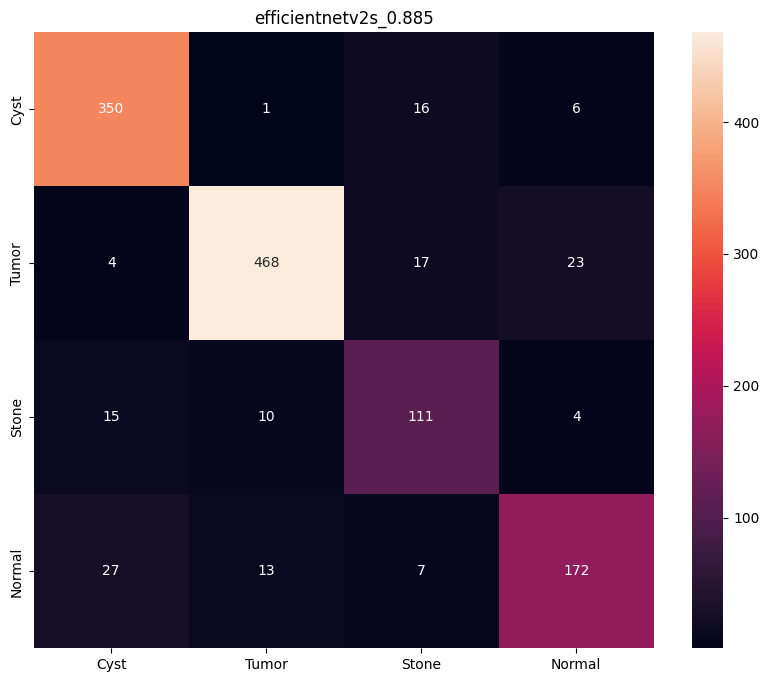

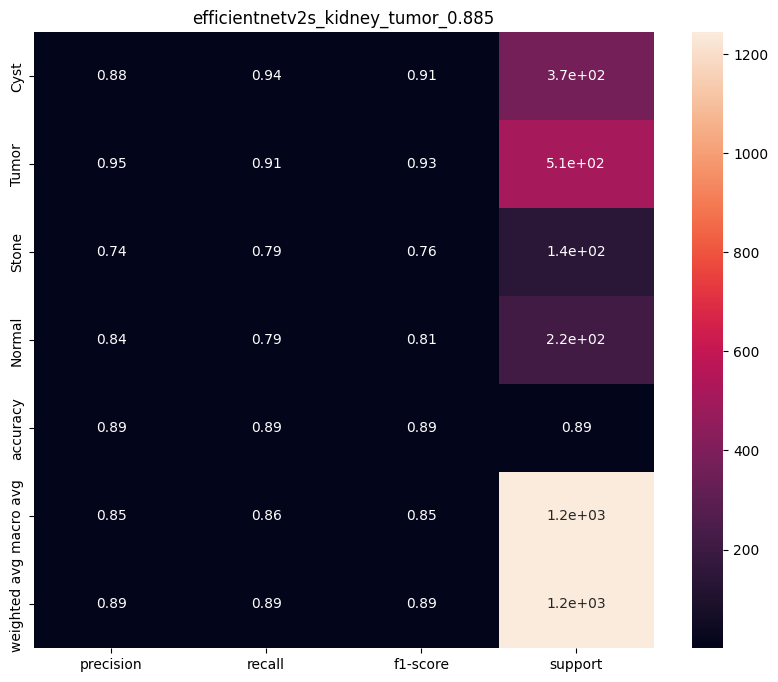

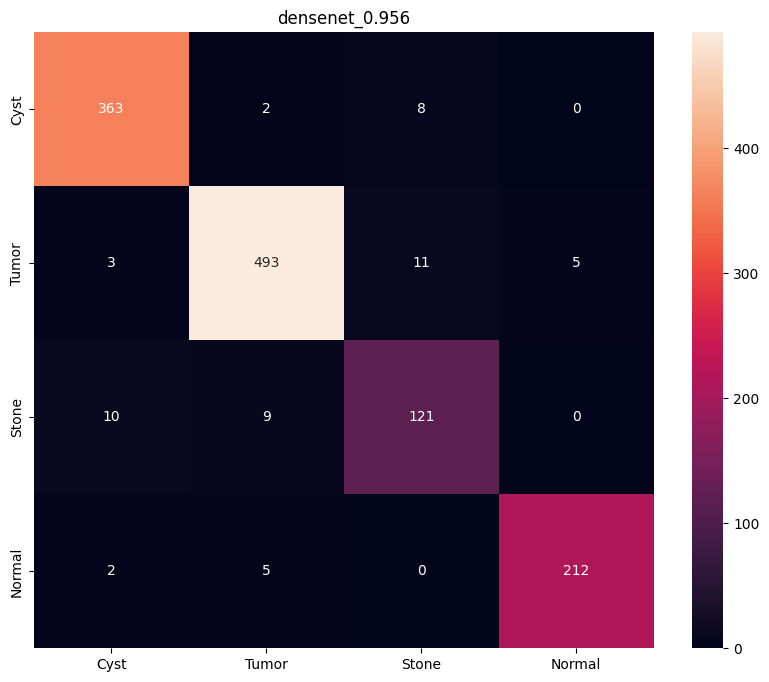

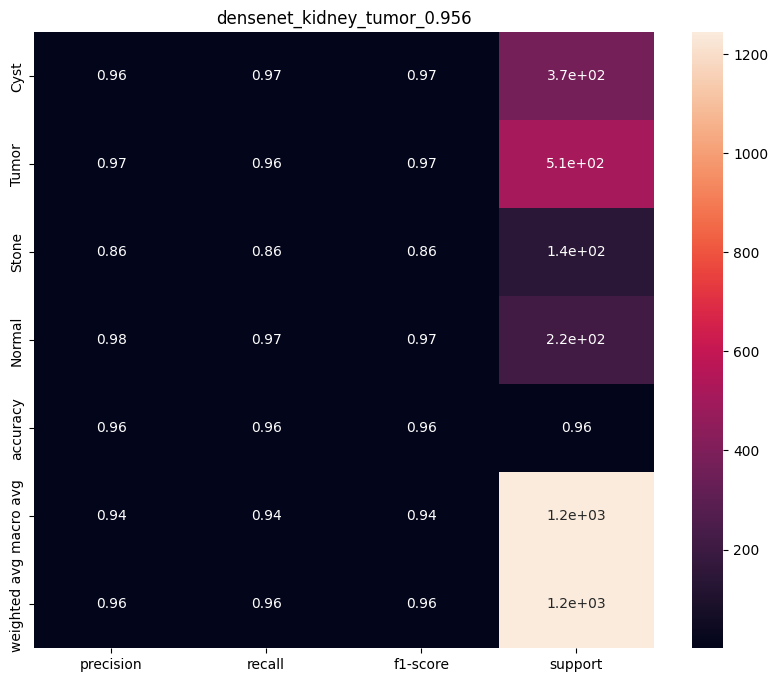

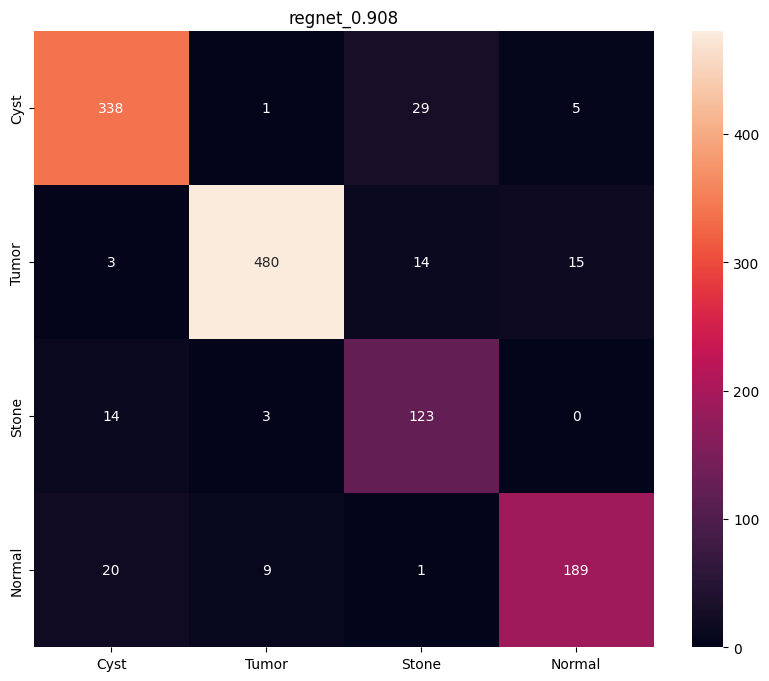

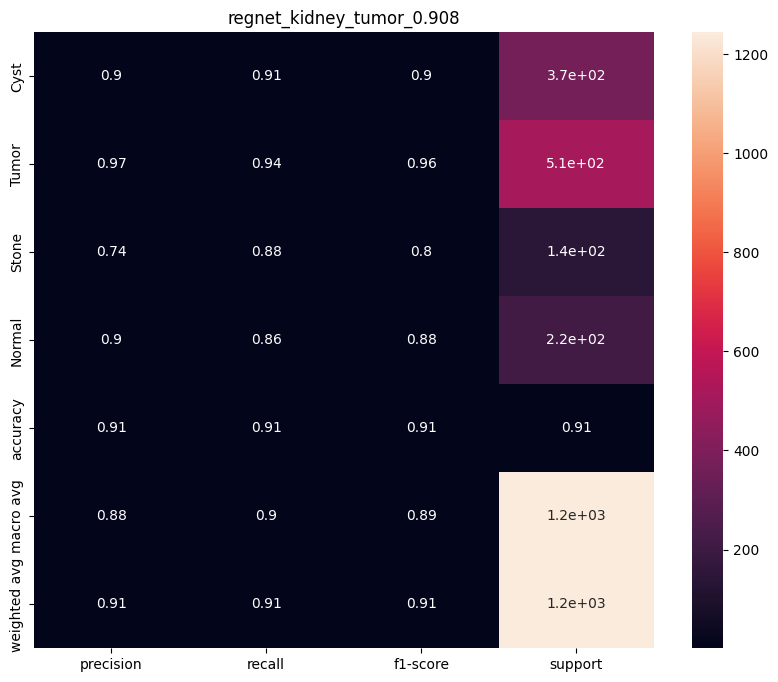

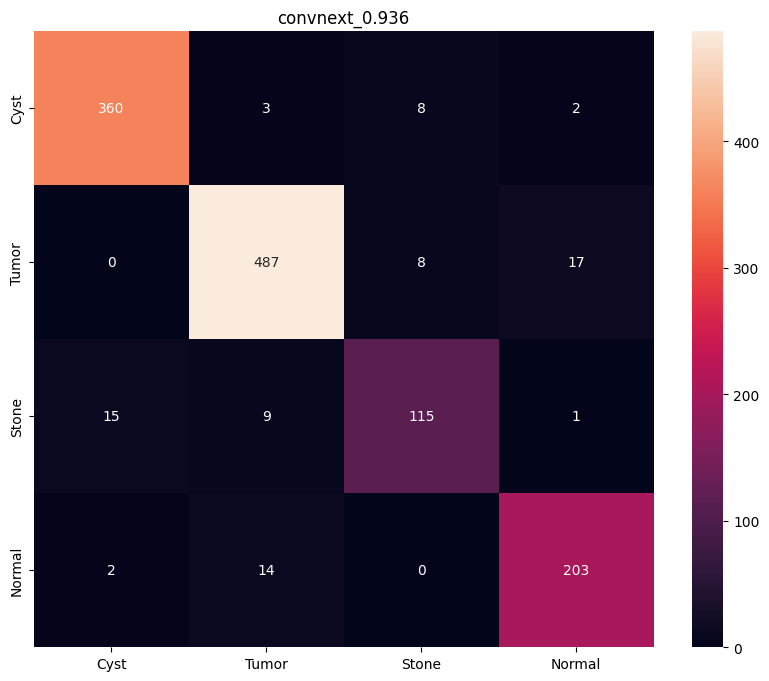

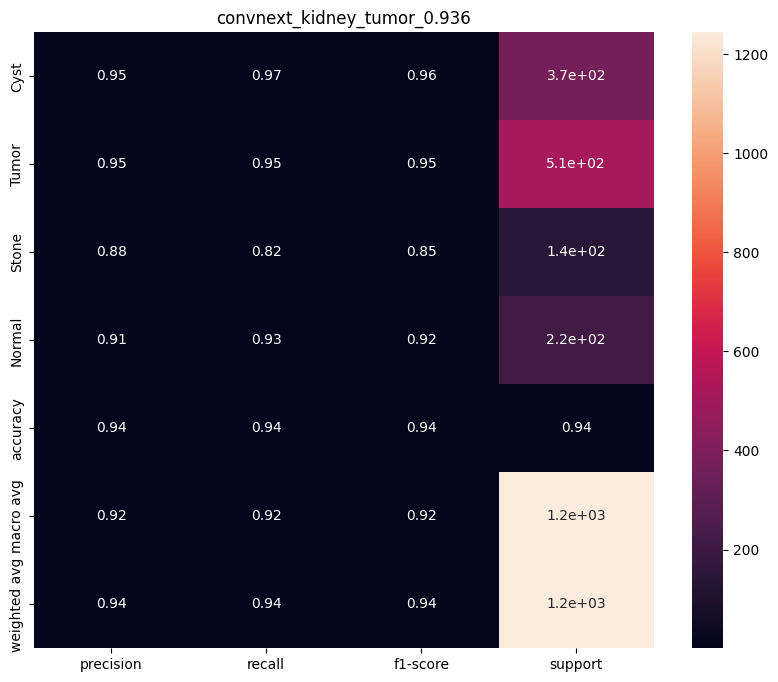

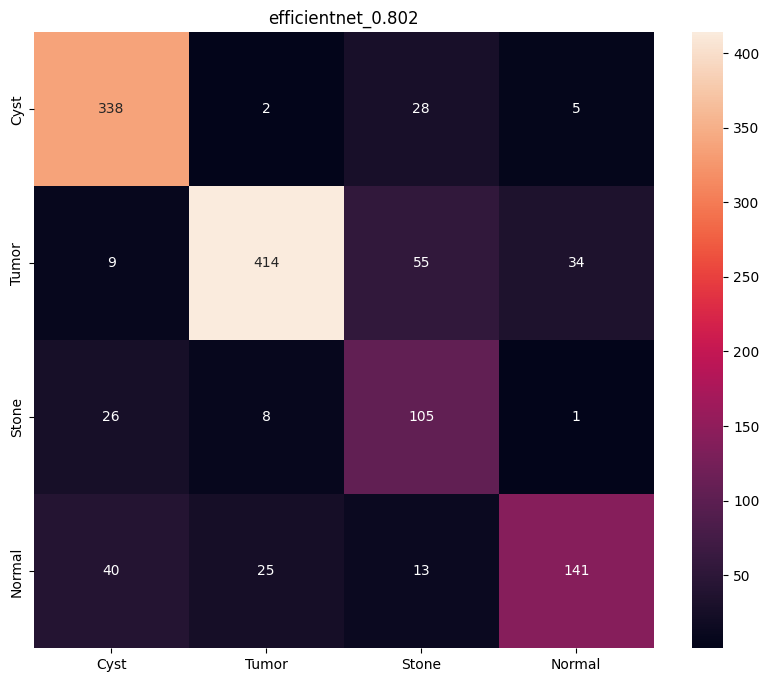

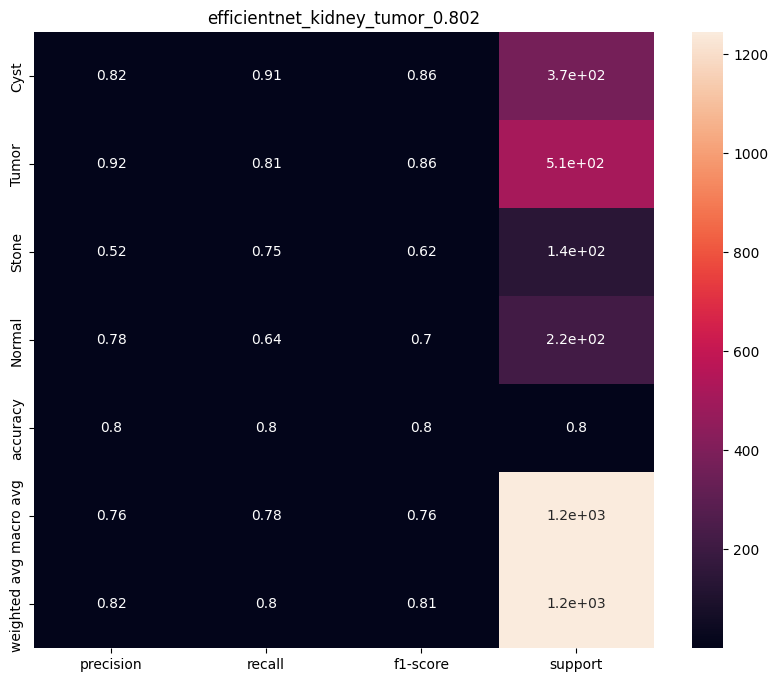

In [7]:
torch.manual_seed(3407)
lr = 0.01
num_classes = num_classes
class_weight = weights
patience = 5
model_name = ["efficientnetv2s", "densenet", "regnet", "convnext", "efficientnet"]
epochs = [30] * len(model_name)
disease_name = "kidney_tumor"
os.makedirs(disease_name, exist_ok=True)
classes_name = classes_name

trained_models = []

for model, epoch in zip(model_name, epochs):
    print(model)
    trained_models.append(trainModels(lr, epoch, num_classes, class_weight, patience, model, disease_name, classes_name,
                train_loader, val_loader, test_loader))

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class Ensemble(nn.Module):
    def __init__(self, num_classes, models):
        super(Ensemble, self).__init__()
        self.effi_v2s = models[0]
        self.densenet = models[1]
        self.regnet = models[2]
        self.convnext = models[3]
        self.effi = models[4]
        self.fc = nn.Linear(in_features=len(models) * 4, out_features=num_classes)

    def forward(self, x):
        o1 = self.effi_v2s(x)
        o2 = self.densenet(x)
        o3 = self.regnet(x)
        o4 = self.convnext(x)
        o5 = self.effi(x)

        concatenated_outputs = torch.cat((o1, o2, o3, o4, o5), dim=1)
        x = torch.flatten(concatenated_outputs, start_dim=1)
        x = self.fc(x)
        return x

In [9]:
def trainEnsemble(lr, epochs, num_classes, class_weight, patience, 
                models, disease_name, classes_name,
                train_loader, val_loader, test_loader):
    class_weight = torch.from_numpy(class_weight.astype(np.float32)).to(device)
    model = Ensemble(num_classes, models)
    model_name = "ensemble"

    for param in model.fc.parameters():
        param.requires_grad = True
    trainable_params = model.fc.parameters()
    model = model.to(device)
    history = {
        "train_loss":[],
        "val_loss":[],
        "val_acc":[]
    }

    criterion = torch.nn.CrossEntropyLoss(weight=class_weight).to(device)
    optimizer = torch.optim.SGD(trainable_params, lr)

    # Train and validate with lr scheduling and early stopping
    monitor_acc = 0
    counter = 0
    scheduler = StepLR(optimizer, step_size=10, gamma=0.1)
    for epoch in (t := tqdm.tqdm(range(epochs))):
        train_loss = 0
        val_loss = 0
        val_pred = []
        val_true = []
        model.train()
        for batches, labels in tqdm.tqdm(train_loader):
            batches = batches.to(device)
            labels = labels.to(device)
            optimizer.zero_grad()
            outputs = model(batches)
            outputs = outputs[0].to(device) if model_name == "inception" else outputs.to(device)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * batches.size(0)
        model.eval()
        for batches, labels in tqdm.tqdm(val_loader):
            batches = batches.to(device)
            labels = labels.to(device)
            outputs = model(batches)
            _, predicted = torch.max(outputs, 1)
            val_true.extend(labels.cpu().numpy())
            val_pred.extend(predicted.cpu().numpy())
            val_loss += loss.item() * batches.size(0)
            
        val_acc = accuracy_score(np.array(val_true), np.array(val_pred))    
        if val_acc > monitor_acc:
            monitor_acc = val_acc
#             optimizer.param_groups[0]['lr'] *= 0.9
            torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss,
            'history': history,
            }, disease_name + "/" + model_name + f"_best_{monitor_acc}.pth")

        history["train_loss"].append(train_loss / len(train_loader))
        history["val_loss"].append(val_loss / len(val_loader))
        history["val_acc"].append(val_acc)
        print(f'Epoch {epoch}\t \
                    Training Loss: {train_loss / len(train_loader)}\t \
                    Validation Loss: {val_loss / len(val_loader)}\t \
                    Validation Accuracy: {val_acc}\t \
                    LR:{optimizer.param_groups[0]["lr"]}')
        t.set_description(f"Epoch:{epoch + 1}, {model_name}:{val_acc:.4f}")
        scheduler.step()
        
    model.eval()
    y_true = []
    y_pred = []
    
    with torch.no_grad():
        for batches, labels in test_loader:
            batches = batches.to(device)
            labels = labels.to(device)
            outputs = model(batches)
            _, predicted = torch.max(outputs, 1)
            
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(predicted.cpu().numpy())
    
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    
    # Compute recall, precision, f1 and accuracy
    recall = recall_score(y_true, y_pred, average='weighted')
    precision = precision_score(y_true, y_pred, average='weighted')
    f1 = f1_score(y_true, y_pred, average='weighted')
    acc = accuracy_score(y_true, y_pred)
    print(f"ACCURACY ={acc}")
    print(f"RECALL = {recall}")
    print(f"PRECISION= {precision}")
    print(f"F1 Score = {f1}")

    torch.save(model, disease_name + "/" + model_name + f"_{acc}.pth")
    
    # Visualize confusion matrix and classification report
    conf_mat = confusion_matrix(y_true, y_pred)
    conf_df = pd.DataFrame(conf_mat, index=classes_name, columns=classes_name)
    plt.figure(figsize=(10, 8))
    plt.title(f"{model_name}_{acc:.3f}")
    sns.heatmap(conf_df, annot=True, fmt="g")
    plt.savefig(disease_name + "/" + disease_name + "_" + model_name + f"{acc:.3f}_confusionMatrix.png")

    print(classification_report(y_true, y_pred, target_names=classes_name))
    report = classification_report(y_true, y_pred, target_names=classes_name, output_dict=True)
    df = pd.DataFrame(report).transpose()
    plt.figure(figsize=(10, 8))
    plt.title(f"{model_name}_{disease_name}_{acc:.3f}")
    sns.heatmap(df, annot=True)
    plt.savefig(disease_name + "/" + disease_name + "_" + model_name + f"_{acc:.3f}_classificationReport.png")
    return model

In [10]:
torch.manual_seed(3407)
lr = 0.01
num_classes = num_classes
class_weight = weights
patience = 5
epoch = 30
disease_name = "kidney_tumor"
os.makedirs(disease_name, exist_ok=True)
classes_name = classes_name



trainEnsemble(lr, epoch, num_classes, class_weight, patience, trained_models, disease_name, classes_name,
                train_loader, val_loader, test_loader)


  0%|          | 0/30 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:49,  3.24s/it]


  1%|          | 2/312 [00:05<13:52,  2.69s/it]


  1%|          | 3/312 [00:07<12:54,  2.51s/it]


  1%|▏         | 4/312 [00:10<12:26,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:09,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:21,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.30s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.30s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.30s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.30s/it]


 20%|█▉        | 61/312 [02:20<09:36,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:50,  2.30s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.30s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.30s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.30s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.30s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.30s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.30s/it]


 33%|███▎      | 102/312 [03:55<08:02,  2.30s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.30s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.30s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.30s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.30s/it]


 36%|███▌      | 112/312 [04:17<07:39,  2.30s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:32,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.30s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.30s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.30s/it]


 48%|████▊     | 149/312 [05:42<06:14,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.30s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.30s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.30s/it]


 53%|█████▎    | 166/312 [06:21<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.30s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.30s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.30s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.30s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.30s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.30s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.30s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.30s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.30s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:17,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.30s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.30s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.30s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.30s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.30s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.30s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.30s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.30s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.30s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.30s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.30s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.30s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:59,  3.15s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.58s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.40s/it]


 10%|█         | 4/39 [00:09<01:21,  2.32s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:25<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.18s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.19s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.19s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.19s/it]


 56%|█████▋    | 22/39 [00:49<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]


Epoch:1, ensemble:0.9670:   0%|          | 0/30 [13:22<?, ?it/s]


Epoch:1, ensemble:0.9670:   3%|▎         | 1/30 [13:22<6:27:41, 802.11s/it]

Epoch 0	                     Training Loss: 8.983413541355194	                     Validation Loss: 2.8163065574108024	                     Validation Accuracy: 0.9670418006430869	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:58,  3.47s/it]


  1%|          | 2/312 [00:05<14:21,  2.78s/it]


  1%|          | 3/312 [00:08<13:10,  2.56s/it]


  1%|▏         | 4/312 [00:10<12:35,  2.45s/it]


  2%|▏         | 5/312 [00:12<12:15,  2.40s/it]


  2%|▏         | 6/312 [00:14<12:02,  2.36s/it]


  2%|▏         | 7/312 [00:17<11:53,  2.34s/it]


  3%|▎         | 8/312 [00:19<11:47,  2.33s/it]


  3%|▎         | 9/312 [00:21<11:41,  2.32s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:31<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:47<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:08,  2.30s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.30s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:54,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.30s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.30s/it]


 10%|▉         | 30/312 [01:10<10:47,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:26<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:49<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.30s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:28<09:29,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:07<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:23<08:34,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.30s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:46<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:55,  2.30s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.30s/it]


 37%|███▋      | 115/312 [04:25<07:32,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.30s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.30s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.30s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.30s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:04<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:43<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.30s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:06<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:22<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:38<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:45<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:01<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.30s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:24<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:40<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:03<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:19<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:42<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.30s/it]


 75%|███████▌  | 234/312 [08:58<02:59,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.30s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.30s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:21<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:37<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [10:00<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:16<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:39<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:55<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:18<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:34<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:56,  3.07s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.38s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:13<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.19s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]


Epoch:2, ensemble:0.9678:   3%|▎         | 1/30 [26:44<6:27:41, 802.11s/it]


Epoch:2, ensemble:0.9678:   7%|▋         | 2/30 [26:44<6:14:19, 802.14s/it]

Epoch 1	                     Training Loss: 4.271786069927307	                     Validation Loss: 4.332738990967091	                     Validation Accuracy: 0.9678456591639871	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<18:18,  3.53s/it]


  1%|          | 2/312 [00:05<14:29,  2.81s/it]


  1%|          | 3/312 [00:08<13:14,  2.57s/it]


  1%|▏         | 4/312 [00:10<12:38,  2.46s/it]


  2%|▏         | 5/312 [00:12<12:17,  2.40s/it]


  2%|▏         | 6/312 [00:15<12:03,  2.37s/it]


  2%|▏         | 7/312 [00:17<11:54,  2.34s/it]


  3%|▎         | 8/312 [00:19<11:47,  2.33s/it]


  3%|▎         | 9/312 [00:21<11:41,  2.32s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:31<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:47<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:54<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:10<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:26<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:33<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.30s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:15,  2.30s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.30s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:49<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:12<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:28<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:51<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:07<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:23<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:30<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:46<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:03,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:09<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:25<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:48<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:04<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.30s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.30s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:27<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:43<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:06<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.30s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:22<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:38<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:45<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:01<04:56,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:24<04:32,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:40<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:47<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:03<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.30s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.30s/it]


 70%|██████▉   | 217/312 [08:19<03:38,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.30s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:26<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:42<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:58<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:05<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:21<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:37<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:44<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [10:00<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:16<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:23<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:39<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.30s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.30s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:55<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:02<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:18<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:34<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.30s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.30s/it]


 98%|█████████▊| 305/312 [11:41<00:16,  2.30s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:58,  3.11s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.57s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]


Epoch:3, ensemble:0.9711:   7%|▋         | 2/30 [40:06<6:14:19, 802.14s/it]


Epoch:3, ensemble:0.9711:  10%|█         | 3/30 [40:06<6:00:58, 802.18s/it]

Epoch 2	                     Training Loss: 3.719946432381104	                     Validation Loss: 11.90741694584871	                     Validation Accuracy: 0.9710610932475884	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:50,  3.25s/it]


  1%|          | 2/312 [00:05<13:53,  2.69s/it]


  1%|          | 3/312 [00:07<12:55,  2.51s/it]


  1%|▏         | 4/312 [00:10<12:26,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:09,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.30s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.30s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.30s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.30s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.30s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:24,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:45,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:14,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.30s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:57,  3.10s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.56s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.19s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.19s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:4, ensemble:0.9711:  10%|█         | 3/30 [53:27<6:00:58, 802.18s/it]


Epoch:4, ensemble:0.9711:  13%|█▎        | 4/30 [53:27<5:47:24, 801.70s/it]

Epoch 3	                     Training Loss: 3.366865667586143	                     Validation Loss: 8.236430006149488	                     Validation Accuracy: 0.9710610932475884	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:37,  3.21s/it]


  1%|          | 2/312 [00:05<13:48,  2.67s/it]


  1%|          | 3/312 [00:07<12:52,  2.50s/it]


  1%|▏         | 4/312 [00:10<12:24,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:08,  2.37s/it]


  2%|▏         | 6/312 [00:14<11:57,  2.35s/it]


  2%|▏         | 7/312 [00:16<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:32,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:21,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:55<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:23,  2.29s/it]


 13%|█▎        | 41/312 [01:34<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:59,  2.30s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.30s/it]


 17%|█▋        | 54/312 [02:04<09:52,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:44,  2.29s/it]


 19%|█▊        | 58/312 [02:13<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:52<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.30s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.30s/it]


 27%|██▋       | 85/312 [03:15<08:41,  2.30s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.30s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:34,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:31<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:10<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:24,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:49<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:29,  2.29s/it]


 46%|████▌     | 143/312 [05:28<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.30s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:07<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:46<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:25<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.30s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.30s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.30s/it]


 68%|██████▊   | 211/312 [08:04<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:22<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:01<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:40<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:19<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:54<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:59,  3.15s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.58s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.40s/it]


 10%|█         | 4/39 [00:09<01:21,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:49<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:5, ensemble:0.9711:  13%|█▎        | 4/30 [1:06:48<5:47:24, 801.70s/it]


Epoch:5, ensemble:0.9711:  17%|█▋        | 5/30 [1:06:48<5:33:55, 801.43s/it]

Epoch 4	                     Training Loss: 3.1814446242956014	                     Validation Loss: 15.659156004587809	                     Validation Accuracy: 0.9710610932475884	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:13,  3.32s/it]


  1%|          | 2/312 [00:05<14:02,  2.72s/it]


  1%|          | 3/312 [00:07<13:00,  2.52s/it]


  1%|▏         | 4/312 [00:10<12:29,  2.43s/it]


  2%|▏         | 5/312 [00:12<12:11,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:59,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:51,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:39,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:44,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:29,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:42,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.30s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.30s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:32,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.30s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.30s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:35,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<02:00,  3.18s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.59s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.41s/it]


 10%|█         | 4/39 [00:09<01:21,  2.32s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:25<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.19s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:49<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:6, ensemble:0.9678:  17%|█▋        | 5/30 [1:20:09<5:33:55, 801.43s/it]


Epoch:6, ensemble:0.9678:  20%|██        | 6/30 [1:20:09<5:20:31, 801.31s/it]

Epoch 5	                     Training Loss: 3.086136515562733	                     Validation Loss: 0.31266361704239476	                     Validation Accuracy: 0.9678456591639871	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:42,  3.42s/it]


  1%|          | 2/312 [00:05<14:15,  2.76s/it]


  1%|          | 3/312 [00:08<13:06,  2.55s/it]


  1%|▏         | 4/312 [00:10<12:33,  2.45s/it]


  2%|▏         | 5/312 [00:12<12:14,  2.39s/it]


  2%|▏         | 6/312 [00:14<12:01,  2.36s/it]


  2%|▏         | 7/312 [00:17<11:53,  2.34s/it]


  3%|▎         | 8/312 [00:19<11:46,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:41,  2.31s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:21,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:47<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:26<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:23,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:37,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:21,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:23<08:34,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.30s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.30s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:32,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:14,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.30s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:38<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.30s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.30s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.30s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.30s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<02:06,  3.33s/it]


  5%|▌         | 2/39 [00:05<01:38,  2.66s/it]


  8%|▊         | 3/39 [00:07<01:27,  2.44s/it]


 10%|█         | 4/39 [00:09<01:21,  2.34s/it]


 13%|█▎        | 5/39 [00:12<01:17,  2.28s/it]


 15%|█▌        | 6/39 [00:14<01:14,  2.25s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.23s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.21s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:25<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:36<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:47<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:49<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [01:00<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:11<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:24<00:02,  2.18s/it]


100%|██████████| 39/39 [01:26<00:00,  2.10s/it]


100%|██████████| 39/39 [01:26<00:00,  2.21s/it]


Epoch:7, ensemble:0.9775:  20%|██        | 6/30 [1:33:31<5:20:31, 801.31s/it]


Epoch:7, ensemble:0.9775:  23%|██▎       | 7/30 [1:33:31<5:07:17, 801.63s/it]

Epoch 6	                     Training Loss: 2.978079052952429	                     Validation Loss: 1.4039207723660347	                     Validation Accuracy: 0.977491961414791	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:42,  3.22s/it]


  1%|          | 2/312 [00:05<13:50,  2.68s/it]


  1%|          | 3/312 [00:07<12:53,  2.50s/it]


  1%|▏         | 4/312 [00:10<12:25,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:08,  2.37s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:16<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:32,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:55<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:52,  2.30s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.30s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.30s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:34<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.30s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:57,  2.30s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.30s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.30s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.30s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:55,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:14,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:50,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.30s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:17,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.30s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.30s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.30s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.30s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.30s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.30s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.30s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<02:07,  3.36s/it]


  5%|▌         | 2/39 [00:05<01:38,  2.67s/it]


  8%|▊         | 3/39 [00:07<01:28,  2.45s/it]


 10%|█         | 4/39 [00:09<01:22,  2.34s/it]


 13%|█▎        | 5/39 [00:12<01:17,  2.29s/it]


 15%|█▌        | 6/39 [00:14<01:14,  2.25s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.23s/it]


 21%|██        | 8/39 [00:18<01:08,  2.22s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.21s/it]


 26%|██▌       | 10/39 [00:23<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:25<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:36<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.19s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:47<00:39,  2.19s/it]


 56%|█████▋    | 22/39 [00:49<00:37,  2.19s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [01:00<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:11<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:22<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:24<00:02,  2.18s/it]


100%|██████████| 39/39 [01:26<00:00,  2.10s/it]


100%|██████████| 39/39 [01:26<00:00,  2.21s/it]



Epoch:8, ensemble:0.9743:  23%|██▎       | 7/30 [1:46:53<5:07:17, 801.63s/it]


Epoch:8, ensemble:0.9743:  27%|██▋       | 8/30 [1:46:53<4:53:53, 801.51s/it]

Epoch 7	                     Training Loss: 2.965909039076322	                     Validation Loss: 16.679921651497864	                     Validation Accuracy: 0.9742765273311897	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:35,  3.39s/it]


  1%|          | 2/312 [00:05<14:11,  2.75s/it]


  1%|          | 3/312 [00:07<13:04,  2.54s/it]


  1%|▏         | 4/312 [00:10<12:32,  2.44s/it]


  2%|▏         | 5/312 [00:12<12:13,  2.39s/it]


  2%|▏         | 6/312 [00:14<12:01,  2.36s/it]


  2%|▏         | 7/312 [00:17<11:52,  2.34s/it]


  3%|▎         | 8/312 [00:19<11:46,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:41,  2.31s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.29s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:55,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.30s/it]


 10%|▉         | 31/312 [01:12<10:45,  2.30s/it]


 10%|█         | 32/312 [01:14<10:43,  2.30s/it]


 11%|█         | 33/312 [01:16<10:40,  2.30s/it]


 11%|█         | 34/312 [01:19<10:38,  2.30s/it]


 11%|█         | 35/312 [01:21<10:35,  2.30s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:26<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:52,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:44,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:29,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:21,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.30s/it]


 26%|██▌       | 81/312 [03:06<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:41,  2.30s/it]


 28%|██▊       | 86/312 [03:18<08:39,  2.30s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.30s/it]


 28%|██▊       | 88/312 [03:23<08:34,  2.30s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.30s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.30s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.30s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.30s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.30s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:24,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:29,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:14,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:38<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:32,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.30s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.30s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.30s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.30s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:35,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:58,  3.12s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.57s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.26s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:9, ensemble:0.9727:  27%|██▋       | 8/30 [2:00:14<4:53:53, 801.51s/it]


Epoch:9, ensemble:0.9727:  30%|███       | 9/30 [2:00:14<4:40:29, 801.40s/it]

Epoch 8	                     Training Loss: 2.7883034751583367	                     Validation Loss: 4.566098992641155	                     Validation Accuracy: 0.9726688102893891	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:15,  3.33s/it]


  1%|          | 2/312 [00:05<14:03,  2.72s/it]


  1%|          | 3/312 [00:07<13:00,  2.53s/it]


  1%|▏         | 4/312 [00:10<12:29,  2.43s/it]


  2%|▏         | 5/312 [00:12<12:11,  2.38s/it]


  2%|▏         | 6/312 [00:14<12:00,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:51,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:02,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.30s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.30s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.30s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.30s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.30s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:35,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:56,  3.07s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.38s/it]


 10%|█         | 4/39 [00:09<01:20,  2.30s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:13<01:13,  2.23s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:10, ensemble:0.9703:  30%|███       | 9/30 [2:13:35<4:40:29, 801.40s/it]


Epoch:10, ensemble:0.9703:  33%|███▎      | 10/30 [2:13:35<4:27:05, 801.28s/it]

Epoch 9	                     Training Loss: 2.698427117214753	                     Validation Loss: 11.409593683022718	                     Validation Accuracy: 0.9702572347266881	                     LR:0.01



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:47,  3.24s/it]


  1%|          | 2/312 [00:05<13:52,  2.69s/it]


  1%|          | 3/312 [00:07<12:54,  2.51s/it]


  1%|▏         | 4/312 [00:10<12:26,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:09,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:39,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:57,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:34,  2.30s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:55,  2.30s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.30s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:29,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.30s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:38,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:35,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.30s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.30s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:57,  3.08s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.18s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:11, ensemble:0.9743:  33%|███▎      | 10/30 [2:26:56<4:27:05, 801.28s/it]


Epoch:11, ensemble:0.9743:  37%|███▋      | 11/30 [2:26:56<4:13:42, 801.17s/it]

Epoch 10	                     Training Loss: 2.7405611526412077	                     Validation Loss: 6.58768680309638	                     Validation Accuracy: 0.9742765273311897	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:50,  3.44s/it]


  1%|          | 2/312 [00:05<14:18,  2.77s/it]


  1%|          | 3/312 [00:08<13:08,  2.55s/it]


  1%|▏         | 4/312 [00:10<12:34,  2.45s/it]


  2%|▏         | 5/312 [00:12<12:14,  2.39s/it]


  2%|▏         | 6/312 [00:14<12:02,  2.36s/it]


  2%|▏         | 7/312 [00:17<11:53,  2.34s/it]


  3%|▎         | 8/312 [00:19<11:46,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:41,  2.31s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:47<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:32,  2.29s/it]


 12%|█▏        | 37/312 [01:26<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:44,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:42,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:23<08:34,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.30s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.30s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.30s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.30s/it]


 53%|█████▎    | 166/312 [06:21<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.30s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.30s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.30s/it]


 55%|█████▌    | 173/312 [06:38<05:19,  2.30s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.30s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:01<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:40<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:19<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:58<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:35,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:37<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:16<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:55<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:34<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:56,  3.07s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.38s/it]


 10%|█         | 4/39 [00:09<01:20,  2.30s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:13<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:12, ensemble:0.9743:  37%|███▋      | 11/30 [2:40:17<4:13:42, 801.17s/it]


Epoch:12, ensemble:0.9743:  40%|████      | 12/30 [2:40:17<4:00:20, 801.16s/it]

Epoch 11	                     Training Loss: 2.707959181856355	                     Validation Loss: 0.027985016295972925	                     Validation Accuracy: 0.9742765273311897	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:11,  3.12s/it]


  1%|          | 2/312 [00:05<13:37,  2.64s/it]


  1%|          | 3/312 [00:07<12:46,  2.48s/it]


  1%|▏         | 4/312 [00:10<12:21,  2.41s/it]


  2%|▏         | 5/312 [00:12<12:06,  2.37s/it]


  2%|▏         | 6/312 [00:14<11:56,  2.34s/it]


  2%|▏         | 7/312 [00:16<11:49,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:39,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:35,  2.30s/it]


  4%|▎         | 11/312 [00:26<11:32,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:26,  2.30s/it]


  4%|▍         | 14/312 [00:32<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:21,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.29s/it]


  5%|▌         | 17/312 [00:39<11:16,  2.29s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:02,  2.29s/it]


  8%|▊         | 24/312 [00:55<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:11<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:39,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:23,  2.29s/it]


 13%|█▎        | 41/312 [01:34<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:50<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.30s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:13<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.30s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:29<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:21,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:52<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:08<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:31<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:47<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:03,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:10<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:26<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:49<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:05<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:28<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:44<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:50,  2.29s/it]


 51%|█████▏    | 160/312 [06:07<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:23<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:46<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:02<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:32,  2.29s/it]


 62%|██████▏   | 194/312 [07:25<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:41<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:04<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:20<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:43<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.30s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [08:59<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:22<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:38<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:01<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:17<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:40<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:56<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:19<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:35<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:54<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:57,  3.08s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.56s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:13, ensemble:0.9775:  40%|████      | 12/30 [2:53:38<4:00:20, 801.16s/it]


Epoch:13, ensemble:0.9775:  43%|████▎     | 13/30 [2:53:38<3:46:57, 801.04s/it]

Epoch 12	                     Training Loss: 2.5730818995776086	                     Validation Loss: 1.899192933852856	                     Validation Accuracy: 0.977491961414791	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:53,  3.26s/it]


  1%|          | 2/312 [00:05<13:54,  2.69s/it]


  1%|          | 3/312 [00:07<12:55,  2.51s/it]


  1%|▏         | 4/312 [00:10<12:27,  2.43s/it]


  2%|▏         | 5/312 [00:12<12:10,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.30s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.30s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.30s/it]


 28%|██▊       | 88/312 [03:22<08:34,  2.30s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.30s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.30s/it]


 37%|███▋      | 115/312 [04:24<07:32,  2.30s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.30s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.30s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.30s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:37,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.30s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.30s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.30s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.30s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.30s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.30s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:58,  3.13s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.57s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.40s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:14, ensemble:0.9759:  43%|████▎     | 13/30 [3:06:59<3:46:57, 801.04s/it]


Epoch:14, ensemble:0.9759:  47%|████▋     | 14/30 [3:06:59<3:33:36, 801.05s/it]

Epoch 13	                     Training Loss: 2.725963698843351	                     Validation Loss: 14.899149537086487	                     Validation Accuracy: 0.9758842443729904	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<18:48,  3.63s/it]


  1%|          | 2/312 [00:05<14:41,  2.85s/it]


  1%|          | 3/312 [00:08<13:21,  2.59s/it]


  1%|▏         | 4/312 [00:10<12:42,  2.48s/it]


  2%|▏         | 5/312 [00:12<12:19,  2.41s/it]


  2%|▏         | 6/312 [00:15<12:05,  2.37s/it]


  2%|▏         | 7/312 [00:17<11:55,  2.35s/it]


  3%|▎         | 8/312 [00:19<11:48,  2.33s/it]


  3%|▎         | 9/312 [00:21<11:42,  2.32s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.31s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:31<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:38<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:47<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:54<11:02,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:10<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:17<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:26<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:33<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:49<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:56<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:12<09:44,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:28<09:29,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:35<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:51<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:07<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:14<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:23<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:30<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:46<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:53<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:09<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:25<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:32<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:48<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:04<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:11<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.30s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:27<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:43<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:50<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:06<05:50,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.30s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:22<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:29<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:38<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:45<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.30s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:01<04:56,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:08<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:24<04:32,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:40<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:47<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:03<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:19<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:26<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:42<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:58<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:05<02:52,  2.30s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.30s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.30s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.30s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:21<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:28<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:37<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:44<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [10:00<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:07<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:16<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:23<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:39<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:46<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:55<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:02<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:18<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.30s/it]


 96%|█████████▌| 298/312 [11:25<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:34<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:41<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:57,  3.10s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.56s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.18s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:15, ensemble:0.9743:  47%|████▋     | 14/30 [3:20:20<3:33:36, 801.05s/it]


Epoch:15, ensemble:0.9743:  50%|█████     | 15/30 [3:20:20<3:20:17, 801.14s/it]

Epoch 14	                     Training Loss: 2.776544915762945	                     Validation Loss: 0.801536279802139	                     Validation Accuracy: 0.9742765273311897	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:17,  3.14s/it]


  1%|          | 2/312 [00:05<13:39,  2.64s/it]


  1%|          | 3/312 [00:07<12:47,  2.48s/it]


  1%|▏         | 4/312 [00:10<12:22,  2.41s/it]


  2%|▏         | 5/312 [00:12<12:07,  2.37s/it]


  2%|▏         | 6/312 [00:14<11:57,  2.34s/it]


  2%|▏         | 7/312 [00:16<11:49,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:39,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:32,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:32<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.30s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:02,  2.29s/it]


  8%|▊         | 24/312 [00:55<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:11<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:23,  2.29s/it]


 13%|█▎        | 41/312 [01:34<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:50<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:44,  2.29s/it]


 19%|█▊        | 58/312 [02:13<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:29<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:52<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:08<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:31<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:47<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:10<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:32,  2.29s/it]


 37%|███▋      | 116/312 [04:26<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:49<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:05<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:28<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:44<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.30s/it]


 50%|█████     | 156/312 [05:58<05:58,  2.30s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:07<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:46<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:25<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:04<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:43<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:22<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:01<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:40<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:19<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:54<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:57,  3.08s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.38s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:16, ensemble:0.9751:  50%|█████     | 15/30 [3:33:41<3:20:17, 801.14s/it]


Epoch:16, ensemble:0.9751:  53%|█████▎    | 16/30 [3:33:41<3:06:54, 801.05s/it]

Epoch 15	                     Training Loss: 2.5698040906721964	                     Validation Loss: 2.461551491266642	                     Validation Accuracy: 0.97508038585209	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:04,  3.29s/it]


  1%|          | 2/312 [00:05<13:59,  2.71s/it]


  1%|          | 3/312 [00:07<12:58,  2.52s/it]


  1%|▏         | 4/312 [00:10<12:28,  2.43s/it]


  2%|▏         | 5/312 [00:12<12:10,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:59,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:51,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:09,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.30s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:23,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:21,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.30s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:13,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:42,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:55,  2.30s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.30s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.30s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:29,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:14,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:50,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.30s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.30s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.30s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.30s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.30s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:14,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.30s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.30s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.30s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:58,  3.11s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.57s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.18s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:17, ensemble:0.9759:  53%|█████▎    | 16/30 [3:47:02<3:06:54, 801.05s/it]


Epoch:17, ensemble:0.9759:  57%|█████▋    | 17/30 [3:47:02<2:53:33, 801.05s/it]

Epoch 16	                     Training Loss: 2.631832622182675	                     Validation Loss: 5.9133110245068865	                     Validation Accuracy: 0.9758842443729904	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:18,  3.34s/it]


  1%|          | 2/312 [00:05<14:04,  2.73s/it]


  1%|          | 3/312 [00:07<13:01,  2.53s/it]


  1%|▏         | 4/312 [00:10<12:30,  2.44s/it]


  2%|▏         | 5/312 [00:12<12:12,  2.38s/it]


  2%|▏         | 6/312 [00:14<12:00,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:51,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:21,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:15,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.30s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.30s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.30s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.30s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.30s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.30s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.30s/it]


  9%|▊         | 27/312 [01:03<10:54,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.30s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.30s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:42<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:13,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.30s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.30s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:48,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.30s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.30s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:57<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:29,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:50,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.30s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.30s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.30s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.30s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:56,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:17,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.30s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.30s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.30s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<02:08,  3.37s/it]


  5%|▌         | 2/39 [00:05<01:38,  2.67s/it]


  8%|▊         | 3/39 [00:07<01:28,  2.45s/it]


 10%|█         | 4/39 [00:09<01:22,  2.35s/it]


 13%|█▎        | 5/39 [00:12<01:17,  2.29s/it]


 15%|█▌        | 6/39 [00:14<01:14,  2.25s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.23s/it]


 21%|██        | 8/39 [00:18<01:08,  2.22s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.21s/it]


 26%|██▌       | 10/39 [00:23<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:25<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:36<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.19s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.19s/it]


 54%|█████▍    | 21/39 [00:47<00:39,  2.19s/it]


 56%|█████▋    | 22/39 [00:49<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [01:00<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.19s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.19s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:11<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:22<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:24<00:02,  2.18s/it]


100%|██████████| 39/39 [01:26<00:00,  2.10s/it]


100%|██████████| 39/39 [01:26<00:00,  2.21s/it]



Epoch:18, ensemble:0.9719:  57%|█████▋    | 17/30 [4:00:23<2:53:33, 801.05s/it]


Epoch:18, ensemble:0.9719:  60%|██████    | 18/30 [4:00:23<2:40:13, 801.16s/it]

Epoch 17	                     Training Loss: 2.738836821455222	                     Validation Loss: 3.2661252915859222	                     Validation Accuracy: 0.9718649517684887	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:08,  3.31s/it]


  1%|          | 2/312 [00:05<14:01,  2.71s/it]


  1%|          | 3/312 [00:07<12:59,  2.52s/it]


  1%|▏         | 4/312 [00:10<12:28,  2.43s/it]


  2%|▏         | 5/312 [00:12<12:11,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:59,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:51,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.30s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.30s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.30s/it]


  8%|▊         | 24/312 [00:56<11:01,  2.30s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:54,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.30s/it]


 23%|██▎       | 71/312 [02:43<09:13,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:06,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.30s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.30s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.30s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.30s/it]


 34%|███▎      | 105/312 [04:01<07:55,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:45,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.30s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.30s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.30s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.30s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.30s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:58,  3.12s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.57s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.18s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:19, ensemble:0.9775:  60%|██████    | 18/30 [4:13:44<2:40:13, 801.16s/it]


Epoch:19, ensemble:0.9775:  63%|██████▎   | 19/30 [4:13:44<2:26:52, 801.13s/it]

Epoch 18	                     Training Loss: 2.6974133896904116	                     Validation Loss: 4.964895937687311	                     Validation Accuracy: 0.977491961414791	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:42,  3.22s/it]


  1%|          | 2/312 [00:05<13:50,  2.68s/it]


  1%|          | 3/312 [00:07<12:53,  2.50s/it]


  1%|▏         | 4/312 [00:10<12:25,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:08,  2.37s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:16<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:32,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:55<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:34<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:08,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:22,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:58,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:50,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:34,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:27,  2.30s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.30s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:09,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:50,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.29s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.29s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.30s/it]


 58%|█████▊    | 180/312 [06:53<05:03,  2.30s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.30s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:56,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.30s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.30s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.30s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.30s/it]


 66%|██████▋   | 207/312 [07:55<04:01,  2.30s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.30s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.30s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.30s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.30s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.30s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.30s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:56,  3.06s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.38s/it]


 10%|█         | 4/39 [00:09<01:20,  2.30s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:13<01:13,  2.23s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:05,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.19s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.19s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:20, ensemble:0.9719:  63%|██████▎   | 19/30 [4:27:05<2:26:52, 801.13s/it]


Epoch:20, ensemble:0.9719:  67%|██████▋   | 20/30 [4:27:05<2:13:30, 801.07s/it]

Epoch 19	                     Training Loss: 2.668193451582621	                     Validation Loss: 67.38646504817865	                     Validation Accuracy: 0.9718649517684887	                     LR:0.001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<17:37,  3.40s/it]


  1%|          | 2/312 [00:05<14:12,  2.75s/it]


  1%|          | 3/312 [00:07<13:05,  2.54s/it]


  1%|▏         | 4/312 [00:10<12:32,  2.44s/it]


  2%|▏         | 5/312 [00:12<12:13,  2.39s/it]


  2%|▏         | 6/312 [00:14<12:01,  2.36s/it]


  2%|▏         | 7/312 [00:17<11:52,  2.34s/it]


  3%|▎         | 8/312 [00:19<11:46,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:41,  2.31s/it]


  3%|▎         | 10/312 [00:24<11:37,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:30,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:40<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:02,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:03<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:19<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:22,  2.30s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.30s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.30s/it]


 14%|█▍        | 44/312 [01:42<10:15,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:01,  2.29s/it]


 16%|█▋        | 51/312 [01:58<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:05<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:21<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:21,  2.29s/it]


 22%|██▏       | 68/312 [02:37<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:44<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [03:00<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:16<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:23<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:39<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:11,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:55<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:02<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:18<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:25,  2.29s/it]


 38%|███▊      | 119/312 [04:34<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:41<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.30s/it]


 41%|████      | 128/312 [04:54<07:02,  2.30s/it]


 41%|████▏     | 129/312 [04:57<07:00,  2.30s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.30s/it]


 42%|████▏     | 132/312 [05:03<06:53,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:13<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:20<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.30s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:36<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:52<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:59<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:15<05:41,  2.29s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:34,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.29s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.30s/it]


 54%|█████▍    | 170/312 [06:31<05:25,  2.30s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.30s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:38<05:19,  2.30s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:12,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:54<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:10<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.29s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:17<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:33<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:17,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:49<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:56<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:53,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:12<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:28<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:35<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.30s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:51<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.29s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.29s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:07<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:14<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:36,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:30<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:46<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:53<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.29s/it]


 85%|████████▍ | 265/312 [10:09<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:25<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.30s/it]


 88%|████████▊ | 275/312 [10:32<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:48<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:04<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:11<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:39,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:27<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.30s/it]


 98%|█████████▊| 306/312 [11:43<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:50<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:55<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:56,  3.07s/it]


  5%|▌         | 2/39 [00:05<01:34,  2.55s/it]


  8%|▊         | 3/39 [00:07<01:25,  2.38s/it]


 10%|█         | 4/39 [00:09<01:20,  2.30s/it]


 13%|█▎        | 5/39 [00:11<01:16,  2.26s/it]


 15%|█▌        | 6/39 [00:13<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:10,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.19s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:12<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]



Epoch:21, ensemble:0.9719:  67%|██████▋   | 20/30 [4:40:26<2:13:30, 801.07s/it]


Epoch:21, ensemble:0.9719:  70%|███████   | 21/30 [4:40:26<2:00:09, 801.09s/it]

Epoch 20	                     Training Loss: 2.592953296712576	                     Validation Loss: 19.772541394600502	                     Validation Accuracy: 0.9718649517684887	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:50,  3.25s/it]


  1%|          | 2/312 [00:05<13:53,  2.69s/it]


  1%|          | 3/312 [00:07<12:55,  2.51s/it]


  1%|▏         | 4/312 [00:10<12:26,  2.42s/it]


  2%|▏         | 5/312 [00:12<12:09,  2.38s/it]


  2%|▏         | 6/312 [00:14<11:58,  2.35s/it]


  2%|▏         | 7/312 [00:17<11:51,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:45,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:40,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.31s/it]


  4%|▎         | 11/312 [00:26<11:33,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:21,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:16,  2.29s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.29s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:56<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:47,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:23,  2.29s/it]


 13%|█▎        | 41/312 [01:35<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]


 14%|█▍        | 44/312 [01:41<10:14,  2.29s/it]


 14%|█▍        | 45/312 [01:44<10:12,  2.29s/it]


 15%|█▍        | 46/312 [01:46<10:10,  2.29s/it]


 15%|█▌        | 47/312 [01:48<10:07,  2.29s/it]


 15%|█▌        | 48/312 [01:51<10:05,  2.29s/it]


 16%|█▌        | 49/312 [01:53<10:03,  2.29s/it]


 16%|█▌        | 50/312 [01:55<10:00,  2.29s/it]


 16%|█▋        | 51/312 [01:57<09:58,  2.29s/it]


 17%|█▋        | 52/312 [02:00<09:56,  2.29s/it]


 17%|█▋        | 53/312 [02:02<09:54,  2.29s/it]


 17%|█▋        | 54/312 [02:04<09:51,  2.29s/it]


 18%|█▊        | 55/312 [02:07<09:49,  2.29s/it]


 18%|█▊        | 56/312 [02:09<09:47,  2.29s/it]


 18%|█▊        | 57/312 [02:11<09:45,  2.29s/it]


 19%|█▊        | 58/312 [02:14<09:42,  2.29s/it]


 19%|█▉        | 59/312 [02:16<09:40,  2.29s/it]


 19%|█▉        | 60/312 [02:18<09:38,  2.29s/it]


 20%|█▉        | 61/312 [02:20<09:35,  2.29s/it]


 20%|█▉        | 62/312 [02:23<09:33,  2.29s/it]


 20%|██        | 63/312 [02:25<09:31,  2.29s/it]


 21%|██        | 64/312 [02:27<09:28,  2.29s/it]


 21%|██        | 65/312 [02:30<09:26,  2.29s/it]


 21%|██        | 66/312 [02:32<09:24,  2.29s/it]


 21%|██▏       | 67/312 [02:34<09:21,  2.29s/it]


 22%|██▏       | 68/312 [02:36<09:19,  2.29s/it]


 22%|██▏       | 69/312 [02:39<09:17,  2.29s/it]


 22%|██▏       | 70/312 [02:41<09:15,  2.29s/it]


 23%|██▎       | 71/312 [02:43<09:12,  2.29s/it]


 23%|██▎       | 72/312 [02:46<09:10,  2.29s/it]


 23%|██▎       | 73/312 [02:48<09:08,  2.29s/it]


 24%|██▎       | 74/312 [02:50<09:05,  2.29s/it]


 24%|██▍       | 75/312 [02:53<09:03,  2.29s/it]


 24%|██▍       | 76/312 [02:55<09:01,  2.29s/it]


 25%|██▍       | 77/312 [02:57<08:59,  2.29s/it]


 25%|██▌       | 78/312 [02:59<08:56,  2.29s/it]


 25%|██▌       | 79/312 [03:02<08:54,  2.29s/it]


 26%|██▌       | 80/312 [03:04<08:52,  2.29s/it]


 26%|██▌       | 81/312 [03:06<08:49,  2.29s/it]


 26%|██▋       | 82/312 [03:09<08:47,  2.29s/it]


 27%|██▋       | 83/312 [03:11<08:45,  2.29s/it]


 27%|██▋       | 84/312 [03:13<08:43,  2.29s/it]


 27%|██▋       | 85/312 [03:15<08:40,  2.29s/it]


 28%|██▊       | 86/312 [03:18<08:38,  2.29s/it]


 28%|██▊       | 87/312 [03:20<08:36,  2.29s/it]


 28%|██▊       | 88/312 [03:22<08:33,  2.29s/it]


 29%|██▊       | 89/312 [03:25<08:31,  2.29s/it]


 29%|██▉       | 90/312 [03:27<08:29,  2.29s/it]


 29%|██▉       | 91/312 [03:29<08:26,  2.29s/it]


 29%|██▉       | 92/312 [03:32<08:24,  2.29s/it]


 30%|██▉       | 93/312 [03:34<08:22,  2.29s/it]


 30%|███       | 94/312 [03:36<08:20,  2.29s/it]


 30%|███       | 95/312 [03:38<08:17,  2.29s/it]


 31%|███       | 96/312 [03:41<08:15,  2.29s/it]


 31%|███       | 97/312 [03:43<08:13,  2.29s/it]


 31%|███▏      | 98/312 [03:45<08:10,  2.29s/it]


 32%|███▏      | 99/312 [03:48<08:08,  2.29s/it]


 32%|███▏      | 100/312 [03:50<08:06,  2.29s/it]


 32%|███▏      | 101/312 [03:52<08:04,  2.29s/it]


 33%|███▎      | 102/312 [03:54<08:01,  2.29s/it]


 33%|███▎      | 103/312 [03:57<07:59,  2.29s/it]


 33%|███▎      | 104/312 [03:59<07:57,  2.29s/it]


 34%|███▎      | 105/312 [04:01<07:54,  2.29s/it]


 34%|███▍      | 106/312 [04:04<07:52,  2.29s/it]


 34%|███▍      | 107/312 [04:06<07:50,  2.29s/it]


 35%|███▍      | 108/312 [04:08<07:47,  2.29s/it]


 35%|███▍      | 109/312 [04:11<07:45,  2.29s/it]


 35%|███▌      | 110/312 [04:13<07:43,  2.29s/it]


 36%|███▌      | 111/312 [04:15<07:41,  2.29s/it]


 36%|███▌      | 112/312 [04:17<07:38,  2.29s/it]


 36%|███▌      | 113/312 [04:20<07:36,  2.29s/it]


 37%|███▋      | 114/312 [04:22<07:34,  2.29s/it]


 37%|███▋      | 115/312 [04:24<07:31,  2.29s/it]


 37%|███▋      | 116/312 [04:27<07:29,  2.29s/it]


 38%|███▊      | 117/312 [04:29<07:27,  2.29s/it]


 38%|███▊      | 118/312 [04:31<07:24,  2.29s/it]


 38%|███▊      | 119/312 [04:33<07:22,  2.29s/it]


 38%|███▊      | 120/312 [04:36<07:20,  2.29s/it]


 39%|███▉      | 121/312 [04:38<07:18,  2.29s/it]


 39%|███▉      | 122/312 [04:40<07:15,  2.29s/it]


 39%|███▉      | 123/312 [04:43<07:13,  2.29s/it]


 40%|███▉      | 124/312 [04:45<07:11,  2.29s/it]


 40%|████      | 125/312 [04:47<07:08,  2.29s/it]


 40%|████      | 126/312 [04:50<07:06,  2.29s/it]


 41%|████      | 127/312 [04:52<07:04,  2.29s/it]


 41%|████      | 128/312 [04:54<07:02,  2.29s/it]


 41%|████▏     | 129/312 [04:56<06:59,  2.29s/it]


 42%|████▏     | 130/312 [04:59<06:57,  2.29s/it]


 42%|████▏     | 131/312 [05:01<06:55,  2.29s/it]


 42%|████▏     | 132/312 [05:03<06:52,  2.29s/it]


 43%|████▎     | 133/312 [05:06<06:50,  2.29s/it]


 43%|████▎     | 134/312 [05:08<06:48,  2.29s/it]


 43%|████▎     | 135/312 [05:10<06:46,  2.29s/it]


 44%|████▎     | 136/312 [05:12<06:43,  2.29s/it]


 44%|████▍     | 137/312 [05:15<06:41,  2.29s/it]


 44%|████▍     | 138/312 [05:17<06:39,  2.29s/it]


 45%|████▍     | 139/312 [05:19<06:36,  2.29s/it]


 45%|████▍     | 140/312 [05:22<06:34,  2.29s/it]


 45%|████▌     | 141/312 [05:24<06:32,  2.29s/it]


 46%|████▌     | 142/312 [05:26<06:30,  2.29s/it]


 46%|████▌     | 143/312 [05:29<06:27,  2.29s/it]


 46%|████▌     | 144/312 [05:31<06:25,  2.29s/it]


 46%|████▋     | 145/312 [05:33<06:23,  2.29s/it]


 47%|████▋     | 146/312 [05:35<06:20,  2.29s/it]


 47%|████▋     | 147/312 [05:38<06:18,  2.29s/it]


 47%|████▋     | 148/312 [05:40<06:16,  2.29s/it]


 48%|████▊     | 149/312 [05:42<06:13,  2.29s/it]


 48%|████▊     | 150/312 [05:45<06:11,  2.29s/it]


 48%|████▊     | 151/312 [05:47<06:09,  2.29s/it]


 49%|████▊     | 152/312 [05:49<06:07,  2.29s/it]


 49%|████▉     | 153/312 [05:51<06:04,  2.29s/it]


 49%|████▉     | 154/312 [05:54<06:02,  2.29s/it]


 50%|████▉     | 155/312 [05:56<06:00,  2.29s/it]


 50%|█████     | 156/312 [05:58<05:57,  2.29s/it]


 50%|█████     | 157/312 [06:01<05:55,  2.29s/it]


 51%|█████     | 158/312 [06:03<05:53,  2.29s/it]


 51%|█████     | 159/312 [06:05<05:51,  2.29s/it]


 51%|█████▏    | 160/312 [06:08<05:48,  2.29s/it]


 52%|█████▏    | 161/312 [06:10<05:46,  2.29s/it]


 52%|█████▏    | 162/312 [06:12<05:44,  2.29s/it]


 52%|█████▏    | 163/312 [06:14<05:41,  2.30s/it]


 53%|█████▎    | 164/312 [06:17<05:39,  2.29s/it]


 53%|█████▎    | 165/312 [06:19<05:37,  2.29s/it]


 53%|█████▎    | 166/312 [06:21<05:35,  2.29s/it]


 54%|█████▎    | 167/312 [06:24<05:32,  2.29s/it]


 54%|█████▍    | 168/312 [06:26<05:30,  2.30s/it]


 54%|█████▍    | 169/312 [06:28<05:28,  2.30s/it]


 54%|█████▍    | 170/312 [06:30<05:25,  2.30s/it]


 55%|█████▍    | 171/312 [06:33<05:23,  2.29s/it]


 55%|█████▌    | 172/312 [06:35<05:21,  2.29s/it]


 55%|█████▌    | 173/312 [06:37<05:18,  2.29s/it]


 56%|█████▌    | 174/312 [06:40<05:16,  2.29s/it]


 56%|█████▌    | 175/312 [06:42<05:14,  2.29s/it]


 56%|█████▋    | 176/312 [06:44<05:11,  2.29s/it]


 57%|█████▋    | 177/312 [06:47<05:09,  2.29s/it]


 57%|█████▋    | 178/312 [06:49<05:07,  2.29s/it]


 57%|█████▋    | 179/312 [06:51<05:05,  2.29s/it]


 58%|█████▊    | 180/312 [06:53<05:02,  2.29s/it]


 58%|█████▊    | 181/312 [06:56<05:00,  2.29s/it]


 58%|█████▊    | 182/312 [06:58<04:58,  2.29s/it]


 59%|█████▊    | 183/312 [07:00<04:55,  2.29s/it]


 59%|█████▉    | 184/312 [07:03<04:53,  2.29s/it]


 59%|█████▉    | 185/312 [07:05<04:51,  2.29s/it]


 60%|█████▉    | 186/312 [07:07<04:49,  2.29s/it]


 60%|█████▉    | 187/312 [07:09<04:46,  2.29s/it]


 60%|██████    | 188/312 [07:12<04:44,  2.30s/it]


 61%|██████    | 189/312 [07:14<04:42,  2.29s/it]


 61%|██████    | 190/312 [07:16<04:39,  2.29s/it]


 61%|██████    | 191/312 [07:19<04:37,  2.29s/it]


 62%|██████▏   | 192/312 [07:21<04:35,  2.29s/it]


 62%|██████▏   | 193/312 [07:23<04:33,  2.29s/it]


 62%|██████▏   | 194/312 [07:26<04:30,  2.29s/it]


 62%|██████▎   | 195/312 [07:28<04:28,  2.29s/it]


 63%|██████▎   | 196/312 [07:30<04:26,  2.29s/it]


 63%|██████▎   | 197/312 [07:32<04:23,  2.29s/it]


 63%|██████▎   | 198/312 [07:35<04:21,  2.29s/it]


 64%|██████▍   | 199/312 [07:37<04:19,  2.29s/it]


 64%|██████▍   | 200/312 [07:39<04:16,  2.29s/it]


 64%|██████▍   | 201/312 [07:42<04:14,  2.29s/it]


 65%|██████▍   | 202/312 [07:44<04:12,  2.29s/it]


 65%|██████▌   | 203/312 [07:46<04:10,  2.29s/it]


 65%|██████▌   | 204/312 [07:48<04:07,  2.29s/it]


 66%|██████▌   | 205/312 [07:51<04:05,  2.29s/it]


 66%|██████▌   | 206/312 [07:53<04:03,  2.29s/it]


 66%|██████▋   | 207/312 [07:55<04:00,  2.29s/it]


 67%|██████▋   | 208/312 [07:58<03:58,  2.29s/it]


 67%|██████▋   | 209/312 [08:00<03:56,  2.29s/it]


 67%|██████▋   | 210/312 [08:02<03:54,  2.29s/it]


 68%|██████▊   | 211/312 [08:05<03:51,  2.29s/it]


 68%|██████▊   | 212/312 [08:07<03:49,  2.29s/it]


 68%|██████▊   | 213/312 [08:09<03:47,  2.29s/it]


 69%|██████▊   | 214/312 [08:11<03:44,  2.29s/it]


 69%|██████▉   | 215/312 [08:14<03:42,  2.29s/it]


 69%|██████▉   | 216/312 [08:16<03:40,  2.29s/it]


 70%|██████▉   | 217/312 [08:18<03:37,  2.29s/it]


 70%|██████▉   | 218/312 [08:21<03:35,  2.29s/it]


 70%|███████   | 219/312 [08:23<03:33,  2.29s/it]


 71%|███████   | 220/312 [08:25<03:31,  2.29s/it]


 71%|███████   | 221/312 [08:27<03:28,  2.29s/it]


 71%|███████   | 222/312 [08:30<03:26,  2.29s/it]


 71%|███████▏  | 223/312 [08:32<03:24,  2.29s/it]


 72%|███████▏  | 224/312 [08:34<03:21,  2.29s/it]


 72%|███████▏  | 225/312 [08:37<03:19,  2.29s/it]


 72%|███████▏  | 226/312 [08:39<03:17,  2.29s/it]


 73%|███████▎  | 227/312 [08:41<03:15,  2.29s/it]


 73%|███████▎  | 228/312 [08:44<03:12,  2.29s/it]


 73%|███████▎  | 229/312 [08:46<03:10,  2.29s/it]


 74%|███████▎  | 230/312 [08:48<03:08,  2.29s/it]


 74%|███████▍  | 231/312 [08:50<03:05,  2.29s/it]


 74%|███████▍  | 232/312 [08:53<03:03,  2.29s/it]


 75%|███████▍  | 233/312 [08:55<03:01,  2.30s/it]


 75%|███████▌  | 234/312 [08:57<02:58,  2.29s/it]


 75%|███████▌  | 235/312 [09:00<02:56,  2.29s/it]


 76%|███████▌  | 236/312 [09:02<02:54,  2.30s/it]


 76%|███████▌  | 237/312 [09:04<02:52,  2.29s/it]


 76%|███████▋  | 238/312 [09:06<02:49,  2.29s/it]


 77%|███████▋  | 239/312 [09:09<02:47,  2.29s/it]


 77%|███████▋  | 240/312 [09:11<02:45,  2.29s/it]


 77%|███████▋  | 241/312 [09:13<02:42,  2.29s/it]


 78%|███████▊  | 242/312 [09:16<02:40,  2.29s/it]


 78%|███████▊  | 243/312 [09:18<02:38,  2.29s/it]


 78%|███████▊  | 244/312 [09:20<02:35,  2.29s/it]


 79%|███████▊  | 245/312 [09:23<02:33,  2.29s/it]


 79%|███████▉  | 246/312 [09:25<02:31,  2.29s/it]


 79%|███████▉  | 247/312 [09:27<02:29,  2.29s/it]


 79%|███████▉  | 248/312 [09:29<02:26,  2.29s/it]


 80%|███████▉  | 249/312 [09:32<02:24,  2.29s/it]


 80%|████████  | 250/312 [09:34<02:22,  2.29s/it]


 80%|████████  | 251/312 [09:36<02:19,  2.29s/it]


 81%|████████  | 252/312 [09:39<02:17,  2.29s/it]


 81%|████████  | 253/312 [09:41<02:15,  2.29s/it]


 81%|████████▏ | 254/312 [09:43<02:13,  2.29s/it]


 82%|████████▏ | 255/312 [09:45<02:10,  2.29s/it]


 82%|████████▏ | 256/312 [09:48<02:08,  2.29s/it]


 82%|████████▏ | 257/312 [09:50<02:06,  2.29s/it]


 83%|████████▎ | 258/312 [09:52<02:03,  2.29s/it]


 83%|████████▎ | 259/312 [09:55<02:01,  2.29s/it]


 83%|████████▎ | 260/312 [09:57<01:59,  2.29s/it]


 84%|████████▎ | 261/312 [09:59<01:57,  2.29s/it]


 84%|████████▍ | 262/312 [10:02<01:54,  2.29s/it]


 84%|████████▍ | 263/312 [10:04<01:52,  2.29s/it]


 85%|████████▍ | 264/312 [10:06<01:50,  2.30s/it]


 85%|████████▍ | 265/312 [10:08<01:47,  2.29s/it]


 85%|████████▌ | 266/312 [10:11<01:45,  2.29s/it]


 86%|████████▌ | 267/312 [10:13<01:43,  2.29s/it]


 86%|████████▌ | 268/312 [10:15<01:40,  2.29s/it]


 86%|████████▌ | 269/312 [10:18<01:38,  2.29s/it]


 87%|████████▋ | 270/312 [10:20<01:36,  2.29s/it]


 87%|████████▋ | 271/312 [10:22<01:34,  2.29s/it]


 87%|████████▋ | 272/312 [10:24<01:31,  2.29s/it]


 88%|████████▊ | 273/312 [10:27<01:29,  2.29s/it]


 88%|████████▊ | 274/312 [10:29<01:27,  2.29s/it]


 88%|████████▊ | 275/312 [10:31<01:24,  2.29s/it]


 88%|████████▊ | 276/312 [10:34<01:22,  2.29s/it]


 89%|████████▉ | 277/312 [10:36<01:20,  2.29s/it]


 89%|████████▉ | 278/312 [10:38<01:18,  2.29s/it]


 89%|████████▉ | 279/312 [10:41<01:15,  2.29s/it]


 90%|████████▉ | 280/312 [10:43<01:13,  2.29s/it]


 90%|█████████ | 281/312 [10:45<01:11,  2.29s/it]


 90%|█████████ | 282/312 [10:47<01:08,  2.29s/it]


 91%|█████████ | 283/312 [10:50<01:06,  2.29s/it]


 91%|█████████ | 284/312 [10:52<01:04,  2.29s/it]


 91%|█████████▏| 285/312 [10:54<01:01,  2.29s/it]


 92%|█████████▏| 286/312 [10:57<00:59,  2.29s/it]


 92%|█████████▏| 287/312 [10:59<00:57,  2.29s/it]


 92%|█████████▏| 288/312 [11:01<00:55,  2.29s/it]


 93%|█████████▎| 289/312 [11:03<00:52,  2.29s/it]


 93%|█████████▎| 290/312 [11:06<00:50,  2.29s/it]


 93%|█████████▎| 291/312 [11:08<00:48,  2.29s/it]


 94%|█████████▎| 292/312 [11:10<00:45,  2.29s/it]


 94%|█████████▍| 293/312 [11:13<00:43,  2.29s/it]


 94%|█████████▍| 294/312 [11:15<00:41,  2.29s/it]


 95%|█████████▍| 295/312 [11:17<00:38,  2.29s/it]


 95%|█████████▍| 296/312 [11:20<00:36,  2.29s/it]


 95%|█████████▌| 297/312 [11:22<00:34,  2.29s/it]


 96%|█████████▌| 298/312 [11:24<00:32,  2.29s/it]


 96%|█████████▌| 299/312 [11:26<00:29,  2.29s/it]


 96%|█████████▌| 300/312 [11:29<00:27,  2.29s/it]


 96%|█████████▋| 301/312 [11:31<00:25,  2.29s/it]


 97%|█████████▋| 302/312 [11:33<00:22,  2.29s/it]


 97%|█████████▋| 303/312 [11:36<00:20,  2.29s/it]


 97%|█████████▋| 304/312 [11:38<00:18,  2.29s/it]


 98%|█████████▊| 305/312 [11:40<00:16,  2.29s/it]


 98%|█████████▊| 306/312 [11:42<00:13,  2.29s/it]


 98%|█████████▊| 307/312 [11:45<00:11,  2.29s/it]


 99%|█████████▊| 308/312 [11:47<00:09,  2.29s/it]


 99%|█████████▉| 309/312 [11:49<00:06,  2.29s/it]


 99%|█████████▉| 310/312 [11:52<00:04,  2.29s/it]


100%|█████████▉| 311/312 [11:54<00:02,  2.29s/it]


100%|██████████| 312/312 [11:54<00:00,  1.76s/it]


100%|██████████| 312/312 [11:55<00:00,  2.29s/it]


  0%|          | 0/39 [00:00<?, ?it/s]


  3%|▎         | 1/39 [00:03<01:58,  3.12s/it]


  5%|▌         | 2/39 [00:05<01:35,  2.57s/it]


  8%|▊         | 3/39 [00:07<01:26,  2.39s/it]


 10%|█         | 4/39 [00:09<01:20,  2.31s/it]


 13%|█▎        | 5/39 [00:11<01:17,  2.27s/it]


 15%|█▌        | 6/39 [00:14<01:13,  2.24s/it]


 18%|█▊        | 7/39 [00:16<01:11,  2.22s/it]


 21%|██        | 8/39 [00:18<01:08,  2.21s/it]


 23%|██▎       | 9/39 [00:20<01:06,  2.20s/it]


 26%|██▌       | 10/39 [00:22<01:03,  2.20s/it]


 28%|██▊       | 11/39 [00:24<01:01,  2.19s/it]


 31%|███       | 12/39 [00:27<00:59,  2.19s/it]


 33%|███▎      | 13/39 [00:29<00:56,  2.19s/it]


 36%|███▌      | 14/39 [00:31<00:54,  2.19s/it]


 38%|███▊      | 15/39 [00:33<00:52,  2.19s/it]


 41%|████      | 16/39 [00:35<00:50,  2.19s/it]


 44%|████▎     | 17/39 [00:38<00:48,  2.19s/it]


 46%|████▌     | 18/39 [00:40<00:45,  2.18s/it]


 49%|████▊     | 19/39 [00:42<00:43,  2.18s/it]


 51%|█████▏    | 20/39 [00:44<00:41,  2.18s/it]


 54%|█████▍    | 21/39 [00:46<00:39,  2.18s/it]


 56%|█████▋    | 22/39 [00:48<00:37,  2.18s/it]


 59%|█████▉    | 23/39 [00:51<00:34,  2.18s/it]


 62%|██████▏   | 24/39 [00:53<00:32,  2.18s/it]


 64%|██████▍   | 25/39 [00:55<00:30,  2.18s/it]


 67%|██████▋   | 26/39 [00:57<00:28,  2.18s/it]


 69%|██████▉   | 27/39 [00:59<00:26,  2.18s/it]


 72%|███████▏  | 28/39 [01:02<00:24,  2.18s/it]


 74%|███████▍  | 29/39 [01:04<00:21,  2.18s/it]


 77%|███████▋  | 30/39 [01:06<00:19,  2.18s/it]


 79%|███████▉  | 31/39 [01:08<00:17,  2.18s/it]


 82%|████████▏ | 32/39 [01:10<00:15,  2.18s/it]


 85%|████████▍ | 33/39 [01:13<00:13,  2.18s/it]


 87%|████████▋ | 34/39 [01:15<00:10,  2.18s/it]


 90%|████████▉ | 35/39 [01:17<00:08,  2.18s/it]


 92%|█████████▏| 36/39 [01:19<00:06,  2.18s/it]


 95%|█████████▍| 37/39 [01:21<00:04,  2.18s/it]


 97%|█████████▋| 38/39 [01:23<00:02,  2.18s/it]


100%|██████████| 39/39 [01:25<00:00,  2.10s/it]


100%|██████████| 39/39 [01:25<00:00,  2.20s/it]


Epoch:22, ensemble:0.9791:  70%|███████   | 21/30 [4:53:48<2:00:09, 801.09s/it]


Epoch:22, ensemble:0.9791:  73%|███████▎  | 22/30 [4:53:48<1:46:51, 801.40s/it]

Epoch 21	                     Training Loss: 2.642114857235589	                     Validation Loss: 0.2760718476313811	                     Validation Accuracy: 0.9790996784565916	                     LR:0.0001



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 1/312 [00:03<16:30,  3.19s/it]


  1%|          | 2/312 [00:05<13:45,  2.66s/it]


  1%|          | 3/312 [00:07<12:50,  2.49s/it]


  1%|▏         | 4/312 [00:10<12:23,  2.41s/it]


  2%|▏         | 5/312 [00:12<12:07,  2.37s/it]


  2%|▏         | 6/312 [00:14<11:57,  2.34s/it]


  2%|▏         | 7/312 [00:16<11:50,  2.33s/it]


  3%|▎         | 8/312 [00:19<11:44,  2.32s/it]


  3%|▎         | 9/312 [00:21<11:39,  2.31s/it]


  3%|▎         | 10/312 [00:23<11:36,  2.30s/it]


  4%|▎         | 11/312 [00:26<11:32,  2.30s/it]


  4%|▍         | 12/312 [00:28<11:29,  2.30s/it]


  4%|▍         | 13/312 [00:30<11:27,  2.30s/it]


  4%|▍         | 14/312 [00:33<11:24,  2.30s/it]


  5%|▍         | 15/312 [00:35<11:22,  2.30s/it]


  5%|▌         | 16/312 [00:37<11:19,  2.30s/it]


  5%|▌         | 17/312 [00:39<11:17,  2.30s/it]


  6%|▌         | 18/312 [00:42<11:14,  2.30s/it]


  6%|▌         | 19/312 [00:44<11:12,  2.29s/it]


  6%|▋         | 20/312 [00:46<11:10,  2.29s/it]


  7%|▋         | 21/312 [00:49<11:07,  2.29s/it]


  7%|▋         | 22/312 [00:51<11:05,  2.29s/it]


  7%|▋         | 23/312 [00:53<11:03,  2.29s/it]


  8%|▊         | 24/312 [00:55<11:00,  2.29s/it]


  8%|▊         | 25/312 [00:58<10:58,  2.29s/it]


  8%|▊         | 26/312 [01:00<10:56,  2.29s/it]


  9%|▊         | 27/312 [01:02<10:53,  2.29s/it]


  9%|▉         | 28/312 [01:05<10:51,  2.29s/it]


  9%|▉         | 29/312 [01:07<10:49,  2.29s/it]


 10%|▉         | 30/312 [01:09<10:46,  2.29s/it]


 10%|▉         | 31/312 [01:12<10:44,  2.29s/it]


 10%|█         | 32/312 [01:14<10:42,  2.29s/it]


 11%|█         | 33/312 [01:16<10:40,  2.29s/it]


 11%|█         | 34/312 [01:18<10:37,  2.29s/it]


 11%|█         | 35/312 [01:21<10:35,  2.29s/it]


 12%|█▏        | 36/312 [01:23<10:33,  2.29s/it]


 12%|█▏        | 37/312 [01:25<10:30,  2.29s/it]


 12%|█▏        | 38/312 [01:28<10:28,  2.29s/it]


 12%|█▎        | 39/312 [01:30<10:26,  2.29s/it]


 13%|█▎        | 40/312 [01:32<10:24,  2.29s/it]


 13%|█▎        | 41/312 [01:34<10:21,  2.29s/it]


 13%|█▎        | 42/312 [01:37<10:19,  2.29s/it]


 14%|█▍        | 43/312 [01:39<10:17,  2.29s/it]